# Shared Environment

In [1]:
import time
import copy
import logging
import networkx
from networkx import convert_matrix
from typing import NamedTuple, Optional, Tuple, List, Dict, TypeVar, TypedDict, cast

import numpy
import gym
from gym import spaces
from gym.utils import seeding

import plotly.graph_objects as go
from plotly.subplots import make_subplots

from cyberbattle._env.shared_cyberbattle_env import EnvironmentBounds, AttackerGoal, DefenderGoal, DefenderConstraint
from cyberbattle._env.defender import DefenderAgent,ScanAndReimageCompromisedMachines
from cyberbattle.simulation.model import PortName, PrivilegeLevel
from cyberbattle.simulation import commandcontrol, model, actions
from cyberbattle._env.discriminatedunion import DiscriminatedUnion
from cyberbattle.agents.baseline import agent_wrapper as w
import cyberbattle.agents.baseline.learner as learner
from cyberbattle.agents.baseline.learner import Learner
import cyberbattle.agents.baseline.agent_tabularqlearning as a

# DefenderWrapper

In [2]:
import numpy as np
import random
from gym import spaces

class DefenderWrapper:
    def __init__(self, environment, name):
        self.env = environment
        self.network = environment.network
        self.defender_actions = DefenderAgentActions(environment)
        self.id_mapping = self.create_id_mapping()
        self.action_space = self.define_action_space()
        self.observation_space = self.define_observation_space()
        self.last_attacker_reward = 0
        self.name = name
        self.performance_metrics = {
            'actions_taken': 0,
            'successful_actions': 0,
            'failed_actions': 0
        }

    def create_id_mapping(self):
        mapping = {}
        for i, node in enumerate(self.env.network.nodes):
            mapping[i] = node
        return mapping

    def define_action_space(self):
        return spaces.Dict({
            'action_type': spaces.Discrete(5),
            'node_id': spaces.Discrete(len(self.id_mapping)),
            'parameter': spaces.Discrete(10)
        })

    def define_observation_space(self):
        return spaces.Dict({
            'infected_nodes': spaces.Box(low=0, high=1, shape=(len(self.id_mapping),), dtype=np.int32),
            'firewall_status': spaces.Box(low=0, high=1, shape=(len(self.id_mapping),), dtype=np.int32),
            'service_status': spaces.Box(low=0, high=1, shape=(len(self.id_mapping),), dtype=np.int32)
        })

    def validate_action(self, action):
        action_type, numerical_node_id, _ = action.values()
        node_id = self.id_mapping.get(numerical_node_id)
        if node_id is None or action_type not in [0, 1, 2, 3, 4]:
            return False
        return True

    def step(self, action):
        #print(f"[DEBUG] Received action: {action}")

        if not self.validate_action(action):
            #print("[WARNING] Invalid action")
            return self.construct_step_response(-10, {'error': 'Invalid action'}, False)

        action_type, numerical_node_id, parameter = action.values()
        node_id = self.id_mapping[numerical_node_id]
        #print(f"[DEBUG] Processed Node ID: {node_id} (Numerical ID: {numerical_node_id})")

        action_result = self.perform_action(action_type, node_id, parameter)

        if action_result is None:
            #print("[ERROR] Action result is None")
            return self.construct_step_response(-10, {'error': 'Action result is None'}, False)

        reward = self.calculate_reward(action_result)
        done = self.defender_goal_reached()
        self.update_performance_metrics(action_result)

        response = self.construct_step_response(reward, action_result, done)
        #print(f"[DEBUG] Step response: {response}")
        return response



    def perform_action(self, action_type, node_id, parameter):
        #print(f"[DEBUG] Performing action - Type: {action_type}, Node ID: {node_id}, Parameter: {parameter}")

        if action_type == 0:  # Reimage Node
            result = self.defender_actions.reimage_node(node_id, self.env)
        elif action_type == 1:  # Block Traffic
            result = self.defender_actions.block_traffic(node_id, parameter, incoming=True)
        elif action_type == 2:  # Allow Traffic
            result = self.defender_actions.allow_traffic(node_id, parameter, incoming=True)
        elif action_type == 3:  # Stop Service
            result = self.defender_actions.stop_service(node_id, parameter)
        elif action_type == 4:  # Start Service
            result = self.defender_actions.start_service(node_id, parameter)
        else:
            result = {'status': 'error', 'reason': 'Unknown action type'}

        #print(f"[DEBUG] Action result: {result}")
        return result



    def calculate_reward(self, action_result):
      if action_result['status'] == 'success':
          if action_result['action'] == 'reimage_node':
              return 50  
          else:
              return 25  
      elif action_result['status'] == 'failed':
          print('failed')
          print(action_result)
          if action_result['action'] == 'reimage_node':
              print('reimaged')
              return 0
          else:
              print('not reimaged')
              return -15  
      elif action_result['status'] == 'unnecessary':
          return -5  
      return 0  


    def get_observation(self):
      infected_nodes = [int(self.env.is_node_infected(node)) for node in self.env.network.nodes]
      firewall_status = [int(self.env.get_firewall_status(node)) for node in self.env.network.nodes]
      service_status = [int(self.env.get_service_status(node)) for node in self.env.network.nodes]
      return {
          'infected_nodes': np.array(infected_nodes, dtype=np.int32),
          'firewall_status': np.array(firewall_status, dtype=np.int32),
          'service_status': np.array(service_status, dtype=np.int32)
      }


    def update_performance_metrics(self, action_result):
        self.performance_metrics['actions_taken'] += 1
        if action_result['status'] == 'success':
            self.performance_metrics['successful_actions'] += 1
        else:
            self.performance_metrics['failed_actions'] += 1

    def construct_step_response(self, reward, info, done):
        observation = self.get_observation()
        observation['action_mask'] = self.compute_defender_action_mask()
        info['performance_metrics'] = self.performance_metrics
        network_availability = self.env.network_availability
        info['network_availability'] = network_availability

        return observation, reward, done, info


    def compute_defender_action_mask(self):
        action_mask = {
            'Reimage Node': numpy.zeros(len(self.id_mapping), dtype=numpy.int32),
            'Block Traffic': numpy.zeros(len(self.id_mapping), dtype=numpy.int32),
            'Allow Traffic': numpy.zeros(len(self.id_mapping), dtype=numpy.int32),
            'Stop Service': numpy.zeros(len(self.id_mapping), dtype=numpy.int32),
            'Start Service': numpy.zeros(len(self.id_mapping), dtype=numpy.int32)
        }
        for numerical_id, node_id in self.id_mapping.items():
            node_info = self.env.network.nodes[node_id]['data']

            #print(f"Node ID: {node_id}, Info: {node_info}")
            if node_info.agent_installed or self.has_vulnerabilities(node_id):
                action_mask['Reimage Node'][numerical_id] = 1
                #print(f"Node {node_id} can be reimaged (Infected or Vulnerable)")
            action_mask['Block Traffic'][numerical_id] = 1
            action_mask['Allow Traffic'][numerical_id] = 1
            #print(f"Node {node_id} can have traffic blocked/allowed")
            #if a service is running on the node, defender can stop service
            if any(service.running for service in node_info.services):
                action_mask['Stop Service'][numerical_id] = 1
                #print(f"Node {node_id} has running services that can be stopped")
            #if a service is stopped on the node, defender can start service
            if any(not service.running for service in node_info.services):
                action_mask['Start Service'][numerical_id] = 1
                #print(f"Node {node_id} has stopped services that can be started")

        return action_mask

    def update_last_attacker_reward(self, reward):
        self.last_attacker_reward = reward


    def default_or_preventive_action(self):
        random_node_id = random.choice(list(self.id_mapping.keys()))
        return self.create_action('Check Firewall', random_node_id)

    def defender_goal_reached(self):
        for _, node_id in self.id_mapping.items():
            node_info = self.env.network.nodes[node_id]['data']
            if node_info.agent_installed:
                return False
        return True


    def reset(self):
        initial_observation = self.env.reset()
        return initial_observation

    def reimage_node(self, node_id, environment):
        #mark the node for re-imaging
        self.node_reimaging_progress[node_id] = self.REIMAGING_DURATION
        return self.defender_actions.reimage_node(node_id, environment)


    def get_node(self, node_id):
        #implement this method to access node information from the environment
        return self.env.get_node(node_id)

    def choose_action(self, state):
        """
        Choose an action based on the current state of the environment.
        """
        #print("Choosing action based on the current state")
        #Detect infected nodes
        infected_nodes = self.find_infected_nodes()
        #print(f"Infected nodes: {infected_nodes}")
        #If there are infected nodes, reimage the first one
        if infected_nodes:
            #node_id_to_reimage = infected_nodes[0]
            node_id_to_reimage = random.choice(infected_nodes)
            #print(f"Reimaging node: {node_id_to_reimage}")
            return self.create_action('Reimage Node', node_id_to_reimage)
        #List of preventive actions
        preventive_actions = ['Check Firewall', 'Block Traffic', 'Allow Traffic', 'Stop Service', 'Start Service']
        #print("No infected nodes found, selecting a preventive action")
        #Randomly select a preventive action
        selected_preventive_action = random.choice(preventive_actions)
        #print(f"Selected preventive action: {selected_preventive_action}")
        #Randomly select a node for the preventive action
        node_id_for_preventive_action = self.select_node_for_preventive_action()
        #print(f"Node selected for preventive action: {node_id_for_preventive_action}")
        return self.create_action(selected_preventive_action, node_id_for_preventive_action)

    def find_infected_nodes(self):
        """
        Find and return a list of numerical IDs of infected (or compromised) nodes.
        """
        infected_nodes = []
        for numerical_id, node_id in self.id_mapping.items():
            node_info = self.env.network.nodes[node_id]['data']
            if node_info.agent_installed or self.has_vulnerabilities(node_id):
                infected_nodes.append(numerical_id)
        return infected_nodes

    def has_vulnerabilities(self, node_id):
        """
        Check if a node has vulnerabilities.
        """
        node_info = self.env.network.nodes[node_id]['data']
        return bool(node_info.vulnerabilities)

    def select_node_for_preventive_action(self):
        """
        Select a node for a preventive action
        """
        return random.choice(list(self.id_mapping.keys()))

    def create_action(self, action_type, node_id):
        """
        Create an action dictionary based on the action type and node ID.
        """
        action_type_mapping = {
            'Reimage Node': 0,
            'Block Traffic': 1,
            'Allow Traffic': 2,
            'Stop Service': 3,
            'Start Service': 4
        }
        if action_type in action_type_mapping:
            action_number = action_type_mapping[action_type]
        else:
            action_number = random.choice(list(action_type_mapping.values()))
        return {'action_type': action_number, 'node_id': node_id, 'parameter': 0}

    def sample_valid_action(self):
        """
        Randomly selects a valid action for the defender.
        """
        action_type = random.randint(0, 4)
        node_id = random.choice(list(self.id_mapping.keys()))
        parameter = random.randint(0, 9)
        action = {
            'action_type': action_type,
            'node_id': node_id,
            'parameter': parameter
        }
        while not self.validate_action(action):
            action['action_type'] = random.randint(0, 4)
            action['node_id'] = random.choice(list(self.id_mapping.keys()))
            action['parameter'] = random.randint(0, 9)

        return action

    def render(self):
        print("Rendering the current state of the environment")

    def close(self):
        pass



In [3]:
from typing import Dict
import datetime
from cyberbattle.simulation import model
from cyberbattle.simulation.model import PrivilegeLevel, MachineStatus
from cyberbattle.simulation.model import Identifiers, NodeID, NodeInfo, Environment
from cyberbattle._env.cyberbattle_chain import CyberBattleChain

class DefenderAgentActions:
    """Actions reserved for defender agents"""
    #number of steps it takes to completely reimage a node
    REIMAGING_DURATION = 15

    def __init__(self, environment: CyberBattleChain):
        #map nodes being reimaged to the remaining number of steps to completion
        self.node_reimaging_progress: Dict[model.NodeID, int] = dict()
        #last calculated availability of the network
        self.__network_availability: float = 1.0
        self._environment = environment

    @property
    def network_availability(self):
        return self.__network_availability

    def print_initial_node_states(self):
        print("Initial node states:")
        for node_id in self._environment.network.nodes:
            node_data = self._environment.get_node(node_id)
            print(f"Node {node_id}: {node_data}")

    def reimage_node(self, node_id: model.NodeID, environment: model.Environment):
        """Re-image a computer node"""
        node_info = environment.get_node(node_id)
        action_result = {}

        #check if the agent is installed - Precondition for reimaging
        if not node_info.agent_installed:
            return {"action": "reimage_node", "status": "failed", "node_id": node_id, "reason": "Reimaging not required - no agent installed"}

        if node_info.status != MachineStatus.Imaging:
            node_info.agent_installed = False
            node_info.privilege_level = PrivilegeLevel.NoAccess
            node_info.status = MachineStatus.Imaging
            node_info.last_reimaging = datetime.datetime.now()
            action_result = {"action": "reimage_node", "status": "success", "node_id": node_id}
        else:
            action_result = {"action": "reimage_node", "status": "unnecessary", "node_id": node_id}

        return action_result


    def on_attacker_step_taken(self):
        """Function to be called each time a step is taken in the simulation"""
        for node_id in list(self.node_reimaging_progress.keys()):
            remaining_steps = self.node_reimaging_progress[node_id]
            if remaining_steps > 0:
                self.node_reimaging_progress[node_id] -= 1
            else:
                print(f"Machine re-imaging completed: {node_id}")
                node_data = self._environment.get_node(node_id)
                node_data.status = MachineStatus.Running
                self.node_reimaging_progress.pop(node_id)

        #calculate the network availability metric based on machines and services that are running
        total_node_weights = 0
        network_node_availability = 0
        for node_id, node_info in self._environment._cyberbattle_env.__environment.nodes():
            total_service_weights = 0
            running_service_weights = 0
            if isinstance(node_info, ChainNodeInfo):
                for service in node_info.services:
                    total_service_weights += service.sla_weight
                    running_service_weights += service.sla_weight * int(service.running)

                if node_info.status == MachineStatus.Running:
                    adjusted_node_availability = (1 + running_service_weights) / (
                        1 + total_service_weights
                    )
                else:
                    adjusted_node_availability = 0.0

                total_node_weights += node_info.sla_weight
                network_node_availability += (
                    adjusted_node_availability * node_info.sla_weight
                )

        self.__network_availability = network_node_availability / total_node_weights
        assert self.__network_availability <= 1.0 and self.__network_availability >= 0.0

    def override_firewall_rule(
            self,
            node_id: model.NodeID,
            port_name: model.PortName,
            incoming: bool,
            permission: model.RulePermission,
        ):
            node_data = self._environment.get_node(node_id)

            def add_or_patch_rule(rules) -> List[FirewallRule]:
                new_rules = []
                has_matching_rule = False
                for r in rules:
                    if r.port == port_name:
                        has_matching_rule = True
                        new_rules.append(FirewallRule(r.port, permission))
                    else:
                        new_rules.append(r)

                if not has_matching_rule:
                    new_rules.append(model.FirewallRule(port_name, permission))
                return new_rules

            if incoming:
                node_data.firewall.incoming = add_or_patch_rule(node_data.firewall.incoming)
            else:
                node_data.firewall.outgoing = add_or_patch_rule(node_data.firewall.outgoing)

    #blocks network traffic on specific port of node, if node is running, the traffic on the node can be blocked
    #failure is is machine not running
    def block_traffic(self, node_id: model.NodeID, port_name: model.PortName, incoming: bool):
        node_data = self._environment.get_node(node_id)
        if node_data.status == MachineStatus.Running:
            self.override_firewall_rule(node_id, port_name, incoming, model.RulePermission.BLOCK)
            action_result = {"action": "block_traffic", "status": "success", "node_id": node_id, "port_name": port_name}
        else:
            action_result = {"action": "block_traffic", "status": "failed", "node_id": node_id, "port_name": port_name, "reason": "Machine not running"}
        return action_result

    #allows network traffic on specific port of node, if node is running, the traffic on the node is allowed
    #failure is is machine not running
    def allow_traffic(self, node_id: model.NodeID, port_name: model.PortName, incoming: bool):
        node_data = self._environment.get_node(node_id)
        if node_data.status == MachineStatus.Running:
            self.override_firewall_rule(node_id, port_name, incoming, model.RulePermission.ALLOW)
            action_result = {"action": "allow_traffic", "status": "success", "node_id": node_id, "port_name": port_name}
        else:
            action_result = {"action": "allow_traffic", "status": "failed", "node_id": node_id, "port_name": port_name, "reason": "Machine not running"}
        return action_result

    #stops service on specific node, if node is running and the specified service is running, it can be stopped successfully
    #failure is is if machine is not running and service is not found
    def stop_service(self, node_id: model.NodeID, port_name: model.PortName):
      """ Stop a service on a given node """
      node_data = self._environment.get_node(node_id)
      action_result = {}
      if node_data.status == MachineStatus.Running:
          service_found = False
          for service in node_data.services:
              if service.name == port_name:
                  if service.running:
                      service.running = False
                      service_found = True
                      action_result = {"action": "stop_service", "status": "success", "node_id": node_id, "port_name": port_name}
                      break
                  else:
                      action_result = {"action": "stop_service", "status": "unnecessary", "node_id": node_id, "port_name": port_name, "reason": "Service already stopped"}
                      break
          if not service_found:
              action_result = {"action": "stop_service", "status": "failed", "node_id": node_id, "port_name": port_name, "reason": "Service not found"}
      else:
          action_result = {"action": "stop_service", "status": "failed", "node_id": node_id, "port_name": port_name, "reason": "Machine not running"}
      return action_result

    #starts service on specific node
    #success if specified service is not running and can be started
    #unneccesary = service already running
    #failure = machine not running and srvice not running
    def start_service(self, node_id: model.NodeID, port_name: model.PortName):
        """ Start a service on a given node """
        node_data = self._environment.get_node(node_id)
        action_result = {}
        if node_data.status == MachineStatus.Running:
            service_found = False
            for service in node_data.services:
                if service.name == port_name:
                    if not service.running:
                        service.running = True
                        service_found = True
                        action_result = {"action": "start_service", "status": "success", "node_id": node_id, "port_name": port_name}
                        break
                    else:
                        action_result = {"action": "start_service", "status": "unnecessary", "node_id": node_id, "port_name": port_name, "reason": "Service already running"}
                        break
            if not service_found:
                action_result = {"action": "start_service", "status": "failed", "node_id": node_id, "port_name": port_name, "reason": "Service not found"}
        else:
            action_result = {"action": "start_service", "status": "failed", "node_id": node_id, "port_name": port_name, "reason": "Machine not running"}
        return action_result

In [4]:
import random

In [5]:
import gym

#create an instance of the CyberBattleChain environment without the defender
gym_env = gym.make('CyberBattleChain-v0',
    size=12,
    attacker_goal=AttackerGoal(
        own_atleast=0,
        own_atleast_percent=1.0
    ),
    defender_constraint=DefenderConstraint(
        maintain_sla=0.80
    )
)

#create an instance of DefenderWrapper
defender_name = "DefenderName"  
defender_agent = DefenderWrapper(gym_env,defender_name)

Generated nodes:
[('start', {'data': NodeInfo(services=[], vulnerabilities={'ScanExplorerRecentFiles': VulnerabilityInfo(description='Scan Windows Explorer recent files for possible references to other machines', type=<VulnerabilityType.LOCAL: 1>, outcome=<cyberbattle.simulation.model.LeakedCredentials object at 0x7fdba2184730>, precondition=<cyberbattle.simulation.model.Precondition object at 0x7fdba435f100>, rates=Rates(probingDetectionRate=0.0, exploitDetectionRate=0.0, successRate=1.0), URL='', cost=1.0, reward_string='Found a reference to a remote Linux node in bash history')}, value=0, properties=[], firewall=FirewallConfiguration(outgoing=[FirewallRule(port='RDP', permission=<RulePermission.ALLOW: 0>, reason=''), FirewallRule(port='SSH', permission=<RulePermission.ALLOW: 0>, reason=''), FirewallRule(port='HTTPS', permission=<RulePermission.ALLOW: 0>, reason=''), FirewallRule(port='HTTP', permission=<RulePermission.ALLOW: 0>, reason='')], incoming=[FirewallRule(port='RDP', permis

In [6]:
ep = w.EnvironmentBounds.of_identifiers(
    maximum_total_credentials=22,
    maximum_node_count=22,
    identifiers=gym_env.identifiers
)

In [7]:
random.seed(120394016)
%matplotlib inline
import cyberbattle.agents.baseline.agent_tabularqlearning as a
import cyberbattle.agents.baseline.learner as learner
from cyberbattle.agents.baseline.agent_wrapper import Verbosity
#ql
iteration_count = 10
training_episode_count = 500
eval_episode_count = 10
gamma_sweep = [
    0.015,  # about right
]

###### Q-learning
Learning with: episode_count=500,iteration_count=10,ϵ=0.9,ϵ_min=0.1, ϵ_multdecay=0.75,ϵ_expdecay=5000,γ=0.015,learning_rate=0.99,Q%=100
  ## Episode: 1/500 'Q-learning' ϵ=0.9000, γ=0.015,learning_rate=0.99,Q%=100


Episode 1|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward

Episode 2|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 3|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}


Episode 3|Iteration 5|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 3|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 3 stopped at t=10 los

Episode 4|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}

Episode 4|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Attacker reward: 2.0
Step called with action: 

Episode 4|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


{'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing a

Episode 5|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 5|Iteration 6|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 5|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 5|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 5 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 6/500 'Q-learning' ϵ=0.6691, γ=0.015,learning_rate=0.99,Q%=100


Episode 6|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 6|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connec

Episode 6|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 6 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 7/500 'Q-learning' ϵ=0.6680, γ=0.015,learning_rate=0.99,Q%=100


Episode 7|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 7|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 7|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 7|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 7 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 8/500 'Q-learning' ϵ=0.6668, γ=0.015,learning_rate=0.99,Q%=100


Episode 8|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 8|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 8|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step

Episode 8|Iteration 10|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 8 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 9/500 'Q-learning' ϵ=0.6656, γ=0.015,learning_rate=0.99,Q%=100


Episode 9|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 9|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 9|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 9 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 10/500 'Q-learning' ϵ=0.6644, γ=0.015,learning_rate=0.99,Q%=100


Episode 10|Iteration 2|reward:  114.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: -1
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 10|Iteration 5|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 10|Iteration 10|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 10 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 11/500 'Q-learning' ϵ=0.6632, γ=0.015,learning_rate=0.99,Q%=100


Episode 11|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 11|Iteration 4|reward:  114.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 11|Iteration 5|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called w

Episode 11|Iteration 10|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||


  Episode 11 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 12/500 'Q-learning' ϵ=0.6621, γ=0.015,learning_rate=0.99,Q%=100


Episode 12|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 12|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action


Episode 12|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 12|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 12 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 13/500 'Q-learning' ϵ=0.6609, γ=0.015,learning_rate=0.99,Q%=100


Episode 13|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 13|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 13|Iteration 10|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
  Episode 13 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 14/500 'Q-learning' ϵ=0.6597, γ=0.015,learning_rate=0.99,Q%=100


Episode 14|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 14|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called wit

Episode 14|Iteration 10|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 14 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 15/500 'Q-learning' ϵ=0.6585, γ=0.015,learning_rate=0.99,Q%=100


Episode 15|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 15|Iteration 9|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 15|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 15 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 16/500 'Q-learning' ϵ=0.6574, γ=0.015,learning_rate=0.99,Q%=100


Episode 16|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 16|Iteration 4|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 16|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 16|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 16|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


  Episode 16 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 17/500 'Q-learning' ϵ=0.6562, γ=0.015,learning_rate=0.99,Q%=100


Episode 17|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 17|Iteration 4|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 17|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 4, 

Episode 17|Iteration 10|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 17 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 18/500 'Q-learning' ϵ=0.6551, γ=0.015,learning_rate=0.99,Q%=100


Episode 18|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 18|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with actio

Episode 18|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 18 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 19/500 'Q-learning' ϵ=0.6539, γ=0.015,learning_rate=0.99,Q%=100


Episode 19|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 19|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


  Episode 19 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 20/500 'Q-learning' ϵ=0.6527, γ=0.015,learning_rate=0.99,Q%=100


Episode 20|Iteration 4|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 20|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 20|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 20 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 21/500 'Q-learning' ϵ=0.6516, γ=0.015,learning_rate=0.99,Q%=100


Episode 21|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 21|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 21|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -2.0
  Episode 21 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 22/500 'Q-learning' ϵ=0.6504, γ=0.015,learning_rate=0.99,Q%=100


Episode 22|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 22|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 22 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 23/500 'Q-learning' ϵ=0.6493, γ=0.015,learning_rate=0.99,Q%=100


Episode 23|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 23|Iteration 6|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 23|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 23|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 23 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 24/500 'Q-learning' ϵ=0.6481, γ=0.015,learning_rate=0.99,Q%=100


Episode 24|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: 

Episode 24|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

{'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], d

Episode 24|Iteration 10|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 24 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 25/500 'Q-learning' ϵ=0.6470, γ=0.015,learning_rate=0.99,Q%=100


Episode 25|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action


Episode 25|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 25|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


Episode 25|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step ca

Episode 25|Iteration 10|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 25 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 26/500 'Q-learning' ϵ=0.6459, γ=0.015,learning_rate=0.99,Q%=100


Episode 26|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 26|Iteration 2|reward:  114.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 100.0


Episode 26|Iteration 2|reward:  114.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0,

Episode 26|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 26 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 27/500 'Q-learning' ϵ=0.6447, γ=0.015,learning_rate=0.99,Q%=100


Episode 27|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 27|Iteration 3|reward:  114.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 27|Iteration 3|reward:  114.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 27|Iteration 6|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}


Episode 27|Iteration 10|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 27 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 28/500 'Q-learning' ϵ=0.6436, γ=0.015,learning_rat

Episode 28|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 28|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called w

Episode 28|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 28|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: 

Episode 28|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


{'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 28 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 29/500 'Q-learning' ϵ=0.6424, γ=0.015,learning_rate=0.99,Q%=100


Episode 29|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action


Episode 29|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 29|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 29|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10


Episode 29|Iteration 10|reward:  118.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 29|Iteration 10|reward:  118.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 29 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 30/500 'Q-learning' ϵ=0.6413, γ=0.015,learning_rate=0.99,Q%=100


Episode 30|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}

Episode 30|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 30|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action:

Episode 30|Iteration 3|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 30|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10


Episode 30|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}


Episode 30|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 30 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 31/500 'Q-learning' ϵ=0.6402, γ=0.015,learning_rate=0.99,Q%=100


Episode 31|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 31|Iteration 6|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: 14.0


Episode 31|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 31|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 31 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 32/500 'Q-learning' ϵ=0.6390, γ=0.015,learning_rate=0.99,Q%=100


Episode 32|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect'

Episode 32|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 32|Iteration 10|reward:   16.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 2.0


Episode 32|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 32 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 33/500 'Q-learning' ϵ=0.6379, γ=0.015,learning_rate=0.99,Q%=100


Episode 33|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 33|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 14.0
  Episode 33 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 34/500 'Q-learning' ϵ=0.6368, γ=0.015,learning_rate=0.99,Q%=100


Episode 34|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 34|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 34|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward:

Episode 34|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 34|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


  Episode 34 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 35/500 'Q-learning' ϵ=0.6357, γ=0.015,learning_rate=0.99,Q%=100


Episode 35|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 35|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0],

Episode 35|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 4.0
  Episode 35 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 36/500 'Q-learning' ϵ=0.6345, γ=0.015,learning_rate=0.99,Q%=100


Episode 36|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 36|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=in

Episode 36|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 36|Iteration 8|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 36|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 36 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 37/500 'Q-learning' ϵ=0.6334, γ=0.015,learning_rate=0.99,Q%=100


Episode 37|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 37|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connec

Episode 37|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 37 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 38/500 'Q-learning' ϵ=0.6323, γ=0.015,learning_rate=0.99,Q%=100


Episode 38|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 38|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 38|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 38|Iteration 8|reward:  116.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 38|Iteration 9|reward:  118.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 38|Iteration 10|reward:  118.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -1
  Episode 38 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 39/500 'Q-learning' ϵ=0.6312, γ=0.015,learning_rate=0.99,Q%=100


Episode 39|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 39|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 39|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 39|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 39 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 40/500 'Q-learning' ϵ=0.6301, γ=0.015,learning_rate=0.99,Q%=100


Episode 40|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action:

Episode 40|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward:

Episode 40|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

 4.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 40|Iteration 6|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 100.0


Episode 40|Iteration 10|reward:  120.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 40 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (

Episode 41|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 41|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step call

Episode 41|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||



Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 41 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 42/500 'Q-learning' ϵ=0.6279, γ=0.015,learning_rate=0.99,Q%=100


Episode 42|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 42|Iteration 9|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 42|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 42 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 43/500 'Q-learning' ϵ=0.6268, γ=0.015,learning_rate=0.99,Q%=100


Episode 43|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 43|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 43|Iteration 4|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 43|Iteration 10|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 43 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/1 (0.67)
    explore-connect: 0/6 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 44/500 'Q-learning' ϵ=0.6257, γ=0.015,learning_rate=0.99,Q%=100


Episode 44|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 44|Iteration 10|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action

Episode 45|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action:

Episode 45|Iteration 4|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called

Episode 45|Iteration 10|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 45 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/7 (0.22)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 46/500 'Q-learning' ϵ=0.6235, γ=0.015,learning_rate=0.99,Q%=100


Episode 46|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 46|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 46|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 46|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 46 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/7 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (N

Episode 47|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 47|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called wi

Episode 47|Iteration 10|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 47 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 48/500 'Q-learning' ϵ=0.6213, γ=0.015,learning_rate=0.99,Q%=100


Episode 48|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 48|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 48|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {

Episode 48|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 48 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 49/500 'Q-learning' ϵ=0.6202, γ=0.015,learning_rate=0.99,Q%=100


Episode 49|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 49|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker rewar

Episode 49|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 49 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 50/500 'Q-learning' ϵ=0.6191, γ=0.015,learning_rate=0.99,Q%=100


Episode 50|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([

Episode 50|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 50 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/1 (0.67)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 51/500 'Q-learning' ϵ=0.6180, γ=0.015,learning_rate=0.99,Q%=100


Episode 51|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 51|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 51 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 52/500 'Q-learning' ϵ=0.6169, γ=0.015,learning_rate=0.99,Q%=100


Episode 52|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 52|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 52|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step ca

Episode 52|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 52 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 53/500 'Q-learning' ϵ=0.6158, γ=0.015,learning_rate=0.99,Q%=100


Episode 53|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 53|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 53|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 53|Iteration 10|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 53 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 54/500 'Q-learning' ϵ=0.6148, γ=0.015,learning_rate=0.99,Q%=100


Episode 54|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 54|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 54|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 54|Iteration 10|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 54 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 55/500 'Q-learning' ϵ=0.6137, γ=0.015,learning_rate=0.99,Q%=100


Episode 55|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 55|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 55|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 55|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 55|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Attacker reward: 4.0


Episode 55|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 55 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 56/500 'Q-learning' ϵ=0.6126, γ=0.015,learning_rate=0.99,Q%=100


Episode 56|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 56|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

 {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}

Episode 56|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 56|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10


  Episode 56 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/3 (0.00)
    explore-connect: 0/6 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 57/500 'Q-learning' ϵ=0.6115, γ=0.015,learning_rate=0.99,Q%=100


Episode 57|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 57|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 57|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward:

Episode 57|Iteration 3|reward:   20.0|last_reward_at:    3|Elapsed Time: 0:00:00||

 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': arra

Episode 57|Iteration 10|reward:   20.0|last_reward_at:    3|Elapsed Time: 0:00:00||


  Episode 57 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 58/500 'Q-learning' ϵ=0.6105, γ=0.015,learning_rate=0.99,Q%=100


Episode 58|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 58|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_

Episode 58|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 58 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 59/500 'Q-learning' ϵ=0.6094, γ=0.015,learning_rate=0.99,Q%=100


Episode 59|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 59|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 59|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': ar

Episode 59|Iteration 9|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 59|Iteration 9|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 59|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 59 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 60/500 'Q-learning' ϵ=0.6083, γ=0.015,learning_rate=0.99,Q%=100


Episode 60|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 60|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 60|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 4.0
  Episode 60 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 61/500 'Q-learning' ϵ=0.6073, γ=0.015,learning_rate=0.99,Q%=100


Episode 61|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 61|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array(

Episode 61|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 61|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 61 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 62/500 'Q-learning' ϵ=0.6062, γ=0.015,learning_rate=0.99,Q%=100


Episode 62|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 62|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 62|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 62|Iteration 10|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 62 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/7 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 63/500 'Q-learning' ϵ=0.6051, γ=0.015,learning_rate=0.99,Q%=100


Episode 63|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 63|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}


Episode 63|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}


Episode 63|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 63 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 64/500 'Q-learning' ϵ=0.6041, γ=0.015,learning_rate=0.99,Q%=100


Episode 64|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 64|Iteration 9|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}

Episode 64|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||



Attacker reward: -10.0
  Episode 64 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 65/500 'Q-learning' ϵ=0.6030, γ=0.015,learning_rate=0.99,Q%=100


Episode 65|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 65|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 65|Iteration 6|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': arra

Episode 65|Iteration 10|reward:  118.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 65 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 1/3 (0.25)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 66/500 'Q-learning' ϵ=0.6020, γ=0.015,learning_rate=0.99,Q%=100


Episode 66|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 66|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action


Episode 66|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action


Episode 66|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 66 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 67/500 'Q-learning' ϵ=0.6009, γ=0.015,learning_rate=0.99,Q%=100


Episode 67|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 67|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 67|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 67|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


  Episode 67 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 68/500 'Q-learning' ϵ=0.5999, γ=0.015,learning_rate=0.99,Q%=100


Episode 68|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 68|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 68|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


Episode 68|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 68 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 69/500 'Q-learning' ϵ=0.5988, γ=0.015,learning_rate=0.99,Q%=100


Episode 69|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 69|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward

Episode 69|Iteration 10|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||


{'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 69 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 70/500 'Q-learning' ϵ=0.5978, γ=0.015,learning_rate=0.99,Q%=100


Episode 70|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 70|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10


Episode 70|Iteration 10|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


  Episode 70 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 71/500 'Q-learning' ϵ=0.5967, γ=0.015,learning_rate=0.99,Q%=100


Episode 71|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 71|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 71|Iteration 6|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 71|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10


Episode 71|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 71|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: -2.0


  Episode 71 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 72/500 'Q-learning' ϵ=0.5957, γ=0.015,learning_rate=0.99,Q%=100


Episode 72|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 72|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 72|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 14.0
  Episode 72 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 73/500 'Q-learning' ϵ=0.5946, γ=0.015,learning_rate=0.99,Q%=100


Episode 73|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 73|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 73|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

 {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 73|Iteration 9|reward:  114.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action:

Episode 73|Iteration 10|reward:  114.0|last_reward_at:    9|Elapsed Time: 0:00:00||


 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 73 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 1/1 (0.50)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 74/500 'Q-learning' ϵ=0.5936, γ=0.015,learning_rate=0.99,Q%=100


Episode 74|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}

Episode 74|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 74|Iteration 6|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 74|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}


Episode 74|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 74 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 75/500 'Q-learning' ϵ=0.5926, γ=0.015,learning_rate=0.99,Q%=100


Episode 75|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 75|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 75|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0

Episode 75|Iteration 10|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 75 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/3 (0.00)
    explore-connect: 0/6 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 76/500 'Q-learning' ϵ=0.5915, γ=0.015,learning_rate=0.99,Q%=100


Episode 76|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 76|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 76|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 76|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


Episode 76|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 76 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 77/500 'Q-learning' ϵ=0.5905, γ=0.015,learning_rate=0.99,Q%=100


Episode 77|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 77|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 77|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 77|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 77|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 77 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 78/500 'Q-learning' ϵ=0.5895, γ=0.015,learning_rate=0.99,Q%=100


Episode 78|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 78|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 78|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 78|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 78 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 79/500 'Q-learning' ϵ=0.5884, γ=0.015,learning_rate=0.99,Q%=100


Episode 79|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 79|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 79|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 79 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 80/500 'Q-learning' ϵ=0.5874, γ=0.015,learning_rate=0.99,Q%=100


Episode 80|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 80|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 

Episode 80|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


  Episode 80 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 81/500 'Q-learning' ϵ=0.5864, γ=0.015,learning_rate=0.99,Q%=100


Episode 81|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 81|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


Episode 81|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 81 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 82/500 'Q-learning' ϵ=0.5854, γ=0.015,learning_rate=0.99,Q%=100


Episode 82|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 82|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}


Episode 82|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 82 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 83/500 'Q-learning' ϵ=0.5843, γ=0.015,learning_rate=0.99,Q%=100


Episode 83|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 83|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 83|Iteration 8|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 83|Iteration 10|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 83 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 84/500 'Q-learning' ϵ=0.5833, γ=0.015,learning_rate=0.99,Q%=100


Episode 84|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 84|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Ste

Episode 84|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 84 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 85/500 'Q-learning' ϵ=0.5823, γ=0.015,learning_rate=0.99,Q%=100


Episode 85|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 85|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 85 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 86/500 'Q-learning' ϵ=0.5813, γ=0.015,learning_rate=0.99,Q%=100


Episode 86|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 86|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 86|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 86|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 86|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 86 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 87/500 'Q-learning' ϵ=0.5803, γ=0.015,learning_rate=0.99,Q%=100


Episode 87|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 

Episode 87|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10


Episode 87|Iteration 7|reward:  114.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 87|Iteration 10|reward:  114.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 87 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 88/500 'Q-learning' ϵ=0.5793, γ=0.015,learning_rate=0.99,Q%=100


Episode 88|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 88|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 88|Iteration 9|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}


Episode 88|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 88 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 89/500 'Q-learning' ϵ=0.5783, γ=0.015,learning_rate=0.99,Q%=100


Episode 89|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 89|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 89|Iteration 9|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


Episode 89|Iteration 10|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||


  Episode 89 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 1/6 (0.14)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 90/500 'Q-learning' ϵ=0.5773, γ=0.015,learning_rate=0.99,Q%=100


Episode 90|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 90|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

 {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}


Episode 90|Iteration 3|reward:  114.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
St

Episode 90|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 2.0
  Episode 90 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 91/500 'Q-learning' ϵ=0.5763, γ=0.015,learning_rate=0.99,Q%=100


Episode 91|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 91|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 91 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 92/500 'Q-learning' ϵ=0.5753, γ=0.015,learning_rate=0.99,Q%=100


Episode 92|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 92|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 92|Iteration 4|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 92|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 92|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 92 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 93/500 'Q-learning' ϵ=0.5743, γ=0.015,learning_rate=0.99,Q%=100


Episode 93|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 93|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


  Episode 93 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 94/500 'Q-learning' ϵ=0.5733, γ=0.015,learning_rate=0.99,Q%=100


Episode 94|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 94|Iteration 2|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 94|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: 

Episode 94|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype

Episode 94|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


 {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 94 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 95/500 'Q-learning' ϵ=0.5723, γ=0.015,learning_rate=0.99,Q%=100


Episode 95|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 95|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 95|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerabil

Episode 95|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 95 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 96/500 'Q-learning' ϵ=0.5713, γ=0.015,learning_rate=0.99,Q%=100


Episode 96|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 96|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 96 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 97/500 'Q-learning' ϵ=0.5703, γ=0.015,learning_rate=0.99,Q%=100


Episode 97|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 97|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 4, 0

Episode 97|Iteration 10|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 97 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/3 (0.00)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 98/500 'Q-learning' ϵ=0.5693, γ=0.015,learning_rate=0.99,Q%=100


Episode 98|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 98|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 98|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 98|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


  Episode 98 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 99/500 'Q-learning' ϵ=0.5683, γ=0.015,learning_rate=0.99,Q%=100


Episode 99|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 99|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0],

Episode 99|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 99|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 99 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 100/500 'Q-learning' ϵ=0.5673, γ=0.015,learning_rate=0.99,Q%=100


Episode 100|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 100|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 100|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 100|Iteration 7|reward:  114.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 100.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}


Episode 100|Iteration 10|reward:  114.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 100 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/3 (0.00)
    explore-connect: 1/5 (0.17)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 101/500 'Q-learning' ϵ=0.5663, γ=0.015,learning_rate=0.99,Q%=100


Episode 101|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward:

Episode 101|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

 -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}

Episode 101|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}


Episode 101|Iteration 10|reward:  118.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


  Episode 101 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/1 (0.50)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 102/500 'Q-learning' ϵ=0.5654, γ=0.015,learning_rate=0.99,Q%=100


Episode 102|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 102|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 102|Iteration 6|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 102|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action:

Episode 102|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


 {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 102 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 103/500 'Q-learning' ϵ=0.5644, γ=0.015,learning_rate=0.99,Q%=100


Episode 103|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action:

Episode 103|Iteration 2|reward:  114.0|last_reward_at:    1|Elapsed Time: 0:00:00||

 {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 103|Iteration 3|reward:  116.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action:

Episode 103|Iteration 4|reward:  118.0|last_reward_at:    4|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: -1
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'conne

Episode 103|Iteration 10|reward:  118.0|last_reward_at:    4|Elapsed Time: 0:00:00||


  Episode 103 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 104/500 'Q-learning' ϵ=0.5634, γ=0.015,learning_rate=0.99,Q%=100


Episode 104|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward:

Episode 104|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 104|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker r

Episode 104|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}


Episode 104|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 104 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 105/500 'Q-learning' ϵ=0.5624, γ=0.015,learning_rate=0.99,Q%=100


Episode 105|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}

Episode 105|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0


Episode 105|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 105|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 105 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 106/500 'Q-learning' ϵ=0.5614, γ=0.015,learning_rate=0.99,Q%=100


Episode 106|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 106|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 106|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 106|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 106 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 107/500 'Q-learning' ϵ=0.5605, γ=0.015,learning_rate=0.99,Q%=100


Episode 107|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  

Episode 107|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

{'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  

Episode 107|Iteration 10|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

{'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


  Episode 107 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 108/500 'Q-learning' ϵ=0.5595, γ=0.015,learning_rate=0.99,Q%=100


Episode 108|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 108|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 108|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 108|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 108 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 109/500 'Q-learning' ϵ=0.5585, γ=0.015,learning_rate=0.99,Q%=100


Episode 109|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 109|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 109 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
 

Episode 110|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 110|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}


Episode 110|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 110|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 110 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 111/500 'Q-learning' ϵ=0.5566, γ=0.015,learning_rate=0.99,Q%=100


Episode 111|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 111|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Ste

Episode 111|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10


  Episode 111 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 112/500 'Q-learning' ϵ=0.5556, γ=0.015,learning_rate=0.99,Q%=100


Episode 112|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 112|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 112|Iteration 7|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 112|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 112|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 112 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 113/500 'Q-learning' ϵ=0.5547, γ=0.015,learning_rate=0.99,Q%=100


Episode 113|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 113|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attack

Episode 113|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 113 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 114/500 'Q-learning' ϵ=0.5537, γ=0.015,learning_rate=0.99,Q%=100


Episode 114|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 114|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


-5.0
  Episode 114 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 115/500 'Q-learning' ϵ=0.5528, γ=0.015,learning_rate=0.99,Q%=100


Episode 115|Iteration 3|reward:   20.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 115|Iteration 10|reward:   20.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


  Episode 115 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 116/500 'Q-learning' ϵ=0.5518, γ=0.015,learning_rate=0.99,Q%=100


Episode 116|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 116|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 116 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 117/500 'Q-learning' ϵ=0.5509, γ=0.015,learning_rate=0.99,Q%=100


Episode 117|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 117|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 117|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 117 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore

Episode 118|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 118|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}


Episode 118|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 118|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 118 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/3 (0.25)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 119/500 'Q-learning' ϵ=0.5490, γ=0.015,learning_rate=0.99,Q%=100


Episode 119|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 119|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 119|Iteration 10|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=in

Episode 120|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 120|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 120|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action


Episode 120|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||


attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 120 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 121/500 'Q-learning' ϵ=0.5471, γ=0.015,learning_rate=0.99,Q%=100


Episode 121|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 121|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 121|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 121|Iteration 10|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 121 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 122/500 'Q-learning' ϵ=0.5461, γ=0.015,learning_rate=0.99,Q%=

Episode 122|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 122|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action:

Episode 122|Iteration 4|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

 {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vuln

Episode 122|Iteration 10|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 122 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 123/500 'Q-learning' ϵ=0.5452, γ=0.015,learning_rate=0.99,Q%=100


Episode 123|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 123|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step call

Episode 123|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0


  Episode 123 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 124/500 'Q-learning' ϵ=0.5442, γ=0.015,learning_rate=0.99,Q%=100


Episode 124|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 124|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 124|Iteration 5|reward:  114.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 100.0


Episode 124|Iteration 8|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 124|Iteration 8|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}


Episode 124|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 124 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 125/500 'Q-learning' ϵ=0.5433, γ=0.015,learning_rate=0.99,Q%=100


Episode 125|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 125|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 125|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 125|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 125|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 125 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 126/500 'Q-learning' ϵ=0.5424, γ=0.015,learning_rate=0.99,Q%=100


Episode 126|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 126|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 126|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


  Episode 126 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 127/500 'Q-learning' ϵ=0.5414, γ=0.015,learning_rate=0.99,Q%=100


Episode 127|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 127|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 127|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: 

Episode 127|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 127|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 127 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 128/500 'Q-learning' ϵ=0.5405, γ=0.015,learning_rate=0.99,Q%=100


Episode 128|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 128|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 128 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 129/500 'Q-learning' ϵ=0.5396, γ=0.015,learning_rate=0.99,Q%=100


Episode 129|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 129|Iteration 3|reward:  114.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 129|Iteration 4|reward:  116.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {

Episode 129|Iteration 10|reward:  116.0|last_reward_at:    4|Elapsed Time: 0:00:00||


  Episode 129 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 130/500 'Q-learning' ϵ=0.5386, γ=0.015,learning_rate=0.99,Q%=100


Episode 130|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 130|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 130|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 130|Iteration 8|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 2.0


Episode 130|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 130|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


  Episode 130 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 131/500 'Q-learning' ϵ=0.5377, γ=0.015,learning_rate=0.99,Q%=100


Episode 131|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 131|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 131|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action


Episode 131|Iteration 10|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||


attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 131 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 132/500 'Q-learning' ϵ=0.5368, γ=0.015,learning_rate=0.99,Q%=100


Episode 132|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 132|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 132|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action


Episode 132|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 132|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 132 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/1 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 133/500 'Q-learning' ϵ=0.5359, γ=0.015,learning_rate=0.99,Q%=100


Episode 133|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 133|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 133|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 133 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 134/500 'Q-learning' ϵ=0.5350, γ=0.015,learning_rate=0.99,Q%=100


Episode 134|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 134|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 134 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 135/500 'Q-learning' ϵ=0.5340, γ=0.015,learning_rate=0.99,Q%=100


Episode 135|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 135|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 135|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0


Episode 135|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 135 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 136/500 'Q-learning' ϵ=0.5331, γ=0.015,learning_rate=0.99,Q%=100


Episode 136|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 136|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward:

Episode 136|Iteration 3|reward:  116.0|last_reward_at:    3|Elapsed Time: 0:00:00||

 100.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward:

Episode 136|Iteration 6|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||

 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 136|Iteration 10|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -6.0
  Episode 136 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 137/500 'Q-learning' ϵ=0.5322, γ=0.015,learning_rate=0.99,Q%=100


Episode 137|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 137|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 137|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 137|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 137 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 138/500 'Q-learning' ϵ=0.5313, γ=0.015,learning_rate=0.99,Q%=100


Episode 138|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 138|Iteration 7|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 138|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action:

Episode 138|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


 {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 138 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 139/500 'Q-learning' ϵ=0.5304, γ=0.015,learning_rate=0.99,Q%=100


Episode 139|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 139|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step call

Episode 139|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}


Episode 139|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 139 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 140/500 'Q-learning' ϵ=0.5295, γ=0.015,learning_rate=0.99,Q%=100


Episode 140|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 140|Iteration 5|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 140|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward:

Episode 140|Iteration 10|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||


 -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 140 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 141/500 'Q-learning' ϵ=0.5286, γ=0.015,learning_rate=0.99,Q%=100


Episode 141|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 141|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 141|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10


Episode 141|Iteration 8|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 141|Iteration 10|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 141 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 142/500 'Q-learning' ϵ=0.5277, γ=0.015,learning_rate=0.99,Q%=100


Episode 142|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 142|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array

Episode 142|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 142 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 143/500 'Q-learning' ϵ=0.5268, γ=0.015,learning_rate=0.99,Q%=100


Episode 143|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward

Episode 143|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 143|Iteration 8|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 143|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 143 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 144/500 'Q-learning' ϵ=0.5258, γ=0.015,learning_rate=0.99,Q%=100


Episode 144|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 144|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': a

Episode 144|Iteration 10|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


 -10
  Episode 144 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 145/500 'Q-learning' ϵ=0.5249, γ=0.015,learning_rate=0.99,Q%=100


Episode 145|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 

Episode 145|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

14.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': arra

Episode 145|Iteration 8|reward:  114.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: 

Episode 145|Iteration 10|reward:  114.0|last_reward_at:    8|Elapsed Time: 0:00:00||


{'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 145 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 146/500 'Q-learning' ϵ=0.5240, γ=0.015,learning_rate=0.99,Q%=100


Episode 146|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 146|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker

Episode 146|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 146 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/6 (0.25)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 147/500 'Q-learning' ϵ=0.5232, γ=0.015,learning_rate=0.99,Q%=100


Episode 147|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 147|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 147|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 147 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 148/500 'Q-learning' ϵ=0.5223, γ=0.015,learning_rate=0.99,Q%=100


Episode 148|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 148|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0],

Episode 148|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


 -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 148 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 149/500 'Q-learning' ϵ=0.5214, γ=0.015,learning_rate=0.99,Q%=100


Episode 149|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 149|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 149|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerabil

Episode 149|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 149 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 150/500 'Q-learning' ϵ=0.5205, γ=0.015,learning_rate=0.99,Q%=100


Episode 150|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 150|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 150|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 150 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 151/500 'Q-learning' ϵ=0.5196, γ=0.015,learning_rate=0.99,Q%=100


Episode 151|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], 

Episode 151|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 151|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 151 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 152/500 'Q-learning' ϵ=0.5187, γ=0.015,learning_rate=0.99,Q%=100


Episode 152|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 152|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'conne

Episode 152|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 152 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 153/500 'Q-learning' ϵ=0.5178, γ=0.015,learning_rate=0.99,Q%=100


Episode 153|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 153|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0

Episode 153|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}


Episode 153|Iteration 10|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 153 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 154/500 'Q-learning' ϵ=0.5169, γ=0.015,learning_rate=0.99,Q%=100


Episode 154|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}


Episode 154|Iteration 6|reward:  114.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 154|Iteration 6|reward:  114.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 154|Iteration 10|reward:  114.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 154 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/4 (0.00)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 155/500 'Q-learning' ϵ=0.5160, γ=0.015,learning_rate=0.99,Q%=100


Episode 155|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0

Episode 155|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


  Episode 155 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 156/500 'Q-learning' ϵ=0.5152, γ=0.015,learning_rate=0.99,Q%=100


Episode 156|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 156|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 156|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 156 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 157/500 'Q-learning' ϵ=0.5143, γ=0.015,learning_rate=0.99,Q%=100


Episode 157|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
E

Episode 157|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}


Episode 157|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 157 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 158/500 'Q-learning' ϵ=0.5134, γ=0.015,learning_rate=0.99,Q%=100


Episode 158|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect'

Episode 158|Iteration 10|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 158 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 159/500 'Q-learning' ϵ=0.5125, γ=0.015,learning_rate=0.99,Q%=100


Episode 159|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 159|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called wi

Episode 159|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


{'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 159 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 160/500 'Q-learning' ϵ=0.5116, γ=0.015,learning_rate=0.99,Q%=100


Episode 160|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 

Episode 160|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 160|Iteration 10|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||


  Episode 160 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/6 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 161/500 'Q-learning' ϵ=0.5108, γ=0.015,learning_rate=0.99,Q%=100


Episode 161|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 161|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 161|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 161|Iteration 8|reward:  118.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 161|Iteration 10|reward:  118.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -2.0
  Episode 161 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 162/500 'Q-learning' ϵ=0.5099, γ=0.015,learning_rate=0.99,Q%=100


Episode 162|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 162|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=in

Episode 162|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 162 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 163/500 'Q-learning' ϵ=0.5090, γ=0.015,learning_rate=0.99,Q%=100


Episode 163|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 163|Iteration 10|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 163|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 163 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 164/500 'Q-learning' ϵ=0.5082, γ=0.015,learning_rate=0.99,Q%=100


Episode 164|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 164|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 164|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 164|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 164 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 165/500 'Q-learning' ϵ=0.5073, γ=0.015,learning_rate=0.99,Q%=100


Episode 165|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 165|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 165|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10


Episode 165|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


  Episode 165 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 166/500 'Q-learning' ϵ=0.5064, γ=0.015,learning_rate=0.99,Q%=100


Episode 166|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 166|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 166 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 167/500 'Q-learning' ϵ=0.5056, γ=0.015,learning_rate=0.99,Q%=100


Episode 167|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 167|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 167|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 167 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 168/500 'Q-learning' ϵ=0.5047, γ=0.015,learning_rate=0.99,Q%=100


Episode 168|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 168|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 168|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 168 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 169/500 'Q-learning' ϵ=0.5039, γ=0.015,learning_rate=0.99,Q%=100


Episode 169|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 169|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0],

Episode 169|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 169 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 170/500 'Q-learning' ϵ=0.5030, γ=0.015,learning_rate=0.99,Q%=100


Episode 170|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 170|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 170|Iteration 6|reward:  114.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  

Episode 170|Iteration 8|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 170|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 170 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 171/500 'Q-learning' ϵ=0.5021, γ=0.015,learning_rate=0.99,Q%=100


Episode 171|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 171|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 171 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 172/500 'Q-learning' ϵ=0.5013, γ=0.015,learning_rate=0.99,Q%=100


Episode 172|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward

Episode 172|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 172|Iteration 9|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 172|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


  Episode 172 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 173/500 'Q-learning' ϵ=0.5004, γ=0.015,learning_rate=0.99,Q%=100


Episode 173|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 173|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 173|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 173|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 173 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 174/500 'Q-learning' ϵ=0.4996, γ=0.015,learning_rate=0.99,Q%=100


Episode 174|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 174|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 174|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 174|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action:

Episode 174|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


 {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 174 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 175/500 'Q-learning' ϵ=0.4987, γ=0.015,learning_rate=0.99,Q%=100


Episode 175|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 175|Iteration 2|reward:   18.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 175|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 175|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0


Episode 175|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 175 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 176/500 'Q-learning' ϵ=0.4979, γ=0.015,learning_rate=0.99,Q%=100


Episode 176|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 176|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action:

Episode 176|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 176|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}


Episode 176|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 176 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 177/500 'Q-learning' ϵ=0.4971, γ=0.015,learning_rate=0.99,Q%=100


Episode 177|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 177|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 177|Iteration 6|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 177|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action:

Episode 177|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 177|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 177 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 178/500 'Q-learning' ϵ=0.4962, γ=0.015,learning_rate=0.99,Q%=100


Episode 178|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with actio

Episode 178|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0


Episode 178|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
  Episode 178 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 179/500 'Q-learning' ϵ=0.4954, γ=0.015,learning_rate=0.99,Q%=100


Episode 179|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 179|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 179|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


  Episode 179 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 180/500 'Q-learning' ϵ=0.4945, γ=0.015,learning_rate=0.99,Q%=100


Episode 180|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connec

Episode 180|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}


Episode 180|Iteration 10|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 180 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 181/500 'Q-learning' ϵ=0.4937, γ=0.015,learning_rate=0.99,Q%=100


Episode 181|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 181|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0,

Episode 181|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 181 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 182/500 'Q-learning' ϵ=0.4929, γ=0.015,learning_rate=0.99,Q%=100


Episode 182|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 182|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 182|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 182 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 183/500 'Q-learning' ϵ=0.4920, γ=0.015,learning_rate=0.99,Q%=100


Episode 183|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 183|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


 {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
  Episode 183 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 184/500 'Q-learning' ϵ=0.4912, γ=0.015,learning_rate=0.99,Q%=100


Episode 184|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 184|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 184|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connec

Episode 184|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 2.0
  Episode 184 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 185/500 'Q-learning' ϵ=0.4904, γ=0.015,learning_rate=0.99,Q%=100


Episode 185|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}


Episode 185|Iteration 6|reward:  114.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 185|Iteration 7|reward:  116.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0


Episode 185|Iteration 10|reward:  116.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 185 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 186/500 'Q-learning' ϵ=0.4895, γ=0.015,learning_rate=0.99,Q%=100


Episode 186|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 186|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 14.0
  Episode 186 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 187/500 'Q-learning' ϵ=0.4887, γ=0.015,learning_rate=0.99,Q%=100


Episode 187|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 187|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 187|Iteration 6|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 187|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 187|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 187|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 187 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 188/500 'Q-learning' ϵ=0.4879, γ=0.015,learning_rate=0.99,Q%=100


Episode 188|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 

Episode 188|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with 

Episode 188|Iteration 10|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


  Episode 188 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 189/500 'Q-learning' ϵ=0.4870, γ=0.015,learning_rate=0.99,Q%=100


Episode 189|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: 

Episode 189|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

{'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 189|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 189|Iteration 10|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||


  Episode 189 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 190/500 'Q-learning' ϵ=0.4862, γ=0.015,learning_rate=0.99,Q%=100


Episode 190|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 190|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}


Episode 190|Iteration 10|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 190 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 0
  ## Episode: 191/500 'Q-learning' ϵ=0.4854, γ=0.015,learning_rate=0.99,Q%=100


Episode 191|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 191|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called wi

Episode 192|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 192|Iteration 2|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 192|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': ar

Episode 192|Iteration 10|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 192 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 193/500 'Q-learning' ϵ=0.4838, γ=0.015,learning_rate=0.99,Q%=100


Episode 193|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 193|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker rewa

Episode 193|Iteration 10|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 193 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 194/500 'Q-learning' ϵ=0.4829, γ=0.015,learning_rate=0.99,Q%=100


Episode 194|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: 

Episode 194|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

-5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 194|Iteration 9|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 194|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 194 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 195/500 'Q-learning' ϵ=0.4821, γ=0.015,learning_rate=0.99,Q%=100


Episode 195|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 195|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 195|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 195 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 196/500 'Q-learning' ϵ=0.4813, γ=0.015,learning_rate=0.99,Q%=100


Episode 196|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 196|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker act

Episode 196|Iteration 9|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 196|Iteration 10|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 196 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 197/500 'Q-learning' ϵ=0.4805, γ=0.015,learning_rate=0.99,Q%=100


Episode 197|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 197|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 197|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 197|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 197 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 198/500 'Q-learning' ϵ=0.4797, γ=0.015,learning_rate=0.99,Q%=100


Episode 198|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 198|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 198|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 198|Iteration 10|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 198 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 199/500 'Q-learning' ϵ=0.4789, γ=0.015,learning_rate=0.99,Q%=100


Episode 199|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  

Episode 199|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 199|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 199|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}


Episode 199|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


  Episode 199 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 200/500 'Q-learning' ϵ=0.4781, γ=0.015,learning_rate=0.99,Q%=100


Episode 200|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 200|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward:

Episode 200|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


{'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 200 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 201/500 'Q-learning' ϵ=0.4773, γ=0.015,learning_rate=0.99,Q%=100


Episode 201|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 201|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 201 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 202/500 'Q-learning' ϵ=0.4765, γ=0.015,le

Episode 202|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 202|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 202|Iteration 2|reward:  114.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called 

Episode 202|Iteration 10|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 202 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/3 (0.25)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 203/500 'Q-learning' ϵ=0.4757, γ=0.015,learning_rate=0.99,Q%=100


Episode 203|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 203|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: 

Episode 203|Iteration 10|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||


{'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 203 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 204/500 'Q-learning' ϵ=0.4749, γ=0.015,learning_rate=0.99,Q%=100


Episode 204|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 204|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
S

Episode 204|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 204 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 0/3 (0.00)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 205/500 'Q-learning' ϵ=0.4741, γ=0.015,learning_rate=0.99,Q%=100


Episode 205|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 205|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 205|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


{'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 205 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 206/500 'Q-learning' ϵ=0.4733, γ=0.015,learning_rate=0.99,Q%=100


Episode 206|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: 

Episode 206|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

{'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulner

Episode 206|Iteration 10|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 206 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 207/500 'Q-learning' ϵ=0.4725, γ=0.015,learning_rate=0.99,Q%=100


Episode 207|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 207|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 207|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 207|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10


Episode 207|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


  Episode 207 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 208/500 'Q-learning' ϵ=0.4717, γ=0.015,learning_rate=0.99,Q%=100


Episode 208|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 208|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action


Episode 208|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 208|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 208 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/3 (0.25)
    explore-remote: 1/1 (0.50)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 209/500 'Q-learning' ϵ=0.4709, γ=0.015,learning_rate=0.99,Q%=100


Episode 209|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 209|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}


Episode 209|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 209|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


  Episode 209 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 210/500 'Q-learning' ϵ=0.4701, γ=0.015,learning_rate=0.99,Q%=100


Episode 210|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 210|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 210|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 210|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}


Episode 210|Iteration 10|reward:  118.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: -1
  Episode 210 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 211/500 'Q-

Episode 211|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 211|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 211|Iteration 5|reward:  114.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 211|Iteration 10|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 2.0


Episode 211|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 211 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/4 (0.20)
    explore-connect: 1/1 (0.50)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 212/500 'Q-learning' ϵ=0.4685, γ=0.015,learning_rate=0.99,Q%=100


Episode 212|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 212|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 212|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 212 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 213/500 'Q-learning' ϵ=0.4677, γ=0.015,learning_rate=0.99,Q%=100


Episode 213|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 213|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 213|Iteration 6|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 213|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 213|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 213 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 214/500 'Q-learning' ϵ=0.4669, γ=0.015,learning_rate=0.99,Q%=100


Episode 214|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 214|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action:

Episode 214|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

 {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 4, 0], 

Episode 214|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||


  Episode 214 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 215/500 'Q-learning' ϵ=0.4662, γ=0.015,learning_rate=0.99,Q%=100


Episode 215|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 215|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 215|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 215|Iteration 7|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 215|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}


Episode 215|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 215 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 216/500 'Q-learning' ϵ=0.4654, γ=0.015,learning_rate=0.99,Q%=100


Episode 216|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 216|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 216|Iteration 9|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 216|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


  Episode 216 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 217/500 'Q-learning' ϵ=0.4646, γ=0.015,learning_rate=0.99,Q%=100


Episode 217|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 217|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 217|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action:

Episode 217|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


 {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 217 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 218/500 'Q-learning' ϵ=0.4638, γ=0.015,learning_rate=0.99,Q%=100


Episode 218|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote

Episode 218|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 218|Iteration 10|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 218 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 219/500 'Q-learning' ϵ=0.4630, γ=0.015,learning_rate=0.99,Q%=100


Episode 219|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 219|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action:

Episode 219|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}


Episode 219|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 219 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/1 (0.67)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 220/500 'Q-learning' ϵ=0.4623, γ=0.015,learning_rate=0.99,Q%=100


Episode 220|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 220|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward:

Episode 220|Iteration 8|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||

 -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 220|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 220|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 220 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 221/500 'Q-learning' ϵ=0.4615, γ=0.015,learning_rate=0.99,Q%=100


Episode 221|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 221|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10


Episode 221|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


  Episode 221 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 222/500 'Q-learning' ϵ=0.4607, γ=0.015,learning_rate=0.99,Q%=100


Episode 222|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 222|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': a

Episode 222|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 2.0
  Episode 222 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/3 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 223/500 'Q-learning' ϵ=0.4600, γ=0.015,learning_rate=0.99,Q%=100


Episode 223|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 223|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 223|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action:

Episode 223|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


  Episode 223 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 224/500 'Q-learning' ϵ=0.4592, γ=0.015,learning_rate=0.99,Q%=100


Episode 224|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 224|Iteration 2|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 224|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action:

Episode 224|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'conn

Episode 224|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 224 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 225/500 'Q-learning' ϵ=0.4584, γ=0.015,learning_rate=0.99,Q%=100


Episode 225|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}

Episode 225|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 225|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0


Episode 225|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 225|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 225 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 226/500 'Q-learning' ϵ=0.4577, γ=0.015,learning_rate=0.99,Q%=100


Episode 226|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 226|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}


Episode 226|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 226|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 226 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (

Episode 227|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 227|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 227|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


  Episode 227 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 228/500 'Q-learning' ϵ=0.4561, γ=0.015,learning_rate=0.99,Q%=100


Episode 228|Iteration 2|reward:   18.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 228|Iteration 4|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step ca

Episode 228|Iteration 10|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 228 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 229/500 'Q-learning' ϵ=0.4554, γ=0.015,learning_rate=0.99,Q%=100


Episode 229|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 229|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 229 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 230/500 'Q-learning' ϵ=0.4546, γ=0.015,learning_rate=0.99,Q%=100


Episode 230|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 230|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 230 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 231/500 'Q-learning' ϵ=0.4538, γ=0.015,learning_rate=0.99,Q%=100


Episode 231|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 231|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 231|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 231|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 231 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 232/500 'Q-learning' ϵ=0.4531, γ=0.015,learning_rate=0.99,Q%=100


Episode 232|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 232|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 232|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}


Episode 232|Iteration 6|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array(

Episode 232|Iteration 10|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 232 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/5 (0.17)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 233/500 'Q-learning' ϵ=0.4523, γ=0.015,learning_rate=0.99,Q%=100


Episode 233|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 233|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 

Episode 233|Iteration 10|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||


  Episode 233 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 234/500 'Q-learning' ϵ=0.4516, γ=0.015,learning_rate=0.99,Q%=100


Episode 234|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 234|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 234 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 235/500 'Q-learning' ϵ=0.4508, γ=0.015,learning_rate=0.99,Q%=10

Episode 235|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 235|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 235|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 235 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 236/500 'Q-learning' ϵ=0.4501, γ=0.015,learning_rate=0.99,Q%=100


Episode 236|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dt

Episode 236|Iteration 9|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}


Episode 236|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 236 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 237/500 'Q-learning' ϵ=0.4493, γ=0.015,learning_rate=0.99,Q%=100


Episode 237|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 237|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 237|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {

Episode 237|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 237 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 238/500 'Q-learning' ϵ=0.4486, γ=0.015,learning_rate=0.99,Q%=100


Episode 238|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 238|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 238|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step ca

Episode 238|Iteration 10|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 238 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 239/500 'Q-learning' ϵ=0.4478, γ=0.015,learning_rate=0.99,Q%=100


Episode 239|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 239|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action:

Episode 239|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


 {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 239 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 240/500 'Q-learning' ϵ=0.4471, γ=0.015,learning_rate=0.99,Q%=100


Episode 240|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 240|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 240|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vu

Episode 240|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


  Episode 240 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 241/500 'Q-learning' ϵ=0.4463, γ=0.015,learning_rate=0.99,Q%=100


Episode 241|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 241|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 241|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Attacker reward: 2.0


Episode 241|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 241 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 242/500 'Q-learning' ϵ=0.4456, γ=0.015,learning_rate=0.99,Q%=100


Episode 242|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array(

Episode 242|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


  Episode 242 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/2 (0.00)
    explore-connect: 0/7 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 243/500 'Q-learning' ϵ=0.4449, γ=0.015,learning_rate=0.99,Q%=100


Episode 243|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward

Episode 243|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}


Episode 243|Iteration 10|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 243 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 244/500 'Q-learning' ϵ=0.4441, γ=0.015,learning_rate=0.99,Q%=100


Episode 244|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 244|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}


Episode 244|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 244|Iteration 5|reward:  118.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 100.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: -1
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 244|Iteration 7|reward:  120.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 244|Iteration 10|reward:  120.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 244 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/2 (0.50)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 245/500 'Q-learning' ϵ=0.4434, γ=0.015,learning_rate=0.99,Q%=100


Episode 245|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 245|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 245 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 246/500 'Q-learning' ϵ=0.4426, γ=0.015,learning_rate=0.99,Q%=100


Episode 246|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 246|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=in

Episode 246|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 246|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


  Episode 246 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/1 (0.00)
    explore-connect: 0/8 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 247/500 'Q-learning' ϵ=0.4419, γ=0.015,learning_rate=0.99,Q%=100


Episode 247|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'

Episode 247|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 247|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 247 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 248/500 'Q-learning' ϵ=0.4412, γ=0.015,learning_rate=0.99,Q%=100


Episode 248|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 248|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 248|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 248|Iteration 8|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 248|Iteration 10|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 248 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 249/500 'Q-learning' ϵ=0.4405, γ=0.015,learning_rate=0.99,Q%=100


Episode 249|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 249|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 249|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'c

Episode 249|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


  Episode 249 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 250/500 'Q-learning' ϵ=0.4397, γ=0.015,learning_rate=0.99,Q%=100


Episode 250|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 250|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called wit

Episode 250|Iteration 10|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||



Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 250 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 251/500 'Q-learning' ϵ=0.4390, γ=0.015,learning_rate=0.99,Q%=100


Episode 251|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 251|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward:

Episode 251|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}


Episode 251|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 251 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/3 (0.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/1 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 252/500 'Q-learning' ϵ=0.4383, γ=0.015,learning_rate=0.99,Q%=100


Episode 252|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 252|Iteration 4|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 252|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 252|Iteration 7|reward:  114.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 100.0


Episode 252|Iteration 8|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 252|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 252 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 253/500 'Q-learning' ϵ=0.4375, γ=0.015,learning_rate=0.99,Q%=100


Episode 253|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 253|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 253|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 253|Iteration 9|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0


Episode 253|Iteration 9|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 253|Iteration 10|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||


  Episode 253 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 1/1 (0.50)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 254/500 'Q-learning' ϵ=0.4368, γ=0.015,learning_rate=0.99,Q%=100


Episode 254|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 254|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker

Episode 254|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 254 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 255/500 'Q-learning' ϵ=0.4361, γ=0.015,learning_rate=0.99,Q%=100


Episode 255|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 255|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 255|Iteration 7|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 255|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 255|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 255 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 256/500 'Q-learning' ϵ=0.4354, γ=0.015,learning_rate=0.99,Q%=100


Episode 256|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 256|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step ca

Episode 256|Iteration 10|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 256 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 257/500 'Q-learning' ϵ=0.4346, γ=0.015,learning_rate=0.99,Q%=100


Episode 257|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 257|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 257|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 257 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 258/500 'Q-learning' ϵ=0.4339, γ=0.015,learning_rate=0.99,Q%=100


Episode 258|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 258|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 258|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 258|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 258 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 259/500 'Q-learning' ϵ=0.4332, γ=0.015,learning_rate=0.99,Q%=100


Episode 259|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 259|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 259|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}


Episode 259|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 259|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 259 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 260/500 'Q-learning' ϵ=0.4325, γ=0.015,learning_rate=0.99,Q%=100


Episode 260|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called wit

Episode 260|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


  Episode 260 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 261/500 'Q-learning' ϵ=0.4318, γ=0.015,learning_rate=0.99,Q%=100


Episode 261|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 261|Iteration 3|reward:   18.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 261|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array(

Episode 261|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward:

Episode 261|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


 -10
  Episode 261 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 2/1 (0.67)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 262/500 'Q-learning' ϵ=0.4311, γ=0.015,learning_rate=0.99,Q%=100


Episode 262|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 262|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 262|Iteration 9|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 262|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 262 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/7 (0.22)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 263/500 'Q-learning' ϵ=0.4304, γ=0.015,learning_rate=0.99,Q%=100


Episode 263|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect':

Episode 263|Iteration 10|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 263 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 264/500 'Q-learning' ϵ=0.4296, γ=0.015,learning_rate=0.99,Q%=100


Episode 264|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 264|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}


Episode 264|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 264 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 265/500 'Q-learning' ϵ=0.4289, γ=0.015,learning_rate=0.99,Q%=100


Episode 265|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 265|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step ca

Episode 265|Iteration 10|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 265 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 266/500 'Q-learning' ϵ=0.4282, γ=0.015,learning_rate=0.99,Q%=100


Episode 266|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array

Episode 267|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 267|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 267|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 267|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 267 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 268/500 'Q-learning' ϵ=0.4268, γ=0.015,learning_rate=0.99,Q%=100


Episode 268|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action


Episode 268|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'conn

Episode 268|Iteration 10|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 268 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 269/500 'Q-learning' ϵ=0.4261, γ=0.015,learning_rate=0.99,Q%=100


Episode 269|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 269|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}


Episode 269|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 269 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 270/500 'Q-learning' ϵ=0.4254, γ=0.015,learning_rate=0.99,Q%=100


Episode 270|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 270|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int3

Episode 270|Iteration 10|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 270 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 271/500 'Q-learning' ϵ=0.4247, γ=0.015,learning_rate=0.99,Q%=100


Episode 271|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 271|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability':

Episode 271|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
  Episode 271 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/3 (0.25)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 272/500 'Q-learning' ϵ=0.4240, γ=0.015,learning_rate=0.99,Q%=100


Episode 272|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 272|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'conne

Episode 272|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||


  Episode 272 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 273/500 'Q-learning' ϵ=0.4233, γ=0.015,learning_rate=0.99,Q%=100


Episode 273|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 273|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 273|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 273|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 273|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 273 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 274/500 'Q-learning' ϵ=0.4226, γ=0.015,learning_rate=0.99,Q%=100


Episode 274|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 274|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action


Episode 274|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vuln

Episode 274|Iteration 10|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||


  Episode 274 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/4 (0.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 275/500 'Q-learning' ϵ=0.4219, γ=0.015,learning_rate=0.99,Q%=100


Episode 275|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: 

Episode 275|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step calle

Episode 275|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


-5.0
  Episode 275 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 276/500 'Q-learning' ϵ=0.4212, γ=0.015,learning_rate=0.99,Q%=100


Episode 276|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 276|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect'

Episode 276|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 276 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 277/500 'Q-learning' ϵ=0.4205, γ=0.015,learning_rate=0.99,Q%=100


Episode 277|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 277|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with actio

Episode 277|Iteration 10|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10


  Episode 277 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 278/500 'Q-learning' ϵ=0.4199, γ=0.015,learning_rate=0.99,Q%=100


Episode 278|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: 

Episode 278|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

-5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 278|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 278|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerabil

Episode 278|Iteration 9|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 2.0


Episode 278|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: 

Episode 278|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


-10
  Episode 278 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 279/500 'Q-learning' ϵ=0.4192, γ=0.015,learning_rate=0.99,Q%=100


Episode 279|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 279|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 279|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 279 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 280/500 'Q-learning' ϵ=0.4185, γ=0.015,learning_rate=0.99,Q%=100


Episode 280|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 280|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 280|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}


Episode 280|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 280|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 280 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/1 (0.67)
    explore-connect: 1/5 (0.17)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 281/500 'Q-learning' ϵ=0.4178, γ=0.015,learning_rate=0.99,Q%=100


Episode 281|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 281|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 281|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}


Episode 281|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


  Episode 281 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 282/500 'Q-learning' ϵ=0.4171, γ=0.015,learning_rate=0.99,Q%=100


Episode 282|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 282|Iteration 6|reward:  116.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 282|Iteration 6|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0

Episode 282|Iteration 10|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||

  Episode 282 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  ## Episode: 283/500 'Q-learning' ϵ=0.4164, γ=0.015,learning_rate=0.99,Q%=100


Episode 283|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 283|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0],

Episode 283|Iteration 10|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 283|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 283 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 284/500 'Q-learning' ϵ=0.4157, γ=0.015,learning_rate=0.99,Q%=100


Episode 284|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 284|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action:

Episode 284|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 284|Iteration 4|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remo

Episode 284|Iteration 10|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||


  Episode 284 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/3 (0.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/2 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 285/500 'Q-learning' ϵ=0.4151, γ=0.015,learning_rate=0.99,Q%=100


Episode 285|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int3

Episode 285|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 285|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 285 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/3 (0.00)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 286/500 'Q-learning' ϵ=0.4144, γ=0.015,learning_rate=0.99,Q%=100


Episode 286|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 286|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  

Episode 286|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 286|Iteration 10|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


  Episode 286 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 287/500 'Q-learning' ϵ=0.4137, γ=0.015,learning_rate=0.99,Q%=100


Episode 287|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 287|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}


Episode 287|Iteration 8|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 287|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||


  Episode 287 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 288/500 'Q-learning' ϵ=0.4130, γ=0.015,learning_rate=0.99,Q%=100


Episode 288|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 288|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 288 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 289/500 'Q-learning' ϵ=0.4124, γ=0.015,learning_rate=0.99,Q%=100


Episode 289|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 289|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}


Episode 289|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0


Episode 289|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 289 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 290/500 'Q-learning' ϵ=0.4117, γ=0.015,learning_rate=0.99,Q%=100


Episode 290|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 290|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 290|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 290|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 290|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -6.0
  Episode 290 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 291/500 'Q-learning' ϵ=0.4110, γ=0.015,learning_rate=0.99,Q%=100


Episode 291|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 291|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}


Episode 291|Iteration 6|reward:  116.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 291|Iteration 6|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 291|Iteration 9|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 2.0


Episode 291|Iteration 10|reward:  118.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 291 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/1 (0.67)
    explore-connect: 1/5 (0.17)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 292/500 'Q-learning' ϵ=0.4103, γ=0.015,learning_rate=0.99,Q%=100


Episode 292|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 292|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 292|Iteration 2|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 292|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}


Episode 292|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action:

Episode 292|Iteration 6|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||

 {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 292|Iteration 10|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 292 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 293/500 'Q-learning' ϵ=0.4097, γ=0.015,learning_rate=0.99,Q%=100


Episode 293|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 293|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 293|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {

Episode 293|Iteration 10|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 293 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 294/500 'Q-learning' ϵ=0.4090, γ=0.015,learning_rate=0.99,Q%=100


Episode 294|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 294|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 294|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 294|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0


Episode 294|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


  Episode 294 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/1 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 295/500 'Q-learning' ϵ=0.4083, γ=0.015,learning_rate=0.99,Q%=100


Episode 295|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 295|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 295|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 295 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 296/500 'Q-learning' ϵ=0.4077, γ=0.015,learning_rate=0.99,Q%=100


Episode 296|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 296|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step call

Episode 296|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


  Episode 296 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 297/500 'Q-learning' ϵ=0.4070, γ=0.015,learning_rate=0.99,Q%=100


Episode 297|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 297|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 297 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 298/500 'Q-learning' ϵ=0.4063, γ=0.015,learning_rate=0.99,Q%=100


Episode 298|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 298|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step ca

Episode 298|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 298 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 299/500 'Q-learning' ϵ=0.4057, γ=0.015,learning_rate=0.99,Q%=100


Episode 299|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 299|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 299|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 299|Iteration 9|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 299|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 299 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 300/500 'Q-learning' ϵ=0.4050, γ=0.015,learning_rate=0.99,Q%=100


Episode 300|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 300|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 300|Iteration 7|reward:   18.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 300|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 300|Iteration 10|reward:  118.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 300|Iteration 10|reward:  118.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 300 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 301/500 'Q-learning' ϵ=0.4044, γ=0.015,learning_rate=0.99,Q%=100


Episode 301|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 301|Iteration 8|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 301|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 301 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/7 (0.22)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 302/500 'Q-learning' ϵ=0.4037, γ=0.015,learning_rate=0.99,Q%=100


Episode 302|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}

Episode 302|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect

Episode 302|Iteration 10|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 302 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 303/500 'Q-learning' ϵ=0.4030, γ=0.015,learning_rate=0.99,Q%=100


Episode 303|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with act

Episode 303|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 303|Iteration 10|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 303 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 304/500 'Q-learning' ϵ=0.4024, γ=0.015,learning_rate=0.99,Q%=100


Episode 304|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 304|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 304|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0],

Episode 304|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


  Episode 304 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 305/500 'Q-learning' ϵ=0.4017, γ=0.015,learning_rate=0.99,Q%=100


Episode 305|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 305|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}


Episode 305|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 305 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 306/500 'Q-learning' ϵ=0.4011, γ=0.015,learning_rate=0.99,Q%=100


Episode 306|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 306|Iteration 5|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 306|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 306|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


  Episode 306 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 307/500 'Q-learning' ϵ=0.4004, γ=0.015,learning_rate=0.99,Q%=100


Episode 307|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 307|Iteration 2|reward:  114.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([

Episode 307|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 2.0
  Episode 307 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/3 (0.25)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 308/500 'Q-learning' ϵ=0.3998, γ=0.015,learning_rate=0.99,Q%=100


Episode 308|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 308|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0],

Episode 308|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 308|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 308 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 309/500 'Q-learning' ϵ=0.3991, γ=0.015,learning_rate=0.99,Q%=100


Episode 309|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 309|Iteration 3|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 309|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 309|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 309|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 309 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 310/500 'Q-learning' ϵ=0.3985, γ=0.015,learning_rate=0.99,Q%=100


Episode 310|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 310|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 310|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 310|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 310 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/6 (0.25)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 311/500 'Q-learning' ϵ=0.3978, γ=0.015,learning_rate=0.99,Q%=100


Episode 311|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 311|Iteration 4|reward:  114.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0


Episode 311|Iteration 5|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 311|Iteration 10|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


  Episode 311 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 1/2 (0.33)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 312/500 'Q-learning' ϵ=0.3972, γ=0.015,learning_rate=0.99,Q%=100


Episode 312|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with act

Episode 312|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 312|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 312 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 313/500 'Q-learning' ϵ=0.3965, γ=0.015,learning_rate=0.99,Q%=100


Episode 313|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 313|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'rem

Episode 313|Iteration 10|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 313 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/3 (0.25)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 314/500 'Q-learning' ϵ=0.3959, γ=0.015,learning_rate=0.99,Q%=100


Episode 314|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 314|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 314|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 314|Iteration 7|reward:  114.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 314|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0


  Episode 314 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 1/1 (0.50)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 315/500 'Q-learning' ϵ=0.3953, γ=0.015,learning_rate=0.99,Q%=100


Episode 315|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 315|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'

Episode 315|Iteration 10|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


  Episode 315 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/4 (0.20)
    explore-remote: 0/2 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 316/500 'Q-learning' ϵ=0.3946, γ=0.015,learning_rate=0.99,Q%=100


Episode 316|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 316|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 316|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 316|Iteration 9|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 316|Iteration 9|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}

Episode 316|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||



Attacker reward: 2.0
  Episode 316 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 317/500 'Q-learning' ϵ=0.3940, γ=0.015,learning_rate=0.99,Q%=100


Episode 317|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10


Episode 317|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 317|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 317 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 318/500 'Q-learning' ϵ=0.3933, γ=0.015,learning_rate=0.99,Q%=100


Episode 318|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 318|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 318 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 319/500 'Q-learning' ϵ=0.3927, γ=0.015,learning_rate=0.99,Q%=100


Episode 319|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action: 

Episode 319|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 319|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


Episode 319|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 319|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 319|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 319 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 320/500 'Q-learning' ϵ=0.3921, γ=0.015,learning_rate=0.99,Q%=100


Episode 320|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 320|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 320|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 320|Iteration 6|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: -1
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: -1
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: -1
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}


Episode 320|Iteration 10|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -10.0


  Episode 320 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 321/500 'Q-learning' ϵ=0.3914, γ=0.015,learning_rate=0.99,Q%=100


Episode 321|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 321|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 321 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 322/500 'Q-learning' ϵ=0.3908, γ=0.015,learning_rate=0.99,Q%=100


Episode 322|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dt

Episode 322|Iteration 8|reward:  114.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 322|Iteration 10|reward:  118.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
  Episode 322 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 1/3 (0.25)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 323/500 'Q-learning' ϵ=0.3902, γ=0.015,learning_rate=0.99,Q%=100


Episode 323|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 323|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 323|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with actio

Episode 323|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


  Episode 323 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 324/500 'Q-learning' ϵ=0.3895, γ=0.015,learning_rate=0.99,Q%=100


Episode 324|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 324|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 14.0
  Episode 324 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 325/500 'Q-learning' ϵ=0.3889, γ=0.015,learning_rate=0.99,Q%=100


Episode 325|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with actio

Episode 325|Iteration 9|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 325|Iteration 10|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||


  Episode 325 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 326/500 'Q-learning' ϵ=0.3883, γ=0.015,learning_rate=0.99,Q%=100


Episode 326|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 326|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 326|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 326 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/6 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 327/500 'Q-learning' ϵ=0.3877, γ=0.015,learning_rate=0.99,Q%=100


Episode 327|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 327|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}


Episode 327|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


  Episode 327 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 328/500 'Q-learning' ϵ=0.3870, γ=0.015,learning_rate=0.99,Q%=100


Episode 328|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 328|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 328|Iteration 5|reward:  114.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}


Episode 328|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0
  Episode 328 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 329/500 'Q-learning' ϵ=0.3864, γ=0.015,learning_rate=0.99,Q%=100


Episode 329|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 329|Iteration 2|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 329|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 329|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 329|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10


Episode 329|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10


  Episode 329 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 9
  ## Episode: 330/500 'Q-learning' ϵ=0.3858, γ=0.015,learning_rate=0.99,Q%=100


Episode 330|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 330|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 330|Iteration 5|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 2.0


Episode 330|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}


Episode 330|Iteration 10|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 330 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 331/500 'Q-learning' ϵ=0.3852, γ=0.015,learning_rate=0.99,Q%=100


Episode 331|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 331|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


  Episode 331 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 332/500 'Q-learning' ϵ=0.3846, γ=0.015,learning_rate=0.99,Q%=100


Episode 332|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 332|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connec

Episode 332|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 332 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 333/500 'Q-learning' ϵ=0.3839, γ=0.015,learning_rate=0.99,Q%=100


Episode 333|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacke

Episode 333|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 333 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/3 (0.00)
    explore-remote: 1/0 (1.00)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 334/500 'Q-learning' ϵ=0.3833, γ=0.015,learning_rate=0.99,Q%=100


Episode 334|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 334|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 334|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 334 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 335/500 'Q-learning' ϵ=0.3827, γ=0.015,learning_rate=0.99,Q%=100


Episode 335|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 335|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 335|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 335|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -2.0
  Episode 335 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 2/1 (0.67)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 336/500 'Q-learning' ϵ=0.3821, γ=0.015,learning_rate=0.99,Q%=100


Episode 336|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 336|Iteration 9|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 336|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 336 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 337/500 'Q-learning' ϵ=0.3815, γ=0.015,learning_rate=0.99,Q%=100


Episode 337|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulne

Episode 337|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 337 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 1/0 (

Episode 338|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int3

Episode 338|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 338|Iteration 10|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 338 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/3 (0.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 339/500 'Q-learning' ϵ=0.3802, γ=0.015,learning_rate=0.99,Q%=100


Episode 339|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 339|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker rewar

Episode 339|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 339 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 340/500 'Q-learning' ϵ=0.3796, γ=0.015,learning_rate=0.99,Q%=100


Episode 340|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 340|Iteration 10|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker rewar

Episode 340|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 340 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 341/500 'Q-learning' ϵ=0.3790, γ=0.015,learning_rate=0.99,Q%=100


Episode 341|Iteration 6|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called w

Episode 341|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 341 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-re

Episode 342|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 

Episode 342|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 342 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 343/500 'Q-learning' ϵ=0.3778, γ=0.015,learning_rate=0.99,Q%=100


Episode 343|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}


Episode 343|Iteration 10|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0

Episode 344|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 344|Iteration 10|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 344 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)


Episode 345|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], 

Episode 345|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0


  Episode 345 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/3 (0.00)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 346/500 'Q-learning' ϵ=0.3760, γ=0.015,learning_rate=0.99,Q%=100


Episode 346|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 346|Iteration 9|reward:  114.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action: 

Episode 346|Iteration 10|reward:  114.0|last_reward_at:    9|Elapsed Time: 0:00:00||


 {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 346 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 1/1 (0.50)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 347/500 'Q-learning' ϵ=0.3754, γ=0.015,learning_rate=0.99,Q%=100


Episode 347|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called w

Episode 347|Iteration 10|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||


  Episode 347 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 348/500 'Q-learning' ϵ=0.3748, γ=0.015,learning_rate=0.99,Q%=100


Episode 348|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 348|Iteration 6|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 348|Iteration 10|reward:   18.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -2.0
  Episode 348 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 349/500 'Q-learning' ϵ=0.3742, γ=0.015,learning_rate=0.99,Q%=100


Episode 349|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 349|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 349|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 349 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 350/500 'Q-learning' ϵ=0.3736, γ=0.015,learning_rate=0.99,Q%=100


Episode 350|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 350|Iteration 7|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker rewa

Episode 350|Iteration 10|reward:   14.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 350 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 351/500 'Q-learning' ϵ=0.3730, γ=0.015,learning_rate=0.99,Q%=100


Episode 351|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 351|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 352|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 352|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called wi

Episode 352|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 352|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 352 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 353/500 'Q-learning' ϵ=0.3718, γ=0.015,learning_rate=0.99,Q%=100


Episode 353|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 353|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 353|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 353 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 354/500 'Q-learning' ϵ=0.3712, γ=0.015,learning_rate=0.99,Q%=100


Episode 354|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype

Episode 354|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}


Episode 354|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 354 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/1 (0.67)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 355/500 'Q-learning' ϵ=0.3706, γ=0.015,learning_rate=0.99,Q%=100


Episode 355|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 355|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 355|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 355 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 356/500 'Q-learning' ϵ=0.3700, γ=0.015,learning_rate=0.99,Q%=100


Episode 356|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 356|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 356|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 356|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


  Episode 356 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/2 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 357/500 'Q-learning' ϵ=0.3695, γ=0.015,learning_rate=0.99,Q%=100


Episode 357|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 357|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
  Episode 357 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 358/500 'Q-learning' ϵ=0.3689, γ=0.015,learning_r

Episode 358|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_

Episode 358|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 358|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


  Episode 358 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 359/500 'Q-learning' ϵ=0.3683, γ=0.015,learning_rate=0.99,Q%=100


Episode 359|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 359|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 359|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerabil

Episode 360|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward

Episode 360|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 360 stopped at t=1

Episode 361|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 361|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action


Episode 361|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 361|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 361|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 361 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 362/500 'Q-learning' ϵ=0.3665, γ=0.015,learning_rate=0.99,Q%=100


Episode 362|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 362|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array

Episode 362|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}


Episode 362|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 362 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/0 (1.00)
    explore-connect: 0/7 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 363/500 'Q-learning' ϵ=0.3659, γ=0.015,learning_rate=0.99,Q%=100


Episode 363|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action


Episode 363|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attac

Episode 363|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 363|Iteration 8|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 363|Iteration 10|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 363 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 364/500 'Q-learning' ϵ=0.3654, γ=0.015,learning_rate=0.99,Q%=100


Episode 364|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 364|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 364|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker rewa

Episode 364|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


  Episode 364 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 365/500 'Q-learning' ϵ=0.3648, γ=0.015,learning_rate=0.99,Q%=100


Episode 365|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 365|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called wi

Episode 365|Iteration 10|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 365|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 365 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 366/500 'Q-learning' ϵ=0.3642, γ=0.015,learning_rate=0.99,Q%=100


Episode 366|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 366|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 366|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 366|Iteration 9|reward:  114.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 100.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}


Episode 366|Iteration 10|reward:  114.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 366 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 367/500 'Q-learning' ϵ=0.3636, γ=0.015,learning_rate=0.99,Q%=100


Episode 367|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 367|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 367|Iteration 7|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 367|Iteration 9|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 367|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 367 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 368/500 'Q-learning' ϵ=0.3630, γ=0.015,learning_rate=0.99,Q%=100


Episode 368|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 368|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0],

Episode 368|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 368 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 369/500 'Q-learning' ϵ=0.3625, γ=0.015,learning_rate=0.99,Q%=100


Episode 369|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 369|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 369|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=in

Episode 369|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 369 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 370/500 'Q-learning' ϵ=0.3619, γ=0.015,learning_rate=0.99,Q%=100


Episode 370|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward

Episode 370|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 370 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 371/500 'Q-learning' ϵ=0.3613, γ=0.015,learning_rate=0.99,Q%=100


Episode 371|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 371|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0],

Episode 371|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 371 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 372/500 'Q-learning' ϵ=0.3608, γ=0.015,learning_rate=0.99,Q%=100


Episode 372|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 372|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: 

Episode 372|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=i

Episode 372|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 372 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 373/500 'Q-learning' ϵ=0.3602, γ=0.015,learning_rate=0.99,Q%=100


Episode 373|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 373|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_v

Episode 373|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10


  Episode 373 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 374/500 'Q-learning' ϵ=0.3596, γ=0.015,learning_rate=0.99,Q%=100


Episode 374|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 374|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 374 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 375/500 'Q-learning' ϵ=0.3590, γ=0.015,learning_rate=0.99,Q%=100


Episode 375|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 375|Iteration 3|reward:  114.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 375|Iteration 6|reward:  116.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0


Episode 375|Iteration 6|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 375|Iteration 10|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 375 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 376/500 'Q-learning' ϵ=0.3585, γ=0.015,learning_rate=0.99,Q%=100


Episode 376|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action


Episode 376|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 376|Iteration 8|reward:  114.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 376|Iteration 10|reward:  114.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: -1
  Episode 376 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 377/500 'Q-learning' ϵ=0.3579, γ=0.015,learning_rate=0.99,Q%=100


Episode 377|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 377|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 377 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
  

Episode 378|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 378|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 378 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 379/500 'Q-learning' ϵ=0.3568, γ=0.015,learning_rate=0.99,Q%=100


Episode 379|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  

Episode 379|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacke

Episode 379|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 379|Iteration 7|reward:  114.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


Episode 379|Iteration 10|reward:  116.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0


Episode 379|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 379 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 1/1 (0.50)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 380/500 'Q-learning' ϵ=0.3562, γ=0.015,learning_rate=0.99,Q%=100


Episode 380|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 380|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability

Episode 380|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


  Episode 380 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/2 (0.00)
    explore-connect: 0/6 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 381/500 'Q-learning' ϵ=0.3557, γ=0.015,learning_rate=0.99,Q%=100


Episode 381|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 381|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0


Episode 381|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 381|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 381|Iteration 10|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0


  Episode 381 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 382/500 'Q-learning' ϵ=0.3551, γ=0.015,learning_rate=0.99,Q%=100


Episode 382|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 382|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 382|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 382|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 382|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


  Episode 382 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 383/500 'Q-learning' ϵ=0.3545, γ=0.015,learning_rate=0.99,Q%=100


Episode 383|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 383|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 383|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 383|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 

Episode 383|Iteration 10|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

-2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


  Episode 383 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 384/500 'Q-learning' ϵ=0.3540, γ=0.015,learning_rate=0.99,Q%=100


Episode 384|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 384|Iteration 2|reward:  114.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attac

Episode 384|Iteration 7|reward:  116.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 384|Iteration 10|reward:  118.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Attacker reward: 2.0


  Episode 384 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 1/2 (0.33)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 385/500 'Q-learning' ϵ=0.3534, γ=0.015,learning_rate=0.99,Q%=100


Episode 385|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action

Episode 385|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 385|Iteration 6|reward:  114.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 385|Iteration 8|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


Episode 385|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 385 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 386/500 'Q-learning' ϵ=0.3529, γ=0.015,learning_rate=0.99,Q%=100


Episode 386|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 386|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 386|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 386|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action: 

Episode 386|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


 {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 386 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 387/500 'Q-learning' ϵ=0.3523, γ=0.015,learning_rate=0.99,Q%=100


Episode 387|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 387|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array(

Episode 387|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}

Episode 387|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||



Attacker reward: -10.0
  Episode 387 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/2 (0.00)
    explore-connect: 0/6 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 388/500 'Q-learning' ϵ=0.3518, γ=0.015,learning_rate=0.99,Q%=100


Episode 388|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called wi

Episode 388|Iteration 8|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

 {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


Episode 388|Iteration 10|reward:   16.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0


  Episode 388 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 389/500 'Q-learning' ϵ=0.3512, γ=0.015,learning_rate=0.99,Q%=100


Episode 389|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 389|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 389|Iteration 10|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||


  Episode 389 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 390/500 'Q-learning' ϵ=0.3506, γ=0.015,learning_rate=0.99,Q%=100


Episode 390|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 390|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 390 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 391/500 'Q-learning' ϵ=0.3501, γ=0.015,learning_rate=0.99,Q%=100


Episode 391|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 391|Iteration 3|reward:   18.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 391|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerabi

Episode 391|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 391 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/2 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 392/500 'Q-learning' ϵ=0.3495, γ=0.015,learning_rate=0.99,Q%=100


Episode 392|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 392|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 392|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0


  Episode 392 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 393/500 'Q-learning' ϵ=0.3490, γ=0.015,learning_rate=0.99,Q%=100


Episode 393|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 393|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 393|Iteration 4|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with actio

Episode 393|Iteration 10|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||


  Episode 393 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 394/500 'Q-learning' ϵ=0.3485, γ=0.015,learning_rate=0.99,Q%=100


Episode 394|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 394|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step call

Episode 394|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 394|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 394 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 395/500 'Q-learning' ϵ=0.3479, γ=0.015,learning_rate=0.99,Q%=100


Episode 395|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 395|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
atta

Episode 395|Iteration 10|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 395|Iteration 10|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Attacker reward: -2.0
  Episode 395 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 396/500 'Q-learning' ϵ=0.3474, γ=0.015,learning_rate=0.99,Q%=100


Episode 396|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 396|Iteration 9|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 396|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 396 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 397/500 'Q-learning' ϵ=0.3468, γ=0.015,learning_rate=0.99,Q%=100


Episode 397|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 397|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


Episode 397|Iteration 6|reward:   16.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 397|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 397|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  

Episode 397|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


{'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 397 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/3 (0.00)
    explore-remote: 2/0 (1.00)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 398/500 'Q-learning' ϵ=0.3463, γ=0.015,learning_rate=0.99,Q%=100


Episode 398|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 398|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 398|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 398|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 398 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 399/500 'Q-learning' ϵ=0.3457, γ=0.015,learning_rate=0.99,Q%=100


Episode 399|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 399|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 399|Iteration 8|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 399|Iteration 10|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 399 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 400/500 'Q-learning' ϵ=0.3452, γ=0.015,learning_rate=0.99,Q%=100


Episode 400|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  

Episode 400|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

{'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 400|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 400|Iteration 6|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 400|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 400|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 400 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 401/500 'Q-learning' ϵ=0.3447, γ=0.015,learning_rate=0.99,Q%=100


Episode 401|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 401|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 401|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 401 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 402/500 'Q-learning' ϵ=0.3441, γ=0.015,learning_rate=0.99,Q%=100


Episode 402|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32

Episode 402|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 402 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 403/500 'Q-learning' ϵ=0.3436, γ=0.015,learning_rate=0.99,Q%=100


Episode 403|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 403|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


  Episode 403 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 404/500 'Q-learning' ϵ=0.3430, γ=0.015,learning_rate=0.99,Q%=100


Episode 404|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 404|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 404|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 404|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 404 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 405/500 'Q-learning' ϵ=0.3425, γ=0.015,learning_rate=0.99,Q%=100


Episode 405|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 405|Iteration 5|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 405|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward:

Episode 405|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


 2.0
  Episode 405 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 406/500 'Q-learning' ϵ=0.3420, γ=0.015,learning_rate=0.99,Q%=100


Episode 406|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 406|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}


Episode 406|Iteration 4|reward:  114.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 406|Iteration 6|reward:  116.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 406|Iteration 7|reward:  118.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}


Episode 406|Iteration 10|reward:  118.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 406 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 407/500 'Q-learning' ϵ=0.3414, γ=0.015,learning_rate=0.99,Q%=100


Episode 407|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 407|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: 

Episode 407|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


-5.0
  Episode 407 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 408/500 'Q-learning' ϵ=0.3409, γ=0.015,learning_rate=0.99,Q%=100


Episode 408|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 408|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {

Episode 408|Iteration 9|reward:  114.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 408|Iteration 10|reward:  114.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 408 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 0/3 (0.00)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 409/500 'Q-learning' ϵ=0.3404, γ=0.015,learning_rate=0.99,Q%=100


Episode 409|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 409|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 409|Iteration 5|reward:  114.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Exe

Episode 409|Iteration 10|reward:  114.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 409 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 410/500 'Q-learning' ϵ=0.3398, γ=0.015,learning_rate=0.99,Q%=100


Episode 410|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 410|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 410|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 410|Iteration 8|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 410|Iteration 10|reward:  116.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 410 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 411/500 'Q-learning' ϵ=0.3393, γ=0.015,learning_rate=0.99,Q%=100


Episode 411|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 411|Iteration 2|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 411|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0]

Episode 411|Iteration 10|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 411 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 412/500 'Q-learning' ϵ=0.3388, γ=0.015,learning_rate=0.99,Q%=100


Episode 412|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 412|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect

Episode 412|Iteration 10|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||



  Episode 412 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 413/500 'Q-learning' ϵ=0.3383, γ=0.015,learning_rate=0.99,Q%=100


Episode 413|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 413|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 413|Iteration 9|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 413|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 413 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 414/500 'Q-learning' ϵ=0.3377, γ=0.015,learning_rate=0.99,Q%=100


Episode 414|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 414|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 414 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 415/500 'Q-learning' ϵ=0.3372, γ=0.015,learning_rate=0.99,Q%=100


Episode 415|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 415|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 416|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 416|Iteration 4|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: 14.0


Episode 416|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 416|Iteration 10|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 416 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/3 (0.25)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 417/500 'Q-learning' ϵ=0.3362, γ=0.015,learning_rate=0.99,Q%=100


Episode 417|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 417|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 417|Iteration 9|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}


Episode 417|Iteration 10|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 417 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 418/500 'Q-learning' ϵ=0.3356, γ=0.015,learning_rate=0.99,Q%=100


Episode 418|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 418|Iteration 10|reward:  114.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 418 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 419/500 'Q-learning' ϵ=0.3351, γ=0.015,learning_rate=0.99,Q%=100


Episode 419|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called wi

Episode 419|Iteration 9|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 2.0


Episode 419|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 419 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 420/500 'Q-learning' ϵ=0.3346, γ=0.015,learning_rate=0.99,Q%=100


Episode 420|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 420|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with act

Episode 421|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action


Episode 421|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 421|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 421|Iteration 6|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0


Episode 421|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 421 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/6 (0.25)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 422/500 'Q-learning' ϵ=0.3336, γ=0.015,learning_rate=0.99,Q%=100


Episode 422|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 422|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 422|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 422 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 423/500 'Q-learning' ϵ=0.3330, γ=0.015,learning_rate=0.99,Q%=100


Episode 423|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 423|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 423|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 423 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 424/500 'Q-learning' ϵ=0.3325, γ=0.015,learning_rate=0.99,Q%=100


Episode 424|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 424|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 424 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 425/500 'Q-learning' ϵ=0.3320, γ=0.015,learning_rate=0.99,Q%=100


Episode 425|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 425|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 425|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 425|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 425 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 426/500 'Q-learning' ϵ=0.3315, γ=0.015,learning_rate=0.99,Q%=100


Episode 426|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 426|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}


Episode 426|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 426|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
  Episode 426 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 427/500 'Q-learning' ϵ=0.3310, γ=0.015,learning_rate=0.99,Q%=100


Episode 427|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 427|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': ar

Episode 427|Iteration 10|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 427 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 428/500 'Q-learning' ϵ=0.3305, γ=0.015,learning_rate=0.99,Q%=100


Episode 428|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 428|Iteration 4|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 428|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 428|Iteration 8|reward:  114.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action


Episode 428|Iteration 10|reward:  116.0|last_reward_at:   10|Elapsed Time: 0:00:00||


attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
  Episode 428 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/5 (0.17)
    explore-connect: 1/1 (0.50)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 429/500 'Q-learning' ϵ=0.3300, γ=0.015,learning_rate=0.99,Q%=100


Episode 429|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 429|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 429|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 429 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 430/500 'Q-learning' ϵ=0.3295, γ=0.015,learning_rate=0.99,Q%=100


Episode 430|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 430|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 430 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 431/500 'Q-learning' ϵ=0.3289, γ=0.015,learning_rate=0.99,Q%=100


Episode 431|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 431|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=i

Episode 431|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 431|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


  Episode 431 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 432/500 'Q-learning' ϵ=0.3284, γ=0.015,learning_rate=0.99,Q%=100


Episode 432|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 432|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 432|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}


Episode 432|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 432 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/7 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  ## Episode: 433/500 'Q-learning' ϵ=0.3279, γ=0.015,learning_rate=0.99,Q%=100


Episode 433|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}


Episode 433|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: 

Episode 433|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Exe

Episode 433|Iteration 10|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


  Episode 433 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 434/500 'Q-learning' ϵ=0.3274, γ=0.015,learning_rate=0.99,Q%=100


Episode 434|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 434|Iteration 4|reward:   16.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 434|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 434|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 434 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 435/500 'Q-learning' ϵ=0.3269, γ=0.015,learning_rate=0.99,Q%=100


Episode 435|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 435|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 435|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 435|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


Episode 435|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


  Episode 435 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 436/500 'Q-learning' ϵ=0.3264, γ=0.015,learning_rate=0.99,Q%=100


Episode 436|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect':

Episode 436|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 436|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 436 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 437/500 'Q-learning' ϵ=0.3259, γ=0.015,learning_rate=0.99,Q%=100


Episode 437|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 437|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 437|Iteration 10|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||


  Episode 437 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 438/500 'Q-learning' ϵ=0.3254, γ=0.015,learning_rate=0.99,Q%=100


Episode 438|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action: 

Episode 438|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

 {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action:

Episode 438|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 438|Iteration 5|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 438|Iteration 10|reward:  116.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 438 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  ## Episode: 439/500 'Q-learning' ϵ=0.3249, γ=0.015,learning_rate=0.99,Q%=100


Episode 439|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 439|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 439|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 439|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 439|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
  Episode 439 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 440/500 'Q-learning' ϵ=0.3244, γ=0.015,learning_rate=0.99,Q%=100


Episode 440|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 440|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action:

Episode 440|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


 {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 440 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 441/500 'Q-learning' ϵ=0.3239, γ=0.015,learning_rate=0.99,Q%=100


Episode 441|Iteration 2|reward:   18.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 441|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}


Episode 441|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Atta

Episode 441|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 441 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 442/500 'Q-learning' ϵ=0.3234, γ=0.015,learning_rate=0.99,Q%=100


Episode 442|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action:

Episode 442|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step call

Episode 442|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 442 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 443/500 'Q-learning' ϵ=0.3229, γ=0.015,learning_rate=0.99,Q%=100


Episode 443|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0,

Episode 443|Iteration 10|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


  Episode 443 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 444/500 'Q-learning' ϵ=0.3224, γ=0.015,learning_rate=0.99,Q%=100


Episode 444|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward:

Episode 444|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

 -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 444|Iteration 3|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 444|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 444|Iteration 10|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 444 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 445/500 'Q-learning' ϵ=0.3219, γ=0.015,learning_rate=0.99,Q%=100


Episode 445|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 445|Iteration 2|reward:  114.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 445|Iteration 7|reward:  116.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 2.0


Episode 445|Iteration 8|reward:  118.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0


Episode 445|Iteration 10|reward:  118.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 445 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 1/4 (0.20)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 446/500 'Q-learning' ϵ=0.3214, γ=0.015,learning_rate=0.99,Q%=100


Episode 446|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 446|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 446|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: 

Episode 446|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}


Episode 446|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 446 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 447/500 'Q-learning' ϵ=0.3210, γ=0.015,learning_rate=0.99,Q%=100


Episode 447|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'con

Episode 447|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 447|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 447 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 448/500 'Q-learning' ϵ=0.3205, γ=0.015,learning_rate=0.99,Q%=100


Episode 448|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 448|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 448|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 448 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 449/500 'Q-learning' ϵ=0.3200, γ=0.015,learning_rate=0.99,Q%=100


Episode 449|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 449|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step 

Episode 449|Iteration 10|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


  Episode 449 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/1 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 450/500 'Q-learning' ϵ=0.3195, γ=0.015,learning_rate=0.99,Q%=100


Episode 450|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 450|Iteration 9|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 450|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 450|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 450 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/8 (0.11)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 451/500 'Q-learning' ϵ=0.3190, γ=0.015,learning_rate=0.99,Q%=100


Episode 451|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 451|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0


Episode 451|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 451|Iteration 6|reward:  118.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Attacker reward: 100.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 451|Iteration 9|reward:  120.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action

Episode 451|Iteration 10|reward:  120.0|last_reward_at:    9|Elapsed Time: 0:00:00||



attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 451 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/1 (0.67)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 452/500 'Q-learning' ϵ=0.3185, γ=0.015,learning_rate=0.99,Q%=100


Episode 452|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 452|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10


  Episode 452 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 453/500 'Q-learning' ϵ=0.3180, γ=0.015,learning_rate=0.99,Q%=100


Episode 453|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 453|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: 

Episode 453|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


-10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 453 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 454/500 'Q-learning' ϵ=0.3175, γ=0.015,learning_rate=0.99,Q%=100


Episode 454|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 454|Iteration 7|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}


Episode 454|Iteration 10|reward:   18.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 454 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/5 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 455/500 'Q-learning' ϵ=0.3170, γ=0.015,learning_rate=0.99,Q%=100


Episode 455|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 455|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 455|Iteration 8|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 4.0


Episode 455|Iteration 10|reward:   18.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 455 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 456/500 'Q-learning' ϵ=0.3166, γ=0.015,learning_rate=0.99,Q%=100


Episode 456|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 456|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called 

Episode 456|Iteration 9|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}


Episode 456|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 456 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 457/500 'Q-learning' ϵ=0.3161, γ=0.015,learning_rate=0.99,Q%=100


Episode 457|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 457|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 457|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 4.0


Episode 457|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 457|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
  Episode 457 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/3 (0.40)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 458/500 'Q-learning' ϵ=0.3156, γ=0.015,learning_rate=0.99,Q%=100


Episode 458|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 458|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 458|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 4.0


Episode 458|Iteration 5|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerabili

Episode 458|Iteration 10|reward:   20.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: -6.0
  Episode 458 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 2/2 (0.50)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 459/500 'Q-learning' ϵ=0.3151, γ=0.015,learning_rate=0.99,Q%=100


Episode 459|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0


Episode 459|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10


Episode 459|Iteration 10|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 459 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/5 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 460/500 'Q-learning' ϵ=0.3146, γ=0.015,learning_rate=0.99,Q%=100


Episode 460|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 460|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 460|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], 

Episode 460|Iteration 10|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Attacker reward: -5.0
  Episode 460 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/1 (0.50)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 461/500 'Q-learning' ϵ=0.3142, γ=0.015,learning_rate=0.99,Q%=100


Episode 461|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 461|Iteration 5|reward:   14.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10


Episode 461|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0


Episode 461|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 461 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 462/500 'Q-learning' ϵ=0.3137, γ=0.015,learning_rate=0.99,Q%=100


Episode 462|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}


Episode 462|Iteration 4|reward:   18.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 462|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 462|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 462|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 462 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 463/500 'Q-learning' ϵ=0.3132, γ=0.015,learning_rate=0.99,Q%=100


Episode 463|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: 

Episode 463|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}

Episode 463|Iteration 5|reward:   16.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Attacker reward: 2.0


Episode 463|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 463|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 463 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 464/500 'Q-learning' ϵ=0.3127, γ=0.015,learning_rate=0.99,Q%=100


Episode 464|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}

Episode 464|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 464|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}

Episode 464|Iteration 5|reward:   20.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 464|Iteration 6|reward:  120.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 464|Iteration 10|reward:  120.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 464 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/2 (0.50)
    explore-connect: 1/3 (0.25)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 465/500 'Q-learning' ϵ=0.3123, γ=0.015,learning_rate=0.99,Q%=100


Episode 465|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 465|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 465|Iteration 10|reward:   16.0|last_reward_at:   10|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


  Episode 465 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 466/500 'Q-learning' ϵ=0.3118, γ=0.015,learning_rate=0.99,Q%=100


Episode 466|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 466|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1],

Episode 466|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 466 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 467/500 'Q-learning' ϵ=0.3113, γ=0.015,learning_rate=0.99,Q%=100


Episode 467|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 467|Iteration 2|reward:   16.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'c

Episode 467|Iteration 9|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0


Episode 467|Iteration 10|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||


  Episode 467 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 1/3 (0.25)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 468/500 'Q-learning' ϵ=0.3108, γ=0.015,learning_rate=0.99,Q%=100


Episode 468|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 468|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 468|Iteration 9|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0


Episode 468|Iteration 10|reward:   16.0|last_reward_at:    9|Elapsed Time: 0:00:00||


  Episode 468 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 469/500 'Q-learning' ϵ=0.3104, γ=0.015,learning_rate=0.99,Q%=100


Episode 469|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 469|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 469|Iteration 10|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 469 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/3 (0.25)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 470/500 'Q-learning' ϵ=0.3099, γ=0.015,learning_rate=0.99,Q%=100


Episode 470|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 470|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 470|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 470|Iteration 10|reward:  118.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 470 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/5 (0.17)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 471/500 'Q-learning' ϵ=0.3094, γ=0.015,learning_rate=0.99,Q%=100


Episode 471|Iteration 2|reward:   14.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: 

Episode 471|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called

Episode 471|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


-10
  Episode 471 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 472/500 'Q-learning' ϵ=0.3090, γ=0.015,learning_rate=0.99,Q%=100


Episode 472|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 472|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 472|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 472 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 1/7 (0.12)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 473/500 'Q-learning' ϵ=0.3085, γ=0.015,learning_rate=0.99,Q%=100


Episode 473|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}


Episode 473|Iteration 4|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}


Episode 473|Iteration 10|reward:   14.0|last_reward_at:    4|Elapsed Time: 0:00:00||


Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 473 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 474/500 'Q-learning' ϵ=0.3080, γ=0.015,learning_rate=0.99,Q%=100


Episode 474|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 474|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 474|Iteration 10|reward:   20.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
  Episode 474 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 475/500 'Q-learning' ϵ=0.3076, γ=0.015,learning_rate=0.99,Q%=100


Episode 475|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 475|Iteration 3|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker 

Episode 475|Iteration 10|reward:   14.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
  Episode 475 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 476/500 'Q-learning' ϵ=0.3071, γ=0.015,learning_rate=0.99,Q%=100


Episode 476|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 476|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10


Episode 476|Iteration 10|reward:   18.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
  Episode 476 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 477/500 'Q-learning' ϵ=0.3066, γ=0.015,learning_rate=0.99,Q%=100


Episode 477|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker a

Episode 477|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
  Episode 477 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/2 (0.00)
    explore-connect: 0/7 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 478/500 'Q-learning' ϵ=0.3062, γ=0.015,learning_rate=0.99,Q%=100


Episode 478|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 478|Iteration 3|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Attacker reward: 2.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called wi

Episode 478|Iteration 10|reward:   16.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -10.0
  Episode 478 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/4 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 479/500 'Q-learning' ϵ=0.3057, γ=0.015,learning_rate=0.99,Q%=100


Episode 479|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: 

Episode 479|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

-5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: 

Episode 479|Iteration 5|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 479|Iteration 6|reward:   16.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: 

Episode 479|Iteration 7|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||

{'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 479|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 479|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 479 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/1 (0.50)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 480/500 'Q-learning' ϵ=0.3052, γ=0.015,learning_rate=0.99,Q%=100


Episode 480|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 480|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=i

Episode 480|Iteration 6|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10


Episode 480|Iteration 10|reward:   14.0|last_reward_at:    6|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 480 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/6 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 481/500 'Q-learning' ϵ=0.3048, γ=0.015,learning_rate=0.99,Q%=100


Episode 481|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 481|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward

Episode 481|Iteration 10|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||


  Episode 481 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/2 (0.00)
    explore-remote: 0/4 (0.00)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 8
  ## Episode: 482/500 'Q-learning' ϵ=0.3043, γ=0.015,learning_rate=0.99,Q%=100


Episode 482|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 482|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 482|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action:

Episode 482|Iteration 10|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


  Episode 482 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/6 (0.14)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 483/500 'Q-learning' ϵ=0.3039, γ=0.015,learning_rate=0.99,Q%=100


Episode 483|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}

Episode 483|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||


Attacker reward: 14.0


Episode 483|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10


Episode 483|Iteration 7|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 483|Iteration 10|reward:   16.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
  Episode 483 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/2 (0.33)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 484/500 'Q-learning' ϵ=0.3034, γ=0.015,learning_rate=0.99,Q%=100


Episode 484|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 484|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 484|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 484|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10


Episode 484|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 484 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/1 (0.67)
    explore-connect: 0/6 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 485/500 'Q-learning' ϵ=0.3030, γ=0.015,learning_rate=0.99,Q%=100


Episode 485|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacke

Episode 485|Iteration 10|reward:   14.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Attacker reward: 14.0
  Episode 485 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/9 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 486/500 'Q-learning' ϵ=0.3025, γ=0.015,learning_rate=0.99,Q%=100


Episode 486|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}


Episode 486|Iteration 4|reward:   18.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 1, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with actio

Episode 486|Iteration 8|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}


Episode 486|Iteration 10|reward:   20.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10
  Episode 486 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/1 (0.67)
    explore-connect: 0/6 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 487/500 'Q-learning' ϵ=0.3020, γ=0.015,learning_rate=0.99,Q%=100


Episode 487|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0


Episode 487|Iteration 2|reward:  114.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 487|Iteration 2|reward:  114.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'

Episode 487|Iteration 10|reward:  114.0|last_reward_at:    2|Elapsed Time: 0:00:00||


  Episode 487 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 0/3 (0.00)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 488/500 'Q-learning' ϵ=0.3016, γ=0.015,learning_rate=0.99,Q%=100


Episode 488|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 488|Iteration 2|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'r

Episode 488|Iteration 7|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 488|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 488 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/5 (0.29)
    explore-connect: 0/2 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 489/500 'Q-learning' ϵ=0.3011, γ=0.015,learning_rate=0.99,Q%=100


Episode 489|Iteration 1|reward:   14.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0


Episode 489|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action:

Episode 489|Iteration 4|reward:   20.0|last_reward_at:    4|Elapsed Time: 0:00:00||

 {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}


Episode 489|Iteration 5|reward:  120.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 100.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'connect': array([0, 1, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 0, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}


Episode 489|Iteration 10|reward:  120.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: -10


  Episode 489 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 1/2 (0.33)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 490/500 'Q-learning' ϵ=0.3007, γ=0.015,learning_rate=0.99,Q%=100


Episode 490|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 490|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


  Episode 490 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/10 (0.00)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 491/500 'Q-learning' ϵ=0.3002, γ=0.015,learning_rate=0.99,Q%=100


Episode 491|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}


Episode 491|Iteration 5|reward:   18.0|last_reward_at:    5|Elapsed Time: 0:00:00||

Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}


Episode 491|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||


Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
  Episode 491 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/2 (0.33)
    explore-remote: 2/0 (1.00)
    explore-connect: 0/5 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  ## Episode: 492/500 'Q-learning' ϵ=0.2998, γ=0.015,learning_rate=0.99,Q%=100


Episode 492|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect'

Episode 492|Iteration 10|reward:   18.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 492 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 1/4 (0.20)
    explore-connect: 0/4 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  ## Episode: 493/500 'Q-learning' ϵ=0.2993, γ=0.015,learning_rate=0.99,Q%=100


Episode 493|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 0, 0], dtype=int32)}
Attacker reward: -10.0


Episode 493|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 6, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 493|Iteration 10|reward:   20.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'connect': array([0, 1, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 1, 0], dtype=int32)}
Attacker reward: -10
Step ca

  Episode 493 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 494/500 'Q-learning' ϵ=0.2989, γ=0.015,learning_rate=0.99,Q%=100


Episode 494|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 494|Iteration 3|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 2, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: 

Episode 494|Iteration 10|reward:   18.0|last_reward_at:    3|Elapsed Time: 0:00:00||


Attacker reward: -6.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
  Episode 494 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 1/5 (0.17)
    explore-connect: 0/3 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 495/500 'Q-learning' ϵ=0.2984, γ=0.015,learning_rate=0.99,Q%=100


Episode 495|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0


Episode 495|Iteration 4|reward:   16.0|last_reward_at:    4|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}


Episode 495|Iteration 10|reward:   20.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 495 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 2/4 (0.33)
    explore-connect: 0/2 (0.00)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  ## Episode: 496/500 'Q-learning' ϵ=0.2980, γ=0.015,learning_rate=0.99,Q%=

Episode 496|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: 

Episode 496|Iteration 10|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||


-5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
At

Episode 497|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 497|Iteration 10|reward:   14.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 1, 0], dtype=int32)}
Attacker reward: -10
  Episode 497 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 498/500 'Q-learning' ϵ=0.2971, γ=0.015,learning_rate=0.99,Q%=100


Episode 498|Iteration 2|reward:   18.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: 4.0


Episode 498|Iteration 10|reward:   18.0|last_reward_at:    2|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 1, 3, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 3, 0], dtype=int32)}
Attacker reward: -10.0
Step called with action: {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 0], dtype=int32)}
Attacker reward: -6.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 0, 4, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 4, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': arra

Episode 499|Iteration 1|reward:   14.0|last_reward_at:    1|Elapsed Time: 0:00:00||

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'connect': array([0, 0, 7, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 7, 0], dtype=int32)}


Episode 499|Iteration 7|reward:  114.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: -2.0
Step called with action: {'connect': array([0, 1, 2, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 2, 0], dtype=int32)}
Attacker reward: 100.0


Episode 499|Iteration 9|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||

Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 1, 1], dtype=int32)}
Attacker reward: 2.0


Episode 499|Iteration 10|reward:  116.0|last_reward_at:    9|Elapsed Time: 0:00:00||


Step called with action: {'connect': array([0, 0, 5, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 0, 5, 0], dtype=int32)}
Attacker reward: -10
  Episode 499 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/1 (0.00)
    explore-remote: 1/2 (0.33)
    explore-connect: 1/4 (0.20)
    exploit-local: 1/0 (1.00)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  ## Episode: 500/500 'Q-learning' ϵ=0.2962, γ=0.015,learning_rate=0.99,Q%=100


Episode 500|Iteration 1|reward:    0.0|last_reward_at: ----|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 1], dtype=int32)}
Attacke

Episode 500|Iteration 8|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||

Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
Step called with action: {'local_vulnerability': array([0, 1], dtype=int32)}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1], dtype=int32)}
Attacker reward: 14.0
Step called with action: {'connect': array([0, 1, 6, 0], dtype=int32)}
Executing attacker action
attacker action:  {'connect': array([0, 1, 6, 0], dtype=int32)}


Episode 500|Iteration 10|reward:   14.0|last_reward_at:    8|Elapsed Time: 0:00:00||


Attacker reward: -10
Step called with action: {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Executing attacker action
attacker action:  {'remote_vulnerability': array([0, 0, 0], dtype=int32)}
Attacker reward: -5.0
  Episode 500 stopped at t=10 loss={loss_string}
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 1/0 (1.00)
    explore-remote: 0/8 (0.00)
    explore-connect: 0/1 (0.00)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
simulation ended


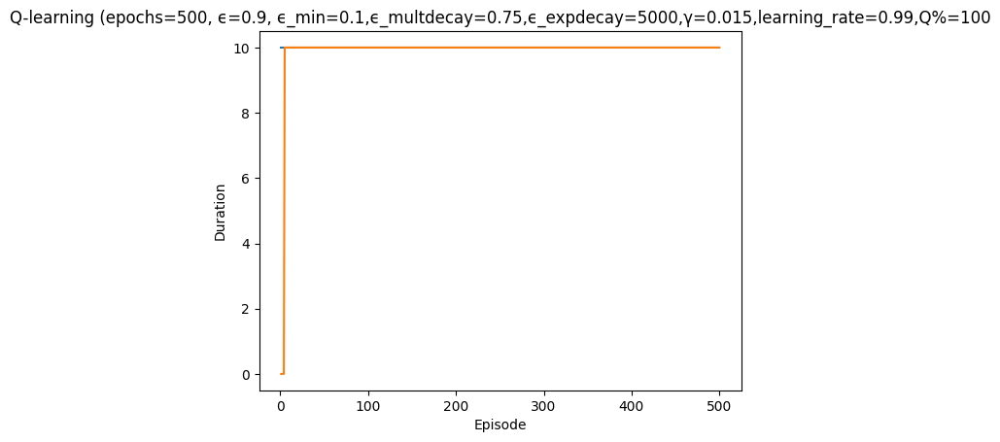

In [8]:
trained_attacker = learner.epsilon_greedy_search(
        gym_env,
        ep,
        a.QTabularLearner(ep, gamma=.015, learning_rate=0.99, exploit_percentile=100),
        episode_count=training_episode_count,
        iteration_count=iteration_count,
        epsilon=0.90,
        render=False,
        epsilon_multdecay=0.75,  # 0.999,
        epsilon_exponential_decay=5000,
        epsilon_minimum=0.1,
        verbosity=Verbosity.Quiet,
        title="Q-learning"
    )

In [9]:
import numpy as np
from cyberbattle._env.cyberbattle_env import Action

class EpsilonGreedyLearner:
    def __init__(self, env, defender, epsilon=0.1):
        self.env = env
        self.defender = defender
        self.epsilon = epsilon

    def choose_action(self, state):
        if np.random.rand() <= self.epsilon:
            return self.explore()
        else:
            return self.exploit(state)

    def explore(self):
        #randomly select an action from the defender's valid actions
        return self.defender.sample_valid_action()

    def exploit(self, state):
        return self.defender.sample_valid_action()

    def update_state(self, state, reward):
        pass

    def end_of_episode(self, episode_number):
        pass

class TrainedDefender:
    pass


In [10]:
import numpy as np
from typing import Tuple, Optional
import logging
import abc
from cyberbattle._env import cyberbattle_env

class DefenderEpsilonGreedyLearner(EpsilonGreedyLearner):
    def __init__(self, env, defender, ep, gamma, learning_rate, epsilon, state_space_size, action_space_size):
        super().__init__(env, defender, epsilon)
        self.defender = defender
        self.state_space_size = state_space_size
        self.action_space_size = action_space_size
        self.learning_rate = learning_rate
        self.q_matrix = np.zeros((self.state_space_size, self.action_space_size))
        self.gamma = gamma

    def decide_action(self, wrapped_env, observation) -> Tuple[str, cyberbattle_env.Action, object]:
        if np.random.rand() < self.epsilon:
            return self.explore(wrapped_env)
        else:
            return self.exploit(wrapped_env, observation)

    def explore(self, wrapped_env) -> Tuple[str, cyberbattle_env.Action, object]:
        action = wrapped_env.sample_valid_action()
        action_metadata = None
        action_style = 'explore'
        return action_style, action, action_metadata

    def exploit(self, wrapped_env, observation) -> Tuple[str, Optional[cyberbattle_env.Action], object]:
        action = wrapped_env.sample_valid_action()
        action_metadata = None
        action_style = 'exploit'
        return action_style, action, action_metadata

    def on_step(self, wrapped_env, observation, reward, done, info, action_metadata):
        current_state = self.encode_state(observation)
        action = self.encode_action(action_metadata)
        next_state = self.encode_state(observation) if not done else None
        self.update_q_matrix(current_state, action, reward, next_state)

    def update_q_matrix(self, state, action, reward, next_state):
        max_future_q = 0 if next_state is None else np.max(self.q_matrix[next_state])
        current_q = self.q_matrix[state, action]
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.gamma * max_future_q)
        self.q_matrix[state, action] = new_q

    def parameters_as_string(self):
        return "Defender learner parameters: "

    def encode_state(self, observation):
        state_index = 0
        return state_index

    def encode_action(self, action_metadata):
        action_index = 0
        return action_index

    def new_episode(self):
        pass

    def end_of_episode(self, i_episode, t):
        pass

    def end_of_iteration(self, t, done):
        pass

    def all_parameters_as_string(self):
        return ''

    def loss_as_string(self):
        return ''

    def stateaction_as_string(self, action_metadata):
        return ''


In [11]:
Breakdown = TypedDict('Breakdown', {
    'local': int,
    'remote': int,
    'connect': int
})

Outcomes = TypedDict('Outcomes', {
    'reward': Breakdown,
    'noreward': Breakdown
})

Stats = TypedDict('Stats', {
    'exploit': Outcomes,
    'explore': Outcomes,
    'exploit_deflected_to_explore': int
})

TrainedLearner = TypedDict('TrainedLearner', {
    'all_episodes_rewards': List[List[float]],
    'all_episodes_availability': List[List[float]],
    'learner': Learner,
    'trained_on': str,
    'title': str
})

def epsilon_greedy_defender_training(
    cyberbattle_gym_env: cyberbattle_env.CyberBattleEnv,
    environment_properties: w.EnvironmentBounds,
    learner: DefenderEpsilonGreedyLearner,
    title: str,
    episode_count: int,
    iteration_count: int,
    epsilon: float,
    epsilon_minimum=0.0,
    epsilon_multdecay: Optional[float] = None,
    epsilon_exponential_decay: Optional[int] = None,
    render=True,
    render_last_episode_rewards_to: Optional[str] = None,
    verbosity: Verbosity = Verbosity.Normal,
    plot_episodes_length=True
) -> TrainedLearner:
    """Epsilon greedy search for CyberBattle gym environments

    Parameters
    ==========

    - cyberbattle_gym_env -- the CyberBattle environment to train on

    - learner --- the policy learner/exploiter

    - episode_count -- Number of training episodes

    - iteration_count -- Maximum number of iterations in each episode

    - epsilon -- explore vs exploit
        - 0.0 to exploit the learnt policy only without exploration
        - 1.0 to explore purely randomly

    - epsilon_minimum -- epsilon decay clipped at this value.
    Setting this value too close to 0 may leed the search to get stuck.

    - epsilon_decay -- epsilon gets multiplied by this value after each episode

    - epsilon_exponential_decay - if set use exponential decay. The bigger the value
    is, the slower it takes to get from the initial `epsilon` to `epsilon_minimum`.

    - verbosity -- verbosity of the `print` logging

    - render -- render the environment interactively after each episode

    - render_last_episode_rewards_to -- render the environment to the specified file path
    with an index appended to it each time there is a positive reward
    for the last episode only

    - plot_episodes_length -- Plot the graph showing total number of steps by episode
    at th end of the search.

    Note on convergence
    ===================

    Setting 'minimum_espilon' to 0 with an exponential decay <1
    makes the learning converge quickly (loss function getting to 0),
    but that's just a forced convergence, however, since when
    epsilon approaches 0, only the q-values that were explored so
    far get updated and so only that subset of cells from
    the Q-matrix converges.

    """

    print(f"###### {title}\n"
          f"Learning with: episode_count={episode_count},"
          f"iteration_count={iteration_count},"
          f"ϵ={epsilon},"
          f'ϵ_min={epsilon_minimum}, '
          + (f"ϵ_multdecay={epsilon_multdecay}," if epsilon_multdecay else '')
          + (f"ϵ_expdecay={epsilon_exponential_decay}," if epsilon_exponential_decay else '') +
          f"{learner.parameters_as_string()}")

    initial_epsilon = epsilon
    successful_reimaging_count = 0
    starting_services_count = 0
    allowing_traffic_count = 0
    blocking_traffic_count = 0
    stopping_services_count = 0
    all_episodes_rewards = []
    all_episodes_availability = []
    defender_name = 'MyDefenderEnv'
    wrapped_env = DefenderWrapper(cyberbattle_gym_env,defender_name)
    steps_done = 0
    plot_title = f"{title} (epochs={episode_count}, ϵ={initial_epsilon}, ϵ_min={epsilon_minimum}," \
        + (f"ϵ_multdecay={epsilon_multdecay}," if epsilon_multdecay else '') \
        + (f"ϵ_expdecay={epsilon_exponential_decay}," if epsilon_exponential_decay else '') \
        + learner.parameters_as_string()
    plottraining = PlotTraining(title=plot_title, render_each_episode=render)

    render_file_index = 1

    for i_episode in range(1, episode_count + 1):

        print(f"  ## Episode: {i_episode}/{episode_count} '{title}' "
              f"ϵ={epsilon:.4f}, "
              f"{learner.parameters_as_string()}")

        observation = wrapped_env.reset()
        total_reward = 0.0
        all_rewards = []
        all_availability = []
        learner.new_episode()

        stats = Stats(exploit=Outcomes(reward=Breakdown(local=0, remote=0, connect=0),
                                       noreward=Breakdown(local=0, remote=0, connect=0)),
                      explore=Outcomes(reward=Breakdown(local=0, remote=0, connect=0),
                                       noreward=Breakdown(local=0, remote=0, connect=0)),
                      exploit_deflected_to_explore=0
                      )

        episode_ended_at = None
        sys.stdout.flush()

        bar = progressbar.ProgressBar(
            widgets=[
                'Episode ',
                f'{i_episode}',
                '|Iteration ',
                progressbar.Counter(),
                '|',
                progressbar.Variable(name='reward', width=6, precision=10),
                '|',
                progressbar.Variable(name='last_reward_at', width=4),
                '|',
                progressbar.Timer(),
                progressbar.Bar()
            ],
            redirect_stdout=False)

        for t in bar(range(1, 1 + iteration_count)):

            if epsilon_exponential_decay:
                epsilon = epsilon_minimum + math.exp(-1. * steps_done /
                                                     epsilon_exponential_decay) * (initial_epsilon - epsilon_minimum)

            steps_done += 1

            x = np.random.rand()
            if x <= epsilon:
                action_style, gym_action, action_metadata = learner.explore(wrapped_env)
            else:
                action_style, gym_action, action_metadata = learner.exploit(wrapped_env, observation)
                if not gym_action:
                    stats['exploit_deflected_to_explore'] += 1
                    _, gym_action, action_metadata = learner.explore(wrapped_env)

            logging.debug(f"gym_action={gym_action}, action_metadata={action_metadata}")
            observation, reward, done, info = wrapped_env.step(gym_action)

            # Print the simplified action taken
            action_type = gym_action.get('action_type', 'Unknown')
            if action_type == 0:  #Reimage Node
                action_type = "Reimage Node"
            elif action_type == 1:  #Block Traffic
                action_type = "Block Traffic"
            elif action_type == 2:  #Allow Traffic
                action_type = "Reimage Node"
            elif action_type == 3:  #Stop Service
                action_type = "Allow Traffic"
            elif action_type == 4:  #Start Service
                action_type = "Start Service"

            print('action type: ',action_type)
            node_id = gym_action.get('node_id', 'Unknown')
            parameter = gym_action.get('parameter', 'Unknown')
            print(f"Iteration {t}: Action Taken: Type={action_type}, NodeID={node_id}, Parameter={parameter}")

            action_status = info.get('status', '')

            if action_status == 'success':
                action_name = info.get('action', '')
                if action_name == 'reimage_node':
                    successful_reimaging_count += 1
                elif action_name == 'start_service':
                    starting_services_count += 1
                elif action_name == 'allow_traffic':
                    allowing_traffic_count += 1
                elif action_name == 'block_traffic':
                    blocking_traffic_count += 1
                elif action_name == 'stop_service':
                    stopping_services_count += 1


            print('info',info)

            learner.on_step(wrapped_env, observation, reward, done, info, action_metadata)
            assert np.shape(reward) == ()

            all_rewards.append(reward)
            if 'network_availability' in info:
                all_availability.append(info['network_availability'])
            else:
                all_availability.append(0)  # Assuming network availability is 0 in this case
            total_reward += reward
            bar.update(t, reward=total_reward)
            if reward > 0:
                bar.update(t, last_reward_at=t)

            if verbosity == Verbosity.Verbose or (verbosity == Verbosity.Normal and reward > 0):
                sign = ['-', '+'][reward > 0]

                print(f"    {sign} t={t} {action_style} r={reward} cum_reward:{total_reward} "
                      f"a={action_metadata}-{gym_action} "
                      f"creds={len(observation['credential_cache_matrix'])} "
                      f" {learner.stateaction_as_string(action_metadata)}")

            if i_episode == episode_count \
                    and render_last_episode_rewards_to is not None \
                    and reward > 0:
                fig = cyberbattle_gym_env.render_as_fig()
                fig.write_image(f"{render_last_episode_rewards_to}-e{i_episode}-{render_file_index}.png")
                render_file_index += 1

            learner.end_of_iteration(t, done)
            '''
            if done:
                episode_ended_at = t
                bar.finish(dirty=True)
                break
            '''
        sys.stdout.flush()

        loss_string = learner.loss_as_string()
        if loss_string:
            loss_string = "loss={loss_string}"

        if episode_ended_at:
            print(f"  Episode {i_episode} ended at t={episode_ended_at} {loss_string}")
        else:
            print(f"  Episode {i_episode} stopped at t={iteration_count} {loss_string}")

        print_stats(stats)
        print(f"  Episode {i_episode} breakdown:")
        print(f"    Successful Reimaging Count: {successful_reimaging_count}")
        print(f"    Starting Services Count: {starting_services_count}")
        print(f"    Allowing Traffic Count: {allowing_traffic_count}")
        print(f"    Blocking Traffic Count: {blocking_traffic_count}")
        print(f"    Stopping Services Count: {stopping_services_count}")

        all_episodes_rewards.append(all_rewards)
        all_episodes_availability.append(all_availability)

        length = episode_ended_at if episode_ended_at else iteration_count
        learner.end_of_episode(i_episode=i_episode, t=length)
        if plot_episodes_length:
            plottraining.episode_done(length)
        if render:
            wrapped_env.render()

        if epsilon_multdecay:
            epsilon = max(epsilon_minimum, epsilon * epsilon_multdecay)

    wrapped_env.close()
    print("simulation ended")
    if plot_episodes_length:
        plottraining.plot_end()

    return TrainedLearner(
        all_episodes_rewards=all_episodes_rewards,
        all_episodes_availability=all_episodes_availability,
        learner=learner,
        trained_on=cyberbattle_gym_env.name,
        title=plot_title
    )

In [12]:
def random_argtop_percentile(array: np.ndarray, percentile: float):
    """Just like `argmax` but if there are multiple elements with the max
    return a random index to break ties instead of returning the first one."""
    top_percentile = np.percentile(array, percentile)
    indices = np.where(array >= top_percentile)[0]
    if len(indices) == 0:
        return random_argmax(array)
    elif indices.shape[0] > 1:
        max_index = int(np.random.choice(indices))
    else:
        max_index = int(indices)

    return top_percentile, max_index


class QMatrix:
    """Q-Learning matrix for a given state and action space
        state_space  - Features defining the state space
        action_space - Features defining the action space
        qm           - Optional: initialization values for the Q matrix
    """
    #Quality matrix
    qm: np.ndarray

    def __init__(self, name,
                 statespace: w.Feature,
                 actionspace: w.Feature,
                 qm: Optional[np.ndarray] = None):
        """Initialize the Q-matrix"""

        self.name = name
        self.statespace = statespace
        self.actionspace = actionspace
        self.statedim = statespace.flat_size()
        self.actiondim = actionspace.flat_size()
        self.qm = self.clear() if qm is None else qm

        #error calculated for the last update to the Q-matrix
        self.last_error = 0

    def shape(self):
        return (self.statedim, self.actiondim)

    def clear(self):
        """Re-initialize the Q-matrix to 0"""
        self.qm = np.zeros(shape=self.shape())
        #self.qm = np.random.rand(*self.shape()) / 100
        return self.qm

    def print(self):
        print(f"[{self.name}]\n"
              f"state: {self.statespace}\n"
              f"action: {self.actionspace}\n"
              f"shape = {self.shape()}")

    def update(self, current_state: int, action: int, next_state: int, reward, gamma, learning_rate):
        """Update the Q matrix after taking `action` in state 'current_State'
        and obtaining reward=R[current_state, action]"""
        maxq_atnext, max_index = random_argmax(self.qm[next_state, ])
        #bellman equation for Q-learning
        temporal_difference = reward + gamma * maxq_atnext - self.qm[current_state, action]
        self.qm[current_state, action] += learning_rate * temporal_difference
        #loss is calculated using the squared difference between
        #target Q-Value and predicted Q-Value
        square_error = temporal_difference * temporal_difference
        self.last_error = square_error
        return self.qm[current_state, action]

    def exploit(self, features, percentile) -> Tuple[int, float]:
        """exploit: leverage the Q-matrix.
        Returns the expected Q value and the chosen action."""
        expected_q, action = random_argtop_percentile(self.qm[features, :], percentile)
        return int(action), float(expected_q)


import numpy as np
from typing import Tuple

class DefenderQMatrix(QMatrix):
    def __init__(self, statespace, actionspace, defender):
        super().__init__('Defender Q-Matrix', statespace, actionspace)
        self.defender = defender


    '''
    update the Q-matrix based on the temporal difference error. It calculates the temporal difference, updates the Q-value, and returns the updated Q-value.
    '''
    def update(self, current_state: int, action: int, next_state: int, reward, gamma, learning_rate):
        """Update the Q matrix for the defender agent"""
        maxq_atnext, max_index = random_argmax(self.qm[next_state, ])
        #temporal difference calculation
        temporal_difference = reward + gamma * maxq_atnext - self.qm[current_state, action]
        self.qm[current_state, action] += learning_rate * temporal_difference
        square_error = temporal_difference * temporal_difference
        self.last_error = square_error
        return self.qm[current_state, action]

    def exploit(self, wrapped_env, observation):
        test_state_index = 0
        test_action_index = 0
        if test_state_index < self.statedim and test_action_index < self.actiondim:
            q_value = self.qm[test_state_index, test_action_index]
            return test_action_index, q_value
        else:
            raise IndexError("Test state or action index out of bounds.")

    '''
    returns the maximum Q-value for a given state, handling terminal states by returning a default value.
    '''
    def get_max_q_value(self, state):
        """Return the maximum Q-value for a given state."""
        if state == -1:
            return 0

        if 0 <= state < self.qm.shape[0]:
            return np.max(self.qm[state, :])
        else:
            raise IndexError(f"State index out of bounds: {state}")

    '''
    returns the Q-value for a specific state-action pair, checking if the indices are within bounds.
    '''
    def get_q_value(self, state, action):
        """Return the Q-value for a specific state-action pair."""
        if state >= 0 and state < self.qm.shape[0] and action >= 0 and action < self.qm.shape[1]:
            return self.qm[state, action]
        else:
            raise IndexError("State or action index out of bounds.")

    '''
    allows for manually updating a specific state-action pair's Q-value.
    '''
    def update_q_value(self, state, action, new_q_value):
        """Update the Q-value for a specific state-action pair."""
        if state >= 0 and state < self.qm.shape[0] and action >= 0 and action < self.qm.shape[1]:
            self.qm[state, action] = new_q_value
        else:
            raise IndexError("State or action index out of bounds.")

In [13]:
class DefenderQLearner(EpsilonGreedyLearner):
    def __init__(self, env, defender, ep, q_matrix: DefenderQMatrix, epsilon, gamma, learning_rate):
        super().__init__(env, defender, epsilon)
        self.defender = defender
        self.q_matrix = q_matrix
        self.epsilon = epsilon
        self.gamma = gamma
        self.learning_rate = learning_rate
        #self.defender_actions = defender_actions
        self.SOME_THRESHOLD = 3

    def explore(self, wrapped_env) -> Tuple[str, Action, Optional[object]]:
        action = wrapped_env.sample_valid_action()
        action_style = "explore"
        action_metadata = None
        return action_style, action, action_metadata

    def convert_action_index_to_action(self, action_index, node_id, parameter):
        """
        Convert an action index to an action representation.

        Args:
            action_index (int): The index of the action to be converted.
            node_id (int): The ID of the node associated with the action.
            parameter (int): The parameter value for the action.

        Returns:
            dict: An action representation as a dictionary.
        """
        action_mapping = {
            0: 'Reimage Node',
            1: 'Block Traffic',
            2: 'Allow Traffic',
            3: 'Stop Service',
            4: 'Start Service'
        }
        if action_index not in action_mapping:
            raise ValueError("Invalid action index")
        action_type = action_mapping[action_index]
        action = {
            'action_type': action_type,
            'node_id': node_id,
            'parameter': parameter
        }

        return action

    def exploit(self, state,observation) -> Tuple[str, Action, Optional[object]]:
        percentile = 50
        infected_nodes = observation.get('infected_nodes', None)
        if infected_nodes is None:
            return "explore", None, None

        features = {
            'infected_nodes': infected_nodes,
            'firewall_status': observation['firewall_status'],
            'service_status': observation['service_status']
        }
        '''
        features = {
            'infected_nodes': observation['infected_nodes'],
            'firewall_status': observation['firewall_status'],
            'service_status': observation['service_status']
        }
        '''
        action_index, _ = self.q_matrix.exploit(features, percentile)

        node_id = self.extract_node_id_from_observation(observation)
        parameter = self.determine_parameter_based_on_state(observation)

        if node_id is not None:
            action = self.convert_action_index_to_action(action_index, node_id, parameter)
            action_style = "exploit"
            return action_style, action, None
        else:
            return "explore", None, None

    def extract_node_id_from_observation(self, observation):
        infected_nodes = observation.get('infected_nodes', [])
        for index, is_infected in enumerate(infected_nodes):
            if is_infected == 1:
                return index
        return None

    def determine_parameter_based_on_state(self, observation):
        infected_nodes = observation.get('infected_nodes', [])
        number_of_infected_nodes = sum(infected_nodes)
        parameter = 1 if number_of_infected_nodes > self.SOME_THRESHOLD else 0
        return parameter




    def update_q_matrix(self, state, action, reward, next_state):
        max_future_q = self.q_matrix.get_max_q_value(next_state)
        current_q = self.q_matrix.get_q_value(state, action)
        #calculate the new Q-value
        new_q = (1 - self.learning_rate) * current_q + self.learning_rate * (reward + self.gamma * max_future_q)
        #update the Q-matrix with the new Q-value
        self.q_matrix.update_q_value(state, action, new_q)

    def on_step(self, wrapped_env, action, reward, next_observation, done, info):
        observation = self.defender.get_observation()
        current_state = self.q_matrix.statespace.encode(observation)
        next_state = self.q_matrix.statespace.encode(observation) if not done else -1
        action_index = self.encode_action(action)
        self.update_q_matrix(current_state, action_index, reward, next_state)


    def end_of_iteration(self, current_iteration: int, total_iterations: int):
        pass

    def end_of_episode(self, i_episode=None, t=None):
        """
        Modified end_of_episode method with additional parameters.
        """
        pass


    def parameters_as_string(self):
        return "Defender learner parameters: []"

    def encode_state(self, observation):
        state_index = 0
        return state_index

    def encode_action(self, action_metadata):
        action_index = 0
        return action_index

    def new_episode(self):
        pass

    def all_parameters_as_string(self):
        return ''

    def loss_as_string(self):
        return ''

    def stateaction_as_string(self, action_metadata):
        return ''


In [14]:
def print_stats(stats):
    """Print learning statistics"""
    def print_breakdown(stats, actiontype: str):
        def ratio(kind: str) -> str:
            x, y = stats[actiontype]['reward'][kind], stats[actiontype]['noreward'][kind]
            sum = x + y
            if sum == 0:
                return 'NaN'
            else:
                return f"{(x / sum):.2f}"

        def print_kind(kind: str):
            print(
                f"    {actiontype}-{kind}: {stats[actiontype]['reward'][kind]}/{stats[actiontype]['noreward'][kind]} "
                f"({ratio(kind)})")
        print_kind('local')
        print_kind('remote')
        print_kind('connect')

    print("  Breakdown [Reward/NoReward (Success rate)]")
    print_breakdown(stats, 'explore')
    print_breakdown(stats, 'exploit')
    print(f"  exploit deflected to exploration: {stats['exploit_deflected_to_explore']}")


In [15]:
from cyberbattle.agents.baseline.agent_wrapper import ActionTrackingStateAugmentation, StateAugmentation
from cyberbattle.agents.baseline.plotting import PlotTraining, plot_averaged_cummulative_rewards
import progressbar
import math
from cyberbattle.agents.baseline import learner
import sys
from cyberbattle.simulation.model import FirewallRule

In [16]:
statespace = w.HashEncoding(ep, [
            # Feature_discovered_node_count(),
            # Feature_discovered_credential_count(),
            w.Feature_discovered_ports_sliding(ep),
            w.Feature_discovered_nodeproperties_sliding(ep),
            w.Feature_discovered_notowned_node_count(ep, 3)
        ], 5000)  # should not be too small, pick something big to avoid collision

actionspace = w.RavelEncoding(ep, [
            w.Feature_active_node_properties(ep)])
q_matrix = DefenderQMatrix(statespace, actionspace,gym_env)
learner2 = DefenderQLearner(gym_env, defender_agent, ep, q_matrix, epsilon=0.9, gamma=0.015, learning_rate=.07)

###### Defender Q-Learning Training
Learning with: episode_count=500,iteration_count=10,ϵ=0.9,ϵ_min=0.1, ϵ_multdecay=0.75,ϵ_expdecay=5000,Defender learner parameters: []
  ## Episode: 1/500 'Defender Q-Learning Training' ϵ=0.9000, Defender learner parameters: []


Episode 1|Iteration 10|reward:   60.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1, 'successful_actions': 0, 'failed_actions': 1}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 2, 'successful_actions': 1, 'failed_actions': 1}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3:

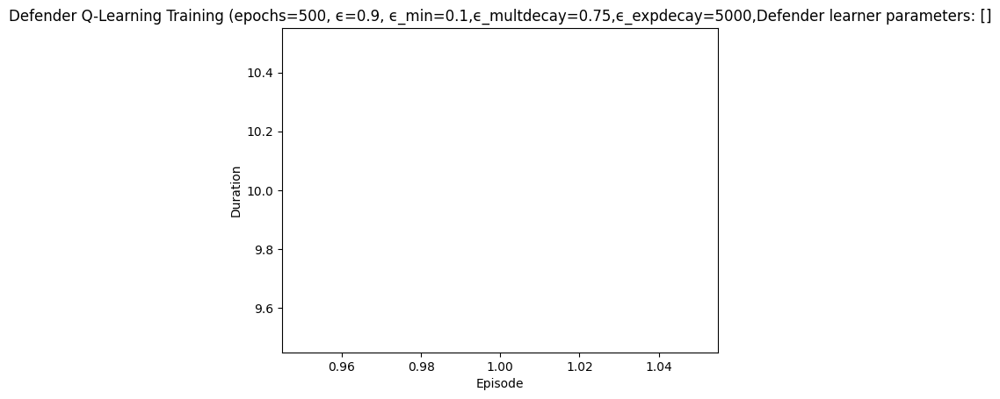

Rendering the current state of the environment
  ## Episode: 2/500 'Defender Q-Learning Training' ϵ=0.6739, Defender learner parameters: []


Episode 2|Iteration 10|reward:  110.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 11, 'successful_actions': 4, 'failed_actions': 7}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 12, 'successful_actions': 4, 'failed_actions': 8}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=13, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_

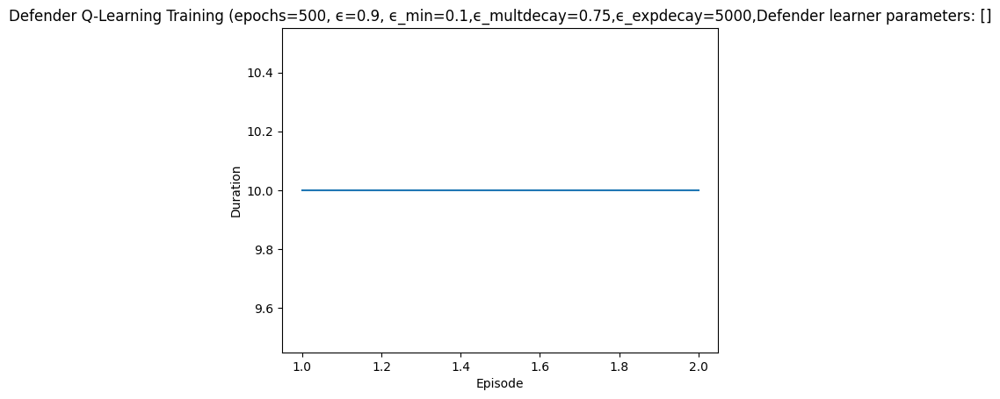

Rendering the current state of the environment
  ## Episode: 3/500 'Defender Q-Learning Training' ϵ=0.6727, Defender learner parameters: []


Episode 3|Iteration 10|reward:  130.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 21, 'successful_actions': 8, 'failed_actions': 13}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 22, 'successful_actions': 8, 'failed_actions': 14}, 'network_availability': 1.0}
action type:  Block Traffi

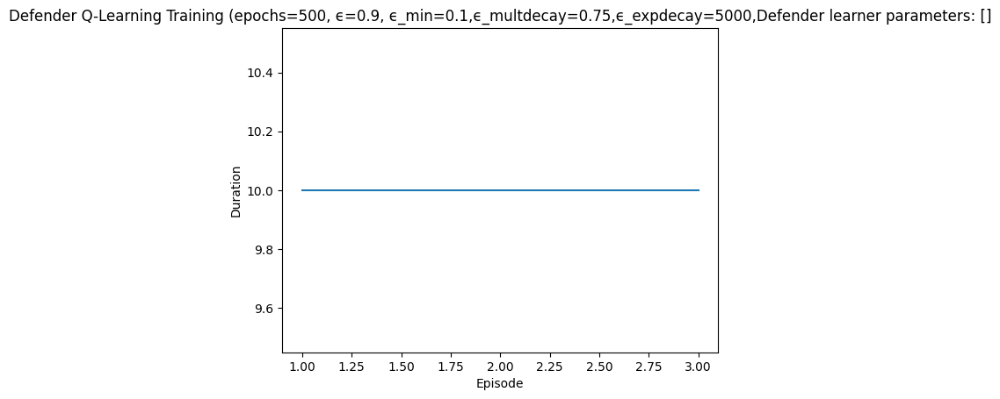

Rendering the current state of the environment
  ## Episode: 4/500 'Defender Q-Learning Training' ϵ=0.6715, Defender learner parameters: []


Episode 4|Iteration 10|reward:  -25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 31, 'successful_actions': 15, 'failed_actions': 16}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 32, 'successful_actions': 15, 'failed_actions': 17}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'st

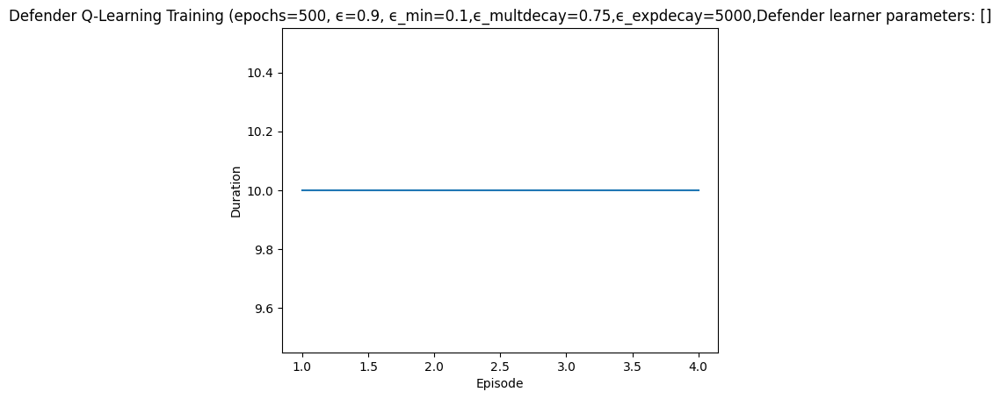

Rendering the current state of the environment
  ## Episode: 5/500 'Defender Q-Learning Training' ϵ=0.6703, Defender learner parameters: []


Episode 5|Iteration 7|reward:   55.0|last_reward_at:    6|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 41, 'successful_actions': 18, 'failed_actions': 23}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 42, 'successful_actions': 18, 'failed_actions': 24}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=3, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 5, 'p

Episode 5|Iteration 8|reward:   80.0|last_reward_at:    8|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 8: Action Taken: Type=Block Traffic, NodeID=2, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 48, 'successful_actions': 22, 'failed_actions': 26}, 'network_availability': 1.0}
action type:  Reimage Node

Episode 5|Iteration 10|reward:  105.0|last_reward_at:    9|Elapsed Time: 0:00:00||



Iteration 9: Action Taken: Type=Reimage Node, NodeID=11, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 49, 'successful_actions': 23, 'failed_actions': 26}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=8, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 50, 'successful_actions': 23, 'failed_actions': 27}, 'network_availability': 1.0}
  Episode 5 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-rem

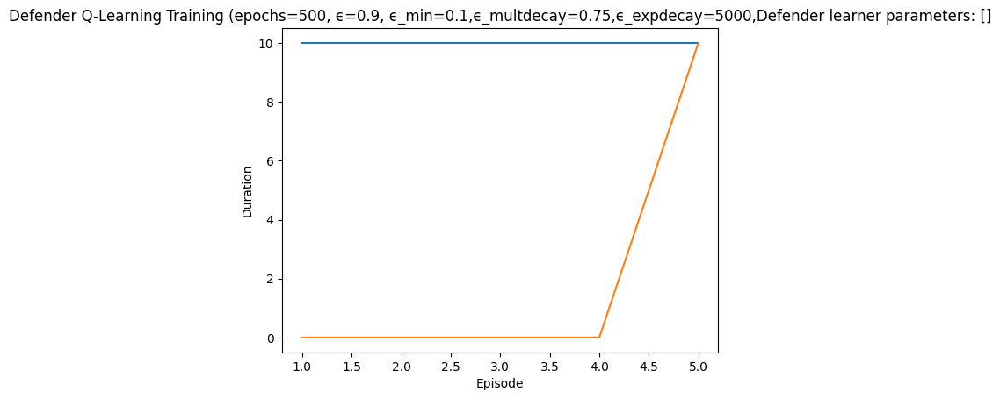

Rendering the current state of the environment
  ## Episode: 6/500 'Defender Q-Learning Training' ϵ=0.6691, Defender learner parameters: []


Episode 6|Iteration 5|reward:  125.0|last_reward_at:    5|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 51, 'successful_actions': 24, 'failed_actions': 27}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 52, 'successful_actions': 25, 'failed_actions': 27}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=6, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 53, 'successful_actions': 26, 'failed_actions': 27}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 4: Action Taken: T

Episode 6|Iteration 7|reward:  135.0|last_reward_at:    6|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 6: Action Taken: Type=Block Traffic, NodeID=0, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': 'start', 'port_name': 0, 'performance_metrics': {'actions_taken': 56, 'successful_actions': 29, 'failed_actions': 27}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 7: Action Taken: Type=Start Service, NodeID=9, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 57, 'successful_actions': 29, 'failed_actions': 28}, 'network_availability': 1.0}


Episode 6|Iteration 10|reward:  170.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 8: Action Taken: Type=Reimage Node, NodeID=12, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 58, 'successful_actions': 30, 'failed_actions': 28}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 9: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 59, 'successful_actions': 30, 'failed_actions': 29}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=3, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 3, 'perf

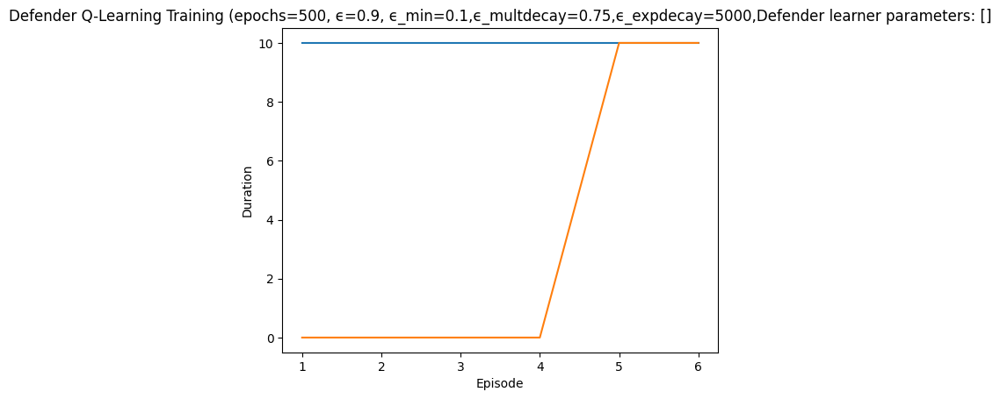

Rendering the current state of the environment
  ## Episode: 7/500 'Defender Q-Learning Training' ϵ=0.6680, Defender learner parameters: []


Episode 7|Iteration 10|reward:  105.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 61, 'successful_actions': 31, 'failed_actions': 30}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=9, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 62, 'successful_actions': 31, 'failed_actions': 31}, 'network_availability': 1.0}
action

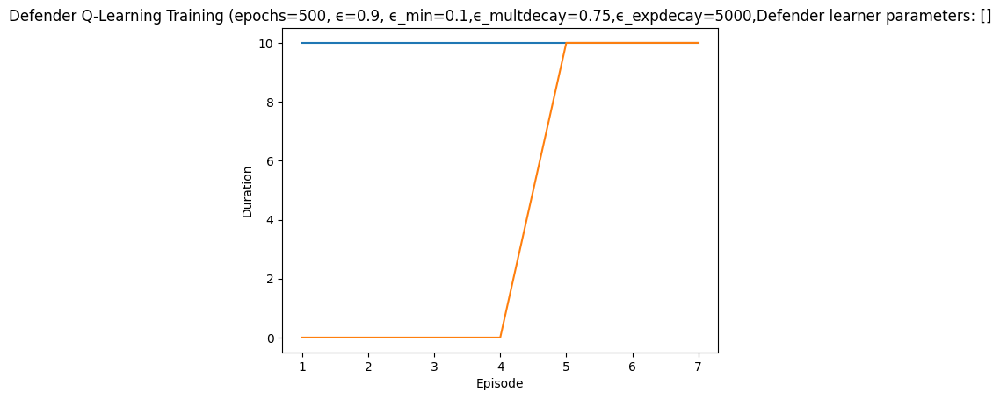

Rendering the current state of the environment
  ## Episode: 8/500 'Defender Q-Learning Training' ϵ=0.6668, Defender learner parameters: []


Episode 8|Iteration 10|reward:   80.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=1, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 71, 'successful_actions': 38, 'failed_actions': 33}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 72, 'successful_actions': 38, 'failed_actions': 34}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action

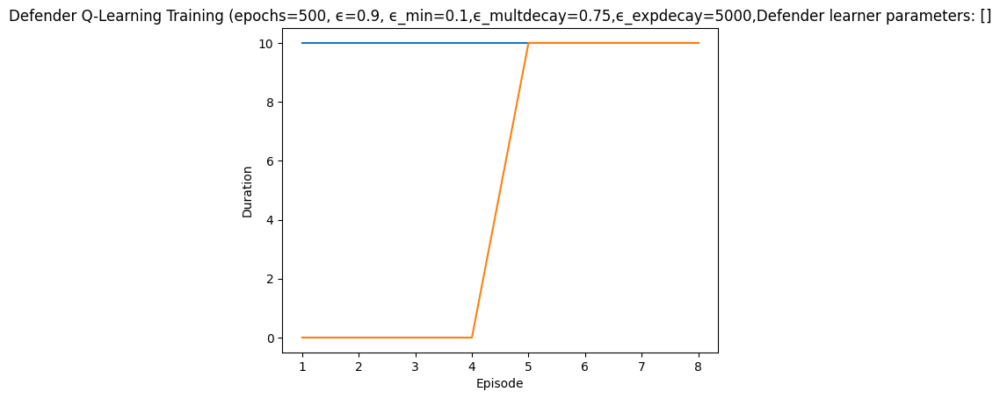

Rendering the current state of the environment
  ## Episode: 9/500 'Defender Q-Learning Training' ϵ=0.6656, Defender learner parameters: []


Episode 9|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=7, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 81, 'successful_actions': 43, 'failed_actions': 38}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 82, 'successful_actions': 43, 'failed_actions': 39}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: 

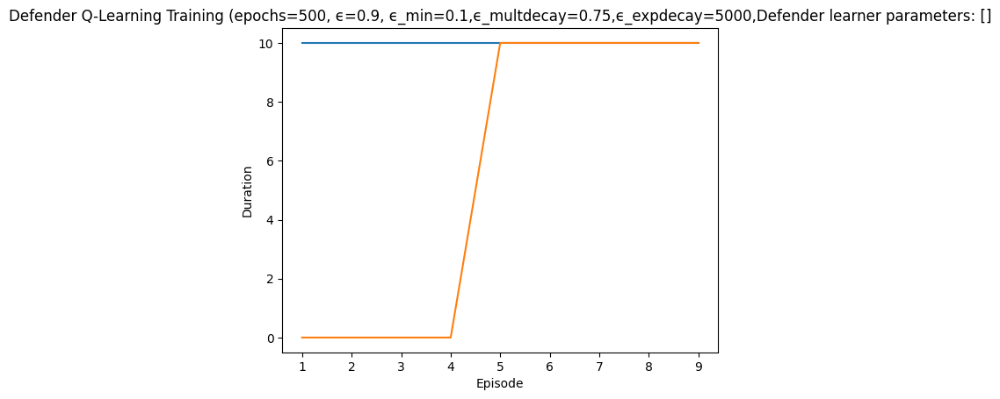

Rendering the current state of the environment
  ## Episode: 10/500 'Defender Q-Learning Training' ϵ=0.6644, Defender learner parameters: []


Episode 10|Iteration 10|reward:    0.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 91, 'successful_actions': 48, 'failed_actions': 43}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=7, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 92, 'successful_actions': 48, 'failed_actions': 44}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Tak

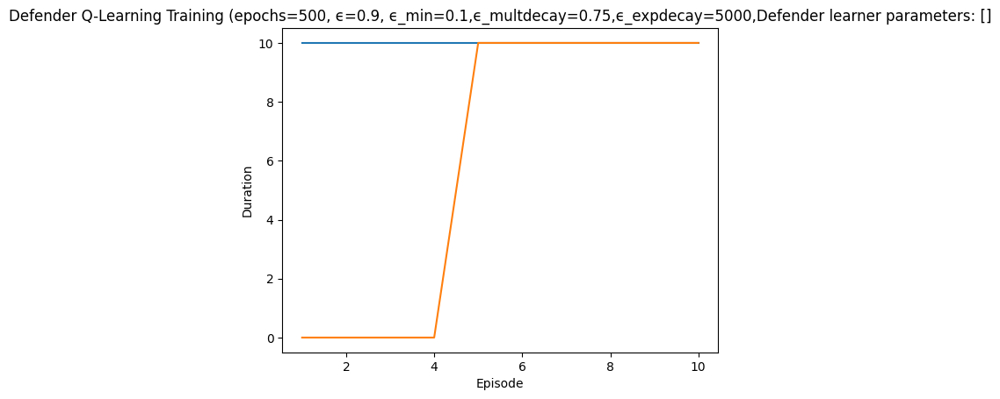

Rendering the current state of the environment
  ## Episode: 11/500 'Defender Q-Learning Training' ϵ=0.6632, Defender learner parameters: []


Episode 11|Iteration 10|reward:  -10.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 101, 'successful_actions': 50, 'failed_actions': 51}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 102, 'successful_actions': 50, 'failed_actions': 52}, 'network_availability':

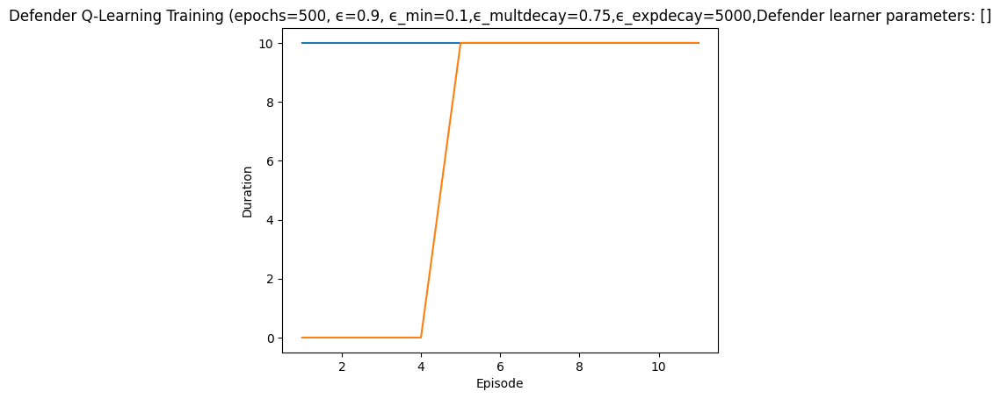

Rendering the current state of the environment
  ## Episode: 12/500 'Defender Q-Learning Training' ϵ=0.6621, Defender learner parameters: []


Episode 12|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=7, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 111, 'successful_actions': 52, 'failed_actions': 59}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 112, 'successful_actions': 52, 'failed_actions': 60}, 'network_availability': 1.0}
failed
{'action

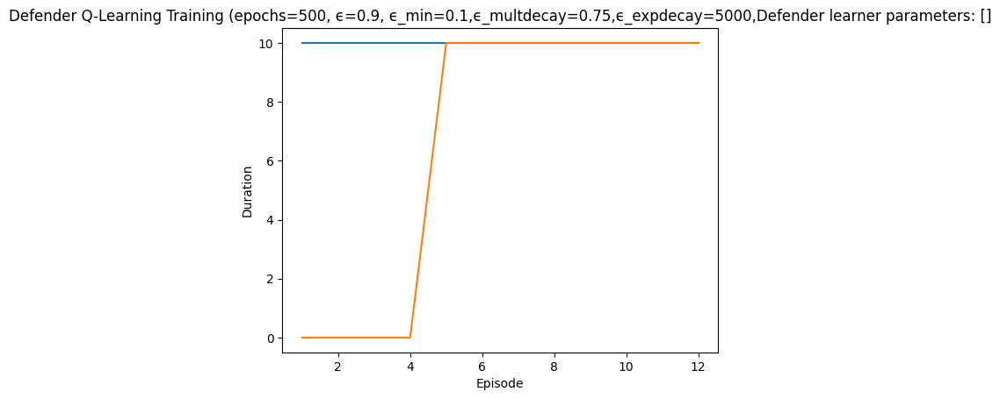

Rendering the current state of the environment
  ## Episode: 13/500 'Defender Q-Learning Training' ϵ=0.6609, Defender learner parameters: []


Episode 13|Iteration 10|reward:   70.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=1, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 121, 'successful_actions': 57, 'failed_actions': 64}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 122, 'successful_actions': 57, 'failed_actions': 65}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Itera

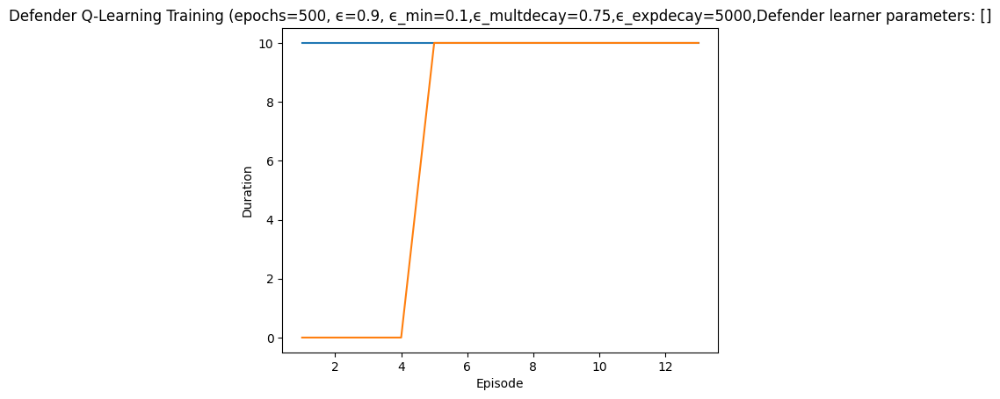

Rendering the current state of the environment
  ## Episode: 14/500 'Defender Q-Learning Training' ϵ=0.6597, Defender learner parameters: []


Episode 14|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=7, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 131, 'successful_actions': 60, 'failed_actions': 71}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 132, 'successful_actions': 60, 'failed_actions': 72}, 'network_availability': 1.0}
failed
{'action': 

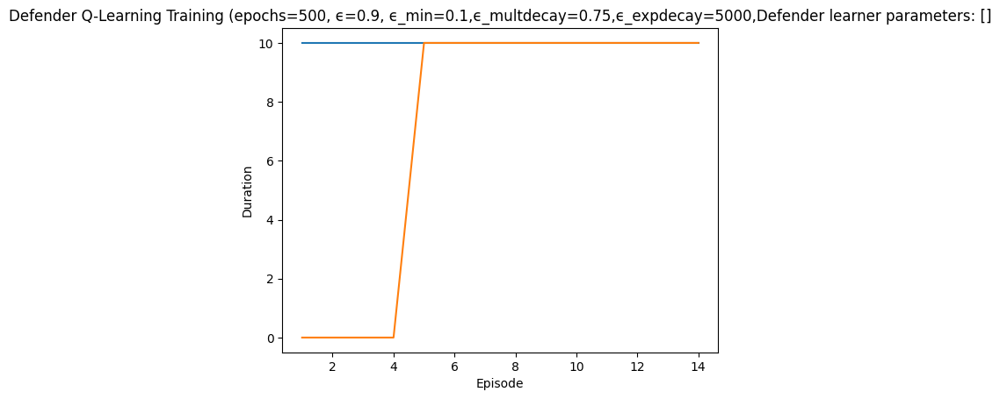

Rendering the current state of the environment
  ## Episode: 15/500 'Defender Q-Learning Training' ϵ=0.6585, Defender learner parameters: []


Episode 15|Iteration 10|reward:    5.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 141, 'successful_actions': 66, 'failed_actions': 75}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 142, 'successful_actions': 66, 'failed_actions': 76}, 'network_availability': 1.0}
failed
{'a

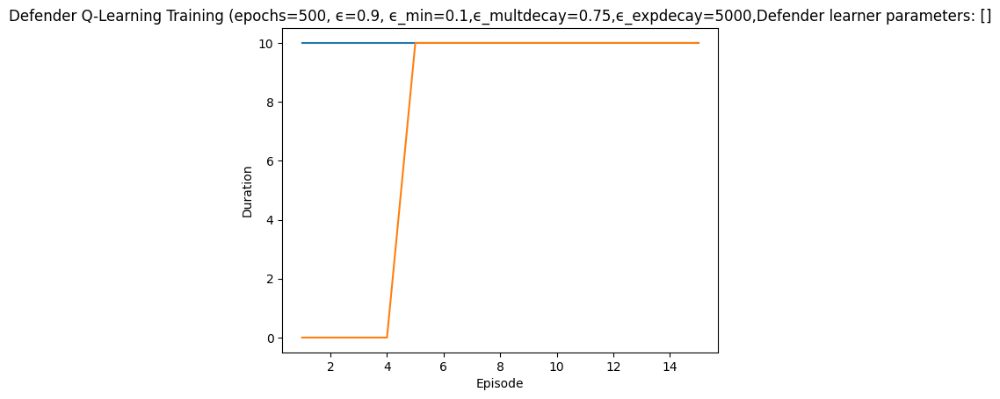

Rendering the current state of the environment
  ## Episode: 16/500 'Defender Q-Learning Training' ϵ=0.6574, Defender learner parameters: []


Episode 16|Iteration 10|reward:  -55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 151, 'successful_actions': 68, 'failed_actions': 83}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=4, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 152, 'successful_actions': 68, 'failed_actions': 84}, 'network_availability': 1.0}
failed
{'action': 'reimage

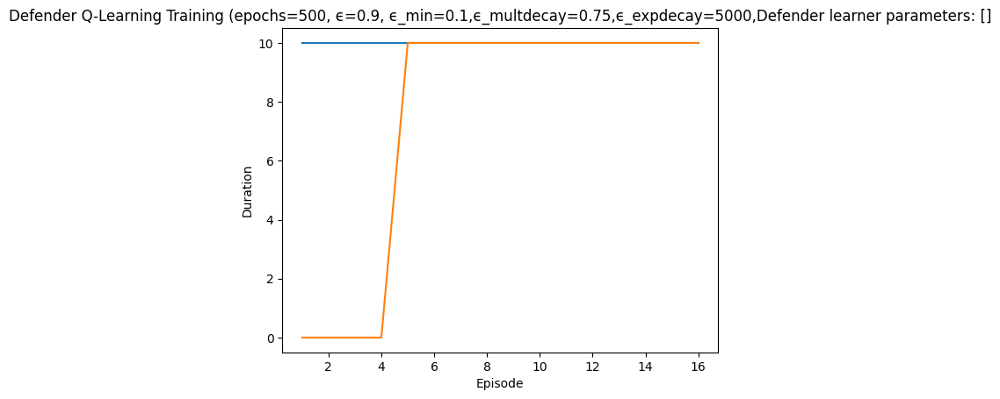

Rendering the current state of the environment
  ## Episode: 17/500 'Defender Q-Learning Training' ϵ=0.6562, Defender learner parameters: []


Episode 17|Iteration 10|reward:  110.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 161, 'successful_actions': 70, 'failed_actions': 91}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=10, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 162, 'successful_actions': 71, 'failed_actions': 91}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=10, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 

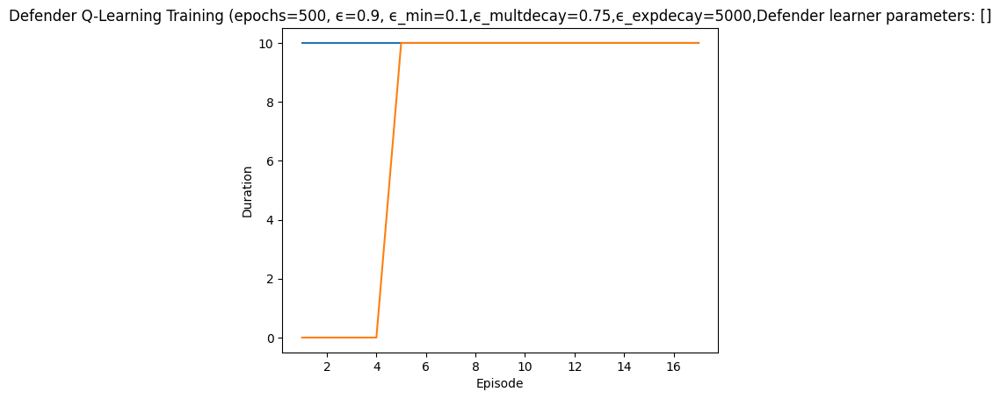

Rendering the current state of the environment
  ## Episode: 18/500 'Defender Q-Learning Training' ϵ=0.6551, Defender learner parameters: []


Episode 18|Iteration 10|reward:  -10.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=13, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 171, 'successful_actions': 75, 'failed_actions': 96}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=4, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 172, 'successful_actions': 75, 'failed_actions': 97}, 'network_availability': 1.0}
action type:  Rei

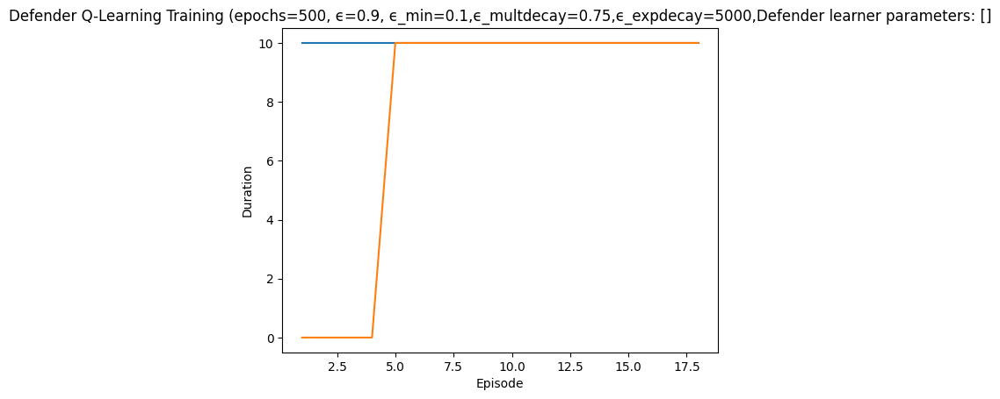

Rendering the current state of the environment
  ## Episode: 19/500 'Defender Q-Learning Training' ϵ=0.6539, Defender learner parameters: []


Episode 19|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 181, 'successful_actions': 77, 'failed_actions': 104}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=11, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 182, 'successful_actions': 77, 'failed_actions': 105}, 'network_availability': 1.0}
failed
{'action':

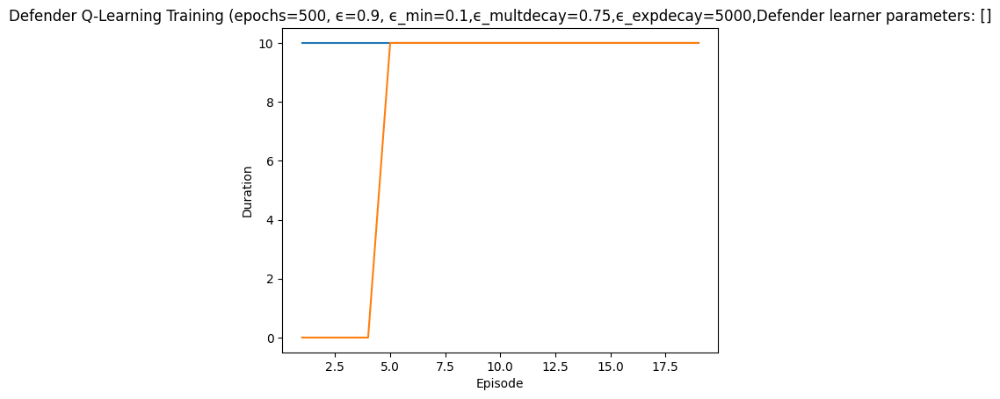

Rendering the current state of the environment
  ## Episode: 20/500 'Defender Q-Learning Training' ϵ=0.6527, Defender learner parameters: []


Episode 20|Iteration 10|reward:   25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 191, 'successful_actions': 82, 'failed_actions': 109}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 192, 'successful_actions': 82, 'failed_actions': 110}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteratio

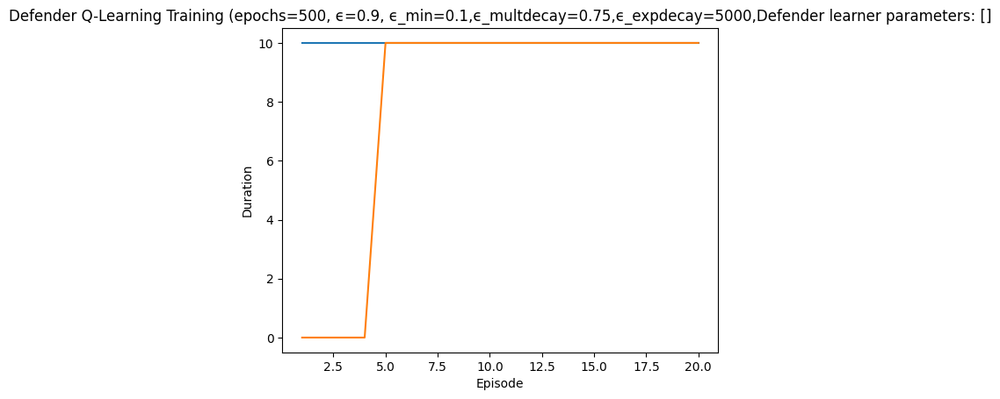

Rendering the current state of the environment
  ## Episode: 21/500 'Defender Q-Learning Training' ϵ=0.6516, Defender learner parameters: []


Episode 21|Iteration 10|reward:   80.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 201, 'successful_actions': 86, 'failed_actions': 115}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 202, 'successful_actions': 86, 'failed_actions': 116}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=10, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 

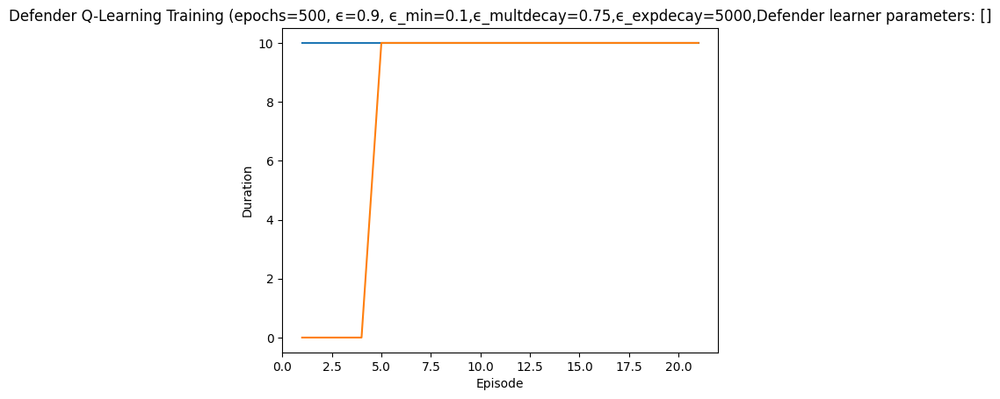

Rendering the current state of the environment
  ## Episode: 22/500 'Defender Q-Learning Training' ϵ=0.6504, Defender learner parameters: []


Episode 22|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 211, 'successful_actions': 91, 'failed_actions': 120}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 212, 'successful_actions': 91, 'failed_actions': 121}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=3, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name

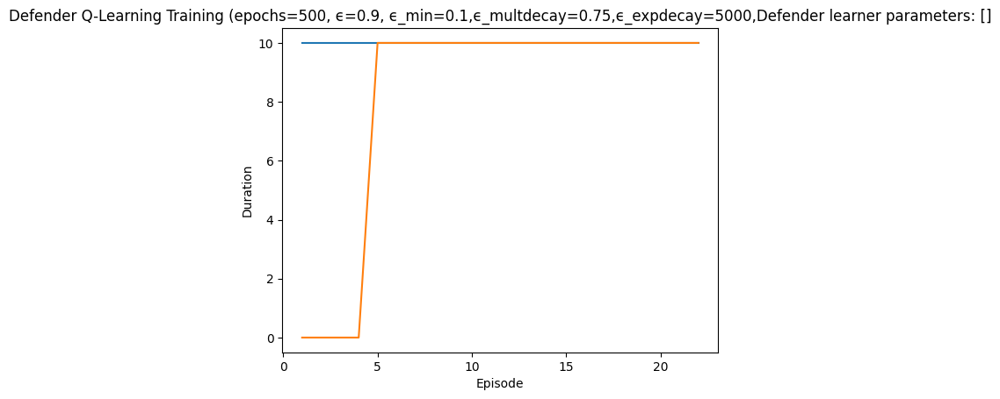

Rendering the current state of the environment
  ## Episode: 23/500 'Defender Q-Learning Training' ϵ=0.6493, Defender learner parameters: []


Episode 23|Iteration 10|reward:   40.0|last_reward_at:    5|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 221, 'successful_actions': 96, 'failed_actions': 125}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 222, 'successful_actions': 97, 'failed_actions': 125}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=10, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 223, 'successful_actions': 98, 'failed_actions': 125}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'fa

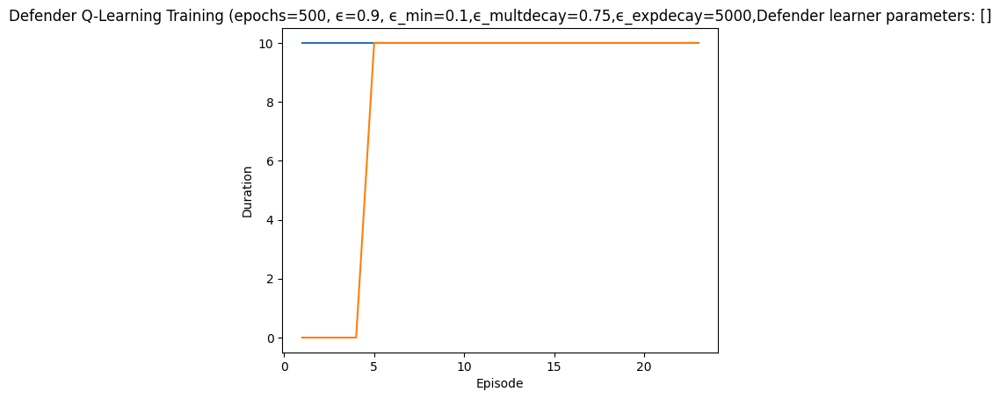

Rendering the current state of the environment
  ## Episode: 24/500 'Defender Q-Learning Training' ϵ=0.6481, Defender learner parameters: []


Episode 24|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 231, 'successful_actions': 99, 'failed_actions': 132}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 232, 'successful_actions': 99, 'failed_actions': 133}, 'network_availability': 1.0}
failed
{'a

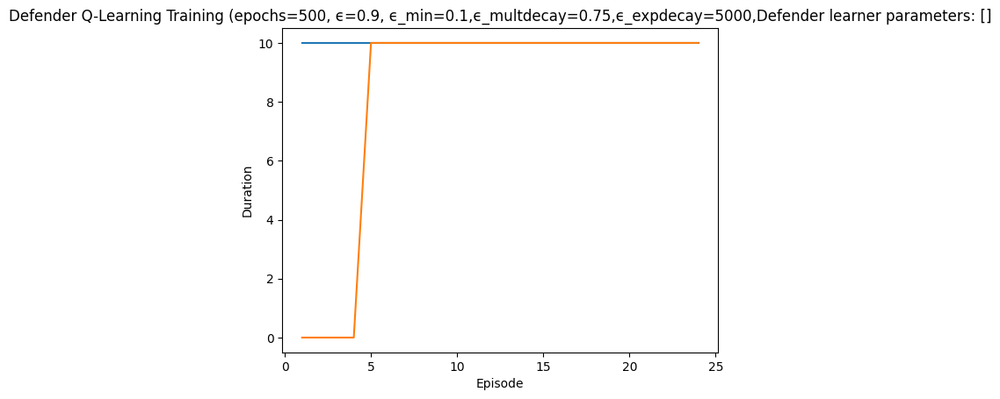

Rendering the current state of the environment
  ## Episode: 25/500 'Defender Q-Learning Training' ϵ=0.6470, Defender learner parameters: []


Episode 25|Iteration 10|reward:   10.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 241, 'successful_actions': 102, 'failed_actions': 139}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 242, 'successful_actions': 103, 'failed_actions': 139}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Act

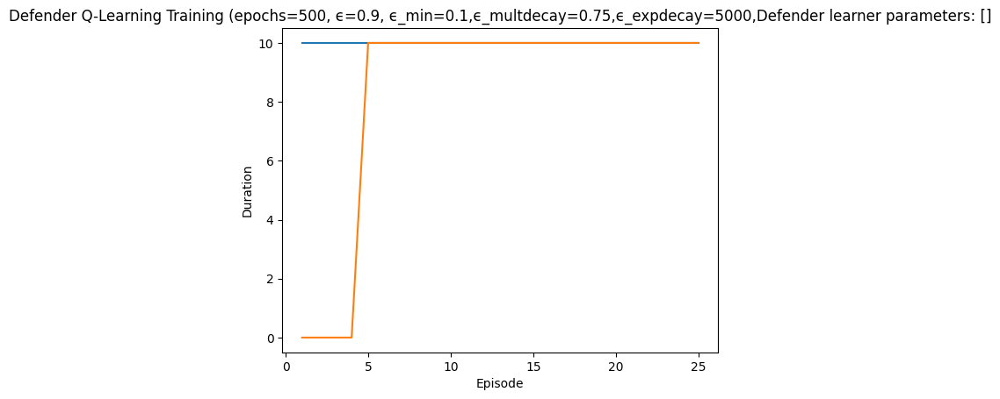

Rendering the current state of the environment
  ## Episode: 26/500 'Defender Q-Learning Training' ϵ=0.6459, Defender learner parameters: []


Episode 26|Iteration 10|reward:  -95.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 251, 'successful_actions': 106, 'failed_actions': 145}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 252, 'successful_actions': 106, 'failed_actions': 146}, 'network_availability': 1.0}
failed
{'action': 'b

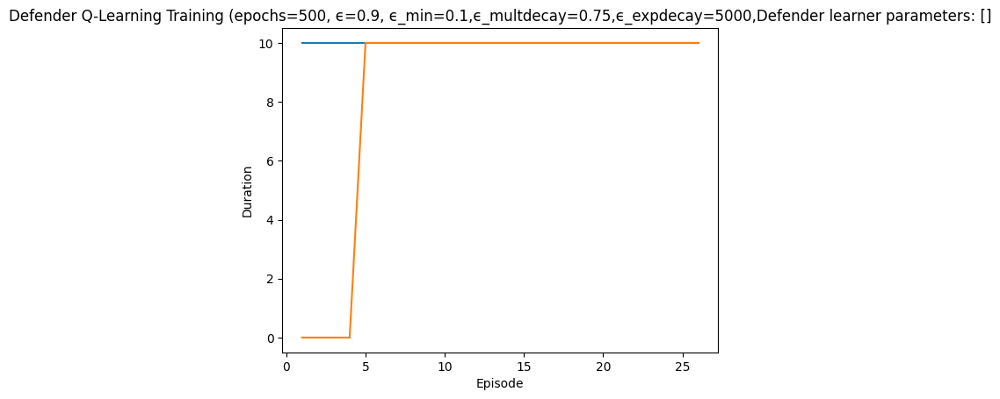

Rendering the current state of the environment
  ## Episode: 27/500 'Defender Q-Learning Training' ϵ=0.6447, Defender learner parameters: []


Episode 27|Iteration 1|reward:   25.0|last_reward_at: ----|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=7, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 261, 'successful_actions': 108, 'failed_actions': 153}, 'network_availability': 1.0}


Episode 27|Iteration 2|reward:   10.0|last_reward_at:    1|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 262, 'successful_actions': 108, 'failed_actions': 154}, 'network_availability': 1.0}


Episode 27|Iteration 10|reward:  -15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 263, 'successful_actions': 108, 'failed_actions': 155}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 4: Action Taken: Type=Block Traffic, NodeID=8, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 264, 'successful_actions': 109, 'failed_actions': 155}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 5: Action

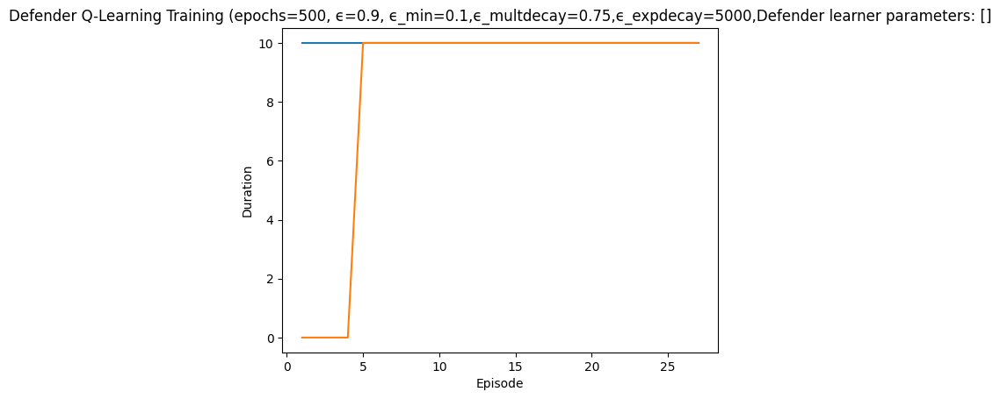

Rendering the current state of the environment
  ## Episode: 28/500 'Defender Q-Learning Training' ϵ=0.6436, Defender learner parameters: []


Episode 28|Iteration 10|reward:   15.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 271, 'successful_actions': 111, 'failed_actions': 160}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 272, 'successful_actions': 111, 'failed_actions': 161}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: A

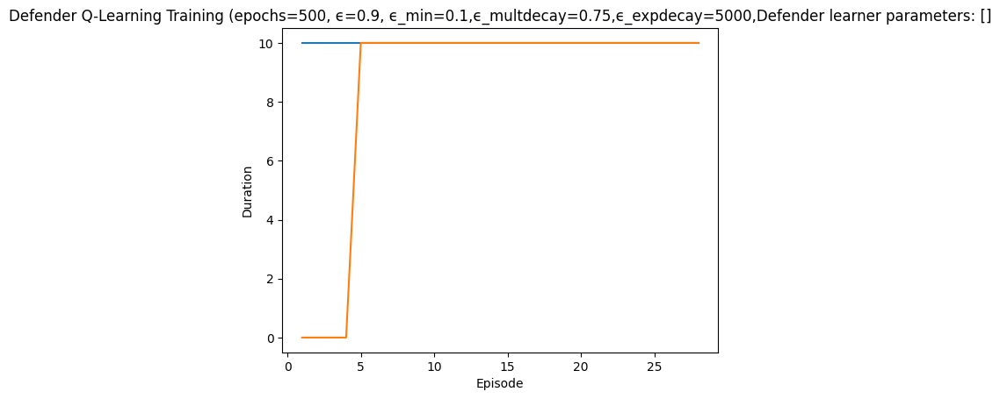

Rendering the current state of the environment
  ## Episode: 29/500 'Defender Q-Learning Training' ϵ=0.6424, Defender learner parameters: []


Episode 29|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 281, 'successful_actions': 113, 'failed_actions': 168}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=9, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 282, 'successful_actions': 113, 'failed_actions': 169}, 'network_availability': 1.0}
acti

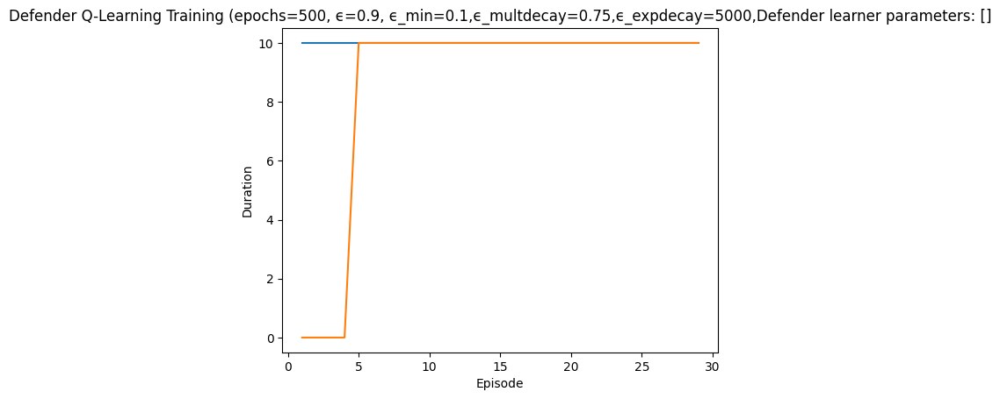

Rendering the current state of the environment
  ## Episode: 30/500 'Defender Q-Learning Training' ϵ=0.6413, Defender learner parameters: []


Episode 30|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 291, 'successful_actions': 120, 'failed_actions': 171}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 292, 'successful_actions': 121, 'failed_actions': 171}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not fo

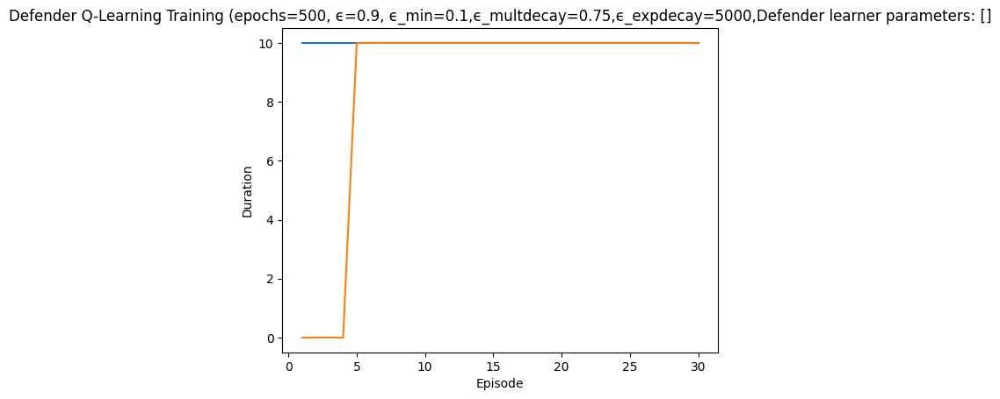

Rendering the current state of the environment
  ## Episode: 31/500 'Defender Q-Learning Training' ϵ=0.6402, Defender learner parameters: []


Episode 31|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 301, 'successful_actions': 124, 'failed_actions': 177}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 302, 'successful_actions': 124, 'failed_actions': 178}, 'network_availability': 1.0}
acti

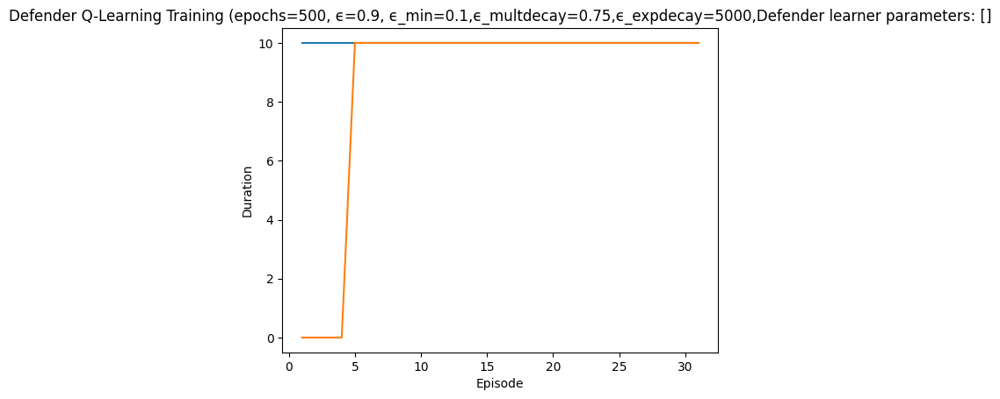

Rendering the current state of the environment
  ## Episode: 32/500 'Defender Q-Learning Training' ϵ=0.6390, Defender learner parameters: []


Episode 32|Iteration 10|reward:  -15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 311, 'successful_actions': 131, 'failed_actions': 180}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 312, 'successful_actions': 131, 'failed_actions': 181}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=8, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode'

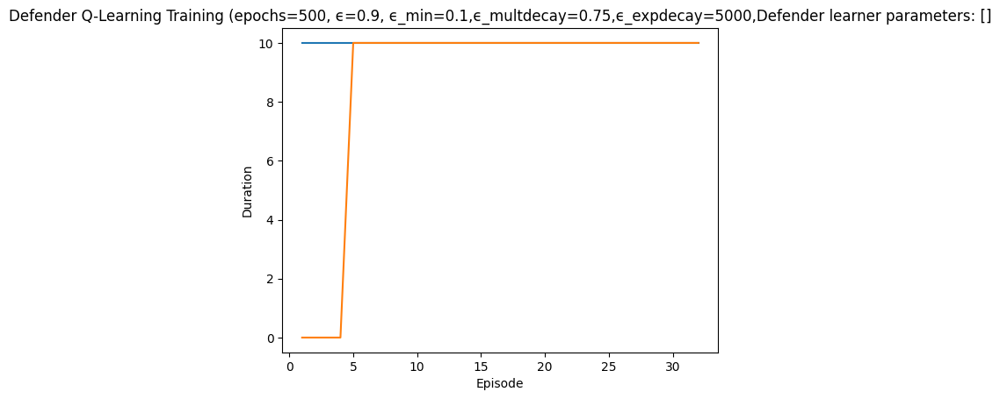

Rendering the current state of the environment
  ## Episode: 33/500 'Defender Q-Learning Training' ϵ=0.6379, Defender learner parameters: []


Episode 33|Iteration 10|reward:   90.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=5
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 321, 'successful_actions': 133, 'failed_actions': 188}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 322, 'successful_actions': 134, 'failed_actions': 188}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=13, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 0, 'perf

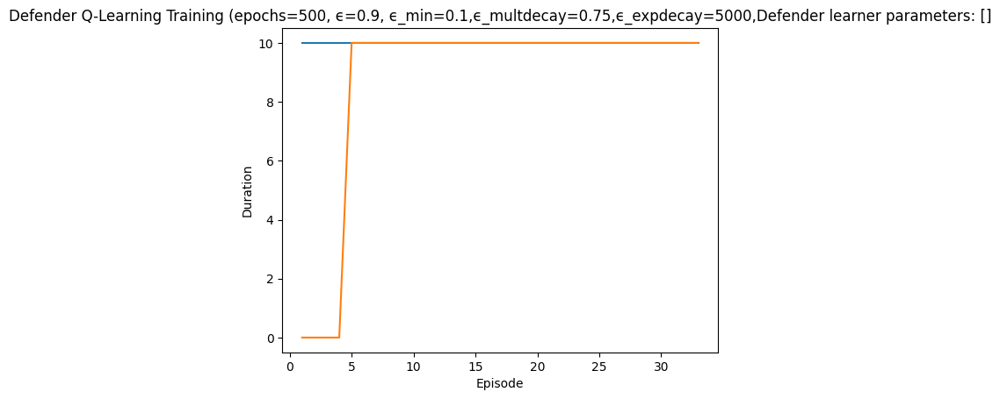

Rendering the current state of the environment
  ## Episode: 34/500 'Defender Q-Learning Training' ϵ=0.6368, Defender learner parameters: []


Episode 34|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 331, 'successful_actions': 139, 'failed_actions': 192}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 332, 'successful_actions': 139, 'failed_actions': 193}, 'network_availability': 1.0}
failed
{'action': 'st

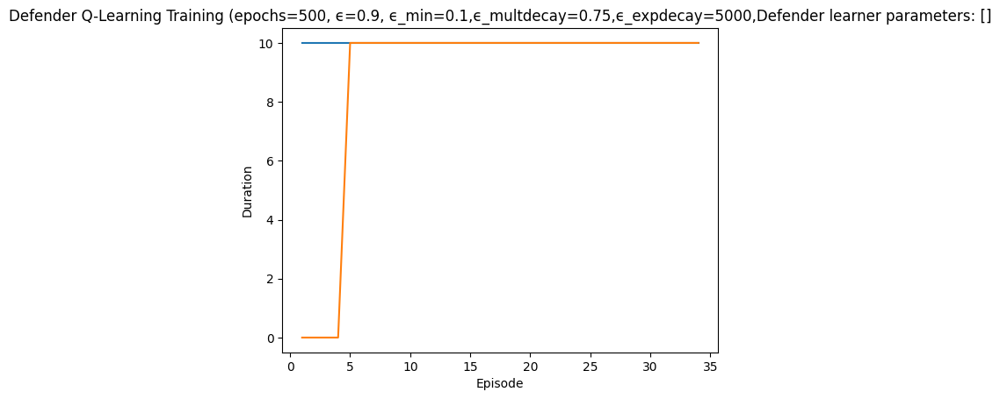

Rendering the current state of the environment
  ## Episode: 35/500 'Defender Q-Learning Training' ϵ=0.6357, Defender learner parameters: []


Episode 35|Iteration 10|reward:   30.0|last_reward_at:    8|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=13, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 341, 'successful_actions': 144, 'failed_actions': 197}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 342, 'successful_actions': 144, 'failed_actions': 198}, 'network_availability': 1.0}
action type: 

Episode 35|Iteration 10|reward:   30.0|last_reward_at:    8|Elapsed Time: 0:00:00||


  Episode 35 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  Episode 35 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 78
    Blocking Traffic Count: 68
    Stopping Services Count: 0


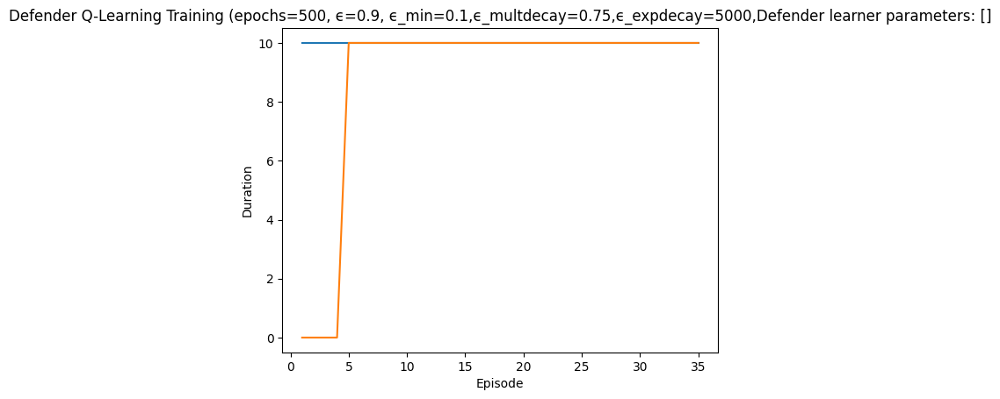

Rendering the current state of the environment
  ## Episode: 36/500 'Defender Q-Learning Training' ϵ=0.6345, Defender learner parameters: []


Episode 36|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 351, 'successful_actions': 147, 'failed_actions': 204}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=10, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 352, 'successful_actions': 147, 'failed_actions': 205}, 'network_availability': 1.0}
action type:  Rei

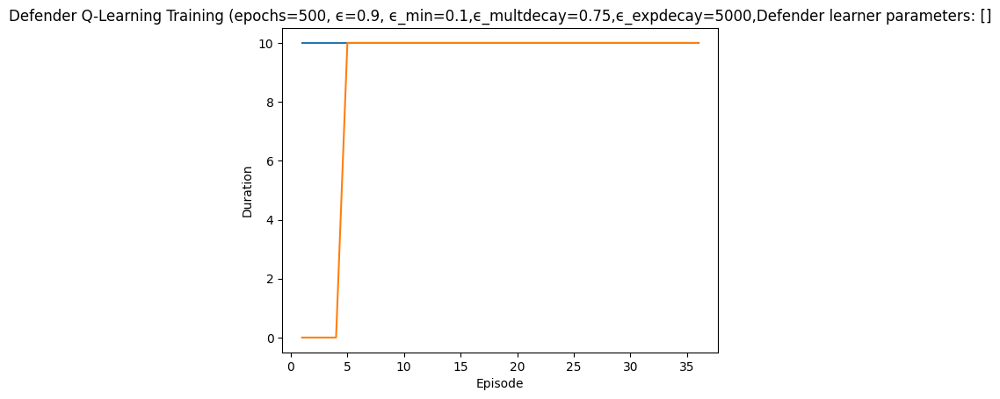

Rendering the current state of the environment
  ## Episode: 37/500 'Defender Q-Learning Training' ϵ=0.6334, Defender learner parameters: []


Episode 37|Iteration 10|reward:   90.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 361, 'successful_actions': 154, 'failed_actions': 207}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 362, 'successful_actions': 154, 'failed_actions': 208}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type

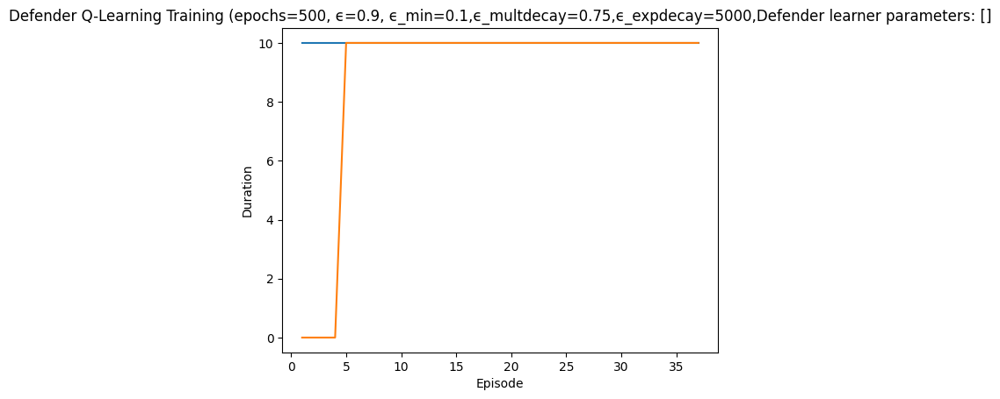

Rendering the current state of the environment
  ## Episode: 38/500 'Defender Q-Learning Training' ϵ=0.6323, Defender learner parameters: []


Episode 38|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 371, 'successful_actions': 160, 'failed_actions': 211}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 372, 'successful_actions': 160, 'failed_actions': 212}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Ite

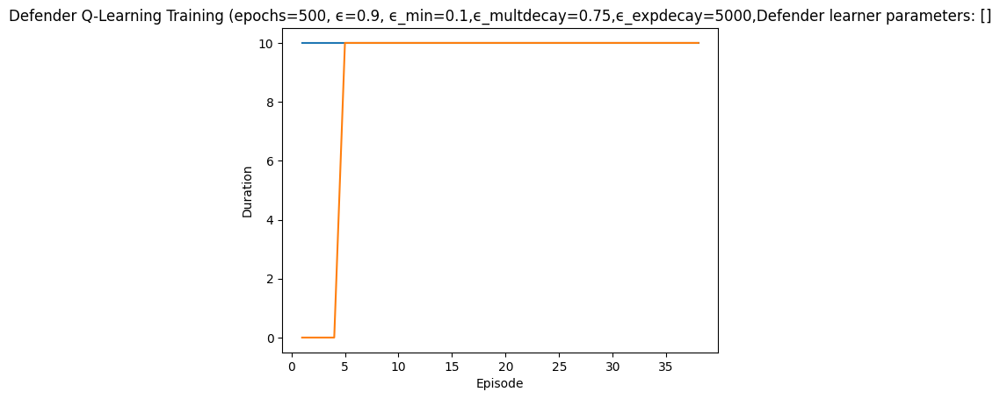

Rendering the current state of the environment
  ## Episode: 39/500 'Defender Q-Learning Training' ϵ=0.6312, Defender learner parameters: []


Episode 39|Iteration 10|reward:   95.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 381, 'successful_actions': 164, 'failed_actions': 217}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 382, 'successful_actions': 165, 'failed_actions': 217}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Ac

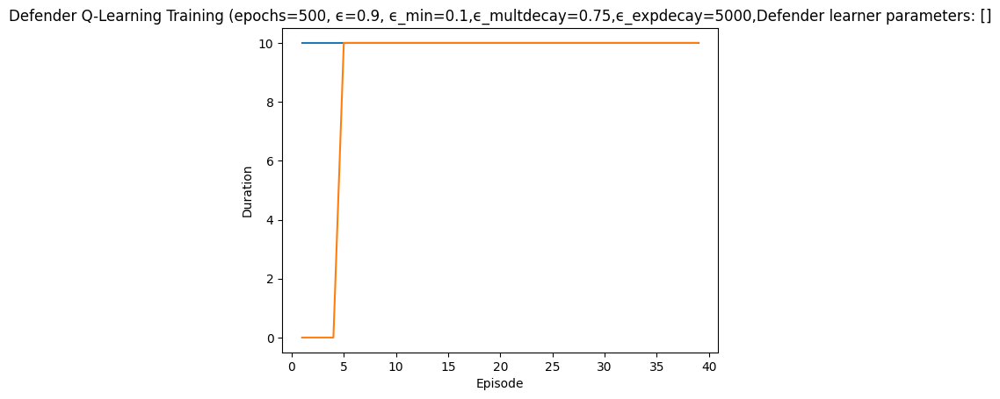

Rendering the current state of the environment
  ## Episode: 40/500 'Defender Q-Learning Training' ϵ=0.6301, Defender learner parameters: []


Episode 40|Iteration 7|reward:   45.0|last_reward_at:    6|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=10, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 391, 'successful_actions': 169, 'failed_actions': 222}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=3, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 392, 'successful_actions': 170, 'failed_actions': 222}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: 

Episode 40|Iteration 8|reward:   30.0|last_reward_at:    7|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 8: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 398, 'successful_actions': 172, 'failed_actions': 226}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 9: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=8
info

Episode 40|Iteration 10|reward:   15.0|last_reward_at:    7|Elapsed Time: 0:00:00||


 {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 399, 'successful_actions': 172, 'failed_actions': 227}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=0, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 400, 'successful_actions': 172, 'failed_actions': 228}, 'network_availability': 1.0}
  Episode 40 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  expl

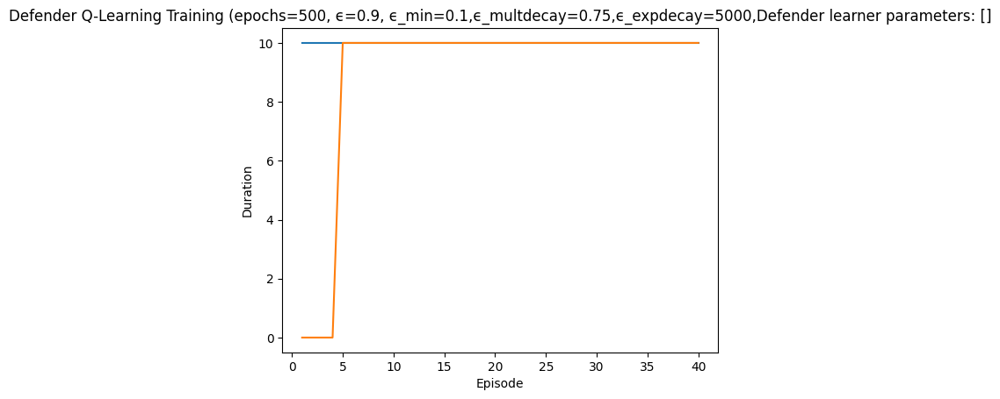

Rendering the current state of the environment
  ## Episode: 41/500 'Defender Q-Learning Training' ϵ=0.6290, Defender learner parameters: []


Episode 41|Iteration 3|reward:   35.0|last_reward_at:    2|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 401, 'successful_actions': 173, 'failed_actions': 228}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=10, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 402, 'successful_actions': 174, 'failed_actions': 228}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=7, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not f

Episode 41|Iteration 8|reward:  -25.0|last_reward_at:    2|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 6: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 406, 'successful_actions': 174, 'failed_actions': 232}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 7: Action Taken: Type=Start Service, NodeID=12, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 407, 'successful_actions': 174, 'failed_actions': 233}, 'network_availability': 1.0}
failed
{'action': '

Episode 41|Iteration 10|reward:  -40.0|last_reward_at:    2|Elapsed Time: 0:00:00||



Iteration 10: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 410, 'successful_actions': 174, 'failed_actions': 236}, 'network_availability': 1.0}
  Episode 41 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  Episode 41 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 94
    Blocking Traffic Count: 79
    Stopping Services Count: 0


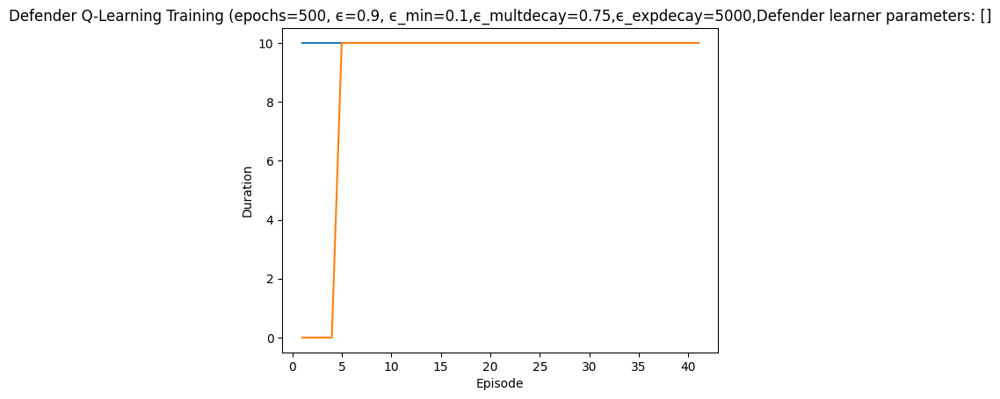

Rendering the current state of the environment
  ## Episode: 42/500 'Defender Q-Learning Training' ϵ=0.6279, Defender learner parameters: []


Episode 42|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=3, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 411, 'successful_actions': 174, 'failed_actions': 237}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 412, 'successful_actions': 175, 'failed_actions': 237}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Actio

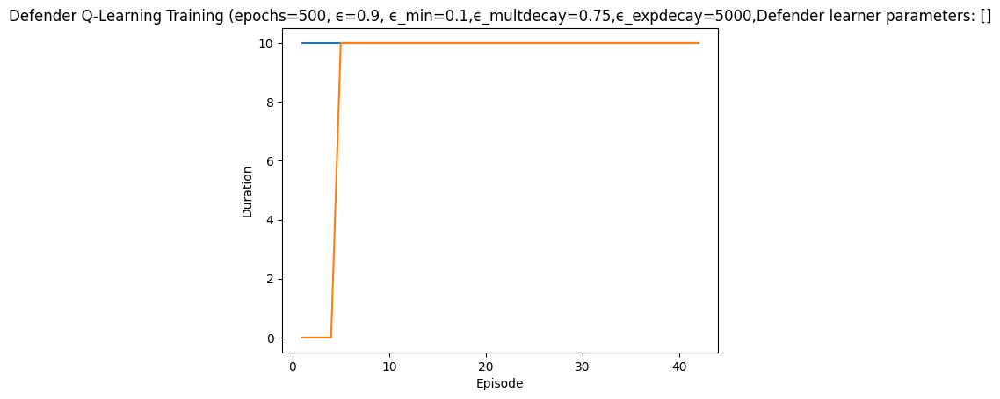

Rendering the current state of the environment
  ## Episode: 43/500 'Defender Q-Learning Training' ϵ=0.6268, Defender learner parameters: []


Episode 43|Iteration 10|reward:   25.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 421, 'successful_actions': 179, 'failed_actions': 242}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=12, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 422, 'successful_actions': 180, 'failed_actions': 242}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=5, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_na

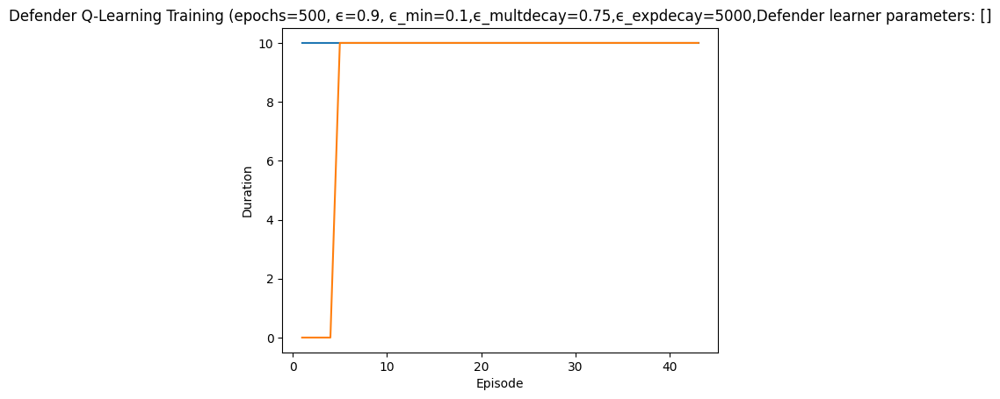

Rendering the current state of the environment
  ## Episode: 44/500 'Defender Q-Learning Training' ϵ=0.6257, Defender learner parameters: []


Episode 44|Iteration 10|reward:  105.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 431, 'successful_actions': 184, 'failed_actions': 247}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=9, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 432, 'successful_actions': 185, 'failed_actions': 247}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=4, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 433, 'successful_actions': 186, 'failed_actions': 247}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 4: Actio

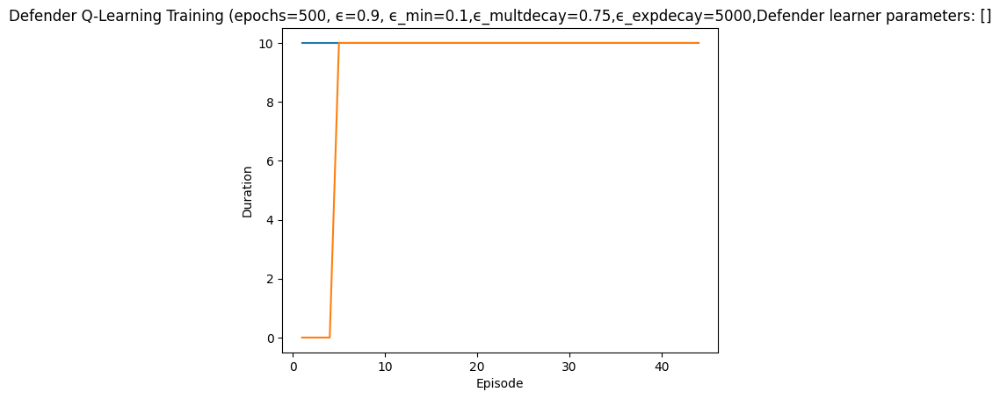

Rendering the current state of the environment
  ## Episode: 45/500 'Defender Q-Learning Training' ϵ=0.6246, Defender learner parameters: []


Episode 45|Iteration 10|reward:  -25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 441, 'successful_actions': 189, 'failed_actions': 252}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 442, 'successful_actions': 189, 'failed_actions': 253}, 'network_availability': 1.0}
failed

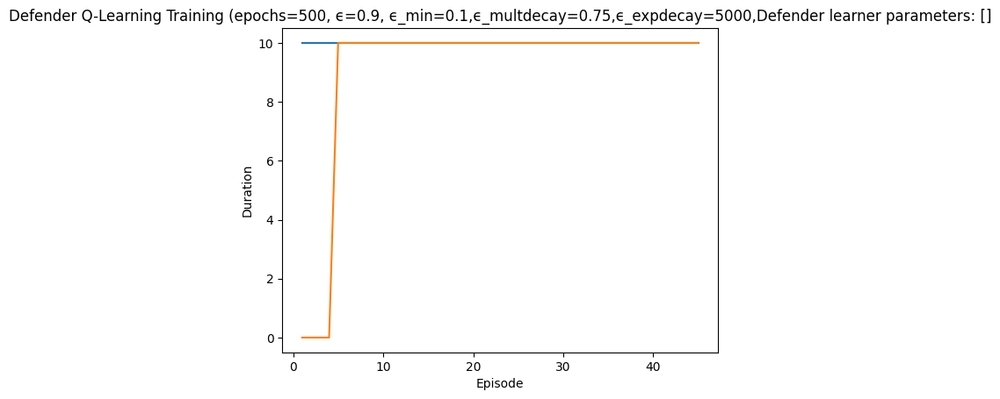

Rendering the current state of the environment
  ## Episode: 46/500 'Defender Q-Learning Training' ϵ=0.6235, Defender learner parameters: []


Episode 46|Iteration 10|reward:   95.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=10, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 451, 'successful_actions': 191, 'failed_actions': 260}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 452, 'successful_actions': 191, 'failed_actions': 261}, 'network_availability': 1.0}
acti

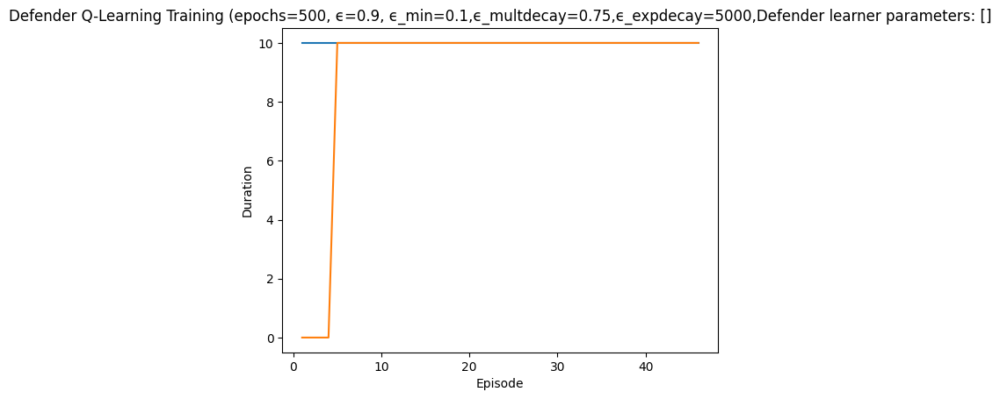

Rendering the current state of the environment
  ## Episode: 47/500 'Defender Q-Learning Training' ϵ=0.6224, Defender learner parameters: []


Episode 47|Iteration 10|reward:  130.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 461, 'successful_actions': 197, 'failed_actions': 264}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 462, 'successful_actions': 198, 'failed_actions': 264}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=2, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 463, 'successful_actions': 199, 'failed_actions': 264}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 4

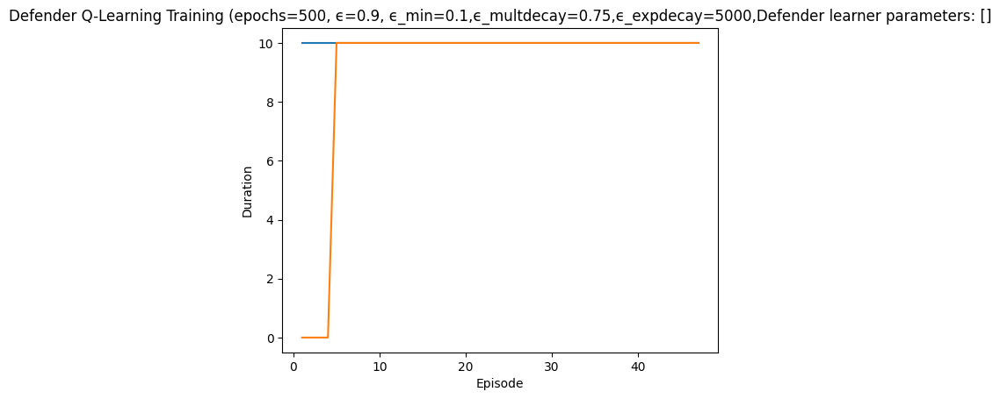

Rendering the current state of the environment
  ## Episode: 48/500 'Defender Q-Learning Training' ϵ=0.6213, Defender learner parameters: []


Episode 48|Iteration 10|reward:  -40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=9, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 471, 'successful_actions': 203, 'failed_actions': 268}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 472, 'successful_actions': 203, 'failed_actions': 269}, 'network_availability': 1.0}
failed
{'action

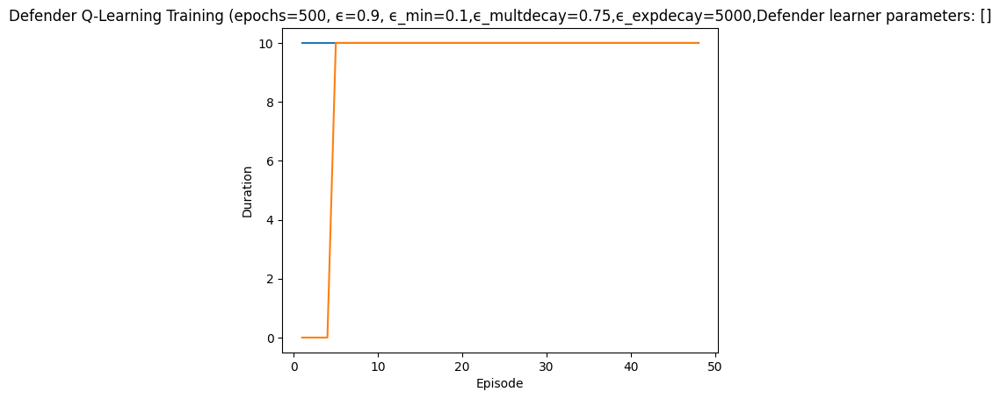

Rendering the current state of the environment
  ## Episode: 49/500 'Defender Q-Learning Training' ϵ=0.6202, Defender learner parameters: []


Episode 49|Iteration 10|reward:  110.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 481, 'successful_actions': 206, 'failed_actions': 275}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=5
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 482, 'successful_actions': 206, 'failed_actions': 276}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=6, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 7, 'performance

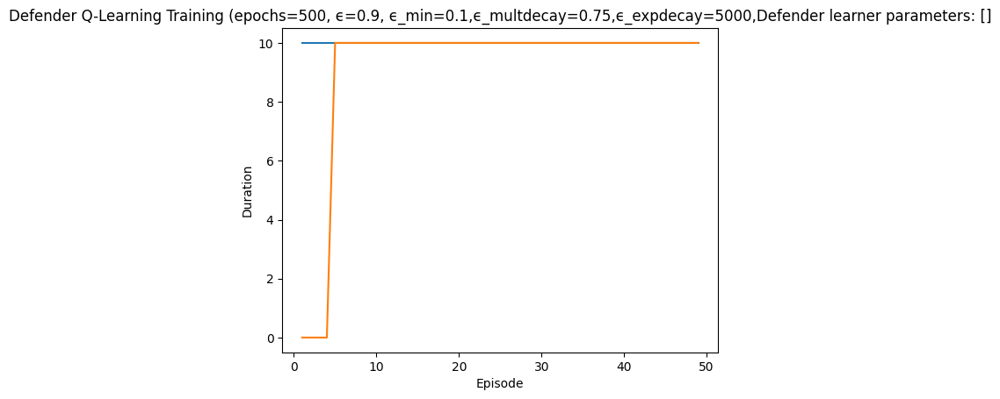

Rendering the current state of the environment
  ## Episode: 50/500 'Defender Q-Learning Training' ϵ=0.6191, Defender learner parameters: []


Episode 50|Iteration 10|reward:  -25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 491, 'successful_actions': 211, 'failed_actions': 280}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=10, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 492, 'successful_actions': 211, 'failed_actions': 281}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Tak

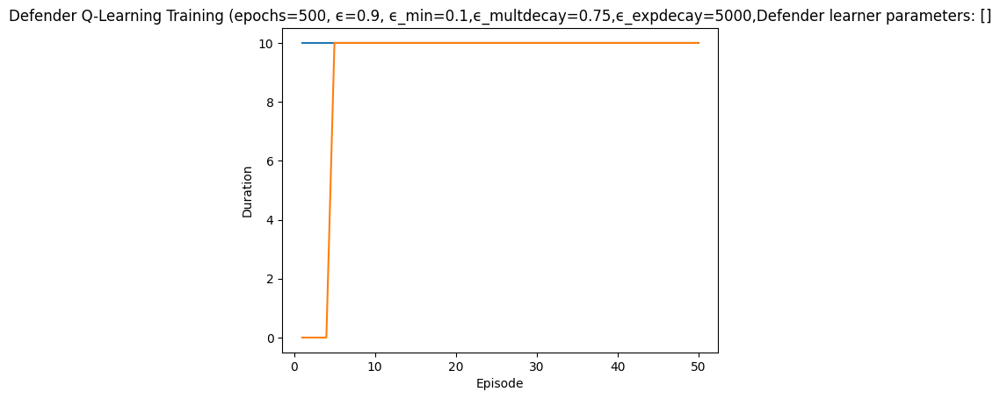

Rendering the current state of the environment
  ## Episode: 51/500 'Defender Q-Learning Training' ϵ=0.6180, Defender learner parameters: []


Episode 51|Iteration 10|reward:  130.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 501, 'successful_actions': 213, 'failed_actions': 288}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 502, 'successful_actions': 214, 'failed_actions': 288}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=10, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 503, 'successful_actions': 215, 'failed_actions': 288}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 4: Ac

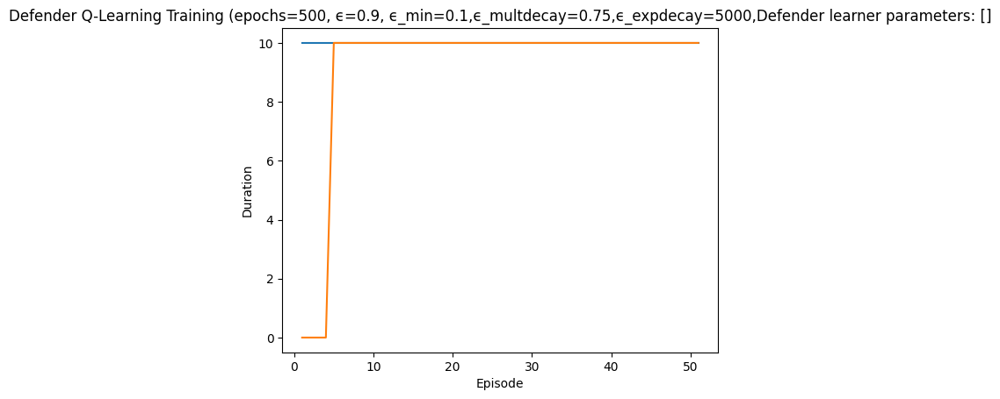

Rendering the current state of the environment
  ## Episode: 52/500 'Defender Q-Learning Training' ϵ=0.6169, Defender learner parameters: []


Episode 52|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=13, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 511, 'successful_actions': 220, 'failed_actions': 291}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=11, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 512, 'successful_actions': 221, 'failed_actions': 291}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=8, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required -

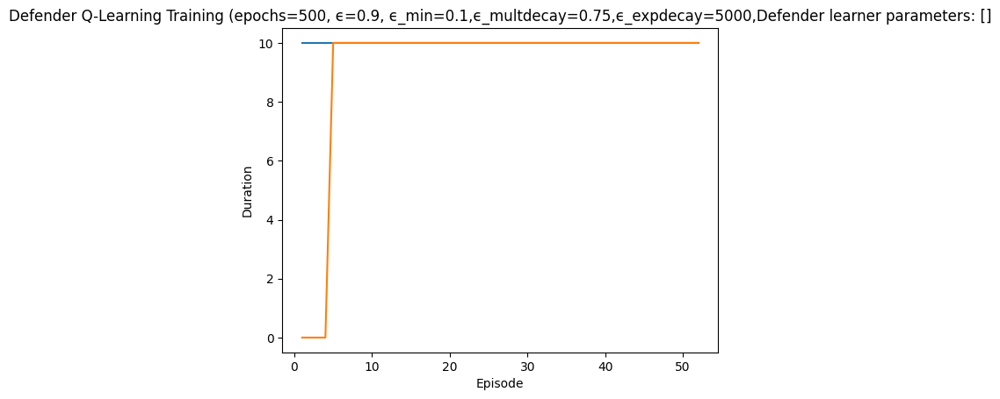

Rendering the current state of the environment
  ## Episode: 53/500 'Defender Q-Learning Training' ϵ=0.6158, Defender learner parameters: []


Episode 53|Iteration 10|reward:   55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 521, 'successful_actions': 226, 'failed_actions': 295}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 522, 'successful_actions': 227, 'failed_actions': 295}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 

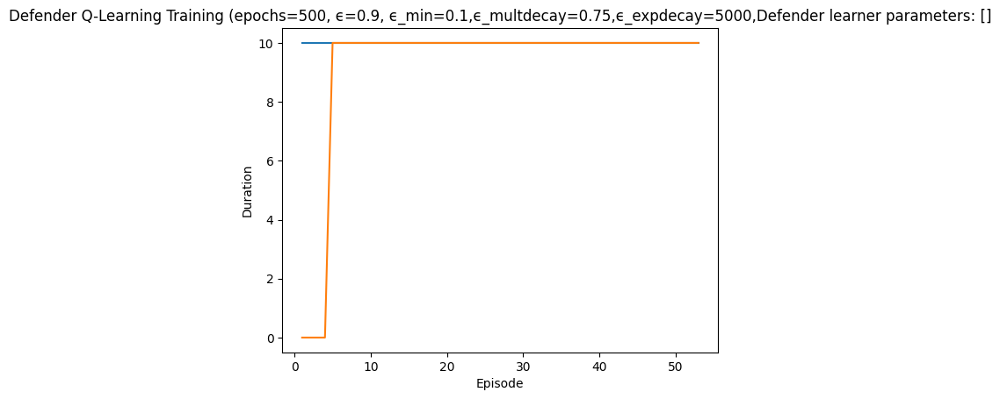

Rendering the current state of the environment
  ## Episode: 54/500 'Defender Q-Learning Training' ϵ=0.6148, Defender learner parameters: []


Episode 54|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 531, 'successful_actions': 230, 'failed_actions': 301}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 532, 'successful_actions': 230, 'failed_actions': 302}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=11, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name

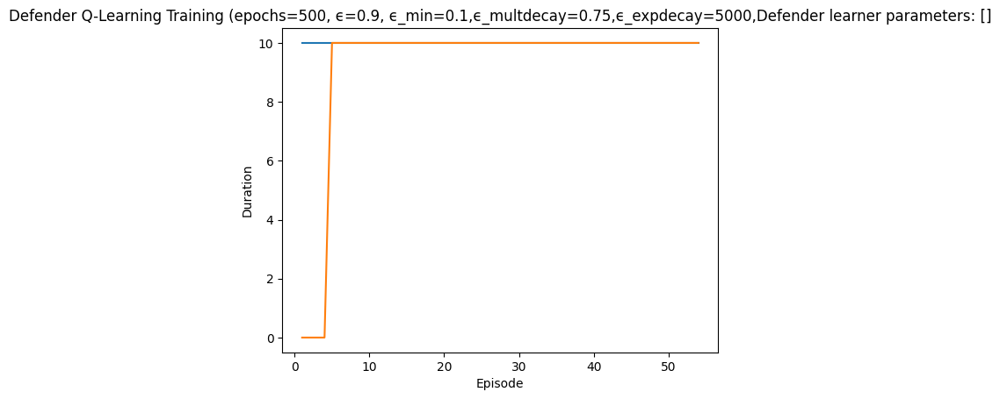

Rendering the current state of the environment
  ## Episode: 55/500 'Defender Q-Learning Training' ϵ=0.6137, Defender learner parameters: []


Episode 55|Iteration 10|reward:   50.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 541, 'successful_actions': 234, 'failed_actions': 307}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=13, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 542, 'successful_actions': 234, 'failed_actions': 308}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=6, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_nam

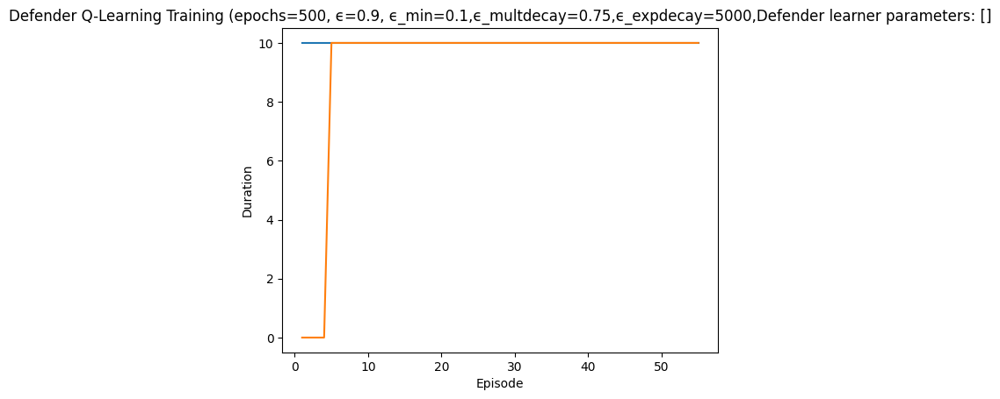

Rendering the current state of the environment
  ## Episode: 56/500 'Defender Q-Learning Training' ϵ=0.6126, Defender learner parameters: []


Episode 56|Iteration 1|reward:   25.0|last_reward_at:    1|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 551, 'successful_actions': 239, 'failed_actions': 312}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 552, 'successful_actions': 239, 'failed_actions': 313}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iterat

Episode 56|Iteration 3|reward:   10.0|last_reward_at:    1|Elapsed Time: 0:00:00||

{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 553, 'successful_actions': 239, 'failed_actions': 314}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  

Episode 56|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


Start Service
Iteration 4: Action Taken: Type=Start Service, NodeID=9, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 554, 'successful_actions': 239, 'failed_actions': 315}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 5: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 555, 'successful_actions': 239, 'failed_actions': 316}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 6: Action Taken: Type=Block Traffic, NodeID=3, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'por

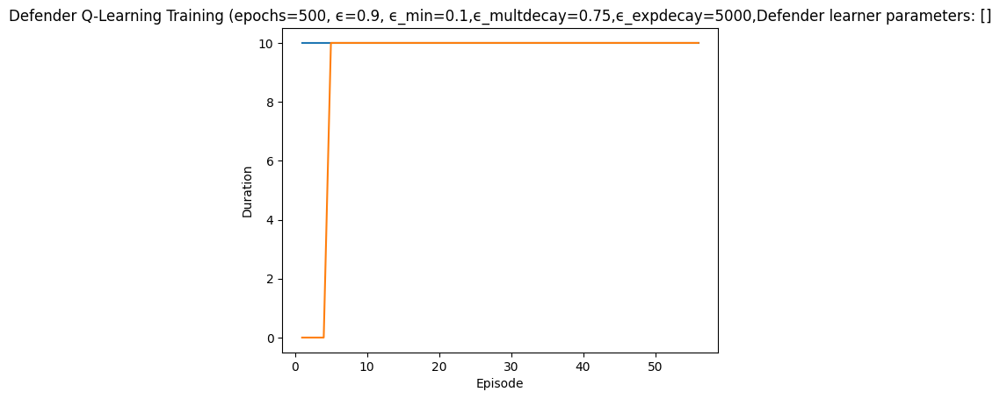

Rendering the current state of the environment
  ## Episode: 57/500 'Defender Q-Learning Training' ϵ=0.6115, Defender learner parameters: []


Episode 57|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 561, 'successful_actions': 242, 'failed_actions': 319}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 562, 'successful_actions': 242, 'failed_actions': 320}, 'network_availability': 1.0}
failed
{'action': 

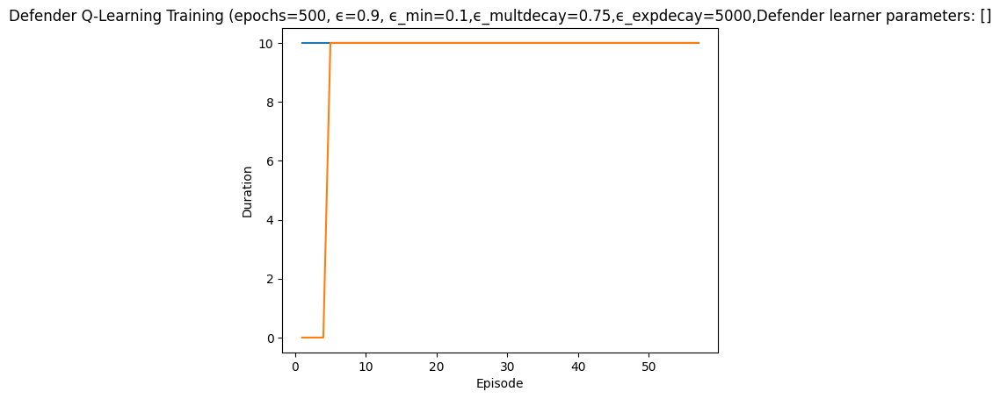

Rendering the current state of the environment
  ## Episode: 58/500 'Defender Q-Learning Training' ϵ=0.6105, Defender learner parameters: []


Episode 58|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=13, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 571, 'successful_actions': 247, 'failed_actions': 324}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=2, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 572, 'successful_actions': 247, 'failed_actions': 325}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=11, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_

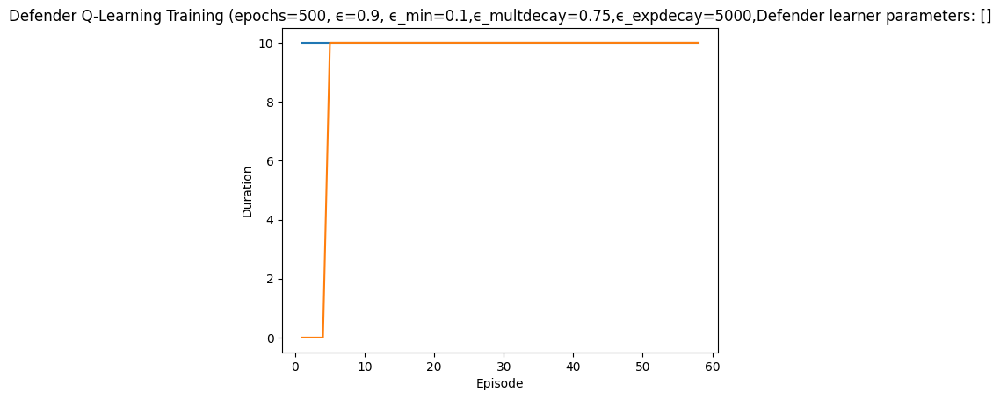

Rendering the current state of the environment
  ## Episode: 59/500 'Defender Q-Learning Training' ϵ=0.6094, Defender learner parameters: []


Episode 59|Iteration 10|reward:    0.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 581, 'successful_actions': 250, 'failed_actions': 331}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 582, 'successful_actions': 251, 'failed_actions': 331}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Ta

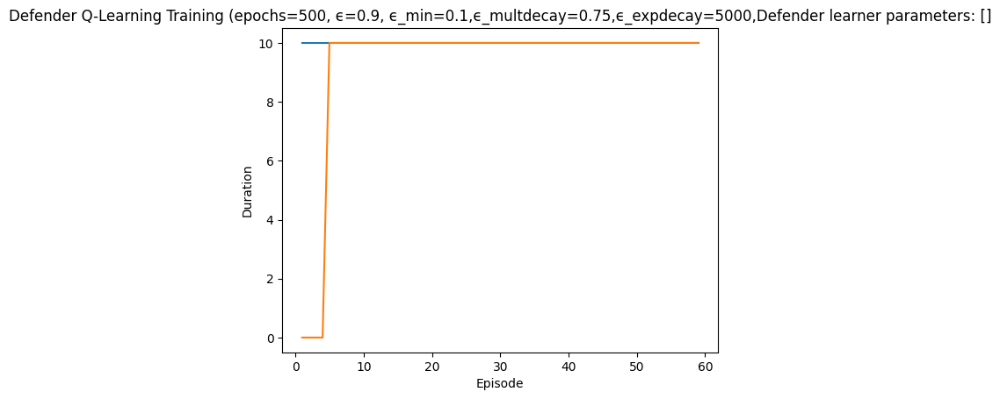

Rendering the current state of the environment
  ## Episode: 60/500 'Defender Q-Learning Training' ϵ=0.6083, Defender learner parameters: []


Episode 60|Iteration 10|reward:    0.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 591, 'successful_actions': 253, 'failed_actions': 338}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 592, 'successful_actions': 253, 'failed_actions': 339}, 'network_availability': 1

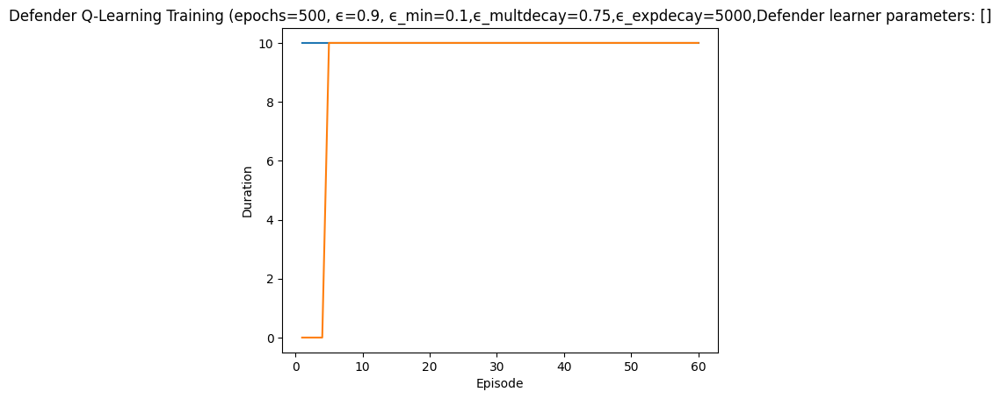

Rendering the current state of the environment
  ## Episode: 61/500 'Defender Q-Learning Training' ϵ=0.6073, Defender learner parameters: []


Episode 61|Iteration 10|reward:   50.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 601, 'successful_actions': 257, 'failed_actions': 344}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 602, 'successful_actions': 257, 'failed_actions': 345}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Ta

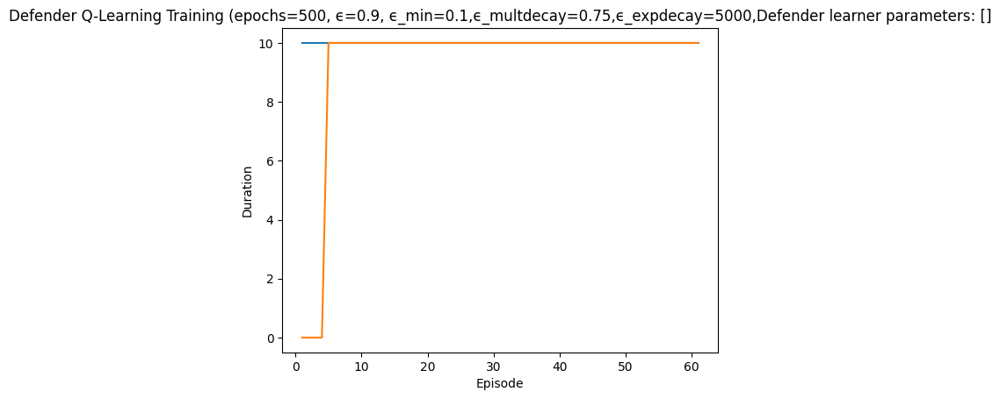

Rendering the current state of the environment
  ## Episode: 62/500 'Defender Q-Learning Training' ϵ=0.6062, Defender learner parameters: []


Episode 62|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 611, 'successful_actions': 262, 'failed_actions': 349}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 612, 'successful_actions': 262, 'failed_actions': 350}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: 

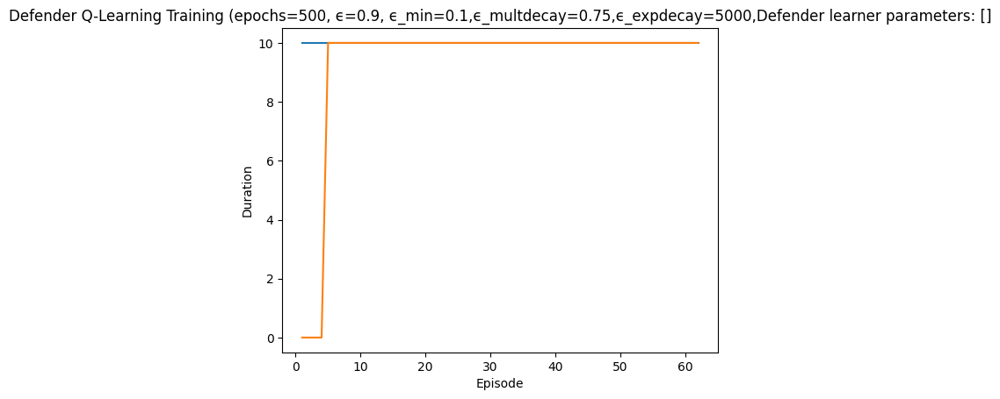

Rendering the current state of the environment
  ## Episode: 63/500 'Defender Q-Learning Training' ϵ=0.6051, Defender learner parameters: []


Episode 63|Iteration 10|reward:    0.0|last_reward_at:    4|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 621, 'successful_actions': 266, 'failed_actions': 355}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 622, 'successful_actions': 267, 'failed_actions': 355}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'perfor

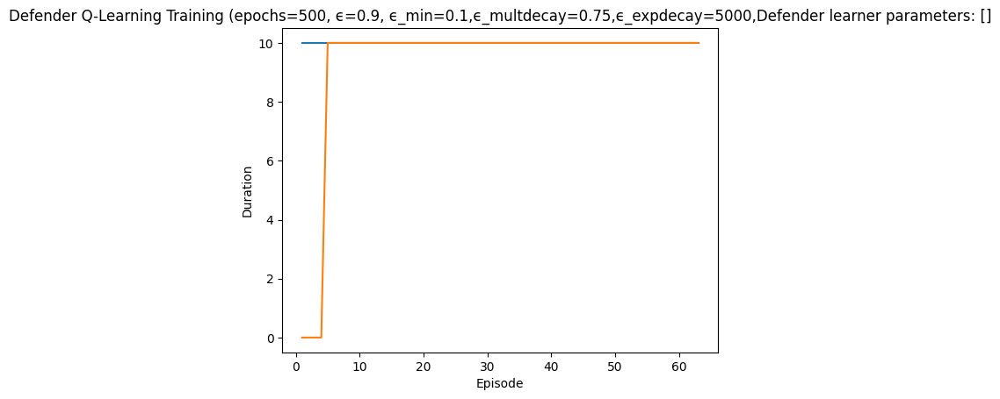

Rendering the current state of the environment
  ## Episode: 64/500 'Defender Q-Learning Training' ϵ=0.6041, Defender learner parameters: []


Episode 64|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=11, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 631, 'successful_actions': 268, 'failed_actions': 363}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 632, 'successful_actions': 268, 'failed_actions': 364}, 'network_availability': 1.0}
f

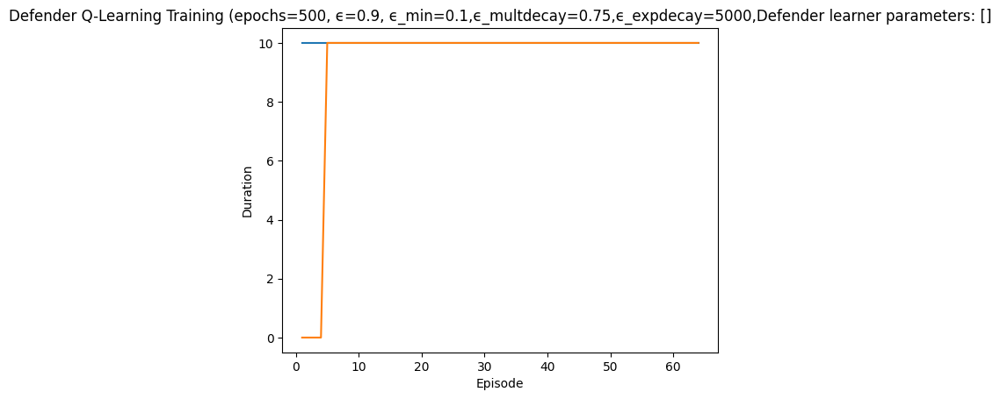

Rendering the current state of the environment
  ## Episode: 65/500 'Defender Q-Learning Training' ϵ=0.6030, Defender learner parameters: []


Episode 65|Iteration 10|reward:  120.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=12, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 641, 'successful_actions': 271, 'failed_actions': 370}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=13, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 642, 'successful_actions': 272, 'failed_actions': 370}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration

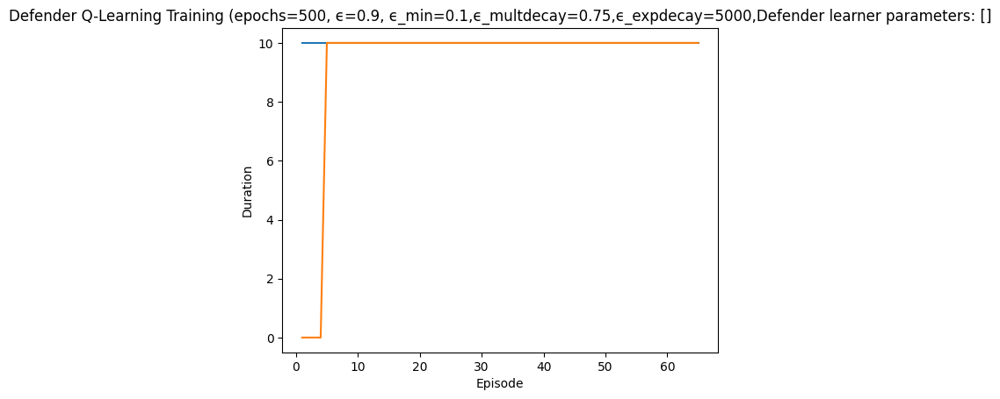

Rendering the current state of the environment
  ## Episode: 66/500 'Defender Q-Learning Training' ϵ=0.6020, Defender learner parameters: []


Episode 66|Iteration 10|reward:  145.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 651, 'successful_actions': 278, 'failed_actions': 373}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 652, 'successful_actions': 279, 'failed_actions': 373}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=5, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 653, 'successful_actions': 280, 'failed_actions': 373}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 4: Ac

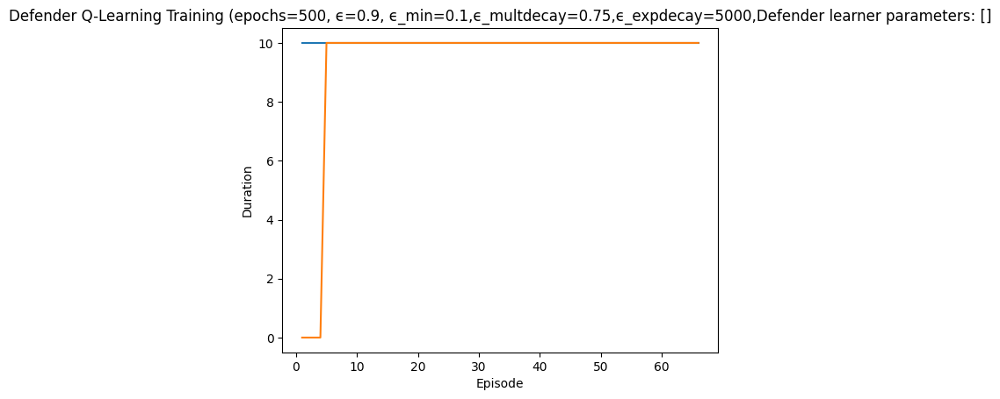

Rendering the current state of the environment
  ## Episode: 67/500 'Defender Q-Learning Training' ϵ=0.6009, Defender learner parameters: []


Episode 67|Iteration 10|reward:   50.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 661, 'successful_actions': 285, 'failed_actions': 376}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=4, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 662, 'successful_actions': 285, 'failed_actions': 377}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=4, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name':

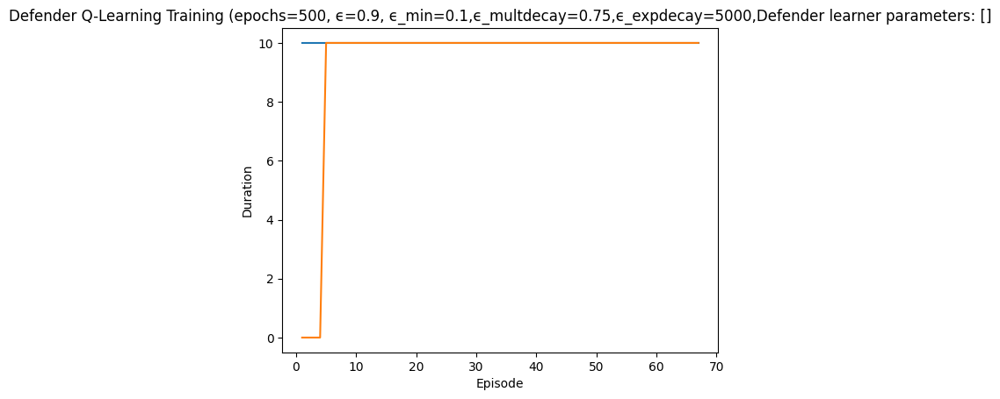

Rendering the current state of the environment
  ## Episode: 68/500 'Defender Q-Learning Training' ϵ=0.5999, Defender learner parameters: []


Episode 68|Iteration 3|reward:   -5.0|last_reward_at:    2|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 671, 'successful_actions': 289, 'failed_actions': 382}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 672, 'successful_actions': 290, 'failed_actions': 382}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken

Episode 68|Iteration 5|reward:   45.0|last_reward_at:    4|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 4: Action Taken: Type=Reimage Node, NodeID=7, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 674, 'successful_actions': 291, 'failed_actions': 383}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 5: Action Taken: Type=Block Traffic, NodeID=5, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 675, 'successful_actions': 292, 'failed_actions': 383}, 'network_availability': 1.0}


Episode 68|Iteration 10|reward:   40.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 6: Action Taken: Type=Reimage Node, NodeID=12, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 676, 'successful_actions': 293, 'failed_actions': 383}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 7: Action Taken: Type=Start Service, NodeID=8, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 677, 'successful_actions': 293, 'failed_actions': 384}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 8: Acti

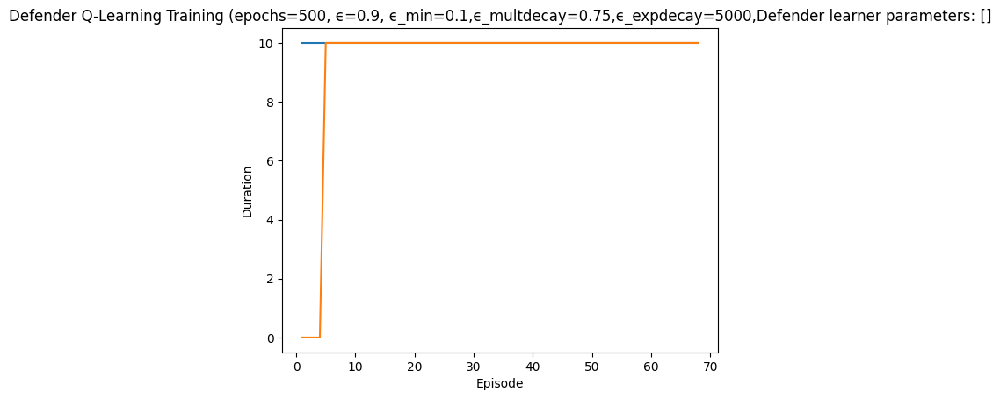

Rendering the current state of the environment
  ## Episode: 69/500 'Defender Q-Learning Training' ϵ=0.5988, Defender learner parameters: []


Episode 69|Iteration 6|reward:   30.0|last_reward_at:    5|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=9, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 681, 'successful_actions': 293, 'failed_actions': 388}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=2, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 682, 'successful_actions': 293, 'failed_actions': 389}, 'network_availability': 1.0}
action type:  Bl

Episode 69|Iteration 9|reward:    0.0|last_reward_at:    5|Elapsed Time: 0:00:00||


Iteration 7: Action Taken: Type=Start Service, NodeID=7, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 687, 'successful_actions': 296, 'failed_actions': 391}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 8: Action Taken: Type=Reimage Node, NodeID=5, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 688, 'successful_actions': 296, 'failed_actions': 392}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
It

Episode 69|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=4, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 690, 'successful_actions': 297, 'failed_actions': 393}, 'network_availability': 1.0}
  Episode 69 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  Episode 69 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 155
    Blocking Traffic Count: 141
    Stopping Services Count: 0


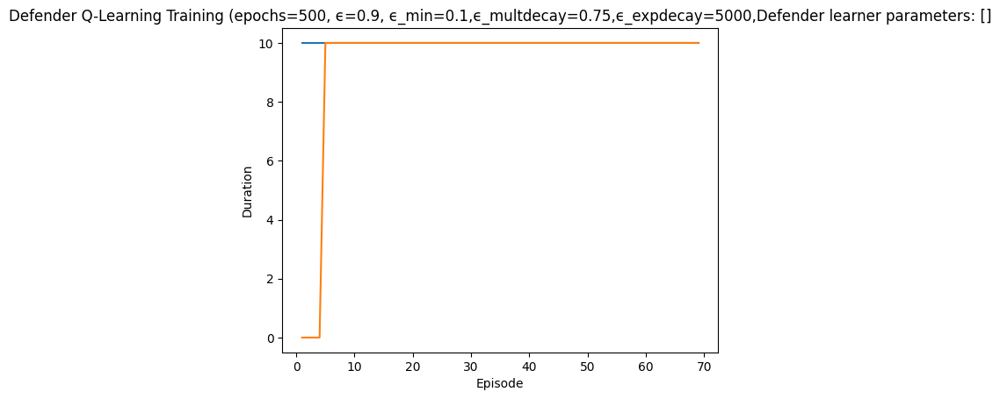

Rendering the current state of the environment
  ## Episode: 70/500 'Defender Q-Learning Training' ϵ=0.5978, Defender learner parameters: []


Episode 70|Iteration 10|reward:  -25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 691, 'successful_actions': 297, 'failed_actions': 394}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=6, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 692, 'successful_actions': 298, 'failed_actions': 394}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 

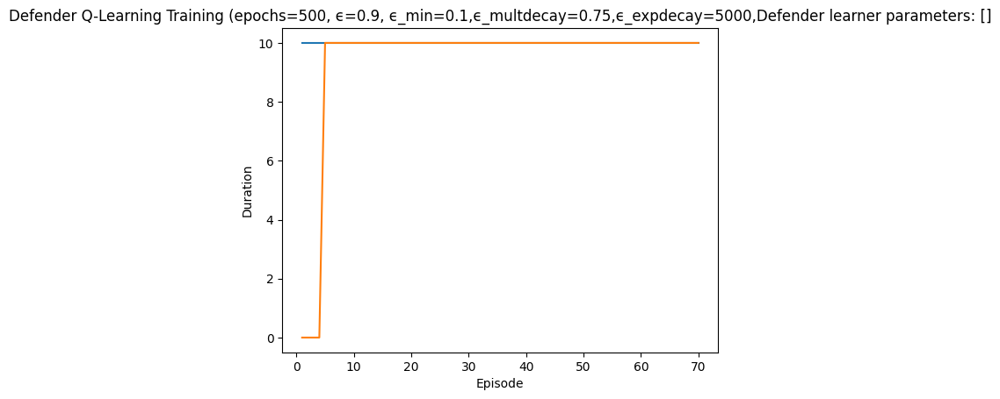

Rendering the current state of the environment
  ## Episode: 71/500 'Defender Q-Learning Training' ϵ=0.5967, Defender learner parameters: []


Episode 71|Iteration 10|reward:   55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=6, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 701, 'successful_actions': 299, 'failed_actions': 402}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 702, 'successful_actions': 299, 'failed_actions': 403}, 'network_availability': 1.0}
failed
{'a

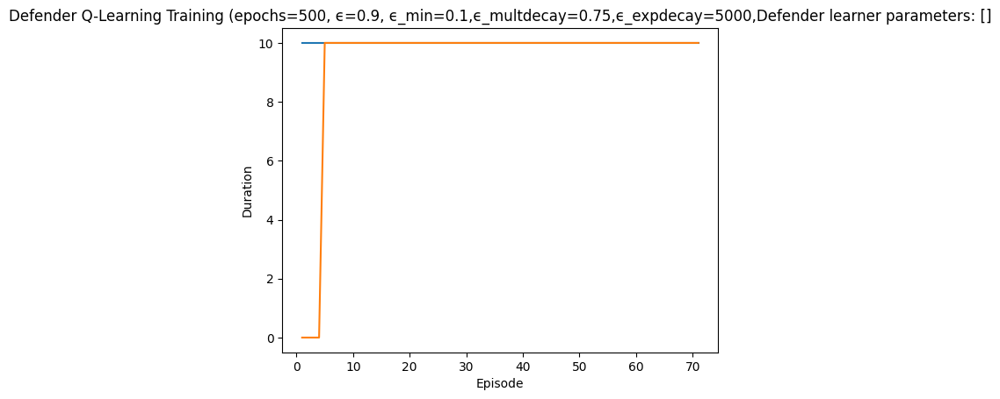

Rendering the current state of the environment
  ## Episode: 72/500 'Defender Q-Learning Training' ϵ=0.5957, Defender learner parameters: []


Episode 72|Iteration 10|reward:  145.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 711, 'successful_actions': 304, 'failed_actions': 407}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 712, 'successful_actions': 304, 'failed_actions': 408}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=12, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name

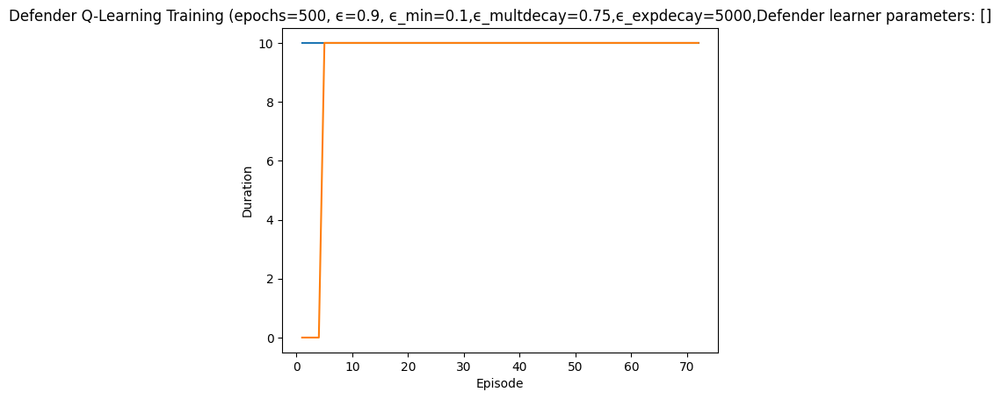

Rendering the current state of the environment
  ## Episode: 73/500 'Defender Q-Learning Training' ϵ=0.5946, Defender learner parameters: []


Episode 73|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 721, 'successful_actions': 310, 'failed_actions': 411}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 722, 'successful_actions': 310, 'failed_actions': 412}, 'network_availability': 1.0}
failed

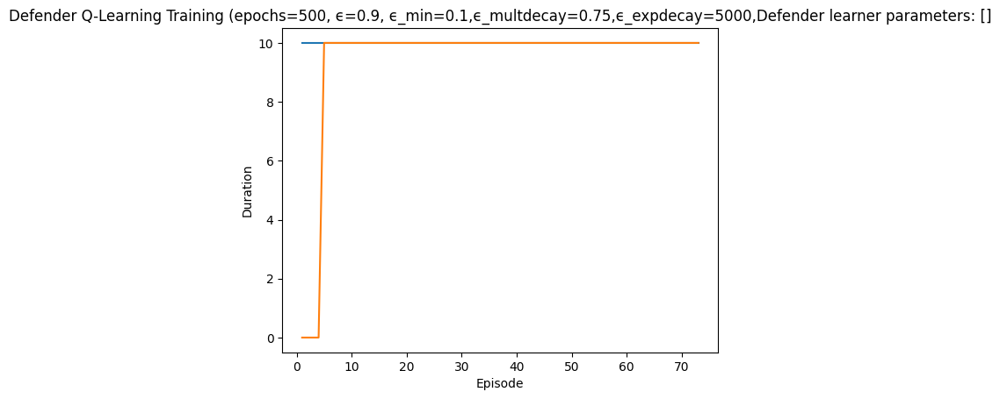

Rendering the current state of the environment
  ## Episode: 74/500 'Defender Q-Learning Training' ϵ=0.5936, Defender learner parameters: []


Episode 74|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 731, 'successful_actions': 313, 'failed_actions': 418}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 732, 'successful_actions': 313, 'failed_actions': 419}, 'network_availability': 1.0}
faile

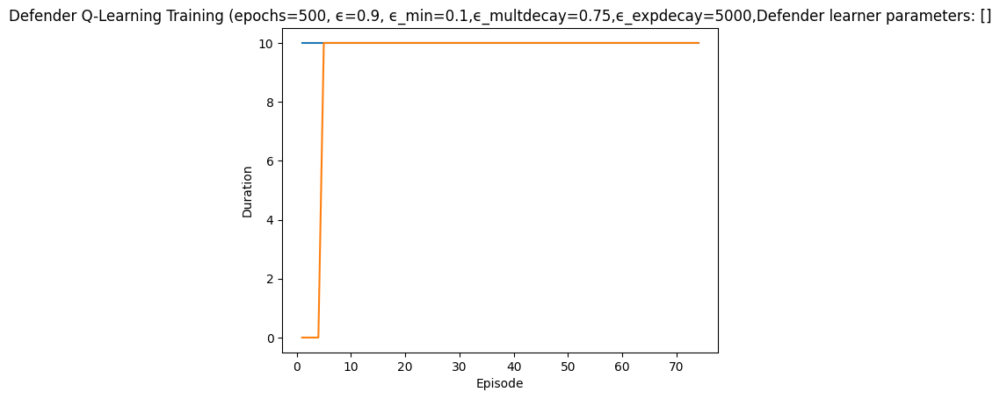

Rendering the current state of the environment
  ## Episode: 75/500 'Defender Q-Learning Training' ϵ=0.5926, Defender learner parameters: []


Episode 75|Iteration 10|reward:  -80.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 741, 'successful_actions': 317, 'failed_actions': 424}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 742, 'successful_actions': 317, 'failed_actions': 425}, 'network_availability': 1.0}
failed
{'action': 'reimage

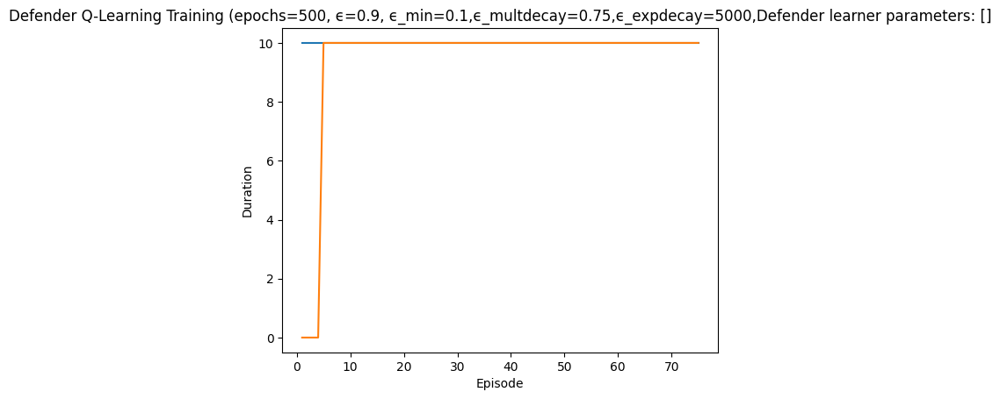

Rendering the current state of the environment
  ## Episode: 76/500 'Defender Q-Learning Training' ϵ=0.5915, Defender learner parameters: []


Episode 76|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 751, 'successful_actions': 318, 'failed_actions': 433}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=0, Parameter=6
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 752, 'successful_actions': 318, 'failed_actions': 434}, 'network_availability': 1.0}
action type:  Reimage N

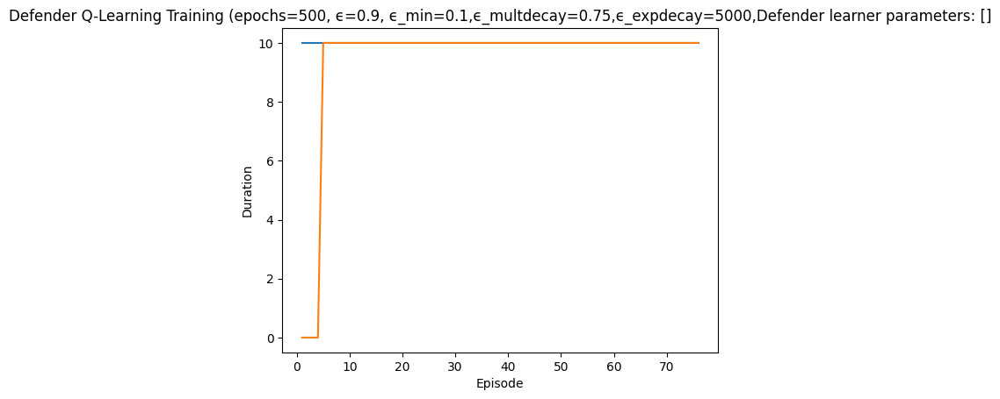

Rendering the current state of the environment
  ## Episode: 77/500 'Defender Q-Learning Training' ϵ=0.5905, Defender learner parameters: []


Episode 77|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 761, 'successful_actions': 322, 'failed_actions': 439}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 762, 'successful_actions': 322, 'failed_actions': 440}, 'network_availability': 1.0}
failed
{'action': 'r

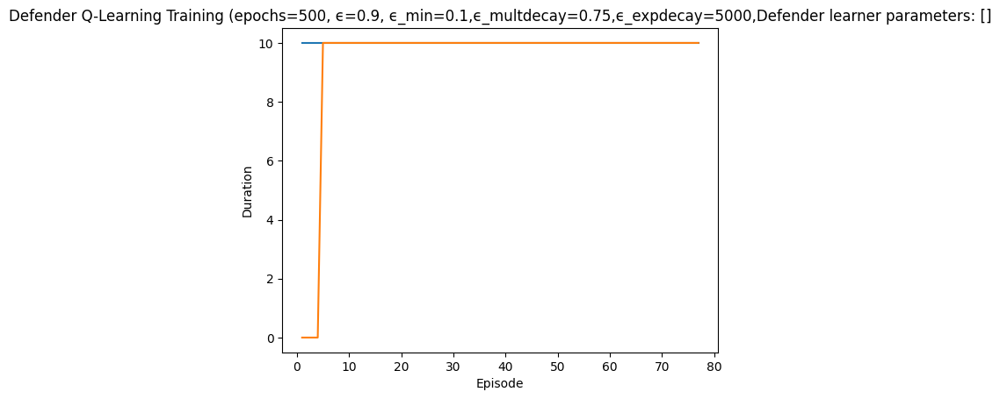

Rendering the current state of the environment
  ## Episode: 78/500 'Defender Q-Learning Training' ϵ=0.5895, Defender learner parameters: []


Episode 78|Iteration 10|reward:  -25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=12, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 771, 'successful_actions': 326, 'failed_actions': 445}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 772, 'successful_actions': 326, 'failed_actions': 446}, 'network_availability': 1.0}
failed
{'acti

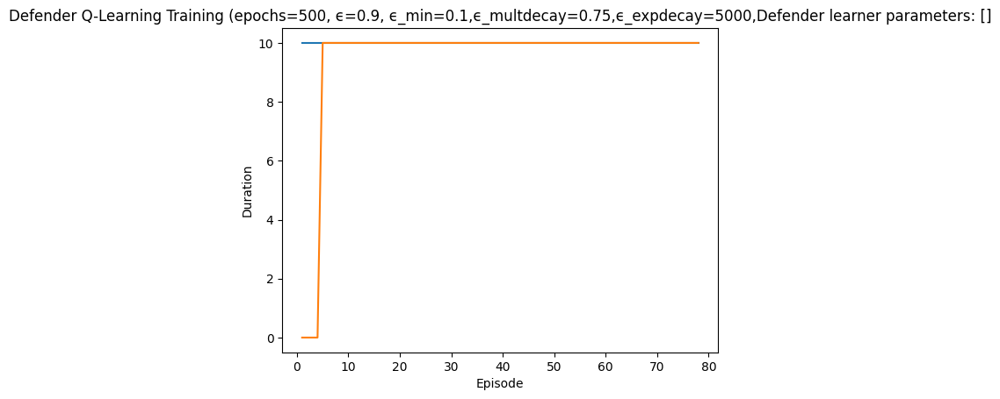

Rendering the current state of the environment
  ## Episode: 79/500 'Defender Q-Learning Training' ϵ=0.5884, Defender learner parameters: []


Episode 79|Iteration 10|reward:    0.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 781, 'successful_actions': 328, 'failed_actions': 453}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 782, 'successful_actions': 329, 'failed_actions': 453}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=11, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name':

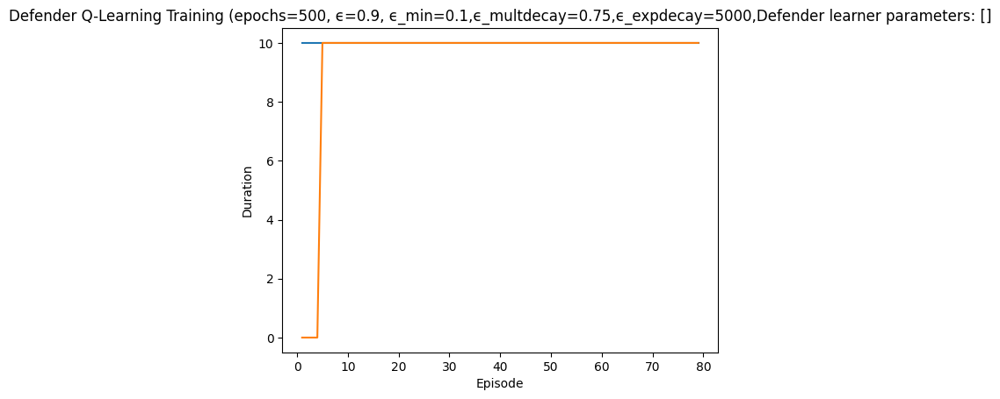

Rendering the current state of the environment
  ## Episode: 80/500 'Defender Q-Learning Training' ϵ=0.5874, Defender learner parameters: []


Episode 80|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 791, 'successful_actions': 331, 'failed_actions': 460}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=3, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 792, 'successful_actions': 332, 'failed_actions': 460}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Ite

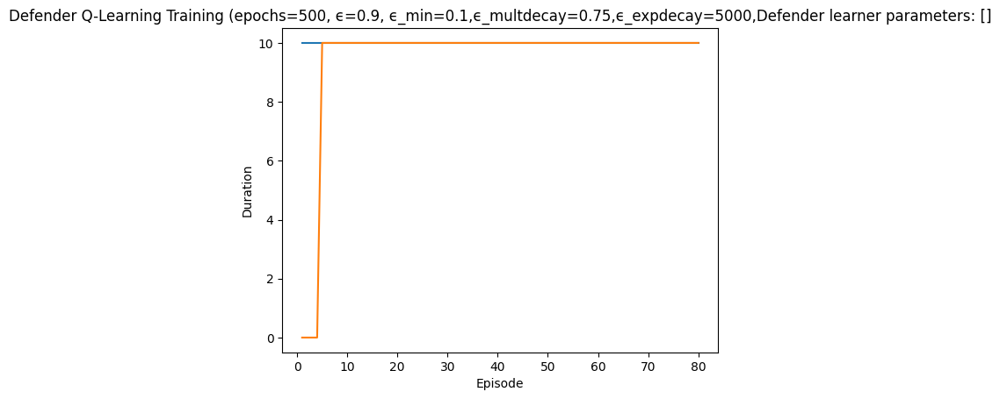

Rendering the current state of the environment
  ## Episode: 81/500 'Defender Q-Learning Training' ϵ=0.5864, Defender learner parameters: []


Episode 81|Iteration 10|reward:   50.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 801, 'successful_actions': 334, 'failed_actions': 467}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=11, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 802, 'successful_actions': 335, 'failed_actions': 467}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=4, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name

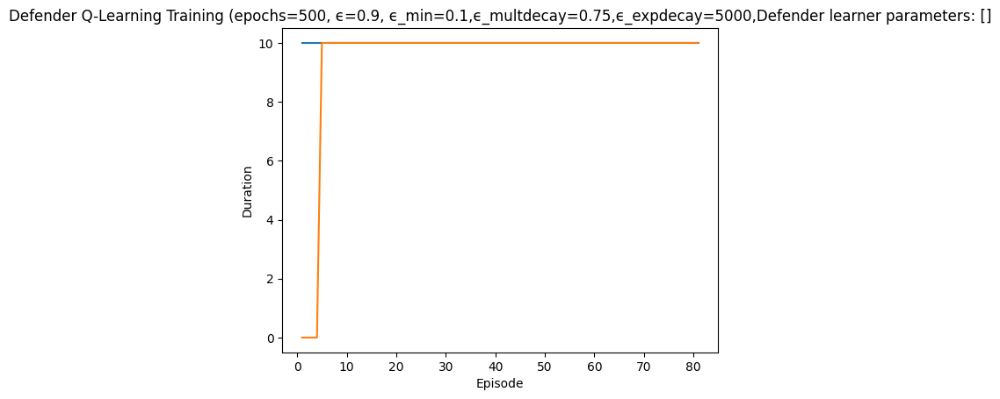

Rendering the current state of the environment
  ## Episode: 82/500 'Defender Q-Learning Training' ϵ=0.5854, Defender learner parameters: []


Episode 82|Iteration 10|reward:   25.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 811, 'successful_actions': 339, 'failed_actions': 472}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 812, 'successful_actions': 340, 'failed_actions': 472}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=1, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_Linu

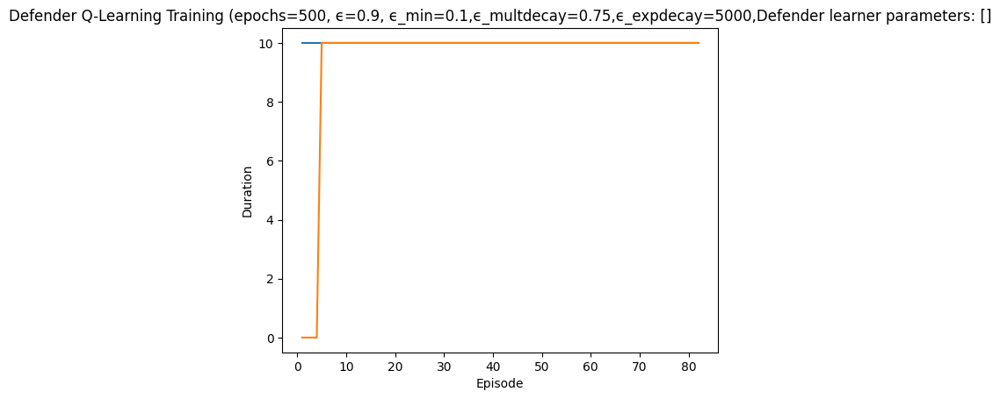

Rendering the current state of the environment
  ## Episode: 83/500 'Defender Q-Learning Training' ϵ=0.5843, Defender learner parameters: []


Episode 83|Iteration 4|reward:   20.0|last_reward_at:    3|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=9, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 821, 'successful_actions': 344, 'failed_actions': 477}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 822, 'successful_actions': 344, 'failed_actions': 478}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 8,

Episode 83|Iteration 6|reward:   30.0|last_reward_at:    5|Elapsed Time: 0:00:00||

 {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 825, 'successful_actions': 346, 'failed_actions': 479}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 6: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 826, 'successful_actions': 346, 'failed_actions': 480}, 'network_availability': 1.0}


Episode 83|Iteration 10|reward:   55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 7: Action Taken: Type=Reimage Node, NodeID=8, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 827, 'successful_actions': 346, 'failed_actions': 481}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 8: Action Taken: Type=Reimage Node, NodeID=10, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 828, 'successful_actions': 346, 'failed_actions': 482}, 'network_availability': 

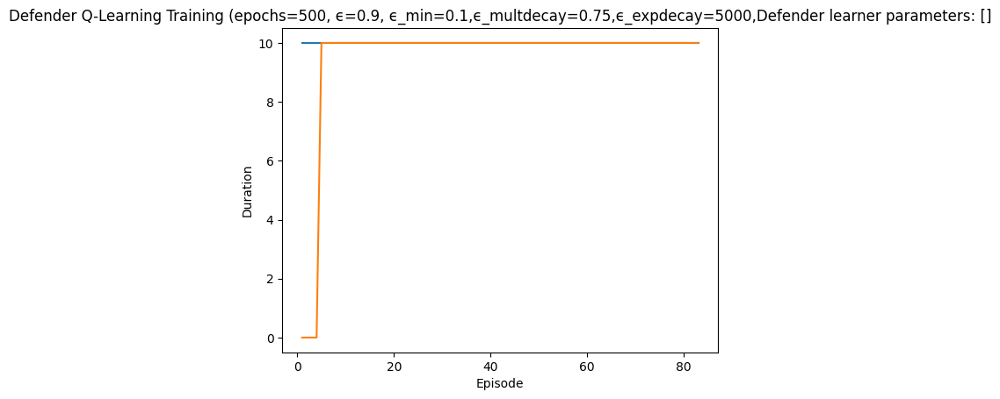

Rendering the current state of the environment
  ## Episode: 84/500 'Defender Q-Learning Training' ϵ=0.5833, Defender learner parameters: []


Episode 84|Iteration 7|reward:   55.0|last_reward_at:    7|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 831, 'successful_actions': 347, 'failed_actions': 484}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 832, 'successful_actions': 348, 'failed_actions': 484}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=2, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 2

Episode 84|Iteration 9|reward:  105.0|last_reward_at:    8|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 8: Action Taken: Type=Reimage Node, NodeID=4, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 838, 'successful_actions': 352, 'failed_actions': 486}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 9: Action Taken: Type=Reimage Node, NodeID=3, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 839, 'successful_actions': 353, 'failed_actions': 486}, 'network_availability': 1.0}


Episode 84|Iteration 10|reward:  130.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=4, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 840, 'successful_actions': 354, 'failed_actions': 486}, 'network_availability': 1.0}
  Episode 84 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  Episode 84 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 186
    Blocking Traffic Count: 167
    Stopping Services Count: 0


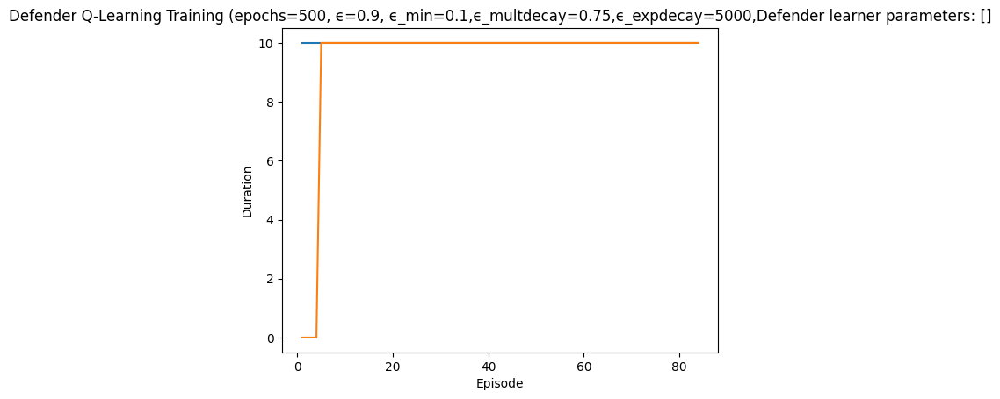

Rendering the current state of the environment
  ## Episode: 85/500 'Defender Q-Learning Training' ϵ=0.5823, Defender learner parameters: []


Episode 85|Iteration 10|reward:   95.0|last_reward_at:   10|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=6, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 841, 'successful_actions': 354, 'failed_actions': 487}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 842, 'successful_actions': 355, 'failed_actions': 487}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=12, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 0,

  Episode 85 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  Episode 85 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 189
    Blocking Traffic Count: 169
    Stopping Services Count: 0


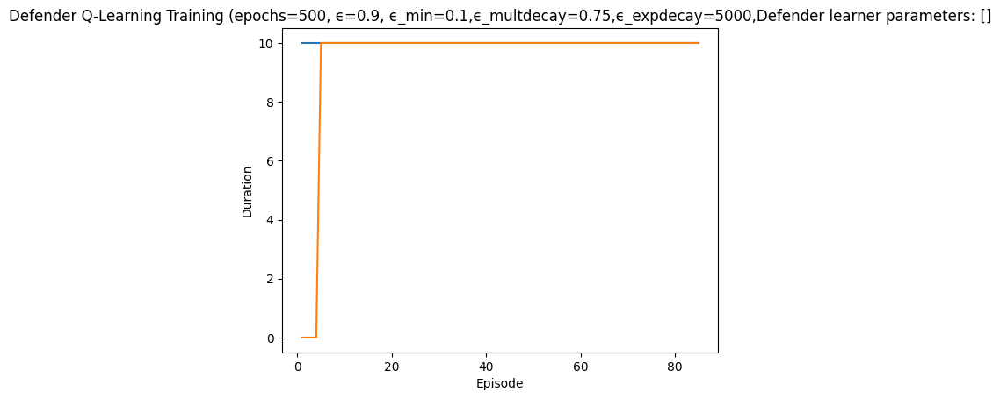

Rendering the current state of the environment
  ## Episode: 86/500 'Defender Q-Learning Training' ϵ=0.5813, Defender learner parameters: []


Episode 86|Iteration 1|reward:   25.0|last_reward_at:    1|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 851, 'successful_actions': 360, 'failed_actions': 491}, 'network_availability': 1.0}


Episode 86|Iteration 10|reward:   70.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 852, 'successful_actions': 360, 'failed_actions': 492}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=6, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 853, 'successful_actions': 361, 'failed_actions': 492}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Itera

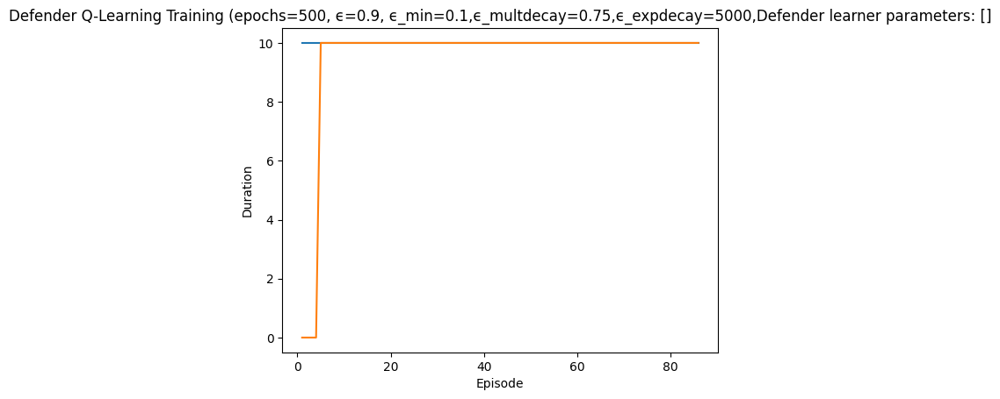

Rendering the current state of the environment
  ## Episode: 87/500 'Defender Q-Learning Training' ϵ=0.5803, Defender learner parameters: []


Episode 87|Iteration 10|reward:   10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=13, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 861, 'successful_actions': 364, 'failed_actions': 497}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 862, 'successful_actions': 365, 'failed_actions': 497}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=0, Parameter=2
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running', 'p

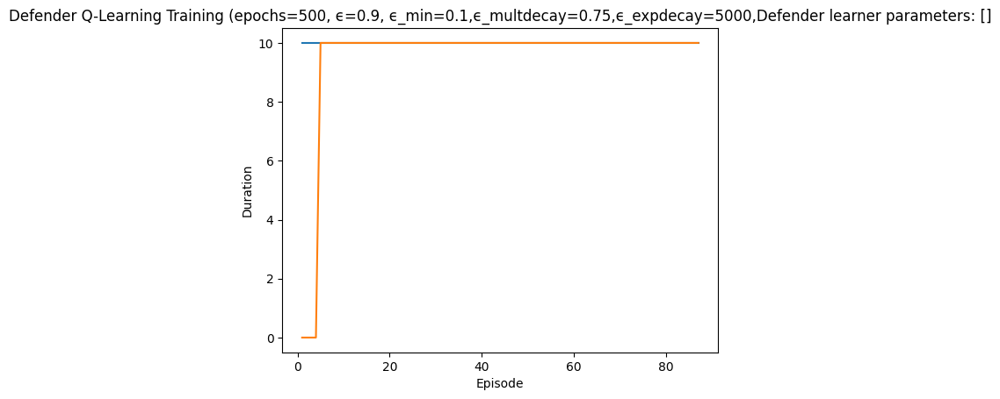

Rendering the current state of the environment
  ## Episode: 88/500 'Defender Q-Learning Training' ϵ=0.5793, Defender learner parameters: []


Episode 88|Iteration 10|reward:   30.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 871, 'successful_actions': 368, 'failed_actions': 503}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=2, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 872, 'successful_actions': 368, 'failed_actions': 504}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Act

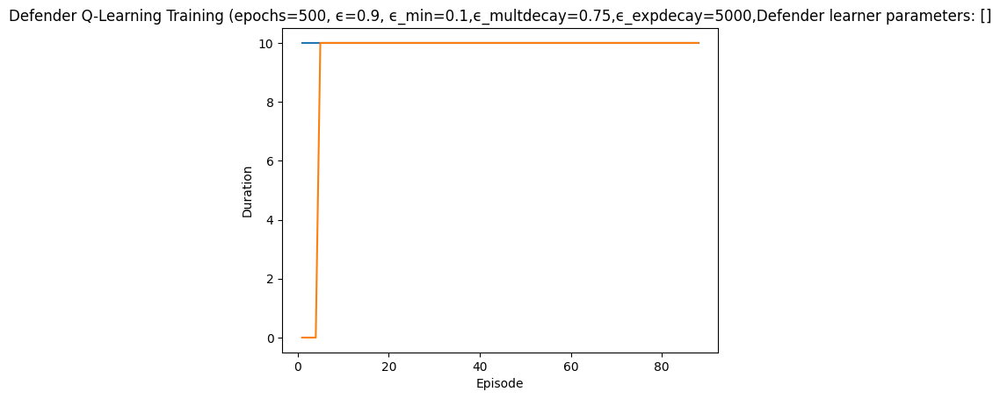

Rendering the current state of the environment
  ## Episode: 89/500 'Defender Q-Learning Training' ϵ=0.5783, Defender learner parameters: []


Episode 89|Iteration 10|reward:  -15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 881, 'successful_actions': 370, 'failed_actions': 511}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=7, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 882, 'successful_actions': 371, 'failed_actions': 511}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=5, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name

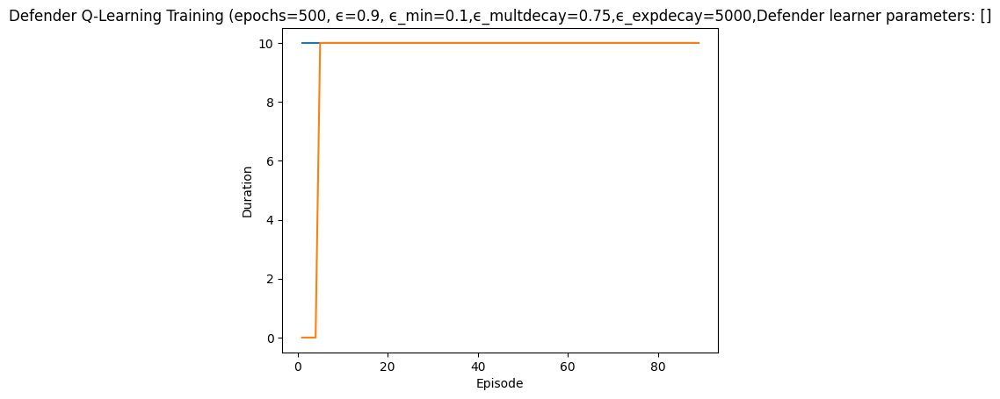

Rendering the current state of the environment
  ## Episode: 90/500 'Defender Q-Learning Training' ϵ=0.5773, Defender learner parameters: []


Episode 90|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=6, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 891, 'successful_actions': 373, 'failed_actions': 518}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 892, 'successful_actions': 373, 'failed_actions': 519}, 'network_availability': 1.0}
fail

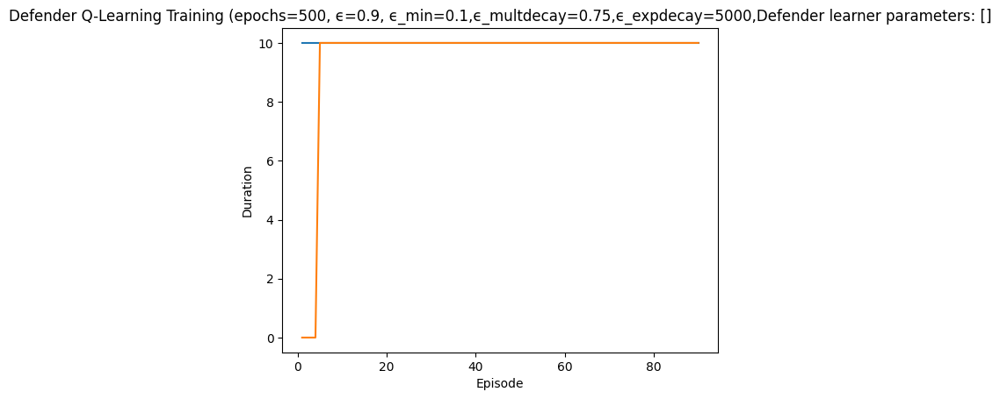

Rendering the current state of the environment
  ## Episode: 91/500 'Defender Q-Learning Training' ϵ=0.5763, Defender learner parameters: []


Episode 91|Iteration 10|reward:  -15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 901, 'successful_actions': 376, 'failed_actions': 525}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 902, 'successful_actions': 376, 'failed_actions': 526}, 'network_availability': 1.0}
fail

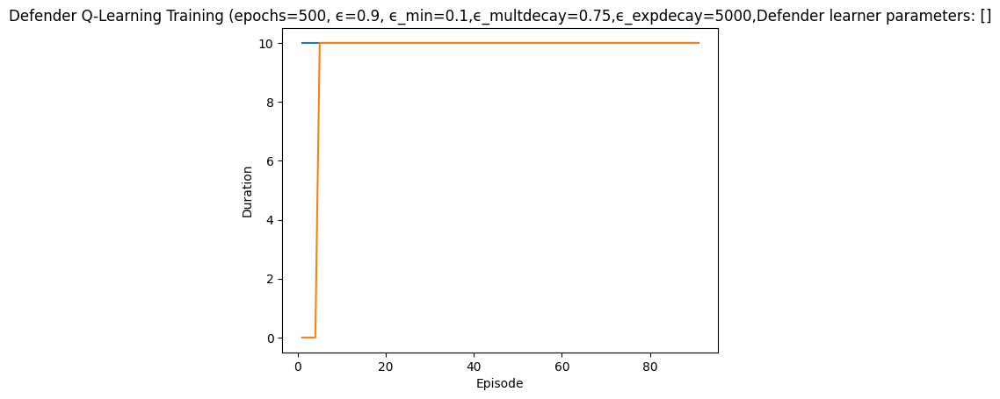

Rendering the current state of the environment
  ## Episode: 92/500 'Defender Q-Learning Training' ϵ=0.5753, Defender learner parameters: []


Episode 92|Iteration 10|reward:   90.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 911, 'successful_actions': 380, 'failed_actions': 531}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 912, 'successful_actions': 381, 'failed_actions': 531}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=12, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 913, 'successful_actions': 382, 'failed_actions': 531}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 4: Ac

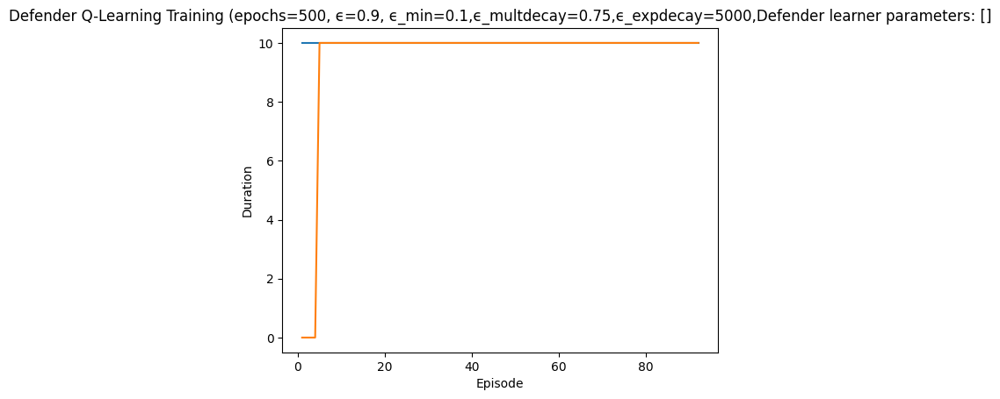

Rendering the current state of the environment
  ## Episode: 93/500 'Defender Q-Learning Training' ϵ=0.5743, Defender learner parameters: []


Episode 93|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=13, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 921, 'successful_actions': 385, 'failed_actions': 536}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=11, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 922, 'successful_actions': 385, 'failed_actions': 537}, 'network_availability': 1.0}
action

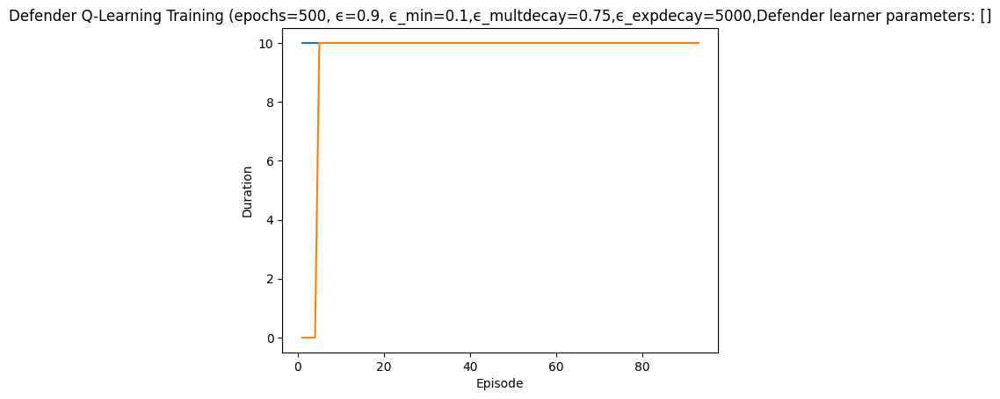

Rendering the current state of the environment
  ## Episode: 94/500 'Defender Q-Learning Training' ϵ=0.5733, Defender learner parameters: []


Episode 94|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 931, 'successful_actions': 389, 'failed_actions': 542}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=4, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 932, 'successful_actions': 389, 'failed_actions': 543}, 'network_availability': 1.0}
actio

Episode 94|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 94 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  Episode 94 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 206
    Blocking Traffic Count: 186
    Stopping Services Count: 0


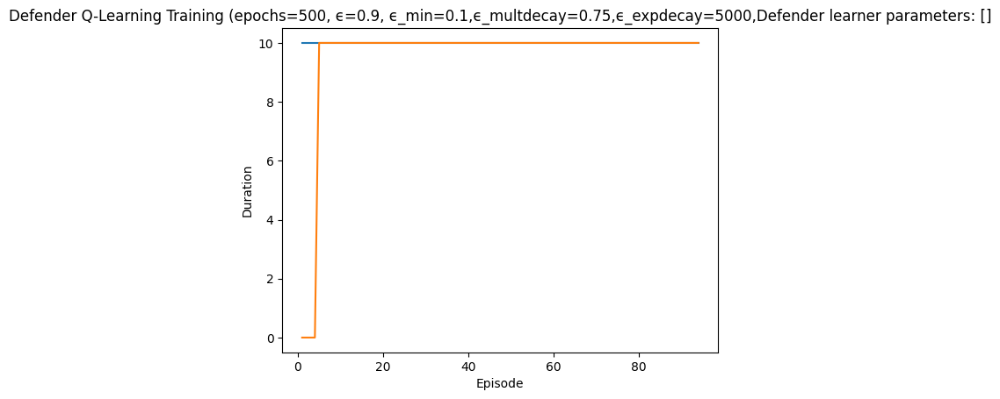

Rendering the current state of the environment
  ## Episode: 95/500 'Defender Q-Learning Training' ϵ=0.5723, Defender learner parameters: []


Episode 95|Iteration 10|reward:  145.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 941, 'successful_actions': 394, 'failed_actions': 547}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=9, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 942, 'successful_actions': 395, 'failed_actions': 547}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=1, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 943, 'successful_actions': 396, 'failed_actions': 547}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'statu

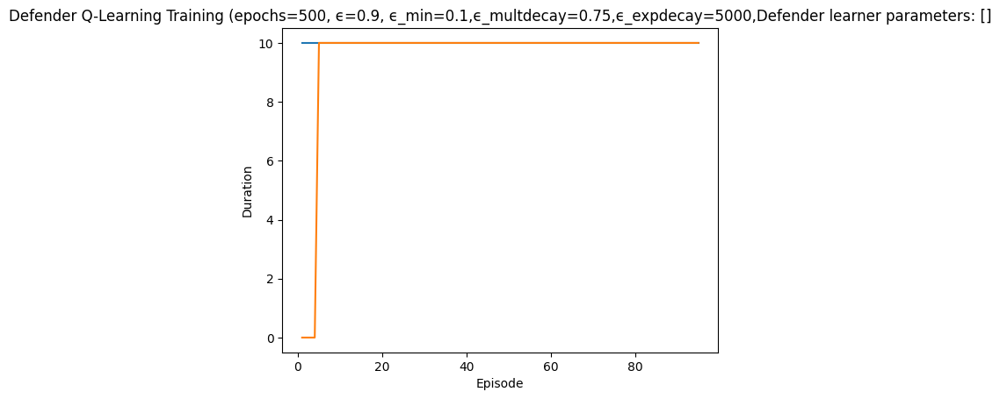

Rendering the current state of the environment
  ## Episode: 96/500 'Defender Q-Learning Training' ϵ=0.5713, Defender learner parameters: []


Episode 96|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 951, 'successful_actions': 400, 'failed_actions': 551}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=12, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 952, 'successful_actions': 400, 'failed_actions': 552}, 'network_availability': 1.0}
failed
{'action

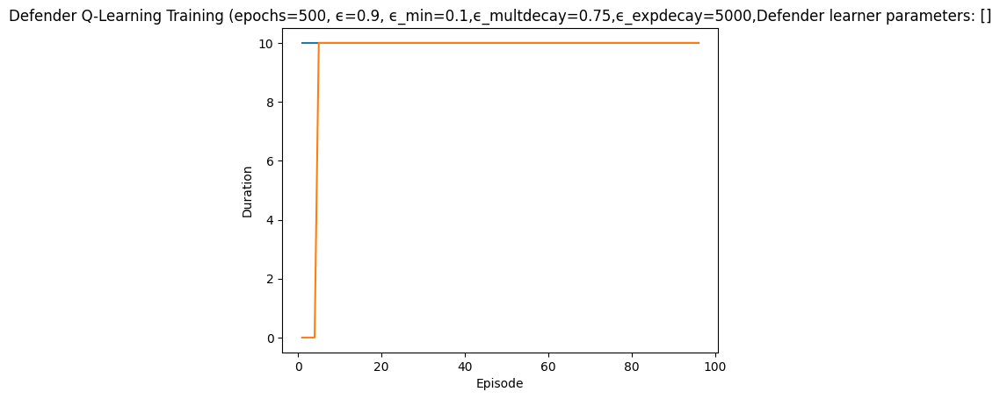

Rendering the current state of the environment
  ## Episode: 97/500 'Defender Q-Learning Training' ϵ=0.5703, Defender learner parameters: []


Episode 97|Iteration 9|reward:   55.0|last_reward_at:    6|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=1, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 961, 'successful_actions': 406, 'failed_actions': 555}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 962, 'successful_actions': 406, 'failed_actions': 556}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=6, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name

Episode 97|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=10, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 970, 'successful_actions': 410, 'failed_actions': 560}, 'network_availability': 1.0}


Episode 97|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 97 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  Episode 97 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 214
    Blocking Traffic Count: 195
    Stopping Services Count: 0


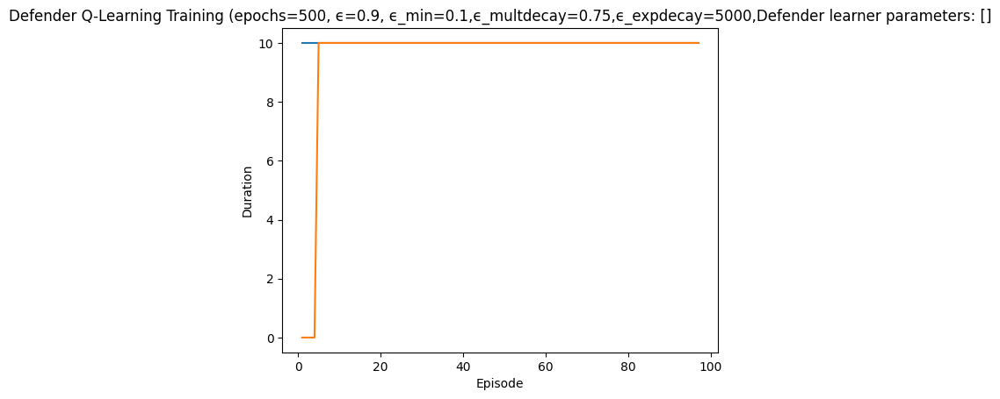

Rendering the current state of the environment
  ## Episode: 98/500 'Defender Q-Learning Training' ϵ=0.5693, Defender learner parameters: []


Episode 98|Iteration 10|reward:    0.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 971, 'successful_actions': 410, 'failed_actions': 561}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 972, 'successful_actions': 411, 'failed_actions': 561}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action T

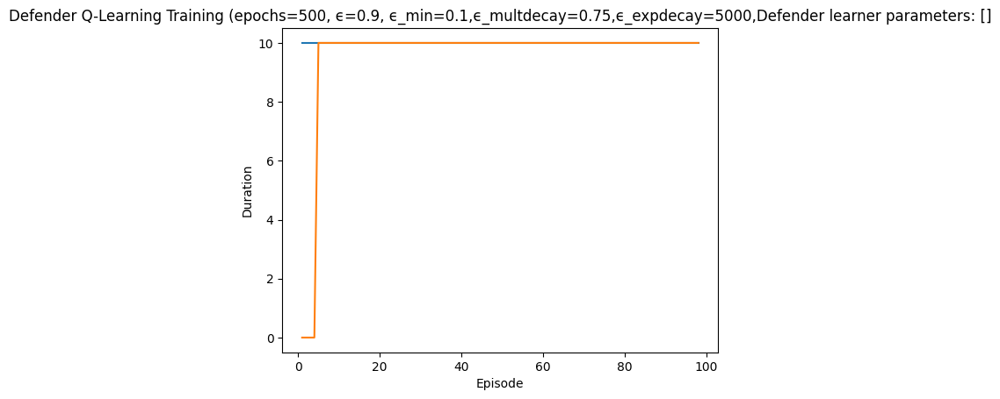

Rendering the current state of the environment
  ## Episode: 99/500 'Defender Q-Learning Training' ϵ=0.5683, Defender learner parameters: []


Episode 99|Iteration 7|reward:  -50.0|last_reward_at:    1|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 981, 'successful_actions': 414, 'failed_actions': 567}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 982, 'successful_actions': 414, 'failed_actions': 568}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iter

Episode 99|Iteration 9|reward:  -40.0|last_reward_at:    1|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 8: Action Taken: Type=Start Service, NodeID=7, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 988, 'successful_actions': 414, 'failed_actions': 574}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 9: Action Taken: Type=Block Traffic, NodeID=13, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 989, 'successful_actions': 415, 'failed_actions': 574}, 'network_availability': 1.0}


Episode 99|Iteration 10|reward:  -40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=8, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 990, 'successful_actions': 415, 'failed_actions': 575}, 'network_availability': 1.0}
  Episode 99 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  Episode 99 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 217
    Blocking Traffic Count: 197
    Stopping Services Count: 0


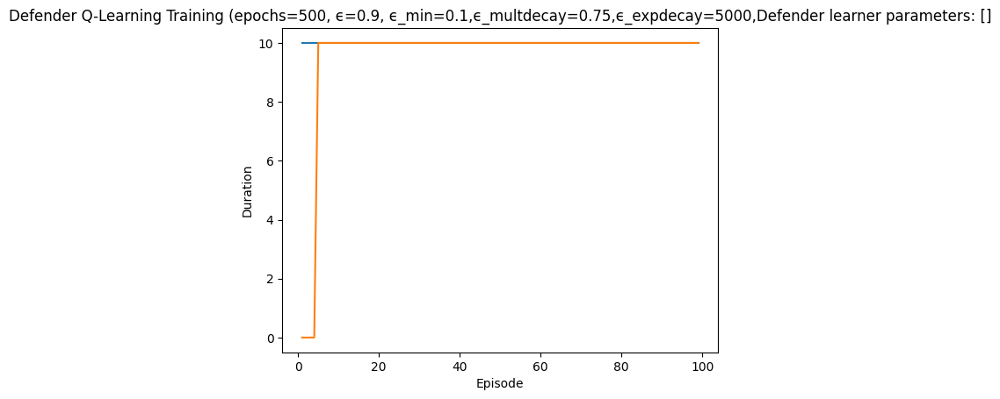

Rendering the current state of the environment
  ## Episode: 100/500 'Defender Q-Learning Training' ϵ=0.5673, Defender learner parameters: []


Episode 100|Iteration 8|reward:   95.0|last_reward_at:    7|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 991, 'successful_actions': 416, 'failed_actions': 575}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 992, 'successful_actions': 417, 'failed_actions': 575}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=11, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 993, 'successful_actions': 418, 'failed_actions': 575}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 4: A

Episode 100|Iteration 9|reward:  120.0|last_reward_at:    9|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 9: Action Taken: Type=Block Traffic, NodeID=12, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 999, 'successful_actions': 421, 'failed_actions': 578}, 'network_availability': 1.0}


Episode 100|Iteration 10|reward:  105.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 10: Action Taken: Type=Start Service, NodeID=1, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1000, 'successful_actions': 421, 'failed_actions': 579}, 'network_availability': 1.0}
  Episode 100 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 2
  Episode 100 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 220
    Blocking Traffic Count: 200
    Stopping Services Count: 0


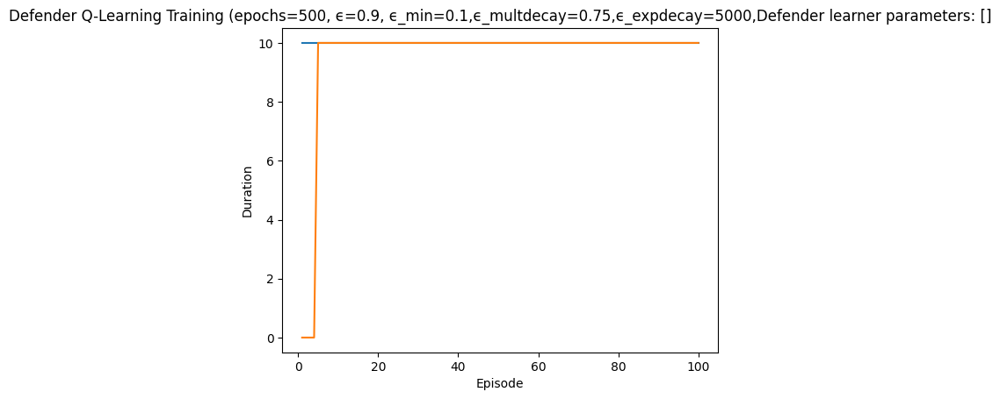

Rendering the current state of the environment
  ## Episode: 101/500 'Defender Q-Learning Training' ϵ=0.5663, Defender learner parameters: []


Episode 101|Iteration 10|reward:   40.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1001, 'successful_actions': 421, 'failed_actions': 580}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=4, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1002, 'successful_actions': 421, 'failed_actions': 581}, 'network_availability': 1.0}
action

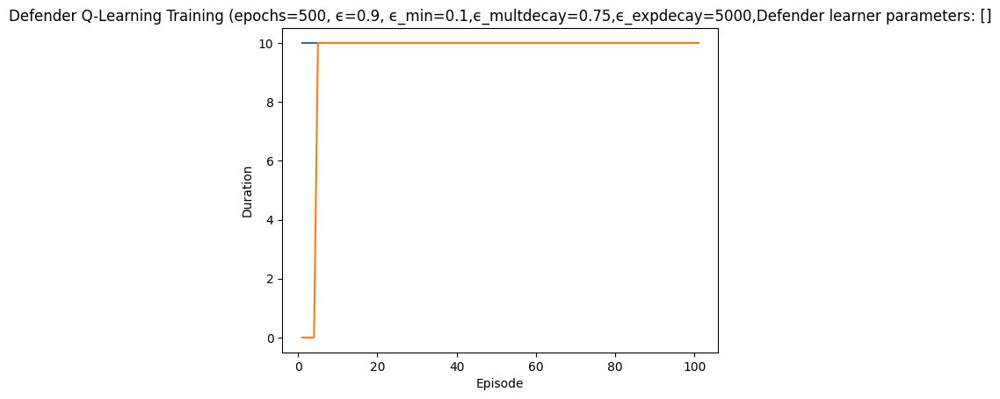

Rendering the current state of the environment
  ## Episode: 102/500 'Defender Q-Learning Training' ϵ=0.5654, Defender learner parameters: []


Episode 102|Iteration 10|reward:  -25.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1011, 'successful_actions': 426, 'failed_actions': 585}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1012, 'successful_actions': 426, 'failed_actions': 586}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iterat

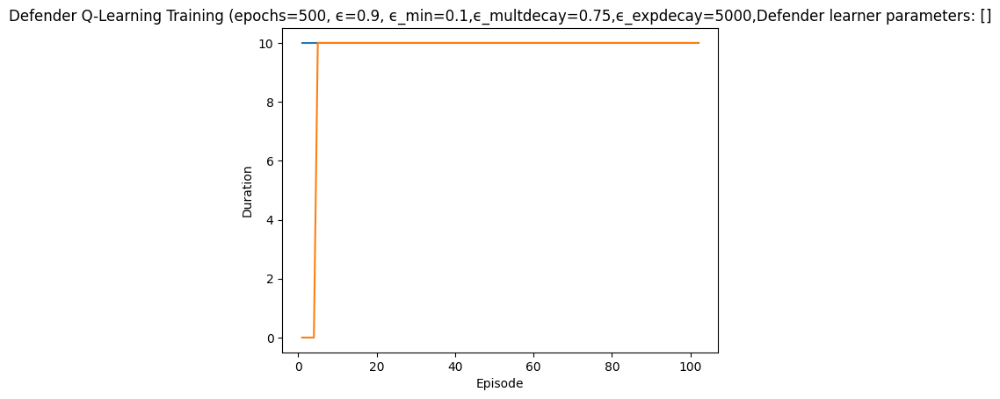

Rendering the current state of the environment
  ## Episode: 103/500 'Defender Q-Learning Training' ϵ=0.5644, Defender learner parameters: []


Episode 103|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=12, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1021, 'successful_actions': 427, 'failed_actions': 594}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1022, 'successful_actions': 427, 'failed_actions': 595}, 'network_availability': 1.0}

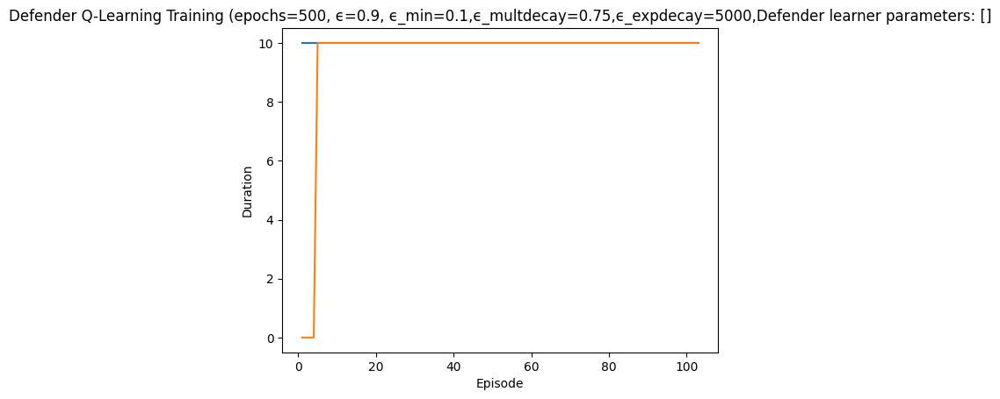

Rendering the current state of the environment
  ## Episode: 104/500 'Defender Q-Learning Training' ϵ=0.5634, Defender learner parameters: []


Episode 104|Iteration 10|reward:  -15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=7, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1031, 'successful_actions': 430, 'failed_actions': 601}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1032, 'successful_actions': 430, 'failed_actions': 602}, 'network_availability': 1.0}

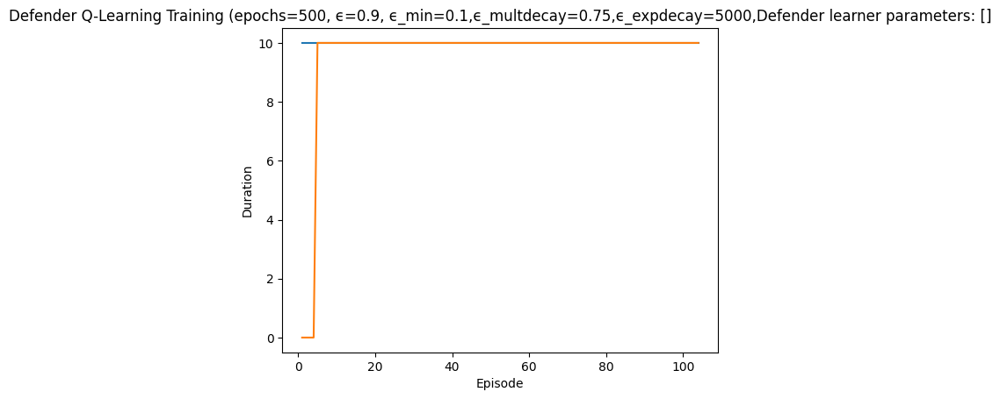

Rendering the current state of the environment
  ## Episode: 105/500 'Defender Q-Learning Training' ϵ=0.5624, Defender learner parameters: []


Episode 105|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1041, 'successful_actions': 433, 'failed_actions': 608}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 1042, 'successful_actions': 434, 'failed_actions': 608}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 3: Action Tak

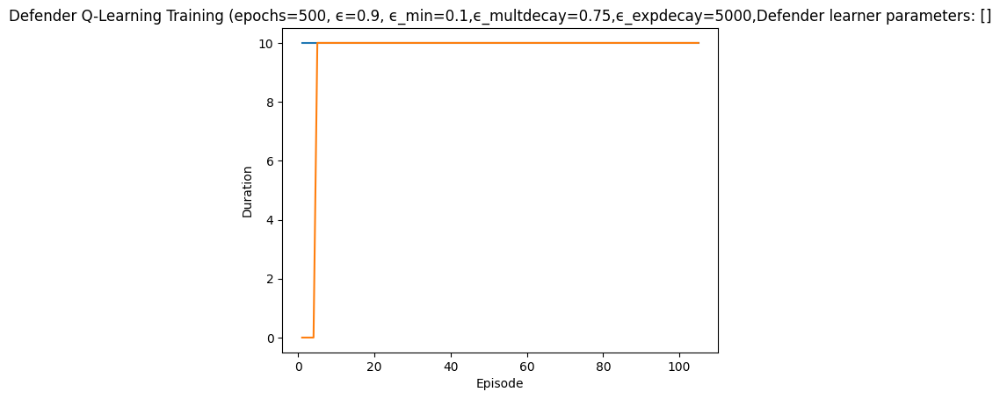

Rendering the current state of the environment
  ## Episode: 106/500 'Defender Q-Learning Training' ϵ=0.5614, Defender learner parameters: []


Episode 106|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1051, 'successful_actions': 437, 'failed_actions': 614}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1052, 'successful_actions': 438, 'failed_actions': 614}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node

  Episode 106 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  Episode 106 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 227
    Blocking Traffic Count: 213
    Stopping Services Count: 0


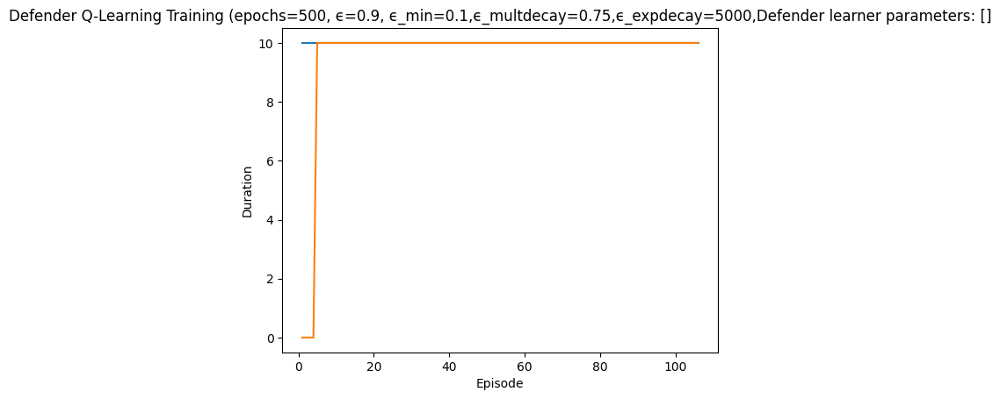

Rendering the current state of the environment
  ## Episode: 107/500 'Defender Q-Learning Training' ϵ=0.5605, Defender learner parameters: []


Episode 107|Iteration 10|reward:  -15.0|last_reward_at:    4|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 1061, 'successful_actions': 442, 'failed_actions': 619}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1062, 'successful_actions': 442, 'failed_actions': 620}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=7, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 

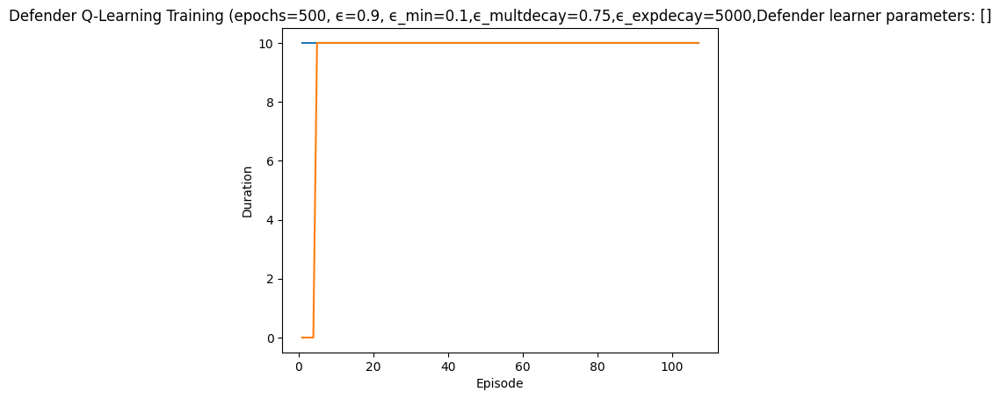

Rendering the current state of the environment
  ## Episode: 108/500 'Defender Q-Learning Training' ϵ=0.5595, Defender learner parameters: []


Episode 108|Iteration 10|reward:   10.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=7, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1071, 'successful_actions': 444, 'failed_actions': 627}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1072, 'successful_actions': 444, 'failed_actions': 628}, 'network_availability': 1.0}
action type:  Bl

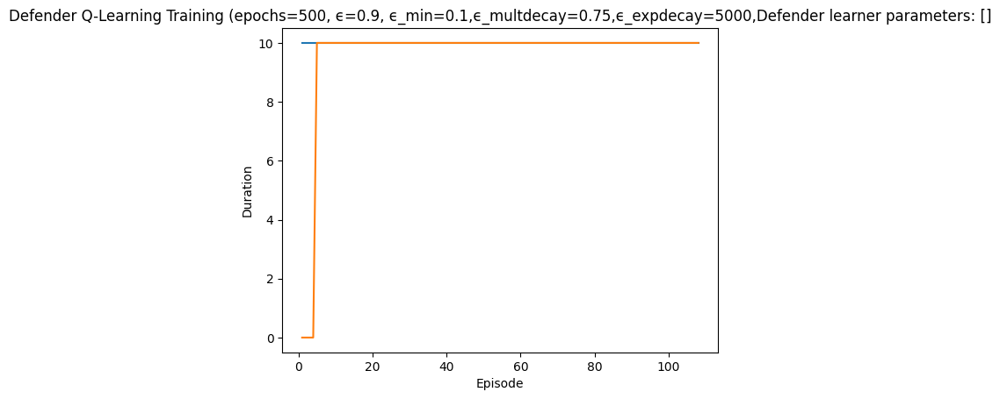

Rendering the current state of the environment
  ## Episode: 109/500 'Defender Q-Learning Training' ϵ=0.5585, Defender learner parameters: []


Episode 109|Iteration 10|reward:   25.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1081, 'successful_actions': 449, 'failed_actions': 632}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=13, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1082, 'successful_actions': 449, 'failed_actions': 633}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=6, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_n

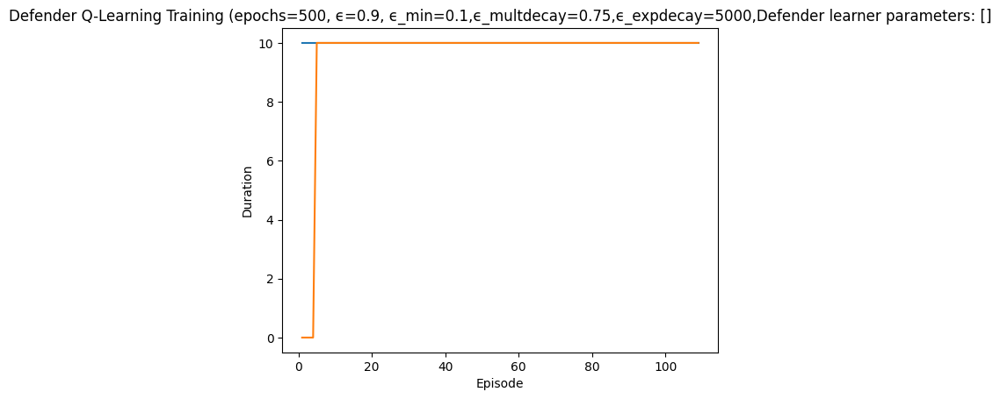

Rendering the current state of the environment
  ## Episode: 110/500 'Defender Q-Learning Training' ϵ=0.5576, Defender learner parameters: []


Episode 110|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=13, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1091, 'successful_actions': 453, 'failed_actions': 638}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1092, 'successful_actions': 453, 'failed_actions': 639}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=10, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'po

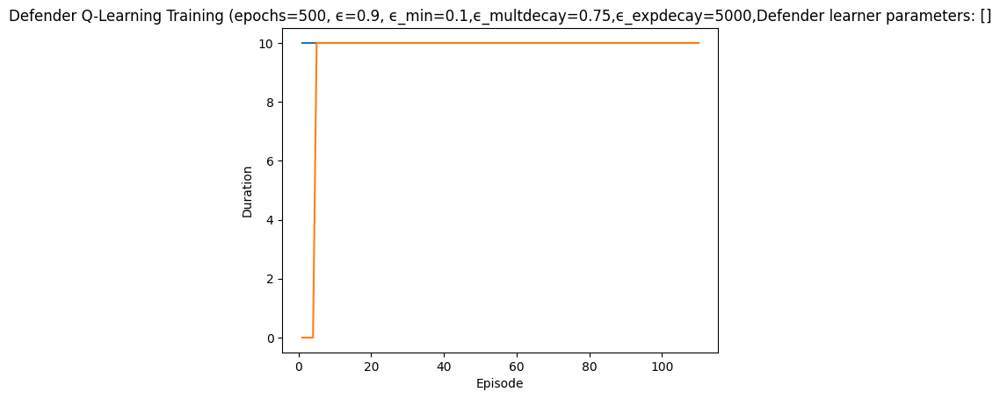

Rendering the current state of the environment
  ## Episode: 111/500 'Defender Q-Learning Training' ϵ=0.5566, Defender learner parameters: []


Episode 111|Iteration 10|reward:   80.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1101, 'successful_actions': 458, 'failed_actions': 643}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=7, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1102, 'successful_actions': 458, 'failed_actions': 644}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=7, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_

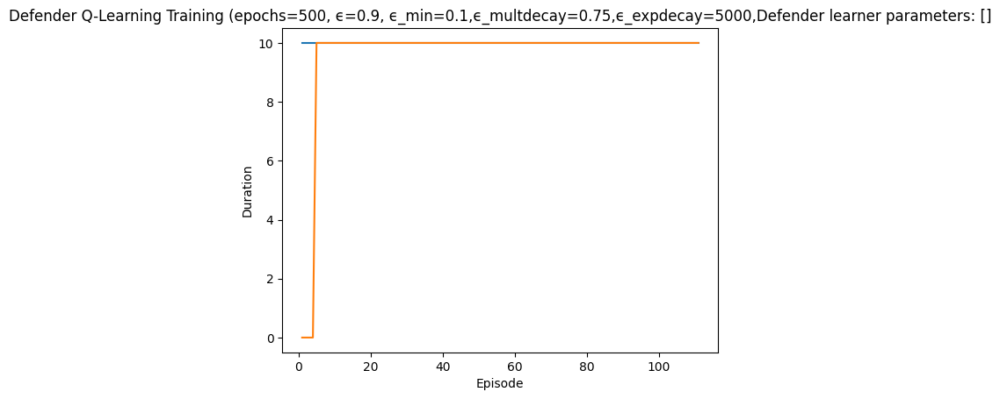

Rendering the current state of the environment
  ## Episode: 112/500 'Defender Q-Learning Training' ϵ=0.5556, Defender learner parameters: []


Episode 112|Iteration 10|reward:   25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=10, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1111, 'successful_actions': 462, 'failed_actions': 649}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1112, 'successful_actions': 462, 'failed_actions': 650}, 'network_availability': 1.0}
a

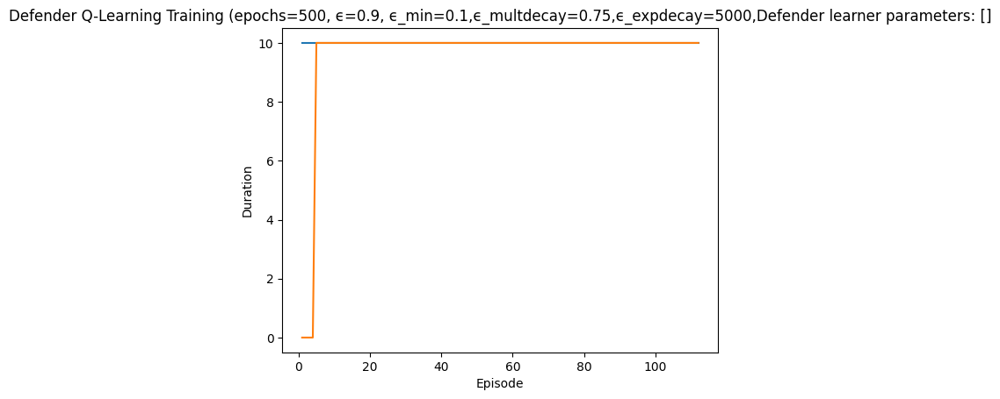

Rendering the current state of the environment
  ## Episode: 113/500 'Defender Q-Learning Training' ϵ=0.5547, Defender learner parameters: []


Episode 113|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1121, 'successful_actions': 466, 'failed_actions': 655}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1122, 'successful_actions': 466, 'failed_actions': 656}, 'network_availability': 1.0}
fa

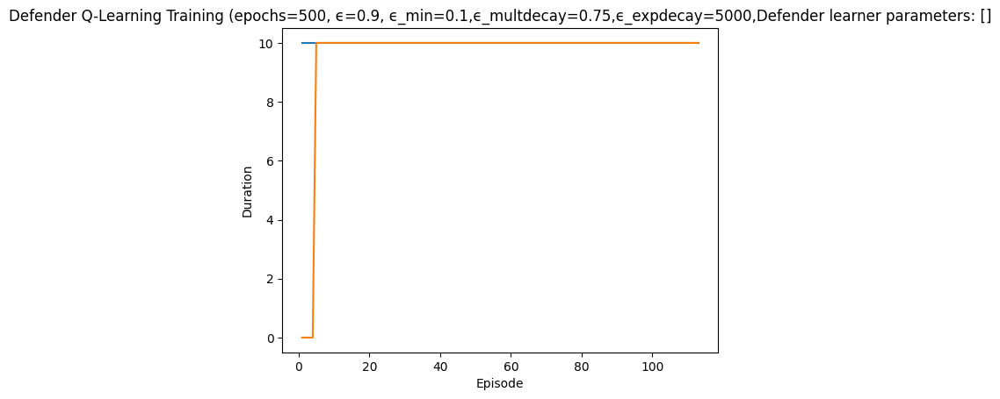

Rendering the current state of the environment
  ## Episode: 114/500 'Defender Q-Learning Training' ϵ=0.5537, Defender learner parameters: []


Episode 114|Iteration 10|reward:   10.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1131, 'successful_actions': 470, 'failed_actions': 661}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1132, 'successful_actions': 470, 'failed_actions': 662}, 'network_availability': 1.0}
action type:  Re

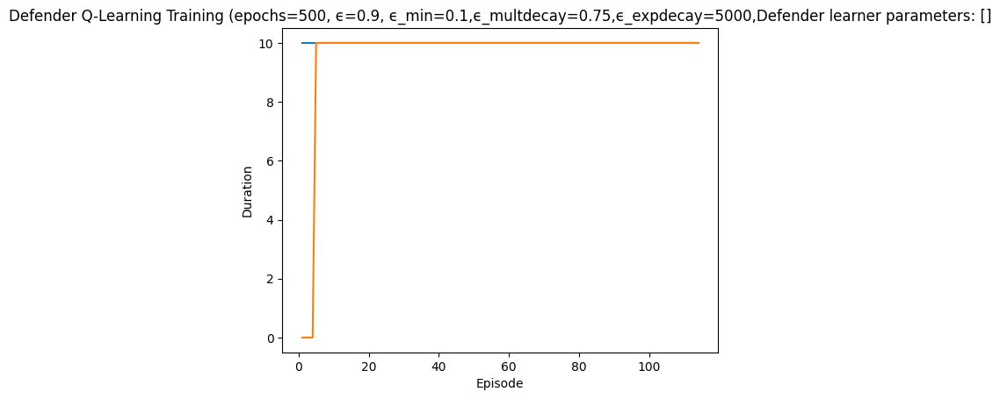

Rendering the current state of the environment
  ## Episode: 115/500 'Defender Q-Learning Training' ϵ=0.5528, Defender learner parameters: []


Episode 115|Iteration 10|reward:   85.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1141, 'successful_actions': 474, 'failed_actions': 667}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=9, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 1142, 'successful_actions': 475, 'failed_actions': 667}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iter

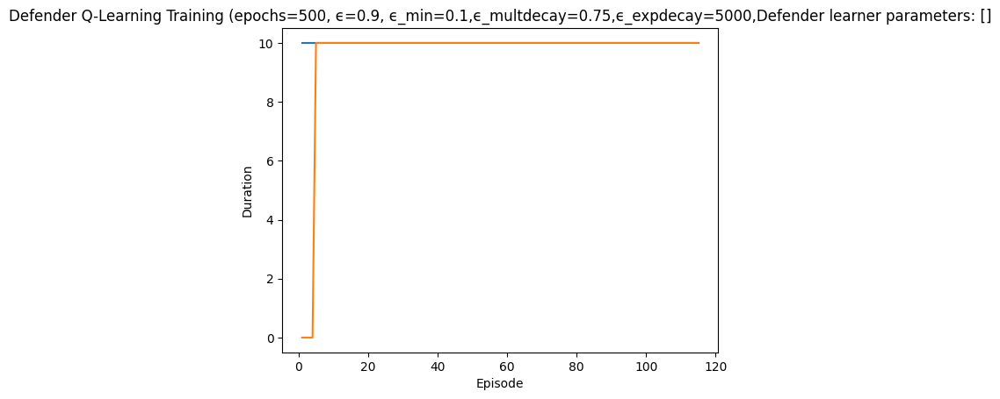

Rendering the current state of the environment
  ## Episode: 116/500 'Defender Q-Learning Training' ϵ=0.5518, Defender learner parameters: []


Episode 116|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1151, 'successful_actions': 479, 'failed_actions': 672}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1152, 'successful_actions': 479, 'failed_actions': 673}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=6, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode'

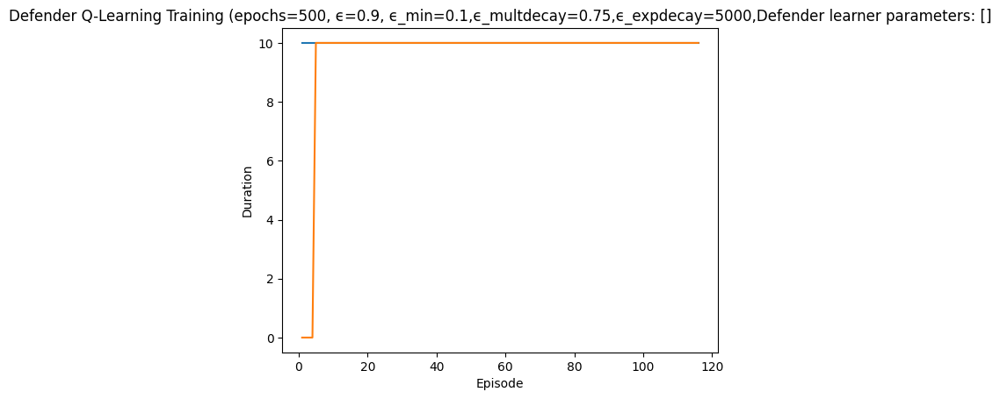

Rendering the current state of the environment
  ## Episode: 117/500 'Defender Q-Learning Training' ϵ=0.5509, Defender learner parameters: []


Episode 117|Iteration 7|reward:  -10.0|last_reward_at:    2|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=6, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1161, 'successful_actions': 485, 'failed_actions': 676}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 1162, 'successful_actions': 486, 'failed_actions': 676}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not foun

Episode 117|Iteration 10|reward:  -25.0|last_reward_at:    2|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=4, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1170, 'successful_actions': 486, 'failed_actions': 684}, 'network_availability': 1.0}
  Episode 117 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  Episode 117 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 250
    Blocking Traffic Count: 235
    Stopping Services Count: 0


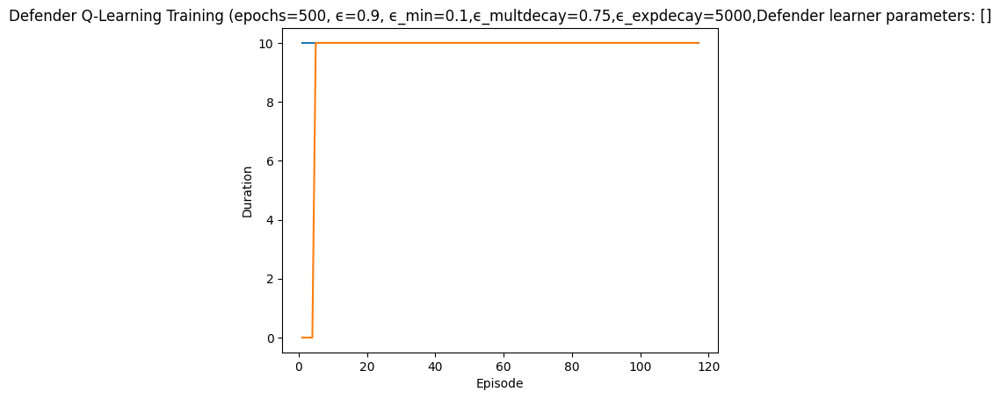

Rendering the current state of the environment
  ## Episode: 118/500 'Defender Q-Learning Training' ϵ=0.5499, Defender learner parameters: []


Episode 118|Iteration 10|reward:  175.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=6, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1171, 'successful_actions': 486, 'failed_actions': 685}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 1172, 'successful_actions': 487, 'failed_actions': 685}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=7, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode

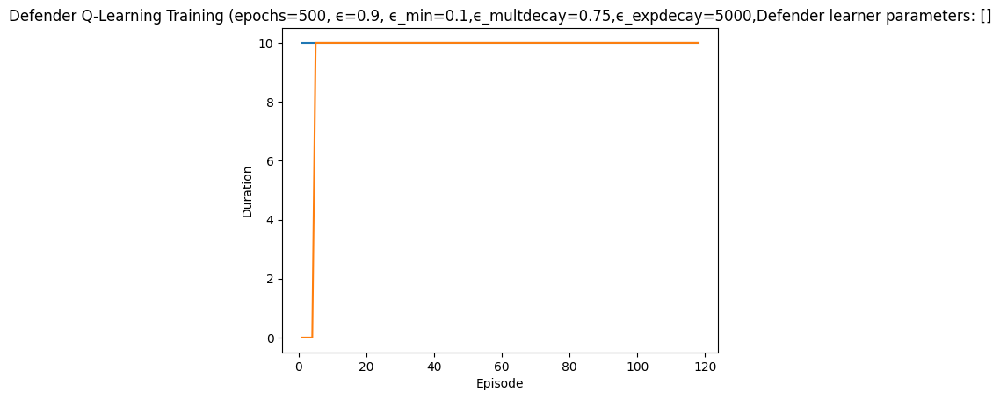

Rendering the current state of the environment
  ## Episode: 119/500 'Defender Q-Learning Training' ϵ=0.5490, Defender learner parameters: []


Episode 119|Iteration 10|reward:  -65.0|last_reward_at:    1|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 1181, 'successful_actions': 494, 'failed_actions': 687}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1182, 'successful_actions': 494, 'failed_actions': 688}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iterat

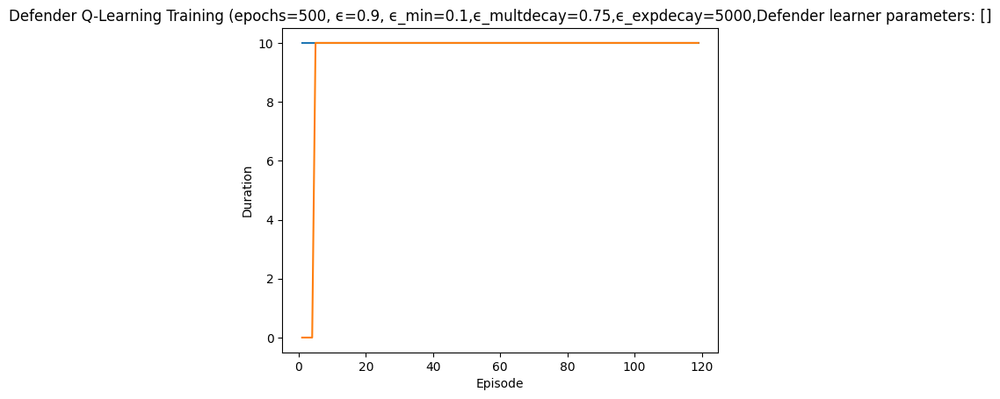

Rendering the current state of the environment
  ## Episode: 120/500 'Defender Q-Learning Training' ϵ=0.5480, Defender learner parameters: []


Episode 120|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1191, 'successful_actions': 495, 'failed_actions': 696}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1192, 'successful_actions': 495, 'failed_actions': 697}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration

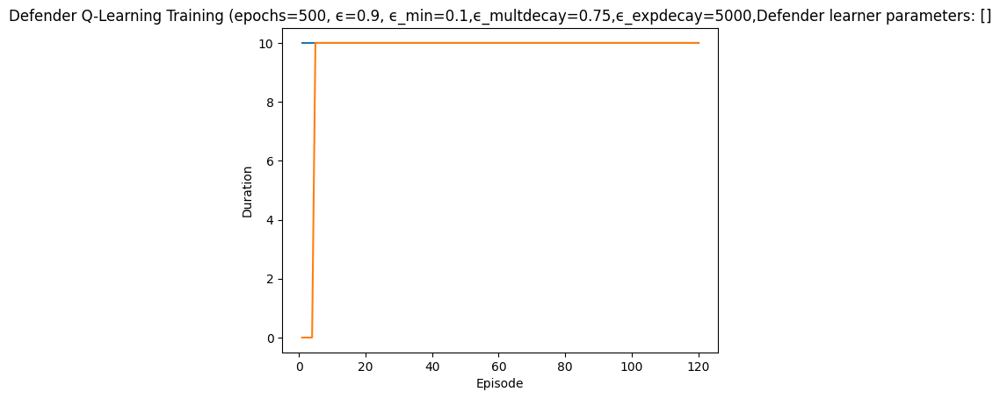

Rendering the current state of the environment
  ## Episode: 121/500 'Defender Q-Learning Training' ϵ=0.5471, Defender learner parameters: []


Episode 121|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1201, 'successful_actions': 498, 'failed_actions': 703}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=7, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1202, 'successful_actions': 499, 'failed_actions': 703}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Ta

  Episode 121 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  Episode 121 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 258
    Blocking Traffic Count: 243
    Stopping Services Count: 0


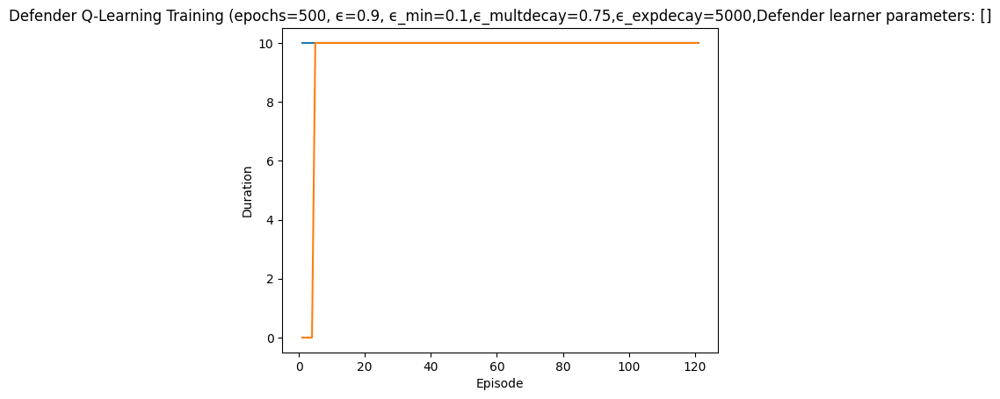

Rendering the current state of the environment
  ## Episode: 122/500 'Defender Q-Learning Training' ϵ=0.5461, Defender learner parameters: []


Episode 122|Iteration 10|reward: -120.0|last_reward_at: ----|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=10, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1211, 'successful_actions': 502, 'failed_actions': 709}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1212, 'successful_actions': 502, 'failed_actions': 710}, 'network_availability': 1.0}
failed
{'action': '

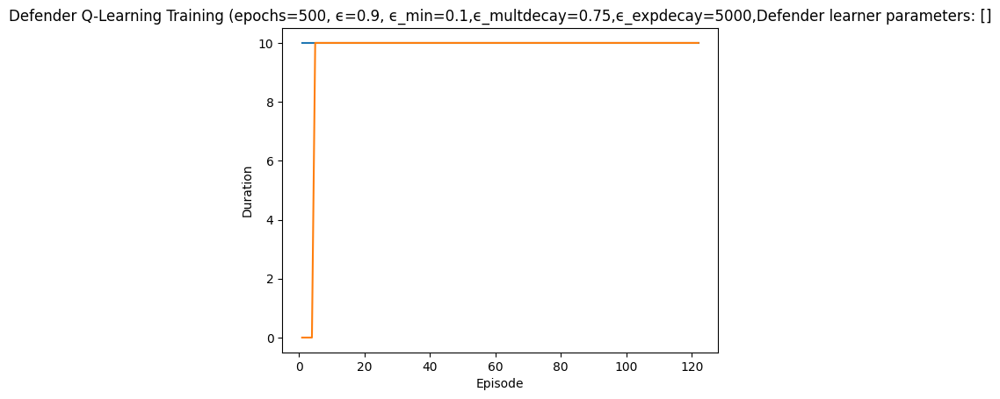

Rendering the current state of the environment
  ## Episode: 123/500 'Defender Q-Learning Training' ϵ=0.5452, Defender learner parameters: []


Episode 123|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 1221, 'successful_actions': 503, 'failed_actions': 718}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=8
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1222, 'successful_actions': 503, 'failed_actions': 719}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type

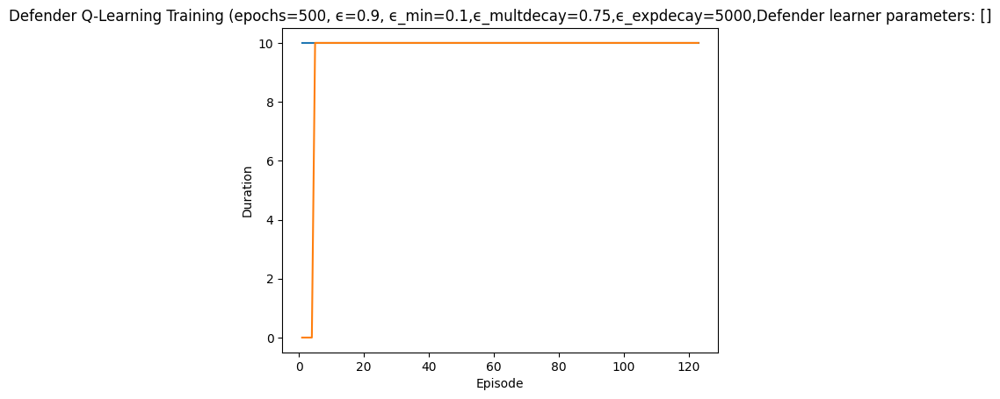

Rendering the current state of the environment
  ## Episode: 124/500 'Defender Q-Learning Training' ϵ=0.5442, Defender learner parameters: []


Episode 124|Iteration 3|reward:   10.0|last_reward_at: ----|Elapsed Time: 0:00:00||

failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=1
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1231, 'successful_actions': 506, 'failed_actions': 725}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1232, 'successful_actions': 506, 'failed_actions': 726}, 'network_availability': 1.0}
action ty

Episode 124|Iteration 10|reward:   25.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 4: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1234, 'successful_actions': 507, 'failed_actions': 727}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 5: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1235, 'successful_actions': 507, 'failed_actions': 728}, 'network_availability': 1.0}
action type

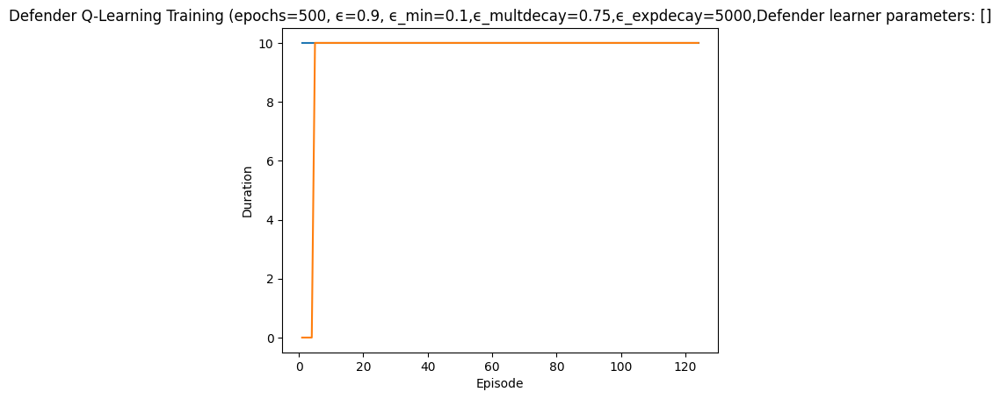

Rendering the current state of the environment
  ## Episode: 125/500 'Defender Q-Learning Training' ϵ=0.5433, Defender learner parameters: []


Episode 125|Iteration 10|reward:   80.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=5, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1241, 'successful_actions': 510, 'failed_actions': 731}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=7, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 1242, 'successful_actions': 511, 'failed_actions': 731}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=9, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'por

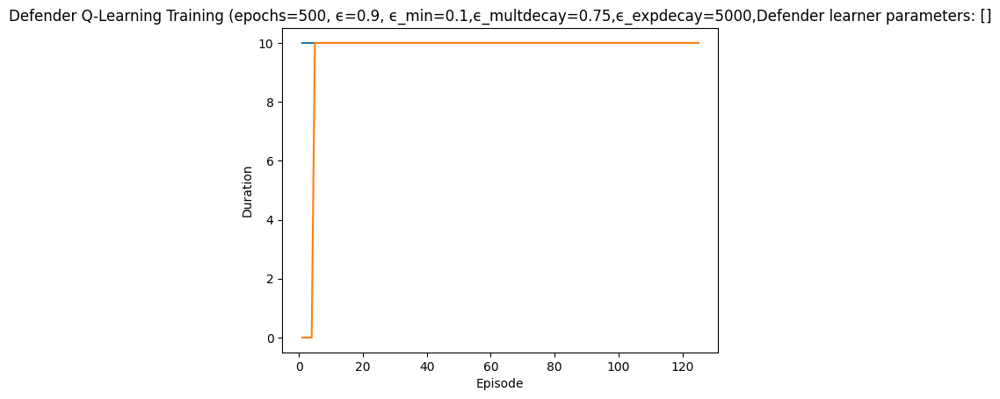

Rendering the current state of the environment
  ## Episode: 126/500 'Defender Q-Learning Training' ϵ=0.5424, Defender learner parameters: []


Episode 126|Iteration 10|reward:  -40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=11, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1251, 'successful_actions': 515, 'failed_actions': 736}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1252, 'successful_actions': 515, 'failed_actions': 737}, 'network_availability': 1.0}
failed
{'

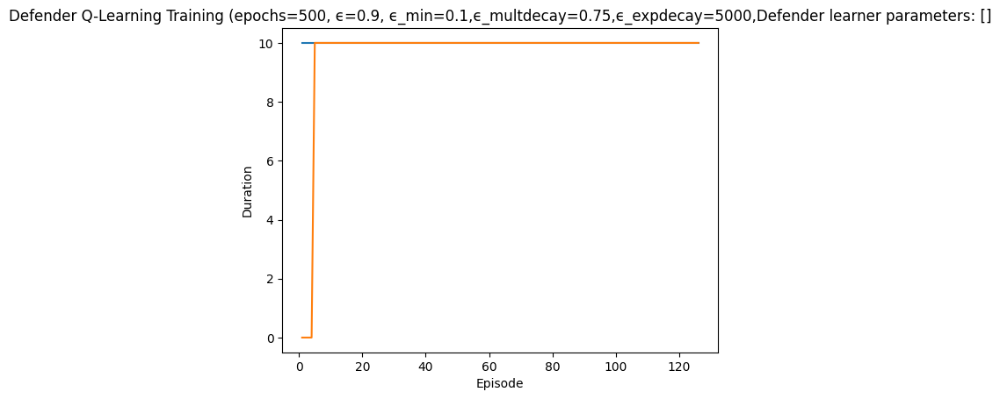

Rendering the current state of the environment
  ## Episode: 127/500 'Defender Q-Learning Training' ϵ=0.5414, Defender learner parameters: []


Episode 127|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1261, 'successful_actions': 517, 'failed_actions': 744}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1262, 'successful_actions': 517, 'failed_actions': 745}, 'network_availabi

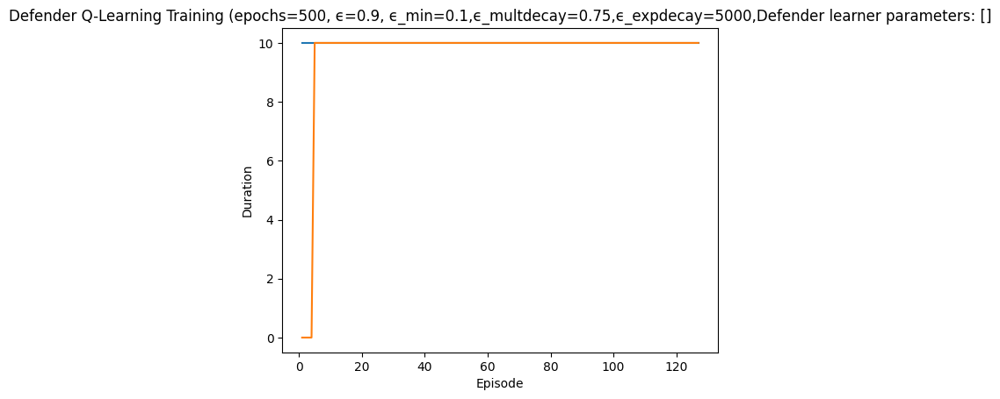

Rendering the current state of the environment
  ## Episode: 128/500 'Defender Q-Learning Training' ϵ=0.5405, Defender learner parameters: []


Episode 128|Iteration 10|reward:  175.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1271, 'successful_actions': 521, 'failed_actions': 750}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1272, 'successful_actions': 521, 'failed_actions': 751}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=3, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNod

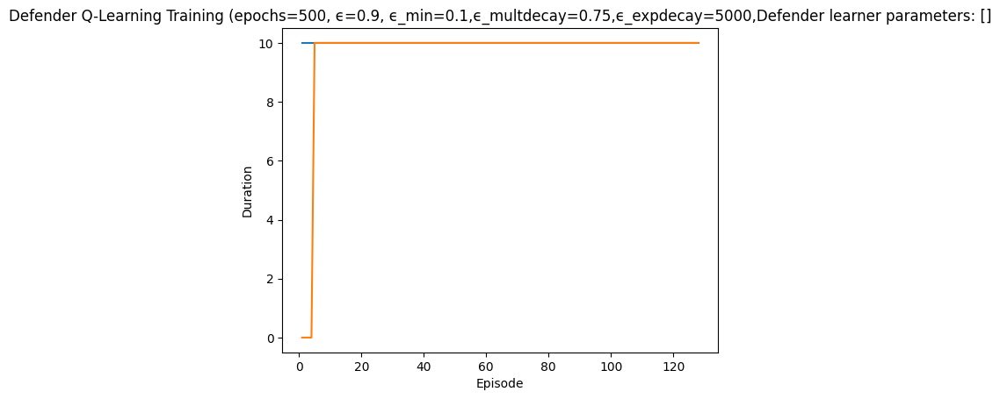

Rendering the current state of the environment
  ## Episode: 129/500 'Defender Q-Learning Training' ϵ=0.5396, Defender learner parameters: []


Episode 129|Iteration 10|reward:  -65.0|last_reward_at:    4|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1281, 'successful_actions': 527, 'failed_actions': 754}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1282, 'successful_actions': 527, 'failed_actions': 755}, 'network_availabili

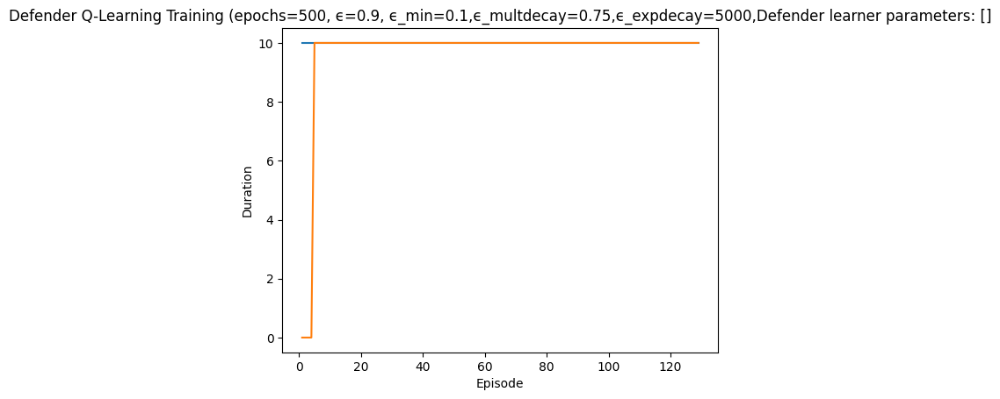

Rendering the current state of the environment
  ## Episode: 130/500 'Defender Q-Learning Training' ϵ=0.5386, Defender learner parameters: []


Episode 130|Iteration 10|reward:   20.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1291, 'successful_actions': 528, 'failed_actions': 763}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1292, 'successful_actions': 529, 'failed_actions': 763}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration

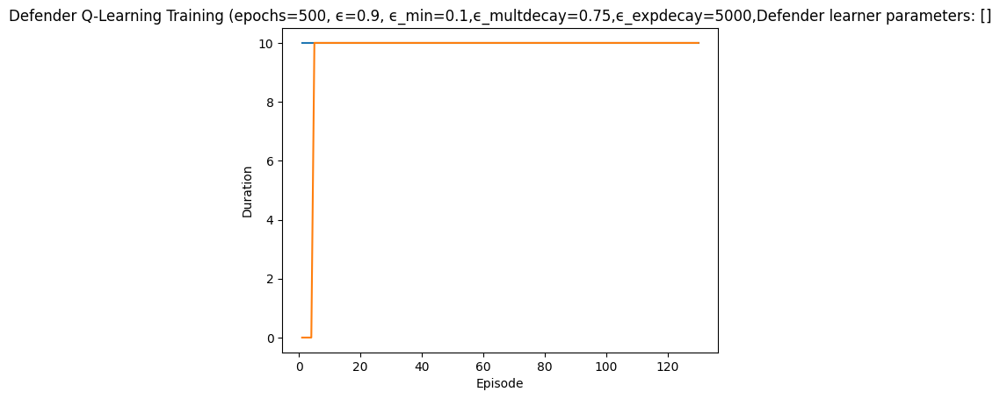

Rendering the current state of the environment
  ## Episode: 131/500 'Defender Q-Learning Training' ϵ=0.5377, Defender learner parameters: []


Episode 131|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=9, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 1301, 'successful_actions': 531, 'failed_actions': 770}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1302, 'successful_actions': 532, 'failed_actions': 770}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=0, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running', 'p

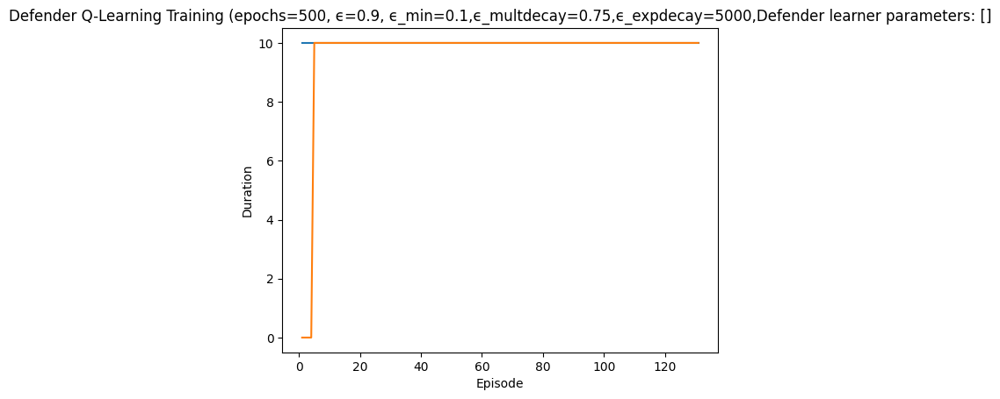

Rendering the current state of the environment
  ## Episode: 132/500 'Defender Q-Learning Training' ϵ=0.5368, Defender learner parameters: []


Episode 132|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1311, 'successful_actions': 534, 'failed_actions': 777}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 1312, 'successful_actions': 535, 'failed_actions': 777}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Act

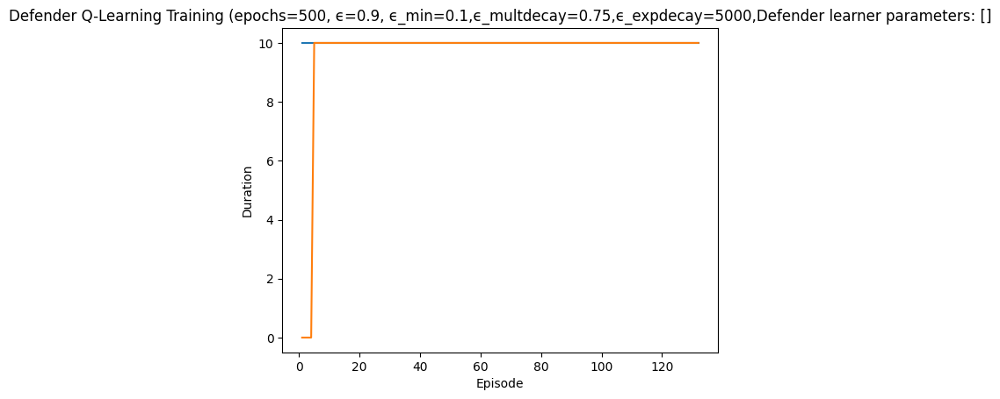

Rendering the current state of the environment
  ## Episode: 133/500 'Defender Q-Learning Training' ϵ=0.5359, Defender learner parameters: []


Episode 133|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 4, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 4, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1321, 'successful_actions': 539, 'failed_actions': 782}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1322, 'successful_actions': 540, 'failed_actions': 782}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: T

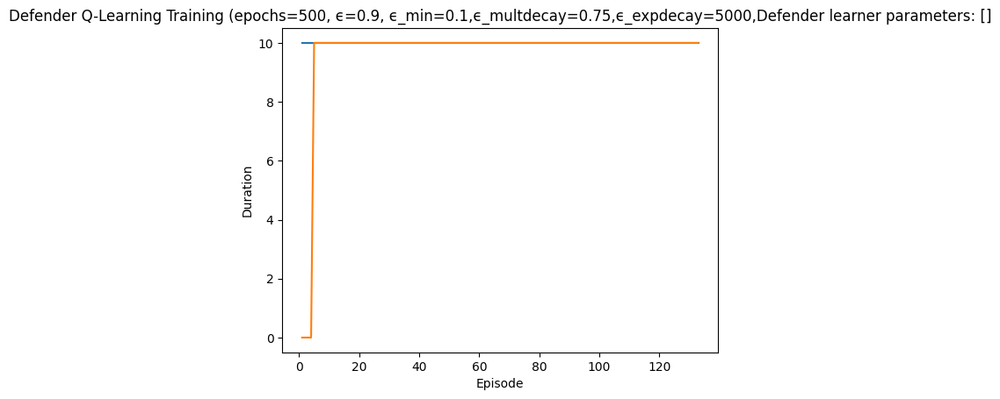

Rendering the current state of the environment
  ## Episode: 134/500 'Defender Q-Learning Training' ϵ=0.5350, Defender learner parameters: []


Episode 134|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=8, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 1331, 'successful_actions': 545, 'failed_actions': 786}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1332, 'successful_actions': 546, 'failed_actions': 786}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=7, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1333, 'successful_actions': 547, 'failed_actions': 786}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'st

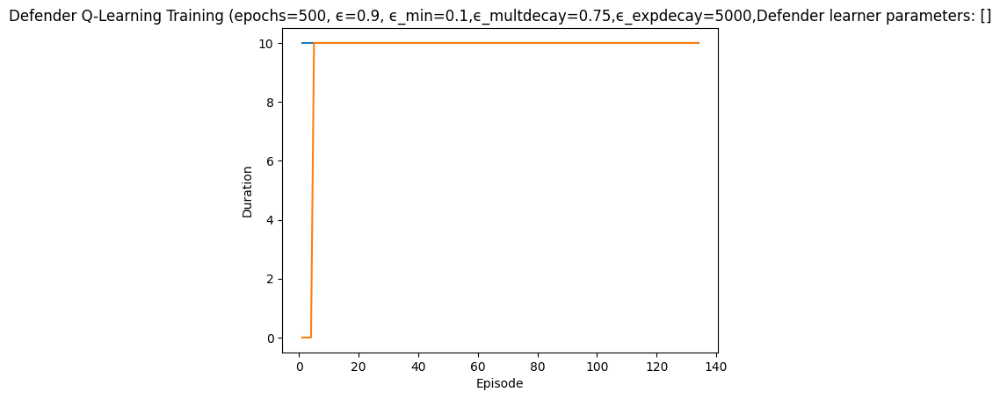

Rendering the current state of the environment
  ## Episode: 135/500 'Defender Q-Learning Training' ϵ=0.5340, Defender learner parameters: []


Episode 135|Iteration 10|reward:  -40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=3, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1341, 'successful_actions': 549, 'failed_actions': 792}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1342, 'successful_actions': 549, 'failed_actions': 793}, 'network_availability': 1.0}
failed
{'actio

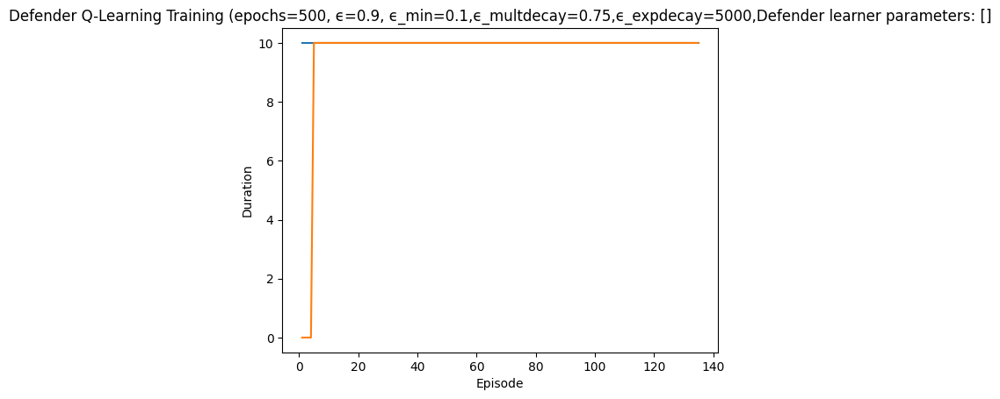

Rendering the current state of the environment
  ## Episode: 136/500 'Defender Q-Learning Training' ϵ=0.5331, Defender learner parameters: []


Episode 136|Iteration 8|reward:   85.0|last_reward_at:    6|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 1351, 'successful_actions': 552, 'failed_actions': 799}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1352, 'successful_actions': 553, 'failed_actions': 799}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=7, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - n

Episode 136|Iteration 10|reward:   55.0|last_reward_at:    6|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 9: Action Taken: Type=Start Service, NodeID=9, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1359, 'successful_actions': 555, 'failed_actions': 804}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 10: Action Taken: Type=Start Service, NodeID=9, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1360, 'successful_actions': 555, 'failed_actions': 805}, 'network_availability': 1.0}


  Episode 136 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 1
  Episode 136 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 286
    Blocking Traffic Count: 268
    Stopping Services Count: 0


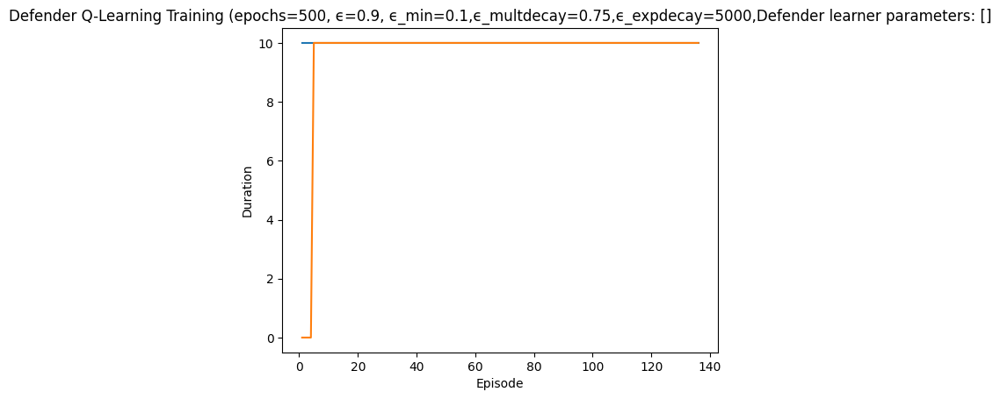

Rendering the current state of the environment
  ## Episode: 137/500 'Defender Q-Learning Training' ϵ=0.5322, Defender learner parameters: []


Episode 137|Iteration 3|reward:   35.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=3, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1361, 'successful_actions': 555, 'failed_actions': 806}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=10, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1362, 'successful_actions': 556, 'failed_actions': 806}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=3, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port

Episode 137|Iteration 6|reward:  -10.0|last_reward_at:    3|Elapsed Time: 0:00:00||

action type:  Start Service
Iteration 4: Action Taken: Type=Start Service, NodeID=0, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1364, 'successful_actions': 557, 'failed_actions': 807}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 5: Action Taken: Type=Start Service, NodeID=12, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1365, 'successful_actions': 557, 'failed_actions': 808}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running'}
not reimaged
action type:  Start Ser

Episode 137|Iteration 10|reward:  -15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 7: Action Taken: Type=Reimage Node, NodeID=10, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1367, 'successful_actions': 557, 'failed_actions': 810}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 8: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1368, 'successful_actions': 557, 'failed_actions': 811}, 'network_availability': 1.0}
failed

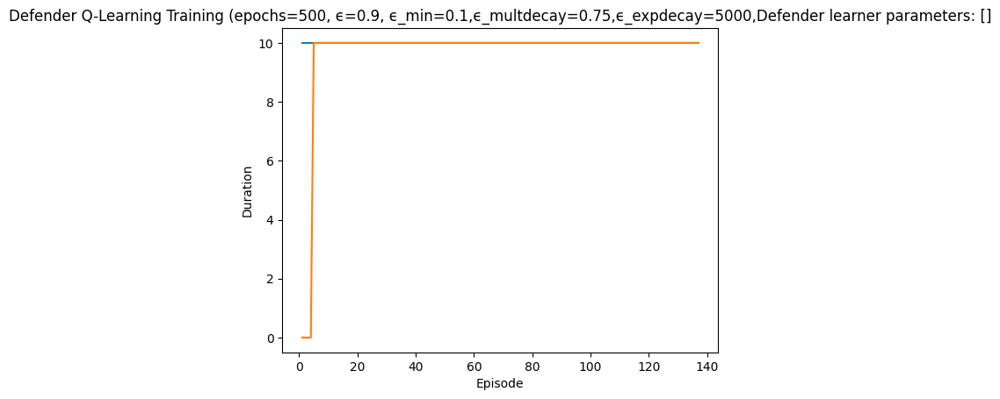

Rendering the current state of the environment
  ## Episode: 138/500 'Defender Q-Learning Training' ϵ=0.5313, Defender learner parameters: []


Episode 138|Iteration 10|reward:  -40.0|last_reward_at:    5|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1371, 'successful_actions': 558, 'failed_actions': 813}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1372, 'successful_actions': 559, 'failed_actions': 813}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken

Episode 138|Iteration 10|reward:  -40.0|last_reward_at:    5|Elapsed Time: 0:00:00||


  Episode 138 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  Episode 138 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 289
    Blocking Traffic Count: 270
    Stopping Services Count: 0


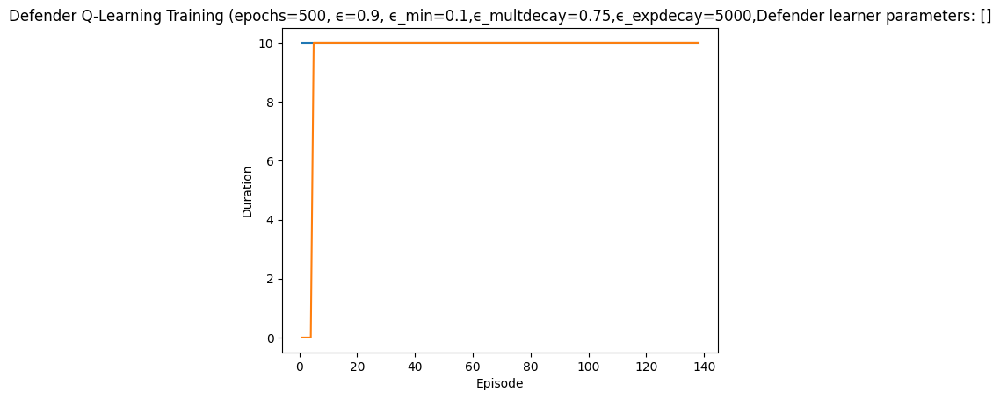

Rendering the current state of the environment
  ## Episode: 139/500 'Defender Q-Learning Training' ϵ=0.5304, Defender learner parameters: []


Episode 139|Iteration 10|reward:   55.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1381, 'successful_actions': 560, 'failed_actions': 821}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1382, 'successful_actions': 560, 'failed_actions': 822}, 'network_availability': 1.0}
acti

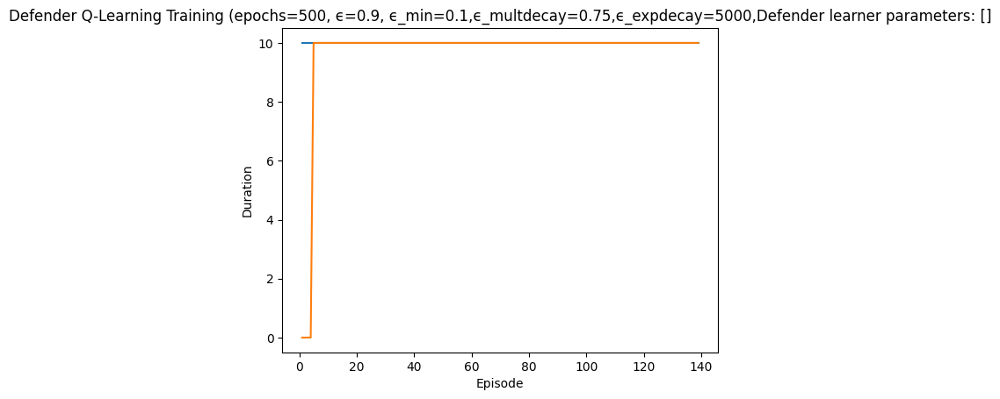

Rendering the current state of the environment
  ## Episode: 140/500 'Defender Q-Learning Training' ϵ=0.5295, Defender learner parameters: []


Episode 140|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=4, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1391, 'successful_actions': 565, 'failed_actions': 826}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1392, 'successful_actions': 566, 'failed_actions': 826}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=0, Parameter=6
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'per

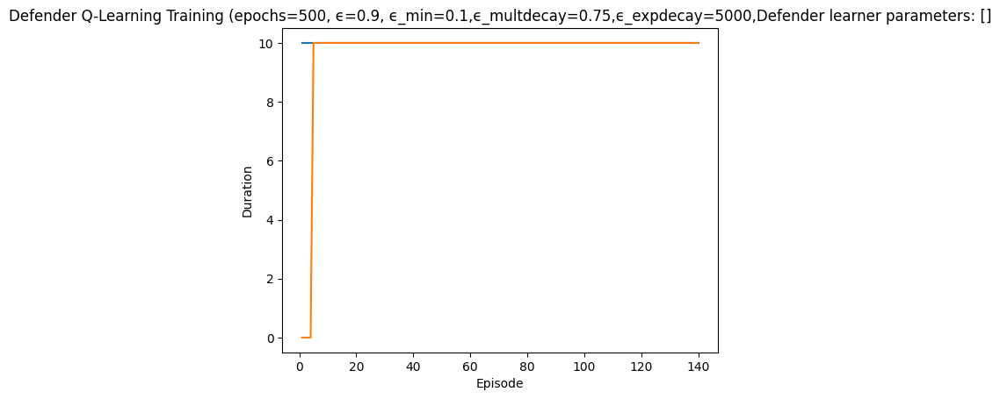

Rendering the current state of the environment
  ## Episode: 141/500 'Defender Q-Learning Training' ϵ=0.5286, Defender learner parameters: []


Episode 141|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1401, 'successful_actions': 570, 'failed_actions': 831}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 1402, 'successful_actions': 571, 'failed_actions': 831}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action T

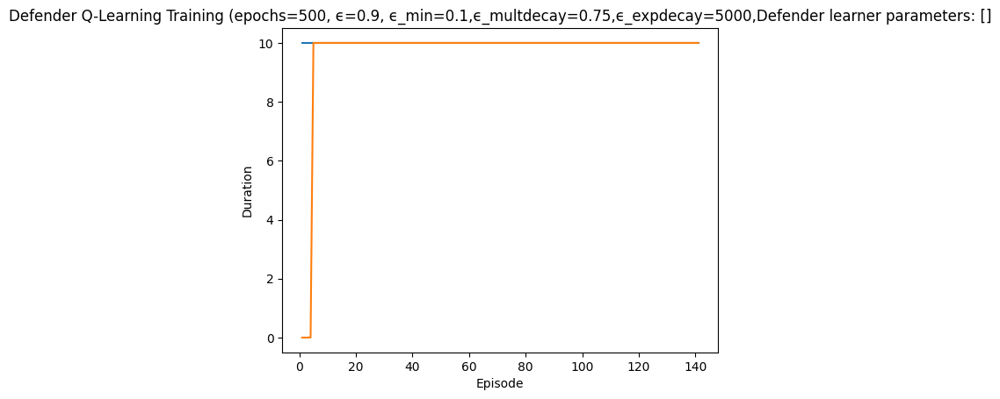

Rendering the current state of the environment
  ## Episode: 142/500 'Defender Q-Learning Training' ϵ=0.5277, Defender learner parameters: []


Episode 142|Iteration 10|reward:   55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=6, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1411, 'successful_actions': 576, 'failed_actions': 835}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1412, 'successful_actions': 577, 'failed_actions': 835}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'perform

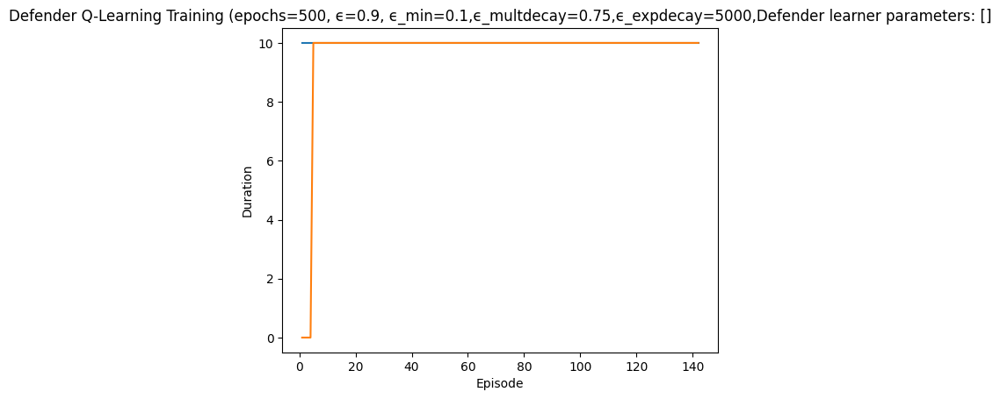

Rendering the current state of the environment
  ## Episode: 143/500 'Defender Q-Learning Training' ϵ=0.5268, Defender learner parameters: []


Episode 143|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1421, 'successful_actions': 579, 'failed_actions': 842}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1422, 'successful_actions': 579, 'failed_actions': 843}, 'network_availability': 1.0}
action 

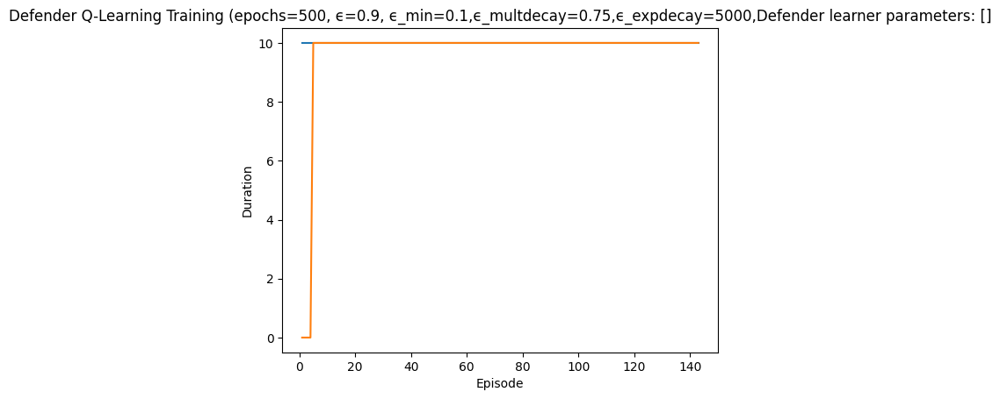

Rendering the current state of the environment
  ## Episode: 144/500 'Defender Q-Learning Training' ϵ=0.5258, Defender learner parameters: []


Episode 144|Iteration 3|reward:   -5.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1431, 'successful_actions': 582, 'failed_actions': 849}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1432, 'successful_actions': 582, 'failed_actions': 850}, 'network_availability': 1.0}
action type:  Reima

Episode 144|Iteration 4|reward:  -20.0|last_reward_at:    3|Elapsed Time: 0:00:00||

Iteration 4: Action Taken: Type=Start Service, NodeID=8, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1434, 'successful_actions': 583, 'failed_actions': 851}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged


Episode 144|Iteration 10|reward:  -25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Allow Traffic
Iteration 5: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1435, 'successful_actions': 583, 'failed_actions': 852}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 6: Action Taken: Type=Reimage Node, NodeID=2, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1436, 'successful_actions': 583, 'failed_actions': 853}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 7: Action Taken: Type=Block Traffic, NodeID=6, Parameter=8
info {'action': 'block_traffic', 'status': 'succe

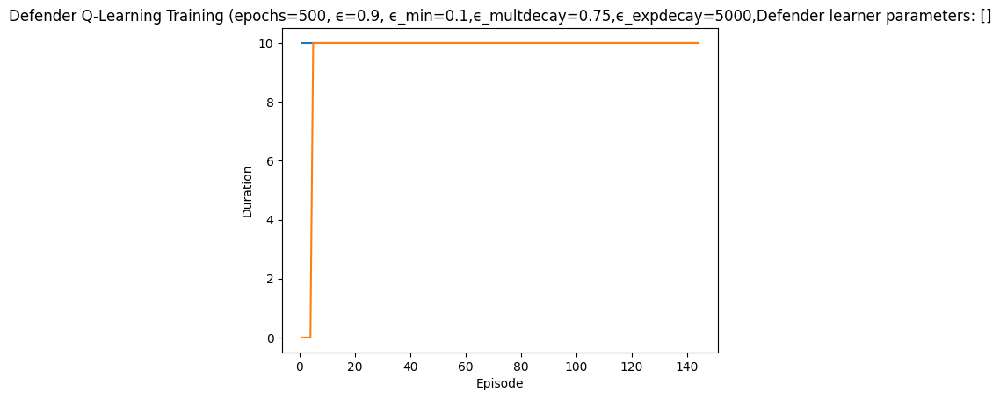

Rendering the current state of the environment
  ## Episode: 145/500 'Defender Q-Learning Training' ϵ=0.5249, Defender learner parameters: []


Episode 145|Iteration 10|reward:   90.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1441, 'successful_actions': 585, 'failed_actions': 856}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1442, 'successful_actions': 585, 'failed_actions': 857}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Act

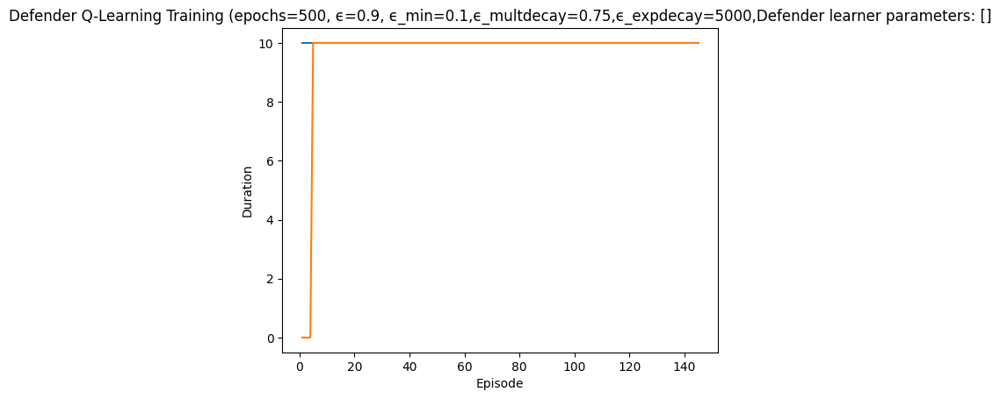

Rendering the current state of the environment
  ## Episode: 146/500 'Defender Q-Learning Training' ϵ=0.5240, Defender learner parameters: []


Episode 146|Iteration 10|reward:   30.0|last_reward_at:    5|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1451, 'successful_actions': 591, 'failed_actions': 860}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1452, 'successful_actions': 591, 'failed_actions': 861}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
I

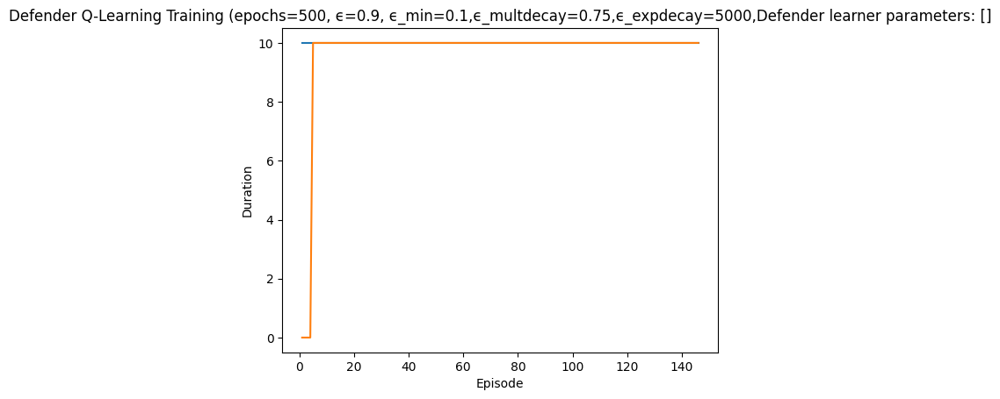

Rendering the current state of the environment
  ## Episode: 147/500 'Defender Q-Learning Training' ϵ=0.5232, Defender learner parameters: []


Episode 147|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1461, 'successful_actions': 593, 'failed_actions': 868}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1462, 'successful_actions': 593, 'failed_actions': 869}, 'network_availability': 1.0}


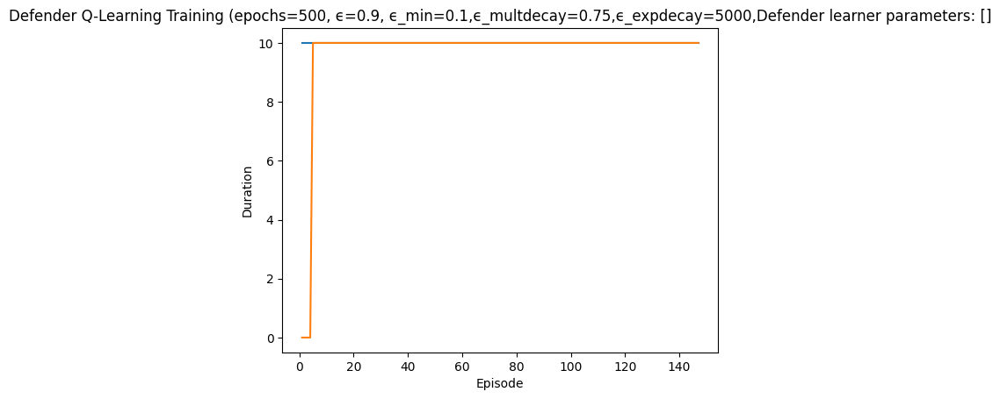

Rendering the current state of the environment
  ## Episode: 148/500 'Defender Q-Learning Training' ϵ=0.5223, Defender learner parameters: []


Episode 148|Iteration 10|reward:  -25.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1471, 'successful_actions': 596, 'failed_actions': 875}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1472, 'successful_actions': 596, 'failed_actions': 876}, 'network_availability': 1.0}
failed
{'act

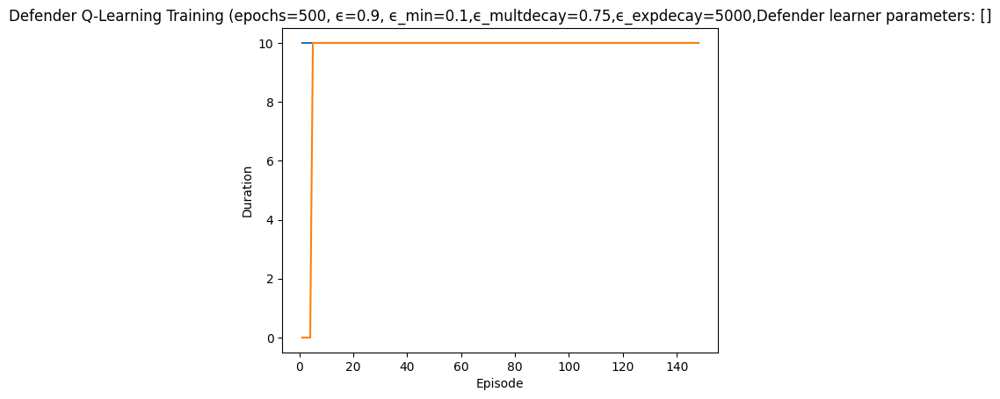

Rendering the current state of the environment
  ## Episode: 149/500 'Defender Q-Learning Training' ϵ=0.5214, Defender learner parameters: []


Episode 149|Iteration 10|reward:  -40.0|last_reward_at:    3|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1481, 'successful_actions': 598, 'failed_actions': 883}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 1482, 'successful_actions': 599, 'failed_actions': 883}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=11, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_Window

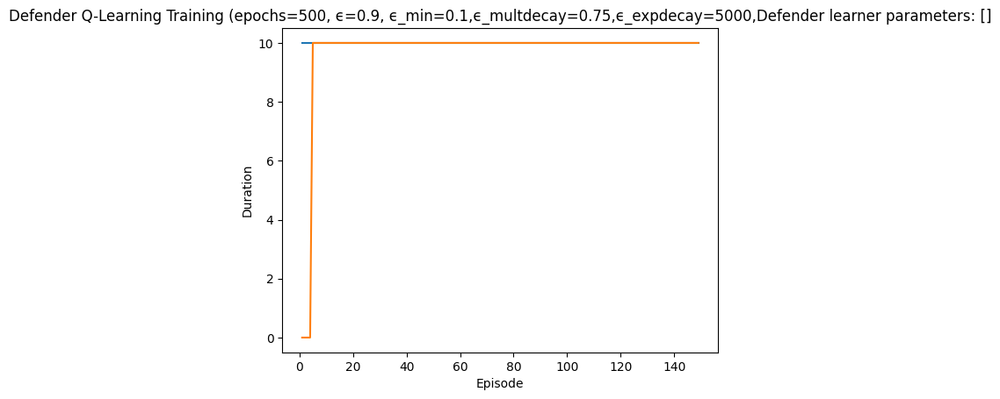

Rendering the current state of the environment
  ## Episode: 150/500 'Defender Q-Learning Training' ϵ=0.5205, Defender learner parameters: []


Episode 150|Iteration 10|reward:   50.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1491, 'successful_actions': 600, 'failed_actions': 891}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1492, 'successful_actions': 601, 'failed_actions': 891}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: 

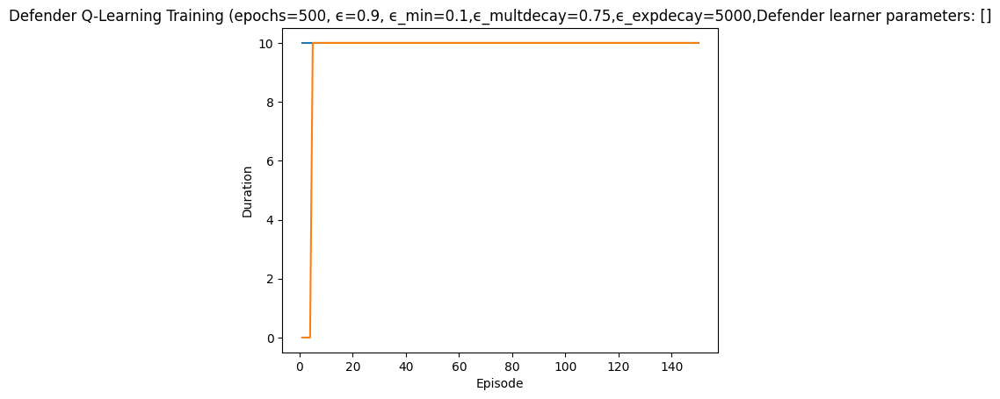

Rendering the current state of the environment
  ## Episode: 151/500 'Defender Q-Learning Training' ϵ=0.5196, Defender learner parameters: []


Episode 151|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1501, 'successful_actions': 605, 'failed_actions': 896}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=2, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1502, 'successful_actions': 606, 'failed_actions': 896}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action

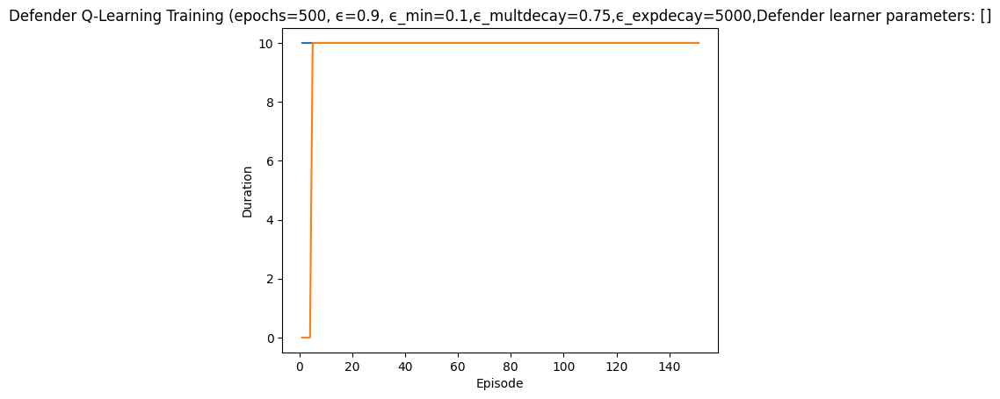

Rendering the current state of the environment
  ## Episode: 152/500 'Defender Q-Learning Training' ϵ=0.5187, Defender learner parameters: []


Episode 152|Iteration 10|reward:    5.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1511, 'successful_actions': 609, 'failed_actions': 902}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1512, 'successful_actions': 609, 'failed_actions': 903}, 'network_availabilit

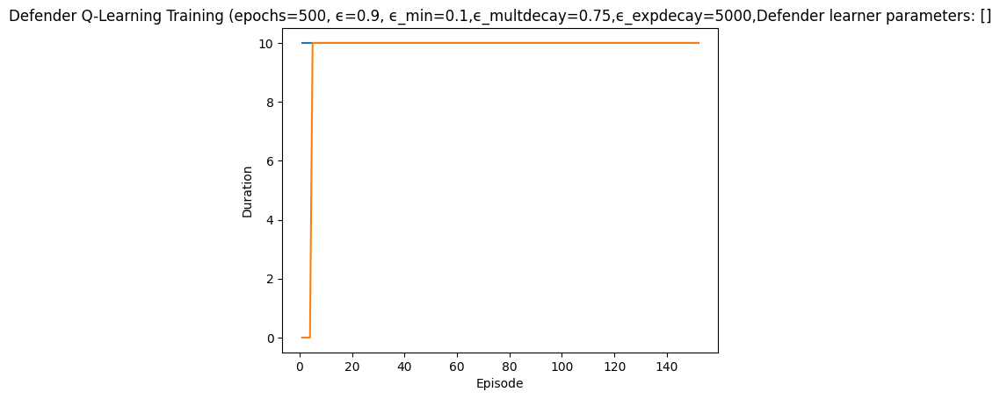

Rendering the current state of the environment
  ## Episode: 153/500 'Defender Q-Learning Training' ϵ=0.5178, Defender learner parameters: []


Episode 153|Iteration 10|reward:  120.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1521, 'successful_actions': 612, 'failed_actions': 909}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 1522, 'successful_actions': 613, 'failed_actions': 909}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=13, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 1523, 'successful_actions': 614, 'failed_actions': 909}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 4

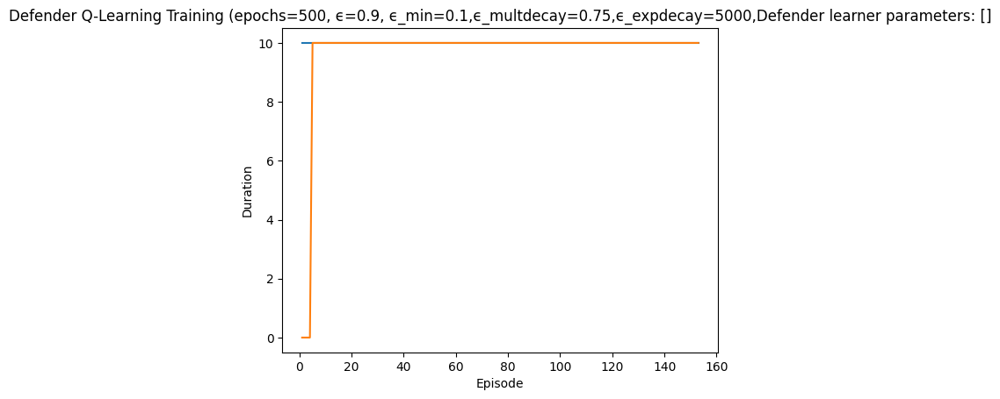

Rendering the current state of the environment
  ## Episode: 154/500 'Defender Q-Learning Training' ϵ=0.5169, Defender learner parameters: []


Episode 154|Iteration 4|reward:   35.0|last_reward_at:    3|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=6, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1531, 'successful_actions': 618, 'failed_actions': 913}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1532, 'successful_actions': 618, 'failed_actions': 914}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=10, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode',

Episode 154|Iteration 6|reward:    5.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 5: Action Taken: Type=Block Traffic, NodeID=0, Parameter=6
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1535, 'successful_actions': 619, 'failed_actions': 916}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 6: Action Taken: Type=Start Service, NodeID=12, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1536, 'successful_actions': 619, 'failed_actions': 917}, 'network_availability': 1.0}


Episode 154|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 7: Action Taken: Type=Reimage Node, NodeID=9, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 1537, 'successful_actions': 620, 'failed_actions': 917}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 8: Action Taken: Type=Reimage Node, NodeID=9, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1538, 'successful_actions': 620, 'failed_actions': 918}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 9: Action Taken: Type=Reimage Node, NodeID=13, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsN

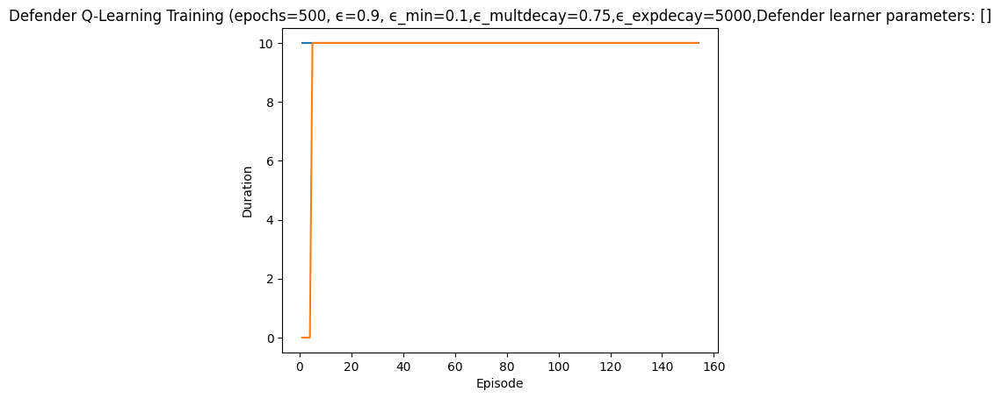

Rendering the current state of the environment
  ## Episode: 155/500 'Defender Q-Learning Training' ϵ=0.5160, Defender learner parameters: []


Episode 155|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1541, 'successful_actions': 623, 'failed_actions': 918}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=2, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1542, 'successful_actions': 623, 'failed_actions': 919}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3:

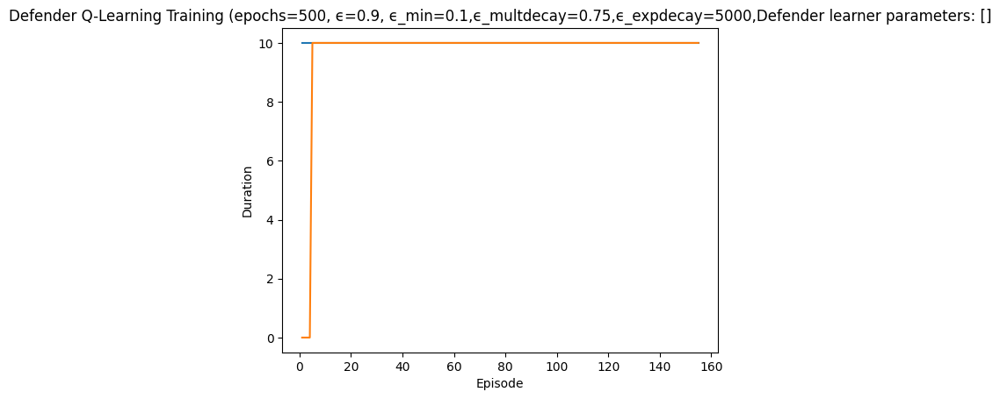

Rendering the current state of the environment
  ## Episode: 156/500 'Defender Q-Learning Training' ϵ=0.5152, Defender learner parameters: []


Episode 156|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1551, 'successful_actions': 625, 'failed_actions': 926}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1552, 'successful_actions': 625, 'failed_actions': 927}, 'network_availability': 1.0}
failed
{'action': 'reim

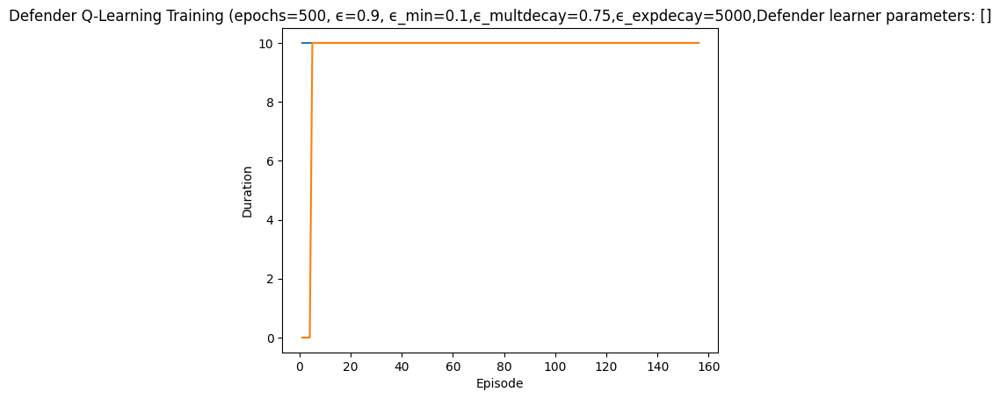

Rendering the current state of the environment
  ## Episode: 157/500 'Defender Q-Learning Training' ϵ=0.5143, Defender learner parameters: []


Episode 157|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=13, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1561, 'successful_actions': 629, 'failed_actions': 932}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1562, 'successful_actions': 629, 'failed_actions': 933}, 'network_availability': 1.0}
failed
{'

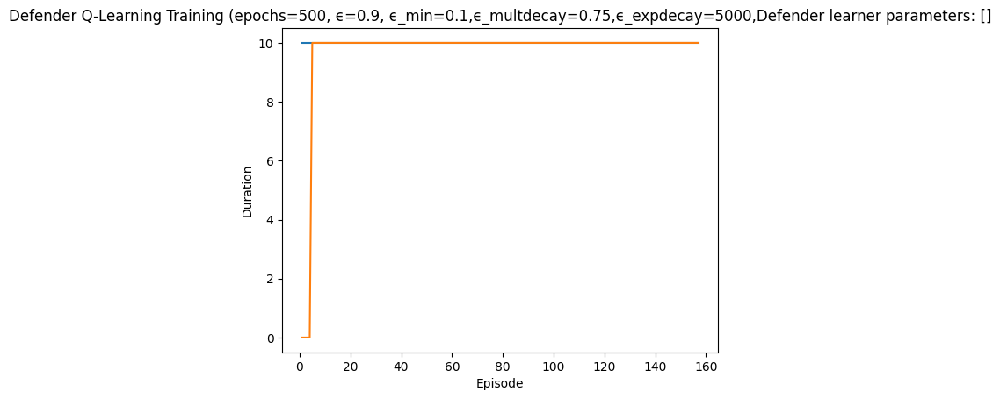

Rendering the current state of the environment
  ## Episode: 158/500 'Defender Q-Learning Training' ϵ=0.5134, Defender learner parameters: []


Episode 158|Iteration 10|reward:   45.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1571, 'successful_actions': 633, 'failed_actions': 938}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1572, 'successful_actions': 633, 'failed_actions': 939}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Ite

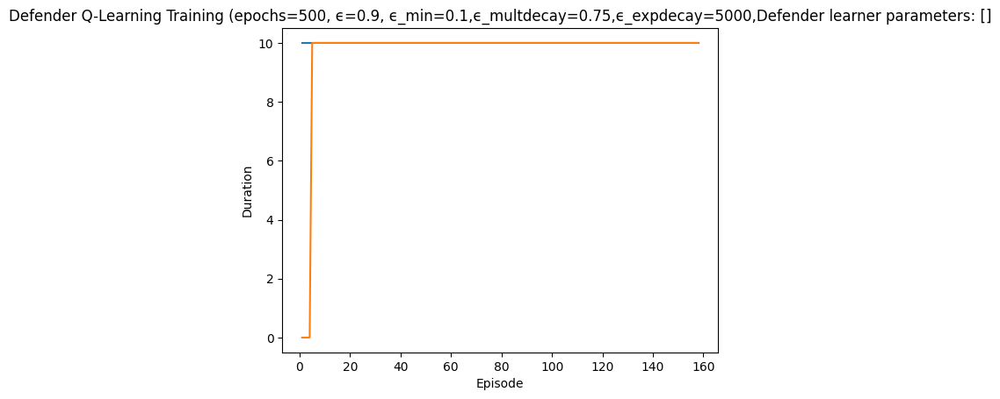

Rendering the current state of the environment
  ## Episode: 159/500 'Defender Q-Learning Training' ϵ=0.5125, Defender learner parameters: []


Episode 159|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=9, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1581, 'successful_actions': 636, 'failed_actions': 945}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1582, 'successful_actions': 637, 'failed_actions': 945}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'per

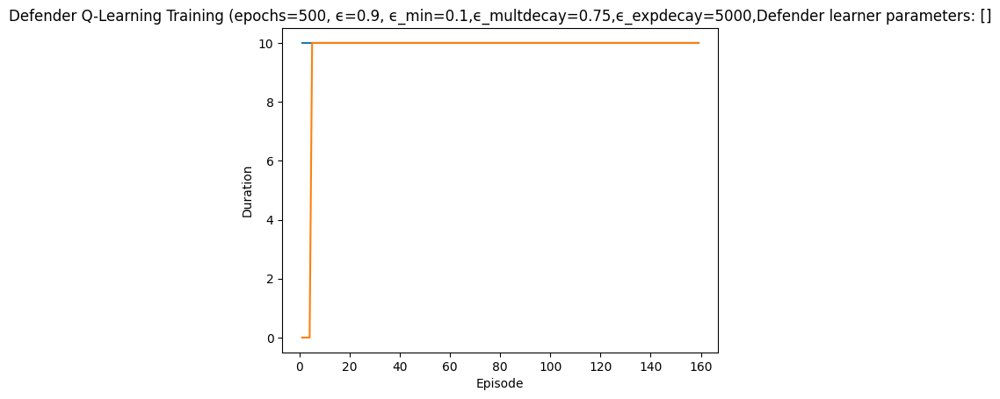

Rendering the current state of the environment
  ## Episode: 160/500 'Defender Q-Learning Training' ϵ=0.5116, Defender learner parameters: []


Episode 160|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1591, 'successful_actions': 640, 'failed_actions': 951}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1592, 'successful_actions': 641, 'failed_actions': 951}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action 

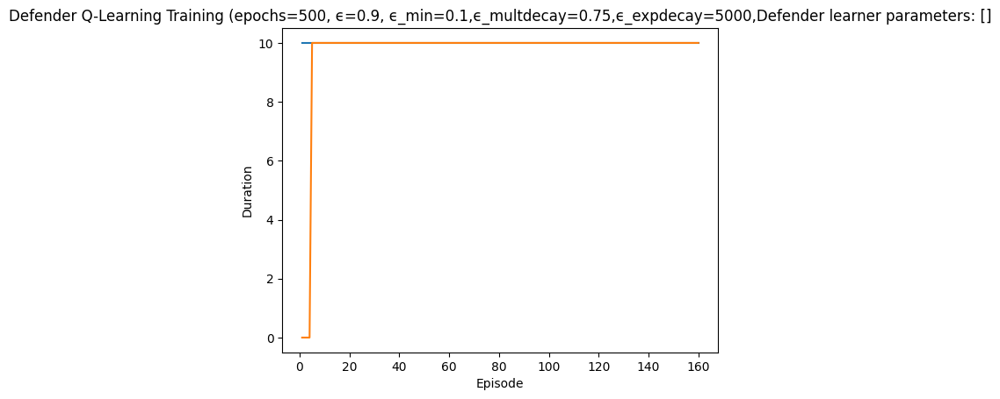

Rendering the current state of the environment
  ## Episode: 161/500 'Defender Q-Learning Training' ϵ=0.5108, Defender learner parameters: []


Episode 161|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1601, 'successful_actions': 645, 'failed_actions': 956}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=10, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1602, 'successful_actions': 645, 'failed_actions': 957}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action 

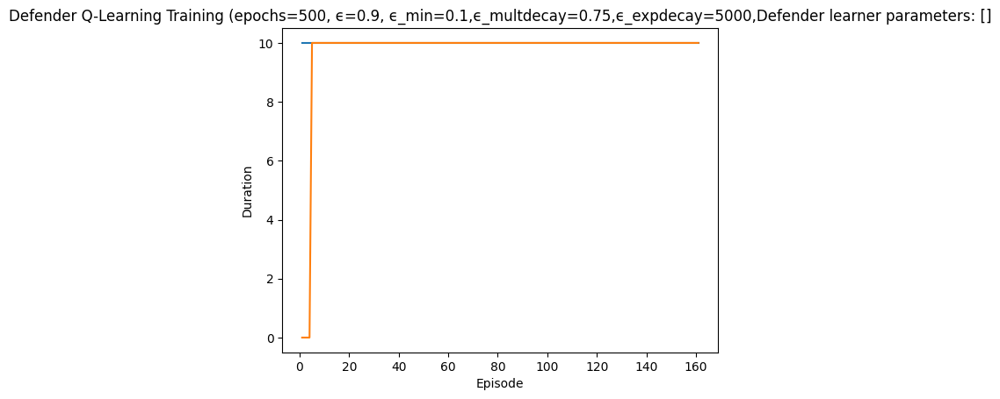

Rendering the current state of the environment
  ## Episode: 162/500 'Defender Q-Learning Training' ϵ=0.5099, Defender learner parameters: []


Episode 162|Iteration 10|reward:    0.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 1611, 'successful_actions': 649, 'failed_actions': 962}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1612, 'successful_actions': 650, 'failed_actions': 962}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not fou

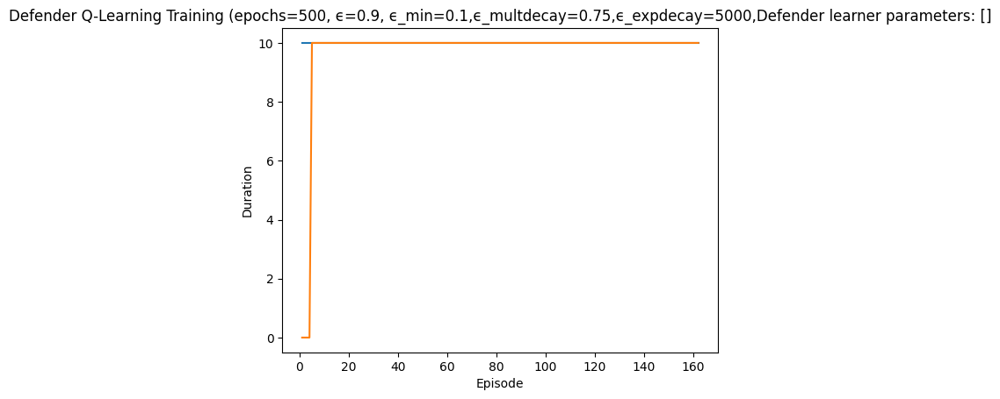

Rendering the current state of the environment
  ## Episode: 163/500 'Defender Q-Learning Training' ϵ=0.5090, Defender learner parameters: []


Episode 163|Iteration 10|reward:   90.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1621, 'successful_actions': 651, 'failed_actions': 970}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=6, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1622, 'successful_actions': 651, 'failed_actions': 971}, 'network_availability': 1.0}
action type:  Reim

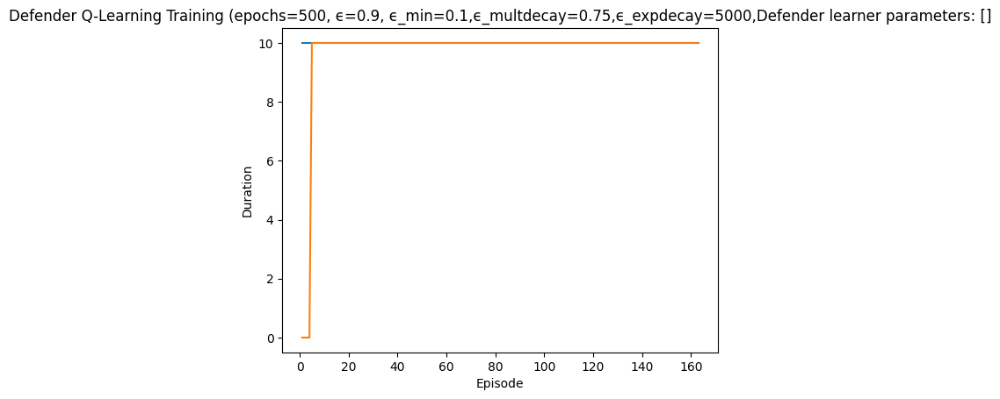

Rendering the current state of the environment
  ## Episode: 164/500 'Defender Q-Learning Training' ϵ=0.5082, Defender learner parameters: []


Episode 164|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1631, 'successful_actions': 658, 'failed_actions': 973}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1632, 'successful_actions': 658, 'failed_actions': 974}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3

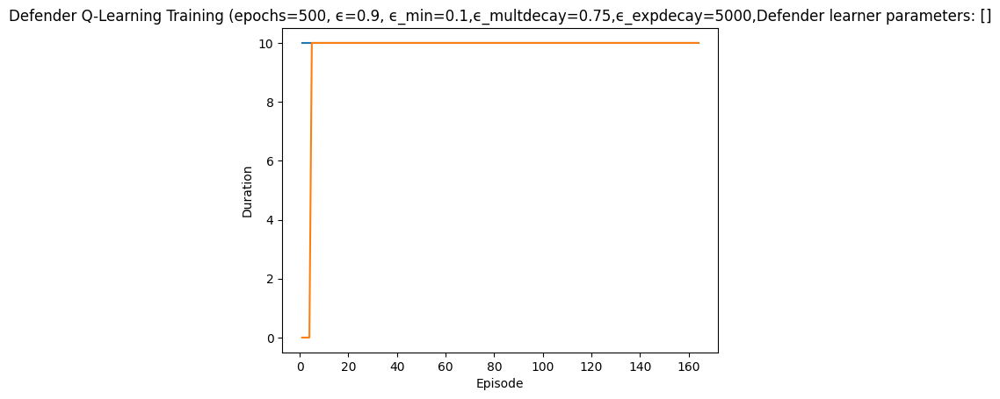

Rendering the current state of the environment
  ## Episode: 165/500 'Defender Q-Learning Training' ϵ=0.5073, Defender learner parameters: []


Episode 165|Iteration 10|reward:   80.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1641, 'successful_actions': 661, 'failed_actions': 980}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1642, 'successful_actions': 661, 'failed_actions': 981}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=12, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 3,

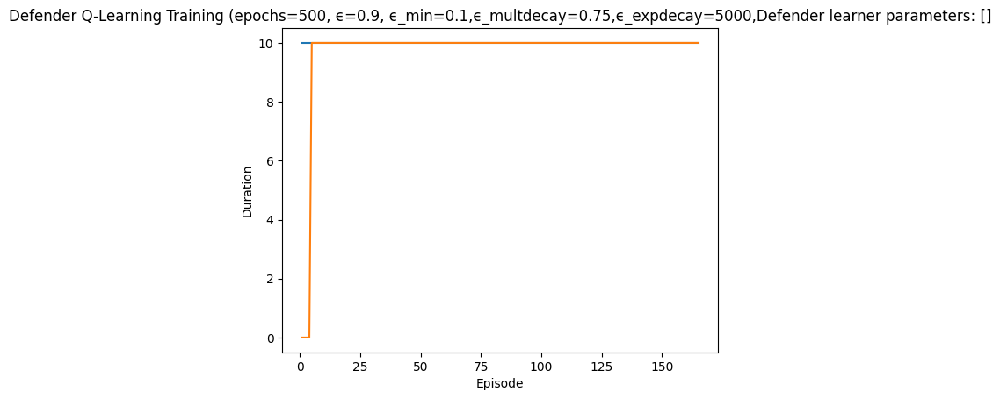

Rendering the current state of the environment
  ## Episode: 166/500 'Defender Q-Learning Training' ϵ=0.5064, Defender learner parameters: []


Episode 166|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1651, 'successful_actions': 666, 'failed_actions': 985}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1652, 'successful_actions': 667, 'failed_actions': 985}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=11, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 1653, 'successful_actions': 668, 'failed_actions': 985}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'st

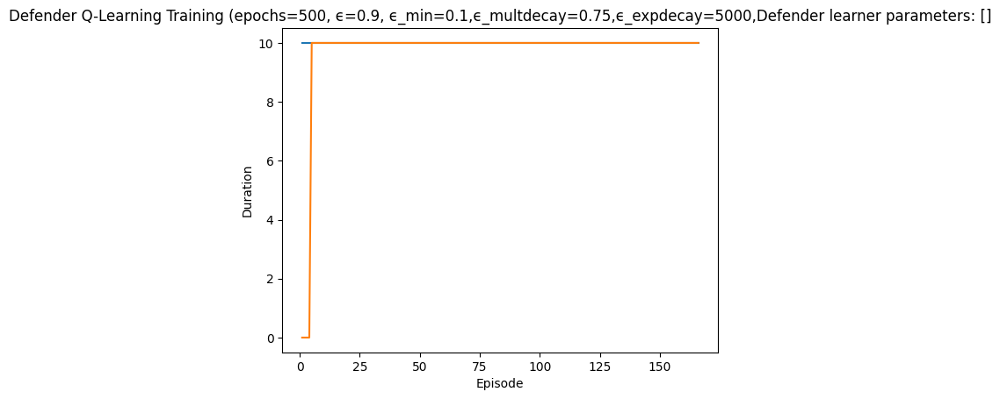

Rendering the current state of the environment
  ## Episode: 167/500 'Defender Q-Learning Training' ϵ=0.5056, Defender learner parameters: []


Episode 167|Iteration 10|reward:   10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1661, 'successful_actions': 671, 'failed_actions': 990}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1662, 'successful_actions': 671, 'failed_actions': 991}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=3, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'por

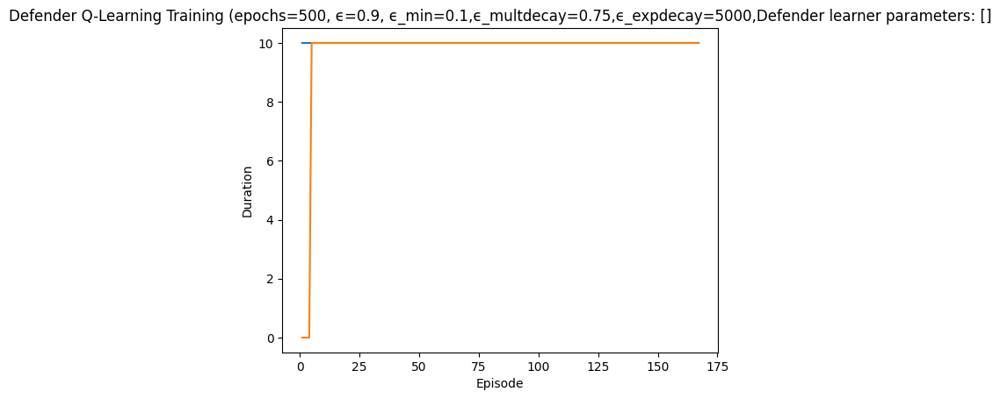

Rendering the current state of the environment
  ## Episode: 168/500 'Defender Q-Learning Training' ϵ=0.5047, Defender learner parameters: []


Episode 168|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1671, 'successful_actions': 674, 'failed_actions': 997}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1672, 'successful_actions': 675, 'failed_actions': 997}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=12, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_Linux

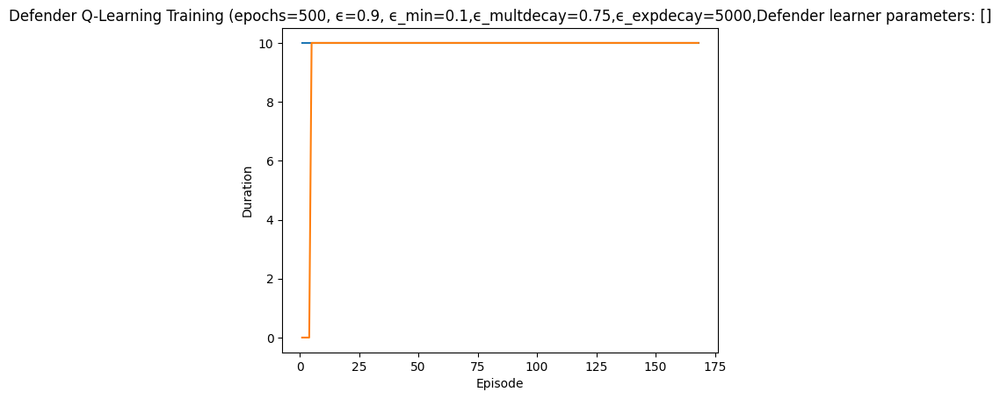

Rendering the current state of the environment
  ## Episode: 169/500 'Defender Q-Learning Training' ϵ=0.5039, Defender learner parameters: []


Episode 169|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=3, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1681, 'successful_actions': 678, 'failed_actions': 1003}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1682, 'successful_actions': 678, 'failed_actions': 1004}, 'network_availability': 1.0}
failed
{'a

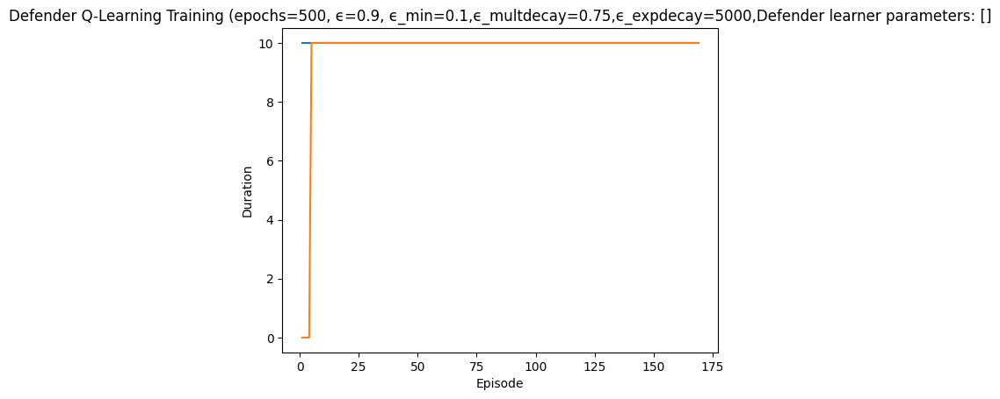

Rendering the current state of the environment
  ## Episode: 170/500 'Defender Q-Learning Training' ϵ=0.5030, Defender learner parameters: []


Episode 170|Iteration 10|reward:  120.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=8, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1691, 'successful_actions': 684, 'failed_actions': 1007}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1692, 'successful_actions': 684, 'failed_actions': 1008}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3:

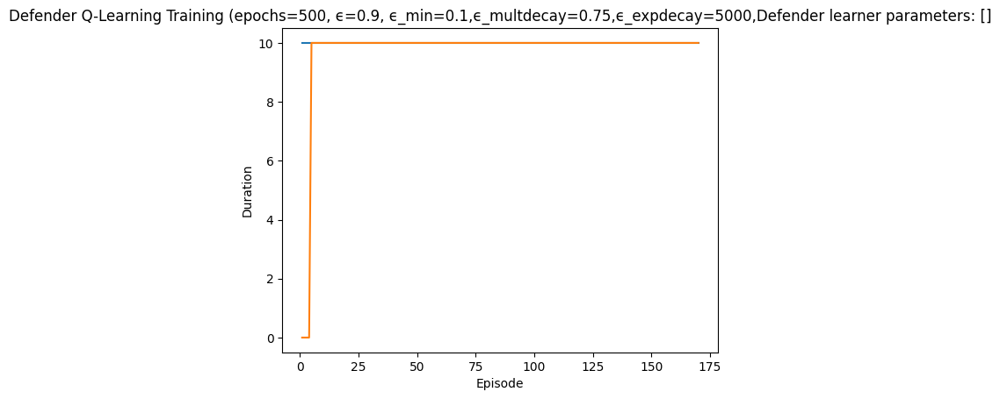

Rendering the current state of the environment
  ## Episode: 171/500 'Defender Q-Learning Training' ϵ=0.5021, Defender learner parameters: []


Episode 171|Iteration 10|reward:  -25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=7, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1701, 'successful_actions': 689, 'failed_actions': 1012}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1702, 'successful_actions': 689, 'failed_actions': 1013}, 'network_availability': 1.0}


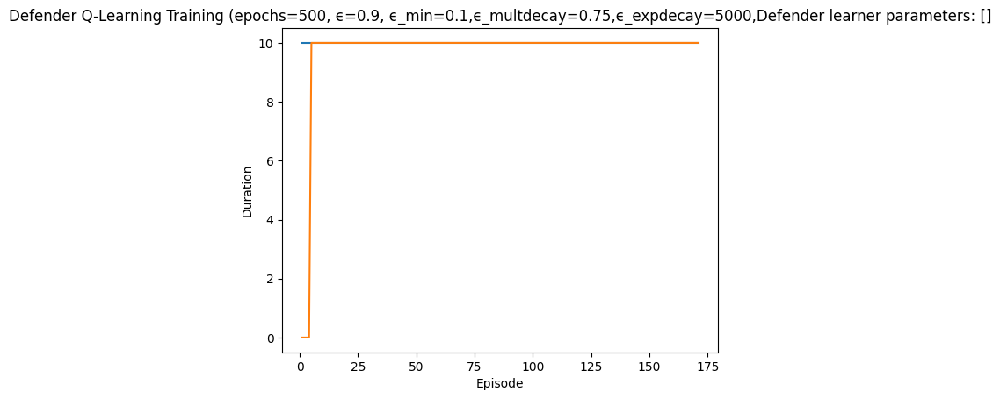

Rendering the current state of the environment
  ## Episode: 172/500 'Defender Q-Learning Training' ϵ=0.5013, Defender learner parameters: []


Episode 172|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1711, 'successful_actions': 691, 'failed_actions': 1020}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1712, 'successful_actions': 692, 'failed_actions': 1020}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service


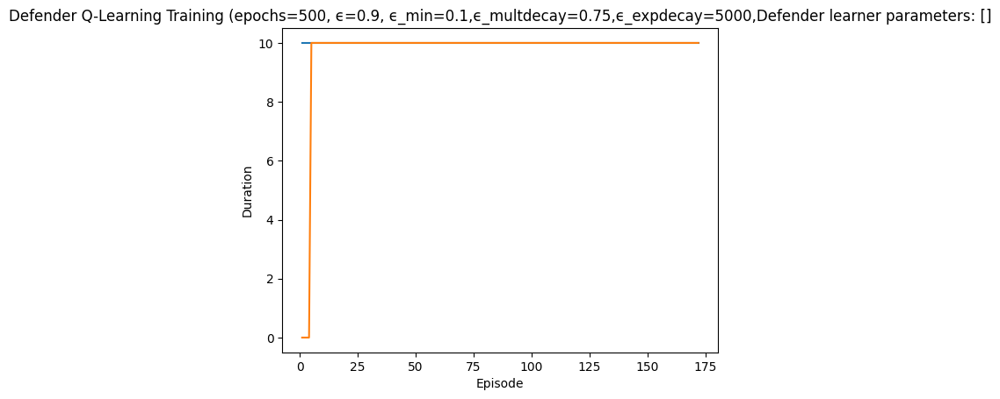

Rendering the current state of the environment
  ## Episode: 173/500 'Defender Q-Learning Training' ϵ=0.5004, Defender learner parameters: []


Episode 173|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1721, 'successful_actions': 696, 'failed_actions': 1025}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1722, 'successful_actions': 696, 'failed_actions': 1026}, 'network_availability': 1.0}
failed
{'action'

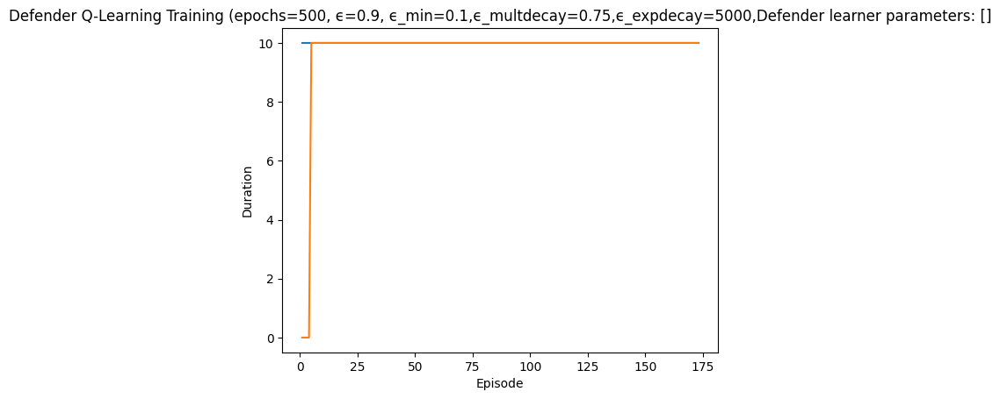

Rendering the current state of the environment
  ## Episode: 174/500 'Defender Q-Learning Training' ϵ=0.4996, Defender learner parameters: []


Episode 174|Iteration 10|reward:   90.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1731, 'successful_actions': 701, 'failed_actions': 1030}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 1732, 'successful_actions': 702, 'failed_actions': 1030}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=6, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 7, 'per

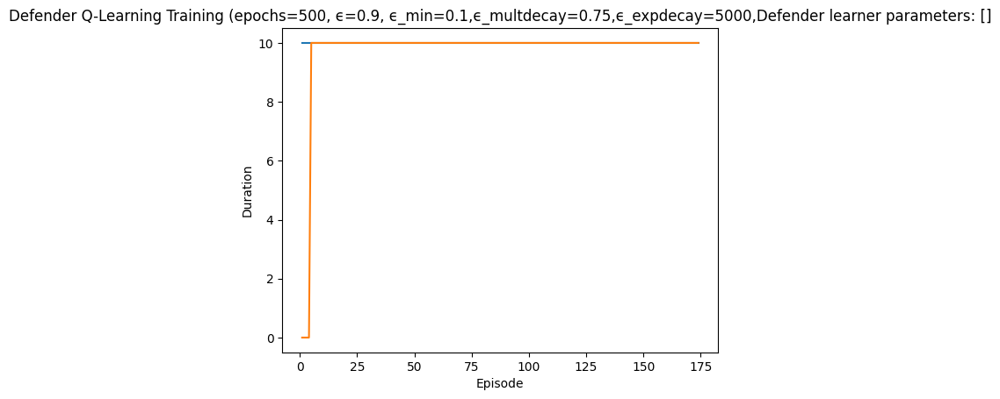

Rendering the current state of the environment
  ## Episode: 175/500 'Defender Q-Learning Training' ϵ=0.4987, Defender learner parameters: []


Episode 175|Iteration 10|reward:   95.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=6, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1741, 'successful_actions': 708, 'failed_actions': 1033}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1742, 'successful_actions': 708, 'failed_actions': 1034}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=9, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_

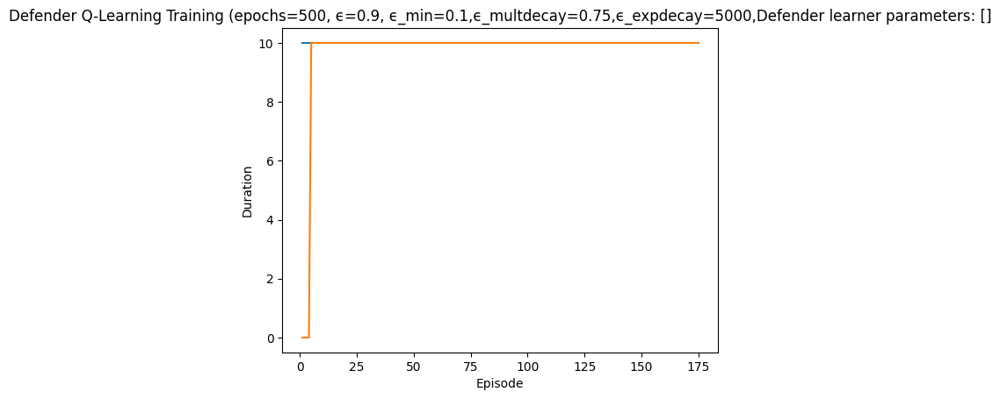

Rendering the current state of the environment
  ## Episode: 176/500 'Defender Q-Learning Training' ϵ=0.4979, Defender learner parameters: []


Episode 176|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1751, 'successful_actions': 712, 'failed_actions': 1039}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 1752, 'successful_actions': 713, 'failed_actions': 1039}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Ta

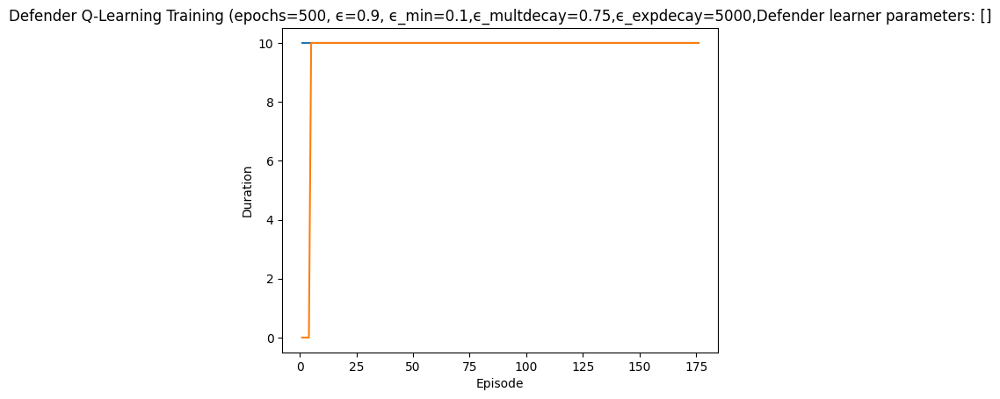

Rendering the current state of the environment
  ## Episode: 177/500 'Defender Q-Learning Training' ϵ=0.4971, Defender learner parameters: []


Episode 177|Iteration 10|reward:   25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1761, 'successful_actions': 715, 'failed_actions': 1046}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 1762, 'successful_actions': 716, 'failed_actions': 1046}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=5, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_nam

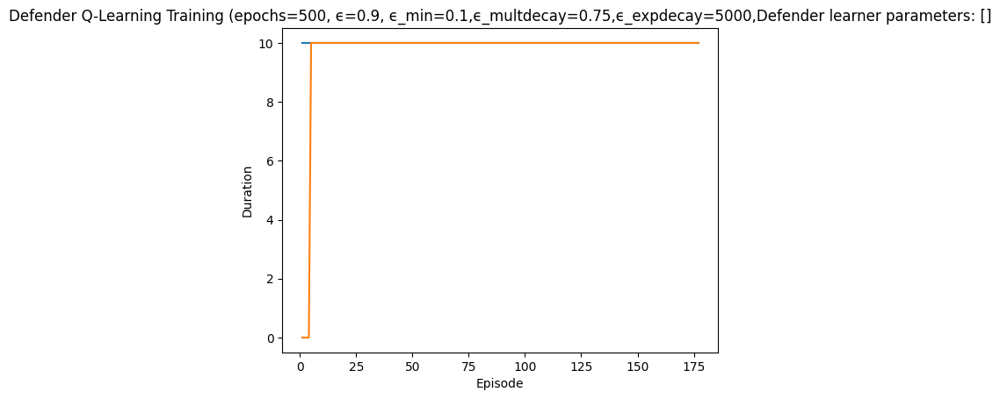

Rendering the current state of the environment
  ## Episode: 178/500 'Defender Q-Learning Training' ϵ=0.4962, Defender learner parameters: []


Episode 178|Iteration 10|reward:   15.0|last_reward_at:    5|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1771, 'successful_actions': 720, 'failed_actions': 1051}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1772, 'successful_actions': 721, 'failed_actions': 1051}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 2, 'reason': 'Service not foun

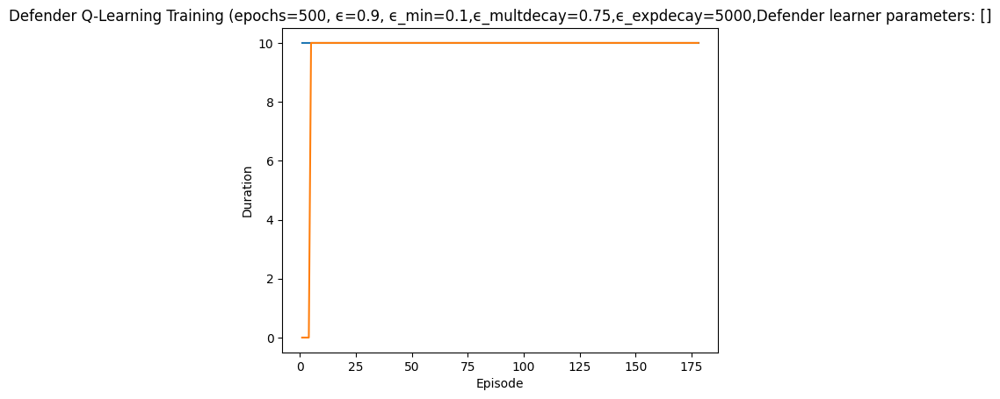

Rendering the current state of the environment
  ## Episode: 179/500 'Defender Q-Learning Training' ϵ=0.4954, Defender learner parameters: []


Episode 179|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1781, 'successful_actions': 722, 'failed_actions': 1059}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1782, 'successful_actions': 723, 'failed_actions': 1059}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=4, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name':

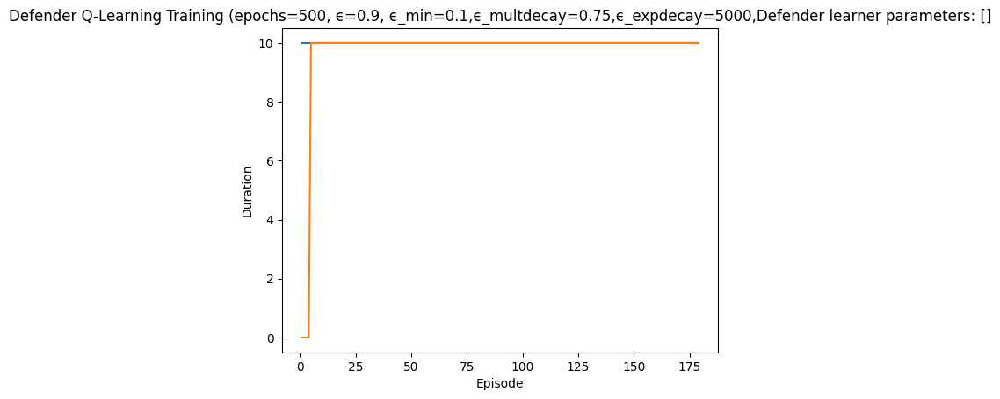

Rendering the current state of the environment
  ## Episode: 180/500 'Defender Q-Learning Training' ϵ=0.4945, Defender learner parameters: []


Episode 180|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1791, 'successful_actions': 727, 'failed_actions': 1064}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=6, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1792, 'successful_actions': 727, 'failed_actions': 1065}, 'network_availability': 1.0}
failed
{'action'

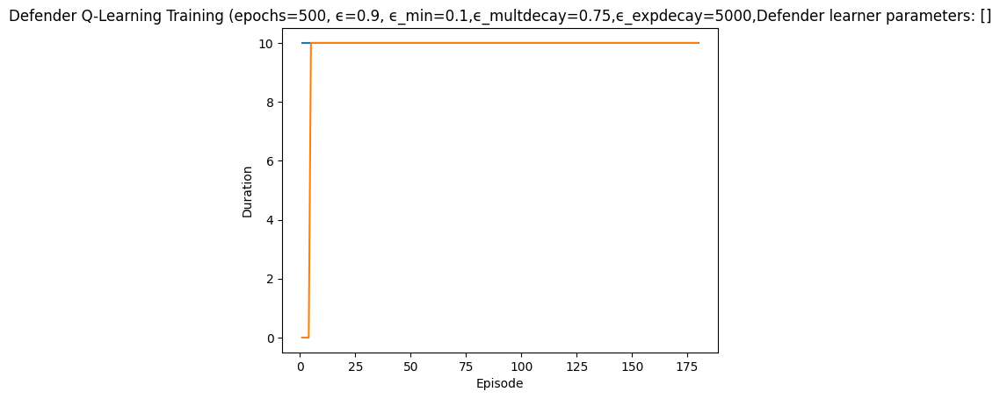

Rendering the current state of the environment
  ## Episode: 181/500 'Defender Q-Learning Training' ϵ=0.4937, Defender learner parameters: []


Episode 181|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1801, 'successful_actions': 733, 'failed_actions': 1068}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1802, 'successful_actions': 733, 'failed_actions': 1069}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=7, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsN

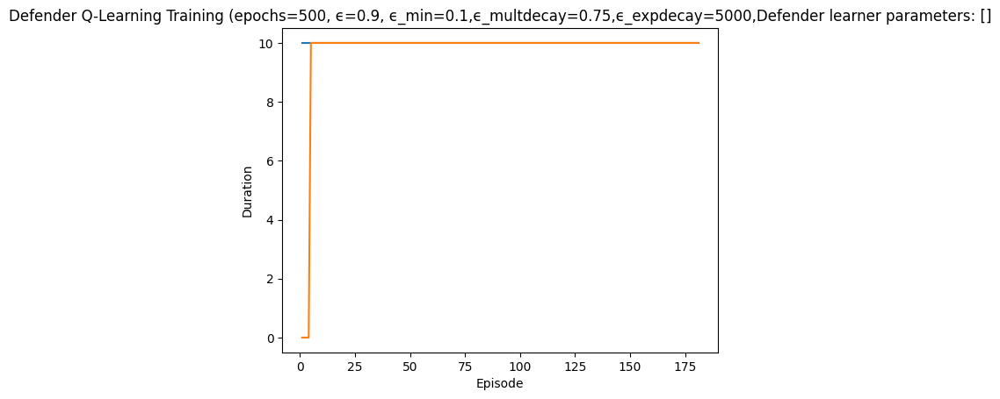

Rendering the current state of the environment
  ## Episode: 182/500 'Defender Q-Learning Training' ϵ=0.4929, Defender learner parameters: []


Episode 182|Iteration 10|reward:  -15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1811, 'successful_actions': 737, 'failed_actions': 1074}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=8, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1812, 'successful_actions': 737, 'failed_actions': 1075}, 'network_availability': 1.0}
failed
{'action'

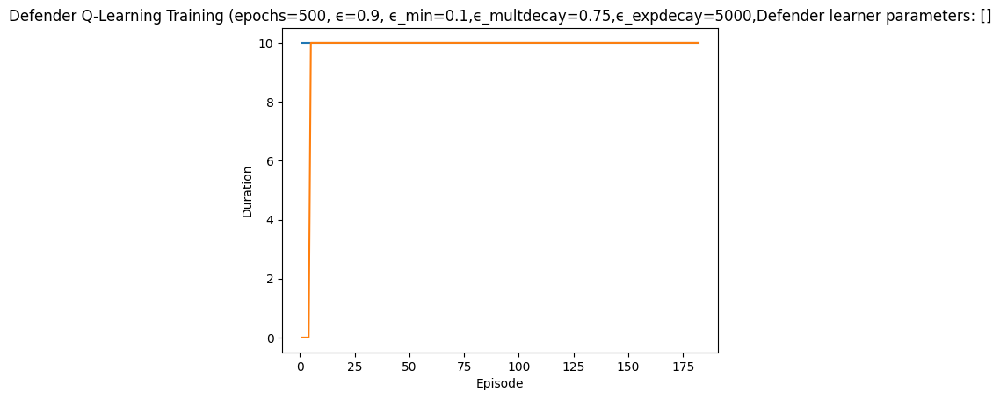

Rendering the current state of the environment
  ## Episode: 183/500 'Defender Q-Learning Training' ϵ=0.4920, Defender learner parameters: []


Episode 183|Iteration 10|reward:   40.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1821, 'successful_actions': 740, 'failed_actions': 1081}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=9, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1822, 'successful_actions': 741, 'failed_actions': 1081}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=13, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12

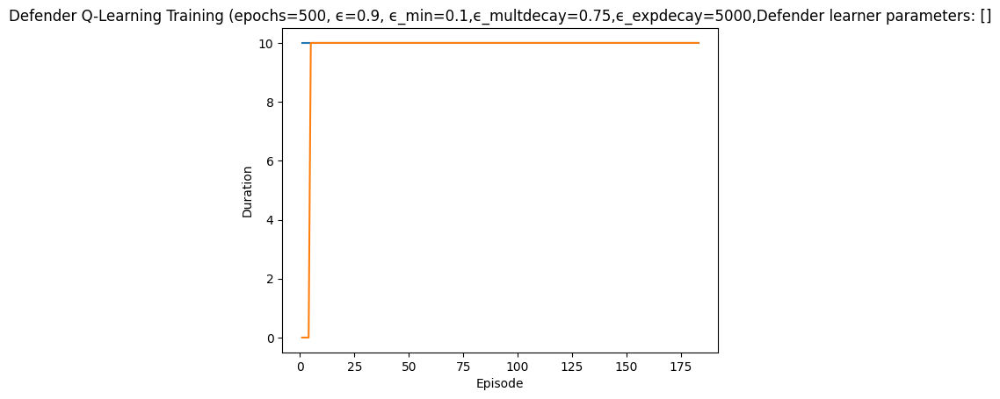

Rendering the current state of the environment
  ## Episode: 184/500 'Defender Q-Learning Training' ϵ=0.4912, Defender learner parameters: []


Episode 184|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1831, 'successful_actions': 745, 'failed_actions': 1086}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=4, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1832, 'successful_actions': 745, 'failed_actions': 1087}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=10, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_nam

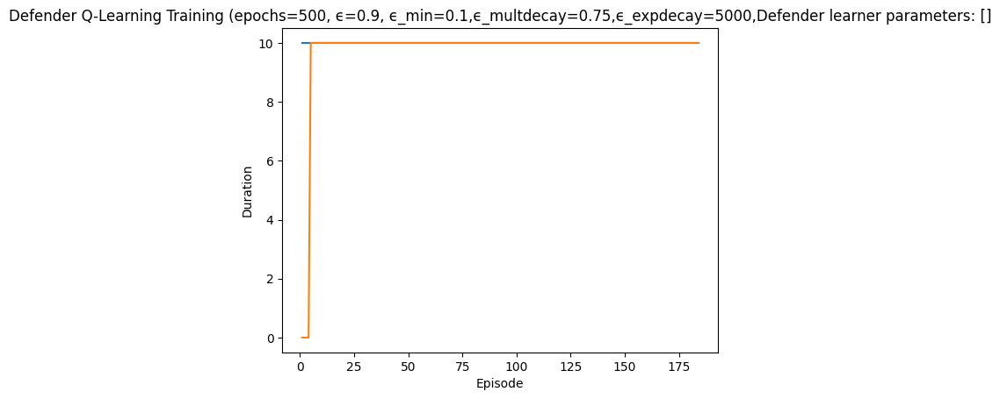

Rendering the current state of the environment
  ## Episode: 185/500 'Defender Q-Learning Training' ϵ=0.4904, Defender learner parameters: []


Episode 185|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=12, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1841, 'successful_actions': 750, 'failed_actions': 1091}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1842, 'successful_actions': 750, 'failed_actions': 1092}, 'network_availability': 1.0}
action type:  B

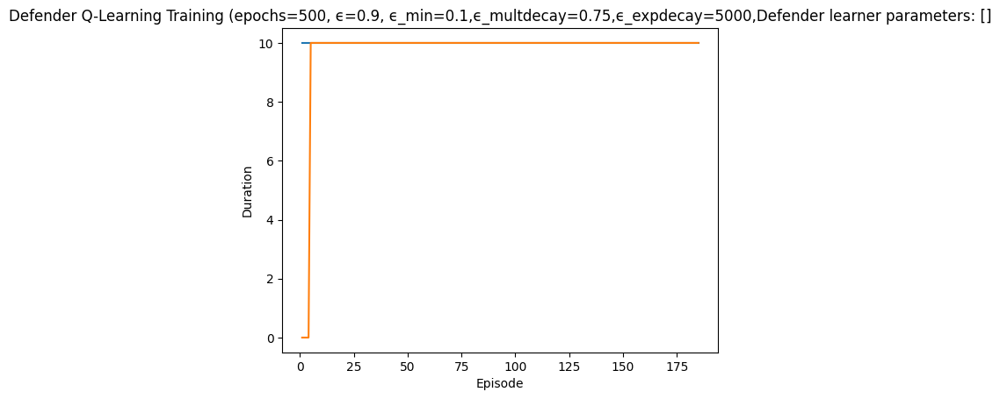

Rendering the current state of the environment
  ## Episode: 186/500 'Defender Q-Learning Training' ϵ=0.4895, Defender learner parameters: []


Episode 186|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=6, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1851, 'successful_actions': 754, 'failed_actions': 1097}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1852, 'successful_actions': 755, 'failed_actions': 1097}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=9, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode

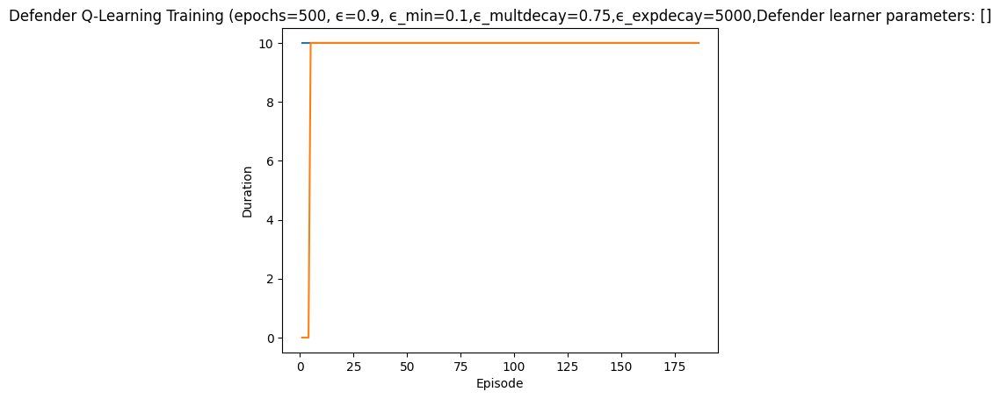

Rendering the current state of the environment
  ## Episode: 187/500 'Defender Q-Learning Training' ϵ=0.4887, Defender learner parameters: []


Episode 187|Iteration 10|reward:  -70.0|last_reward_at:    3|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1861, 'successful_actions': 759, 'failed_actions': 1102}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1862, 'successful_actions': 759, 'failed_actions': 1103}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=13, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_na

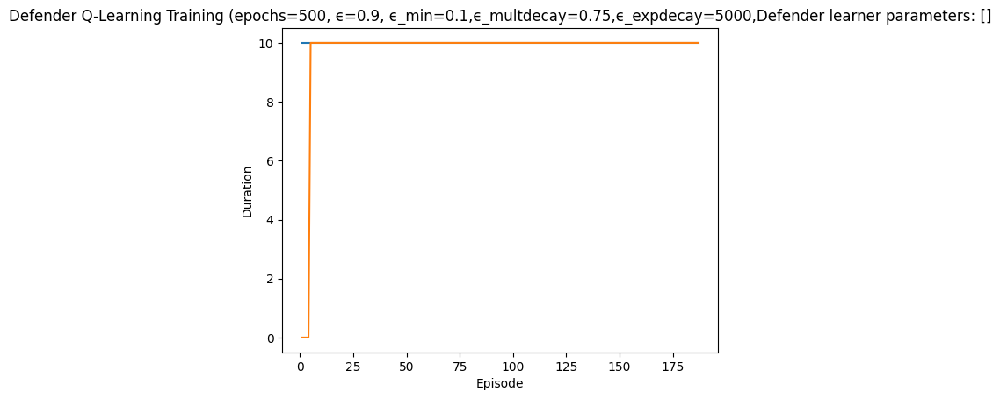

Rendering the current state of the environment
  ## Episode: 188/500 'Defender Q-Learning Training' ϵ=0.4879, Defender learner parameters: []


Episode 188|Iteration 10|reward:  -55.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1871, 'successful_actions': 760, 'failed_actions': 1111}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1872, 'successful_actions': 760, 'failed_actions': 1112}, 'network_availability': 1.0}
failed
{'

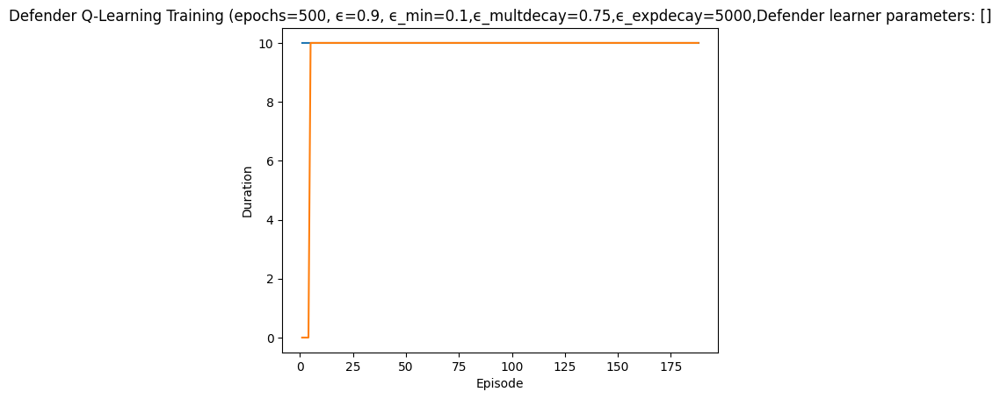

Rendering the current state of the environment
  ## Episode: 189/500 'Defender Q-Learning Training' ϵ=0.4870, Defender learner parameters: []


Episode 189|Iteration 10|reward:   25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1881, 'successful_actions': 762, 'failed_actions': 1119}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 1882, 'successful_actions': 763, 'failed_actions': 1119}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Acti

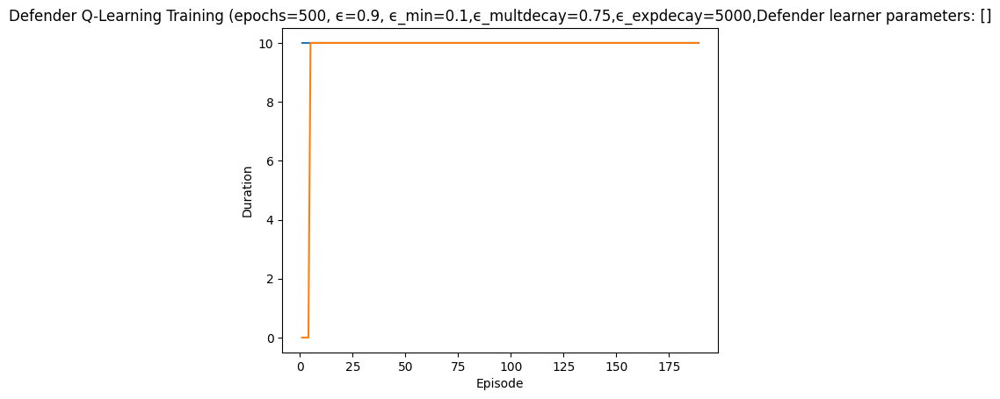

Rendering the current state of the environment
  ## Episode: 190/500 'Defender Q-Learning Training' ϵ=0.4862, Defender learner parameters: []


Episode 190|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=10, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1891, 'successful_actions': 766, 'failed_actions': 1125}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 1892, 'successful_actions': 767, 'failed_actions': 1125}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action 

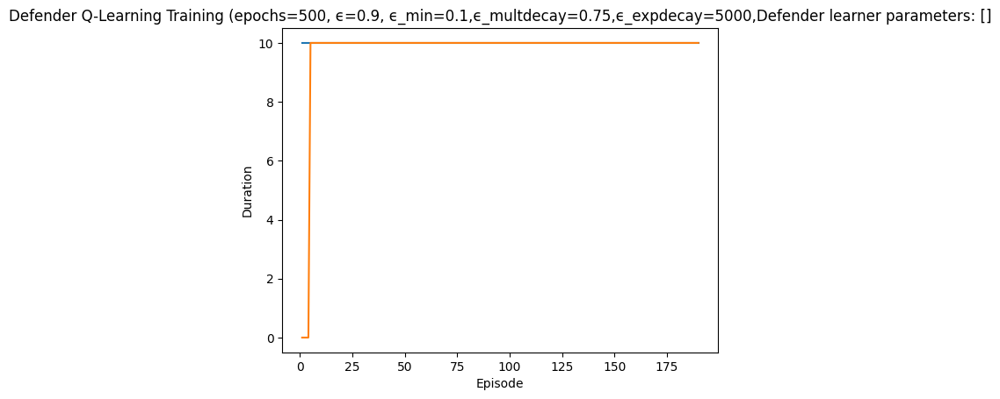

Rendering the current state of the environment
  ## Episode: 191/500 'Defender Q-Learning Training' ϵ=0.4854, Defender learner parameters: []


Episode 191|Iteration 10|reward:   15.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1901, 'successful_actions': 770, 'failed_actions': 1131}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1902, 'successful_actions': 770, 'failed_actions': 1132}, 'network_availability'

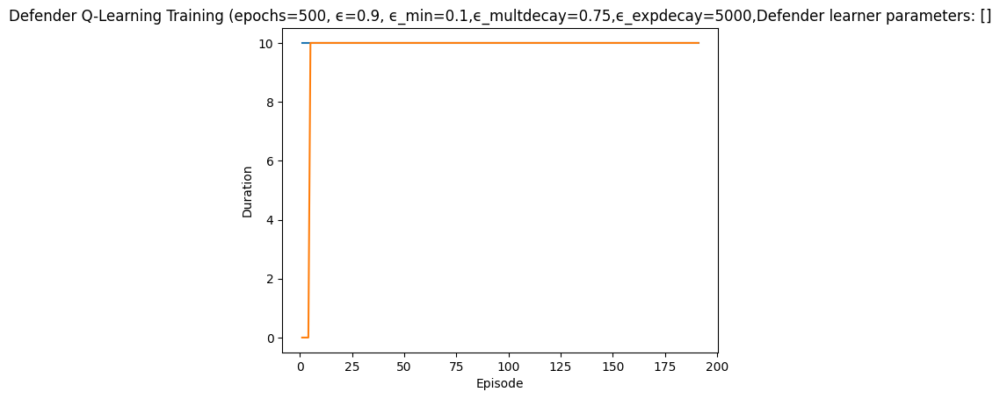

Rendering the current state of the environment
  ## Episode: 192/500 'Defender Q-Learning Training' ϵ=0.4846, Defender learner parameters: []


Episode 192|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1911, 'successful_actions': 773, 'failed_actions': 1138}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 1912, 'successful_actions': 774, 'failed_actions': 1138}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=9, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name':

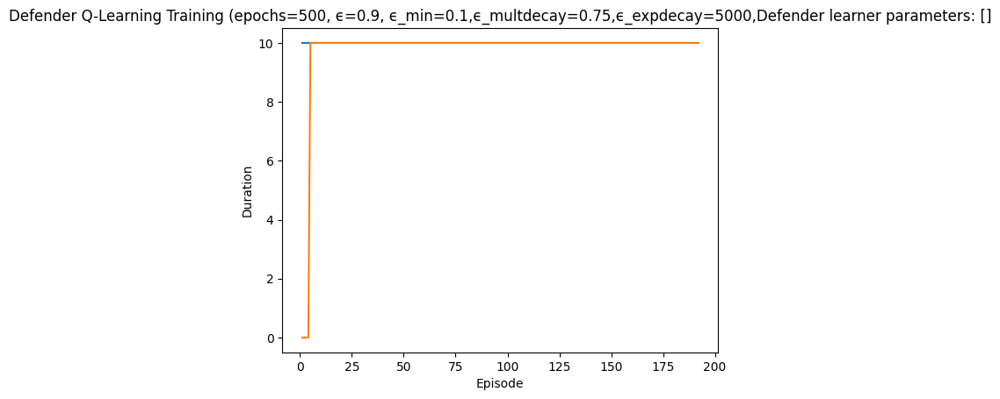

Rendering the current state of the environment
  ## Episode: 193/500 'Defender Q-Learning Training' ϵ=0.4838, Defender learner parameters: []


Episode 193|Iteration 10|reward:  -30.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 1921, 'successful_actions': 779, 'failed_actions': 1142}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 1922, 'successful_actions': 780, 'failed_actions': 1142}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=5, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 7, 'reason': 'Service no

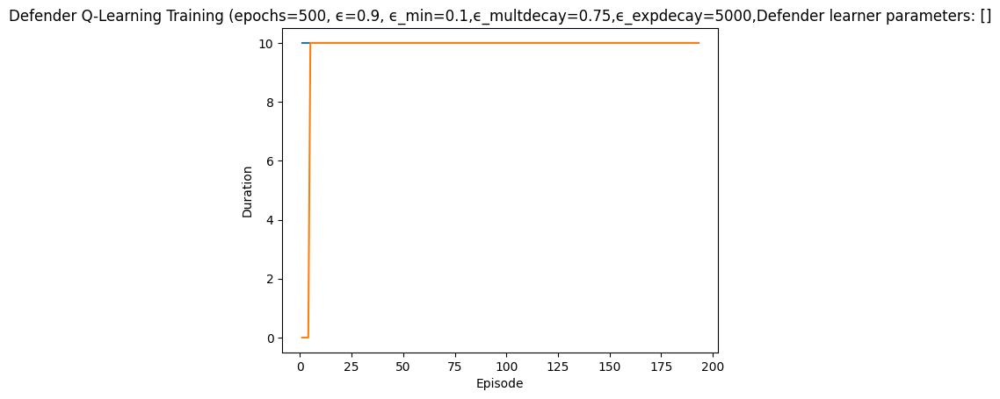

Rendering the current state of the environment
  ## Episode: 194/500 'Defender Q-Learning Training' ϵ=0.4829, Defender learner parameters: []


Episode 194|Iteration 2|reward:   10.0|last_reward_at: ----|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1931, 'successful_actions': 781, 'failed_actions': 1150}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1932, 'successful_actions': 782, 'failed_actions': 1150}, 'network_availability': 1.0}


Episode 194|Iteration 2|reward:   10.0|last_reward_at:    2|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=2, Parameter=1
info 

Episode 194|Iteration 10|reward:   30.0|last_reward_at:    6|Elapsed Time: 0:00:00||


{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1933, 'successful_actions': 782, 'failed_actions': 1151}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 4: Action Taken: Type=Reimage Node, NodeID=0, Parameter=9
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 1934, 'successful_actions': 782, 'failed_actions': 1152}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 5: Action Taken: Type=Block Traffic, NodeID=7, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 1935, 'successful_action

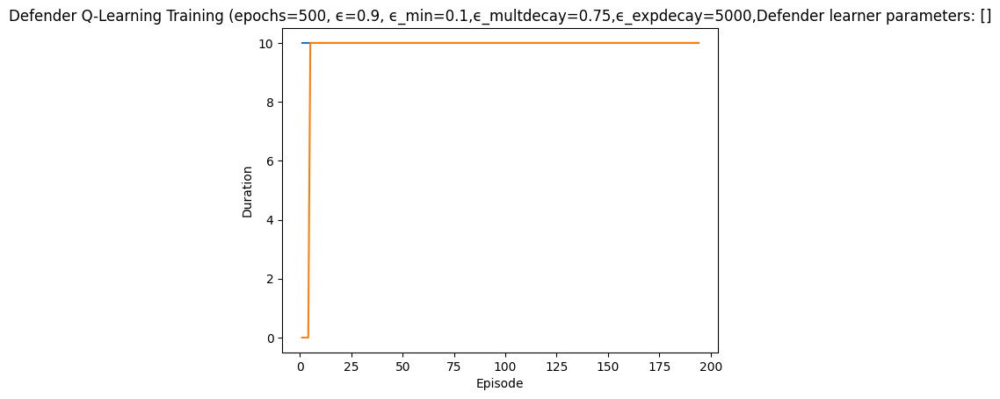

Rendering the current state of the environment
  ## Episode: 195/500 'Defender Q-Learning Training' ϵ=0.4821, Defender learner parameters: []


Episode 195|Iteration 10|reward:   95.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=5, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1941, 'successful_actions': 784, 'failed_actions': 1157}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1942, 'successful_actions': 785, 'failed_actions': 1157}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=13, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'p

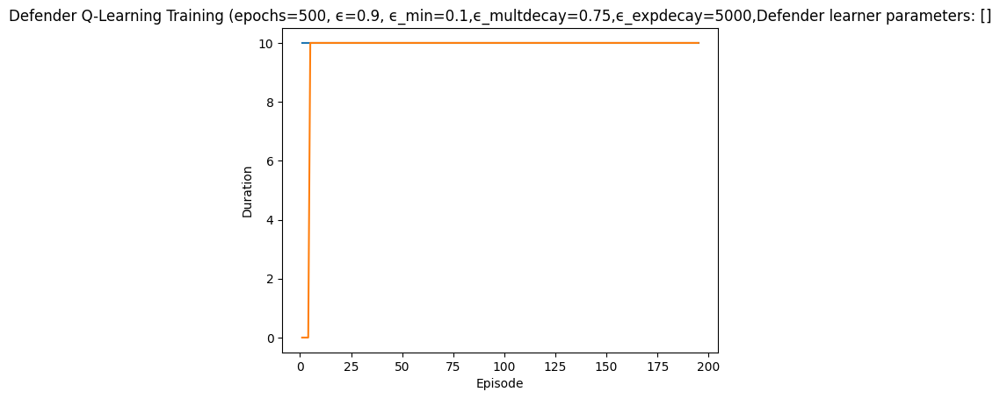

Rendering the current state of the environment
  ## Episode: 196/500 'Defender Q-Learning Training' ϵ=0.4813, Defender learner parameters: []


Episode 196|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1951, 'successful_actions': 789, 'failed_actions': 1162}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=6, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1952, 'successful_actions': 789, 'failed_actions': 1163}, 'network_availability': 1.0}
fa

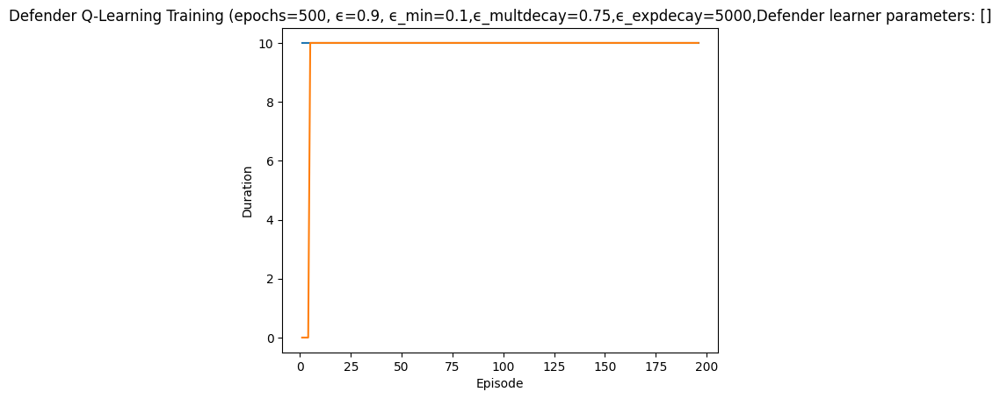

Rendering the current state of the environment
  ## Episode: 197/500 'Defender Q-Learning Training' ϵ=0.4805, Defender learner parameters: []


Episode 197|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1961, 'successful_actions': 793, 'failed_actions': 1168}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 1962, 'successful_actions': 794, 'failed_actions': 1168}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=11, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not require

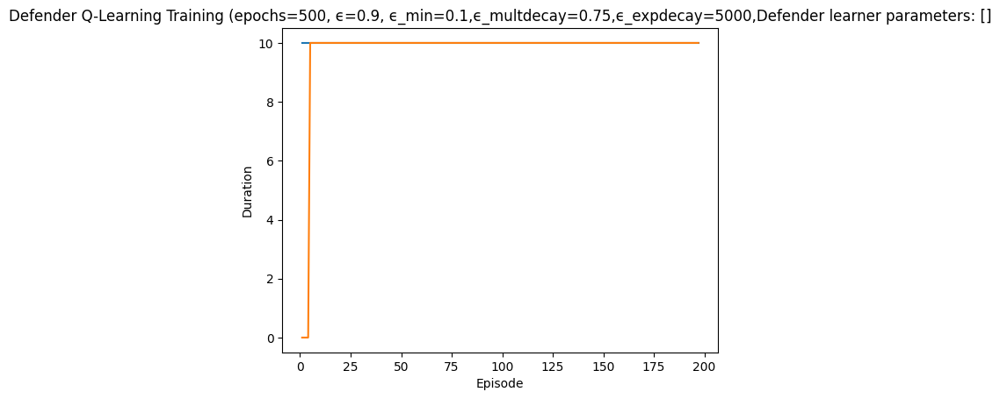

Rendering the current state of the environment
  ## Episode: 198/500 'Defender Q-Learning Training' ϵ=0.4797, Defender learner parameters: []


Episode 198|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=5, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1971, 'successful_actions': 796, 'failed_actions': 1175}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 1972, 'successful_actions': 797, 'failed_actions': 1175}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteratio

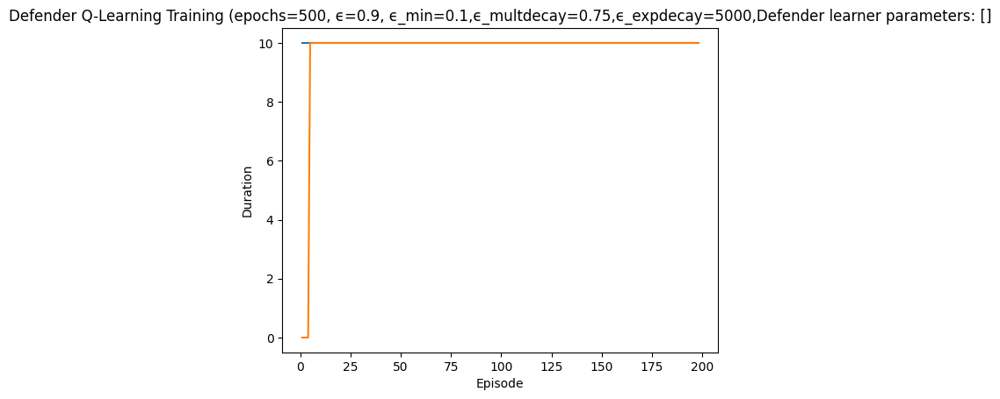

Rendering the current state of the environment
  ## Episode: 199/500 'Defender Q-Learning Training' ϵ=0.4789, Defender learner parameters: []


Episode 199|Iteration 10|reward:  -15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=12, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 1981, 'successful_actions': 800, 'failed_actions': 1181}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 1982, 'successful_actions': 800, 'failed_actions': 1182}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Acti

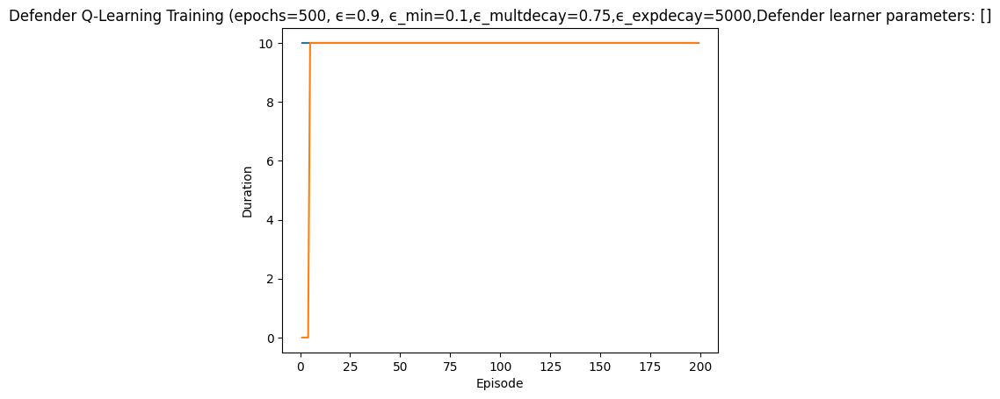

Rendering the current state of the environment
  ## Episode: 200/500 'Defender Q-Learning Training' ϵ=0.4781, Defender learner parameters: []


Episode 200|Iteration 10|reward:  160.0|last_reward_at:   10|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 1991, 'successful_actions': 803, 'failed_actions': 1188}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 1992, 'successful_actions': 803, 'failed_actions': 1189}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Nod

Episode 200|Iteration 10|reward:  160.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 200 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  Episode 200 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 410
    Blocking Traffic Count: 398
    Stopping Services Count: 0


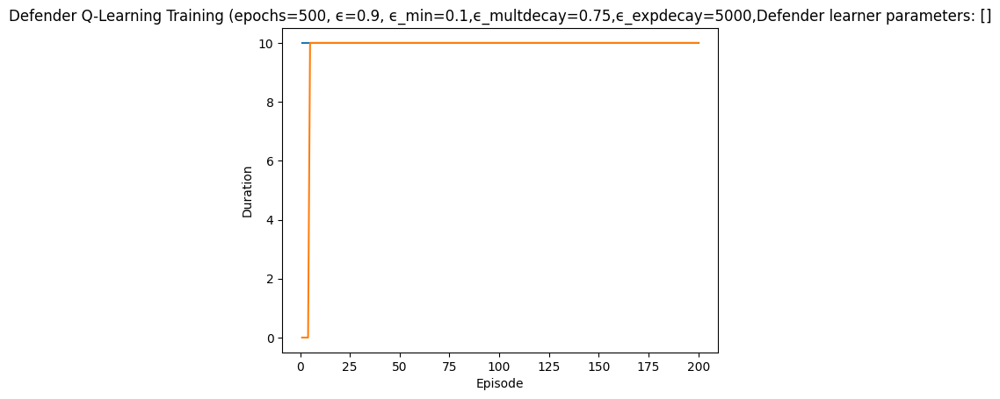

Rendering the current state of the environment
  ## Episode: 201/500 'Defender Q-Learning Training' ϵ=0.4773, Defender learner parameters: []


Episode 201|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2001, 'successful_actions': 809, 'failed_actions': 1192}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2002, 'successful_actions': 809, 'failed_actions': 1193}, 'network_availability': 1.0}
fai

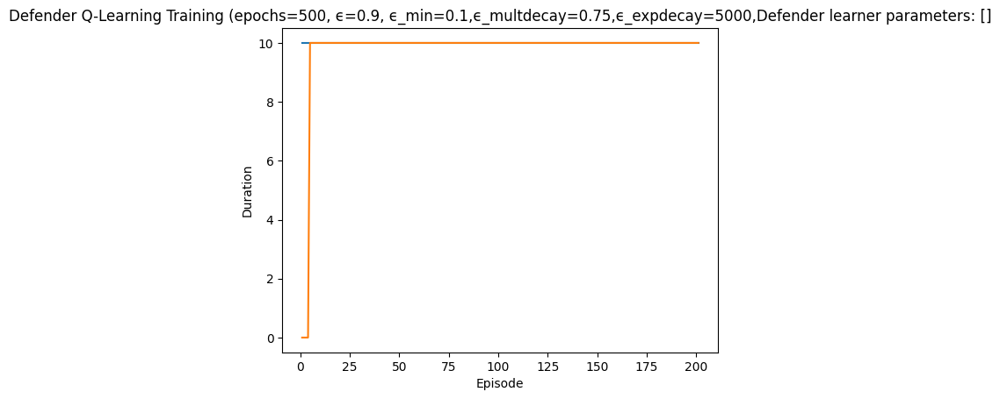

Rendering the current state of the environment
  ## Episode: 202/500 'Defender Q-Learning Training' ϵ=0.4765, Defender learner parameters: []


Episode 202|Iteration 10|reward:  130.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2011, 'successful_actions': 813, 'failed_actions': 1198}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=12, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2012, 'successful_actions': 813, 'failed_actions': 1199}, 'network_availability': 1.0}
action type:  R

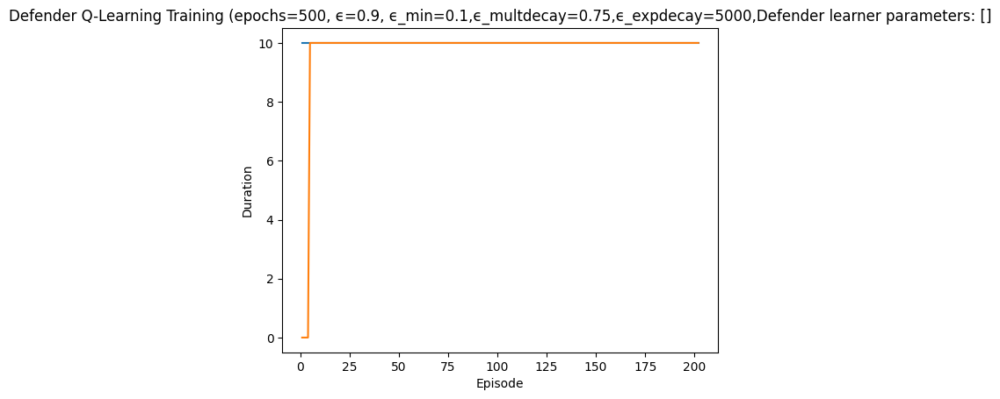

Rendering the current state of the environment
  ## Episode: 203/500 'Defender Q-Learning Training' ϵ=0.4757, Defender learner parameters: []


Episode 203|Iteration 10|reward:   55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 2021, 'successful_actions': 820, 'failed_actions': 1201}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=10, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 2022, 'successful_actions': 821, 'failed_actions': 1201}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action T

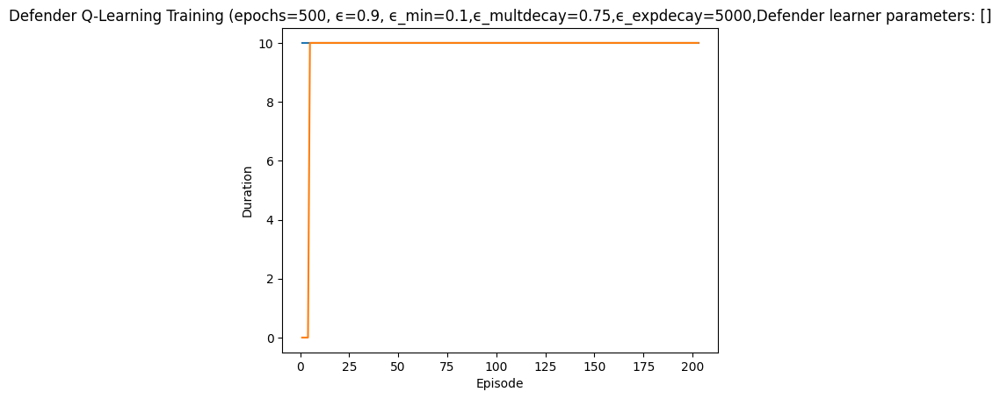

Rendering the current state of the environment
  ## Episode: 204/500 'Defender Q-Learning Training' ϵ=0.4749, Defender learner parameters: []


Episode 204|Iteration 4|reward:   35.0|last_reward_at:    1|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=7, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 2031, 'successful_actions': 825, 'failed_actions': 1206}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2032, 'successful_actions': 825, 'failed_actions': 1207}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iterat

Episode 204|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 5: Action Taken: Type=Reimage Node, NodeID=13, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2035, 'successful_actions': 826, 'failed_actions': 1209}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 6: Action Taken: Type=Start Service, NodeID=13, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2036, 'successful_actions': 826, 'failed_actions': 1210}, 'network_availabili

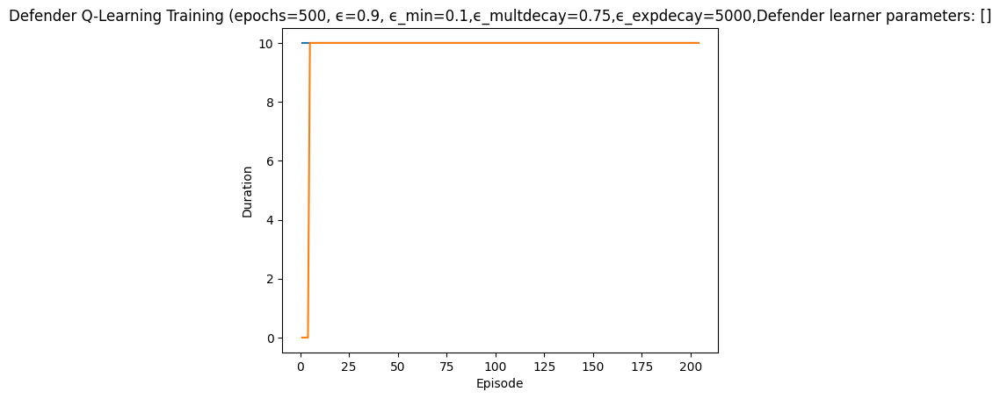

Rendering the current state of the environment
  ## Episode: 205/500 'Defender Q-Learning Training' ϵ=0.4741, Defender learner parameters: []


Episode 205|Iteration 10|reward:  -70.0|last_reward_at:    2|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2041, 'successful_actions': 828, 'failed_actions': 1213}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 2042, 'successful_actions': 829, 'failed_actions': 1213}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=10, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 7, 'reason': 'Service not f

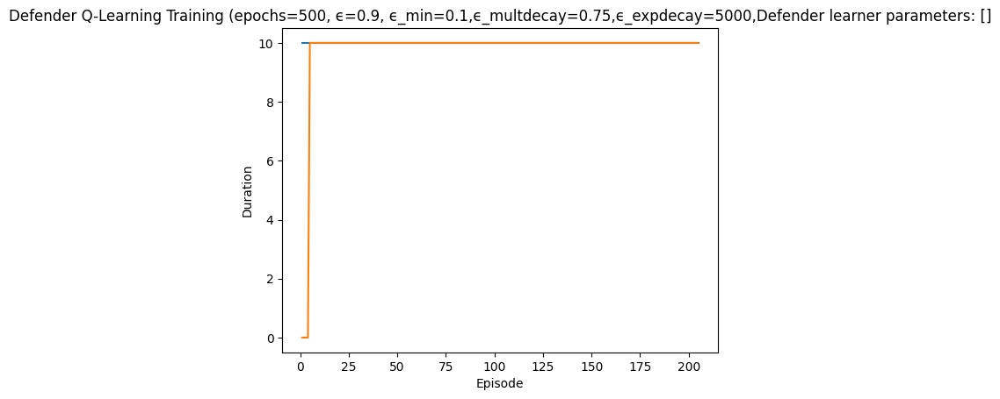

Rendering the current state of the environment
  ## Episode: 206/500 'Defender Q-Learning Training' ϵ=0.4733, Defender learner parameters: []


Episode 206|Iteration 10|reward:    0.0|last_reward_at:    4|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2051, 'successful_actions': 830, 'failed_actions': 1221}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2052, 'successful_actions': 830, 'failed_actions': 1222}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=12, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name':

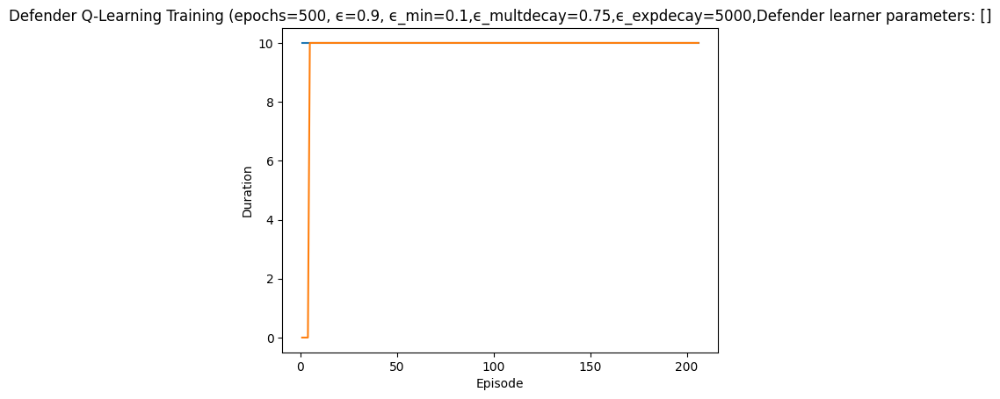

Rendering the current state of the environment
  ## Episode: 207/500 'Defender Q-Learning Training' ϵ=0.4725, Defender learner parameters: []


Episode 207|Iteration 10|reward:   90.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 2061, 'successful_actions': 833, 'failed_actions': 1228}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2062, 'successful_actions': 833, 'failed_actions': 1229}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=8, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_

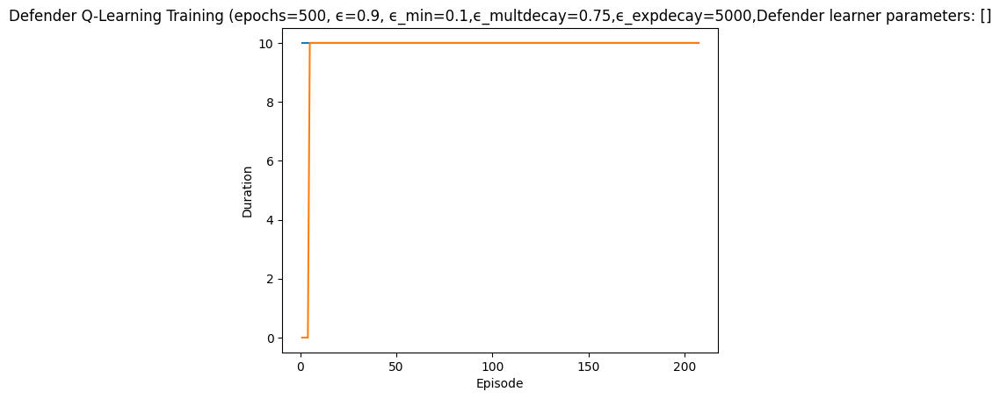

Rendering the current state of the environment
  ## Episode: 208/500 'Defender Q-Learning Training' ϵ=0.4717, Defender learner parameters: []


Episode 208|Iteration 10|reward:    0.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=13, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2071, 'successful_actions': 838, 'failed_actions': 1233}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2072, 'successful_actions': 838, 'failed_actions': 1234}, 'network_availability': 1.

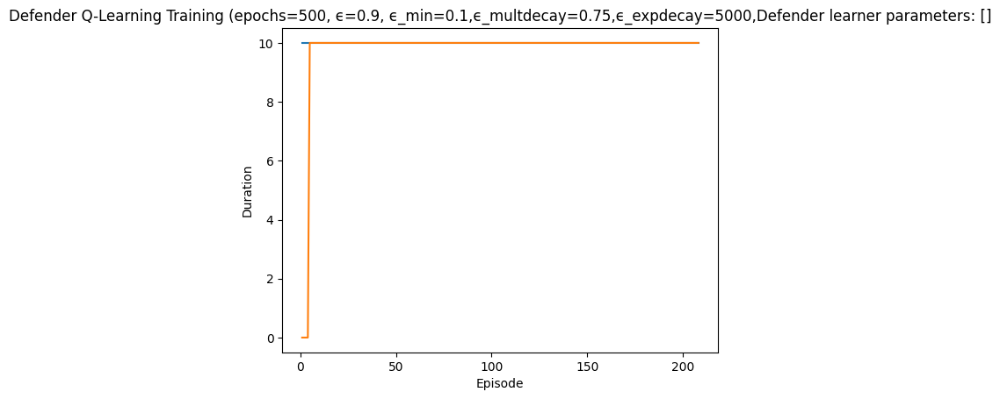

Rendering the current state of the environment
  ## Episode: 209/500 'Defender Q-Learning Training' ϵ=0.4709, Defender learner parameters: []


Episode 209|Iteration 10|reward:  -10.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2081, 'successful_actions': 841, 'failed_actions': 1240}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2082, 'successful_actions': 841, 'failed_actions': 1241}, 'network_avai

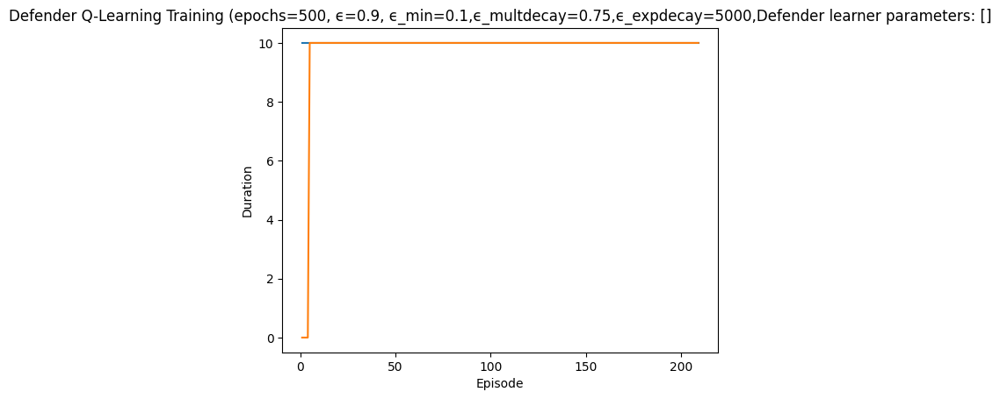

Rendering the current state of the environment
  ## Episode: 210/500 'Defender Q-Learning Training' ϵ=0.4701, Defender learner parameters: []


Episode 210|Iteration 10|reward:  -15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2091, 'successful_actions': 844, 'failed_actions': 1247}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2092, 'successful_actions': 844, 'failed_actions': 1248}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action T

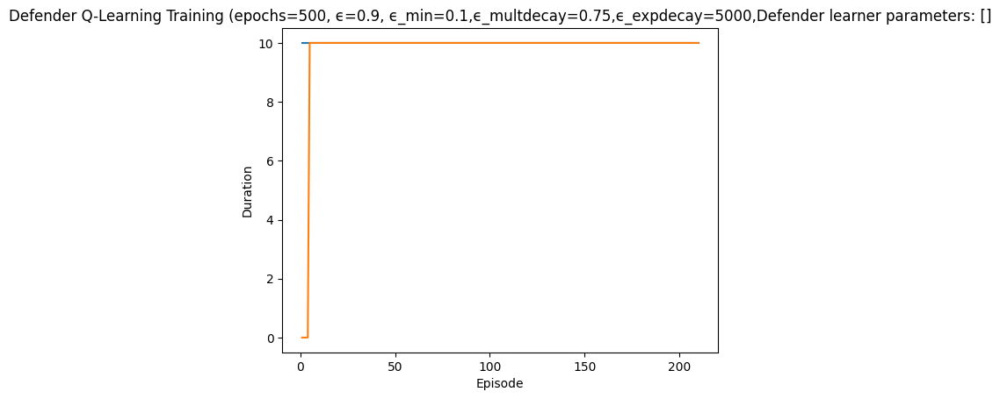

Rendering the current state of the environment
  ## Episode: 211/500 'Defender Q-Learning Training' ϵ=0.4693, Defender learner parameters: []


Episode 211|Iteration 10|reward:   95.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2101, 'successful_actions': 847, 'failed_actions': 1254}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=4, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2102, 'successful_actions': 847, 'failed_actions': 1255}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=5, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_

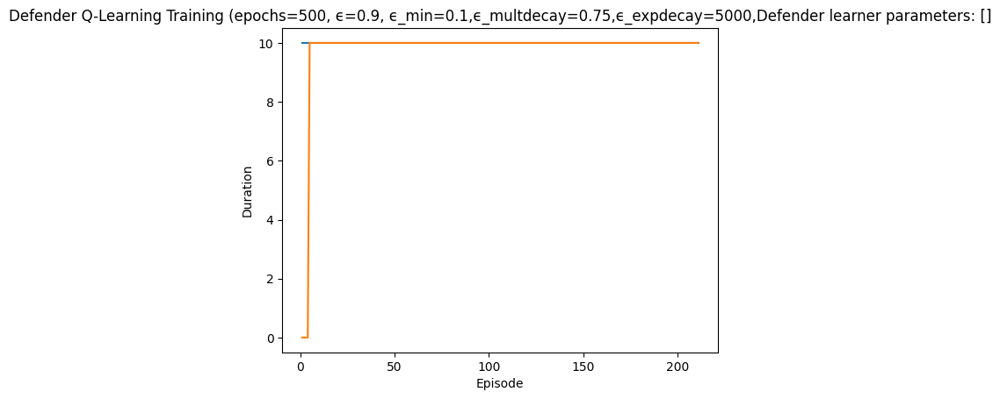

Rendering the current state of the environment
  ## Episode: 212/500 'Defender Q-Learning Training' ϵ=0.4685, Defender learner parameters: []


Episode 212|Iteration 10|reward:  -80.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2111, 'successful_actions': 851, 'failed_actions': 1260}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=0, Parameter=1
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 2112, 'successful_actions': 851, 'failed_actions': 1261}, 'network_availability': 1.0}
failed
{'action': 'sta

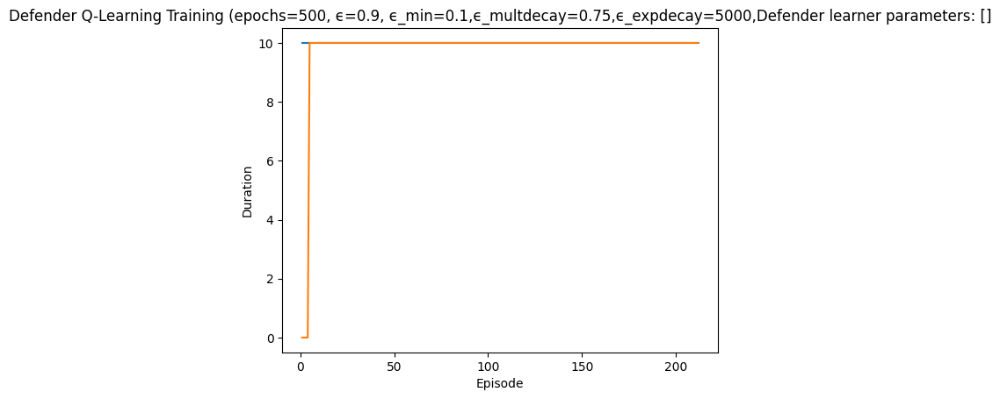

Rendering the current state of the environment
  ## Episode: 213/500 'Defender Q-Learning Training' ϵ=0.4677, Defender learner parameters: []


Episode 213|Iteration 10|reward:  105.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2121, 'successful_actions': 853, 'failed_actions': 1268}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=3, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2122, 'successful_actions': 854, 'failed_actions': 1268}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not 

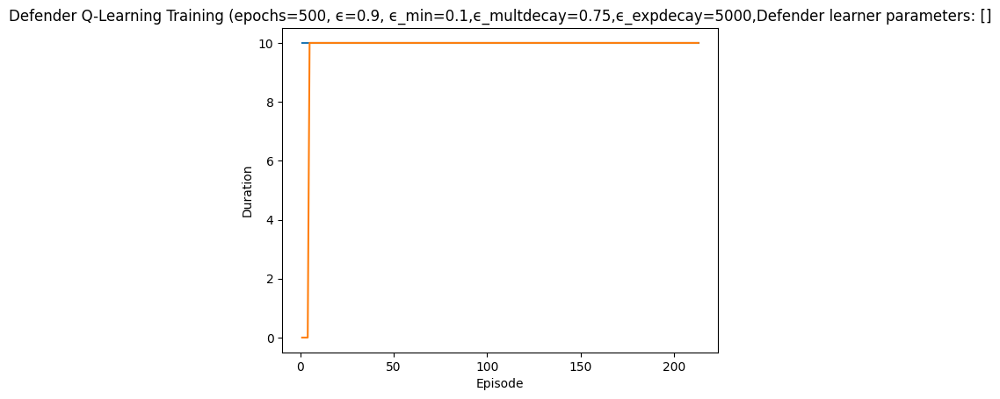

Rendering the current state of the environment
  ## Episode: 214/500 'Defender Q-Learning Training' ϵ=0.4669, Defender learner parameters: []


Episode 214|Iteration 10|reward:   30.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=7, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2131, 'successful_actions': 859, 'failed_actions': 1272}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2132, 'successful_actions': 860, 'failed_actions': 1272}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=5, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service n

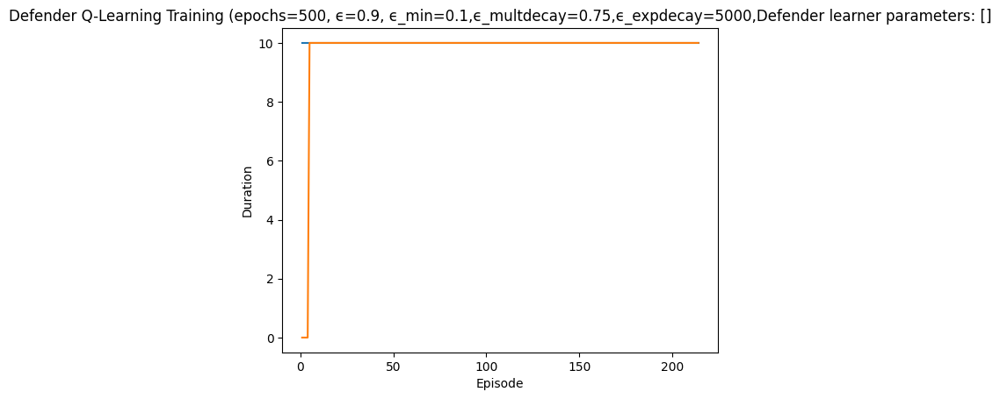

Rendering the current state of the environment
  ## Episode: 215/500 'Defender Q-Learning Training' ϵ=0.4662, Defender learner parameters: []


Episode 215|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2141, 'successful_actions': 861, 'failed_actions': 1280}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2142, 'successful_actions': 861, 'failed_actions': 1281}, 'network_availability': 1.0}


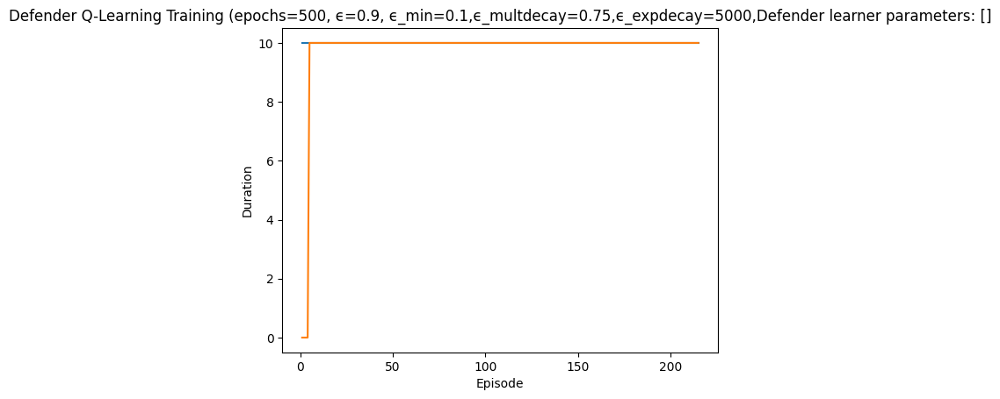

Rendering the current state of the environment
  ## Episode: 216/500 'Defender Q-Learning Training' ϵ=0.4654, Defender learner parameters: []


Episode 216|Iteration 10|reward:  -30.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=1, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2151, 'successful_actions': 867, 'failed_actions': 1284}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2152, 'successful_actions': 867, 'failed_actions': 1285}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3:

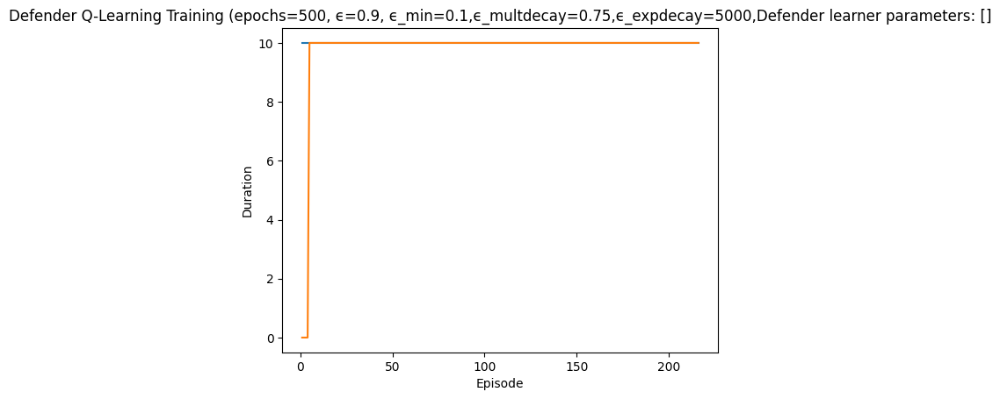

Rendering the current state of the environment
  ## Episode: 217/500 'Defender Q-Learning Training' ϵ=0.4646, Defender learner parameters: []


Episode 217|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2161, 'successful_actions': 869, 'failed_actions': 1292}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2162, 'successful_actions': 869, 'failed_actions': 1293}, 'network_avail

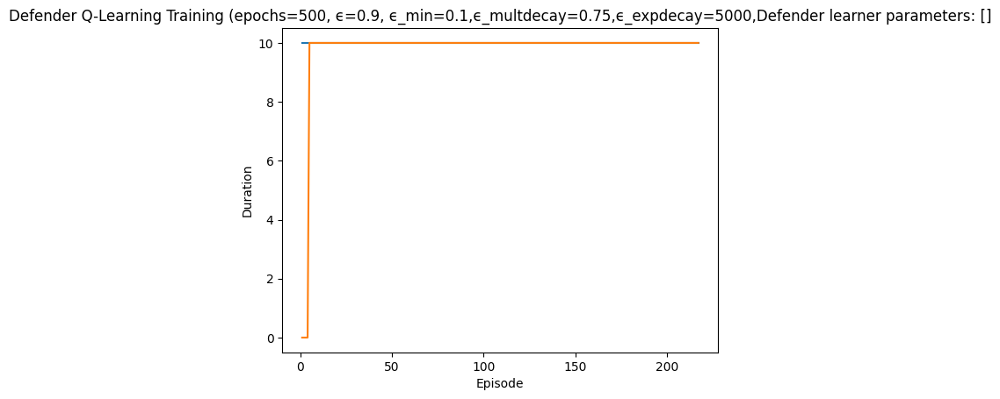

Rendering the current state of the environment
  ## Episode: 218/500 'Defender Q-Learning Training' ϵ=0.4638, Defender learner parameters: []


Episode 218|Iteration 10|reward:   70.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2171, 'successful_actions': 873, 'failed_actions': 1298}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=8, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2172, 'successful_actions': 873, 'failed_actions': 1299}, 'network_availability': 1.0}
fa

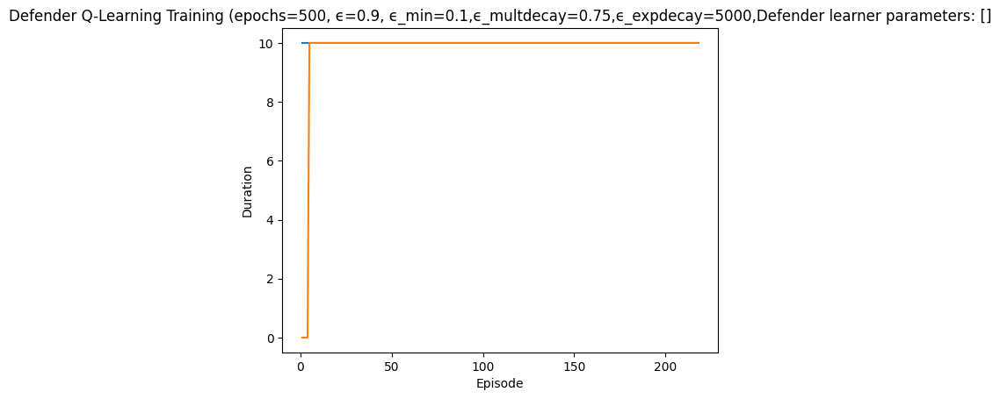

Rendering the current state of the environment
  ## Episode: 219/500 'Defender Q-Learning Training' ϵ=0.4630, Defender learner parameters: []


Episode 219|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=3, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2181, 'successful_actions': 877, 'failed_actions': 1304}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=6, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2182, 'successful_actions': 878, 'failed_actions': 1304}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: A

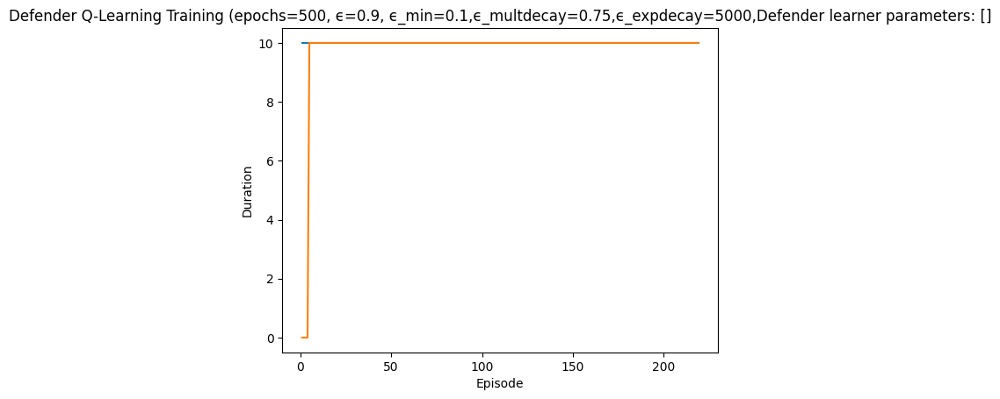

Rendering the current state of the environment
  ## Episode: 220/500 'Defender Q-Learning Training' ϵ=0.4623, Defender learner parameters: []


Episode 220|Iteration 10|reward:  120.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=12, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2191, 'successful_actions': 882, 'failed_actions': 1309}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 2192, 'successful_actions': 883, 'failed_actions': 1309}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=3, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 2193, 'successful_actions': 884, 'failed_actions': 1309}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration

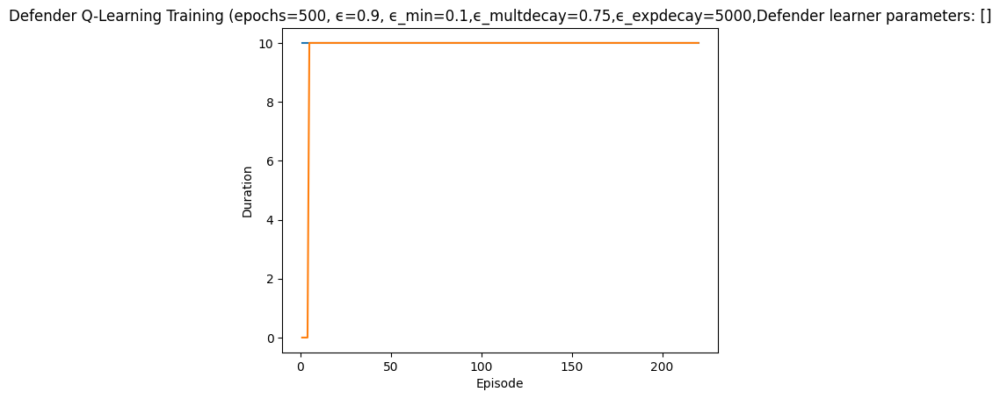

Rendering the current state of the environment
  ## Episode: 221/500 'Defender Q-Learning Training' ϵ=0.4615, Defender learner parameters: []


Episode 221|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2201, 'successful_actions': 888, 'failed_actions': 1313}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2202, 'successful_actions': 888, 'failed_actions': 1314}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=9, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode'

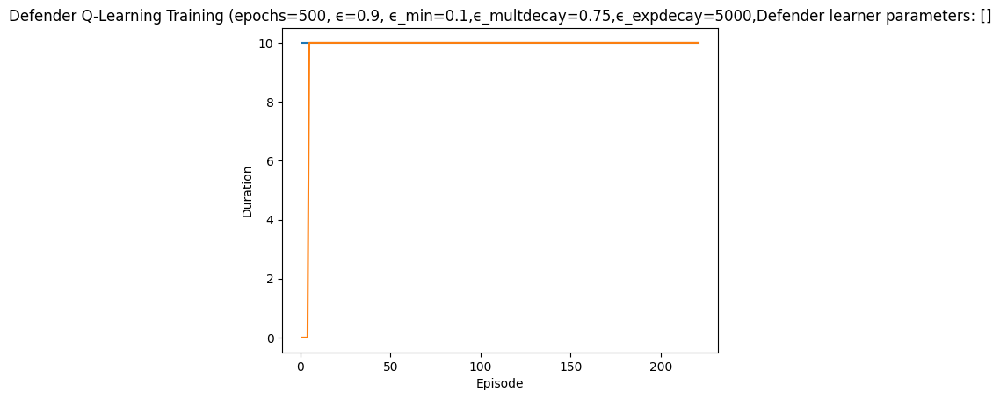

Rendering the current state of the environment
  ## Episode: 222/500 'Defender Q-Learning Training' ϵ=0.4607, Defender learner parameters: []


Episode 222|Iteration 10|reward:   25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 2211, 'successful_actions': 894, 'failed_actions': 1317}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=2, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2212, 'successful_actions': 895, 'failed_actions': 1317}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=4, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 2, 'reason': 'Service not f

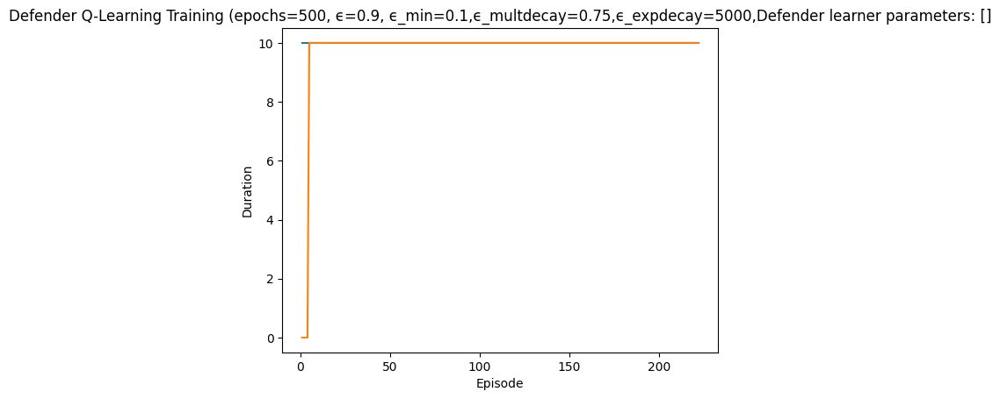

Rendering the current state of the environment
  ## Episode: 223/500 'Defender Q-Learning Training' ϵ=0.4600, Defender learner parameters: []


Episode 223|Iteration 10|reward:  110.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2221, 'successful_actions': 898, 'failed_actions': 1323}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2222, 'successful_actions': 898, 'failed_actions': 1324}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Ac

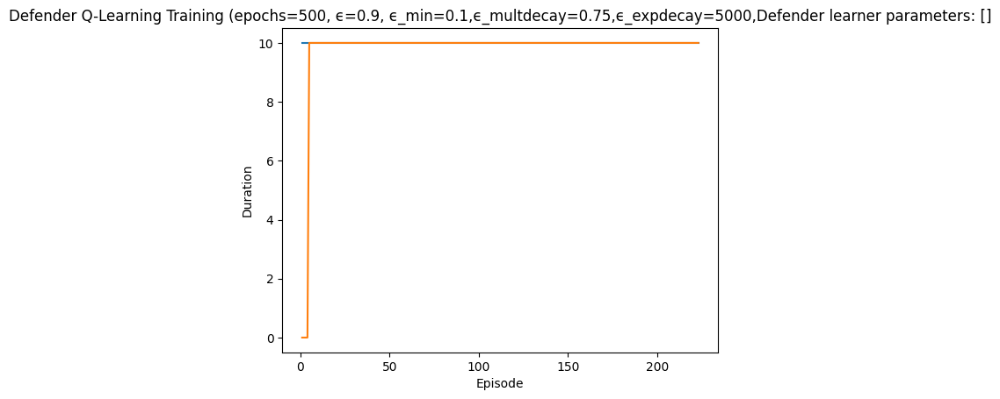

Rendering the current state of the environment
  ## Episode: 224/500 'Defender Q-Learning Training' ϵ=0.4592, Defender learner parameters: []


Episode 224|Iteration 10|reward:  145.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=12, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 2231, 'successful_actions': 903, 'failed_actions': 1328}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 2232, 'successful_actions': 904, 'failed_actions': 1328}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=1, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - 

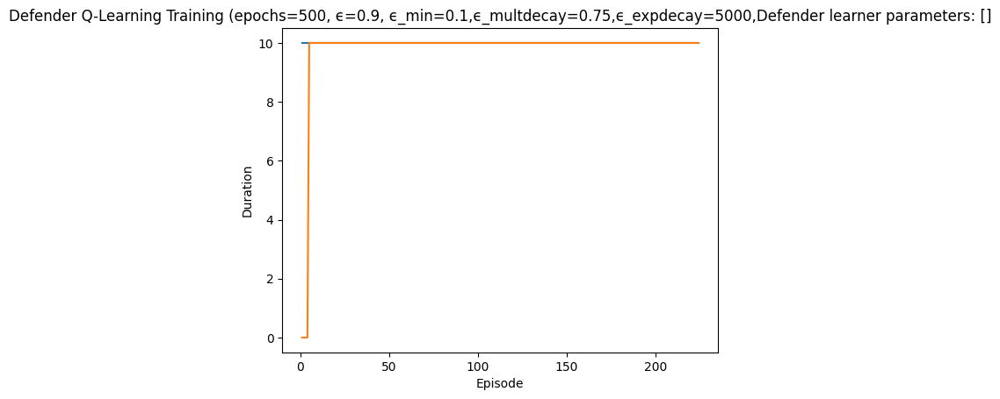

Rendering the current state of the environment
  ## Episode: 225/500 'Defender Q-Learning Training' ϵ=0.4584, Defender learner parameters: []


Episode 225|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=3
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 2241, 'successful_actions': 909, 'failed_actions': 1332}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=13, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2242, 'successful_actions': 909, 'failed_actions': 1333}, 'network_availability': 1.0}
failed
{'action': '

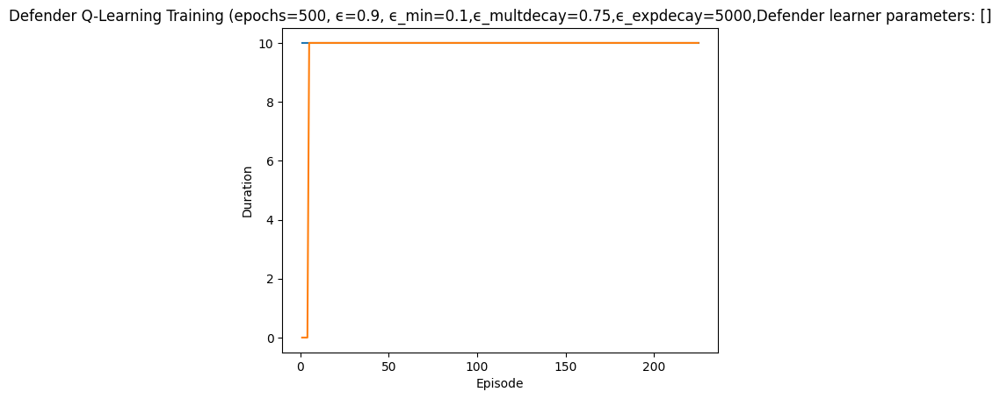

Rendering the current state of the environment
  ## Episode: 226/500 'Defender Q-Learning Training' ϵ=0.4577, Defender learner parameters: []


Episode 226|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2251, 'successful_actions': 912, 'failed_actions': 1339}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=8, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2252, 'successful_actions': 912, 'failed_actions': 1340}, 'network_availability': 1.0}
failed
{'ac

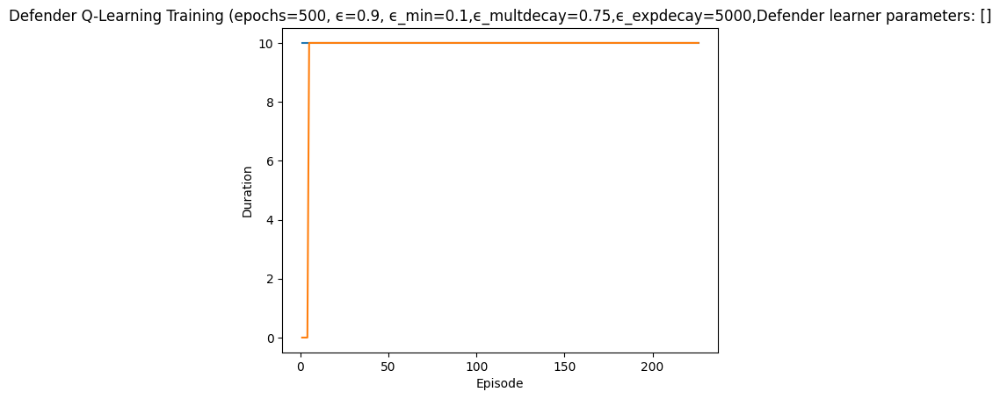

Rendering the current state of the environment
  ## Episode: 227/500 'Defender Q-Learning Training' ϵ=0.4569, Defender learner parameters: []


Episode 227|Iteration 10|reward:   45.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2261, 'successful_actions': 915, 'failed_actions': 1346}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2262, 'successful_actions': 916, 'failed_actions': 1346}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Nod

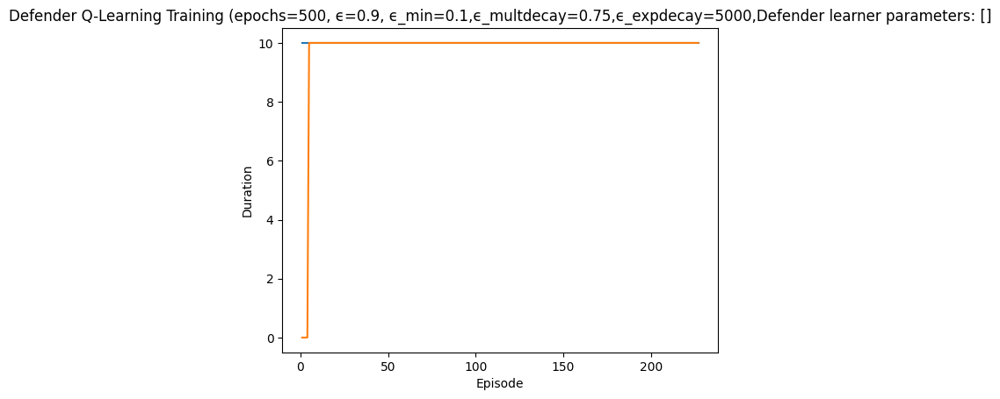

Rendering the current state of the environment
  ## Episode: 228/500 'Defender Q-Learning Training' ϵ=0.4561, Defender learner parameters: []


Episode 228|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2271, 'successful_actions': 918, 'failed_actions': 1353}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=10, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2272, 'successful_actions': 918, 'failed_actions': 1354}, 'network_availability': 1.0}
failed
{'acti

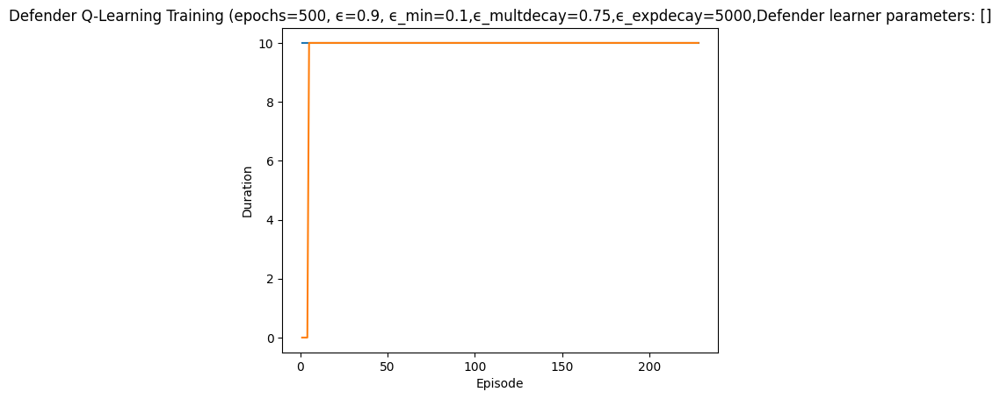

Rendering the current state of the environment
  ## Episode: 229/500 'Defender Q-Learning Training' ϵ=0.4554, Defender learner parameters: []


Episode 229|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2281, 'successful_actions': 922, 'failed_actions': 1359}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2282, 'successful_actions': 923, 'failed_actions': 1359}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not fo

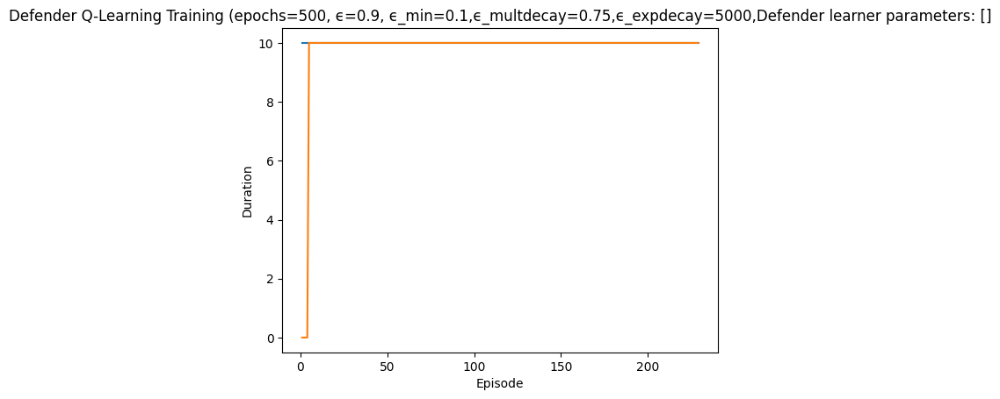

Rendering the current state of the environment
  ## Episode: 230/500 'Defender Q-Learning Training' ϵ=0.4546, Defender learner parameters: []


Episode 230|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2291, 'successful_actions': 927, 'failed_actions': 1364}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2292, 'successful_actions': 928, 'failed_actions': 1364}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=11, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service

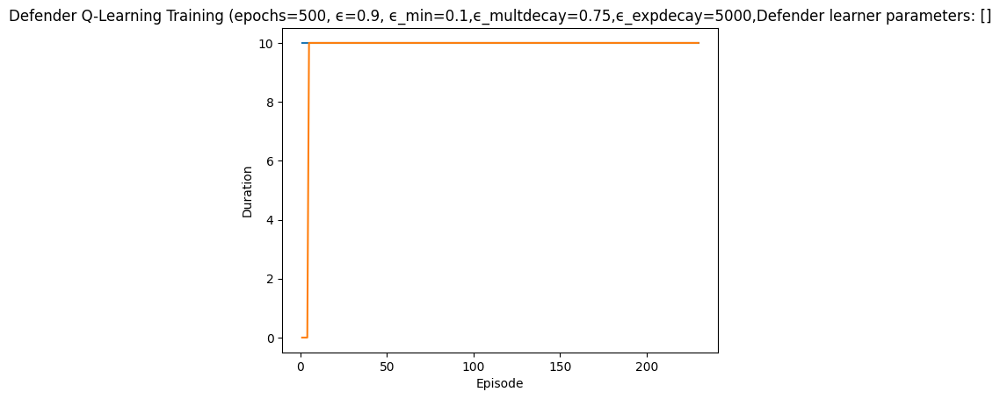

Rendering the current state of the environment
  ## Episode: 231/500 'Defender Q-Learning Training' ϵ=0.4538, Defender learner parameters: []


Episode 231|Iteration 10|reward:   90.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 4, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=4
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 4, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 2301, 'successful_actions': 930, 'failed_actions': 1371}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2302, 'successful_actions': 931, 'failed_actions': 1371}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=5, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'pe

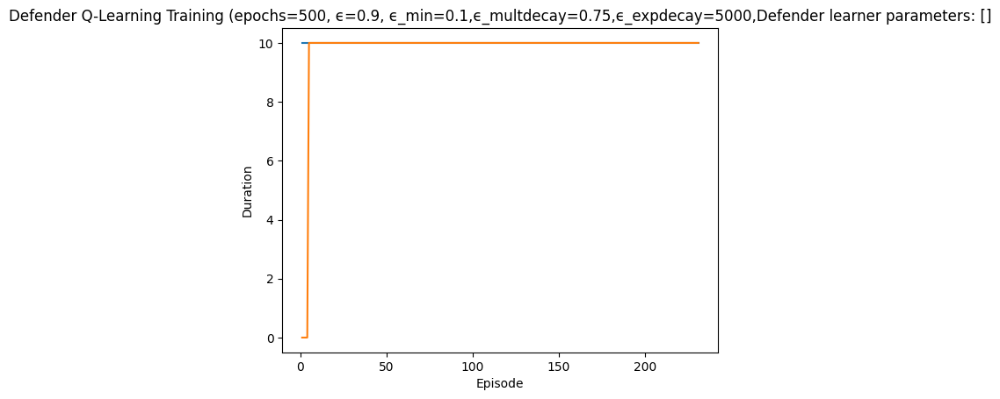

Rendering the current state of the environment
  ## Episode: 232/500 'Defender Q-Learning Training' ϵ=0.4531, Defender learner parameters: []


Episode 232|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=9, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2311, 'successful_actions': 936, 'failed_actions': 1375}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2312, 'successful_actions': 937, 'failed_actions': 1375}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Act

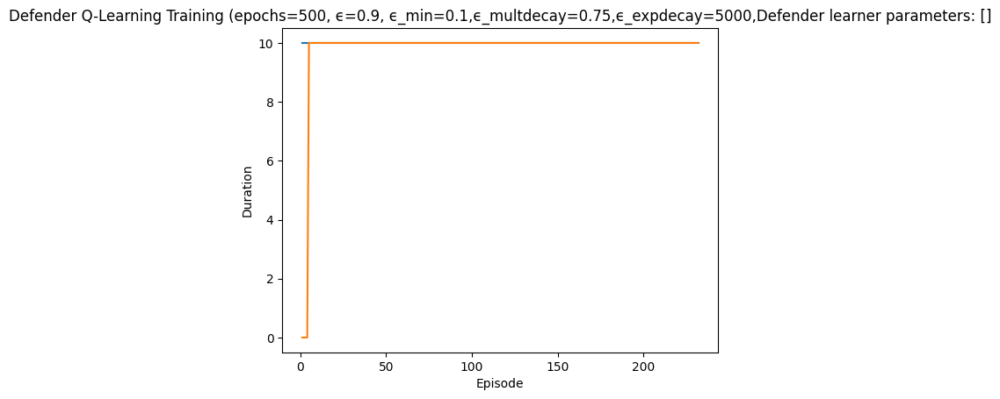

Rendering the current state of the environment
  ## Episode: 233/500 'Defender Q-Learning Training' ϵ=0.4523, Defender learner parameters: []


Episode 233|Iteration 10|reward:  -15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=13, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 2321, 'successful_actions': 941, 'failed_actions': 1380}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=3, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2322, 'successful_actions': 942, 'failed_actions': 1380}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=13, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'S

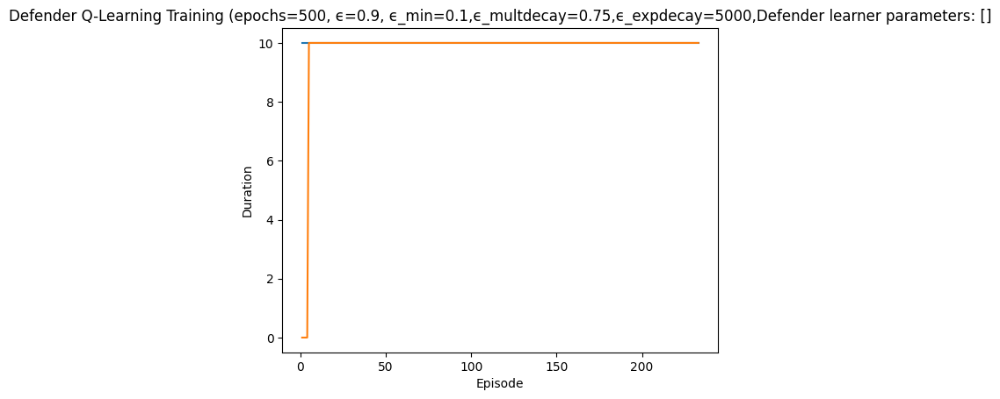

Rendering the current state of the environment
  ## Episode: 234/500 'Defender Q-Learning Training' ϵ=0.4516, Defender learner parameters: []


Episode 234|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2331, 'successful_actions': 943, 'failed_actions': 1388}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2332, 'successful_actions': 943, 'failed_actions': 1389}, 'network_availability': 1.0

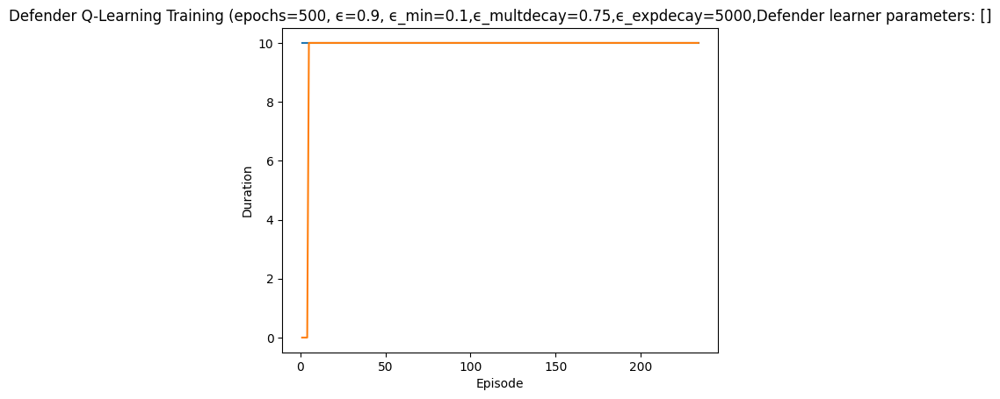

Rendering the current state of the environment
  ## Episode: 235/500 'Defender Q-Learning Training' ϵ=0.4508, Defender learner parameters: []


Episode 235|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2341, 'successful_actions': 947, 'failed_actions': 1394}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=7, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 2342, 'successful_actions': 948, 'failed_actions': 1394}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: 

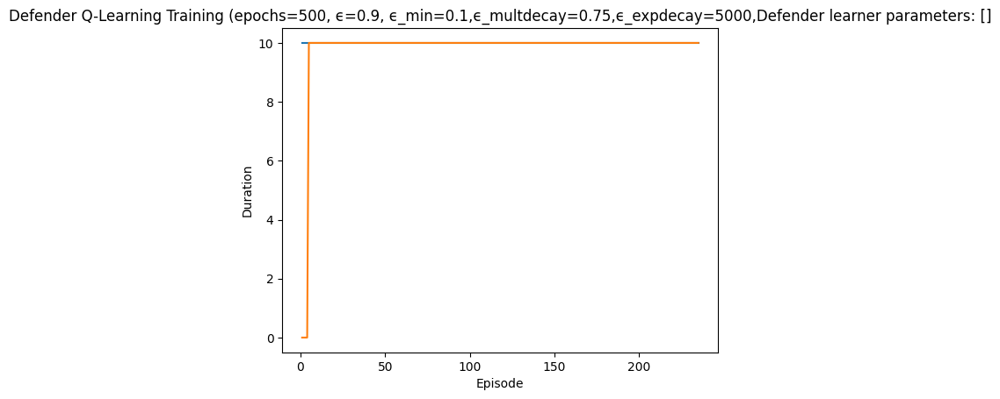

Rendering the current state of the environment
  ## Episode: 236/500 'Defender Q-Learning Training' ϵ=0.4501, Defender learner parameters: []


Episode 236|Iteration 10|reward:   80.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 7, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=0, Parameter=7
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 7, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 2351, 'successful_actions': 952, 'failed_actions': 1399}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=6, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2352, 'successful_actions': 953, 'failed_actions': 1399}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=9, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 7, 

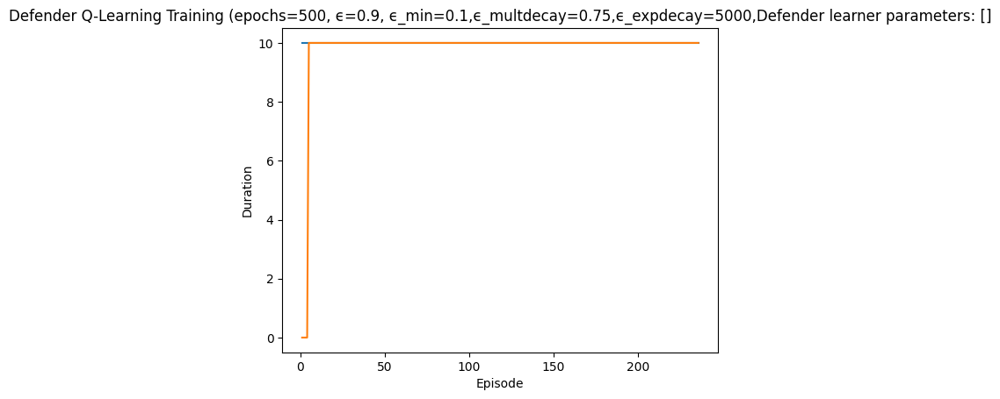

Rendering the current state of the environment
  ## Episode: 237/500 'Defender Q-Learning Training' ϵ=0.4493, Defender learner parameters: []


Episode 237|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=6, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2361, 'successful_actions': 958, 'failed_actions': 1403}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2362, 'successful_actions': 959, 'failed_actions': 1403}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=3, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - n

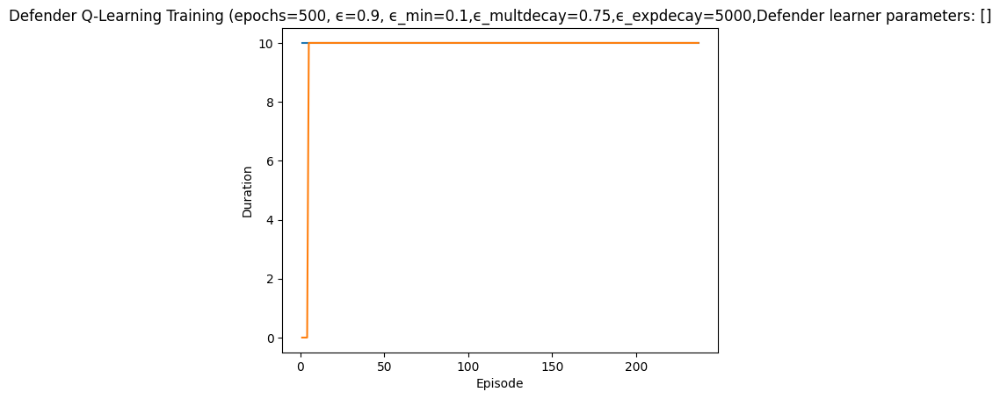

Rendering the current state of the environment
  ## Episode: 238/500 'Defender Q-Learning Training' ϵ=0.4486, Defender learner parameters: []


Episode 238|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2371, 'successful_actions': 964, 'failed_actions': 1407}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2372, 'successful_actions': 964, 'failed_actions': 1408}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Actio

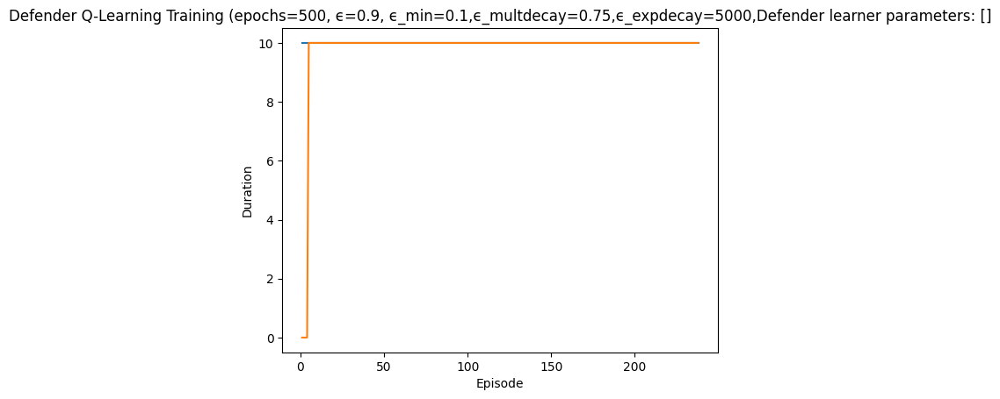

Rendering the current state of the environment
  ## Episode: 239/500 'Defender Q-Learning Training' ϵ=0.4478, Defender learner parameters: []


Episode 239|Iteration 10|reward:  -80.0|last_reward_at:    4|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2381, 'successful_actions': 968, 'failed_actions': 1413}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=7, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2382, 'successful_actions': 968, 'failed_actions': 1414}, 'network_availability': 1.0

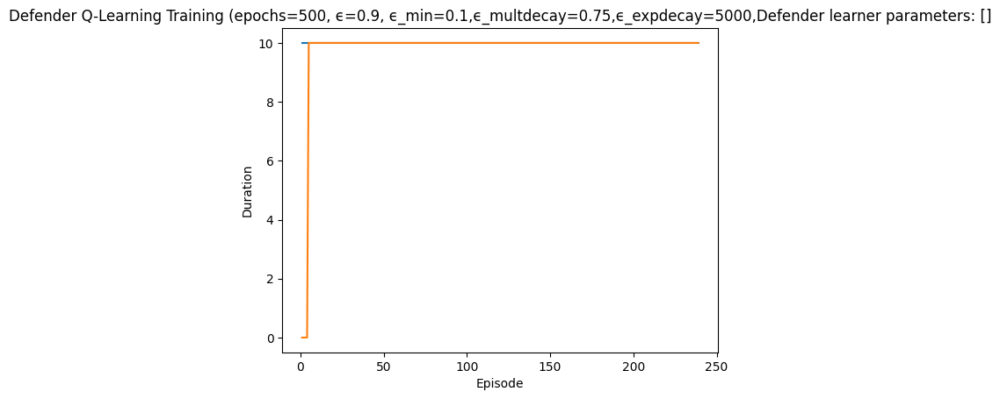

Rendering the current state of the environment
  ## Episode: 240/500 'Defender Q-Learning Training' ϵ=0.4471, Defender learner parameters: []


Episode 240|Iteration 10|reward:  -15.0|last_reward_at:    4|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2391, 'successful_actions': 969, 'failed_actions': 1422}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 2392, 'successful_actions': 970, 'failed_actions': 1422}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=4, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name':

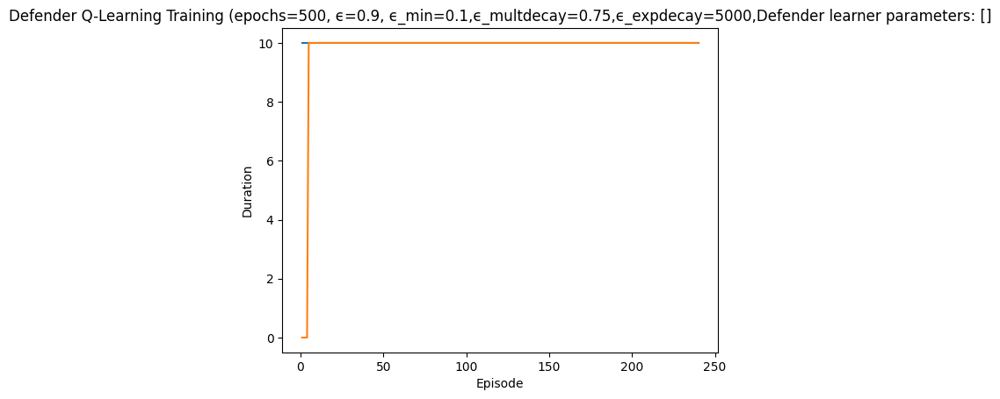

Rendering the current state of the environment
  ## Episode: 241/500 'Defender Q-Learning Training' ϵ=0.4463, Defender learner parameters: []


Episode 241|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2401, 'successful_actions': 973, 'failed_actions': 1428}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2402, 'successful_actions': 973, 'failed_actions': 1429}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 3: Ac

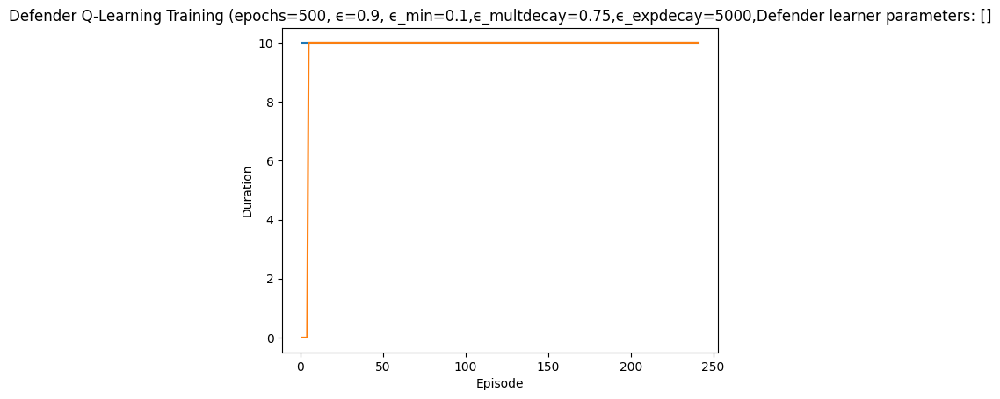

Rendering the current state of the environment
  ## Episode: 242/500 'Defender Q-Learning Training' ϵ=0.4456, Defender learner parameters: []


Episode 242|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=3, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2411, 'successful_actions': 977, 'failed_actions': 1434}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2412, 'successful_actions': 977, 'failed_actions': 1435}, 'network_availability': 1.0}
failed
{'ac

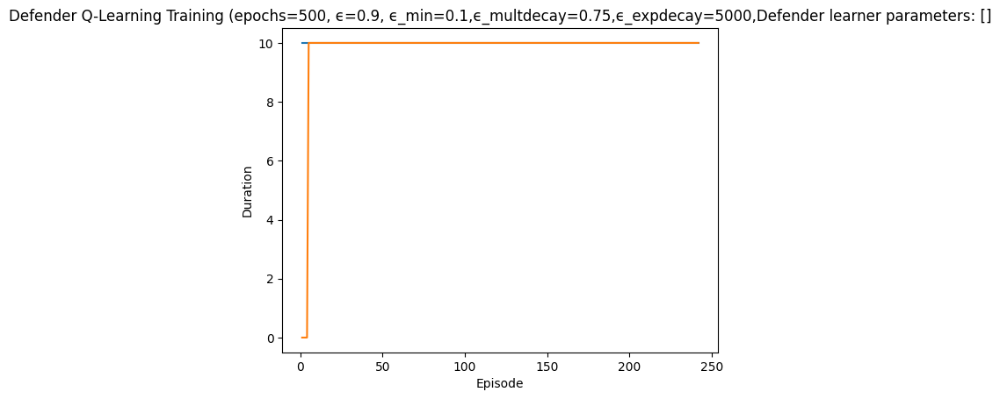

Rendering the current state of the environment
  ## Episode: 243/500 'Defender Q-Learning Training' ϵ=0.4449, Defender learner parameters: []


Episode 243|Iteration 10|reward:   95.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2421, 'successful_actions': 981, 'failed_actions': 1440}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2422, 'successful_actions': 981, 'failed_actions': 1441}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Itera

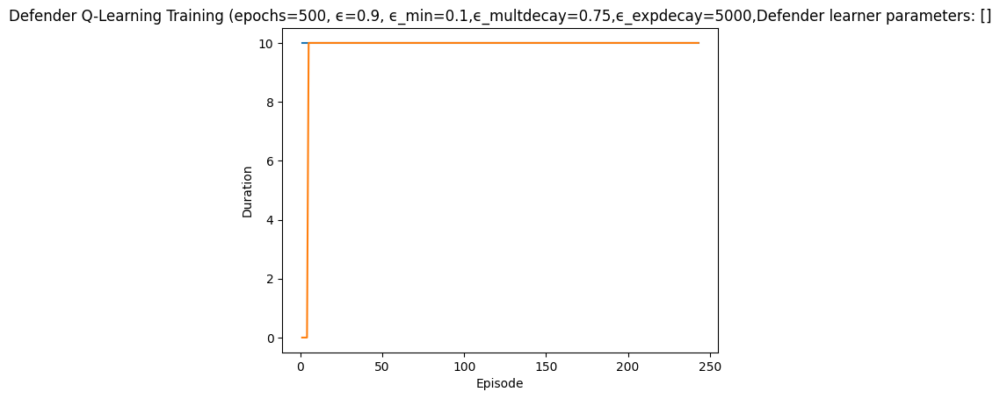

Rendering the current state of the environment
  ## Episode: 244/500 'Defender Q-Learning Training' ϵ=0.4441, Defender learner parameters: []


Episode 244|Iteration 10|reward:   90.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=6, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2431, 'successful_actions': 985, 'failed_actions': 1446}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 2432, 'successful_actions': 986, 'failed_actions': 1446}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=6, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name':

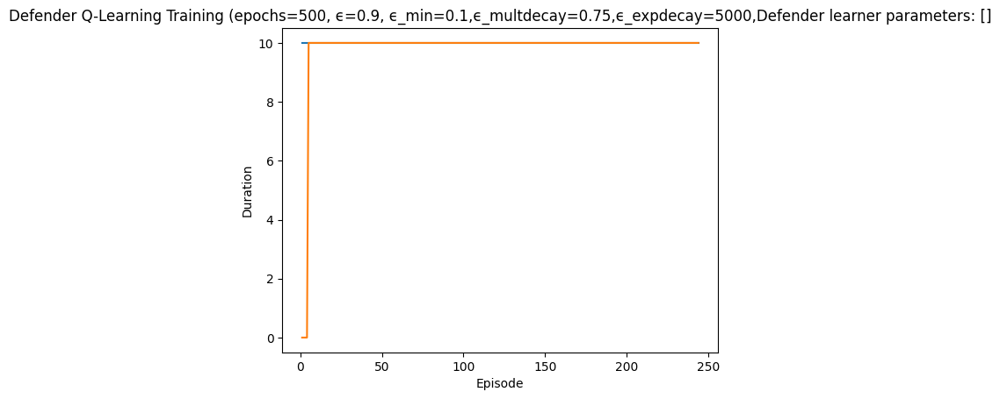

Rendering the current state of the environment
  ## Episode: 245/500 'Defender Q-Learning Training' ϵ=0.4434, Defender learner parameters: []


Episode 245|Iteration 10|reward:  105.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 2441, 'successful_actions': 992, 'failed_actions': 1449}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=2, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 2442, 'successful_actions': 993, 'failed_actions': 1449}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=2, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no 

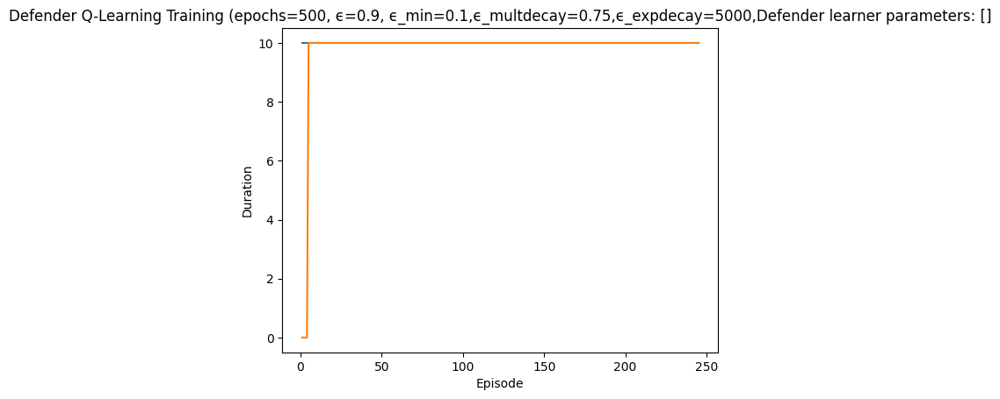

Rendering the current state of the environment
  ## Episode: 246/500 'Defender Q-Learning Training' ϵ=0.4426, Defender learner parameters: []


Episode 246|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2451, 'successful_actions': 997, 'failed_actions': 1454}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=11, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2452, 'successful_actions': 997, 'failed_actions': 1455}, 'network_availabili

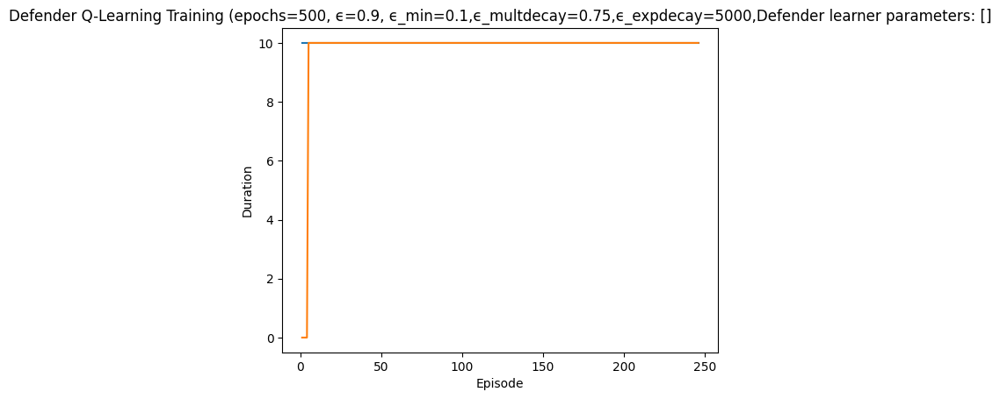

Rendering the current state of the environment
  ## Episode: 247/500 'Defender Q-Learning Training' ϵ=0.4419, Defender learner parameters: []


Episode 247|Iteration 10|reward:  -80.0|last_reward_at:    3|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2461, 'successful_actions': 1000, 'failed_actions': 1461}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2462, 'successful_actions': 1000, 'failed_actions': 1462}, 'network_availability': 1.0}
action type

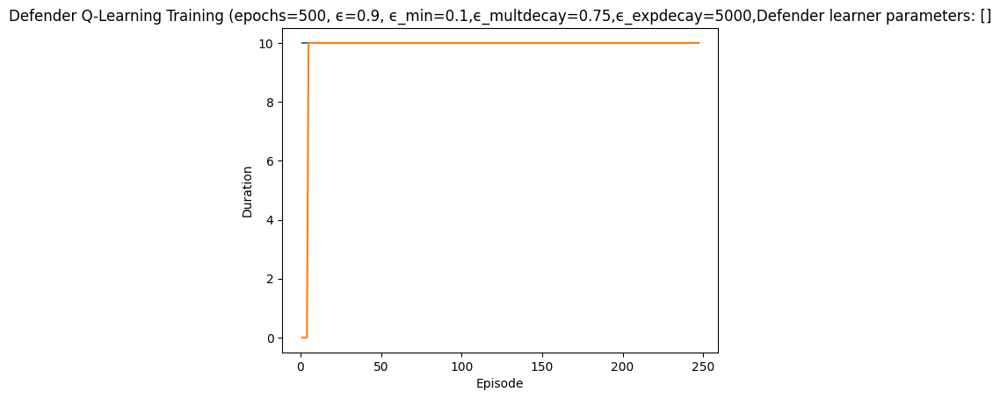

Rendering the current state of the environment
  ## Episode: 248/500 'Defender Q-Learning Training' ϵ=0.4412, Defender learner parameters: []


Episode 248|Iteration 10|reward:   80.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2471, 'successful_actions': 1002, 'failed_actions': 1469}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 2472, 'successful_actions': 1003, 'failed_actions': 1469}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=5, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2473, 'successful_actions': 1004, 'failed_actions': 1469}, 'network_availability': 1.0}
failed
{'action': 'stop_servic

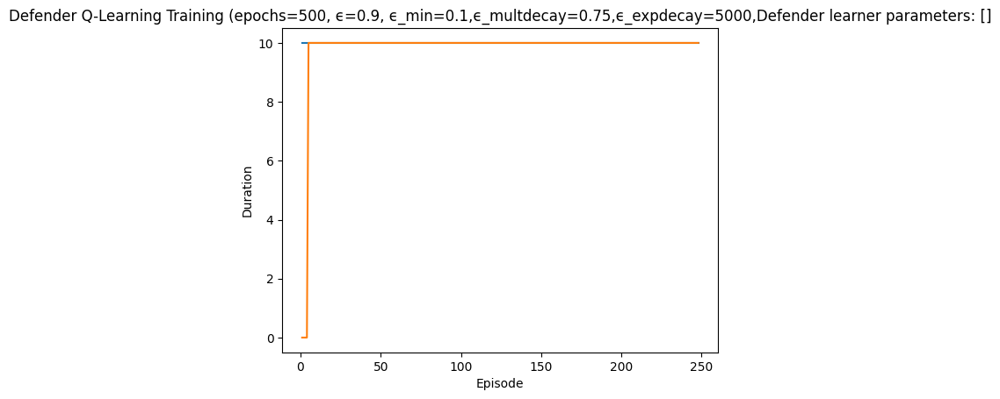

Rendering the current state of the environment
  ## Episode: 249/500 'Defender Q-Learning Training' ϵ=0.4405, Defender learner parameters: []


Episode 249|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2481, 'successful_actions': 1007, 'failed_actions': 1474}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2482, 'successful_actions': 1008, 'failed_actions': 1474}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=10, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 6, 'reason': 'Service not f

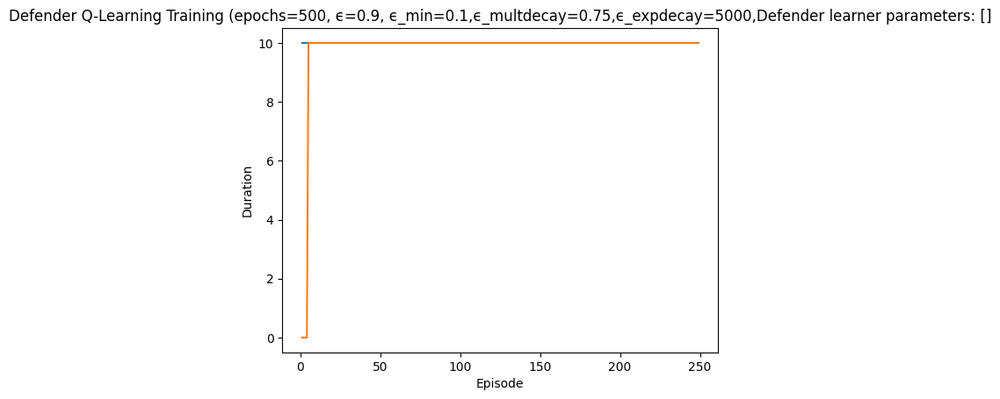

Rendering the current state of the environment
  ## Episode: 250/500 'Defender Q-Learning Training' ϵ=0.4397, Defender learner parameters: []


Episode 250|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2491, 'successful_actions': 1012, 'failed_actions': 1479}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2492, 'successful_actions': 1012, 'failed_actions': 1480}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reima

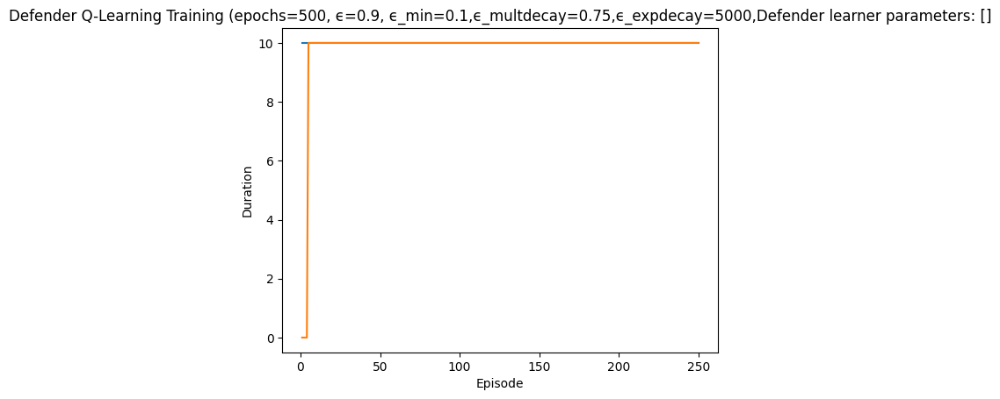

Rendering the current state of the environment
  ## Episode: 251/500 'Defender Q-Learning Training' ϵ=0.4390, Defender learner parameters: []


Episode 251|Iteration 10|reward:   70.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=1, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 2501, 'successful_actions': 1015, 'failed_actions': 1486}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2502, 'successful_actions': 1015, 'failed_actions': 1487}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteratio

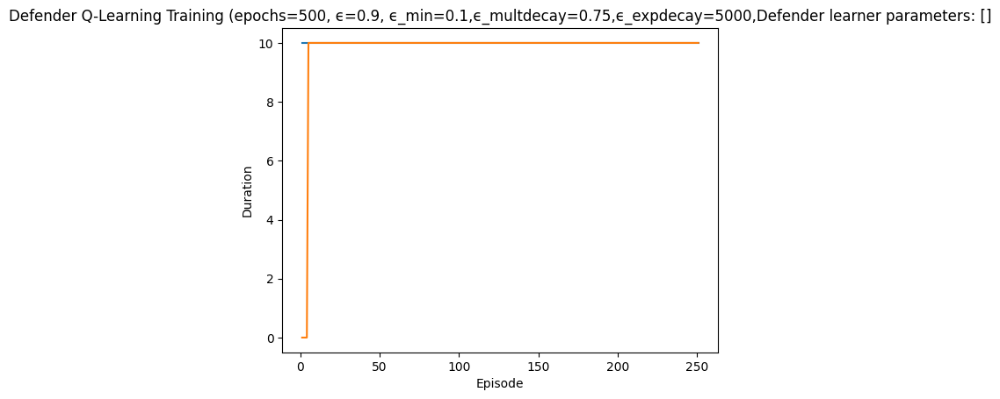

Rendering the current state of the environment
  ## Episode: 252/500 'Defender Q-Learning Training' ϵ=0.4383, Defender learner parameters: []


Episode 252|Iteration 10|reward: -135.0|last_reward_at: ----|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2511, 'successful_actions': 1018, 'failed_actions': 1493}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=11, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2512, 'successful_actions': 1018, 'failed_actions': 1494}, 'network_availabilit

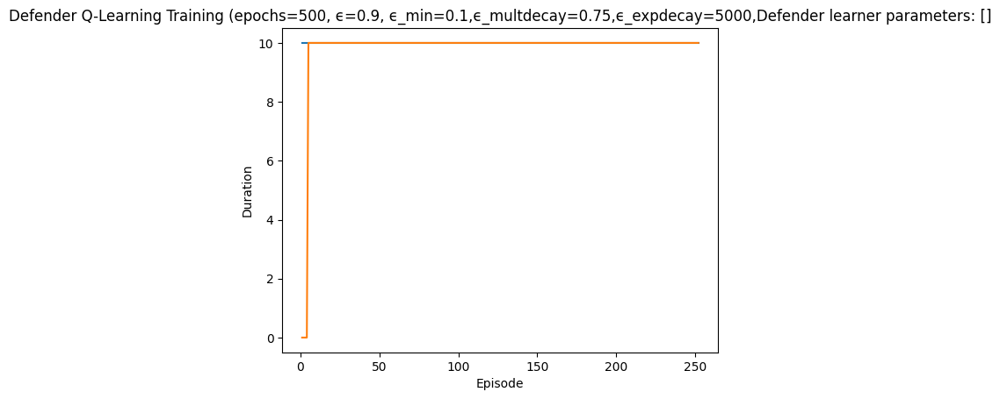

Rendering the current state of the environment
  ## Episode: 253/500 'Defender Q-Learning Training' ϵ=0.4375, Defender learner parameters: []


Episode 253|Iteration 10|reward:  -40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2521, 'successful_actions': 1018, 'failed_actions': 1503}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2522, 'successful_actions': 1018, 'failed_actions': 1504}, 'network_a

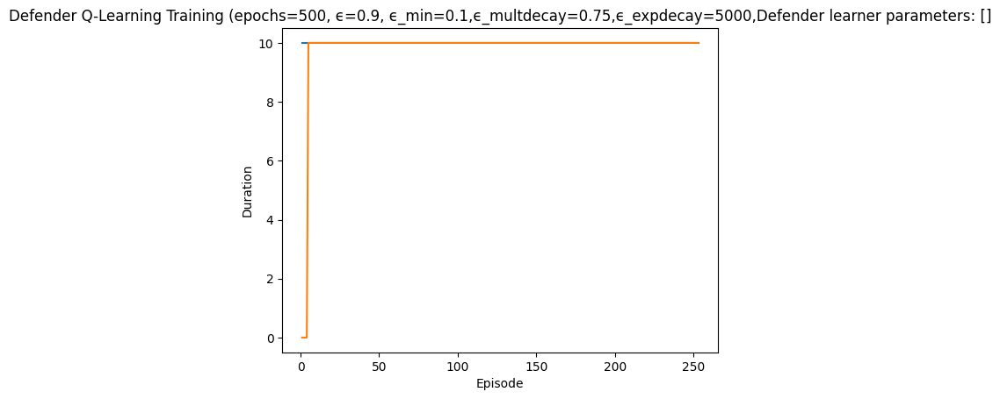

Rendering the current state of the environment
  ## Episode: 254/500 'Defender Q-Learning Training' ϵ=0.4368, Defender learner parameters: []


Episode 254|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2531, 'successful_actions': 1021, 'failed_actions': 1510}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2532, 'successful_actions': 1021, 'failed_actions': 1511}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3

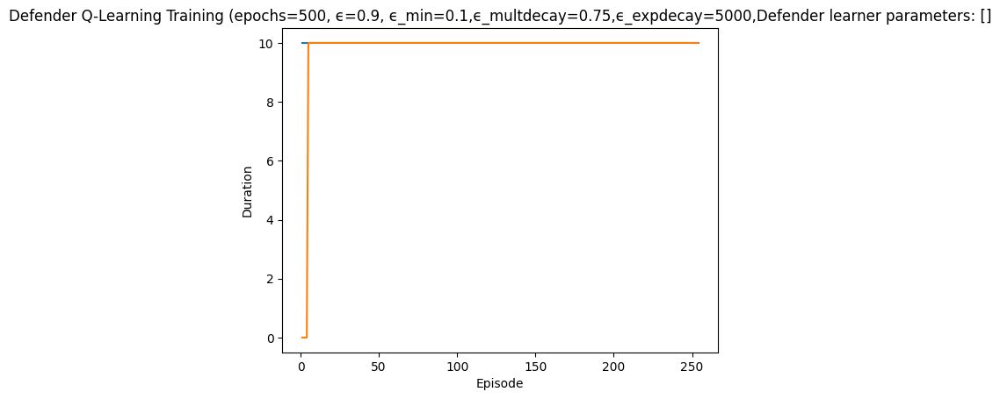

Rendering the current state of the environment
  ## Episode: 255/500 'Defender Q-Learning Training' ϵ=0.4361, Defender learner parameters: []


Episode 255|Iteration 10|reward:  -40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2541, 'successful_actions': 1023, 'failed_actions': 1518}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2542, 'successful_actions': 1023, 'failed_actions': 1519}, 'network_availability': 1.0}
failed
{'action

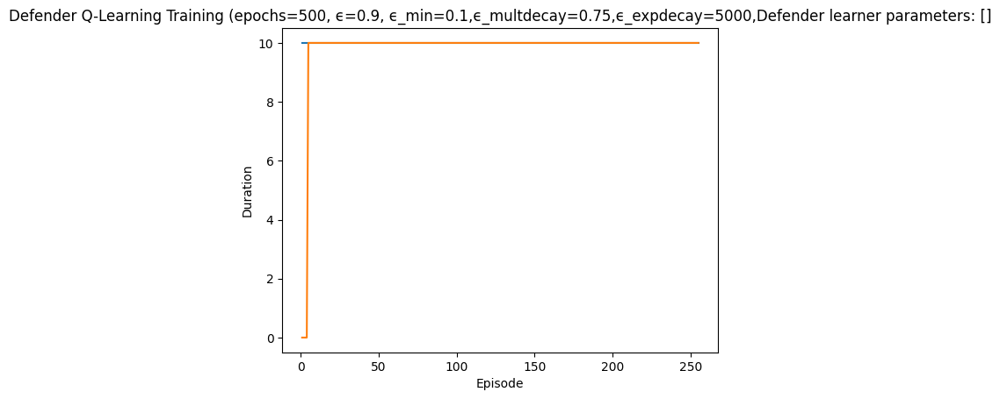

Rendering the current state of the environment
  ## Episode: 256/500 'Defender Q-Learning Training' ϵ=0.4354, Defender learner parameters: []


Episode 256|Iteration 10|reward:  -25.0|last_reward_at:    4|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2551, 'successful_actions': 1026, 'failed_actions': 1525}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2552, 'successful_actions': 1026, 'failed_actions': 1526}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration

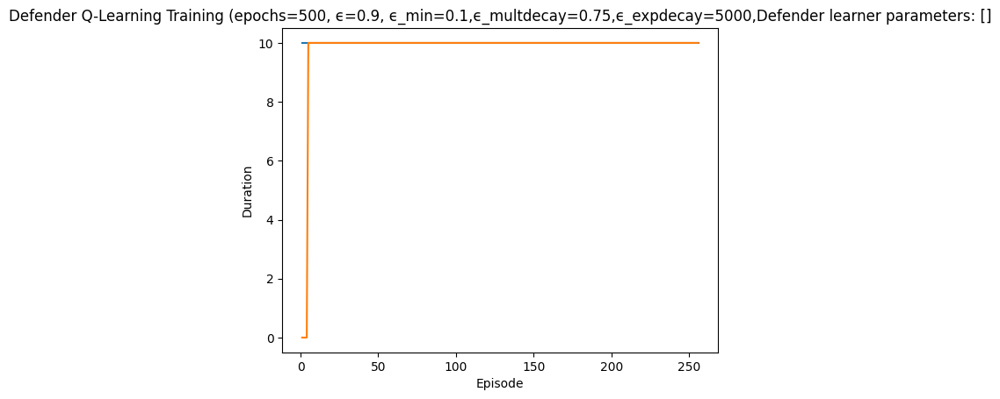

Rendering the current state of the environment
  ## Episode: 257/500 'Defender Q-Learning Training' ϵ=0.4346, Defender learner parameters: []


Episode 257|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=7, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2561, 'successful_actions': 1027, 'failed_actions': 1534}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 2562, 'successful_actions': 1028, 'failed_actions': 1534}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=9, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'por

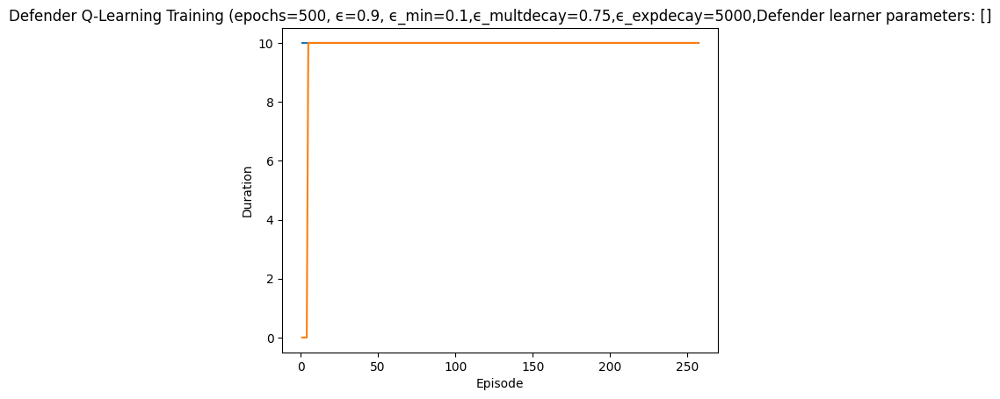

Rendering the current state of the environment
  ## Episode: 258/500 'Defender Q-Learning Training' ϵ=0.4339, Defender learner parameters: []


Episode 258|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=13, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2571, 'successful_actions': 1031, 'failed_actions': 1540}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2572, 'successful_actions': 1031, 'failed_actions': 1541}, 'network_availability': 1.0}
faile

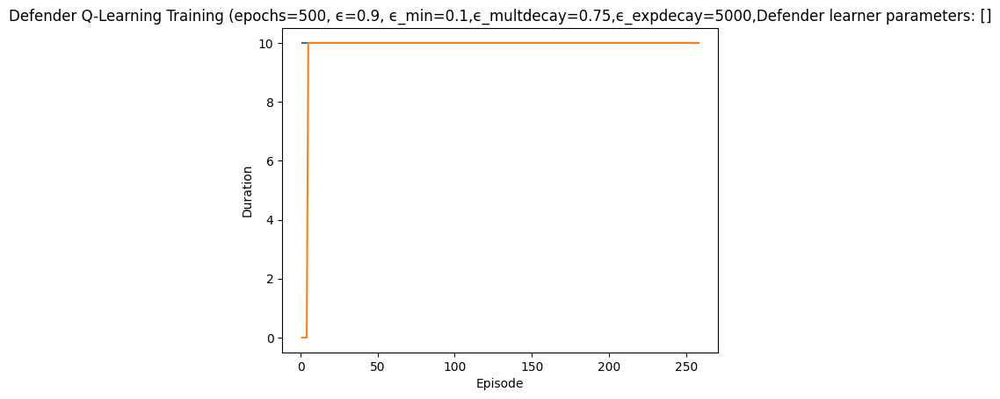

Rendering the current state of the environment
  ## Episode: 259/500 'Defender Q-Learning Training' ϵ=0.4332, Defender learner parameters: []


Episode 259|Iteration 10|reward:   40.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 2581, 'successful_actions': 1036, 'failed_actions': 1545}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=2, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2582, 'successful_actions': 1037, 'failed_actions': 1545}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=8, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 1, 'reason': 'Service not f

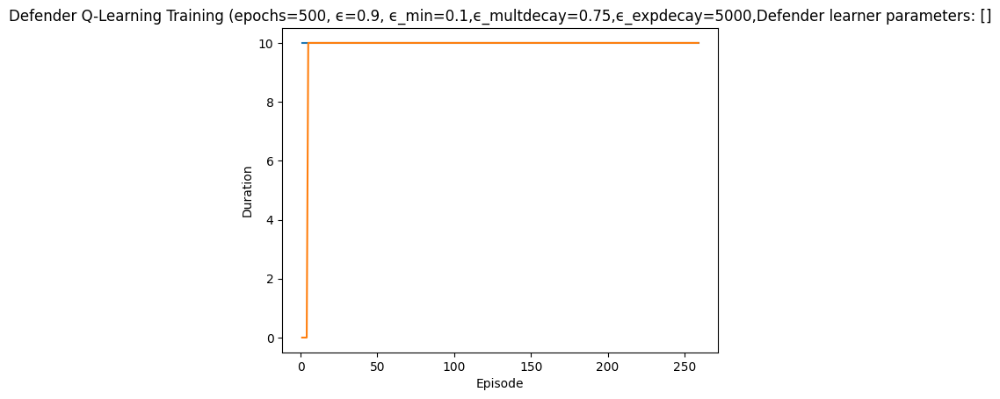

Rendering the current state of the environment
  ## Episode: 260/500 'Defender Q-Learning Training' ϵ=0.4325, Defender learner parameters: []


Episode 260|Iteration 10|reward:  145.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2591, 'successful_actions': 1040, 'failed_actions': 1551}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=12, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2592, 'successful_actions': 1040, 'failed_actions': 1552}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=8, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'po

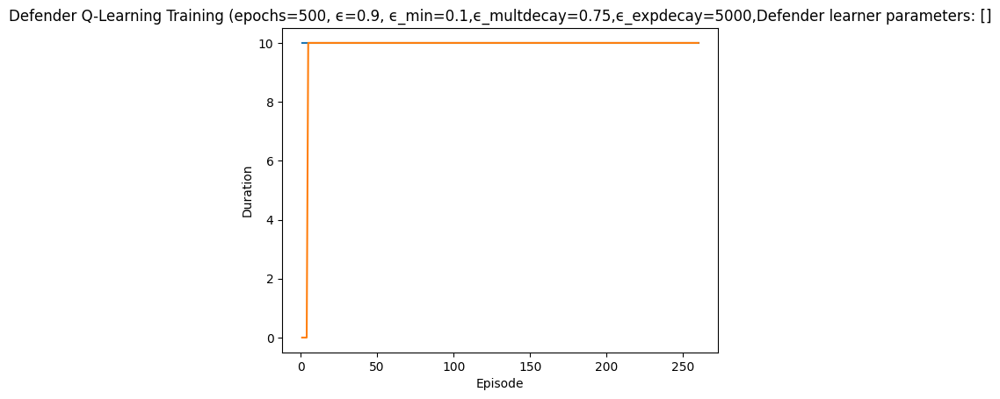

Rendering the current state of the environment
  ## Episode: 261/500 'Defender Q-Learning Training' ϵ=0.4318, Defender learner parameters: []


Episode 261|Iteration 10|reward:  145.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2601, 'successful_actions': 1047, 'failed_actions': 1554}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2602, 'successful_actions': 1048, 'failed_actions': 1554}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=12, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 1, 'reason': 'Servic

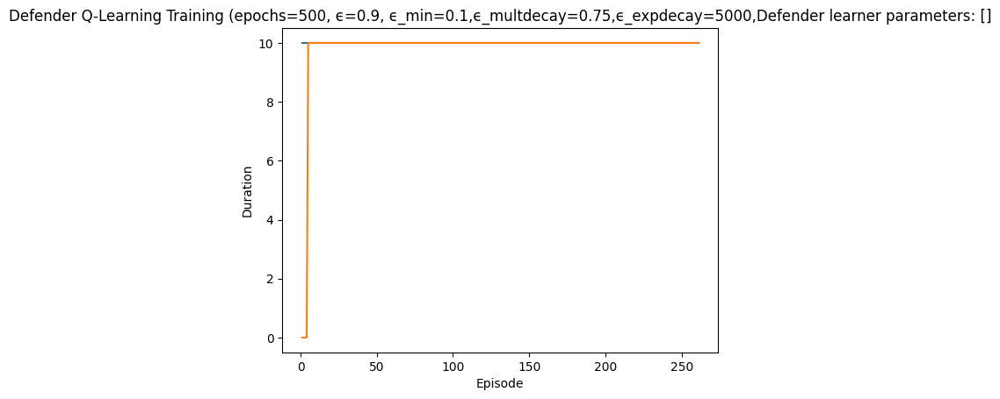

Rendering the current state of the environment
  ## Episode: 262/500 'Defender Q-Learning Training' ϵ=0.4311, Defender learner parameters: []


Episode 262|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2611, 'successful_actions': 1053, 'failed_actions': 1558}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2612, 'successful_actions': 1053, 'failed_actions': 1559}, 'network_availa

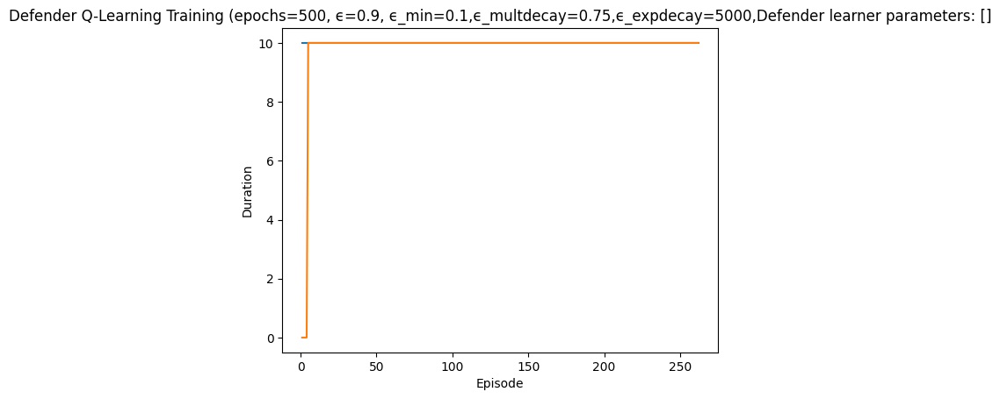

Rendering the current state of the environment
  ## Episode: 263/500 'Defender Q-Learning Training' ϵ=0.4304, Defender learner parameters: []


Episode 263|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 2621, 'successful_actions': 1057, 'failed_actions': 1564}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2622, 'successful_actions': 1057, 'failed_actions': 1565}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iterati

Episode 263|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 263 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 3
  Episode 263 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 527
    Blocking Traffic Count: 532
    Stopping Services Count: 0


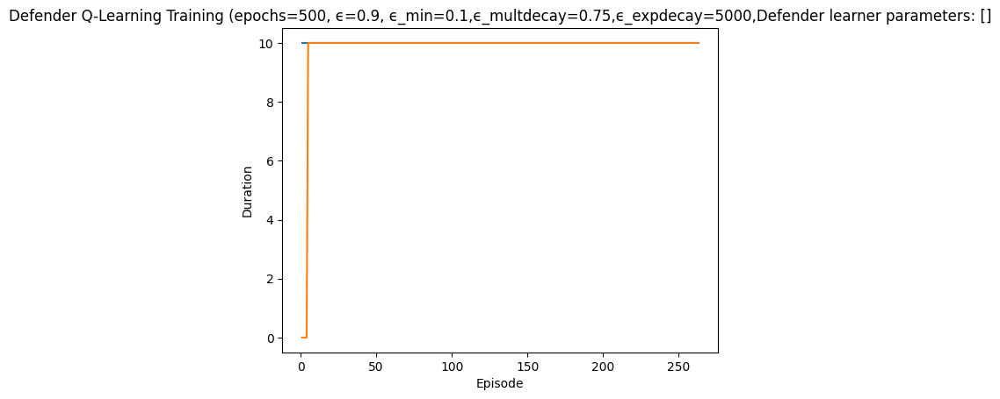

Rendering the current state of the environment
  ## Episode: 264/500 'Defender Q-Learning Training' ϵ=0.4296, Defender learner parameters: []


Episode 264|Iteration 8|reward:  -35.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=10, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2631, 'successful_actions': 1060, 'failed_actions': 1571}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2632, 'successful_actions': 1060, 'failed_actions': 1572}, 'network_availability': 1.

Episode 264|Iteration 9|reward:  -50.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 9: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2639, 'successful_actions': 1061, 'failed_actions': 1578}, 'network_availability': 1.0}


Episode 264|Iteration 10|reward:  -25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=11, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2640, 'successful_actions': 1062, 'failed_actions': 1578}, 'network_availability': 1.0}
  Episode 264 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  Episode 264 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 528
    Blocking Traffic Count: 533
    Stopping Services Count: 0


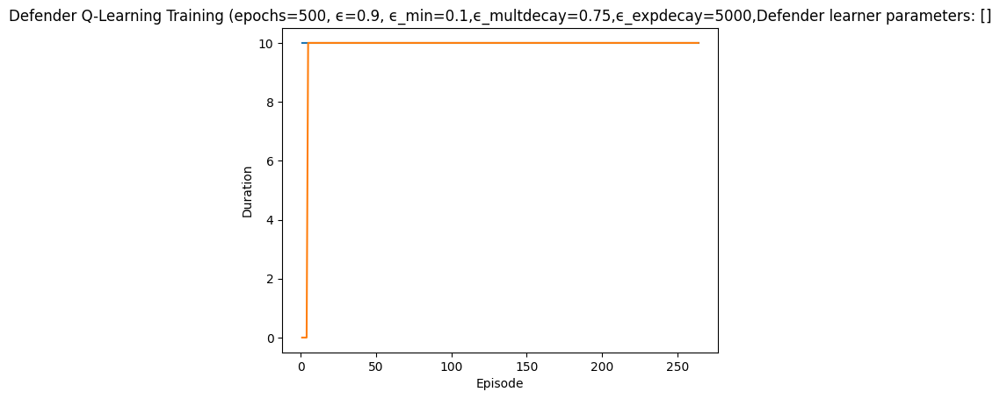

Rendering the current state of the environment
  ## Episode: 265/500 'Defender Q-Learning Training' ϵ=0.4289, Defender learner parameters: []


Episode 265|Iteration 6|reward:    5.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 0, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 0, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 2641, 'successful_actions': 1062, 'failed_actions': 1579}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=8, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2642, 'successful_actions': 1062, 'failed_actions': 1580}, 'network_availability': 1.0}
action type:  Block Tr

Episode 265|Iteration 10|reward:  -15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 7: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2647, 'successful_actions': 1064, 'failed_actions': 1583}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 8: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2648, 'successful_actions': 1064, 'failed_actions': 1584}, 'network_availability': 1.0}
action type:  

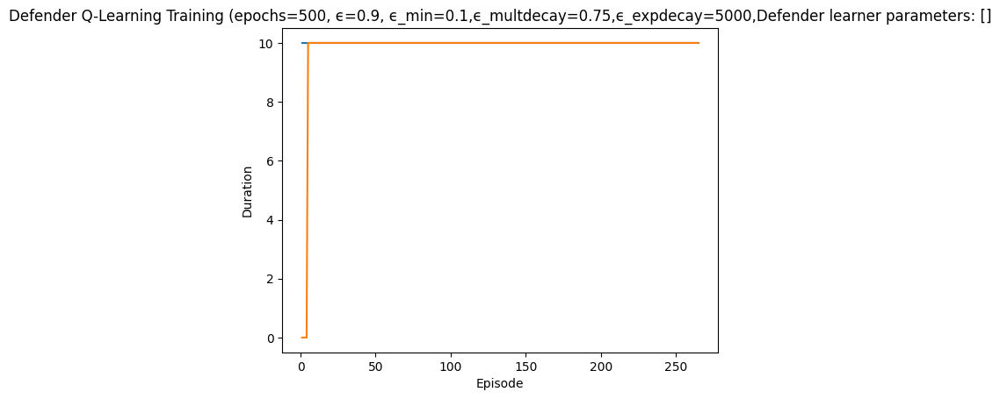

Rendering the current state of the environment
  ## Episode: 266/500 'Defender Q-Learning Training' ϵ=0.4282, Defender learner parameters: []


Episode 266|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2651, 'successful_actions': 1065, 'failed_actions': 1586}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2652, 'successful_actions': 1065, 'failed_actions': 1587}, 'network_availability': 1.0}
failed
{'a

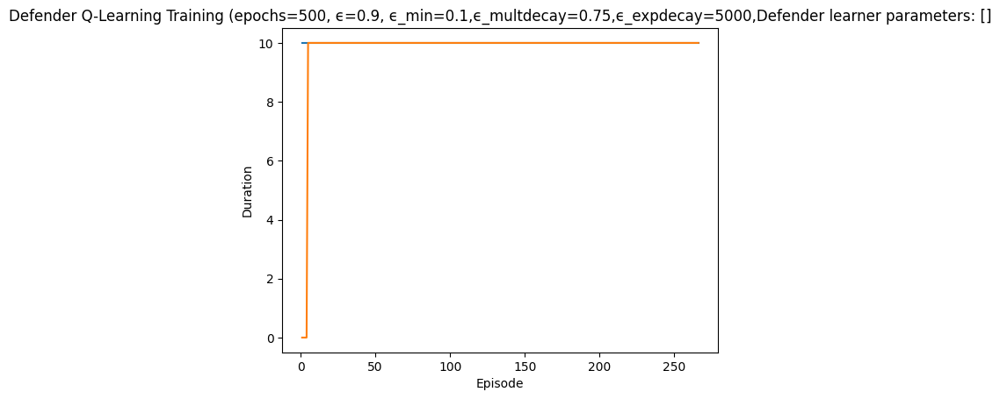

Rendering the current state of the environment
  ## Episode: 267/500 'Defender Q-Learning Training' ϵ=0.4275, Defender learner parameters: []


Episode 267|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2661, 'successful_actions': 1068, 'failed_actions': 1593}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2662, 'successful_actions': 1068, 'failed_actions': 1594}, 'network_availability': 1.0}
action type:

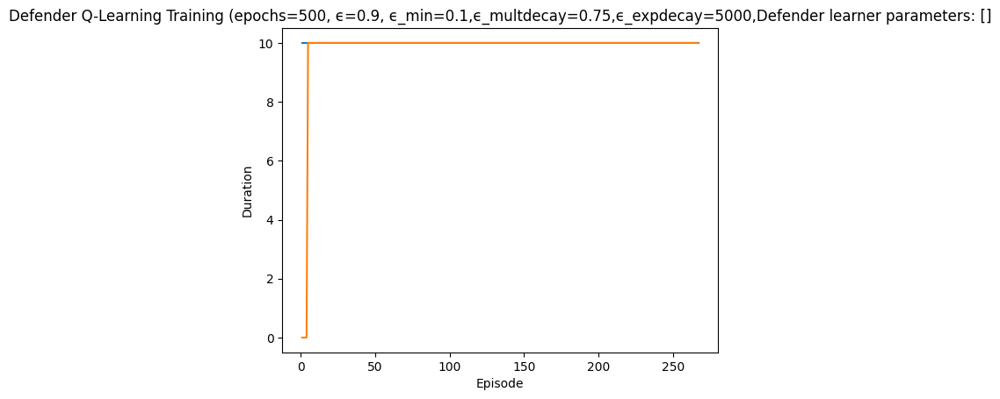

Rendering the current state of the environment
  ## Episode: 268/500 'Defender Q-Learning Training' ϵ=0.4268, Defender learner parameters: []


Episode 268|Iteration 10|reward:  -30.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 2671, 'successful_actions': 1075, 'failed_actions': 1596}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2672, 'successful_actions': 1075, 'failed_actions': 1597}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Actio

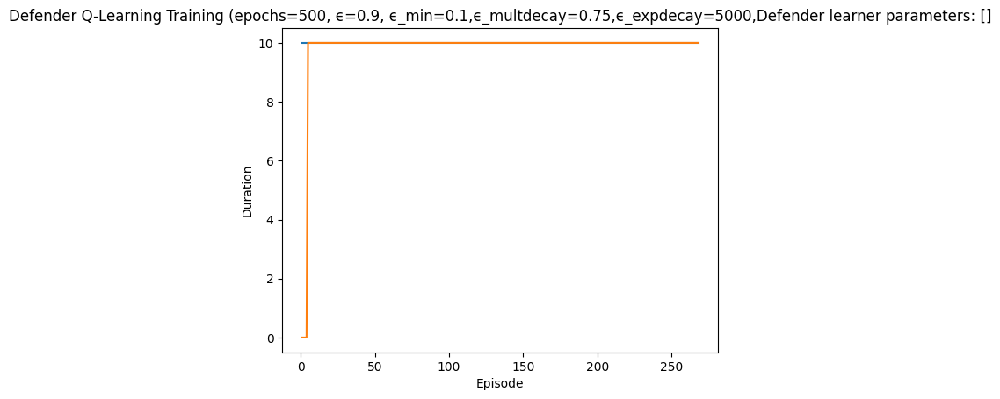

Rendering the current state of the environment
  ## Episode: 269/500 'Defender Q-Learning Training' ϵ=0.4261, Defender learner parameters: []


Episode 269|Iteration 10|reward:  -50.0|last_reward_at:    2|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2681, 'successful_actions': 1077, 'failed_actions': 1604}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 2682, 'successful_actions': 1078, 'failed_actions': 1604}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Servi

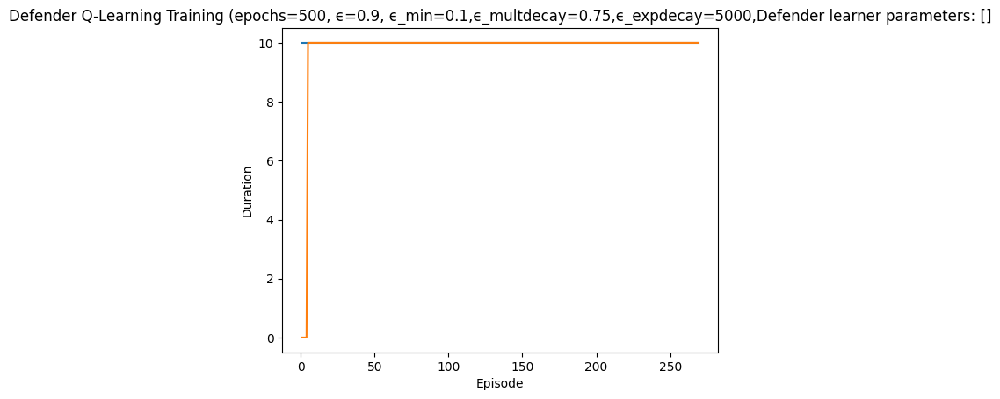

Rendering the current state of the environment
  ## Episode: 270/500 'Defender Q-Learning Training' ϵ=0.4254, Defender learner parameters: []


Episode 270|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 2691, 'successful_actions': 1079, 'failed_actions': 1612}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2692, 'successful_actions': 1080, 'failed_actions': 1612}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=13, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not requi

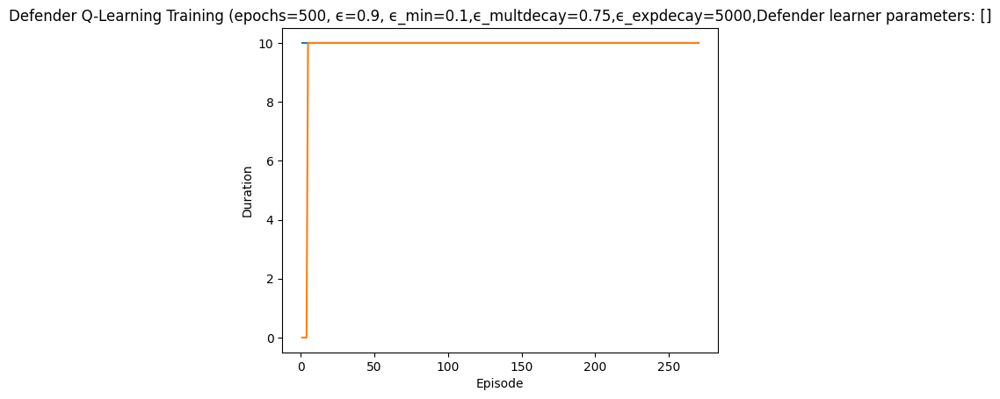

Rendering the current state of the environment
  ## Episode: 271/500 'Defender Q-Learning Training' ϵ=0.4247, Defender learner parameters: []


Episode 271|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2701, 'successful_actions': 1085, 'failed_actions': 1616}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2702, 'successful_actions': 1085, 'failed_actions': 1617}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3

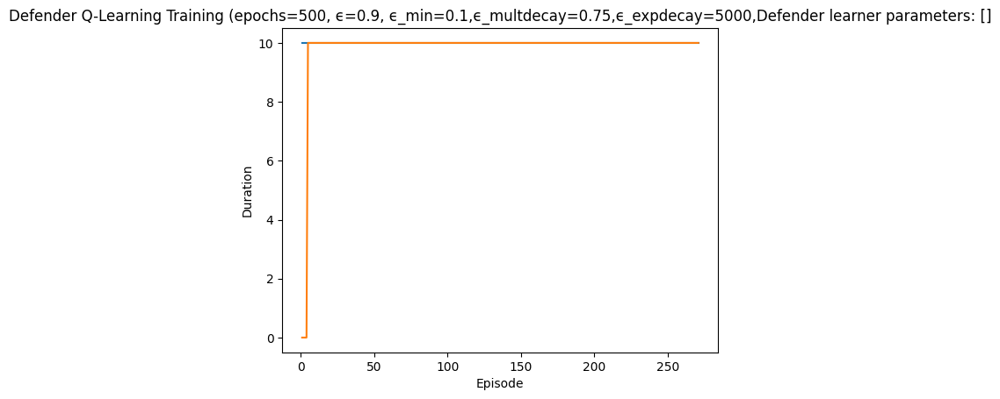

Rendering the current state of the environment
  ## Episode: 272/500 'Defender Q-Learning Training' ϵ=0.4240, Defender learner parameters: []


Episode 272|Iteration 10|reward:  -15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 2711, 'successful_actions': 1090, 'failed_actions': 1621}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=8, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2712, 'successful_actions': 1090, 'failed_actions': 1622}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=13, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'por

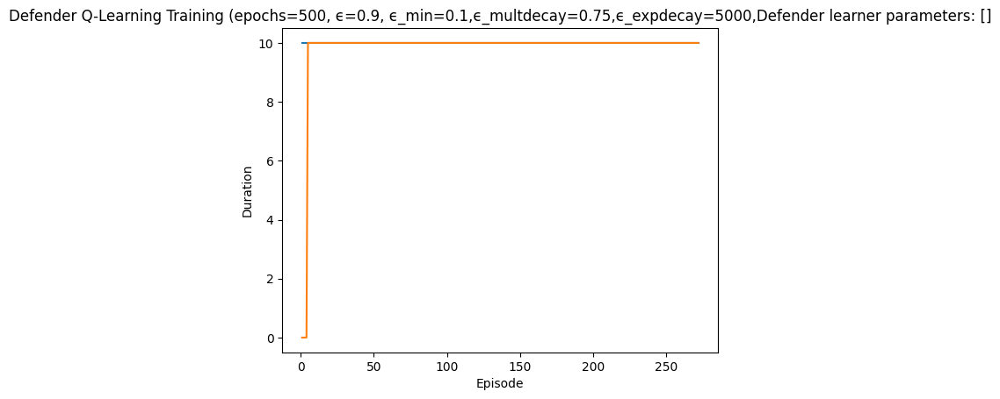

Rendering the current state of the environment
  ## Episode: 273/500 'Defender Q-Learning Training' ϵ=0.4233, Defender learner parameters: []


Episode 273|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2721, 'successful_actions': 1092, 'failed_actions': 1629}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2722, 'successful_actions': 1092, 'failed_actions': 1630}, 'network_availability': 1.0}
failed
{'a

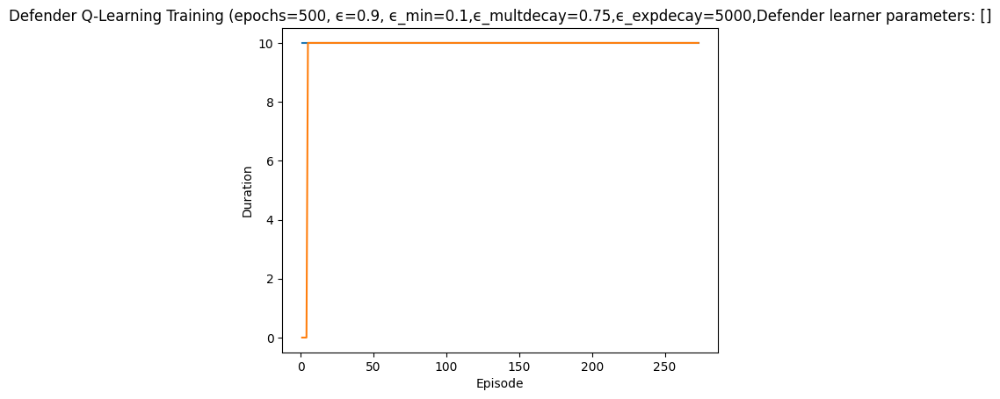

Rendering the current state of the environment
  ## Episode: 274/500 'Defender Q-Learning Training' ϵ=0.4226, Defender learner parameters: []


Episode 274|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2731, 'successful_actions': 1096, 'failed_actions': 1635}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2732, 'successful_actions': 1097, 'failed_actions': 1635}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3:

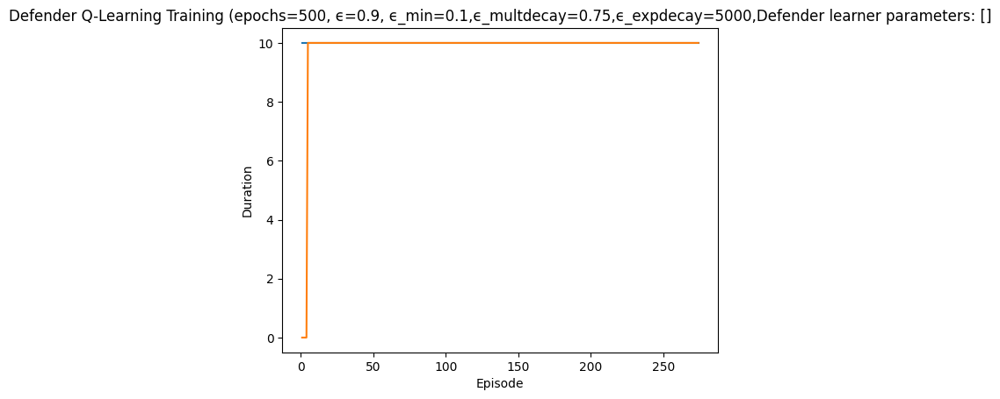

Rendering the current state of the environment
  ## Episode: 275/500 'Defender Q-Learning Training' ϵ=0.4219, Defender learner parameters: []


Episode 275|Iteration 10|reward:   10.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=13, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2741, 'successful_actions': 1099, 'failed_actions': 1642}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 2742, 'successful_actions': 1100, 'failed_actions': 1642}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=6, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'p

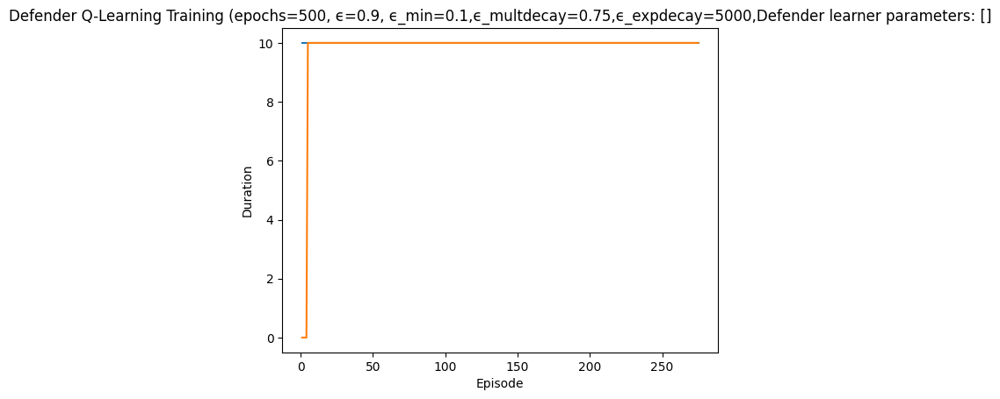

Rendering the current state of the environment
  ## Episode: 276/500 'Defender Q-Learning Training' ϵ=0.4212, Defender learner parameters: []


Episode 276|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2751, 'successful_actions': 1103, 'failed_actions': 1648}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=13, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2752, 'successful_actions': 1103, 'failed_actions': 1649}, 'network_availability': 

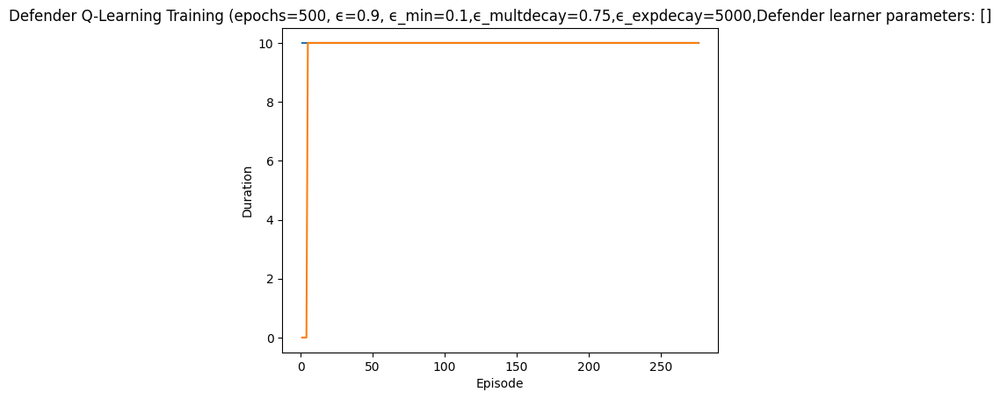

Rendering the current state of the environment
  ## Episode: 277/500 'Defender Q-Learning Training' ϵ=0.4205, Defender learner parameters: []


Episode 277|Iteration 10|reward:  170.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2761, 'successful_actions': 1108, 'failed_actions': 1653}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2762, 'successful_actions': 1109, 'failed_actions': 1653}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=5, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 2763, 'successful_actions': 1110, 'failed_actions': 1653}, 'network_availability': 1.0}
action type:  Block Traffic
It

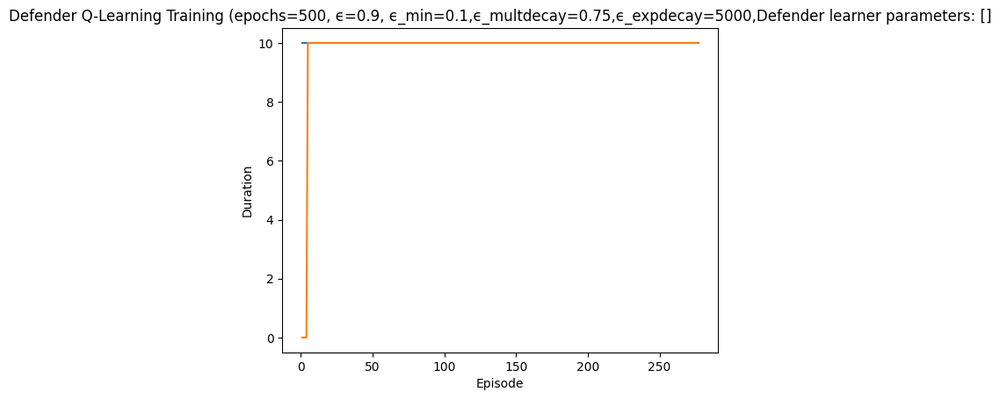

Rendering the current state of the environment
  ## Episode: 278/500 'Defender Q-Learning Training' ϵ=0.4199, Defender learner parameters: []


Episode 278|Iteration 10|reward:  130.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 4, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 4, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 2771, 'successful_actions': 1115, 'failed_actions': 1656}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=9, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 2772, 'successful_actions': 1116, 'failed_actions': 1656}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action 

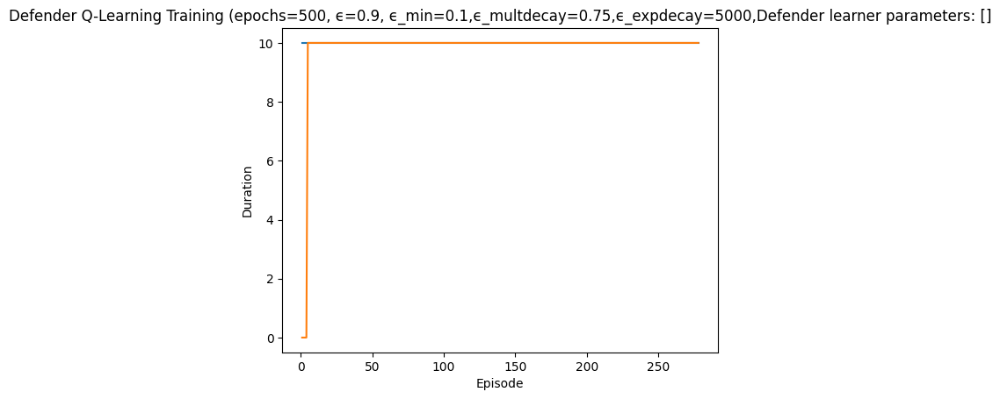

Rendering the current state of the environment
  ## Episode: 279/500 'Defender Q-Learning Training' ϵ=0.4192, Defender learner parameters: []


Episode 279|Iteration 10|reward:   45.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2781, 'successful_actions': 1122, 'failed_actions': 1659}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2782, 'successful_actions': 1122, 'failed_actions': 1660}, 'network

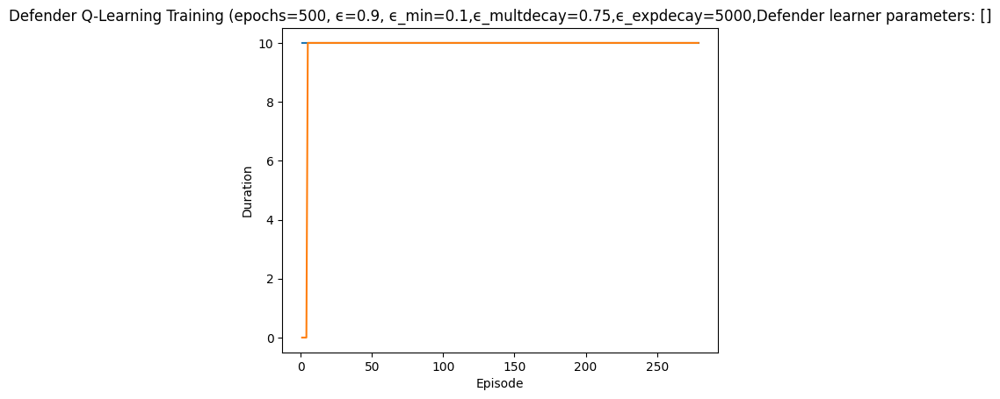

Rendering the current state of the environment
  ## Episode: 280/500 'Defender Q-Learning Training' ϵ=0.4185, Defender learner parameters: []


Episode 280|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2791, 'successful_actions': 1125, 'failed_actions': 1666}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2792, 'successful_actions': 1125, 'failed_actions': 1667}, 'network_availability': 1.0}
fa

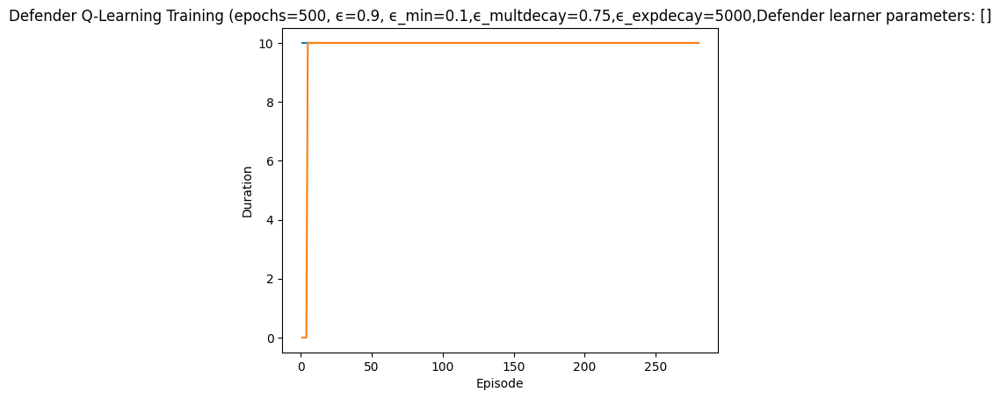

Rendering the current state of the environment
  ## Episode: 281/500 'Defender Q-Learning Training' ϵ=0.4178, Defender learner parameters: []


Episode 281|Iteration 10|reward:  -50.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2801, 'successful_actions': 1128, 'failed_actions': 1673}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2802, 'successful_actions': 1128, 'failed_actions': 1674}, 'network_availability': 1.

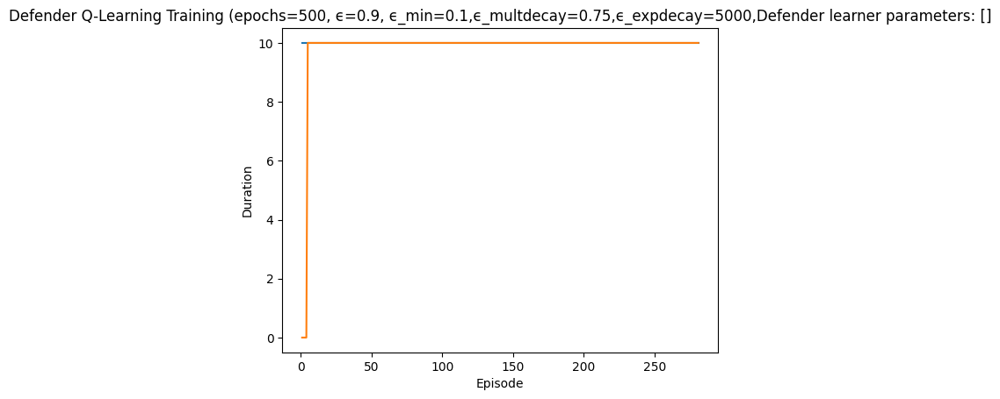

Rendering the current state of the environment
  ## Episode: 282/500 'Defender Q-Learning Training' ϵ=0.4171, Defender learner parameters: []


Episode 282|Iteration 10|reward:   25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2811, 'successful_actions': 1129, 'failed_actions': 1682}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2812, 'successful_actions': 1129, 'failed_actions': 1683}, 'network_availability': 1.0}
failed
{'action':

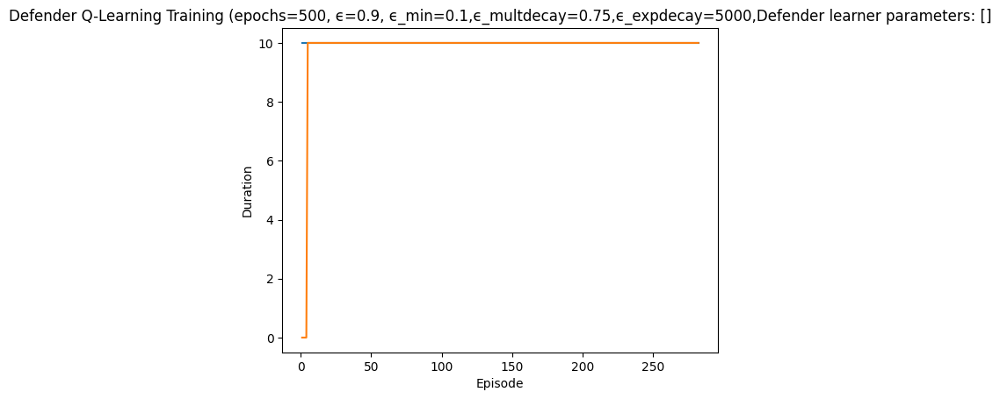

Rendering the current state of the environment
  ## Episode: 283/500 'Defender Q-Learning Training' ϵ=0.4164, Defender learner parameters: []


Episode 283|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2821, 'successful_actions': 1133, 'failed_actions': 1688}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2822, 'successful_actions': 1134, 'failed_actions': 1688}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=1, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_nam

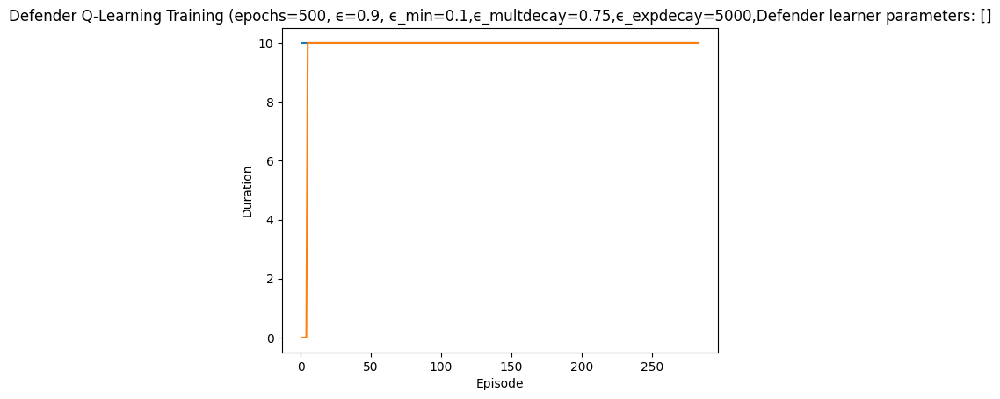

Rendering the current state of the environment
  ## Episode: 284/500 'Defender Q-Learning Training' ϵ=0.4157, Defender learner parameters: []


Episode 284|Iteration 10|reward:   30.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2831, 'successful_actions': 1138, 'failed_actions': 1693}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 2832, 'successful_actions': 1139, 'failed_actions': 1693}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimag

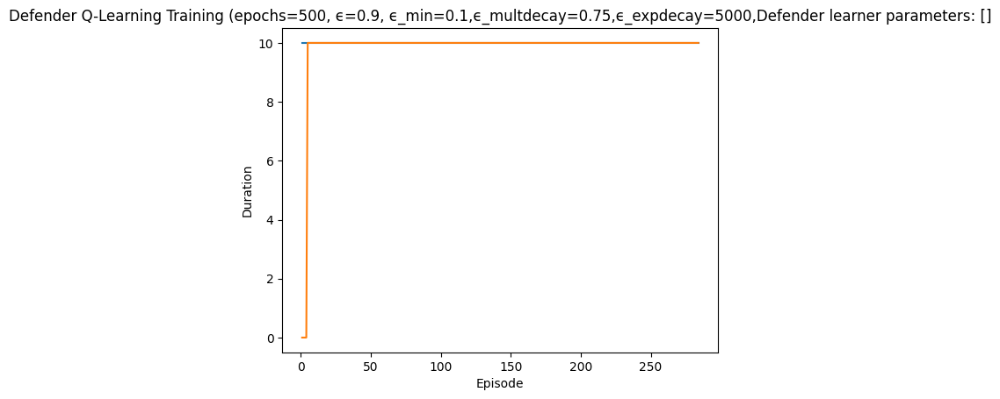

Rendering the current state of the environment
  ## Episode: 285/500 'Defender Q-Learning Training' ϵ=0.4151, Defender learner parameters: []


Episode 285|Iteration 10|reward:  -40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2841, 'successful_actions': 1141, 'failed_actions': 1700}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2842, 'successful_actions': 1141, 'failed_actions': 1701}, 'network_availability': 1.0}
action type: 

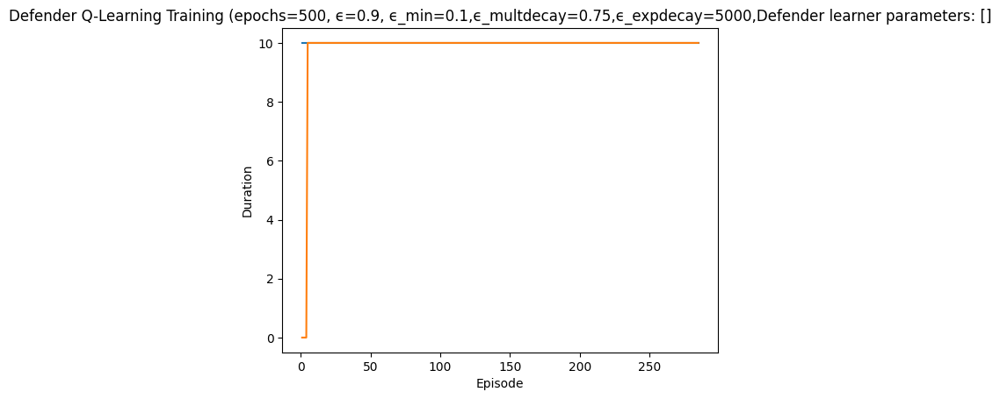

Rendering the current state of the environment
  ## Episode: 286/500 'Defender Q-Learning Training' ϵ=0.4144, Defender learner parameters: []


Episode 286|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2851, 'successful_actions': 1143, 'failed_actions': 1708}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2852, 'successful_actions': 1143, 'failed_actions': 1709}, 'network_availability': 1.0

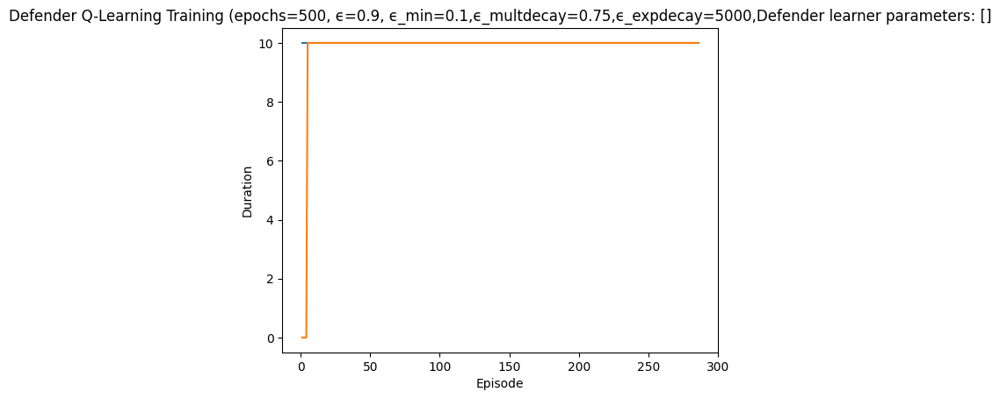

Rendering the current state of the environment
  ## Episode: 287/500 'Defender Q-Learning Training' ϵ=0.4137, Defender learner parameters: []


Episode 287|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2861, 'successful_actions': 1148, 'failed_actions': 1713}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 2862, 'successful_actions': 1149, 'failed_actions': 1713}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: 

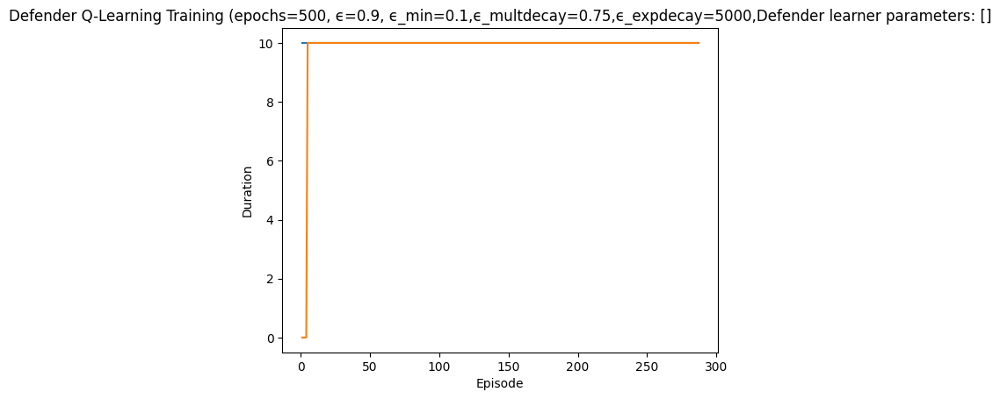

Rendering the current state of the environment
  ## Episode: 288/500 'Defender Q-Learning Training' ϵ=0.4130, Defender learner parameters: []


Episode 288|Iteration 10|reward:   10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=7, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2871, 'successful_actions': 1154, 'failed_actions': 1717}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2872, 'successful_actions': 1154, 'failed_actions': 1718}, 'network_availability': 1.0}
failed
{'act

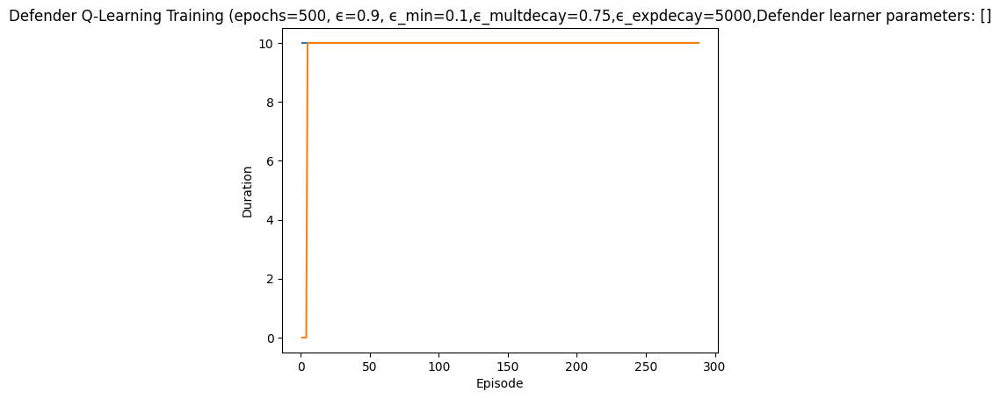

Rendering the current state of the environment
  ## Episode: 289/500 'Defender Q-Learning Training' ϵ=0.4124, Defender learner parameters: []


Episode 289|Iteration 10|reward:   95.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2881, 'successful_actions': 1159, 'failed_actions': 1722}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 2882, 'successful_actions': 1160, 'failed_actions': 1722}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=13, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not r

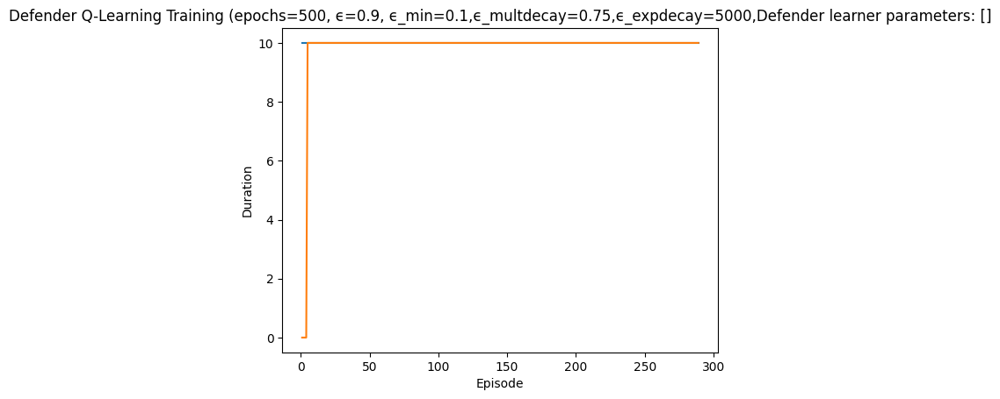

Rendering the current state of the environment
  ## Episode: 290/500 'Defender Q-Learning Training' ϵ=0.4117, Defender learner parameters: []


Episode 290|Iteration 10|reward:   15.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2891, 'successful_actions': 1163, 'failed_actions': 1728}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2892, 'successful_actions': 1163, 'failed_actions': 1729}, 'network_av

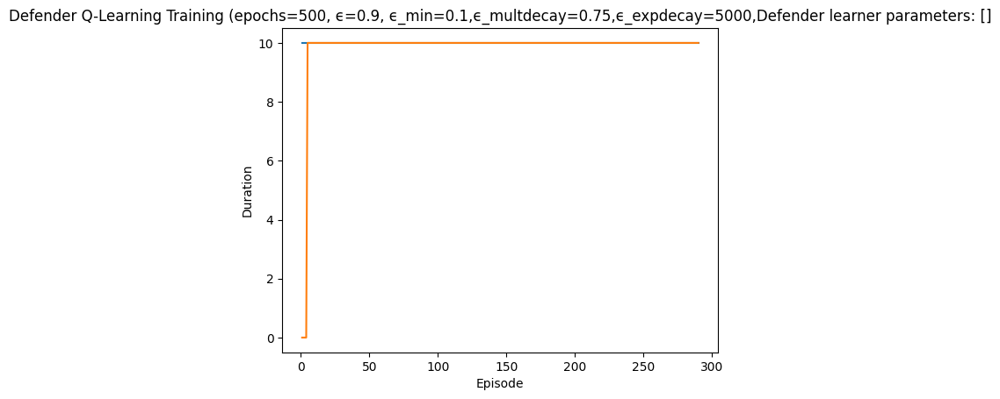

Rendering the current state of the environment
  ## Episode: 291/500 'Defender Q-Learning Training' ϵ=0.4110, Defender learner parameters: []


Episode 291|Iteration 10|reward:  -40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2901, 'successful_actions': 1166, 'failed_actions': 1735}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2902, 'successful_actions': 1166, 'failed_actions': 1736}, 'network_availability': 

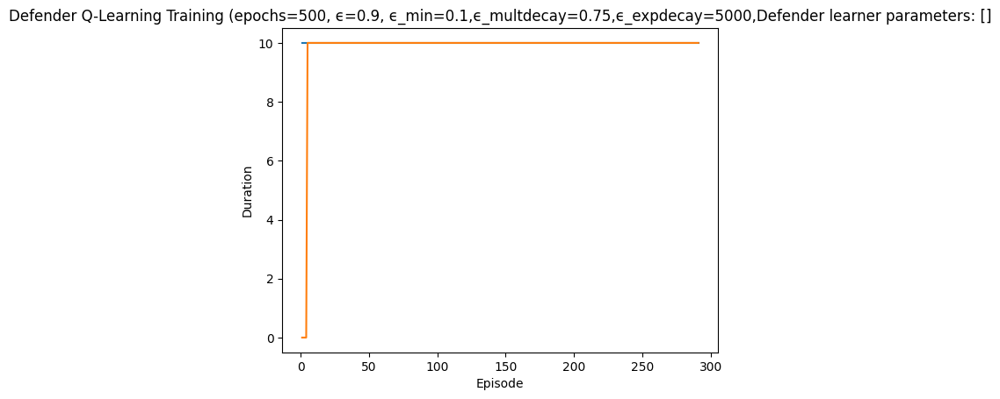

Rendering the current state of the environment
  ## Episode: 292/500 'Defender Q-Learning Training' ϵ=0.4103, Defender learner parameters: []


Episode 292|Iteration 10|reward:   45.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2911, 'successful_actions': 1168, 'failed_actions': 1743}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2912, 'successful_actions': 1168, 'failed_actions': 1744}, 'network_av

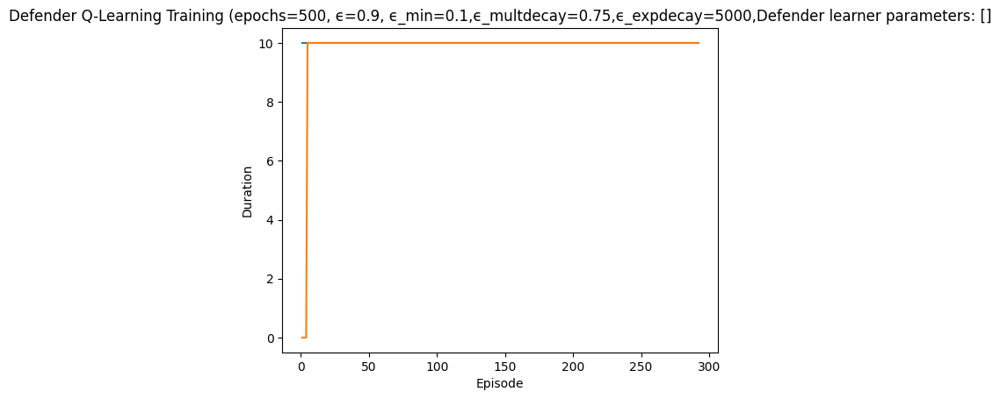

Rendering the current state of the environment
  ## Episode: 293/500 'Defender Q-Learning Training' ϵ=0.4097, Defender learner parameters: []


Episode 293|Iteration 10|reward:    0.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2921, 'successful_actions': 1171, 'failed_actions': 1750}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=11, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2922, 'successful_actions': 1171, 'failed_actions': 1751}, 'network_availability': 

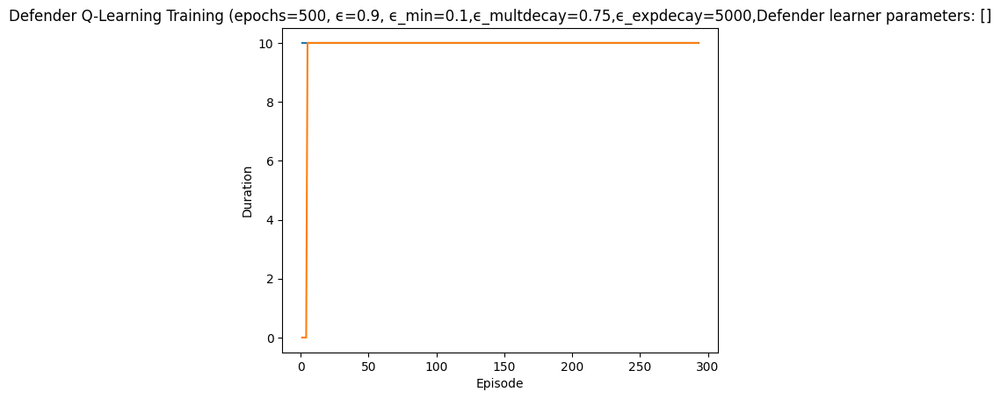

Rendering the current state of the environment
  ## Episode: 294/500 'Defender Q-Learning Training' ϵ=0.4090, Defender learner parameters: []


Episode 294|Iteration 10|reward:  -30.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2931, 'successful_actions': 1174, 'failed_actions': 1757}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 2932, 'successful_actions': 1175, 'failed_actions': 1757}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=4, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_na

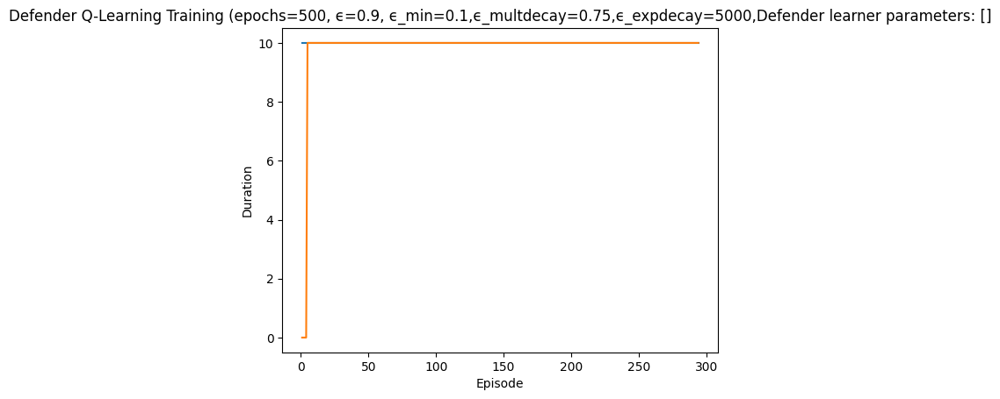

Rendering the current state of the environment
  ## Episode: 295/500 'Defender Q-Learning Training' ϵ=0.4083, Defender learner parameters: []


Episode 295|Iteration 10|reward:  -10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2941, 'successful_actions': 1177, 'failed_actions': 1764}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2942, 'successful_actions': 1177, 'failed_actions': 1765}, 'network_availability': 1.0}
failed
{'a

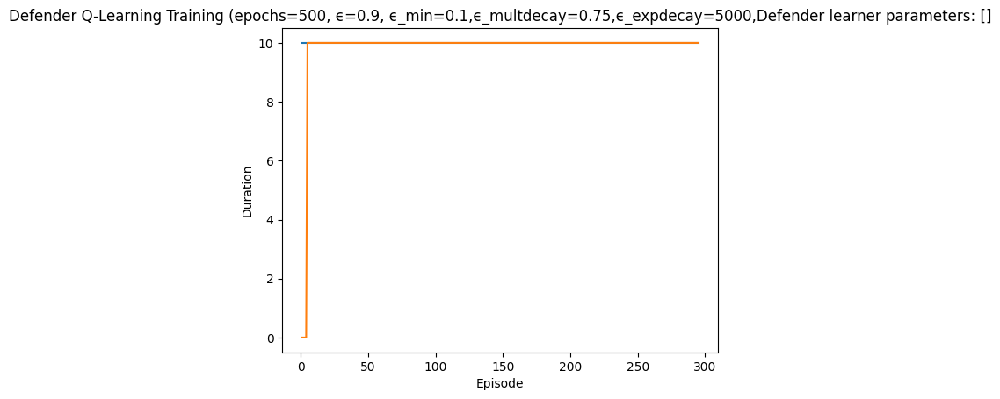

Rendering the current state of the environment
  ## Episode: 296/500 'Defender Q-Learning Training' ϵ=0.4077, Defender learner parameters: []


Episode 296|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=5, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2951, 'successful_actions': 1179, 'failed_actions': 1772}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2952, 'successful_actions': 1179, 'failed_actions': 1773}, 'network_availability': 1.0}
failed

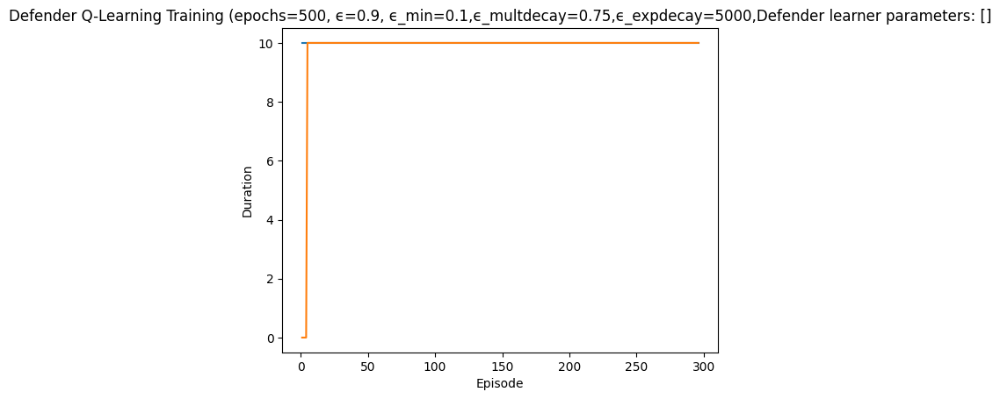

Rendering the current state of the environment
  ## Episode: 297/500 'Defender Q-Learning Training' ϵ=0.4070, Defender learner parameters: []


Episode 297|Iteration 2|reward:   10.0|last_reward_at:    1|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 2961, 'successful_actions': 1184, 'failed_actions': 1777}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 4, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=0, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 4, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 2962, 'successful_actions': 1184, 'failed_actions': 1778}, 'network_availability': 1.0}
failed


Episode 297|Iteration 4|reward:   35.0|last_reward_at:    1|Elapsed Time: 0:00:00||

{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=11, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2963, 'successful_actions': 1184, 'failed_actions': 1779}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 4: Action Taken: Type=Block Traffic, NodeID=5, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 2964, 'successful_actions': 1185, 'failed_actions': 1779}, 'network_availability': 1.0}


Episode 297|Iteration 9|reward:   55.0|last_reward_at:    8|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 5: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2965, 'successful_actions': 1185, 'failed_actions': 1780}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 6: Action Taken: Type=Reimage Node, NodeID=5, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 2966, 'successful_actions': 1186, 'failed_actions': 1780}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Itera

Episode 297|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 10: Action Taken: Type=Start Service, NodeID=5, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2970, 'successful_actions': 1187, 'failed_actions': 1783}, 'network_availability': 1.0}
  Episode 297 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  Episode 297 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 598
    Blocking Traffic Count: 588
    Stopping Services Count: 0


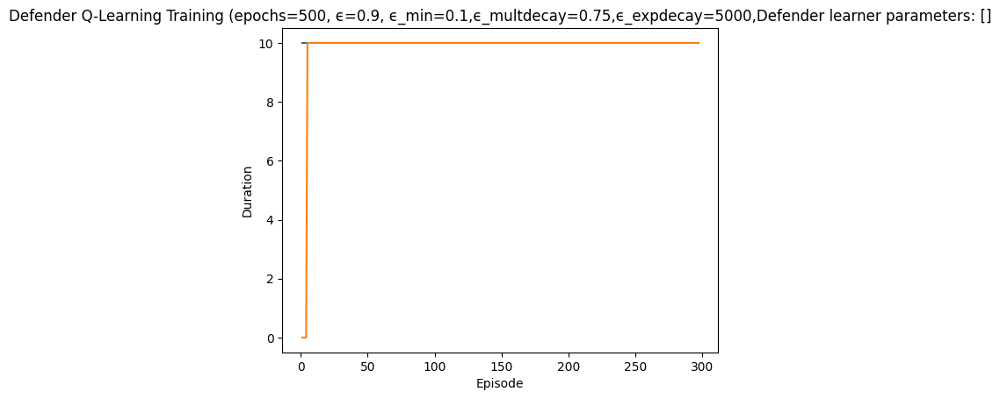

Rendering the current state of the environment
  ## Episode: 298/500 'Defender Q-Learning Training' ϵ=0.4063, Defender learner parameters: []


Episode 298|Iteration 8|reward:  -10.0|last_reward_at:    7|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=7, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 2971, 'successful_actions': 1188, 'failed_actions': 1783}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2972, 'successful_actions': 1188, 'failed_actions': 1784}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iterat

Episode 298|Iteration 9|reward:  -25.0|last_reward_at:    7|Elapsed Time: 0:00:00||

Allow Traffic
Iteration 9: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2979, 'successful_actions': 1189, 'failed_actions': 1790}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 10: Action Taken: Type=Start Service, NodeID=4, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2980, 'successful_actions': 1189, 'failed_actions': 1791}, 'network_availability': 1.0}


Episode 298|Iteration 10|reward:  -40.0|last_reward_at:    7|Elapsed Time: 0:00:00||


  Episode 298 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  Episode 298 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 599
    Blocking Traffic Count: 589
    Stopping Services Count: 0


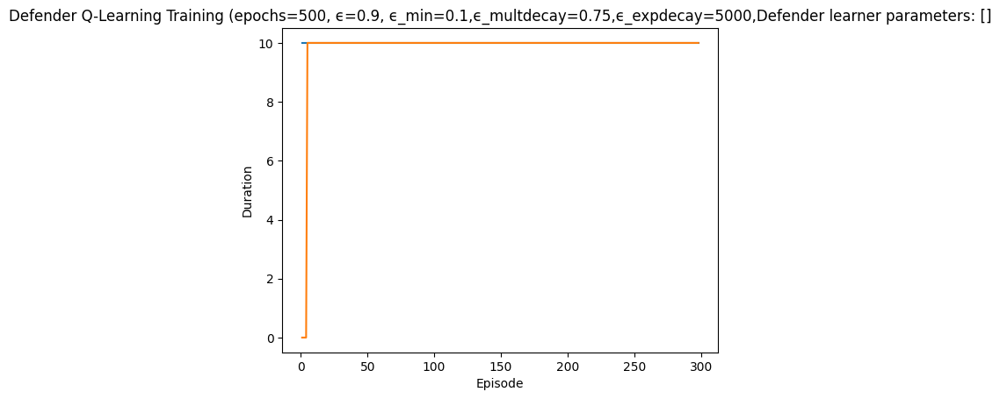

Rendering the current state of the environment
  ## Episode: 299/500 'Defender Q-Learning Training' ϵ=0.4057, Defender learner parameters: []


Episode 299|Iteration 10|reward:  -65.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=12, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2981, 'successful_actions': 1189, 'failed_actions': 1792}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=6, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2982, 'successful_actions': 1189, 'failed_actions': 1793}, 'network_availability': 1.0}
failed
{'ac

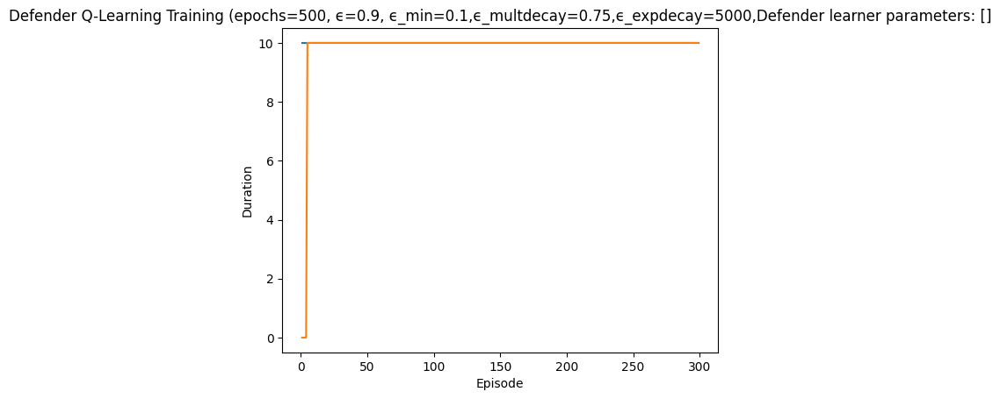

Rendering the current state of the environment
  ## Episode: 300/500 'Defender Q-Learning Training' ϵ=0.4050, Defender learner parameters: []


Episode 300|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=11, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 2991, 'successful_actions': 1190, 'failed_actions': 1801}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 2992, 'successful_actions': 1191, 'failed_actions': 1801}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=1, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'p

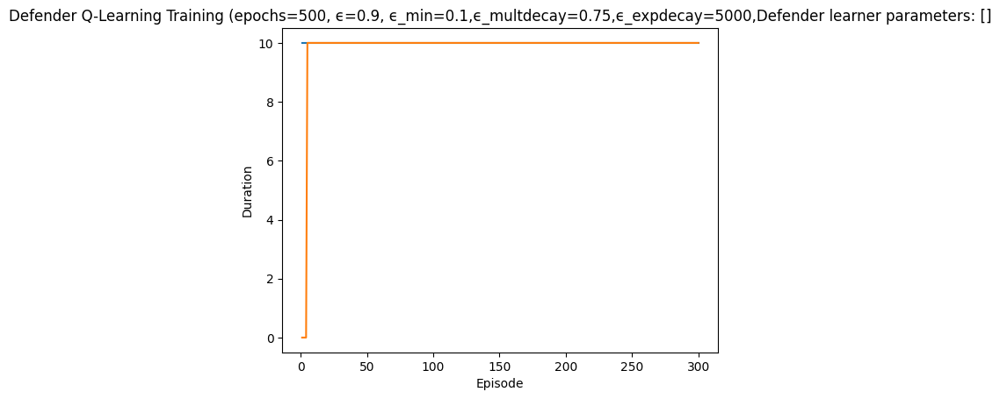

Rendering the current state of the environment
  ## Episode: 301/500 'Defender Q-Learning Training' ϵ=0.4044, Defender learner parameters: []


Episode 301|Iteration 10|reward:  125.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 3001, 'successful_actions': 1195, 'failed_actions': 1806}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3002, 'successful_actions': 1196, 'failed_actions': 1806}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=2, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required 

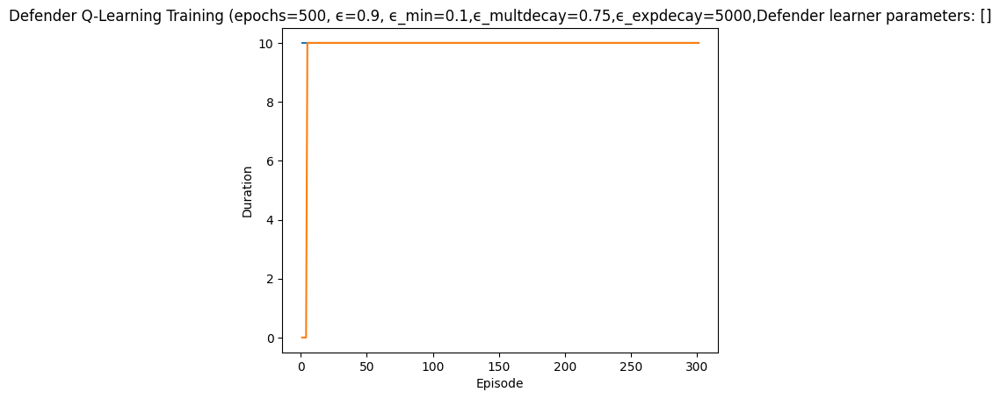

Rendering the current state of the environment
  ## Episode: 302/500 'Defender Q-Learning Training' ϵ=0.4037, Defender learner parameters: []


Episode 302|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3011, 'successful_actions': 1199, 'failed_actions': 1812}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3012, 'successful_actions': 1199, 'failed_actions': 1813}, 'network_availability': 1.0}
action type:  

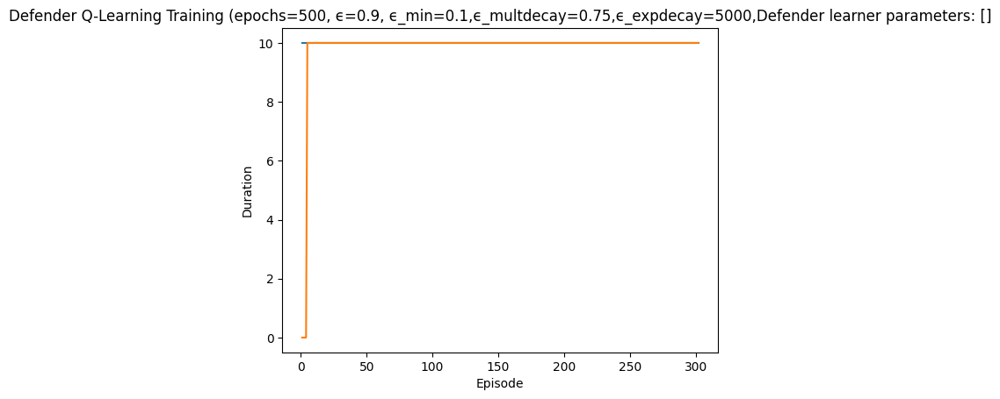

Rendering the current state of the environment
  ## Episode: 303/500 'Defender Q-Learning Training' ϵ=0.4030, Defender learner parameters: []


Episode 303|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3021, 'successful_actions': 1205, 'failed_actions': 1816}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3022, 'successful_actions': 1205, 'failed_actions': 1817}, 'network_availability': 1.0}
failed
{'action': 

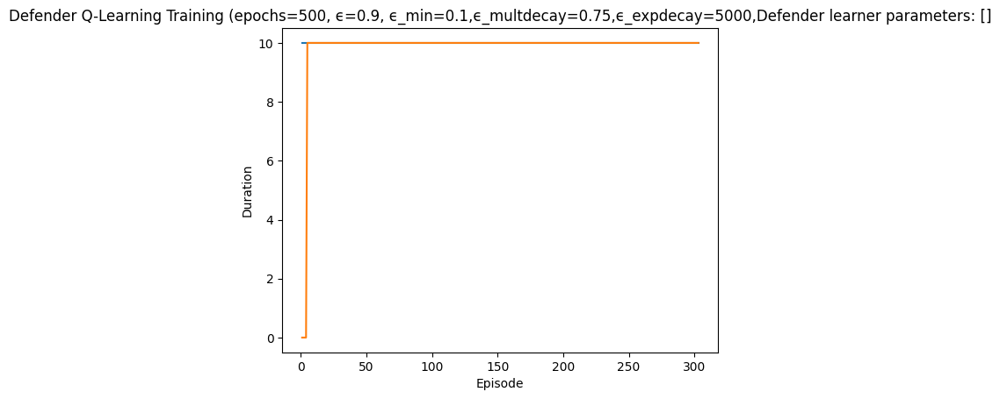

Rendering the current state of the environment
  ## Episode: 304/500 'Defender Q-Learning Training' ϵ=0.4024, Defender learner parameters: []


Episode 304|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 3031, 'successful_actions': 1212, 'failed_actions': 1819}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3032, 'successful_actions': 1213, 'failed_actions': 1819}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=7, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3033, 'successful_actions': 1214, 'failed_actions': 1819}, 'network_availability': 1.0}
failed
{'action': 'stop_service', '

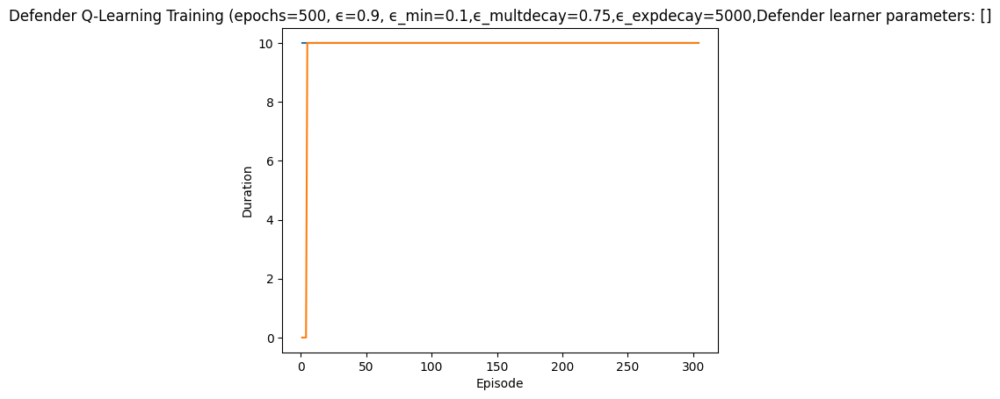

Rendering the current state of the environment
  ## Episode: 305/500 'Defender Q-Learning Training' ϵ=0.4017, Defender learner parameters: []


Episode 305|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 3041, 'successful_actions': 1218, 'failed_actions': 1823}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=11, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3042, 'successful_actions': 1219, 'failed_actions': 1823}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=13, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not

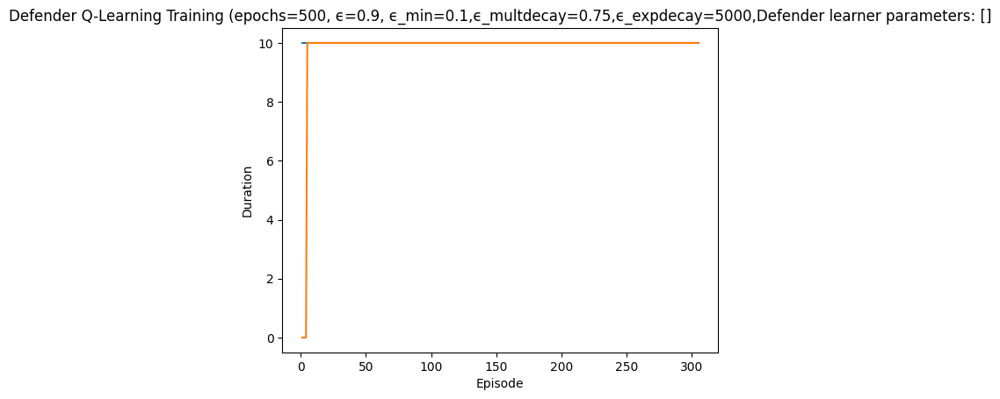

Rendering the current state of the environment
  ## Episode: 306/500 'Defender Q-Learning Training' ϵ=0.4011, Defender learner parameters: []


Episode 306|Iteration 10|reward:   50.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=11, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3051, 'successful_actions': 1221, 'failed_actions': 1830}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 3052, 'successful_actions': 1222, 'failed_actions': 1830}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=3, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', '

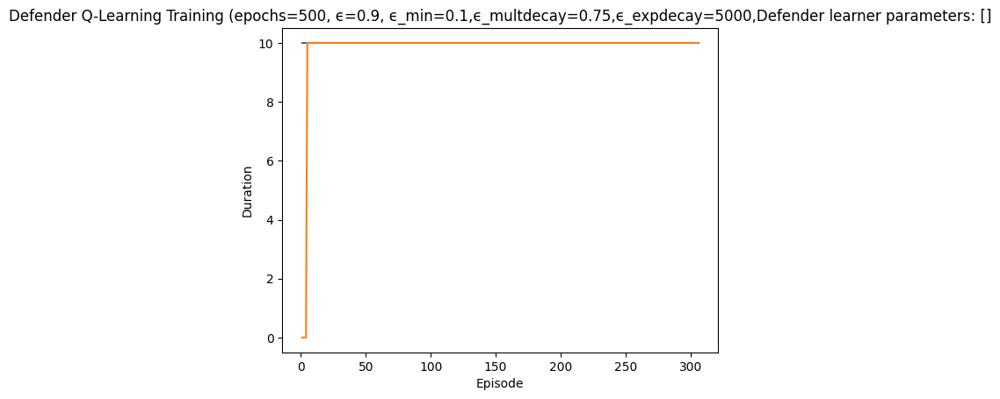

Rendering the current state of the environment
  ## Episode: 307/500 'Defender Q-Learning Training' ϵ=0.4004, Defender learner parameters: []


Episode 307|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3061, 'successful_actions': 1226, 'failed_actions': 1835}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=7, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3062, 'successful_actions': 1227, 'failed_actions': 1835}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=2, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxN

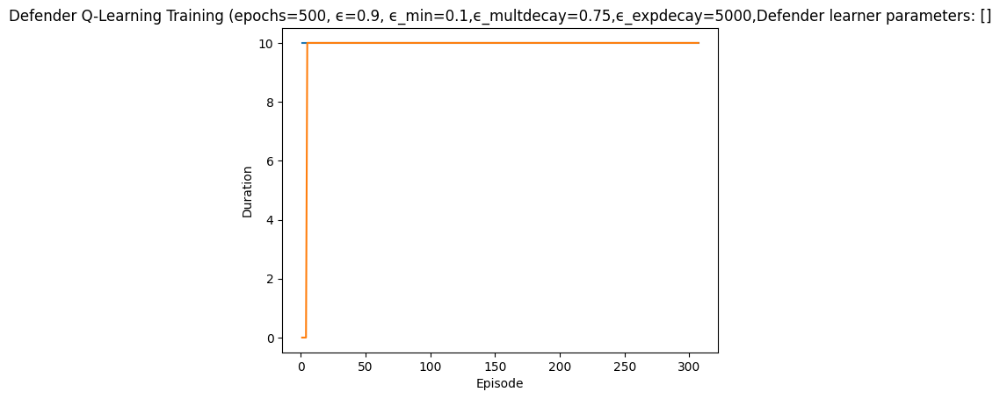

Rendering the current state of the environment
  ## Episode: 308/500 'Defender Q-Learning Training' ϵ=0.3998, Defender learner parameters: []


Episode 308|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3071, 'successful_actions': 1231, 'failed_actions': 1840}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3072, 'successful_actions': 1231, 'failed_actions': 1841}, 'network_availability': 1.0}
acti

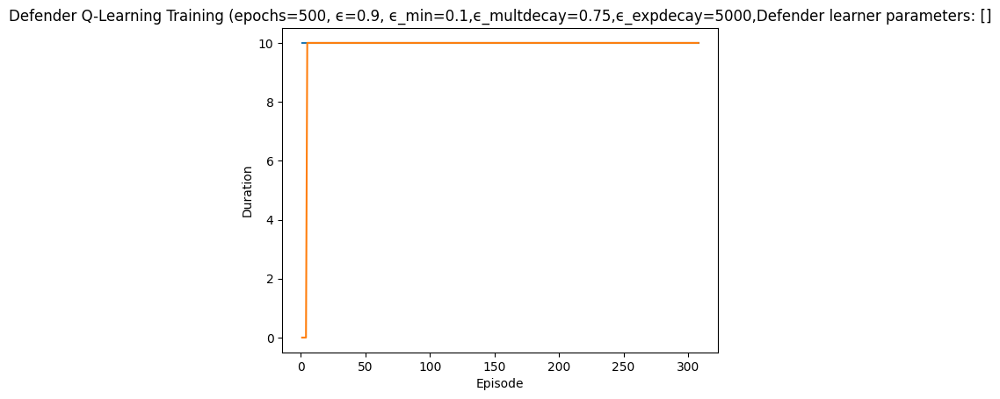

Rendering the current state of the environment
  ## Episode: 309/500 'Defender Q-Learning Training' ϵ=0.3991, Defender learner parameters: []


Episode 309|Iteration 10|reward:   80.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=6, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3081, 'successful_actions': 1236, 'failed_actions': 1845}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3082, 'successful_actions': 1237, 'failed_actions': 1845}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=11, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3083, 'successful_actions': 1238, 'failed_actions': 1845}, 'network_availability': 1.0}
failed
{'action': 'stop_servic

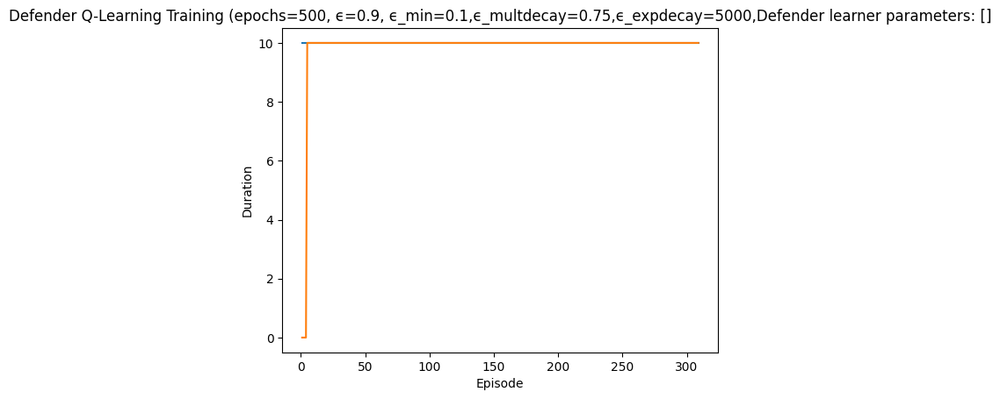

Rendering the current state of the environment
  ## Episode: 310/500 'Defender Q-Learning Training' ϵ=0.3985, Defender learner parameters: []


Episode 310|Iteration 10|reward:   95.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=13, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3091, 'successful_actions': 1240, 'failed_actions': 1851}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3092, 'successful_actions': 1240, 'failed_actions': 1852}, 'network_availability': 1.0}
action 

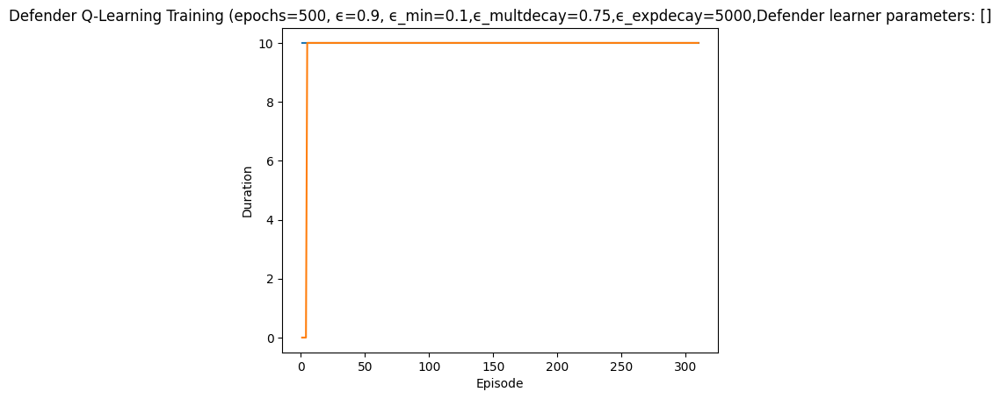

Rendering the current state of the environment
  ## Episode: 311/500 'Defender Q-Learning Training' ϵ=0.3978, Defender learner parameters: []


Episode 311|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3101, 'successful_actions': 1245, 'failed_actions': 1856}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 3102, 'successful_actions': 1246, 'failed_actions': 1856}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3

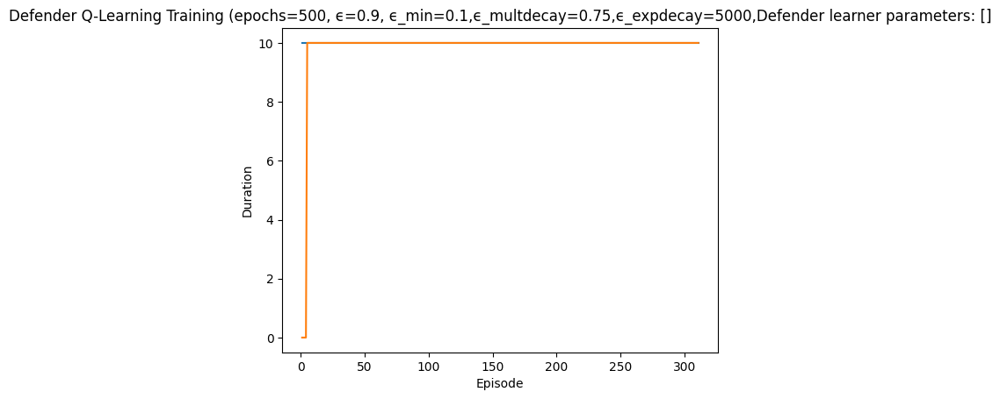

Rendering the current state of the environment
  ## Episode: 312/500 'Defender Q-Learning Training' ϵ=0.3972, Defender learner parameters: []


Episode 312|Iteration 10|reward:   30.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=9, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3111, 'successful_actions': 1249, 'failed_actions': 1862}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3112, 'successful_actions': 1249, 'failed_actions': 1863}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service

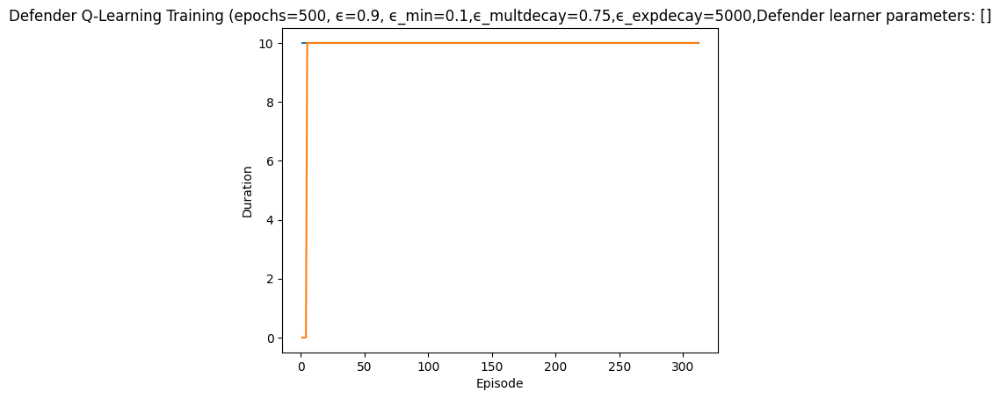

Rendering the current state of the environment
  ## Episode: 313/500 'Defender Q-Learning Training' ϵ=0.3965, Defender learner parameters: []


Episode 313|Iteration 10|reward:  -10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3121, 'successful_actions': 1251, 'failed_actions': 1870}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3122, 'successful_actions': 1251, 'failed_actions': 1871}, 'network_availabi

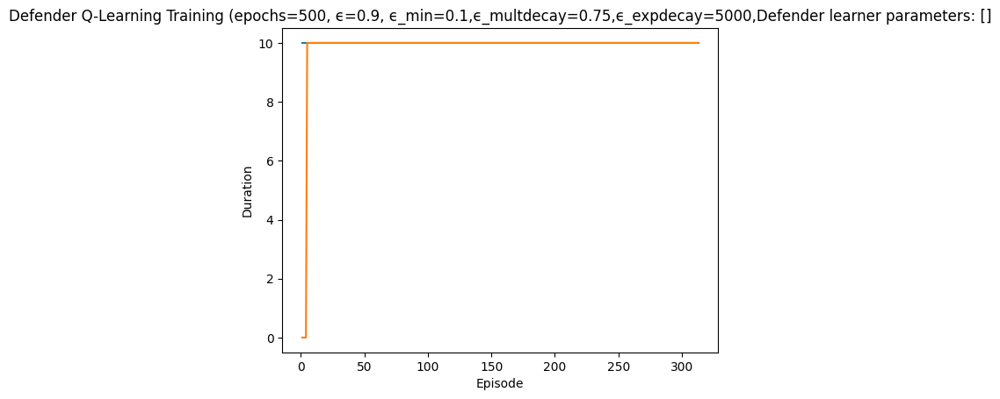

Rendering the current state of the environment
  ## Episode: 314/500 'Defender Q-Learning Training' ϵ=0.3959, Defender learner parameters: []


Episode 314|Iteration 5|reward:   45.0|last_reward_at:    4|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3131, 'successful_actions': 1253, 'failed_actions': 1878}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3132, 'successful_actions': 1254, 'failed_actions': 1878}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=13, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'por

Episode 314|Iteration 7|reward:   55.0|last_reward_at:    6|Elapsed Time: 0:00:00||


info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3136, 'successful_actions': 1257, 'failed_actions': 1879}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 7: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3137, 'successful_actions': 1257, 'failed_actions': 1880}, 'network_availability': 1.0}


Episode 314|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 8: Action Taken: Type=Start Service, NodeID=1, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3138, 'successful_actions': 1257, 'failed_actions': 1881}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 9: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3139, 'successful_actions': 1257, 'failed_actions': 1882}, 'network_availability': 1.0}
action typ

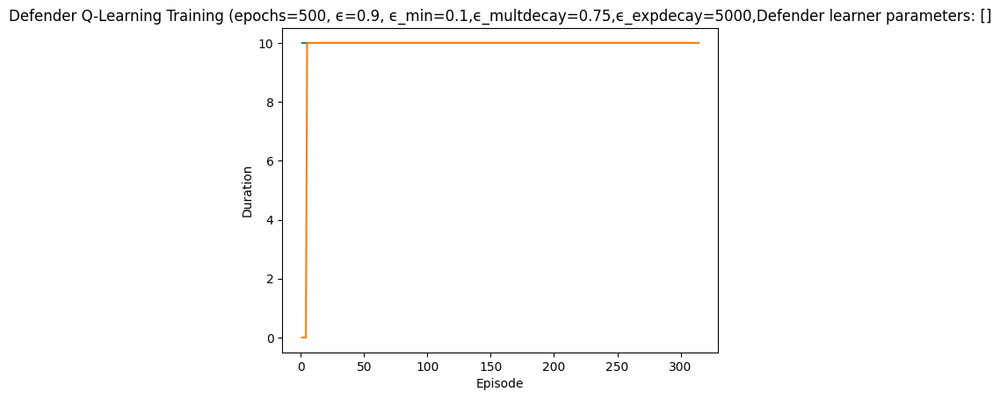

Rendering the current state of the environment
  ## Episode: 315/500 'Defender Q-Learning Training' ϵ=0.3953, Defender learner parameters: []


Episode 315|Iteration 5|reward:   35.0|last_reward_at:    4|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=9, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3141, 'successful_actions': 1258, 'failed_actions': 1883}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3142, 'successful_actions': 1258, 'failed_actions': 1884}, 'network_availability':

Episode 315|Iteration 5|reward:   35.0|last_reward_at:    5|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 6: Action Taken: Type=Start Service, NodeID=2, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3146, 'successful_actions': 1260, 'failed_actions': 1886}, 'network_availability': 1.0}


Episode 315|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 7: Action Taken: Type=Reimage Node, NodeID=1, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3147, 'successful_actions': 1261, 'failed_actions': 1886}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 8: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3148, 'successful_actions': 1261, 'failed_actions': 1887}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 9:

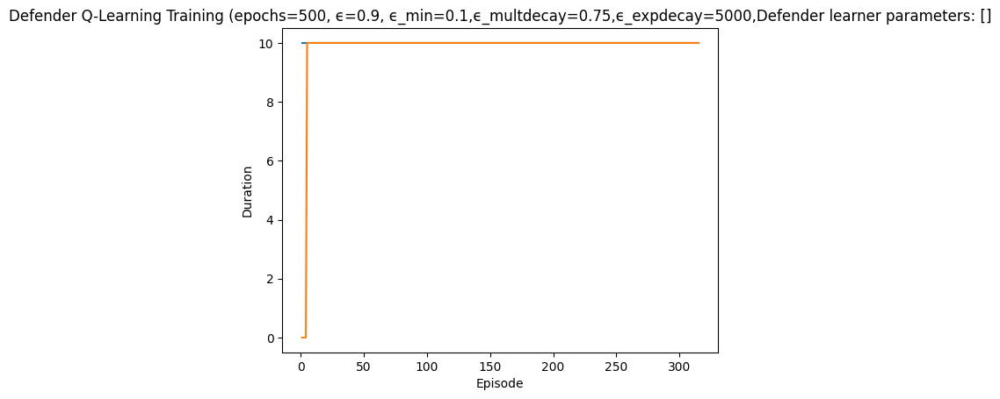

Rendering the current state of the environment
  ## Episode: 316/500 'Defender Q-Learning Training' ϵ=0.3946, Defender learner parameters: []


Episode 316|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3151, 'successful_actions': 1263, 'failed_actions': 1888}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=6, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3152, 'successful_actions': 1263, 'failed_actions': 1889}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3:

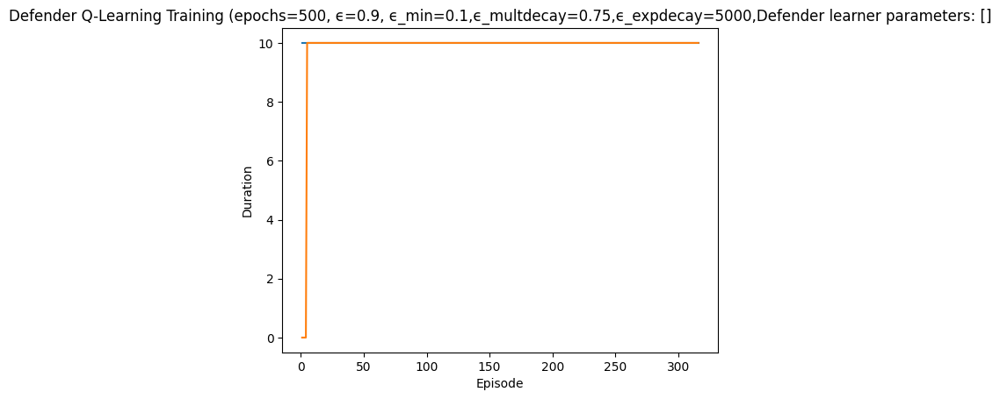

Rendering the current state of the environment
  ## Episode: 317/500 'Defender Q-Learning Training' ϵ=0.3940, Defender learner parameters: []


Episode 317|Iteration 10|reward:    5.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3161, 'successful_actions': 1265, 'failed_actions': 1896}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3162, 'successful_actions': 1265, 'failed_actions': 1897}, 'network

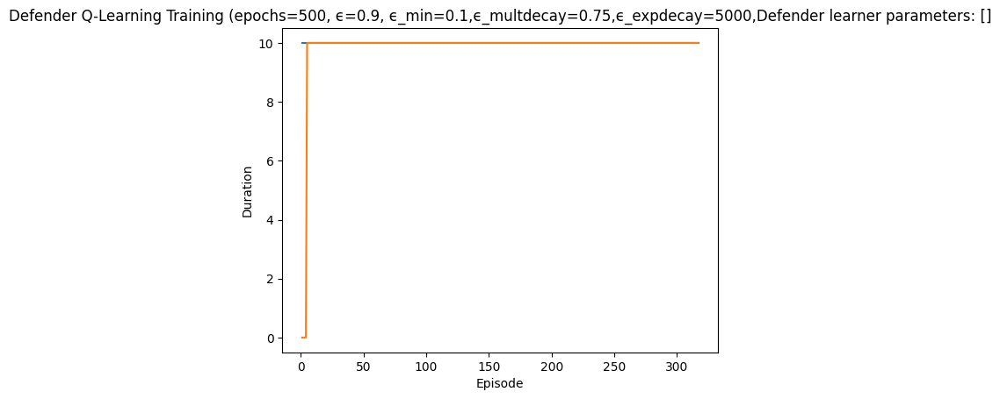

Rendering the current state of the environment
  ## Episode: 318/500 'Defender Q-Learning Training' ϵ=0.3933, Defender learner parameters: []


Episode 318|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=4, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3171, 'successful_actions': 1268, 'failed_actions': 1903}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3172, 'successful_actions': 1269, 'failed_actions': 1903}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 2, 'reason': 'Service not fou

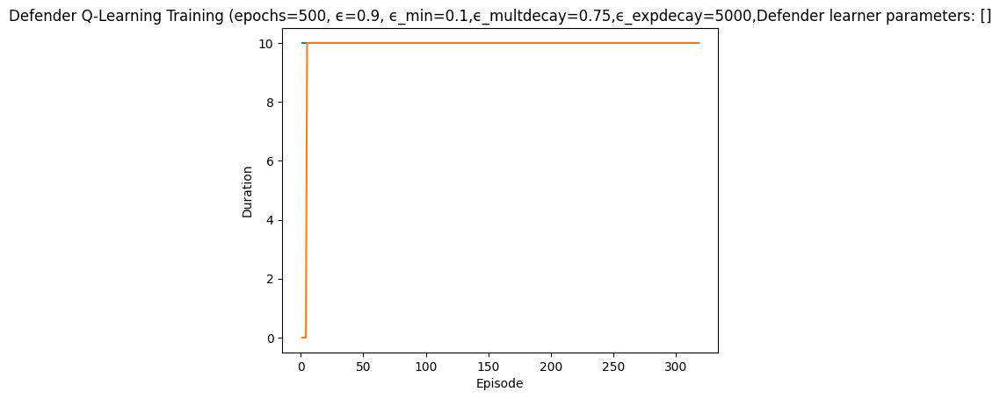

Rendering the current state of the environment
  ## Episode: 319/500 'Defender Q-Learning Training' ϵ=0.3927, Defender learner parameters: []


Episode 319|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=7, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3181, 'successful_actions': 1273, 'failed_actions': 1908}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=10, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3182, 'successful_actions': 1274, 'failed_actions': 1908}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=9, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3183, 'successful_actions': 1275, 'failed_actions': 1908}, 'network_availability': 1.0}
failed
{'action': 'stop_service

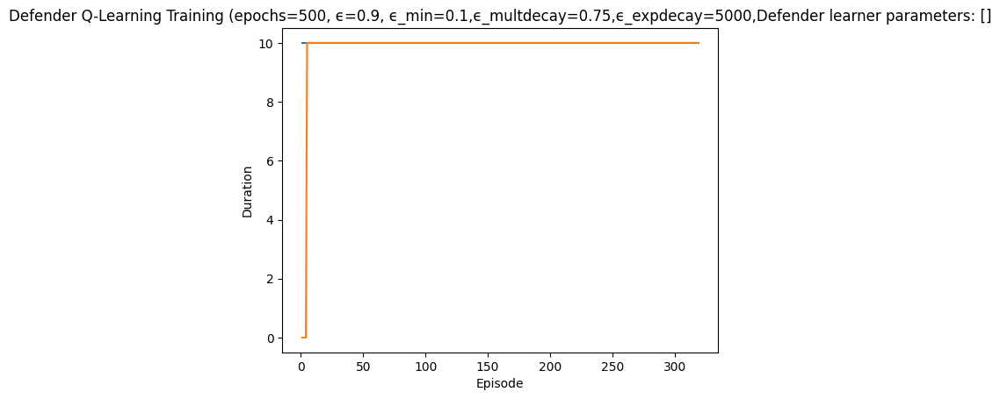

Rendering the current state of the environment
  ## Episode: 320/500 'Defender Q-Learning Training' ϵ=0.3921, Defender learner parameters: []


Episode 320|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=8, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3191, 'successful_actions': 1278, 'failed_actions': 1913}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3192, 'successful_actions': 1278, 'failed_actions': 1914}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=7, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_Window

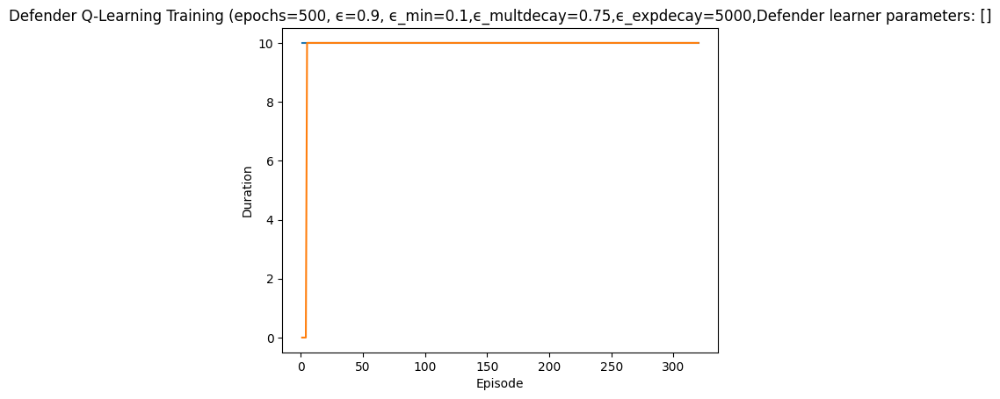

Rendering the current state of the environment
  ## Episode: 321/500 'Defender Q-Learning Training' ϵ=0.3914, Defender learner parameters: []


Episode 321|Iteration 10|reward:   30.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3201, 'successful_actions': 1282, 'failed_actions': 1919}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=12, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3202, 'successful_actions': 1283, 'failed_actions': 1919}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Ite

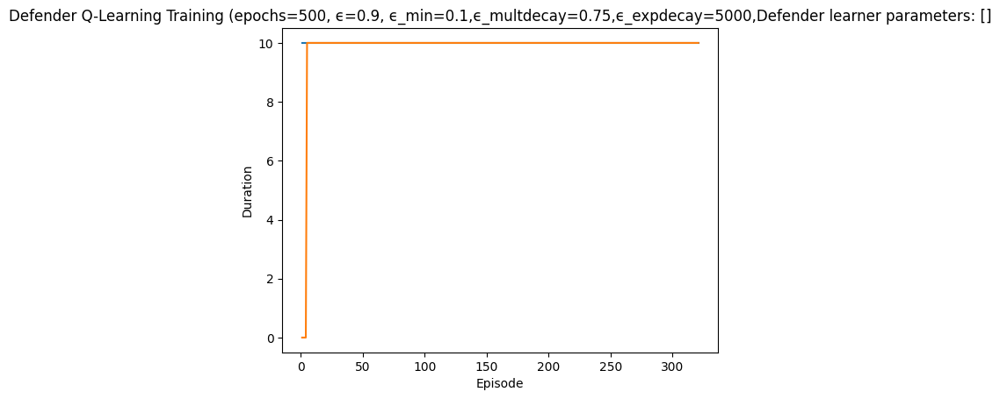

Rendering the current state of the environment
  ## Episode: 322/500 'Defender Q-Learning Training' ϵ=0.3908, Defender learner parameters: []


Episode 322|Iteration 10|reward:   55.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=4, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3211, 'successful_actions': 1286, 'failed_actions': 1925}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3212, 'successful_actions': 1287, 'failed_actions': 1925}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=10, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 3213, 'successful_actions': 1288, 'failed_actions': 1925}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'st

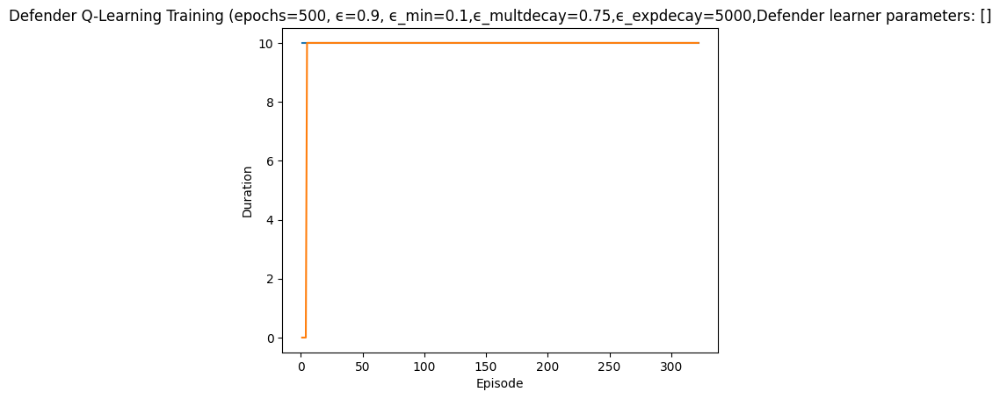

Rendering the current state of the environment
  ## Episode: 323/500 'Defender Q-Learning Training' ϵ=0.3902, Defender learner parameters: []


Episode 323|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3221, 'successful_actions': 1289, 'failed_actions': 1932}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3222, 'successful_actions': 1289, 'failed_actions': 1933}, 'network_availability': 1.0}
action ty

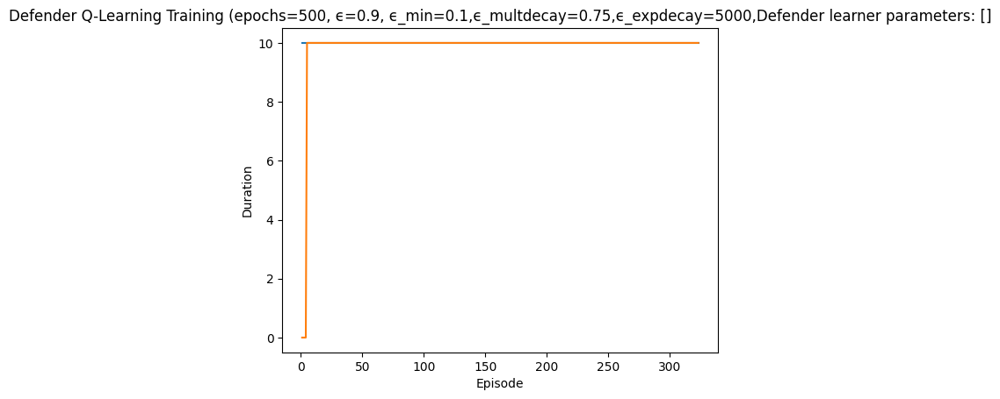

Rendering the current state of the environment
  ## Episode: 324/500 'Defender Q-Learning Training' ϵ=0.3895, Defender learner parameters: []


Episode 324|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3231, 'successful_actions': 1294, 'failed_actions': 1937}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3232, 'successful_actions': 1294, 'failed_actions': 1938}, 'network_availability': 1.0}
action type:  Bloc

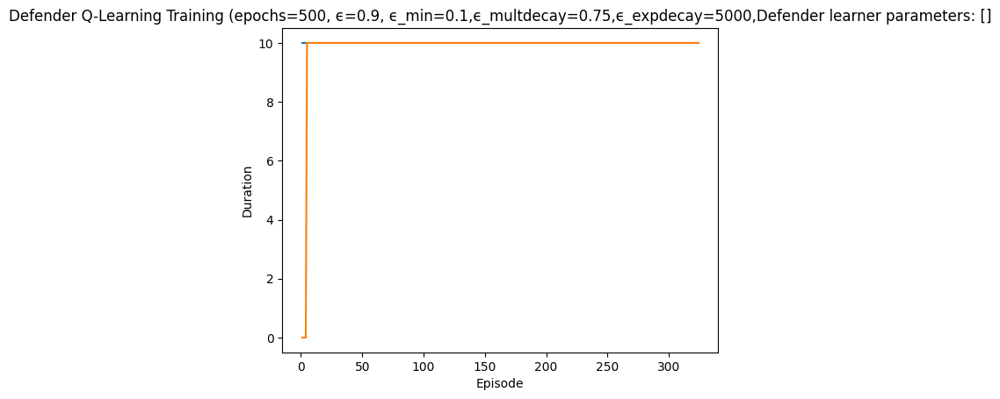

Rendering the current state of the environment
  ## Episode: 325/500 'Defender Q-Learning Training' ϵ=0.3889, Defender learner parameters: []


Episode 325|Iteration 10|reward:  -15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3241, 'successful_actions': 1299, 'failed_actions': 1942}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3242, 'successful_actions': 1299, 'failed_actions': 1943}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Acti

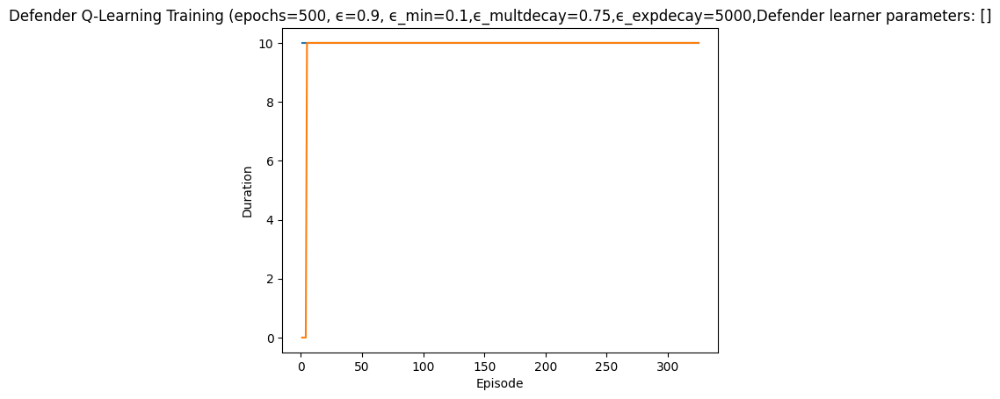

Rendering the current state of the environment
  ## Episode: 326/500 'Defender Q-Learning Training' ϵ=0.3883, Defender learner parameters: []


Episode 326|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3251, 'successful_actions': 1301, 'failed_actions': 1950}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 3252, 'successful_actions': 1302, 'failed_actions': 1950}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: 

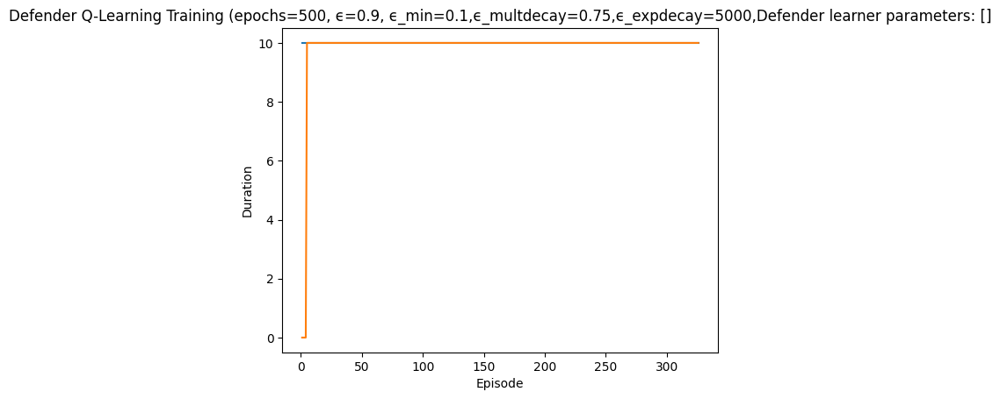

Rendering the current state of the environment
  ## Episode: 327/500 'Defender Q-Learning Training' ϵ=0.3877, Defender learner parameters: []


Episode 327|Iteration 10|reward:   70.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3261, 'successful_actions': 1306, 'failed_actions': 1955}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3262, 'successful_actions': 1307, 'failed_actions': 1955}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage

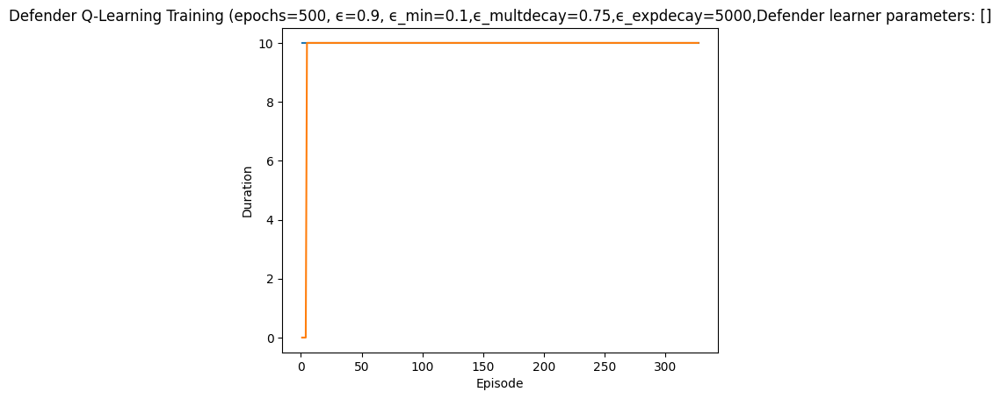

Rendering the current state of the environment
  ## Episode: 328/500 'Defender Q-Learning Training' ϵ=0.3870, Defender learner parameters: []


Episode 328|Iteration 10|reward:   65.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3271, 'successful_actions': 1310, 'failed_actions': 1961}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3272, 'successful_actions': 1311, 'failed_actions': 1961}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
It

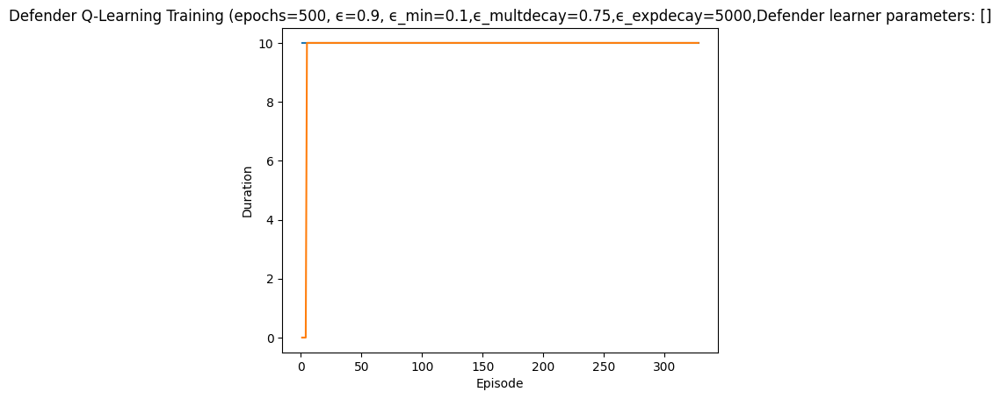

Rendering the current state of the environment
  ## Episode: 329/500 'Defender Q-Learning Training' ϵ=0.3864, Defender learner parameters: []


Episode 329|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3281, 'successful_actions': 1315, 'failed_actions': 1966}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3282, 'successful_actions': 1316, 'failed_actions': 1966}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Ac

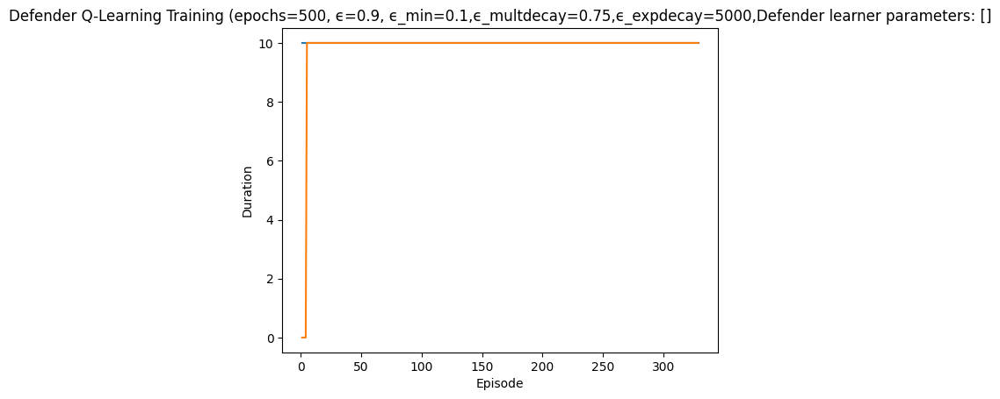

Rendering the current state of the environment
  ## Episode: 330/500 'Defender Q-Learning Training' ϵ=0.3858, Defender learner parameters: []


Episode 330|Iteration 10|reward:  -25.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3291, 'successful_actions': 1320, 'failed_actions': 1971}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3292, 'successful_actions': 1320, 'failed_actions': 1972}, 'network_availability': 1.0}


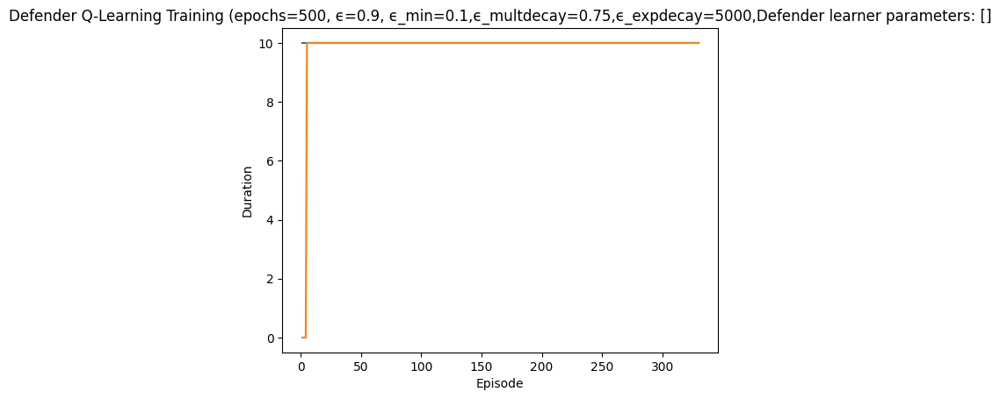

Rendering the current state of the environment
  ## Episode: 331/500 'Defender Q-Learning Training' ϵ=0.3852, Defender learner parameters: []


Episode 331|Iteration 10|reward:  105.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=9, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3301, 'successful_actions': 1322, 'failed_actions': 1979}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=11, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3302, 'successful_actions': 1323, 'failed_actions': 1979}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iterati

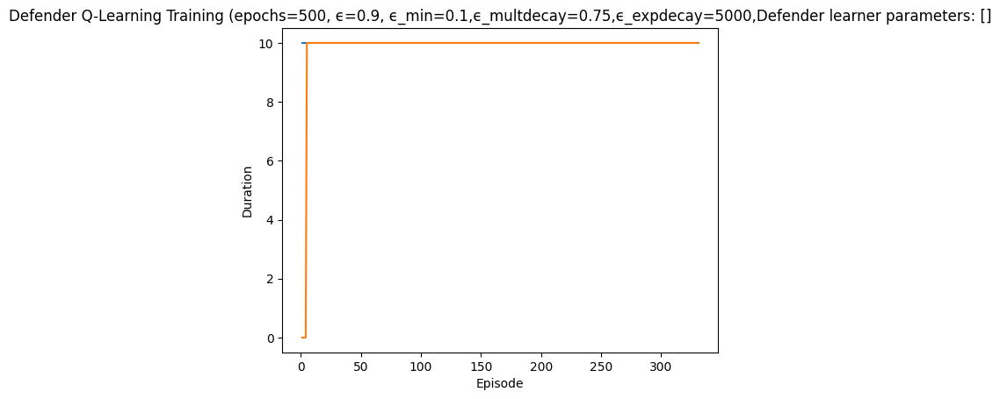

Rendering the current state of the environment
  ## Episode: 332/500 'Defender Q-Learning Training' ϵ=0.3846, Defender learner parameters: []


Episode 332|Iteration 10|reward:   80.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3311, 'successful_actions': 1328, 'failed_actions': 1983}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3312, 'successful_actions': 1328, 'failed_actions': 1984}, 'network_availability': 1.0}

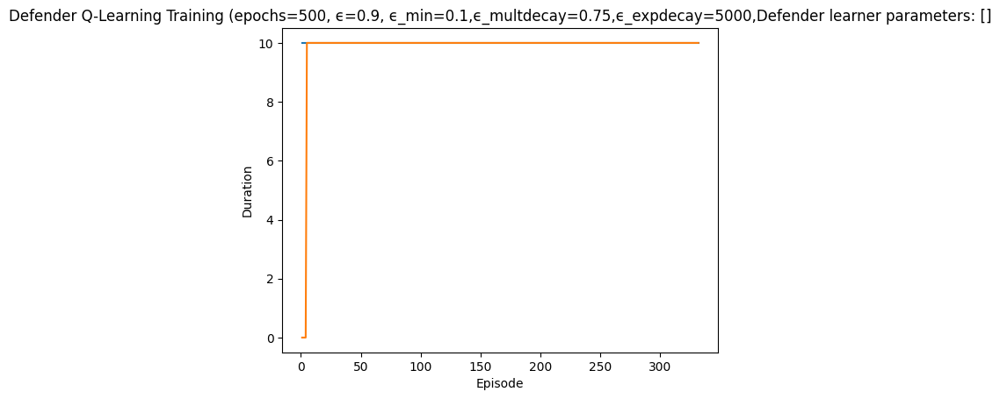

Rendering the current state of the environment
  ## Episode: 333/500 'Defender Q-Learning Training' ϵ=0.3839, Defender learner parameters: []


Episode 333|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=6, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3321, 'successful_actions': 1333, 'failed_actions': 1988}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3322, 'successful_actions': 1334, 'failed_actions': 1988}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=9, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'por

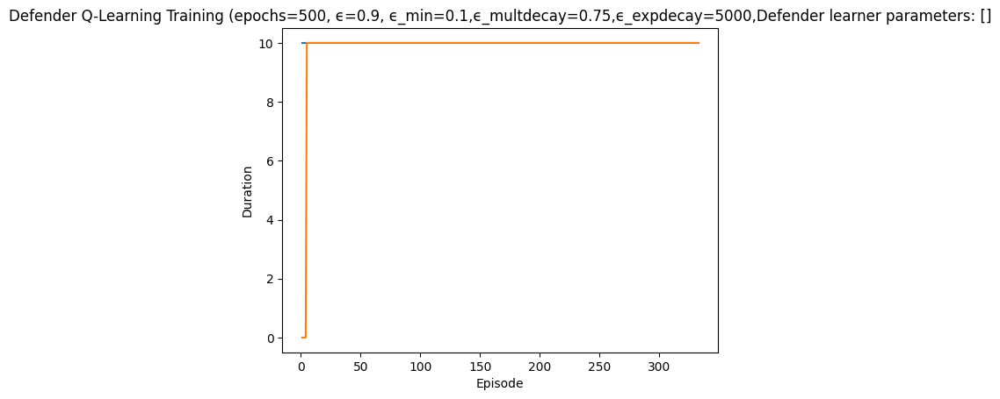

Rendering the current state of the environment
  ## Episode: 334/500 'Defender Q-Learning Training' ϵ=0.3833, Defender learner parameters: []


Episode 334|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3331, 'successful_actions': 1337, 'failed_actions': 1994}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=12, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3332, 'successful_actions': 1338, 'failed_actions': 1994}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3:

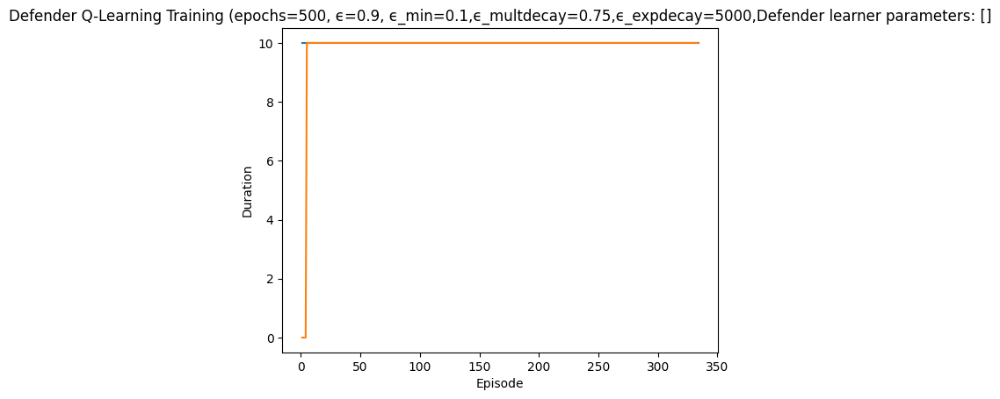

Rendering the current state of the environment
  ## Episode: 335/500 'Defender Q-Learning Training' ϵ=0.3827, Defender learner parameters: []


Episode 335|Iteration 10|reward:  -55.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3341, 'successful_actions': 1340, 'failed_actions': 2001}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=0, Parameter=2
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3342, 'successful_actions': 1340, 'failed_actions': 2002}, 'network_availability': 1.0}
action type:  Reimage No

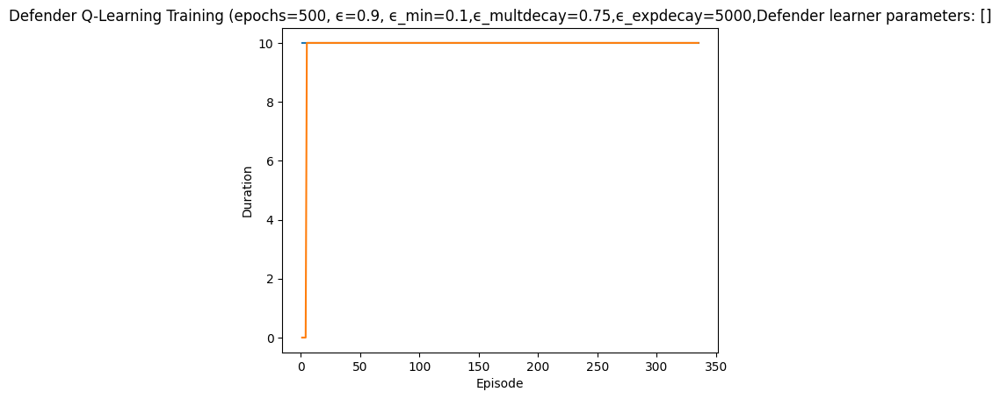

Rendering the current state of the environment
  ## Episode: 336/500 'Defender Q-Learning Training' ϵ=0.3821, Defender learner parameters: []


Episode 336|Iteration 10|reward:   95.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3351, 'successful_actions': 1342, 'failed_actions': 2009}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3352, 'successful_actions': 1342, 'failed_actions': 2010}, 'network_availability': 1.0}


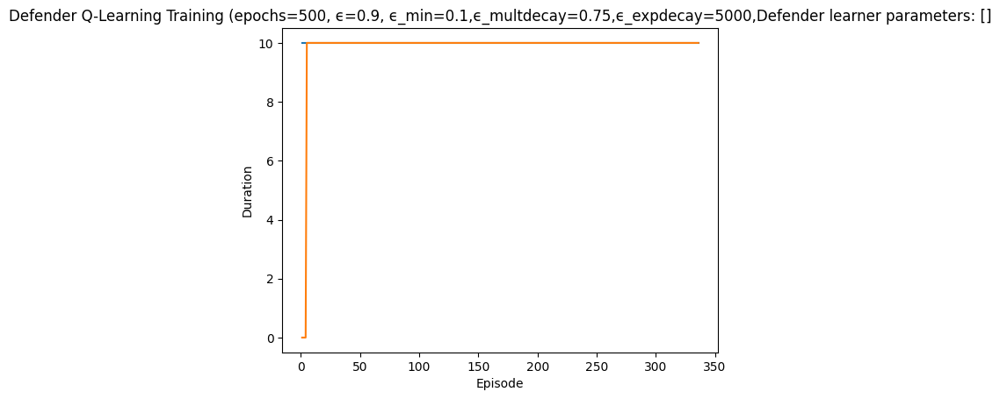

Rendering the current state of the environment
  ## Episode: 337/500 'Defender Q-Learning Training' ϵ=0.3815, Defender learner parameters: []


Episode 337|Iteration 10|reward:   40.0|last_reward_at:    5|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3361, 'successful_actions': 1348, 'failed_actions': 2013}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3362, 'successful_actions': 1348, 'failed_actions': 2014}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=9, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_

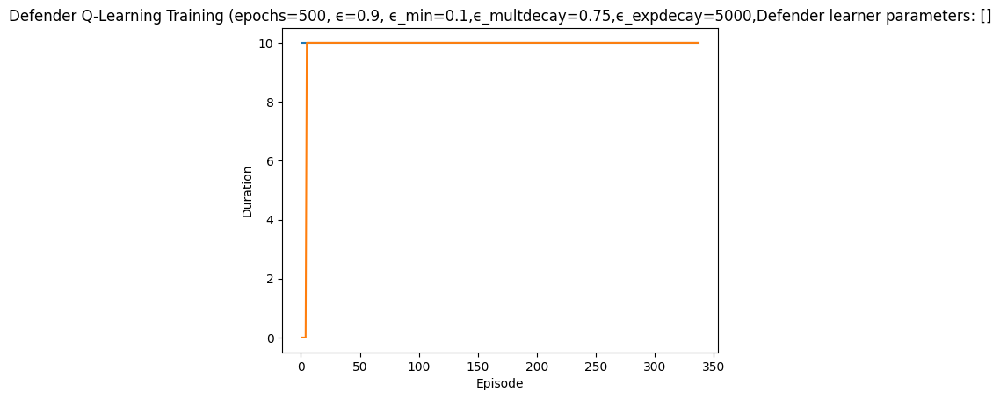

Rendering the current state of the environment
  ## Episode: 338/500 'Defender Q-Learning Training' ϵ=0.3809, Defender learner parameters: []


Episode 338|Iteration 10|reward:  -40.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3371, 'successful_actions': 1351, 'failed_actions': 2020}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3372, 'successful_actions': 1351, 'failed_actions': 2021}, 'network_availability': 1.0}
failed
{'action': 'st

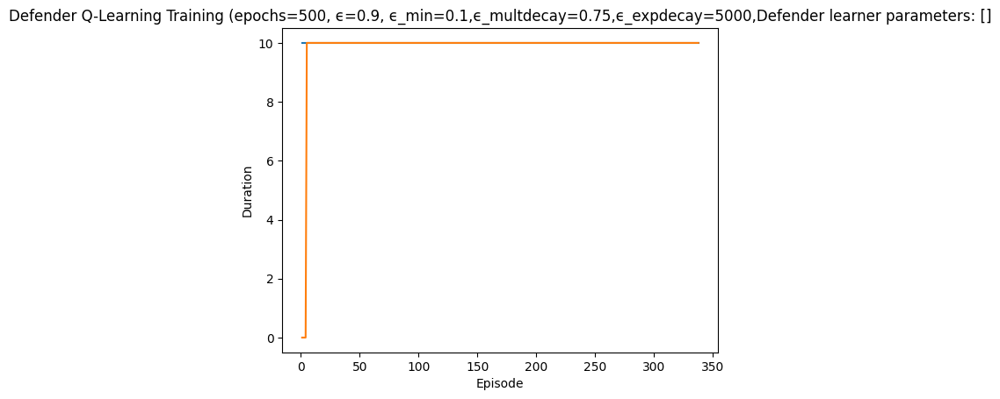

Rendering the current state of the environment
  ## Episode: 339/500 'Defender Q-Learning Training' ϵ=0.3802, Defender learner parameters: []


Episode 339|Iteration 10|reward:  -35.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3381, 'successful_actions': 1353, 'failed_actions': 2028}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=12, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3382, 'successful_actions': 1353, 'failed_actions': 2029}, 'network_availability': 1.0}
failed
{'ac

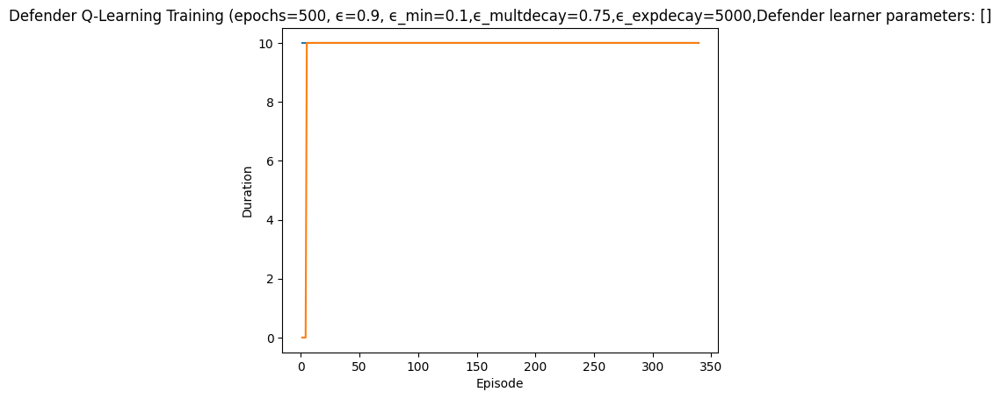

Rendering the current state of the environment
  ## Episode: 340/500 'Defender Q-Learning Training' ϵ=0.3796, Defender learner parameters: []


Episode 340|Iteration 10|reward:   25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=1, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 3391, 'successful_actions': 1355, 'failed_actions': 2036}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3392, 'successful_actions': 1355, 'failed_actions': 2037}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=4, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_nam

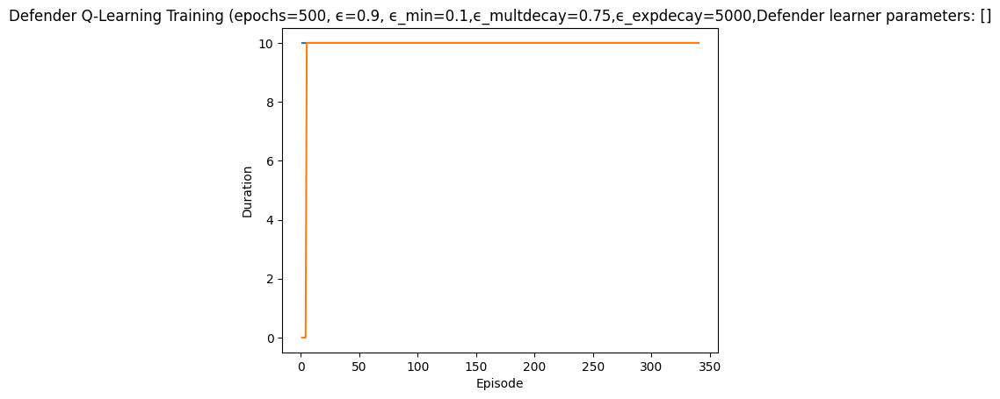

Rendering the current state of the environment
  ## Episode: 341/500 'Defender Q-Learning Training' ϵ=0.3790, Defender learner parameters: []


Episode 341|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=6, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3401, 'successful_actions': 1359, 'failed_actions': 2042}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3402, 'successful_actions': 1359, 'failed_actions': 2043}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=2, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_Linux

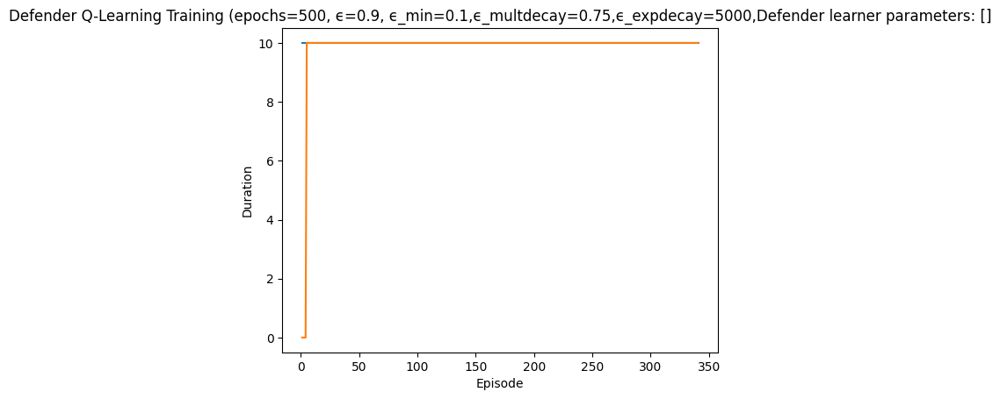

Rendering the current state of the environment
  ## Episode: 342/500 'Defender Q-Learning Training' ϵ=0.3784, Defender learner parameters: []


Episode 342|Iteration 10|reward:  160.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3411, 'successful_actions': 1362, 'failed_actions': 2049}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3412, 'successful_actions': 1363, 'failed_actions': 2049}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=7, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'po

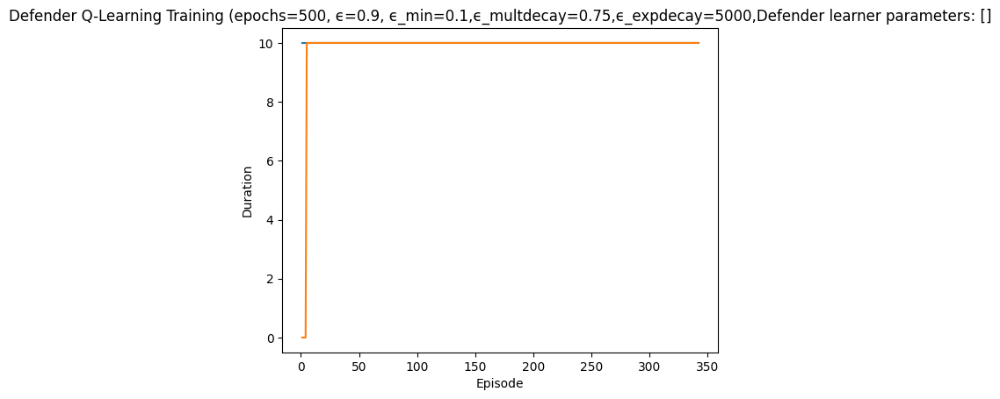

Rendering the current state of the environment
  ## Episode: 343/500 'Defender Q-Learning Training' ϵ=0.3778, Defender learner parameters: []


Episode 343|Iteration 10|reward:   55.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 7, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=7
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 7, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3421, 'successful_actions': 1369, 'failed_actions': 2052}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3422, 'successful_actions': 1369, 'failed_actions': 2053}, 'network_availability': 1.0}
failed
{

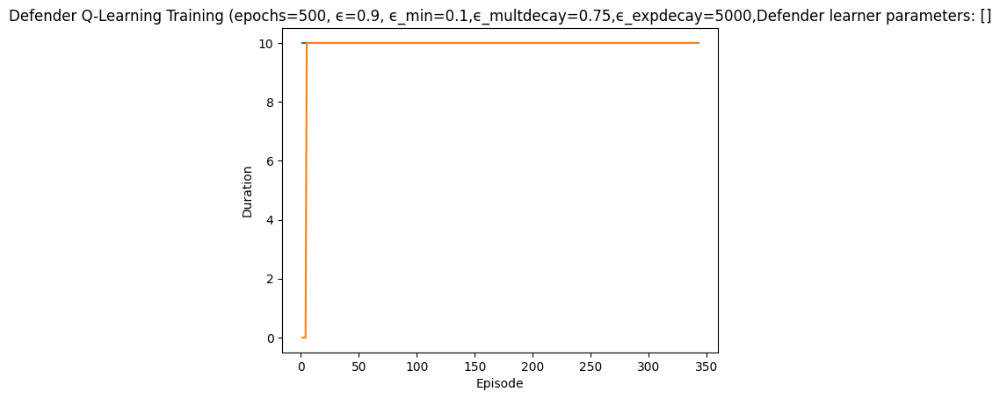

Rendering the current state of the environment
  ## Episode: 344/500 'Defender Q-Learning Training' ϵ=0.3772, Defender learner parameters: []


Episode 344|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=4, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3431, 'successful_actions': 1374, 'failed_actions': 2057}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3432, 'successful_actions': 1374, 'failed_actions': 2058}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteratio

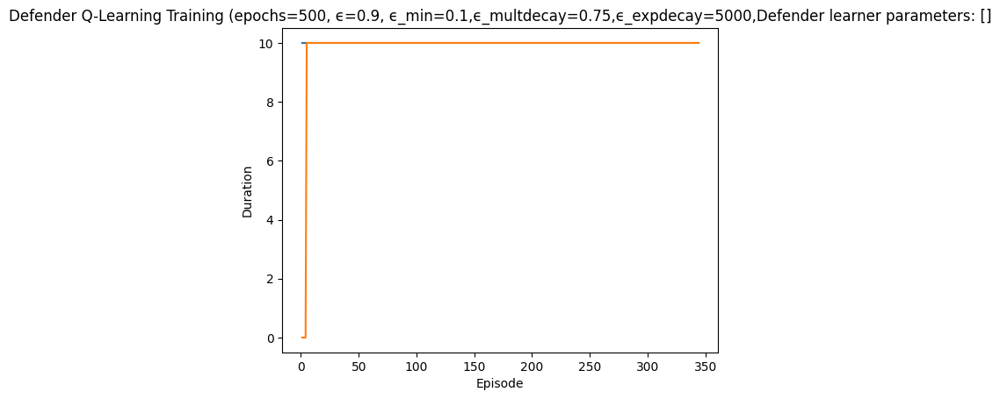

Rendering the current state of the environment
  ## Episode: 345/500 'Defender Q-Learning Training' ϵ=0.3766, Defender learner parameters: []


Episode 345|Iteration 10|reward:  -70.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=0, Parameter=1
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3441, 'successful_actions': 1378, 'failed_actions': 2063}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3442, 'successful_actions': 1378, 'failed_actions': 2064}, 'network_availability': 1.0}
failed
{'action': 'stop_

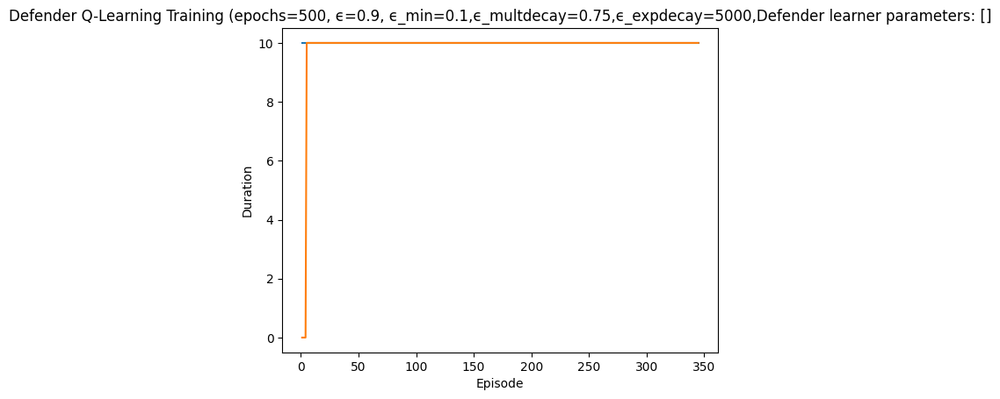

Rendering the current state of the environment
  ## Episode: 346/500 'Defender Q-Learning Training' ϵ=0.3760, Defender learner parameters: []


Episode 346|Iteration 10|reward:   15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3451, 'successful_actions': 1380, 'failed_actions': 2071}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=9, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3452, 'successful_actions': 1380, 'failed_actions': 2072}, 'network_availabilit

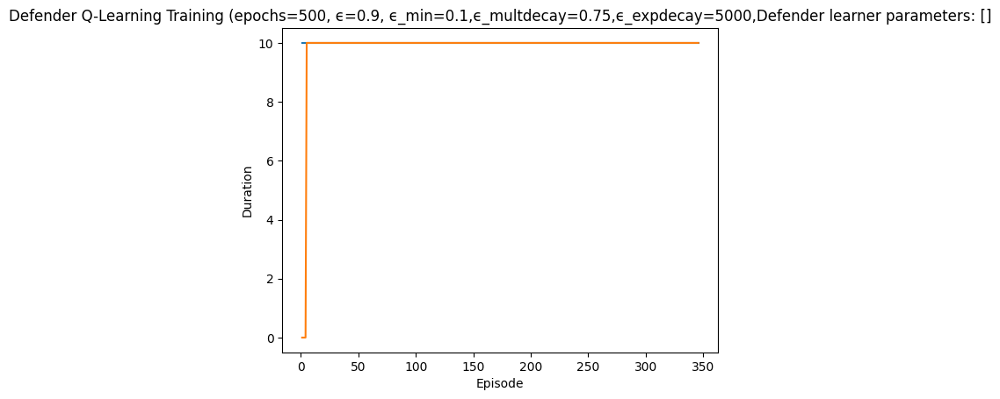

Rendering the current state of the environment
  ## Episode: 347/500 'Defender Q-Learning Training' ϵ=0.3754, Defender learner parameters: []


Episode 347|Iteration 10|reward:   15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3461, 'successful_actions': 1383, 'failed_actions': 2078}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3462, 'successful_actions': 1384, 'failed_actions': 2078}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action

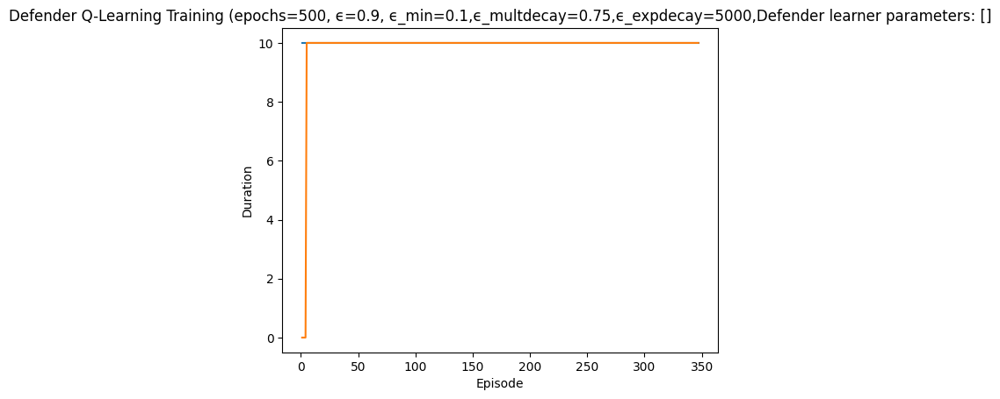

Rendering the current state of the environment
  ## Episode: 348/500 'Defender Q-Learning Training' ϵ=0.3748, Defender learner parameters: []


Episode 348|Iteration 10|reward:  -25.0|last_reward_at:    4|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3471, 'successful_actions': 1387, 'failed_actions': 2084}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3472, 'successful_actions': 1387, 'failed_actions': 2085}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Ite

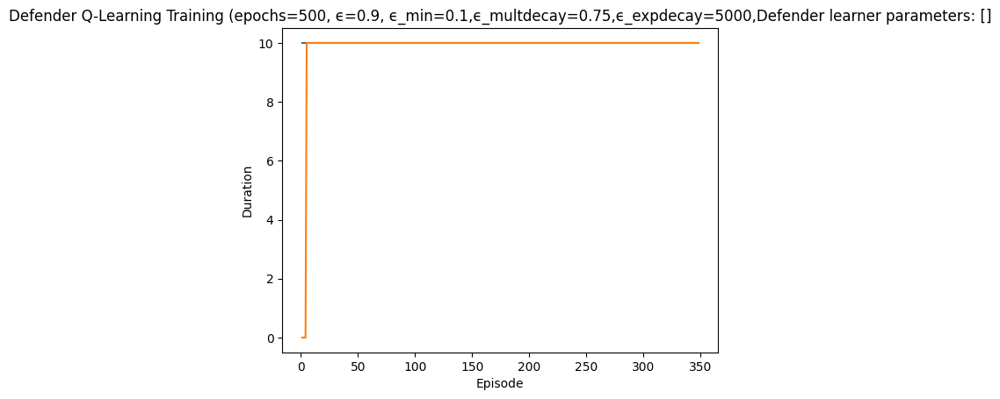

Rendering the current state of the environment
  ## Episode: 349/500 'Defender Q-Learning Training' ϵ=0.3742, Defender learner parameters: []


Episode 349|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3481, 'successful_actions': 1389, 'failed_actions': 2092}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=10, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3482, 'successful_actions': 1389, 'failed_actions': 2093}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 

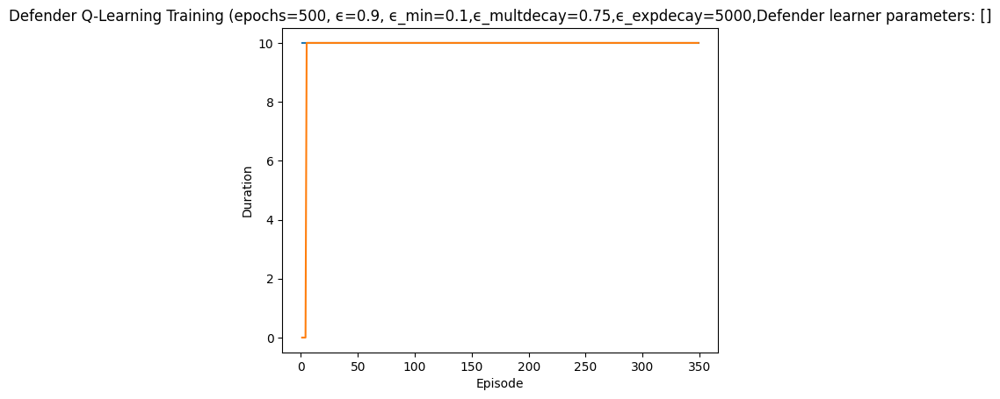

Rendering the current state of the environment
  ## Episode: 350/500 'Defender Q-Learning Training' ϵ=0.3736, Defender learner parameters: []


Episode 350|Iteration 10|reward:    0.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3491, 'successful_actions': 1393, 'failed_actions': 2098}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3492, 'successful_actions': 1393, 'failed_actions': 2099}, 'network_availability': 1.0}
failed
{'a

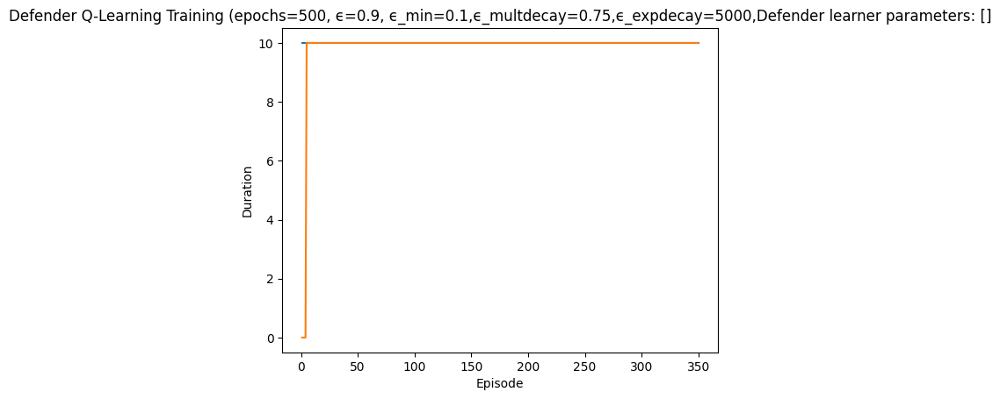

Rendering the current state of the environment
  ## Episode: 351/500 'Defender Q-Learning Training' ϵ=0.3730, Defender learner parameters: []


Episode 351|Iteration 10|reward:  -65.0|last_reward_at:    4|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3501, 'successful_actions': 1396, 'failed_actions': 2105}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3502, 'successful_actions': 1396, 'failed_actions': 2106}, 'network_availability': 1.0}


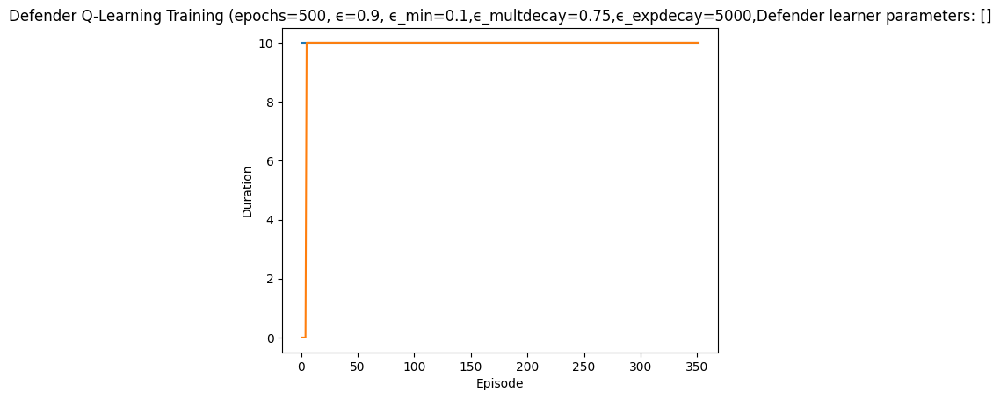

Rendering the current state of the environment
  ## Episode: 352/500 'Defender Q-Learning Training' ϵ=0.3724, Defender learner parameters: []


Episode 352|Iteration 10|reward:  -25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3511, 'successful_actions': 1397, 'failed_actions': 2114}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3512, 'successful_actions': 1397, 'failed_actions': 2115}, 'network_availability': 1.0}
failed
{'action': 

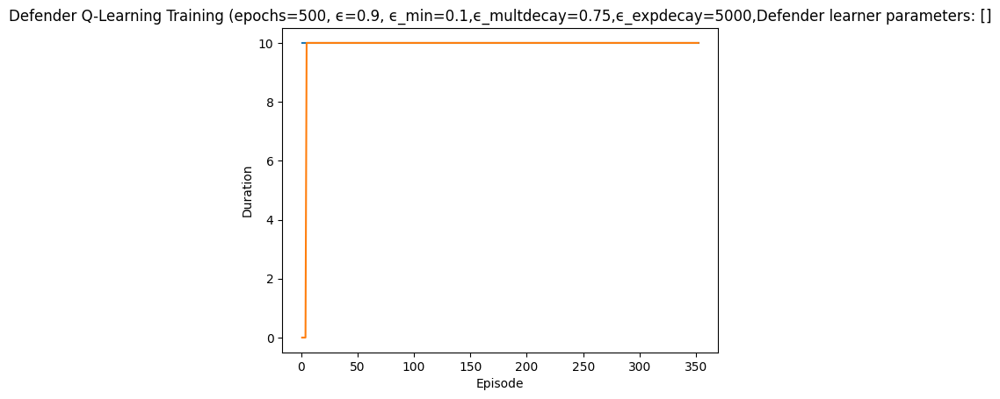

Rendering the current state of the environment
  ## Episode: 353/500 'Defender Q-Learning Training' ϵ=0.3718, Defender learner parameters: []


Episode 353|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3521, 'successful_actions': 1399, 'failed_actions': 2122}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3522, 'successful_actions': 1399, 'failed_actions': 2123}, 'network_availability': 1.0}
action type:  Reim

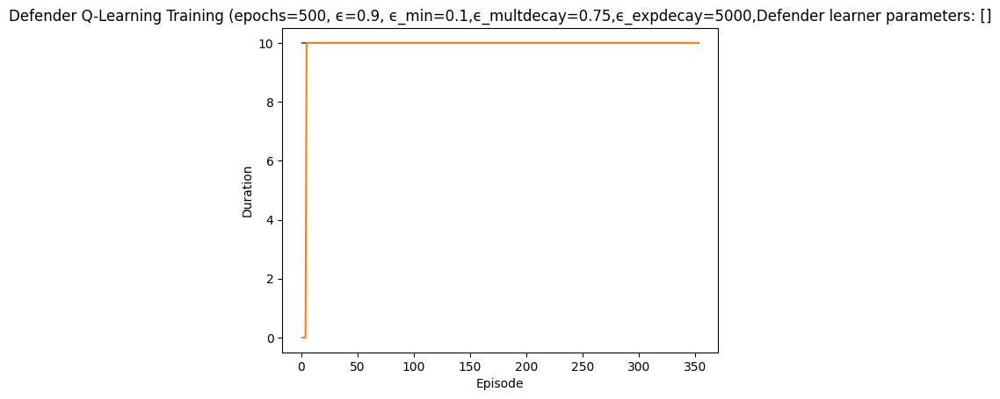

Rendering the current state of the environment
  ## Episode: 354/500 'Defender Q-Learning Training' ϵ=0.3712, Defender learner parameters: []


Episode 354|Iteration 10|reward:  -10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3531, 'successful_actions': 1404, 'failed_actions': 2127}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3532, 'successful_actions': 1404, 'failed_actions': 2128}, 'network_availabili

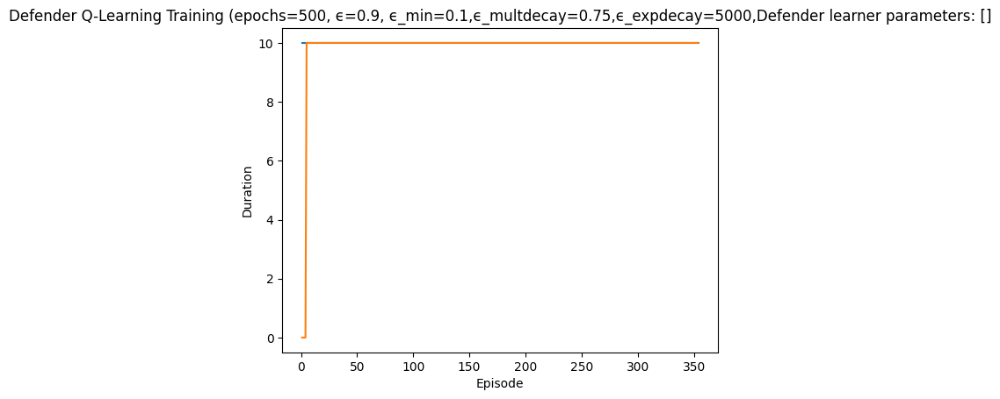

Rendering the current state of the environment
  ## Episode: 355/500 'Defender Q-Learning Training' ϵ=0.3706, Defender learner parameters: []


Episode 355|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=3, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3541, 'successful_actions': 1406, 'failed_actions': 2135}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 3542, 'successful_actions': 1407, 'failed_actions': 2135}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration

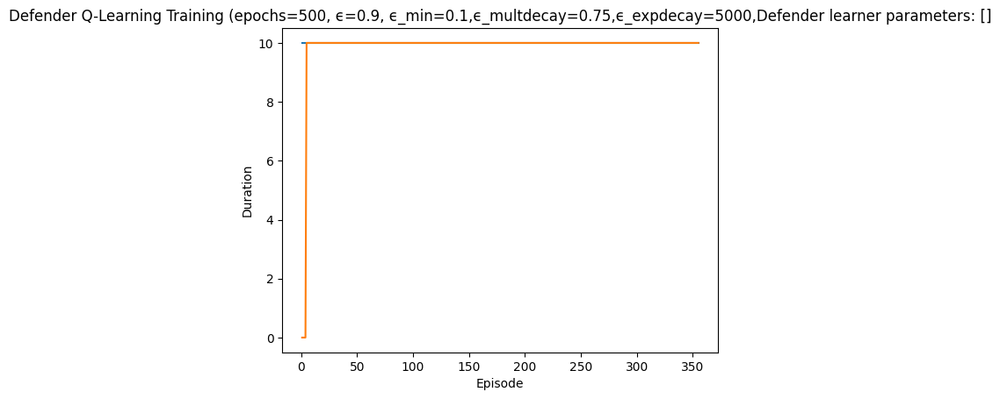

Rendering the current state of the environment
  ## Episode: 356/500 'Defender Q-Learning Training' ϵ=0.3700, Defender learner parameters: []


Episode 356|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3551, 'successful_actions': 1410, 'failed_actions': 2141}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3552, 'successful_actions': 1410, 'failed_actions': 2142}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=6, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name':

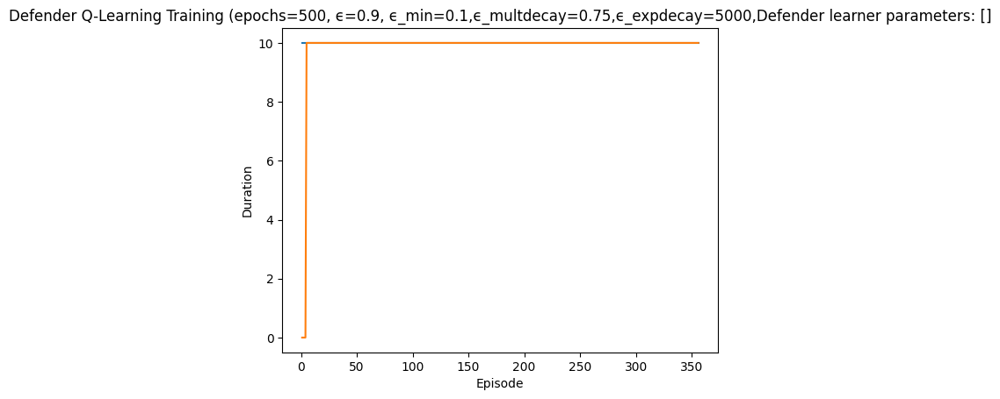

Rendering the current state of the environment
  ## Episode: 357/500 'Defender Q-Learning Training' ϵ=0.3695, Defender learner parameters: []


Episode 357|Iteration 10|reward:   15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=1
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3561, 'successful_actions': 1415, 'failed_actions': 2146}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=13, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3562, 'successful_actions': 1416, 'failed_actions': 2146}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=12, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name':

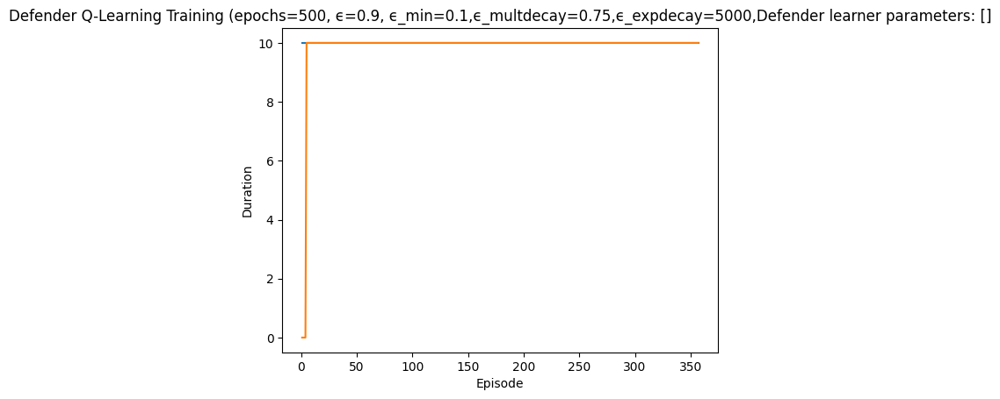

Rendering the current state of the environment
  ## Episode: 358/500 'Defender Q-Learning Training' ϵ=0.3689, Defender learner parameters: []


Episode 358|Iteration 10|reward:  105.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3571, 'successful_actions': 1419, 'failed_actions': 2152}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=13, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3572, 'successful_actions': 1420, 'failed_actions': 2152}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=11, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3573, 'successful_actions': 1421, 'failed_actions': 2152}, 'network_availability': 1.0}
failed
{'action': 'start_servi

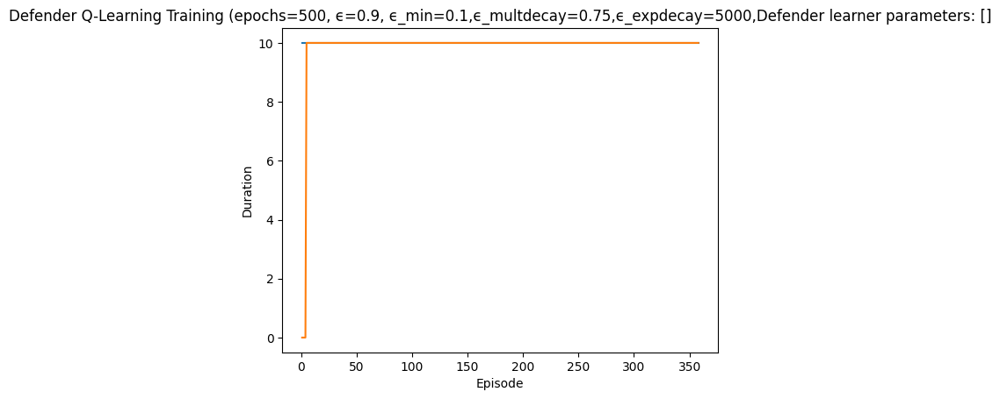

Rendering the current state of the environment
  ## Episode: 359/500 'Defender Q-Learning Training' ϵ=0.3683, Defender learner parameters: []


Episode 359|Iteration 10|reward:  -40.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=7, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3581, 'successful_actions': 1424, 'failed_actions': 2157}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3582, 'successful_actions': 1424, 'failed_actions': 2158}, 'network_availability': 1.0}
faile

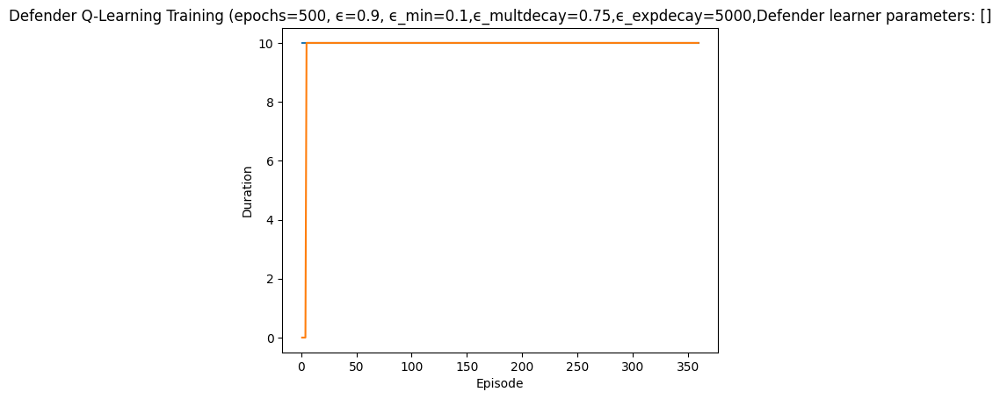

Rendering the current state of the environment
  ## Episode: 360/500 'Defender Q-Learning Training' ϵ=0.3677, Defender learner parameters: []


Episode 360|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3591, 'successful_actions': 1427, 'failed_actions': 2164}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3592, 'successful_actions': 1427, 'failed_actions': 2165}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=10, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxN

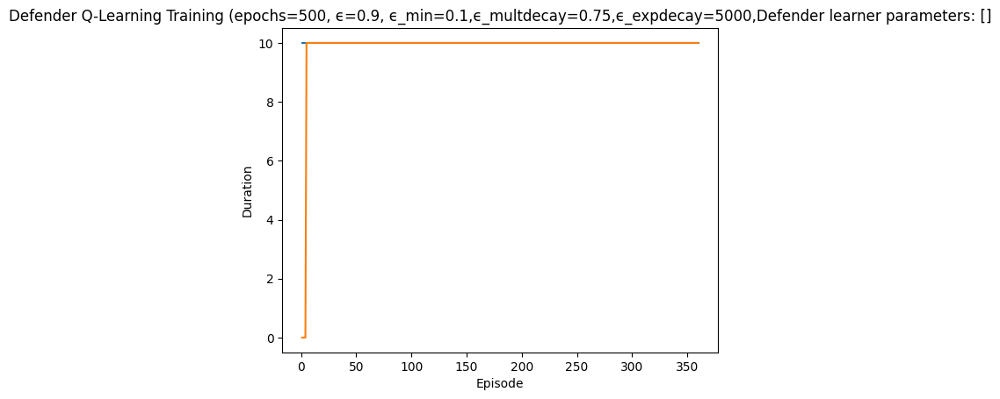

Rendering the current state of the environment
  ## Episode: 361/500 'Defender Q-Learning Training' ϵ=0.3671, Defender learner parameters: []


Episode 361|Iteration 10|reward:   10.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3601, 'successful_actions': 1432, 'failed_actions': 2169}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3602, 'successful_actions': 1433, 'failed_actions': 2169}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Ac

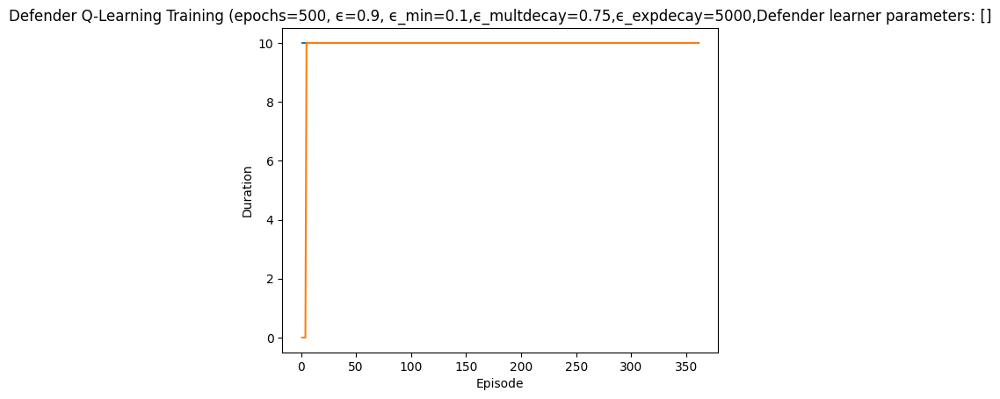

Rendering the current state of the environment
  ## Episode: 362/500 'Defender Q-Learning Training' ϵ=0.3665, Defender learner parameters: []


Episode 362|Iteration 4|reward:  -15.0|last_reward_at: ----|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3611, 'successful_actions': 1436, 'failed_actions': 2175}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3612, 'successful_actions': 1436, 'failed_actions': 2176}, 'network

Episode 362|Iteration 10|reward:  -20.0|last_reward_at:    7|Elapsed Time: 0:00:00||



{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 6: Action Taken: Type=Reimage Node, NodeID=6, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3616, 'successful_actions': 1436, 'failed_actions': 2180}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 7: Action Taken: Type=Block Traffic, NodeID=8, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3617, 'successful_actions': 1437, 'failed_actions': 2180}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Itera

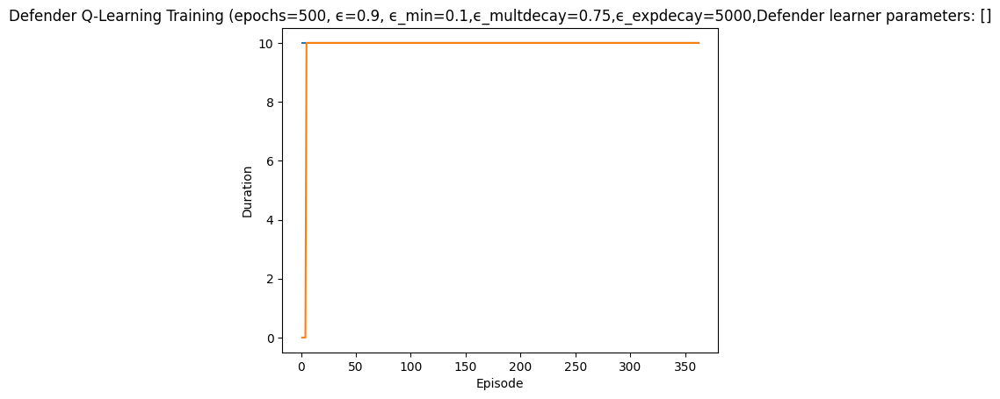

Rendering the current state of the environment
  ## Episode: 363/500 'Defender Q-Learning Training' ϵ=0.3659, Defender learner parameters: []


Episode 363|Iteration 10|reward:   25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3621, 'successful_actions': 1437, 'failed_actions': 2184}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3622, 'successful_actions': 1438, 'failed_actions': 2184}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Ac

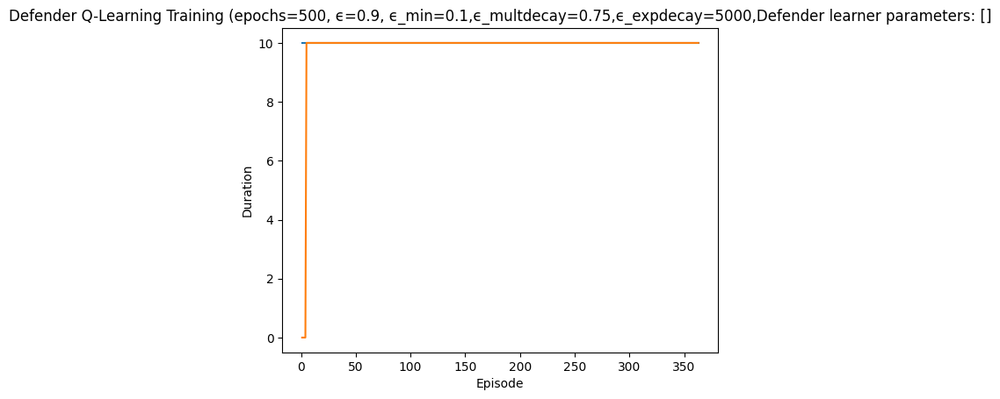

Rendering the current state of the environment
  ## Episode: 364/500 'Defender Q-Learning Training' ϵ=0.3654, Defender learner parameters: []


Episode 364|Iteration 10|reward:   70.0|last_reward_at:    9|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 7, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 7, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3631, 'successful_actions': 1441, 'failed_actions': 2190}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3632, 'successful_actions': 1441, 'failed_actions': 2191}, 'network_availability': 1.0}
action

Episode 364|Iteration 10|reward:   70.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 364 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  Episode 364 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 732
    Blocking Traffic Count: 712
    Stopping Services Count: 0


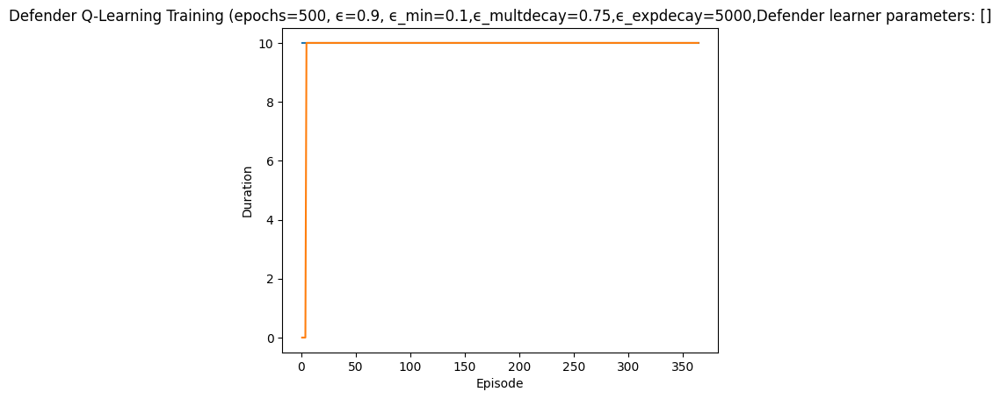

Rendering the current state of the environment
  ## Episode: 365/500 'Defender Q-Learning Training' ϵ=0.3648, Defender learner parameters: []


Episode 365|Iteration 10|reward:   55.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3641, 'successful_actions': 1445, 'failed_actions': 2196}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=12, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3642, 'successful_actions': 1446, 'failed_actions': 2196}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=10, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_Linu

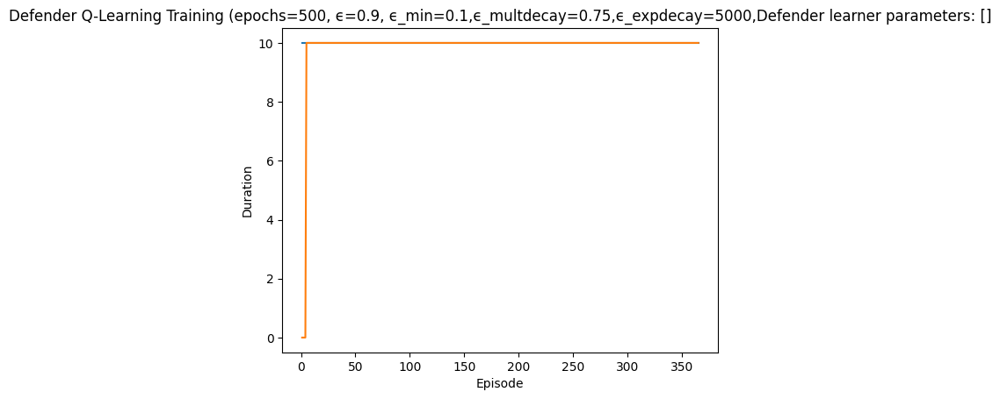

Rendering the current state of the environment
  ## Episode: 366/500 'Defender Q-Learning Training' ϵ=0.3642, Defender learner parameters: []


Episode 366|Iteration 10|reward:   90.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3651, 'successful_actions': 1449, 'failed_actions': 2202}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=9, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3652, 'successful_actions': 1450, 'failed_actions': 2202}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Ac

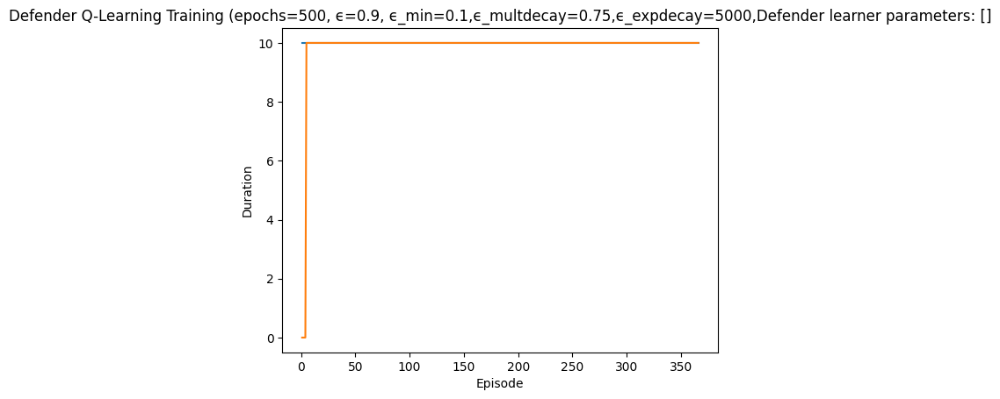

Rendering the current state of the environment
  ## Episode: 367/500 'Defender Q-Learning Training' ϵ=0.3636, Defender learner parameters: []


Episode 367|Iteration 9|reward:   95.0|last_reward_at:    8|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3661, 'successful_actions': 1455, 'failed_actions': 2206}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=7, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3662, 'successful_actions': 1456, 'failed_actions': 2206}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=4, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxN

Episode 367|Iteration 10|reward:  120.0|last_reward_at:    9|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 10: Action Taken: Type=Block Traffic, NodeID=11, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3670, 'successful_actions': 1461, 'failed_actions': 2209}, 'network_availability': 1.0}


Episode 367|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


  Episode 367 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  Episode 367 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 739
    Blocking Traffic Count: 721
    Stopping Services Count: 0


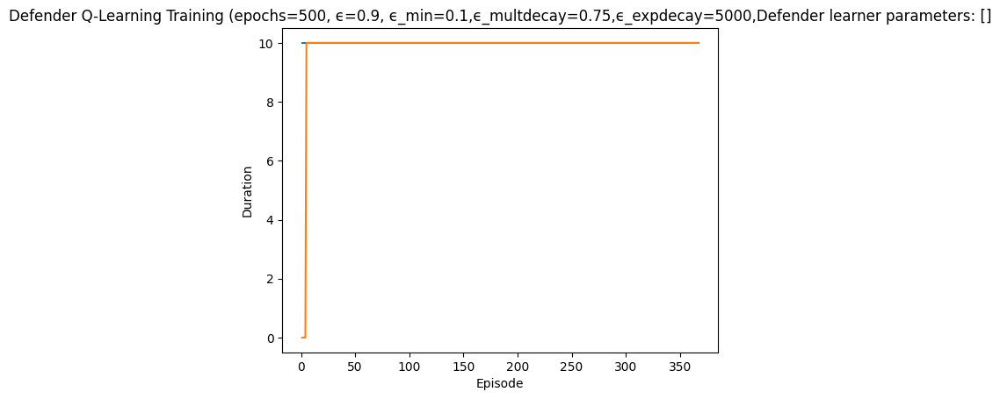

Rendering the current state of the environment
  ## Episode: 368/500 'Defender Q-Learning Training' ϵ=0.3630, Defender learner parameters: []


Episode 368|Iteration 10|reward:  -40.0|last_reward_at:    3|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3671, 'successful_actions': 1461, 'failed_actions': 2210}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3672, 'successful_actions': 1462, 'failed_actions': 2210}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=8, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode'

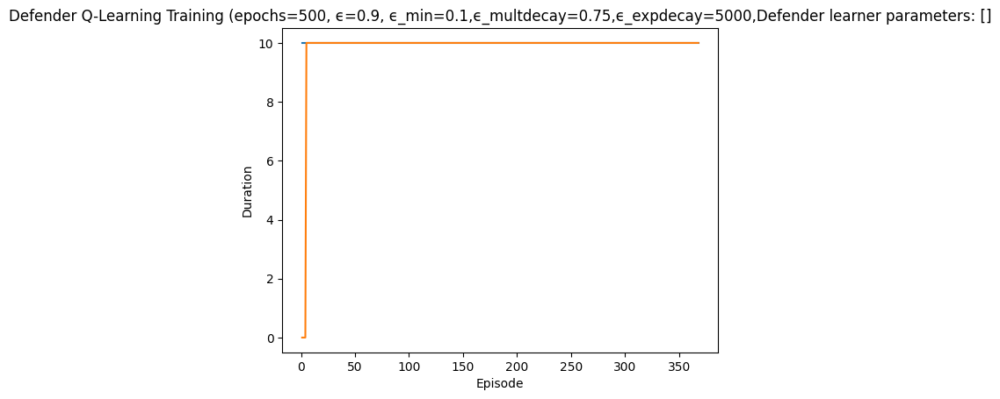

Rendering the current state of the environment
  ## Episode: 369/500 'Defender Q-Learning Training' ϵ=0.3625, Defender learner parameters: []


Episode 369|Iteration 10|reward:  120.0|last_reward_at:    8|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=7, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3681, 'successful_actions': 1464, 'failed_actions': 2217}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=0, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3682, 'successful_actions': 1464, 'failed_actions': 2218}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Ac

Episode 369|Iteration 10|reward:  120.0|last_reward_at:    8|Elapsed Time: 0:00:00||


  Episode 369 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 6
  Episode 369 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 743
    Blocking Traffic Count: 725
    Stopping Services Count: 0


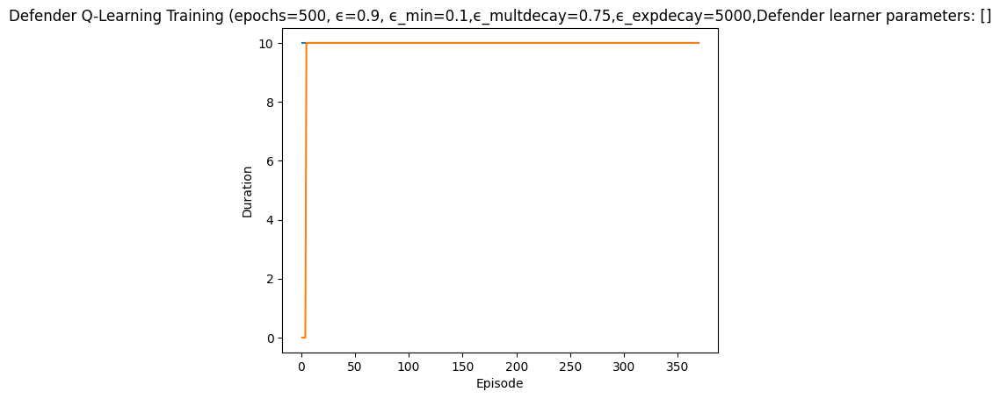

Rendering the current state of the environment
  ## Episode: 370/500 'Defender Q-Learning Training' ϵ=0.3619, Defender learner parameters: []


Episode 370|Iteration 10|reward:   25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3691, 'successful_actions': 1470, 'failed_actions': 2221}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=0, Parameter=5
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3692, 'successful_actions': 1470, 'failed_actions': 2222}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Tak

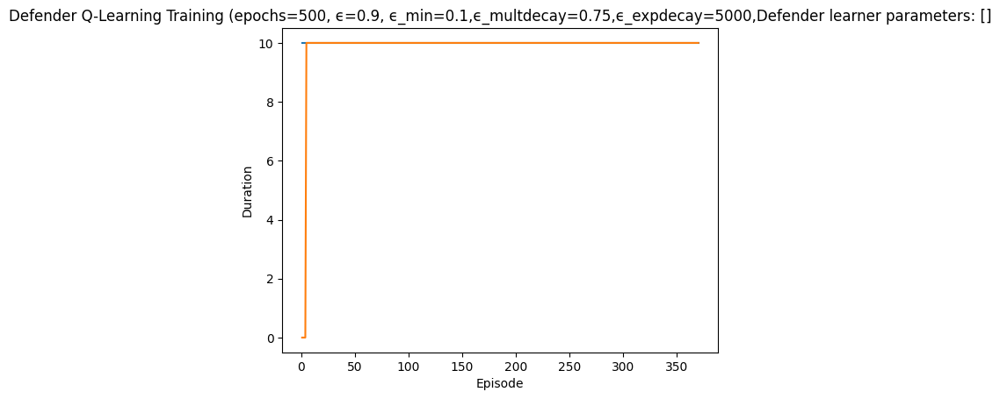

Rendering the current state of the environment
  ## Episode: 371/500 'Defender Q-Learning Training' ϵ=0.3613, Defender learner parameters: []


Episode 371|Iteration 10|reward:  -30.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=9, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3701, 'successful_actions': 1474, 'failed_actions': 2227}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=13, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3702, 'successful_actions': 1474, 'failed_actions': 2228}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iter

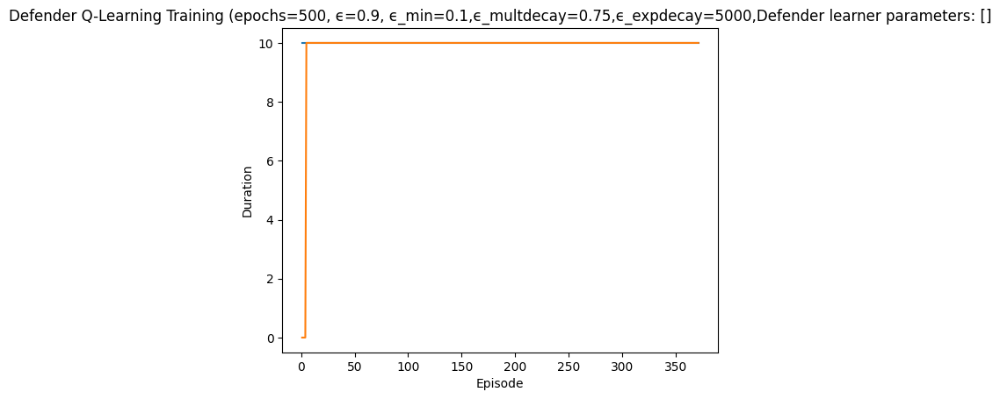

Rendering the current state of the environment
  ## Episode: 372/500 'Defender Q-Learning Training' ϵ=0.3608, Defender learner parameters: []


Episode 372|Iteration 2|reward:   25.0|last_reward_at: ----|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3711, 'successful_actions': 1476, 'failed_actions': 2235}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=12, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3712, 'successful_actions': 1477, 'failed_actions': 2235}, 'network_availability': 1.0}


Episode 372|Iteration 3|reward:   50.0|last_reward_at:    3|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=8, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3713, 'successful_actions': 1478, 'failed_actions': 2235}, 'network_availability': 1.0}


Episode 372|Iteration 10|reward:   80.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 4: Action Taken: Type=Reimage Node, NodeID=6, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3714, 'successful_actions': 1479, 'failed_actions': 2235}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 5: Action Taken: Type=Reimage Node, NodeID=5, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3715, 'successful_actions': 1480, 'failed_actions': 2235}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 6: Action Taken: Type=Start Service, NodeID=1, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 5, 'reason': 'Service not 

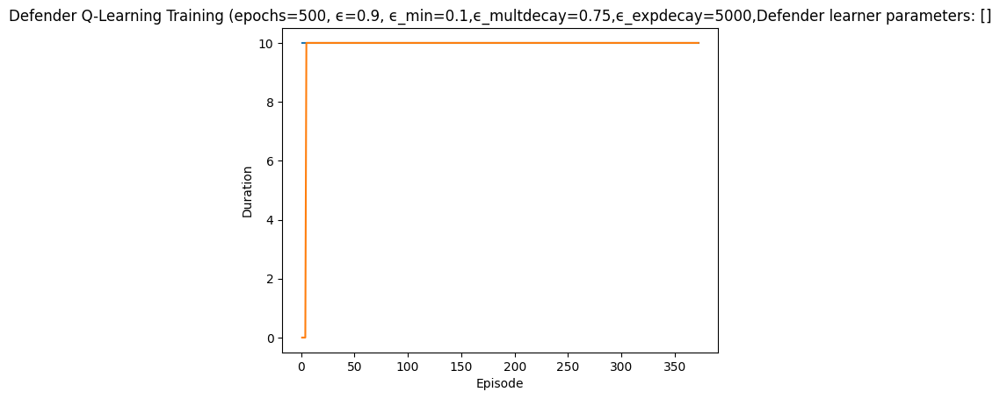

Rendering the current state of the environment
  ## Episode: 373/500 'Defender Q-Learning Training' ϵ=0.3602, Defender learner parameters: []


Episode 373|Iteration 1|reward:   25.0|last_reward_at: ----|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 3721, 'successful_actions': 1482, 'failed_actions': 2239}, 'network_availability': 1.0}


Episode 373|Iteration 3|reward:   35.0|last_reward_at:    1|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=11, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3722, 'successful_actions': 1482, 'failed_actions': 2240}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=13, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3723, 'successful_actions': 1483, 'failed_actions': 2240}, 'network_availability': 1.0}


Episode 373|Iteration 4|reward:   20.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 4: Action Taken: Type=Start Service, NodeID=7, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3724, 'successful_actions': 1483, 'failed_actions': 2241}, 'network_availability': 1.0}


Episode 373|Iteration 10|reward:   50.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 5: Action Taken: Type=Start Service, NodeID=12, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3725, 'successful_actions': 1483, 'failed_actions': 2242}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 6: Action Taken: Type=Start Service, NodeID=8, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3726, 'successful_actions': 1483, 'failed_actions': 2243}, 'network_availability': 1.0}
action type

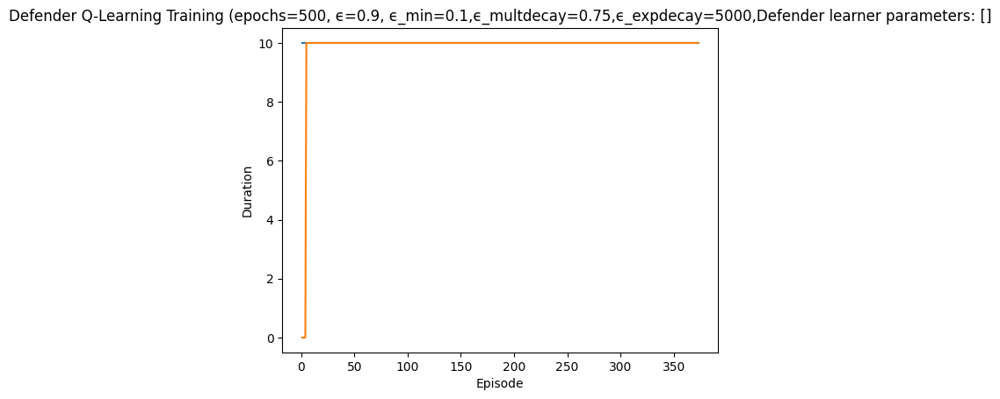

Rendering the current state of the environment
  ## Episode: 374/500 'Defender Q-Learning Training' ϵ=0.3596, Defender learner parameters: []


Episode 374|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3731, 'successful_actions': 1486, 'failed_actions': 2245}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3732, 'successful_actions': 1487, 'failed_actions': 2245}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: 

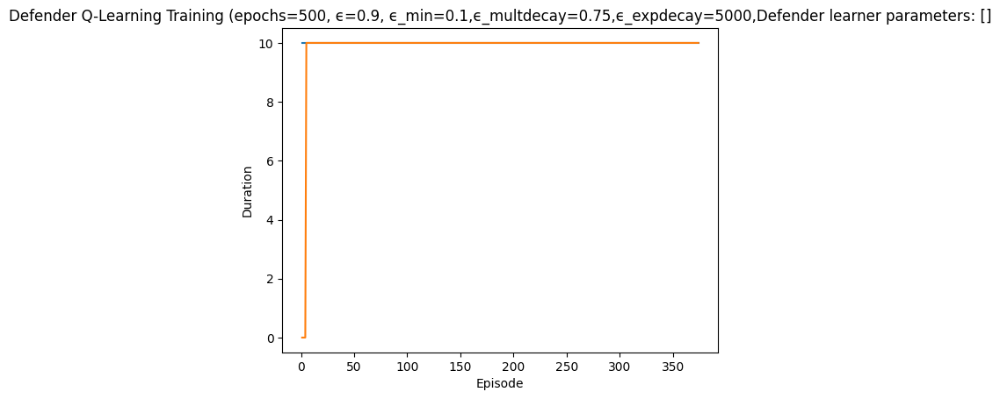

Rendering the current state of the environment
  ## Episode: 375/500 'Defender Q-Learning Training' ϵ=0.3590, Defender learner parameters: []


Episode 375|Iteration 0|reward: ------|last_reward_at: ----|Elapsed Time: 0:00:00||

action type: 

Episode 375|Iteration 10|reward:  -15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


 Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3741, 'successful_actions': 1492, 'failed_actions': 2249}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 0, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=0, Parameter=0
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 0, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3742, 'successful_actions': 1492, 'failed_actions': 2250}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=8, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 6, 'performance_me

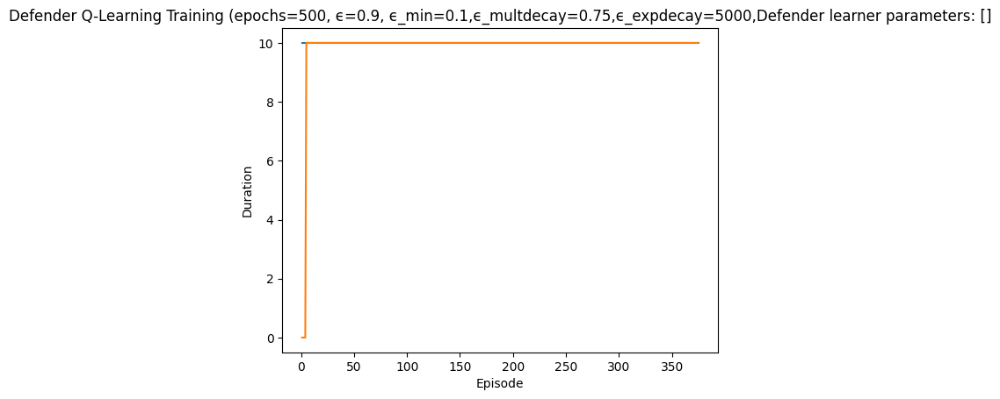

Rendering the current state of the environment
  ## Episode: 376/500 'Defender Q-Learning Training' ϵ=0.3585, Defender learner parameters: []


Episode 376|Iteration 10|reward:  -55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3751, 'successful_actions': 1494, 'failed_actions': 2257}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3752, 'successful_actions': 1494, 'failed_actions': 2258}, 'network_availability': 1.0}
failed
{'a

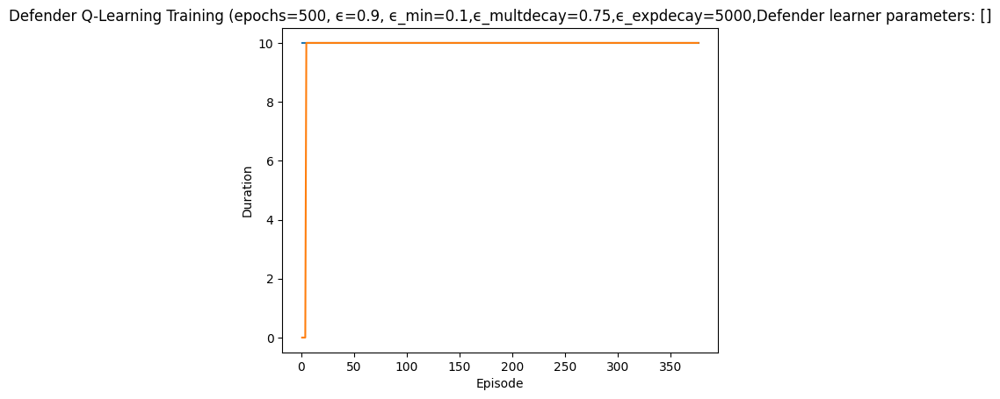

Rendering the current state of the environment
  ## Episode: 377/500 'Defender Q-Learning Training' ϵ=0.3579, Defender learner parameters: []


Episode 377|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3761, 'successful_actions': 1497, 'failed_actions': 2264}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3762, 'successful_actions': 1497, 'failed_actions': 2265}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=3, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_na

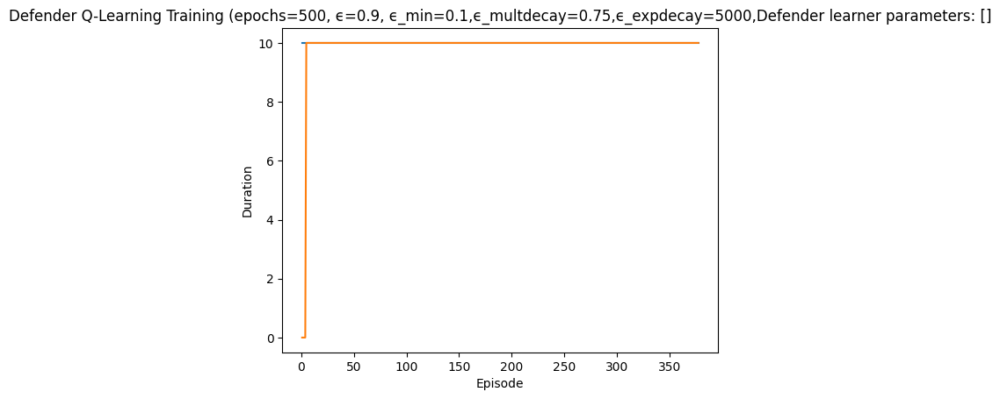

Rendering the current state of the environment
  ## Episode: 378/500 'Defender Q-Learning Training' ϵ=0.3573, Defender learner parameters: []


Episode 378|Iteration 10|reward:  -25.0|last_reward_at:    5|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3771, 'successful_actions': 1501, 'failed_actions': 2270}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=0, Parameter=3
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3772, 'successful_actions': 1501, 'failed_actions': 2271}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action

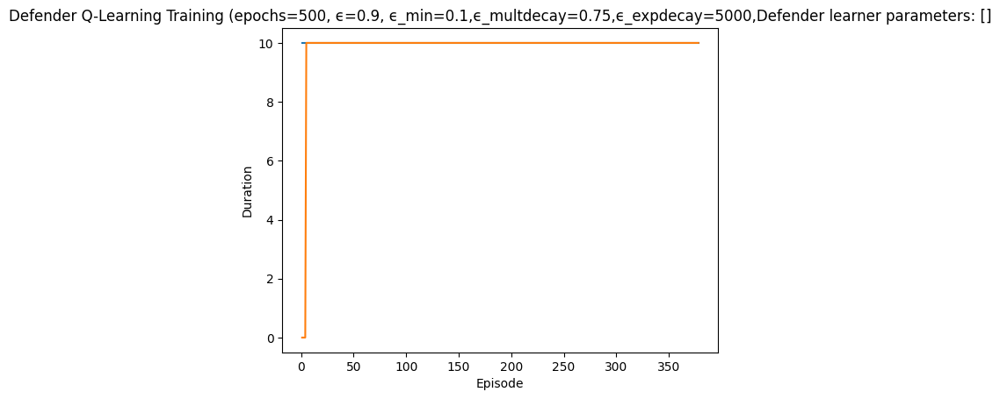

Rendering the current state of the environment
  ## Episode: 379/500 'Defender Q-Learning Training' ϵ=0.3568, Defender learner parameters: []


Episode 379|Iteration 8|reward:   55.0|last_reward_at:    8|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3781, 'successful_actions': 1502, 'failed_actions': 2279}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=9, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3782, 'successful_actions': 1502, 'failed_actions': 2280}, 'network_availability': 1.0}
failed
{

Episode 379|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 9: Action Taken: Type=Start Service, NodeID=11, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3789, 'successful_actions': 1506, 'failed_actions': 2283}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=11, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3790, 'successful_actions': 1506, 'failed_actions': 2284}, 'network_availability':

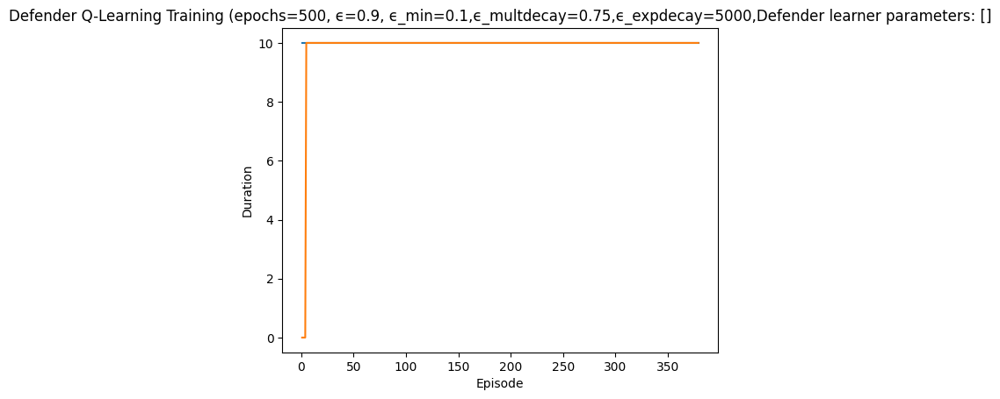

Rendering the current state of the environment
  ## Episode: 380/500 'Defender Q-Learning Training' ϵ=0.3562, Defender learner parameters: []


Episode 380|Iteration 2|reward:  -30.0|last_reward_at: ----|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3791, 'successful_actions': 1506, 'failed_actions': 2285}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3792, 'successful_actions': 1506, 'failed_actions': 2286}, 'network_availability': 1.0}


Episode 380|Iteration 4|reward:   -5.0|last_reward_at: ----|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=10, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3793, 'successful_actions': 1506, 'failed_actions': 2287}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 4: Action Taken: Type=Block Traffic, NodeID=11, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3794, 'successful_actions': 1507, 'failed_actions': 2287}, 'network_availability': 1.0}


Episode 380|Iteration 10|reward:  -25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 5: Action Taken: Type=Reimage Node, NodeID=2, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3795, 'successful_actions': 1507, 'failed_actions': 2288}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 6: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3796, 'successful_actions': 1507, 'failed_actions': 2289}, 'network_availability': 1.0}


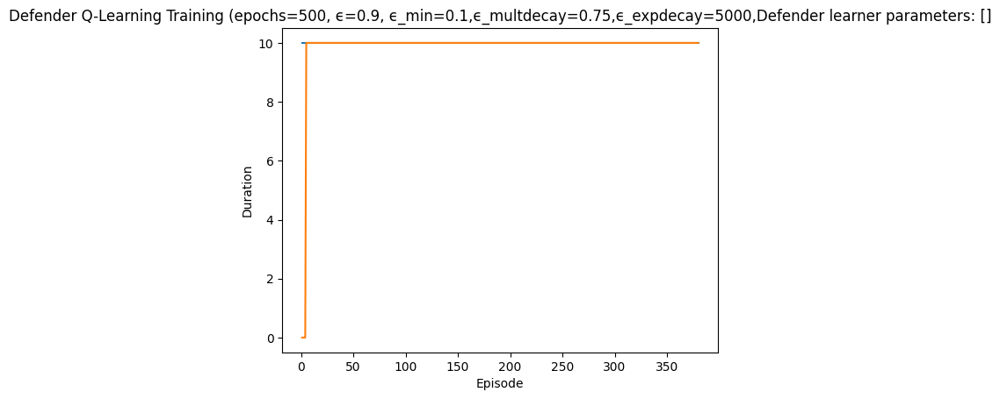

Rendering the current state of the environment
  ## Episode: 381/500 'Defender Q-Learning Training' ϵ=0.3557, Defender learner parameters: []


Episode 381|Iteration 2|reward:   25.0|last_reward_at: ----|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3801, 'successful_actions': 1508, 'failed_actions': 2293}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3802, 'successful_actions': 1509, 'failed_actions': 2293}, 'network_availability': 1.0}


Episode 381|Iteration 3|reward:   10.0|last_reward_at:    2|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=1, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3803, 'successful_actions': 1509, 'failed_actions': 2294}, 'network_availability': 1.0}


Episode 381|Iteration 5|reward:   35.0|last_reward_at:    5|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 4: Action Taken: Type=Reimage Node, NodeID=2, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3804, 'successful_actions': 1509, 'failed_actions': 2295}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 5: Action Taken: Type=Block Traffic, NodeID=11, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3805, 'successful_actions': 1510, 'failed_actions': 2295}, 'network_availability': 1.0}


Episode 381|Iteration 10|reward:   80.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 6: Action Taken: Type=Reimage Node, NodeID=8, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3806, 'successful_actions': 1511, 'failed_actions': 2295}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 7: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3807, 'successful_actions': 1512, 'failed_actions': 2295}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 8: Action Taken: Type=Reimage Node, NodeID=0, Parameter=6
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'perf

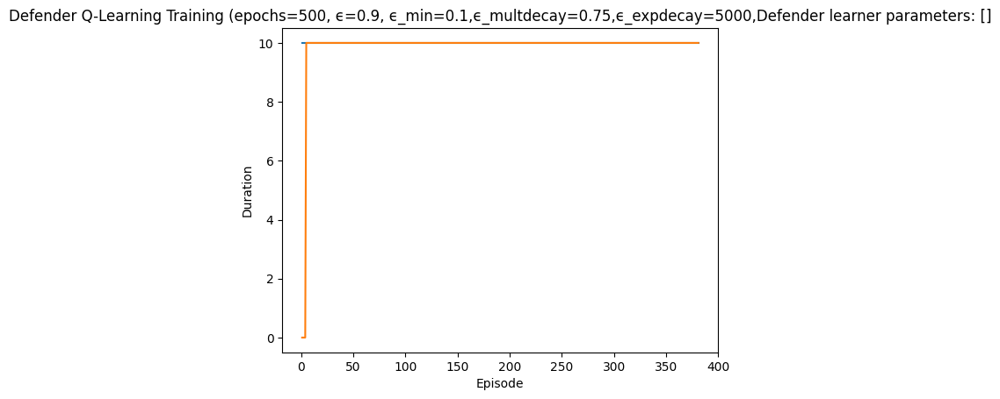

Rendering the current state of the environment
  ## Episode: 382/500 'Defender Q-Learning Training' ϵ=0.3551, Defender learner parameters: []


Episode 382|Iteration 2|reward:   10.0|last_reward_at:    2|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3811, 'successful_actions': 1513, 'failed_actions': 2298}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3812, 'successful_actions': 1514, 'failed_actions': 2298}, 'network_availability': 1.0}


Episode 382|Iteration 3|reward:   -5.0|last_reward_at:    2|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=13, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3813, 'successful_actions': 1514, 'failed_actions': 2299}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 4: Action Taken: Type=Reimage Node, NodeID=13, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3814, 'successful_actions': 1514, 'failed_actions': 2300}, 'network_availabi

Episode 382|Iteration 8|reward:   45.0|last_reward_at:    6|Elapsed Time: 0:00:00||

{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 5: Action Taken: Type=Reimage Node, NodeID=0, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3815, 'successful_actions': 1514, 'failed_actions': 2301}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 6: Action Taken: Type=Block Traffic, NodeID=7, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3816, 'successful_actions': 1515, 'failed_actions': 2301}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 7: Ac

Episode 382|Iteration 10|reward:   15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 9: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3819, 'successful_actions': 1516, 'failed_actions': 2303}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 10: Action Taken: Type=Start Service, NodeID=12, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3820, 'successful_actions': 1516, 'failed_actions': 2304}, 'network_availability': 1.0}
  Episod

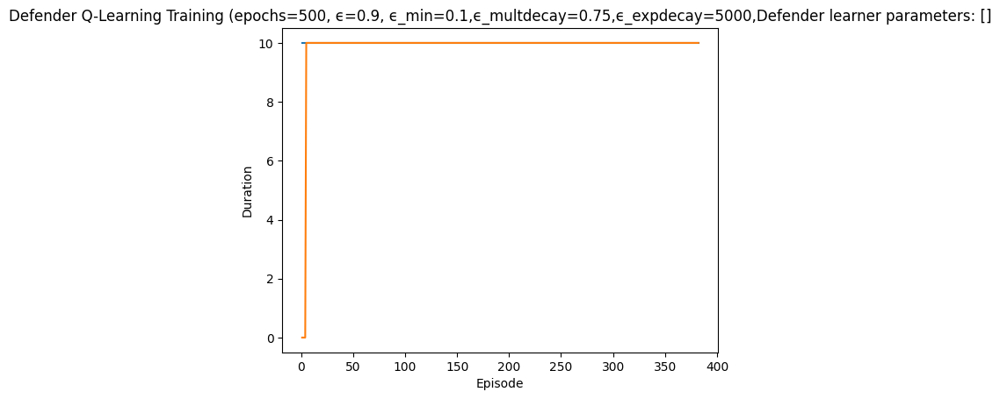

Rendering the current state of the environment
  ## Episode: 383/500 'Defender Q-Learning Training' ϵ=0.3545, Defender learner parameters: []


Episode 383|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=3, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3821, 'successful_actions': 1516, 'failed_actions': 2305}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3822, 'successful_actions': 1516, 'failed_actions': 2306}, 'network_availability': 1.0}
failed

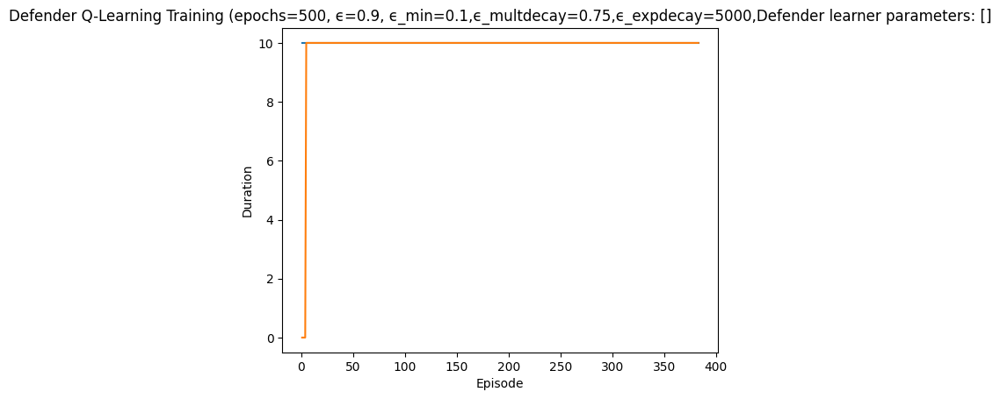

Rendering the current state of the environment
  ## Episode: 384/500 'Defender Q-Learning Training' ϵ=0.3540, Defender learner parameters: []


Episode 384|Iteration 10|reward:   50.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3831, 'successful_actions': 1519, 'failed_actions': 2312}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3832, 'successful_actions': 1520, 'failed_actions': 2312}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=12, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_na

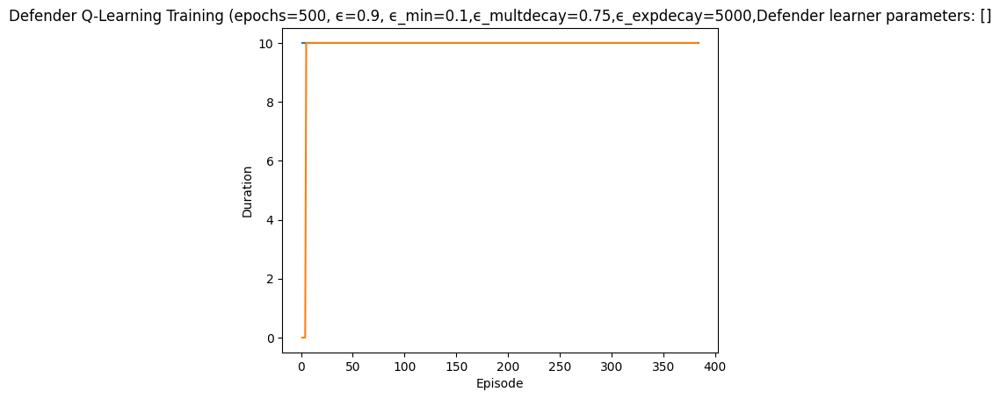

Rendering the current state of the environment
  ## Episode: 385/500 'Defender Q-Learning Training' ϵ=0.3534, Defender learner parameters: []


Episode 385|Iteration 6|reward:  125.0|last_reward_at:    5|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3841, 'successful_actions': 1525, 'failed_actions': 2316}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3842, 'successful_actions': 1526, 'failed_actions': 2316}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=9, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3843, 'successful_actions': 1527, 'failed_actions': 2316}, 'network_availability': 1.0}
failed
{'action': 'reimage_node

Episode 385|Iteration 8|reward:   95.0|last_reward_at:    6|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 7: Action Taken: Type=Start Service, NodeID=1, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3847, 'successful_actions': 1529, 'failed_actions': 2318}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 8: Action Taken: Type=Start Service, NodeID=11, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3848, 'successful_actions': 1529, 'failed_actions': 2319}, 'network_availability': 1.0}


Episode 385|Iteration 10|reward:   80.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 9: Action Taken: Type=Reimage Node, NodeID=10, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3849, 'successful_actions': 1529, 'failed_actions': 2320}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 10: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3850, 'successful_actions': 1529, 'failed_actions': 2321}, 'network_availability': 1.0}
 

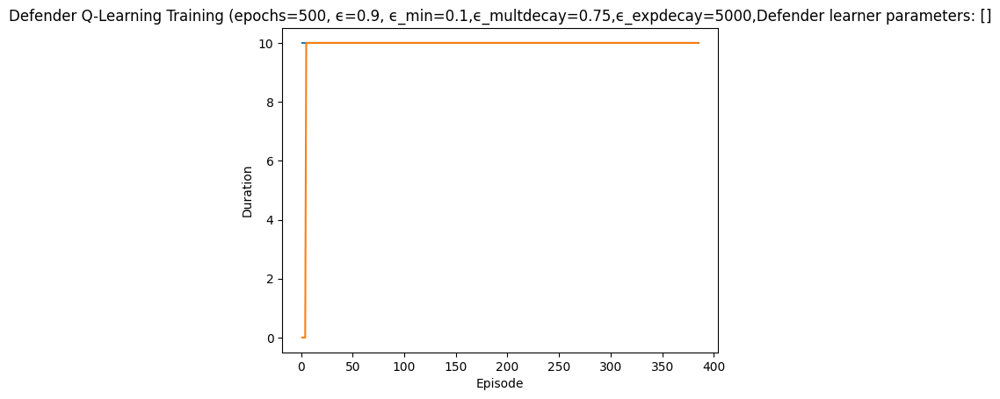

Rendering the current state of the environment
  ## Episode: 386/500 'Defender Q-Learning Training' ϵ=0.3529, Defender learner parameters: []


Episode 386|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3851, 'successful_actions': 1529, 'failed_actions': 2322}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=9, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3852, 'successful_actions': 1529, 'failed_actions': 2323}, 'network_availability': 1.0}
action typ

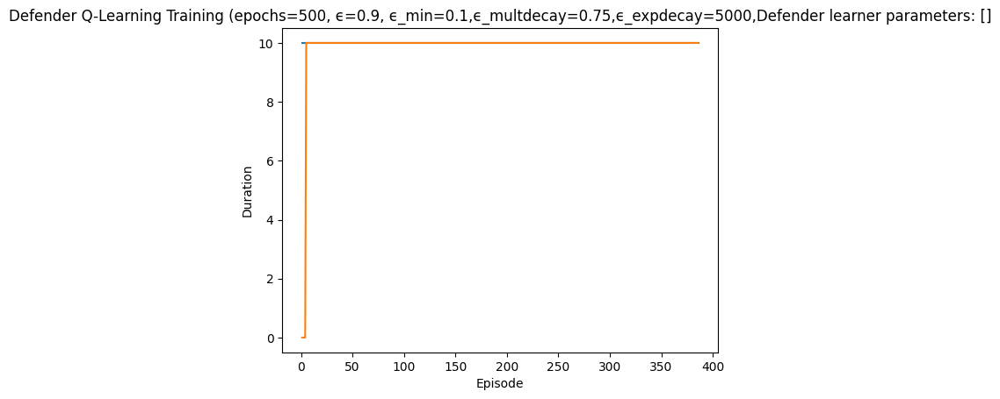

Rendering the current state of the environment
  ## Episode: 387/500 'Defender Q-Learning Training' ϵ=0.3523, Defender learner parameters: []


Episode 387|Iteration 10|reward:  -10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=11, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3861, 'successful_actions': 1532, 'failed_actions': 2329}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 3862, 'successful_actions': 1533, 'failed_actions': 2329}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteratio

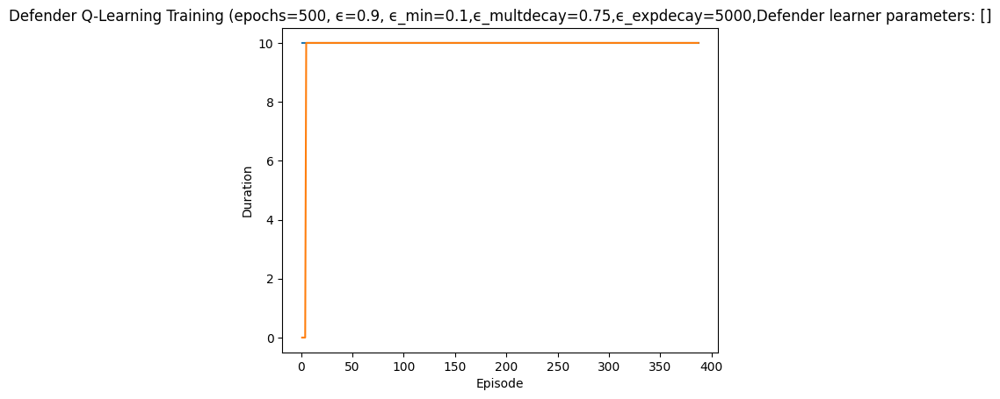

Rendering the current state of the environment
  ## Episode: 388/500 'Defender Q-Learning Training' ϵ=0.3518, Defender learner parameters: []


Episode 388|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3871, 'successful_actions': 1535, 'failed_actions': 2336}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 3872, 'successful_actions': 1536, 'failed_actions': 2336}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=3, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required -

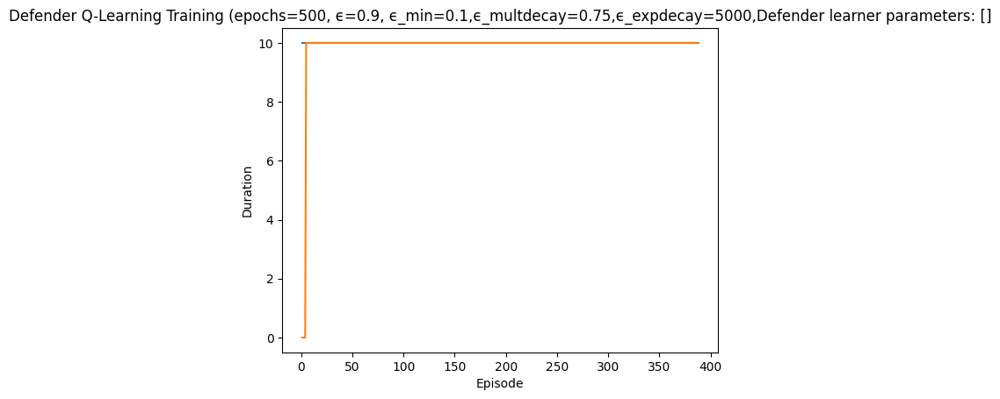

Rendering the current state of the environment
  ## Episode: 389/500 'Defender Q-Learning Training' ϵ=0.3512, Defender learner parameters: []


Episode 389|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=4, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 3881, 'successful_actions': 1540, 'failed_actions': 2341}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3882, 'successful_actions': 1540, 'failed_actions': 2342}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3:

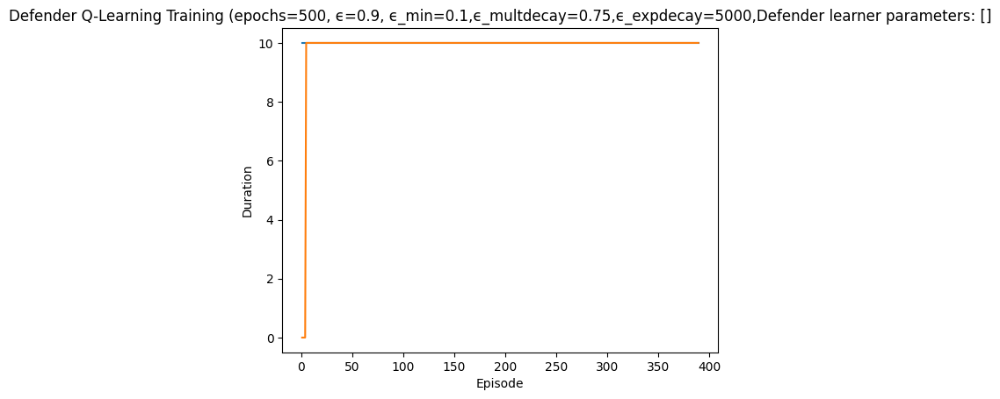

Rendering the current state of the environment
  ## Episode: 390/500 'Defender Q-Learning Training' ϵ=0.3506, Defender learner parameters: []


Episode 390|Iteration 10|reward:   15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3891, 'successful_actions': 1542, 'failed_actions': 2349}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 3892, 'successful_actions': 1543, 'failed_actions': 2349}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Ta

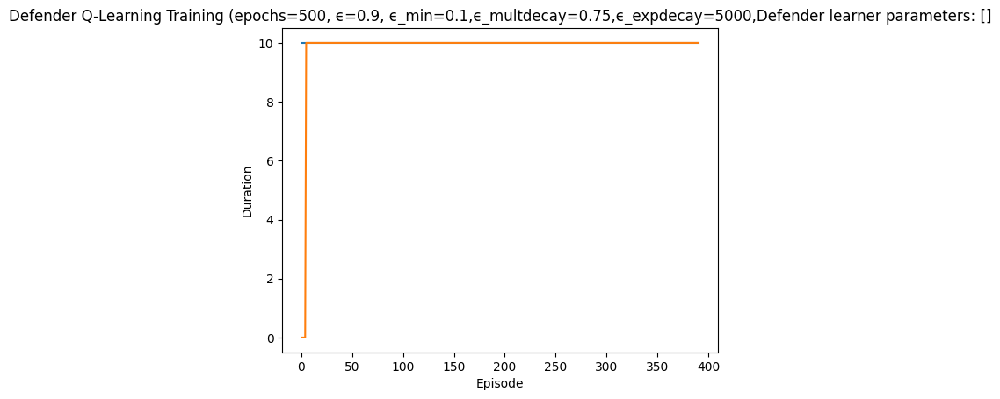

Rendering the current state of the environment
  ## Episode: 391/500 'Defender Q-Learning Training' ϵ=0.3501, Defender learner parameters: []


Episode 391|Iteration 10|reward:  -10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3901, 'successful_actions': 1545, 'failed_actions': 2356}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=12, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3902, 'successful_actions': 1545, 'failed_actions': 2357}, 'network_availability': 1.0}
failed
{'action': '

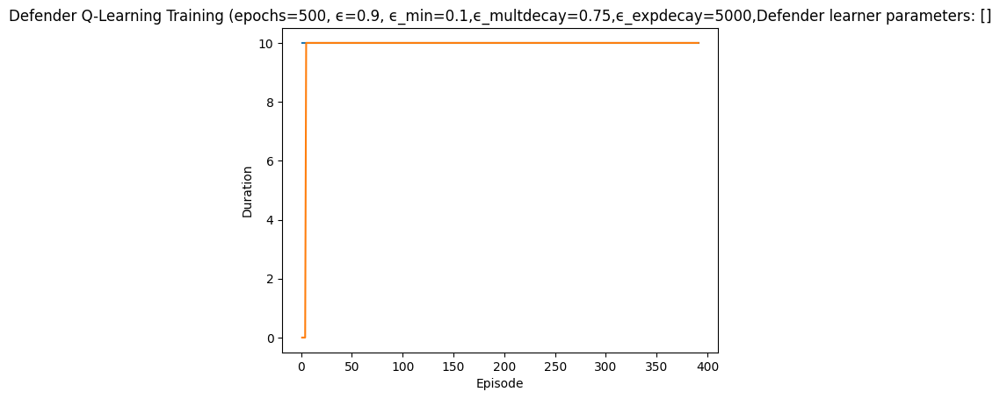

Rendering the current state of the environment
  ## Episode: 392/500 'Defender Q-Learning Training' ϵ=0.3495, Defender learner parameters: []


Episode 392|Iteration 10|reward:  -15.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=0, Parameter=2
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 2, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 3911, 'successful_actions': 1547, 'failed_actions': 2364}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3912, 'successful_actions': 1547, 'failed_actions': 2365}, 'network_availability': 1.0}
action type:  Reimage No

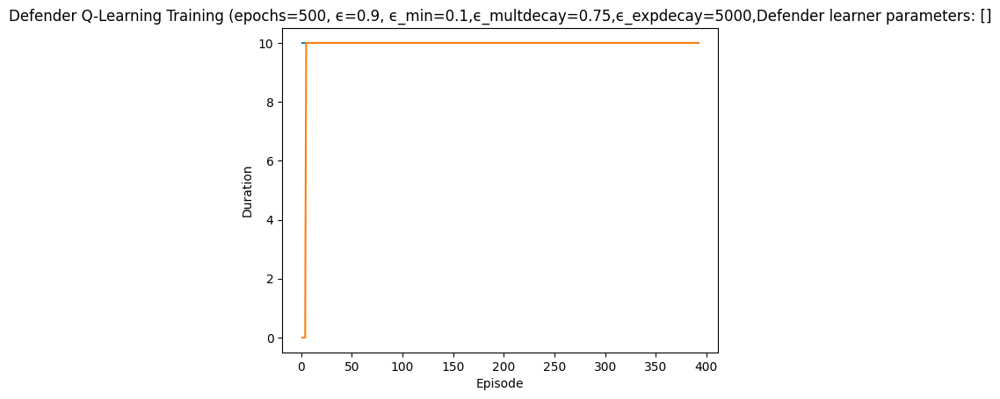

Rendering the current state of the environment
  ## Episode: 393/500 'Defender Q-Learning Training' ϵ=0.3490, Defender learner parameters: []


Episode 393|Iteration 7|reward:  -65.0|last_reward_at:    6|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3921, 'successful_actions': 1550, 'failed_actions': 2371}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=10, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3922, 'successful_actions': 1550, 'failed_actions': 2372}, 'network_availability': 1.0}
failed
{'action

Episode 393|Iteration 10|reward:  -55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3928, 'successful_actions': 1551, 'failed_actions': 2377}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 9: Action Taken: Type=Block Traffic, NodeID=5, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3929, 'successful_actions': 1552, 'failed_actions': 2377}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 10: Action Taken: Type=Allow Traffic, NodeID=7, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3

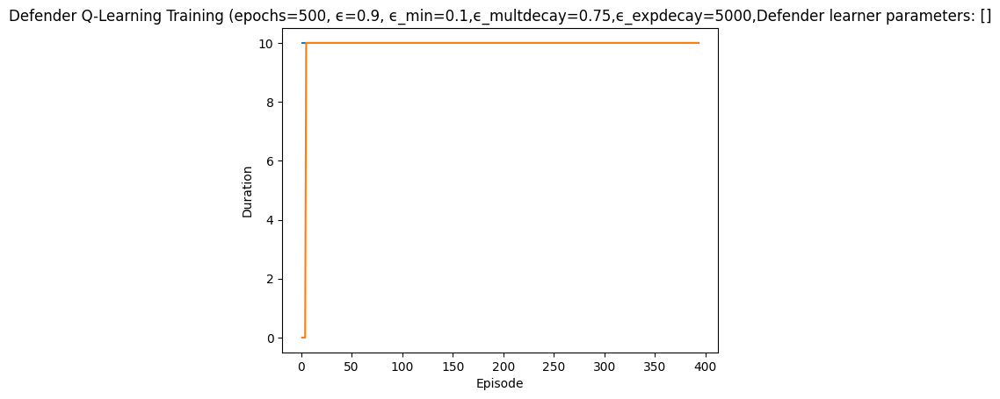

Rendering the current state of the environment
  ## Episode: 394/500 'Defender Q-Learning Training' ϵ=0.3485, Defender learner parameters: []


Episode 394|Iteration 10|reward:   25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=12, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3931, 'successful_actions': 1552, 'failed_actions': 2379}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=7, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3932, 'successful_actions': 1552, 'failed_actions': 2380}, 'network_availability': 1.0}
action 

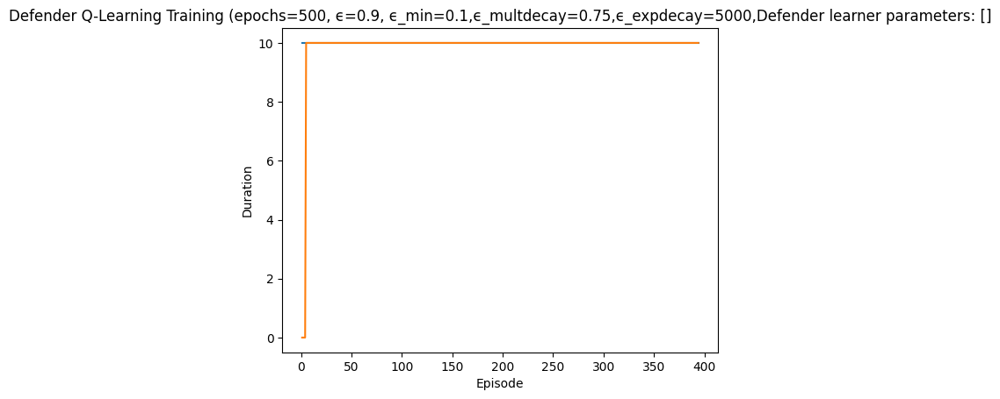

Rendering the current state of the environment
  ## Episode: 395/500 'Defender Q-Learning Training' ϵ=0.3479, Defender learner parameters: []


Episode 395|Iteration 10|reward:   15.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 3941, 'successful_actions': 1557, 'failed_actions': 2384}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=11, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 3942, 'successful_actions': 1558, 'failed_actions': 2384}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 9, 'reason': 'Service not 

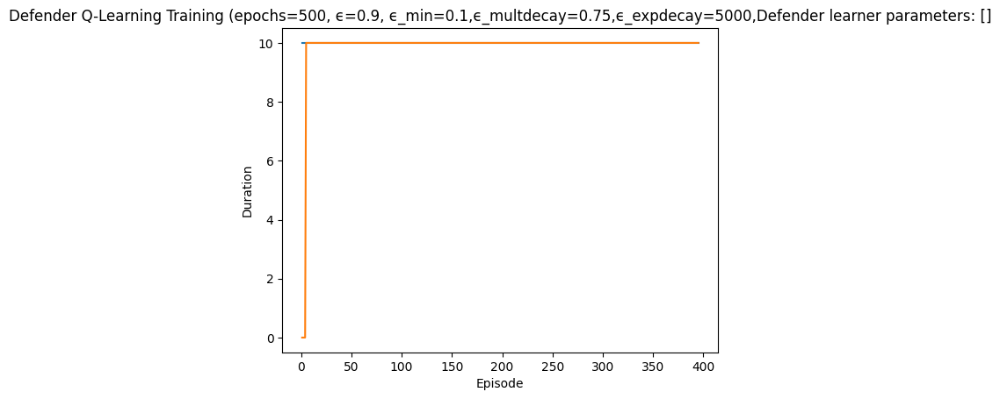

Rendering the current state of the environment
  ## Episode: 396/500 'Defender Q-Learning Training' ϵ=0.3474, Defender learner parameters: []


Episode 396|Iteration 10|reward:   30.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3951, 'successful_actions': 1560, 'failed_actions': 2391}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3952, 'successful_actions': 1561, 'failed_actions': 2391}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=7, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not requi

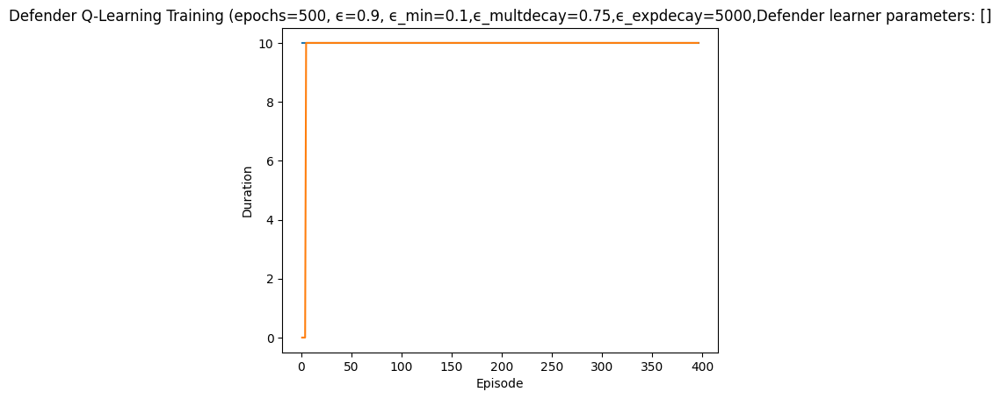

Rendering the current state of the environment
  ## Episode: 397/500 'Defender Q-Learning Training' ϵ=0.3468, Defender learner parameters: []


Episode 397|Iteration 10|reward:   10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 3961, 'successful_actions': 1563, 'failed_actions': 2398}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=8, Parameter=2
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3962, 'successful_actions': 1563, 'failed_actions': 2399}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: A

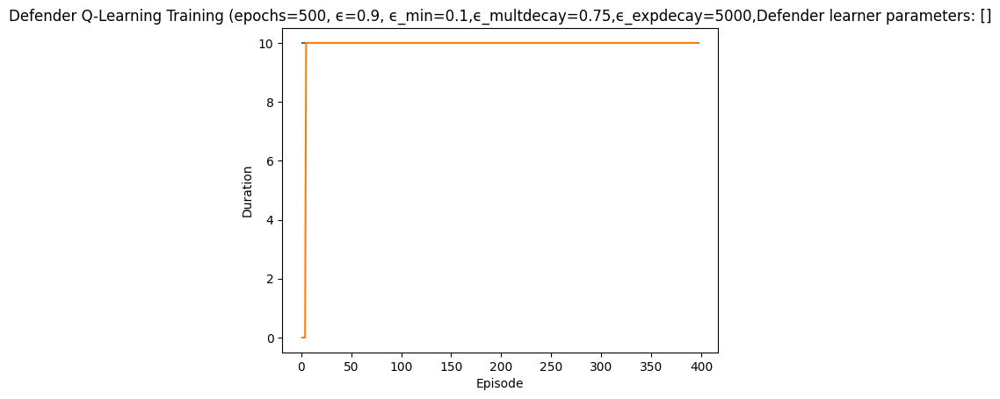

Rendering the current state of the environment
  ## Episode: 398/500 'Defender Q-Learning Training' ϵ=0.3463, Defender learner parameters: []


Episode 398|Iteration 2|reward:   10.0|last_reward_at: ----|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=9, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3971, 'successful_actions': 1566, 'failed_actions': 2405}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 3972, 'successful_actions': 1567, 'failed_actions': 2405}, 'network_availability': 1.0}


Episode 398|Iteration 10|reward:   95.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=8, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3973, 'successful_actions': 1567, 'failed_actions': 2406}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 4: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 3974, 'successful_actions': 1568, 'failed_actions': 2406}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 5: Action Taken: Type=Block Traffic, NodeID=2, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNod

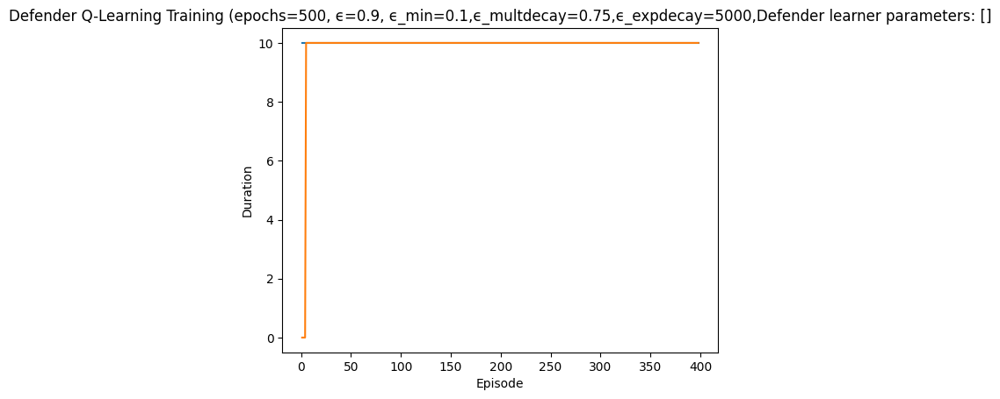

Rendering the current state of the environment
  ## Episode: 399/500 'Defender Q-Learning Training' ϵ=0.3457, Defender learner parameters: []


Episode 399|Iteration 10|reward:  -15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '10_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3981, 'successful_actions': 1571, 'failed_actions': 2410}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=10, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3982, 'successful_actions': 1571, 'failed_actions': 2411}, 'network_availability':

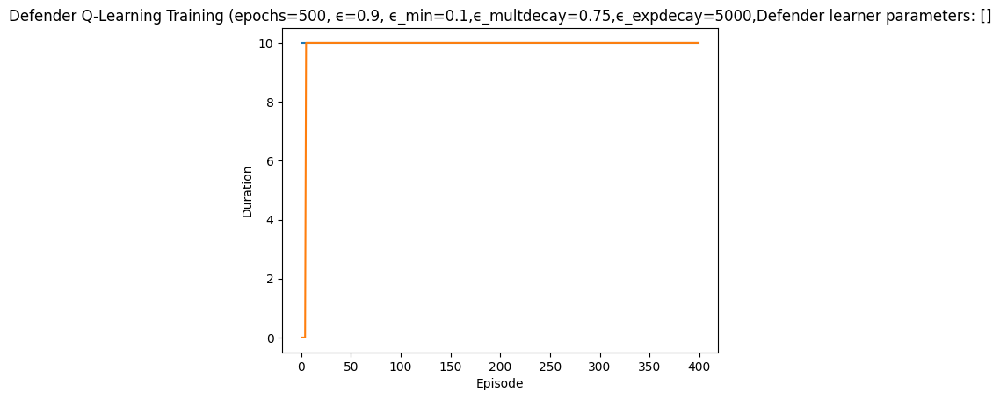

Rendering the current state of the environment
  ## Episode: 400/500 'Defender Q-Learning Training' ϵ=0.3452, Defender learner parameters: []


Episode 400|Iteration 10|reward:  -65.0|last_reward_at:    4|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 3991, 'successful_actions': 1574, 'failed_actions': 2417}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 3992, 'successful_actions': 1574, 'failed_actions': 2418}, 'network_availability': 1

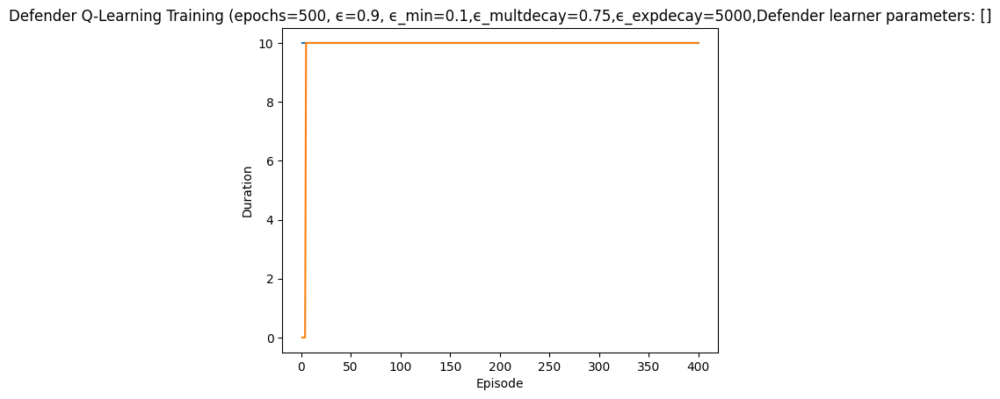

Rendering the current state of the environment
  ## Episode: 401/500 'Defender Q-Learning Training' ϵ=0.3447, Defender learner parameters: []


Episode 401|Iteration 7|reward:    5.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4001, 'successful_actions': 1575, 'failed_actions': 2426}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4002, 'successful_actions': 1575, 'failed_actions': 2427}, 'network_availability': 1

Episode 401|Iteration 8|reward:  -10.0|last_reward_at:    7|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 8: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4008, 'successful_actions': 1577, 'failed_actions': 2431}, 'network_availability': 1.0}


Episode 401|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 9: Action Taken: Type=Block Traffic, NodeID=3, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 4009, 'successful_actions': 1578, 'failed_actions': 2431}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=3, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 4010, 'successful_actions': 1579, 'failed_actions': 2431}, 'network_availability': 1.0}
  Episode 401 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  Episode 401 breakdown:
    Successful Reimaging Count: 1


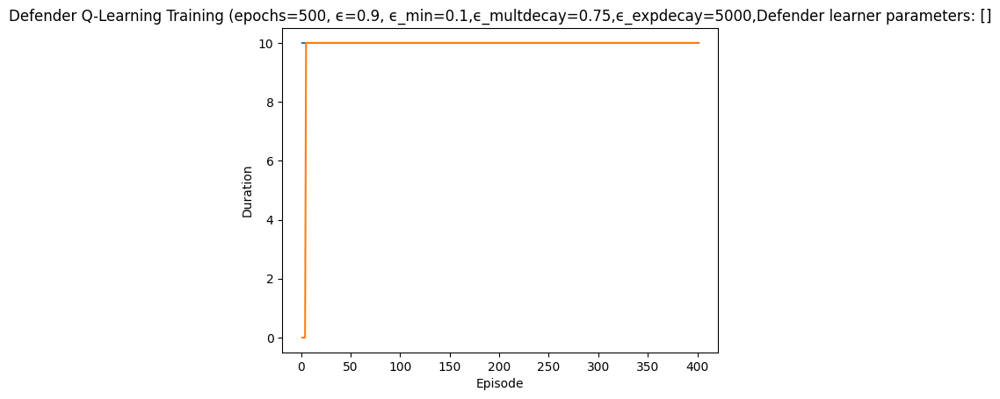

Rendering the current state of the environment
  ## Episode: 402/500 'Defender Q-Learning Training' ϵ=0.3441, Defender learner parameters: []


Episode 402|Iteration 2|reward:   50.0|last_reward_at:    2|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=10, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4011, 'successful_actions': 1580, 'failed_actions': 2431}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 4012, 'successful_actions': 1581, 'failed_actions': 2431}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=7, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4013, 'successful_actions': 1582, 'failed_actions': 2431}, 'network_availability': 1.0}


Episode 402|Iteration 3|reward:   75.0|last_reward_at:    3|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 4: Action Taken: Type=Reimage Node, NodeID=13, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4014, 'successful_actions': 1582, 'failed_actions': 2432}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 0, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 5: Action Taken: Type=Reimage Node, NodeID=0, Parameter=0
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 0, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4015, 'successful_actions': 1582, 'failed_actions': 2433}, 'network_availability': 1.0}


Episode 402|Iteration 8|reward:  110.0|last_reward_at:    8|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 6: Action Taken: Type=Block Traffic, NodeID=11, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4016, 'successful_actions': 1583, 'failed_actions': 2433}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 7: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4017, 'successful_actions': 1583, 'failed_actions': 2434}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 8: Action Taken: Type=Block Traffic, NodeID=12, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_

Episode 402|Iteration 10|reward:  160.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 9: Action Taken: Type=Block Traffic, NodeID=6, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4019, 'successful_actions': 1585, 'failed_actions': 2434}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 10: Action Taken: Type=Block Traffic, NodeID=6, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4020, 'successful_actions': 1586, 'failed_actions': 2434}, 'network_availability': 1.0}
  Episode 402 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 5
  Episode 402 breakdown:
    Successful Reimaging Count: 1
  

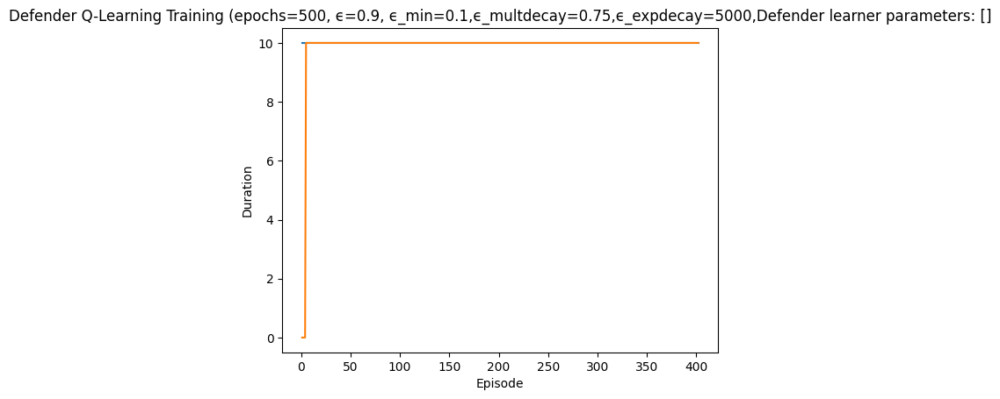

Rendering the current state of the environment
  ## Episode: 403/500 'Defender Q-Learning Training' ϵ=0.3436, Defender learner parameters: []


Episode 403|Iteration 10|reward:   45.0|last_reward_at:    4|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4021, 'successful_actions': 1587, 'failed_actions': 2434}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=12, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4022, 'successful_actions': 1588, 'failed_actions': 2434}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=12, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not req

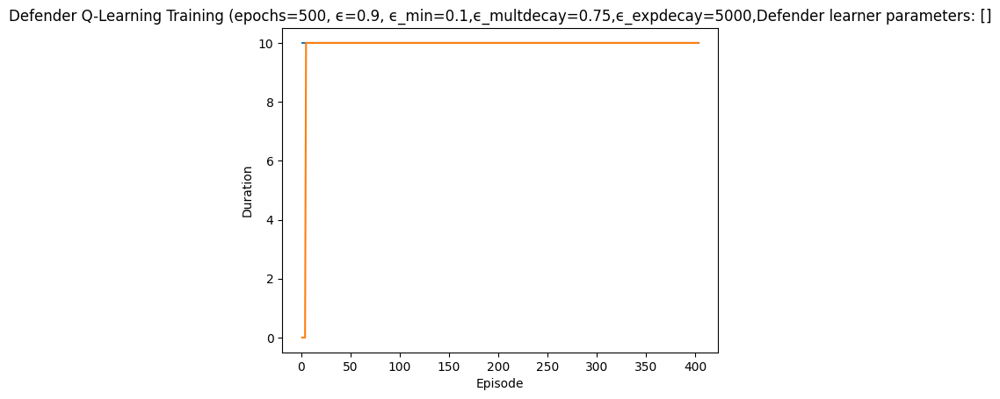

Rendering the current state of the environment
  ## Episode: 404/500 'Defender Q-Learning Training' ϵ=0.3430, Defender learner parameters: []


Episode 404|Iteration 2|reward:   10.0|last_reward_at:    1|Elapsed Time: 0:00:00||

action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4031, 'successful_actions': 1590, 'failed_actions': 2441}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=1
info {'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 1, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4032, 'successful_actions': 1590, 'failed_actions': 2442}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action 

Episode 404|Iteration 10|reward:   30.0|last_reward_at:   10|Elapsed Time: 0:00:00||


{'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4034, 'successful_actions': 1591, 'failed_actions': 2443}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 5: Action Taken: Type=Reimage Node, NodeID=5, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4035, 'successful_actions': 1591, 'failed_actions': 2444}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 6: Action Taken: Type=Start Service, NodeID=2, Parameter=4
info {'action': 'start_service'

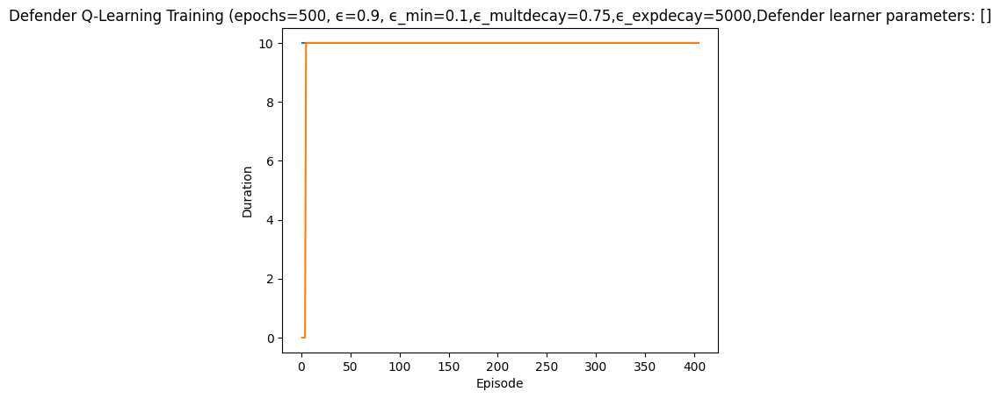

Rendering the current state of the environment
  ## Episode: 405/500 'Defender Q-Learning Training' ϵ=0.3425, Defender learner parameters: []


Episode 405|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4041, 'successful_actions': 1593, 'failed_actions': 2448}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 4042, 'successful_actions': 1594, 'failed_actions': 2448}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=7, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 1, 'reason': 'Servic

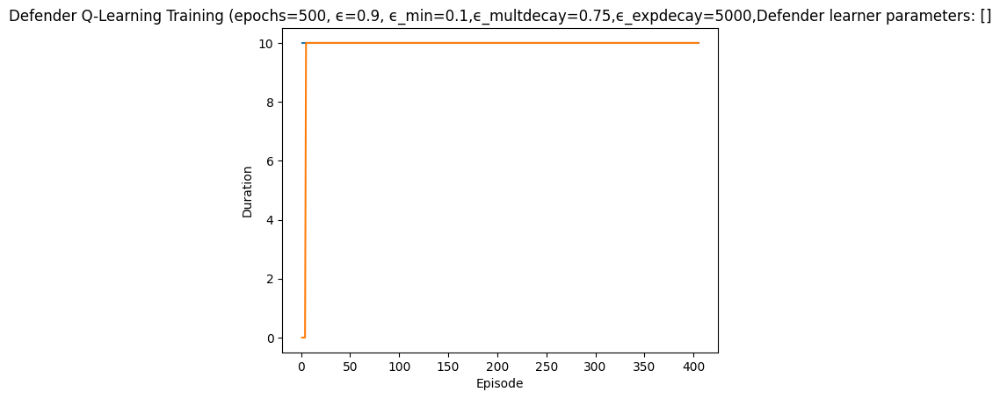

Rendering the current state of the environment
  ## Episode: 406/500 'Defender Q-Learning Training' ϵ=0.3420, Defender learner parameters: []


Episode 406|Iteration 10|reward:   40.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4051, 'successful_actions': 1597, 'failed_actions': 2454}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4052, 'successful_actions': 1597, 'failed_actions': 2455}, 'network_availability': 1.0}
action type:

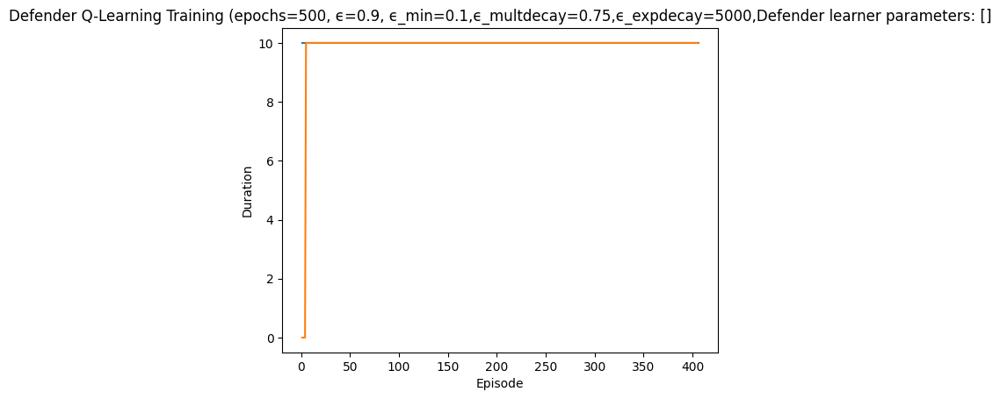

Rendering the current state of the environment
  ## Episode: 407/500 'Defender Q-Learning Training' ϵ=0.3414, Defender learner parameters: []


Episode 407|Iteration 10|reward:  145.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4061, 'successful_actions': 1602, 'failed_actions': 2459}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=7, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4062, 'successful_actions': 1603, 'failed_actions': 2459}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=13, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 4063, 'successful_actions': 1604, 'failed_actions': 2459}, 'network_availability': 1.0}
action type:  Block Traffic
Ite

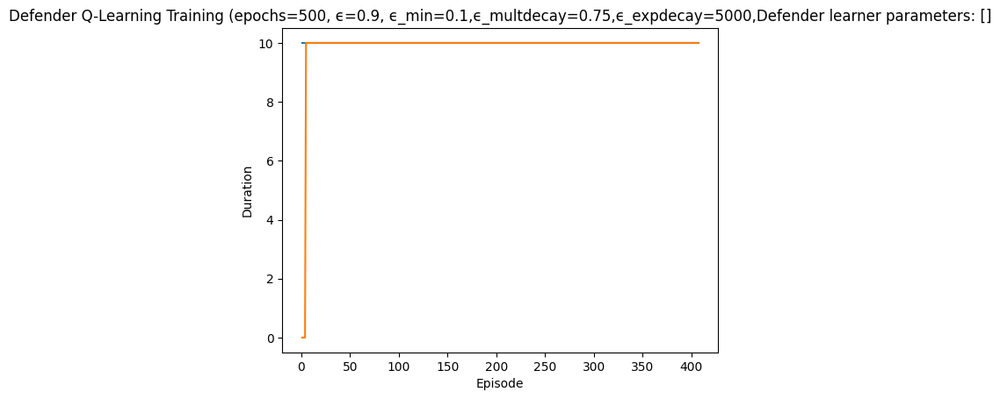

Rendering the current state of the environment
  ## Episode: 408/500 'Defender Q-Learning Training' ϵ=0.3409, Defender learner parameters: []


Episode 408|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=5, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4071, 'successful_actions': 1608, 'failed_actions': 2463}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4072, 'successful_actions': 1609, 'failed_actions': 2463}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3

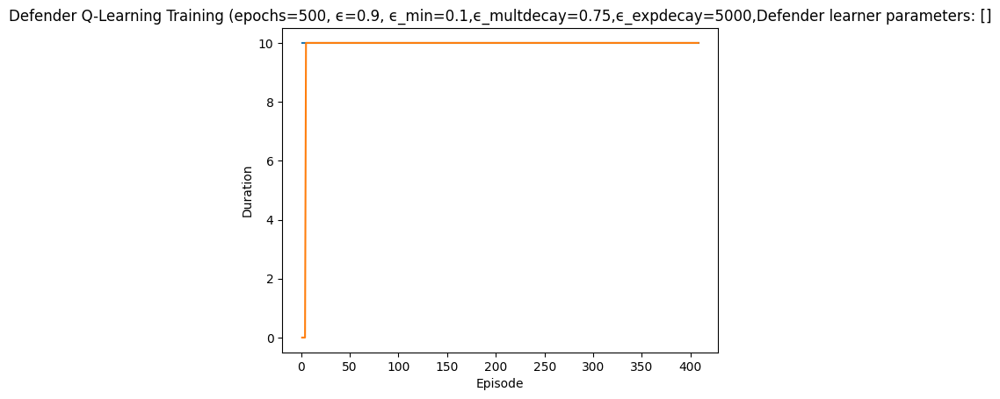

Rendering the current state of the environment
  ## Episode: 409/500 'Defender Q-Learning Training' ϵ=0.3404, Defender learner parameters: []


Episode 409|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4081, 'successful_actions': 1611, 'failed_actions': 2470}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4082, 'successful_actions': 1611, 'failed_actions': 2471}, 'network_availability': 1.0}
action type:  Blo

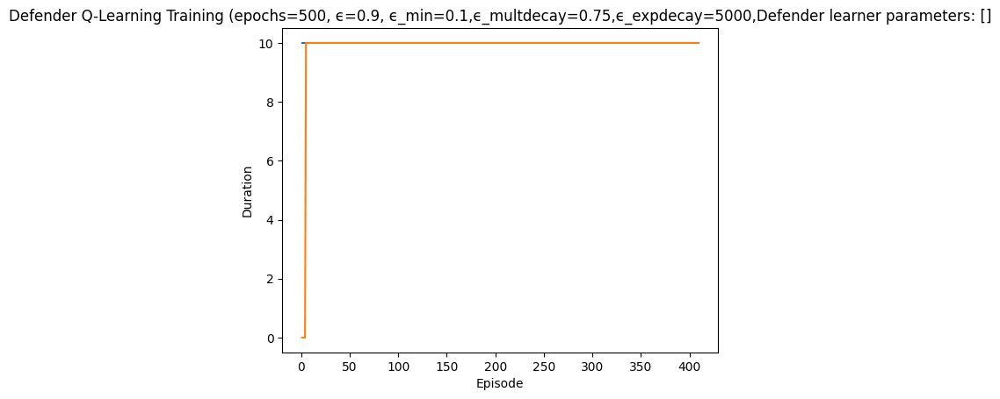

Rendering the current state of the environment
  ## Episode: 410/500 'Defender Q-Learning Training' ϵ=0.3398, Defender learner parameters: []


Episode 410|Iteration 10|reward:  105.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4091, 'successful_actions': 1615, 'failed_actions': 2476}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 4092, 'successful_actions': 1616, 'failed_actions': 2476}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=7, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 4093, 'successful_actions': 1617, 'failed_actions': 2476}, 'network_availability': 1.0}
failed
{'action': 'reimage_node',

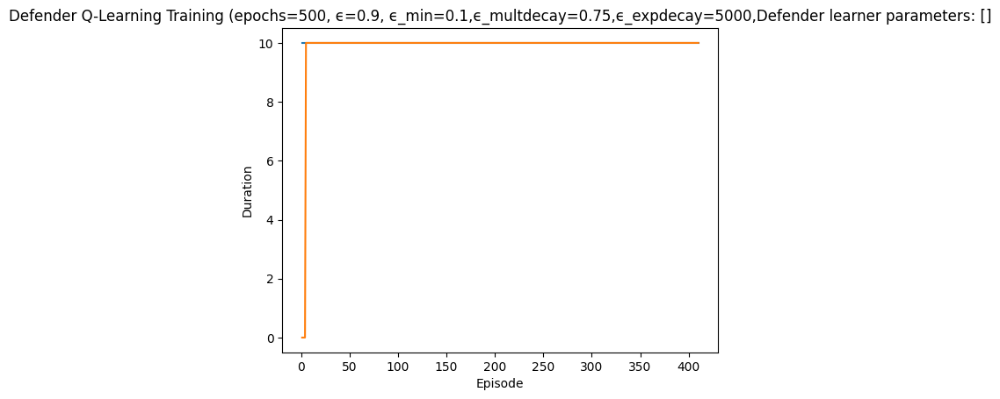

Rendering the current state of the environment
  ## Episode: 411/500 'Defender Q-Learning Training' ϵ=0.3393, Defender learner parameters: []


Episode 411|Iteration 10|reward:  -25.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4101, 'successful_actions': 1620, 'failed_actions': 2481}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4102, 'successful_actions': 1621, 'failed_actions': 2481}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 3, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iter

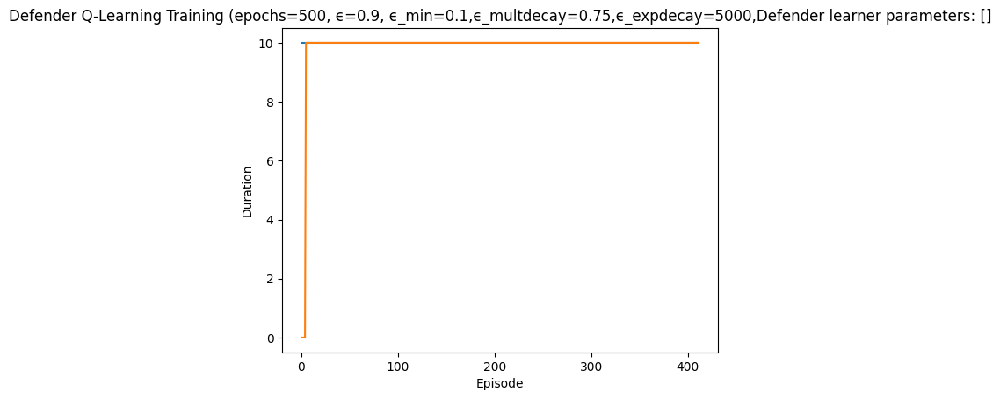

Rendering the current state of the environment
  ## Episode: 412/500 'Defender Q-Learning Training' ϵ=0.3388, Defender learner parameters: []


Episode 412|Iteration 10|reward:   30.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=11, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4111, 'successful_actions': 1622, 'failed_actions': 2489}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4112, 'successful_actions': 1623, 'failed_actions': 2489}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Itera

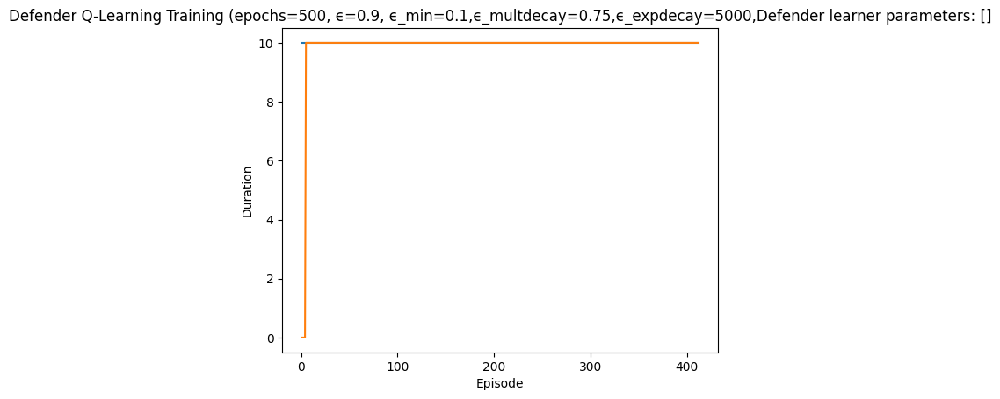

Rendering the current state of the environment
  ## Episode: 413/500 'Defender Q-Learning Training' ϵ=0.3383, Defender learner parameters: []


Episode 413|Iteration 10|reward:  145.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=13, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4121, 'successful_actions': 1626, 'failed_actions': 2495}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=3, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4122, 'successful_actions': 1627, 'failed_actions': 2495}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=3, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4123, 'successful_actions': 1628, 'failed_actions': 2495}, 'network_availability': 1.0}
action type:  Block Traffi

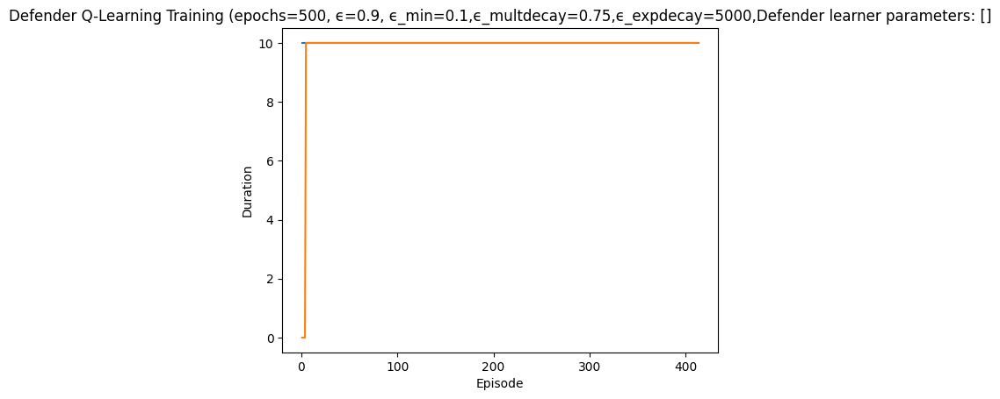

Rendering the current state of the environment
  ## Episode: 414/500 'Defender Q-Learning Training' ϵ=0.3377, Defender learner parameters: []


Episode 414|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=11, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4131, 'successful_actions': 1633, 'failed_actions': 2498}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4132, 'successful_actions': 1634, 'failed_actions': 2498}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=2, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 7, 'reason': 'Service 

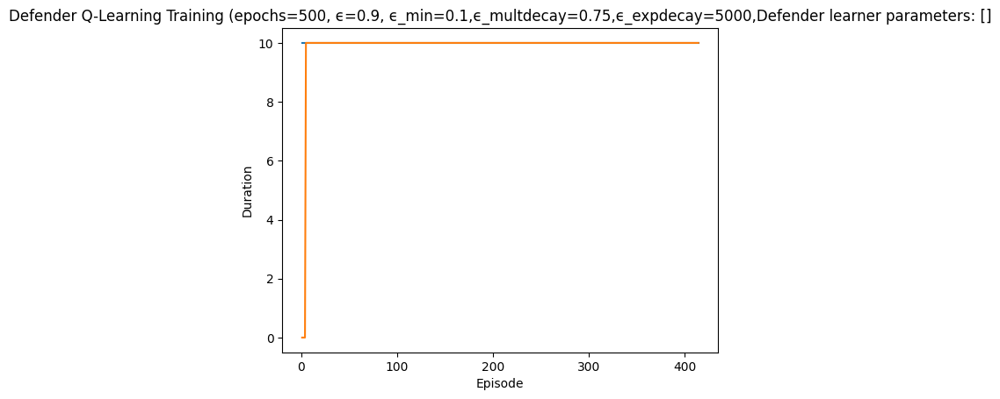

Rendering the current state of the environment
  ## Episode: 415/500 'Defender Q-Learning Training' ϵ=0.3372, Defender learner parameters: []


Episode 415|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=10, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4141, 'successful_actions': 1637, 'failed_actions': 2504}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=12, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4142, 'successful_actions': 1637, 'failed_actions': 2505}, 'network_availability': 1.0}
failed
{'a

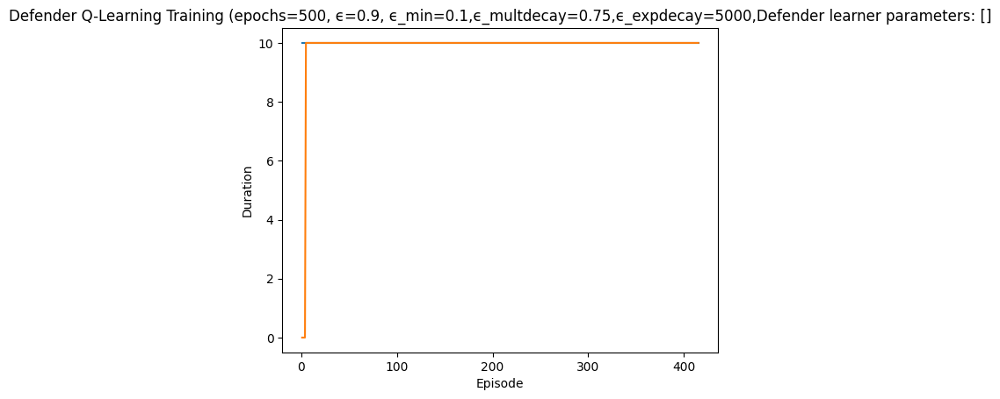

Rendering the current state of the environment
  ## Episode: 416/500 'Defender Q-Learning Training' ϵ=0.3367, Defender learner parameters: []


Episode 416|Iteration 10|reward:   40.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=8, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4151, 'successful_actions': 1641, 'failed_actions': 2510}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4152, 'successful_actions': 1642, 'failed_actions': 2510}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=4, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no 

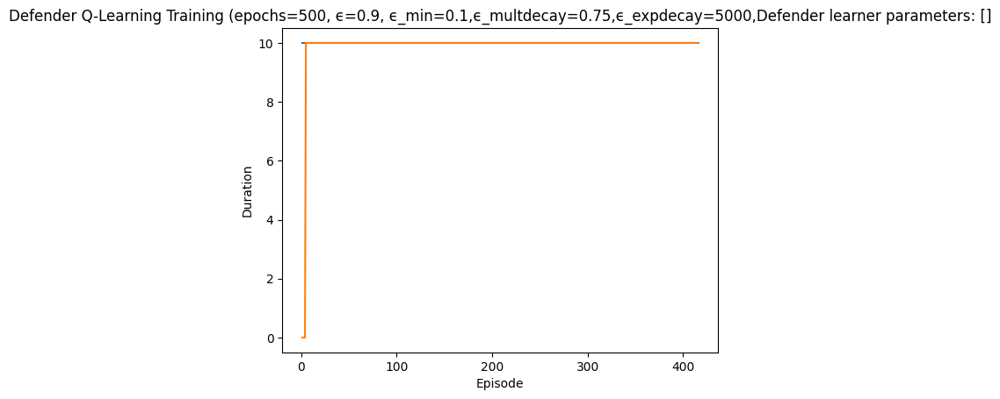

Rendering the current state of the environment
  ## Episode: 417/500 'Defender Q-Learning Training' ϵ=0.3362, Defender learner parameters: []


Episode 417|Iteration 10|reward:  -15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4161, 'successful_actions': 1644, 'failed_actions': 2517}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=8, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4162, 'successful_actions': 1645, 'failed_actions': 2517}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=11, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_

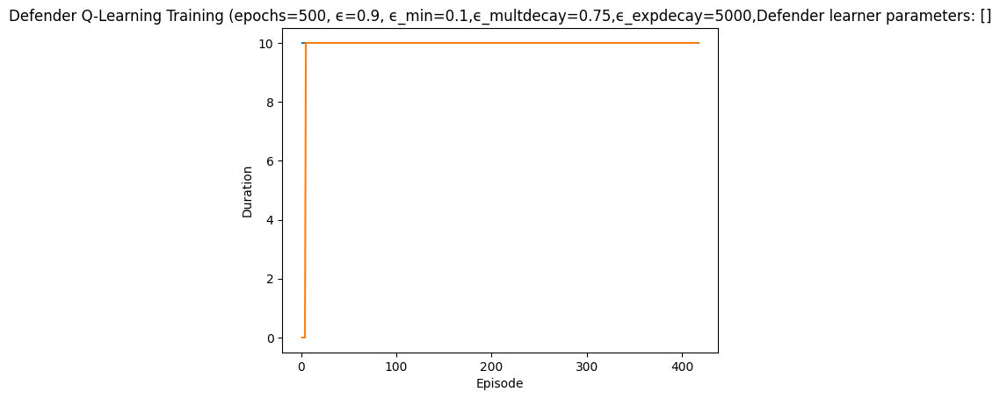

Rendering the current state of the environment
  ## Episode: 418/500 'Defender Q-Learning Training' ϵ=0.3356, Defender learner parameters: []


Episode 418|Iteration 10|reward:  -25.0|last_reward_at:    9|Elapsed Time: 0:00:00||

failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4171, 'successful_actions': 1647, 'failed_actions': 2524}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=2, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4172, 'successful_actions': 1647, 'failed_actions': 2525}, 'network_availabi

  Episode 418 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  Episode 418 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 826
    Blocking Traffic Count: 822
    Stopping Services Count: 0


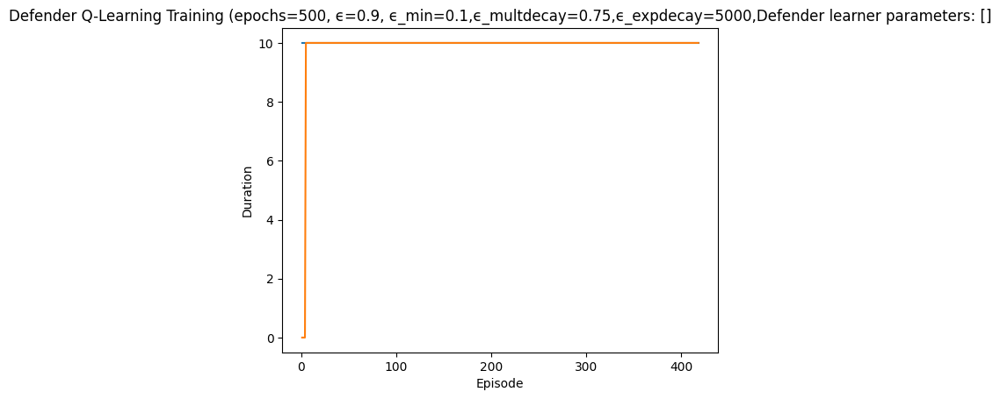

Rendering the current state of the environment
  ## Episode: 419/500 'Defender Q-Learning Training' ϵ=0.3351, Defender learner parameters: []


Episode 419|Iteration 10|reward:    0.0|last_reward_at:    8|Elapsed Time: 0:00:00||

action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 4181, 'successful_actions': 1650, 'failed_actions': 2531}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4182, 'successful_actions': 1650, 'failed_actions': 2532}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=13, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'por

Episode 419|Iteration 10|reward:    0.0|last_reward_at:    8|Elapsed Time: 0:00:00||


  Episode 419 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 7
  Episode 419 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 827
    Blocking Traffic Count: 824
    Stopping Services Count: 0


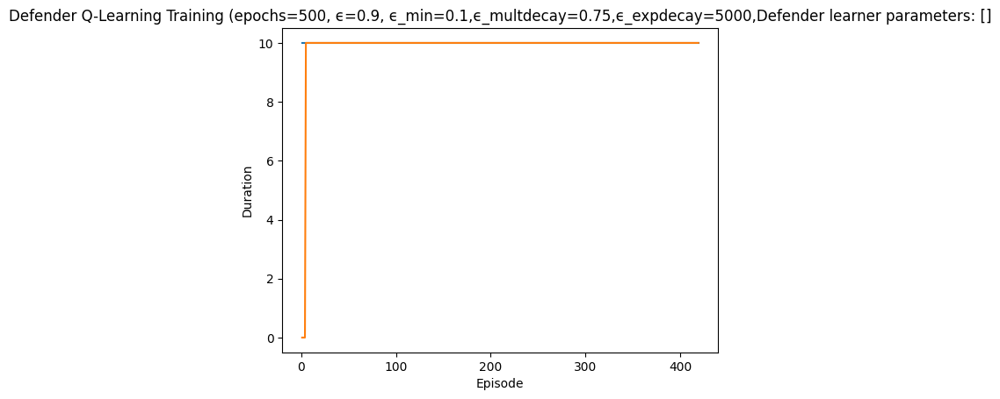

Rendering the current state of the environment
  ## Episode: 420/500 'Defender Q-Learning Training' ϵ=0.3346, Defender learner parameters: []


Episode 420|Iteration 10|reward:   80.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4191, 'successful_actions': 1652, 'failed_actions': 2539}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 4192, 'successful_actions': 1653, 'failed_actions': 2539}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=5, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode

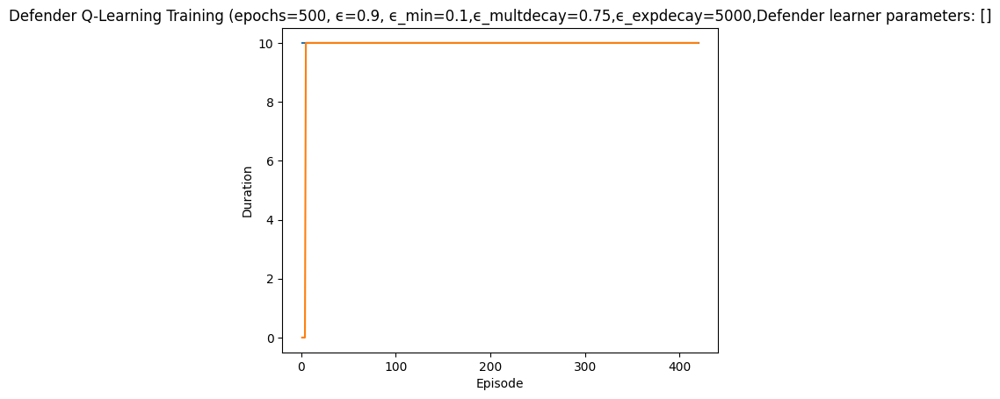

Rendering the current state of the environment
  ## Episode: 421/500 'Defender Q-Learning Training' ϵ=0.3341, Defender learner parameters: []


Episode 421|Iteration 10|reward:  -25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4201, 'successful_actions': 1657, 'failed_actions': 2544}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 4202, 'successful_actions': 1658, 'failed_actions': 2544}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: 

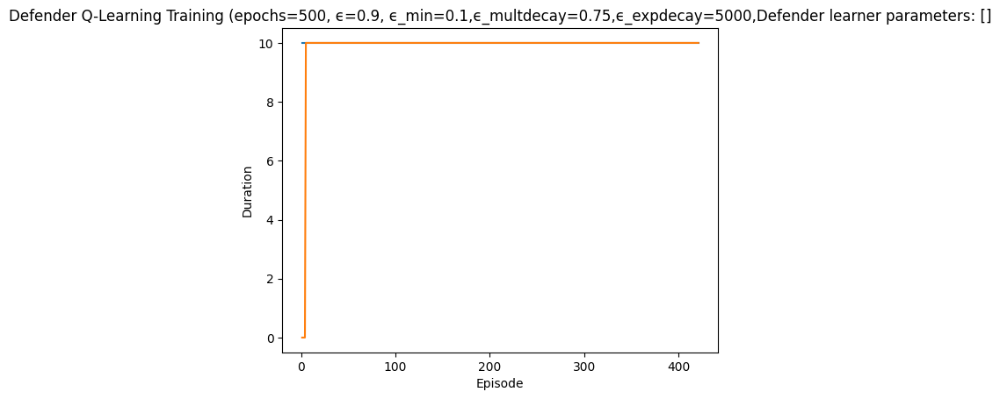

Rendering the current state of the environment
  ## Episode: 422/500 'Defender Q-Learning Training' ϵ=0.3336, Defender learner parameters: []


Episode 422|Iteration 10|reward:   25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4211, 'successful_actions': 1659, 'failed_actions': 2552}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=9, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4212, 'successful_actions': 1659, 'failed_actions': 2553}, 'network_availability': 1.0}
actio

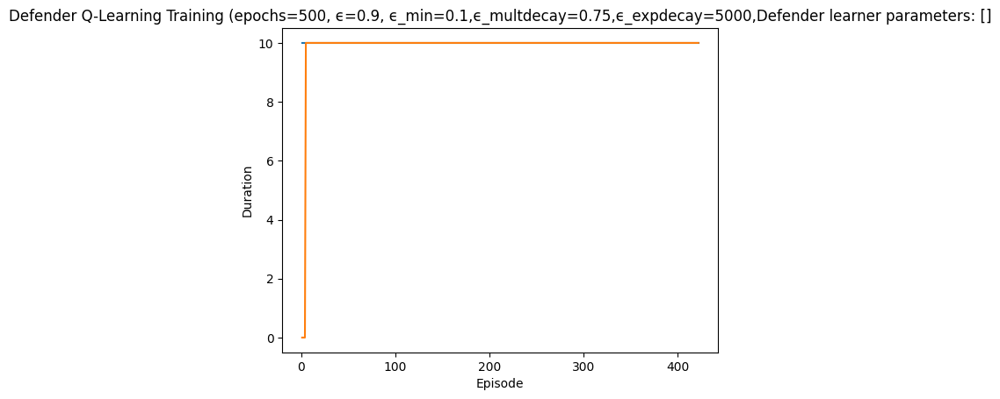

Rendering the current state of the environment
  ## Episode: 423/500 'Defender Q-Learning Training' ϵ=0.3330, Defender learner parameters: []


Episode 423|Iteration 10|reward:  125.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4221, 'successful_actions': 1663, 'failed_actions': 2558}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4222, 'successful_actions': 1663, 'failed_actions': 2559}, 'network_avail

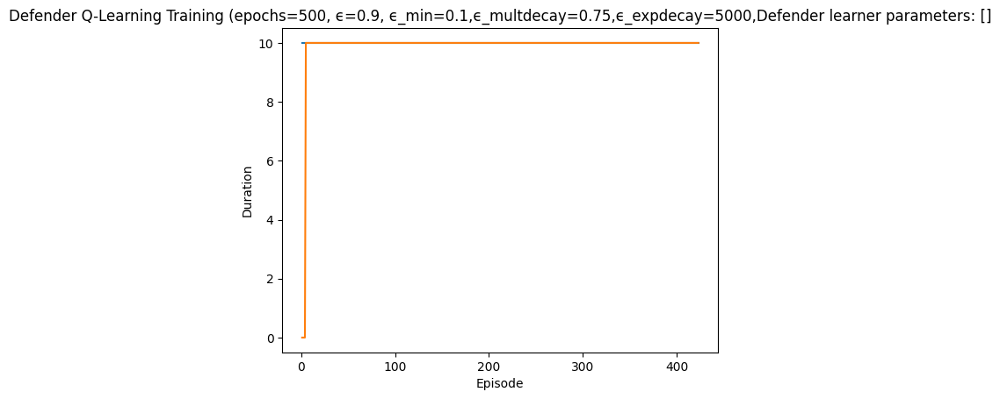

Rendering the current state of the environment
  ## Episode: 424/500 'Defender Q-Learning Training' ϵ=0.3325, Defender learner parameters: []


Episode 424|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=6, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4231, 'successful_actions': 1668, 'failed_actions': 2563}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4232, 'successful_actions': 1668, 'failed_actions': 2564}, 'network_availabi

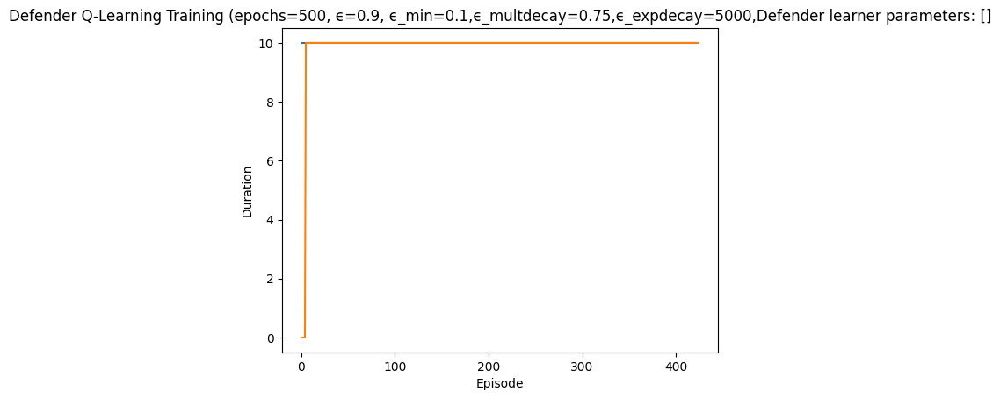

Rendering the current state of the environment
  ## Episode: 425/500 'Defender Q-Learning Training' ϵ=0.3320, Defender learner parameters: []


Episode 425|Iteration 10|reward:   65.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=3, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 4241, 'successful_actions': 1673, 'failed_actions': 2568}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4242, 'successful_actions': 1673, 'failed_actions': 2569}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=5, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_Wind

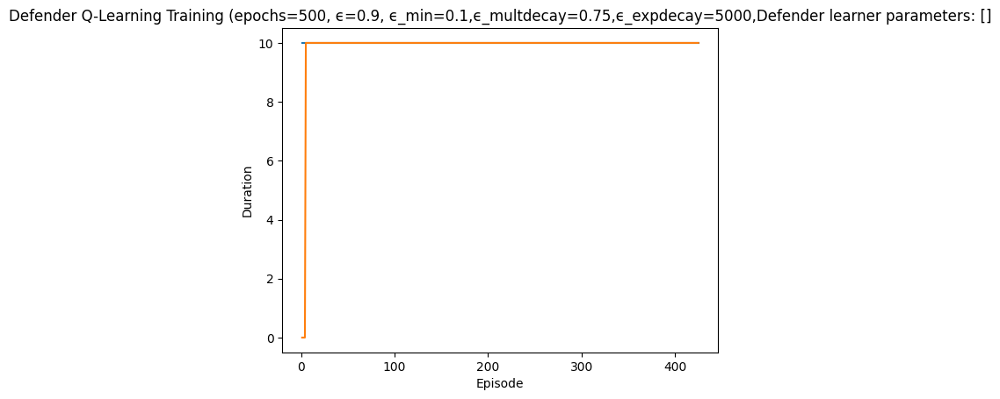

Rendering the current state of the environment
  ## Episode: 426/500 'Defender Q-Learning Training' ϵ=0.3315, Defender learner parameters: []


Episode 426|Iteration 10|reward:   80.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=13, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 4251, 'successful_actions': 1678, 'failed_actions': 2573}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4252, 'successful_actions': 1679, 'failed_actions': 2573}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=9, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4253, 'successful_actions': 1680, 'failed_actions': 2573}, 'network_availability': 1.0}
failed
{'action': 'reimage_node'

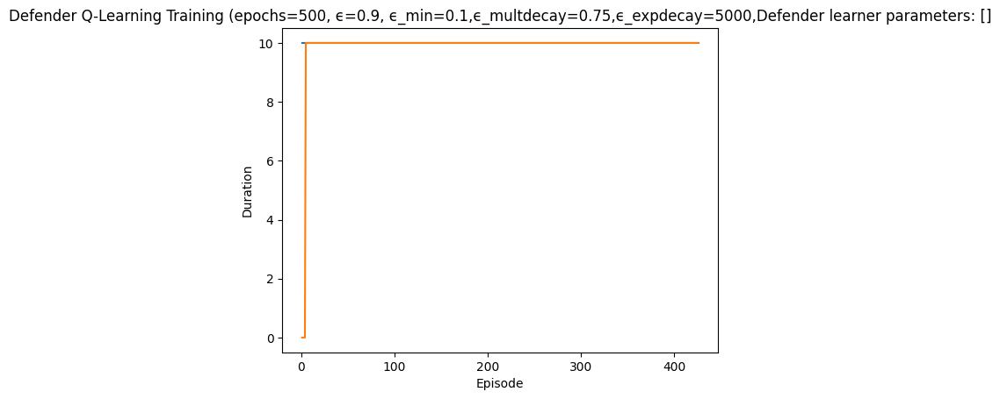

Rendering the current state of the environment
  ## Episode: 427/500 'Defender Q-Learning Training' ϵ=0.3310, Defender learner parameters: []


Episode 427|Iteration 10|reward:  130.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=9, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 4261, 'successful_actions': 1683, 'failed_actions': 2578}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=9, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4262, 'successful_actions': 1684, 'failed_actions': 2578}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=6, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4263, 'successful_actions': 1685, 'failed_actions': 2578}, 'network_availability': 1.0}
action type:  Reimage Node
Ite

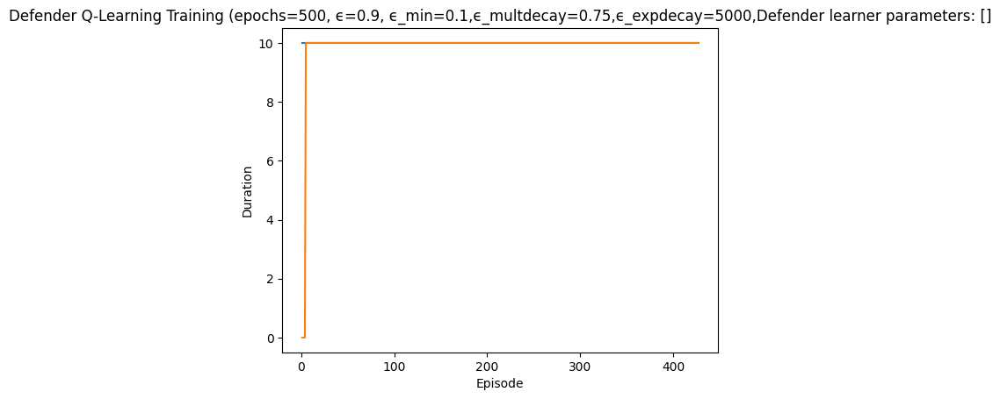

Rendering the current state of the environment
  ## Episode: 428/500 'Defender Q-Learning Training' ϵ=0.3305, Defender learner parameters: []


Episode 428|Iteration 10|reward:   45.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4271, 'successful_actions': 1689, 'failed_actions': 2582}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 4272, 'successful_actions': 1690, 'failed_actions': 2582}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=2, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNod

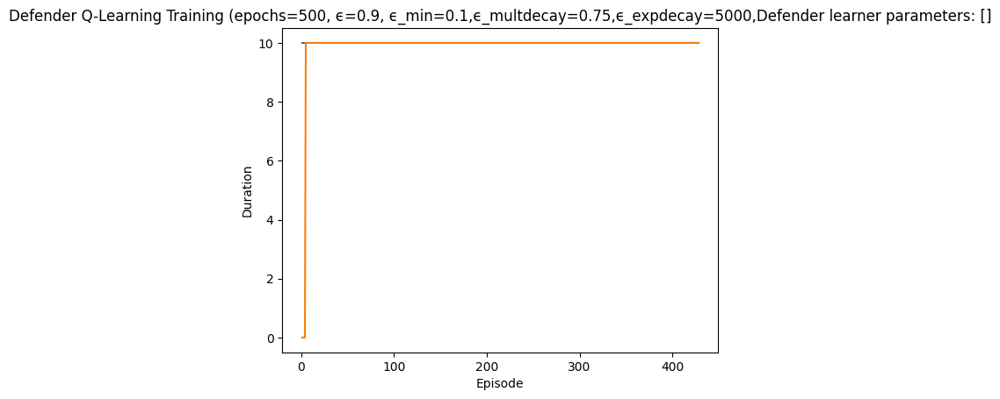

Rendering the current state of the environment
  ## Episode: 429/500 'Defender Q-Learning Training' ϵ=0.3300, Defender learner parameters: []


Episode 429|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4281, 'successful_actions': 1692, 'failed_actions': 2589}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4282, 'successful_actions': 1692, 'failed_actions': 2590}, 'network_availability': 1.0}
failed
{'action'

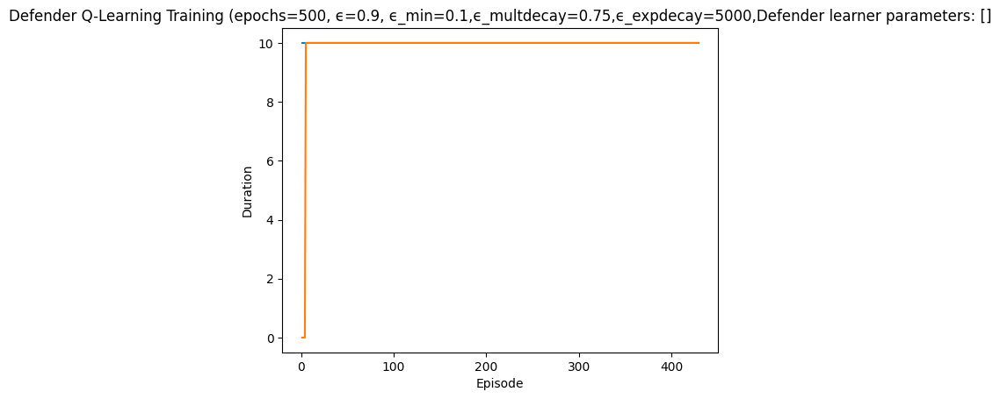

Rendering the current state of the environment
  ## Episode: 430/500 'Defender Q-Learning Training' ϵ=0.3295, Defender learner parameters: []


Episode 430|Iteration 10|reward:   15.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4291, 'successful_actions': 1695, 'failed_actions': 2596}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=10, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4292, 'successful_actions': 1696, 'failed_actions': 2596}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '13_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage

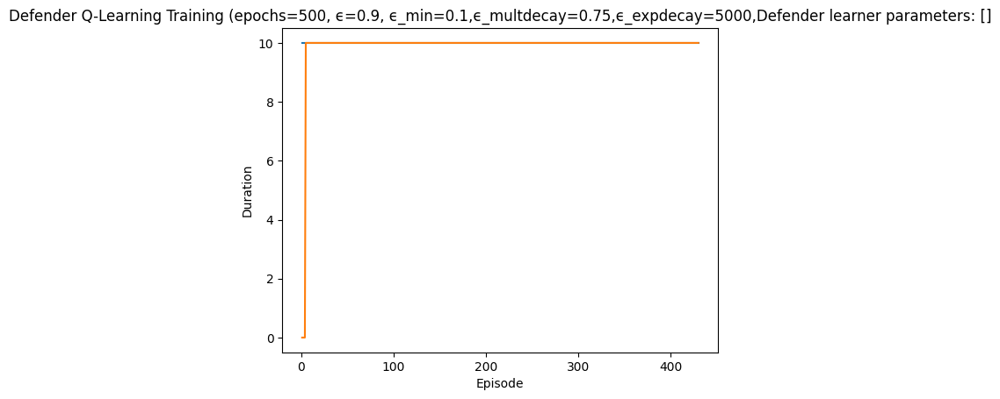

Rendering the current state of the environment
  ## Episode: 431/500 'Defender Q-Learning Training' ϵ=0.3289, Defender learner parameters: []


Episode 431|Iteration 10|reward:   90.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=2, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4301, 'successful_actions': 1699, 'failed_actions': 2602}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 4302, 'successful_actions': 1700, 'failed_actions': 2602}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 2, 'reason': 'Service not fo

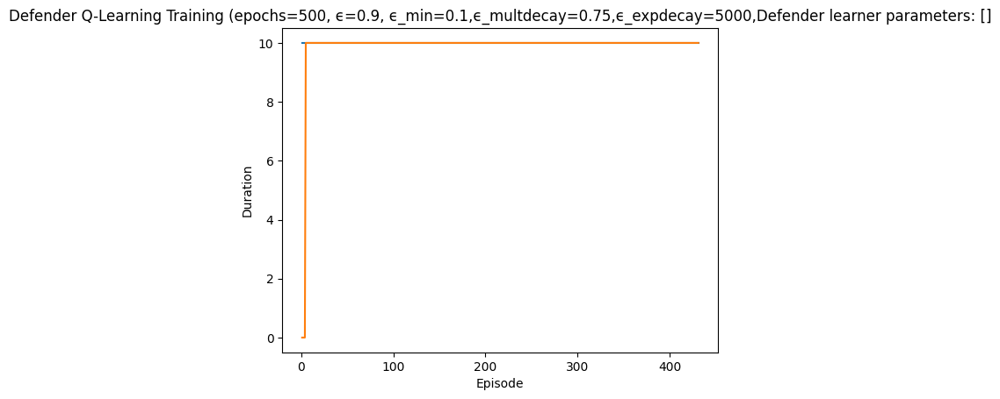

Rendering the current state of the environment
  ## Episode: 432/500 'Defender Q-Learning Training' ϵ=0.3284, Defender learner parameters: []


Episode 432|Iteration 10|reward:   25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4311, 'successful_actions': 1704, 'failed_actions': 2607}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4312, 'successful_actions': 1705, 'failed_actions': 2607}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Act

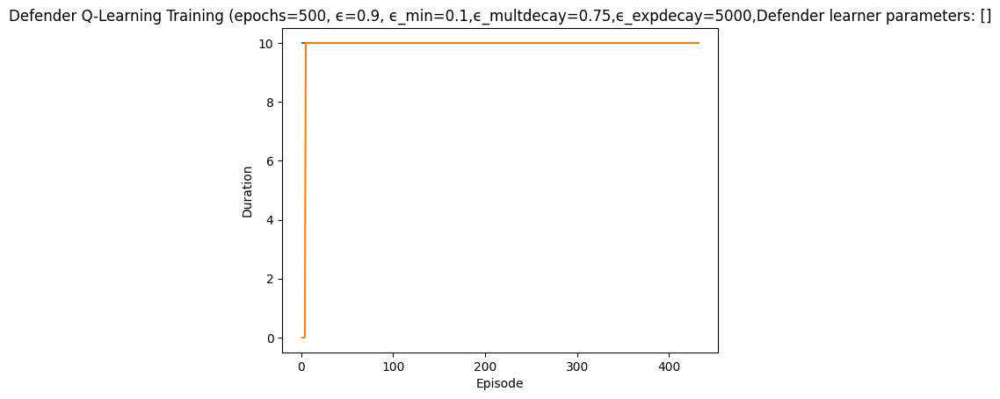

Rendering the current state of the environment
  ## Episode: 433/500 'Defender Q-Learning Training' ϵ=0.3279, Defender learner parameters: []


Episode 433|Iteration 10|reward:   25.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=8, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4321, 'successful_actions': 1708, 'failed_actions': 2613}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=2
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 2, 'performance_metrics': {'actions_taken': 4322, 'successful_actions': 1709, 'failed_actions': 2613}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=9, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_

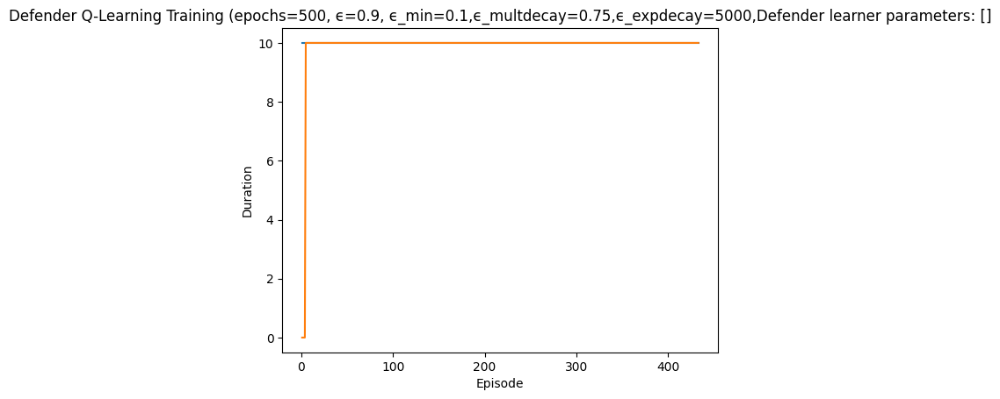

Rendering the current state of the environment
  ## Episode: 434/500 'Defender Q-Learning Training' ϵ=0.3274, Defender learner parameters: []


Episode 434|Iteration 10|reward:  -10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4331, 'successful_actions': 1712, 'failed_actions': 2619}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4332, 'successful_actions': 1712, 'failed_actions': 2620}, 'network_availability': 1.0}
failed
{'act

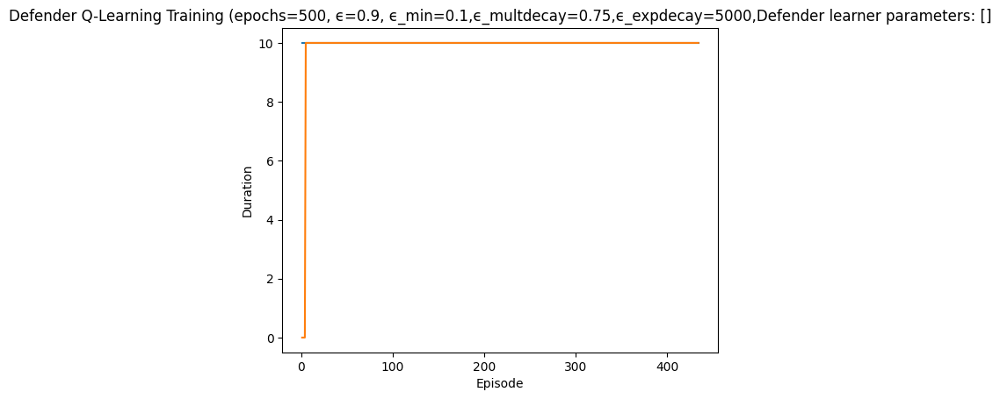

Rendering the current state of the environment
  ## Episode: 435/500 'Defender Q-Learning Training' ϵ=0.3269, Defender learner parameters: []


Episode 435|Iteration 10|reward:   15.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 4341, 'successful_actions': 1715, 'failed_actions': 2626}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=10, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 4342, 'successful_actions': 1716, 'failed_actions': 2626}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=7, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required -

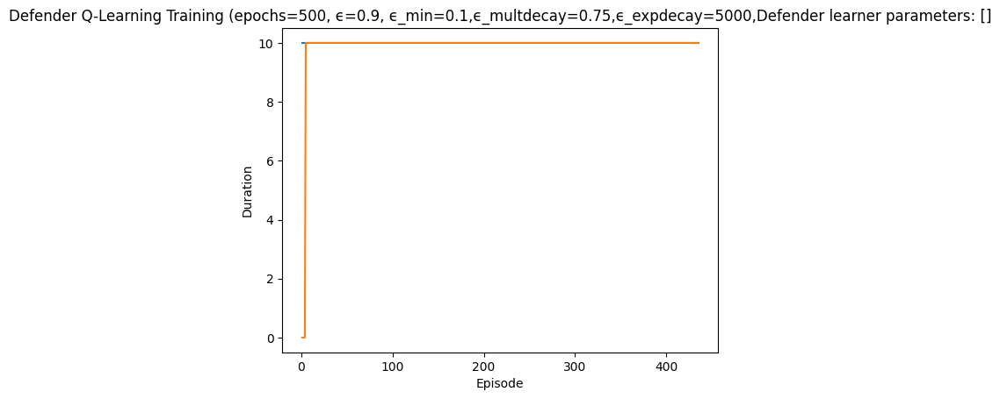

Rendering the current state of the environment
  ## Episode: 436/500 'Defender Q-Learning Training' ϵ=0.3264, Defender learner parameters: []


Episode 436|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '8_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4351, 'successful_actions': 1717, 'failed_actions': 2634}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 4352, 'successful_actions': 1718, 'failed_actions': 2634}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=10, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '9_Lin

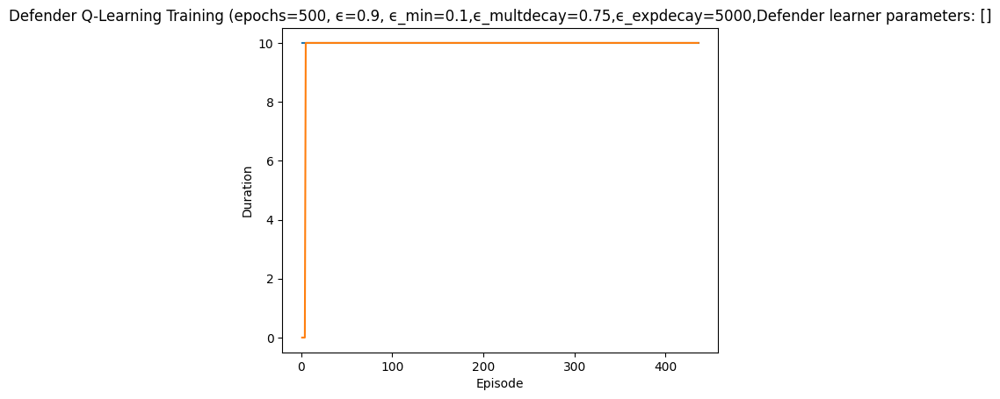

Rendering the current state of the environment
  ## Episode: 437/500 'Defender Q-Learning Training' ϵ=0.3259, Defender learner parameters: []


Episode 437|Iteration 10|reward: -120.0|last_reward_at: ----|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4361, 'successful_actions': 1722, 'failed_actions': 2639}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4362, 'successful_actions': 1722, 'failed_actions': 2640}, 'network_availability': 1.0}
failed
{'action

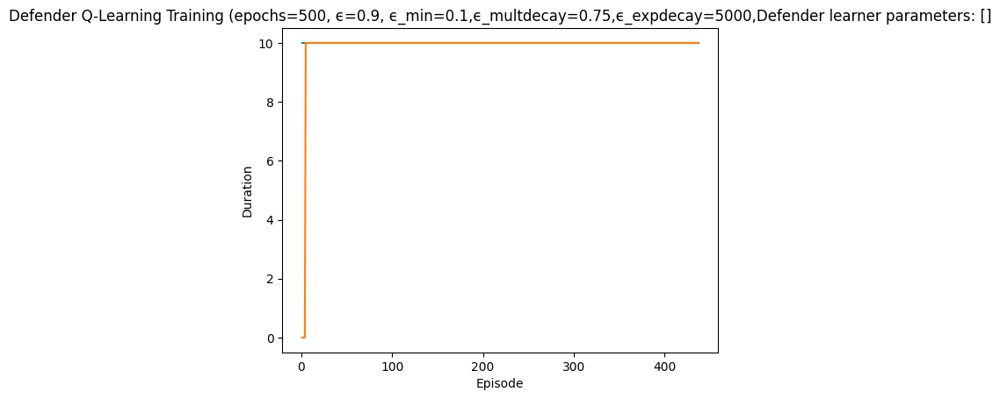

Rendering the current state of the environment
  ## Episode: 438/500 'Defender Q-Learning Training' ϵ=0.3254, Defender learner parameters: []


Episode 438|Iteration 10|reward:  -95.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=0, Parameter=8
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4371, 'successful_actions': 1722, 'failed_actions': 2649}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=0, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4372, 'successful_actions': 1722, 'failed_actions': 2650}, 'network_availability': 1.0}
failed
{'action': 'start_servi

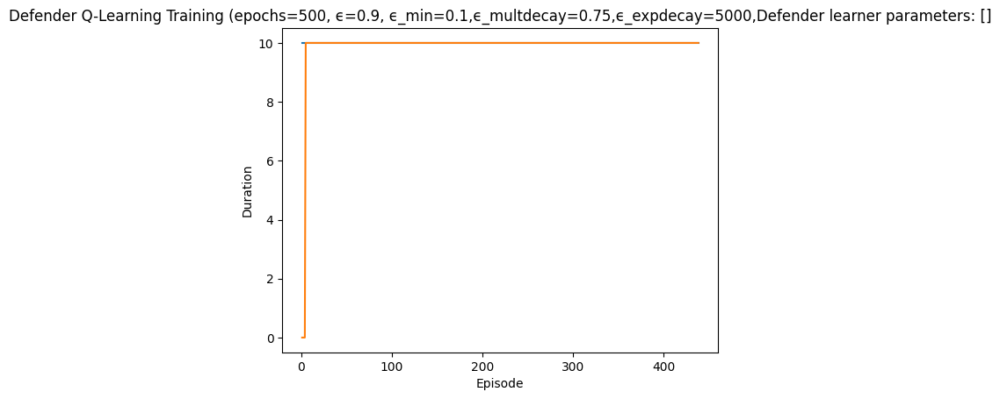

Rendering the current state of the environment
  ## Episode: 439/500 'Defender Q-Learning Training' ϵ=0.3249, Defender learner parameters: []


Episode 439|Iteration 10|reward:   30.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4381, 'successful_actions': 1723, 'failed_actions': 2658}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=11, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 4382, 'successful_actions': 1724, 'failed_actions': 2658}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3

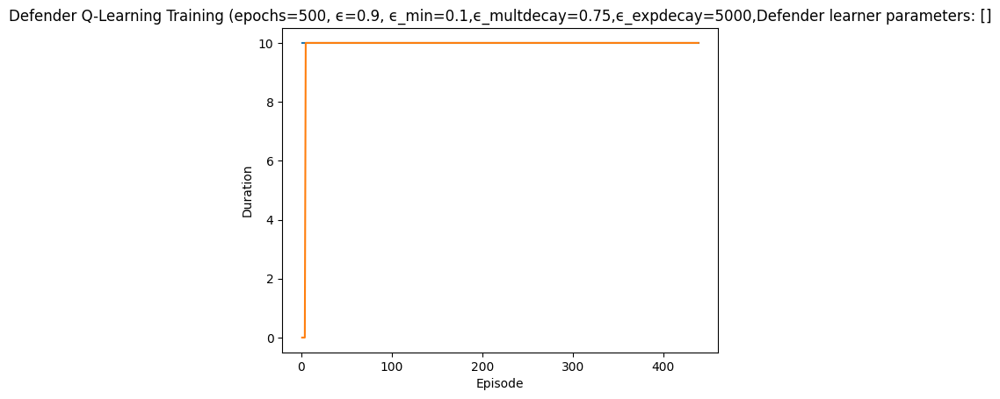

Rendering the current state of the environment
  ## Episode: 440/500 'Defender Q-Learning Training' ϵ=0.3244, Defender learner parameters: []


Episode 440|Iteration 10|reward:   15.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4391, 'successful_actions': 1726, 'failed_actions': 2665}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4392, 'successful_actions': 1726, 'failed_actions': 2666}, 'network_availability': 1.0}
failed
{'ac

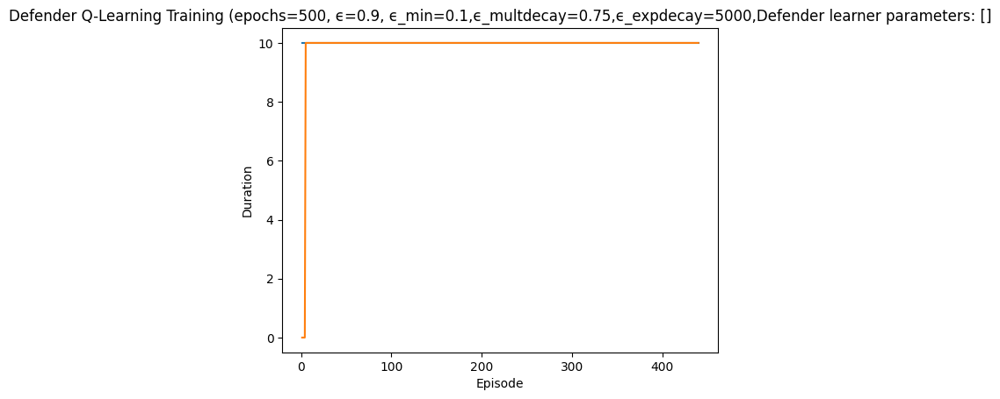

Rendering the current state of the environment
  ## Episode: 441/500 'Defender Q-Learning Training' ϵ=0.3239, Defender learner parameters: []


Episode 441|Iteration 10|reward:   10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=11, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4401, 'successful_actions': 1729, 'failed_actions': 2672}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4402, 'successful_actions': 1729, 'failed_actions': 2673}, 'network_availability': 1.0}
action type:  Blo

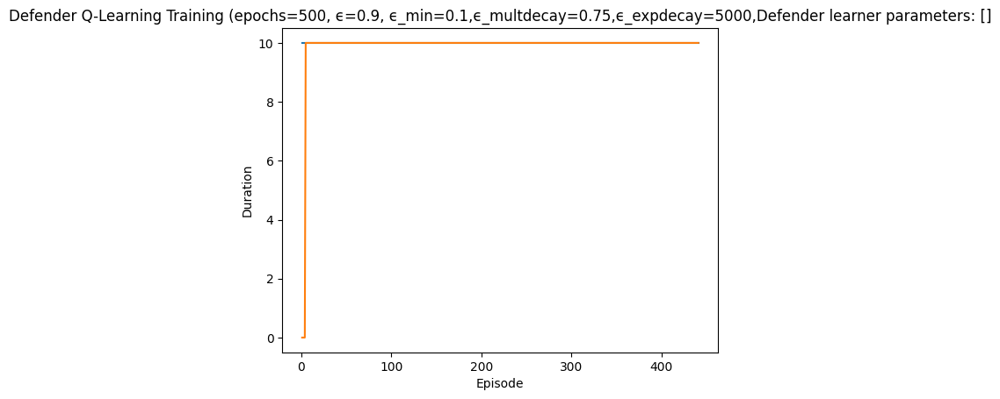

Rendering the current state of the environment
  ## Episode: 442/500 'Defender Q-Learning Training' ϵ=0.3234, Defender learner parameters: []


Episode 442|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=12, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4411, 'successful_actions': 1733, 'failed_actions': 2678}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=1, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4412, 'successful_actions': 1733, 'failed_actions': 2679}, 'network_availability': 1.0}
action ty

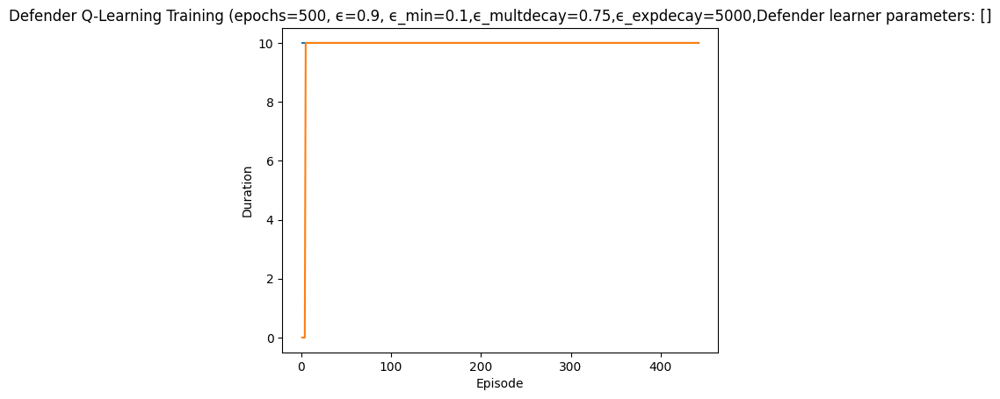

Rendering the current state of the environment
  ## Episode: 443/500 'Defender Q-Learning Training' ϵ=0.3229, Defender learner parameters: []


Episode 443|Iteration 10|reward:    0.0|last_reward_at:    5|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 4421, 'successful_actions': 1739, 'failed_actions': 2682}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=12, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4422, 'successful_actions': 1740, 'failed_actions': 2682}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Action Taken: Type=Start Service, NodeID=4, Parameter=3
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 3, 'reason': 'Servic

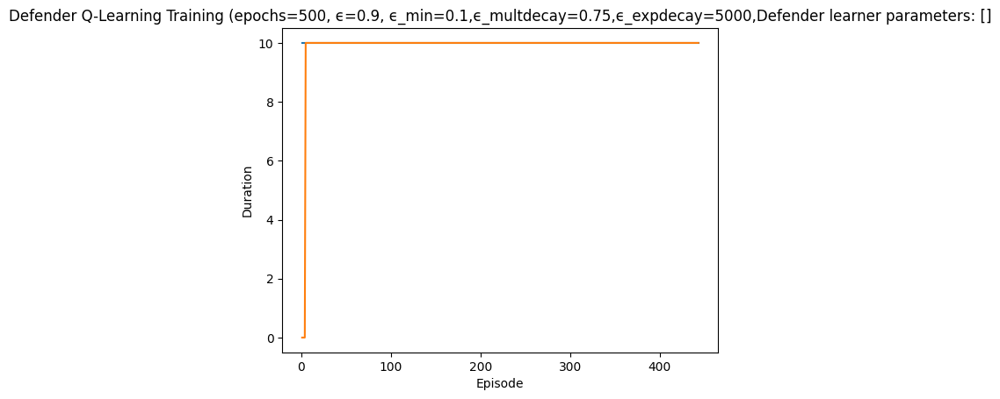

Rendering the current state of the environment
  ## Episode: 444/500 'Defender Q-Learning Training' ϵ=0.3224, Defender learner parameters: []


Episode 444|Iteration 10|reward:  170.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4431, 'successful_actions': 1742, 'failed_actions': 2689}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=10, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4432, 'successful_actions': 1742, 'failed_actions': 2690}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=2, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name'

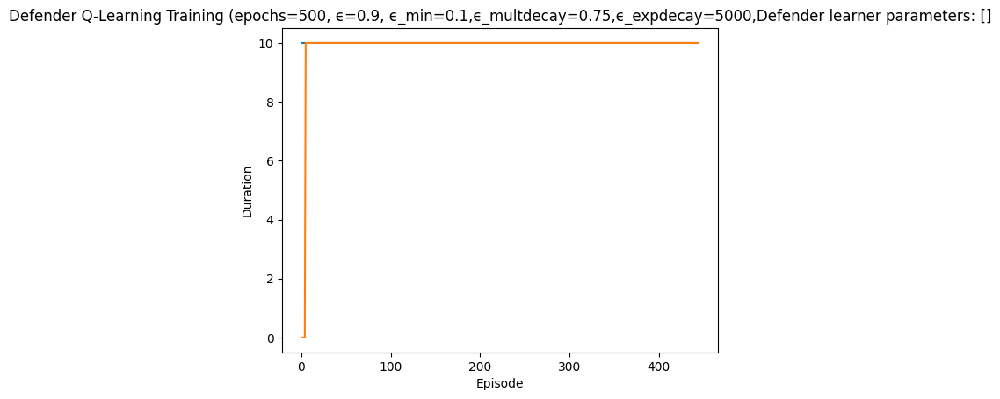

Rendering the current state of the environment
  ## Episode: 445/500 'Defender Q-Learning Training' ϵ=0.3219, Defender learner parameters: []


Episode 445|Iteration 10|reward:  -15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4441, 'successful_actions': 1749, 'failed_actions': 2692}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=5, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4442, 'successful_actions': 1749, 'failed_actions': 2693}, 'network_availability': 1.0}
action t

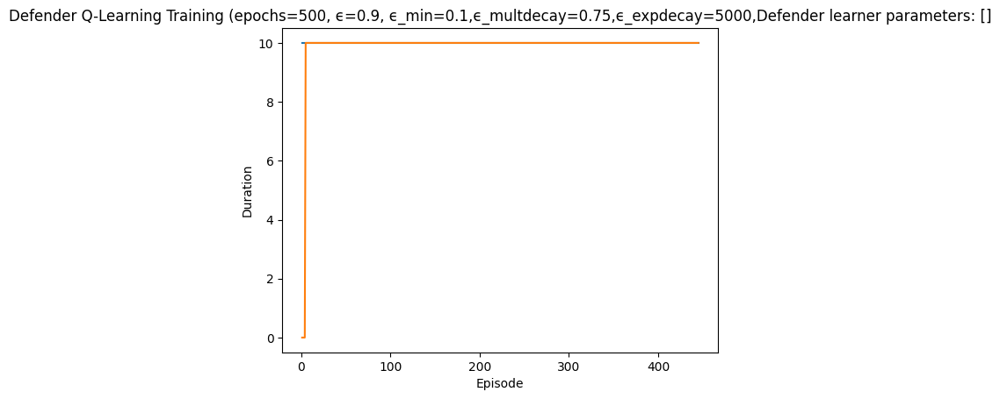

Rendering the current state of the environment
  ## Episode: 446/500 'Defender Q-Learning Training' ϵ=0.3214, Defender learner parameters: []


Episode 446|Iteration 10|reward:    0.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=0, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4451, 'successful_actions': 1752, 'failed_actions': 2699}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=9, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 4452, 'successful_actions': 1753, 'failed_actions': 2699}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 

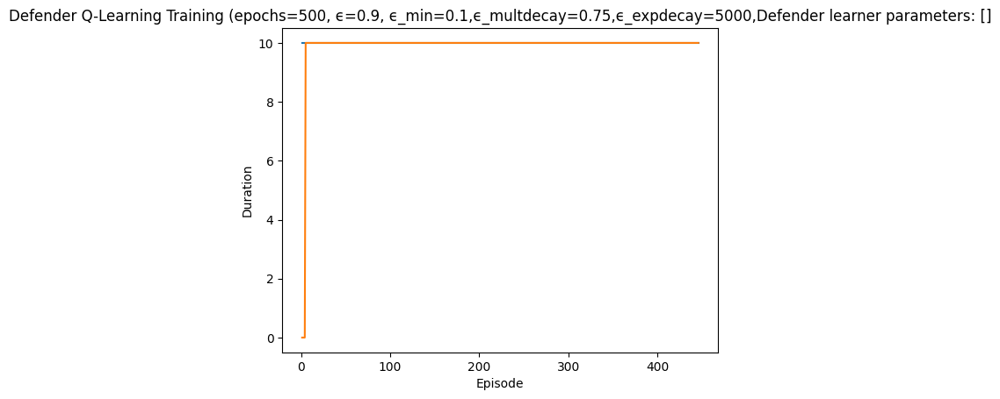

Rendering the current state of the environment
  ## Episode: 447/500 'Defender Q-Learning Training' ϵ=0.3210, Defender learner parameters: []


Episode 447|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4461, 'successful_actions': 1755, 'failed_actions': 2706}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=13, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4462, 'successful_actions': 1755, 'failed_actions': 2707}, 'network_availability': 1.0}
failed


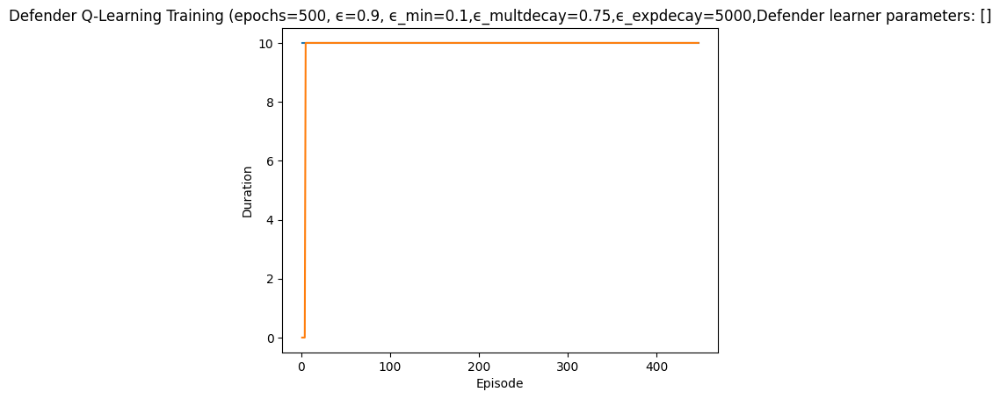

Rendering the current state of the environment
  ## Episode: 448/500 'Defender Q-Learning Training' ϵ=0.3205, Defender learner parameters: []


Episode 448|Iteration 10|reward:  -90.0|last_reward_at: ----|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4471, 'successful_actions': 1759, 'failed_actions': 2712}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=13, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4472, 'successful_actions': 1759, 'failed_actions': 2713}, 'network_availability': 

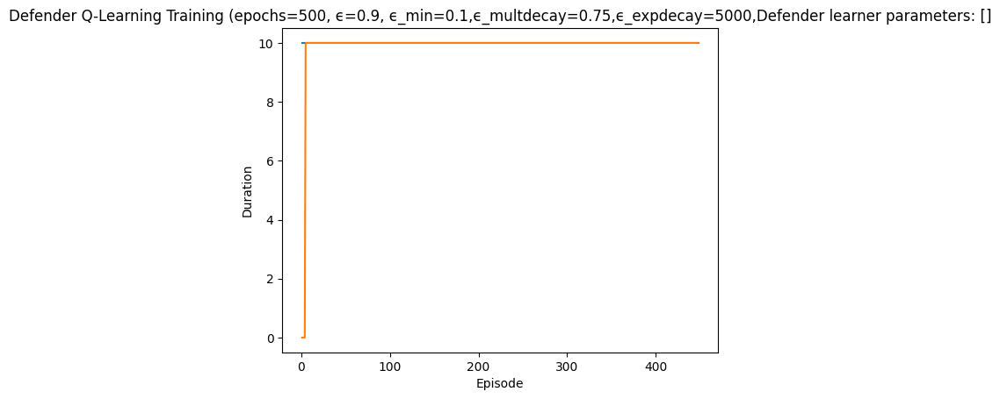

Rendering the current state of the environment
  ## Episode: 449/500 'Defender Q-Learning Training' ϵ=0.3200, Defender learner parameters: []


Episode 449|Iteration 10|reward:   80.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 4481, 'successful_actions': 1760, 'failed_actions': 2721}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=9
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 4482, 'successful_actions': 1761, 'failed_actions': 2721}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 0, 'reason': 'Service not foun

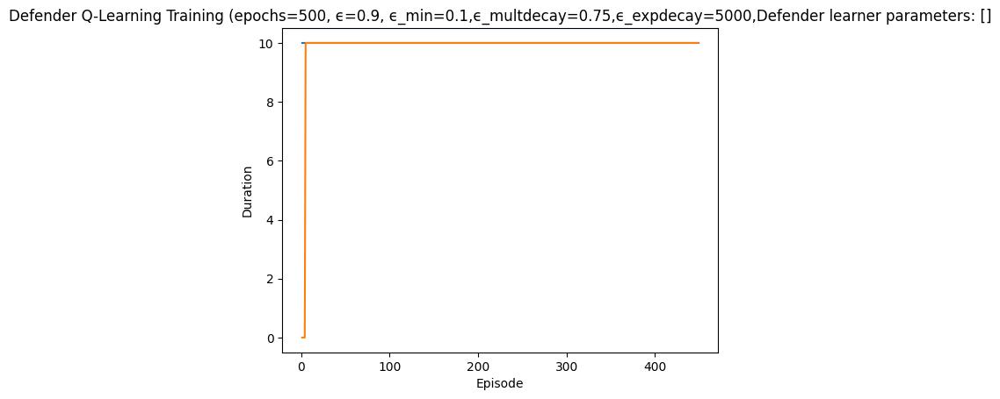

Rendering the current state of the environment
  ## Episode: 450/500 'Defender Q-Learning Training' ϵ=0.3195, Defender learner parameters: []


Episode 450|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4491, 'successful_actions': 1764, 'failed_actions': 2727}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4492, 'successful_actions': 1765, 'failed_actions': 2727}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Ac

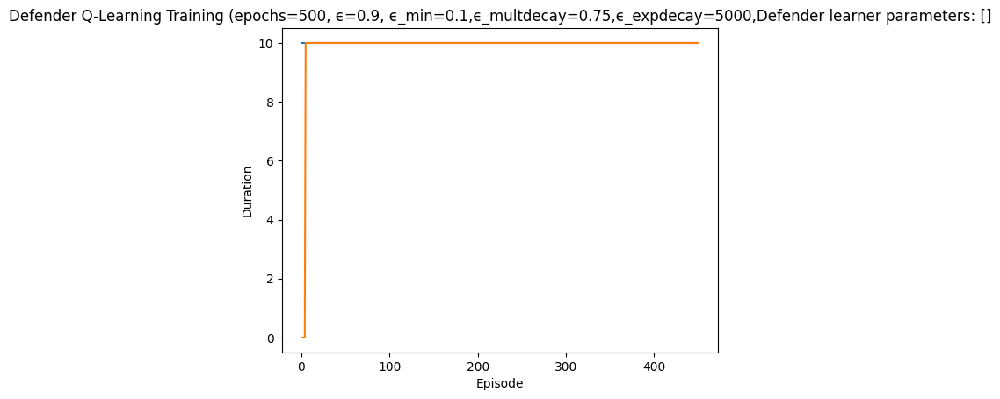

Rendering the current state of the environment
  ## Episode: 451/500 'Defender Q-Learning Training' ϵ=0.3190, Defender learner parameters: []


Episode 451|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=1, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4501, 'successful_actions': 1768, 'failed_actions': 2733}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=8
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4502, 'successful_actions': 1768, 'failed_actions': 2734}, 'network_availability': 1.0}
failed
{'a

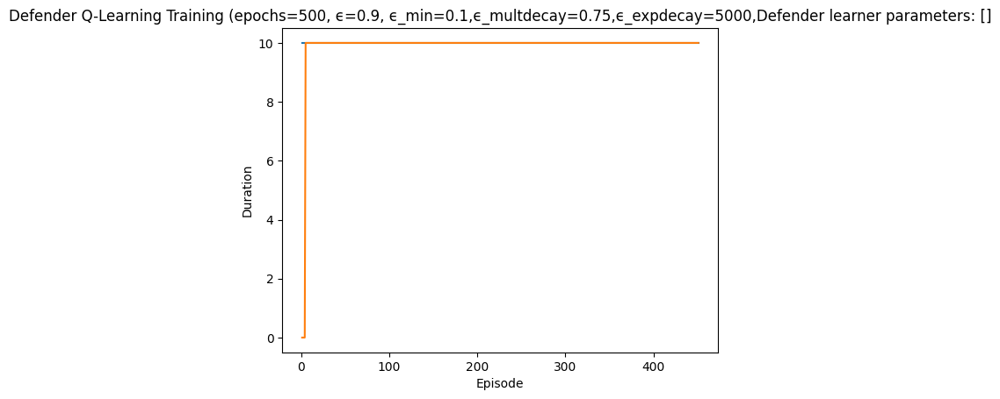

Rendering the current state of the environment
  ## Episode: 452/500 'Defender Q-Learning Training' ϵ=0.3185, Defender learner parameters: []


Episode 452|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4511, 'successful_actions': 1771, 'failed_actions': 2740}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4512, 'successful_actions': 1771, 'failed_actions': 2741}, 'network_availability': 1.0}


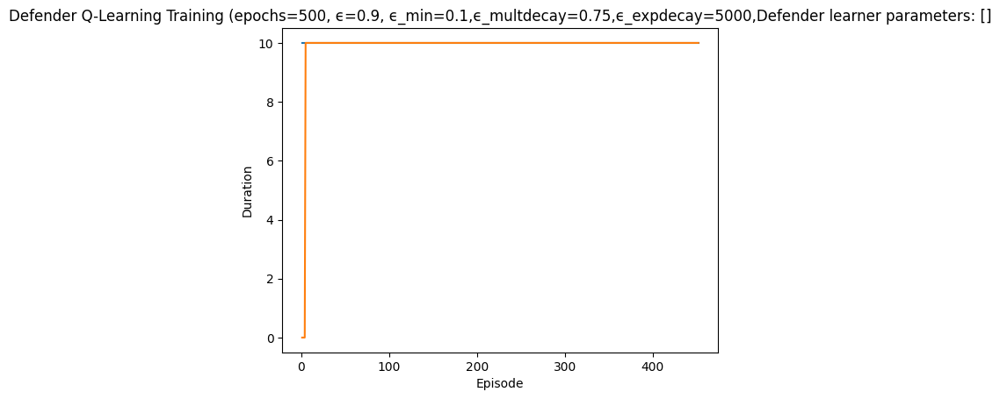

Rendering the current state of the environment
  ## Episode: 453/500 'Defender Q-Learning Training' ϵ=0.3180, Defender learner parameters: []


Episode 453|Iteration 10|reward:    0.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4521, 'successful_actions': 1774, 'failed_actions': 2747}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=2, Parameter=1
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4522, 'successful_actions': 1775, 'failed_actions': 2747}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=13, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12

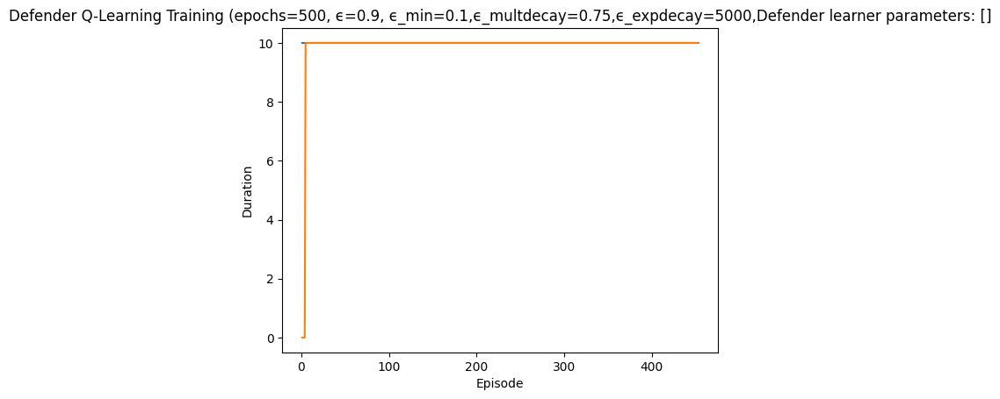

Rendering the current state of the environment
  ## Episode: 454/500 'Defender Q-Learning Training' ϵ=0.3175, Defender learner parameters: []


Episode 454|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4531, 'successful_actions': 1777, 'failed_actions': 2754}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=10, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4532, 'successful_actions': 1777, 'failed_actions': 2755}, 'network_availability': 1.0}
action type:  Blo

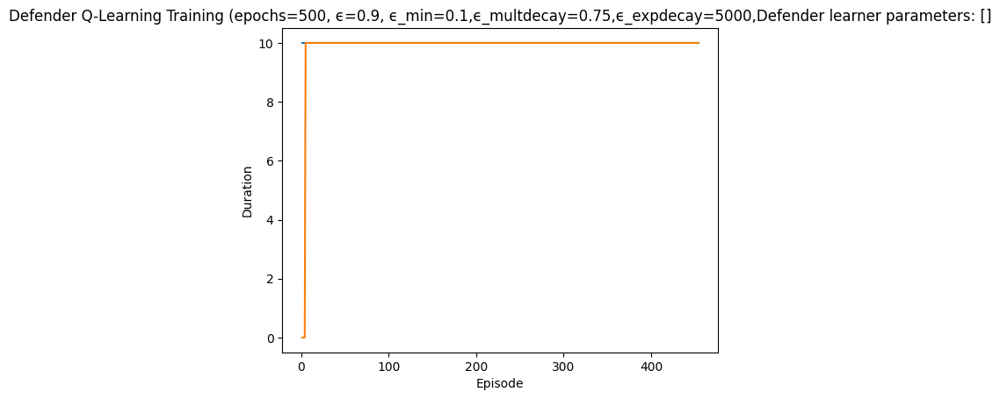

Rendering the current state of the environment
  ## Episode: 455/500 'Defender Q-Learning Training' ϵ=0.3170, Defender learner parameters: []


Episode 455|Iteration 10|reward:   50.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=9, Parameter=5
info {'action': 'block_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 4541, 'successful_actions': 1781, 'failed_actions': 2760}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=3, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4542, 'successful_actions': 1781, 'failed_actions': 2761}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteratio

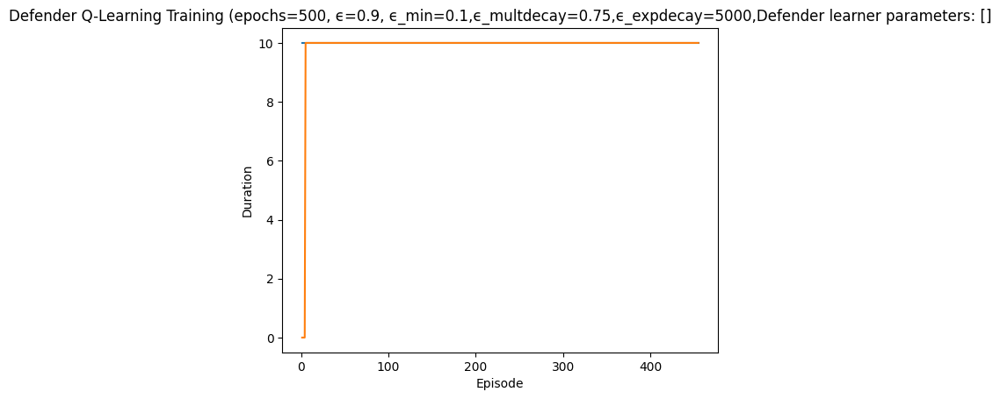

Rendering the current state of the environment
  ## Episode: 456/500 'Defender Q-Learning Training' ϵ=0.3166, Defender learner parameters: []


Episode 456|Iteration 10|reward:  -25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=2, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 4551, 'successful_actions': 1786, 'failed_actions': 2765}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4552, 'successful_actions': 1786, 'failed_actions': 2766}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iterat

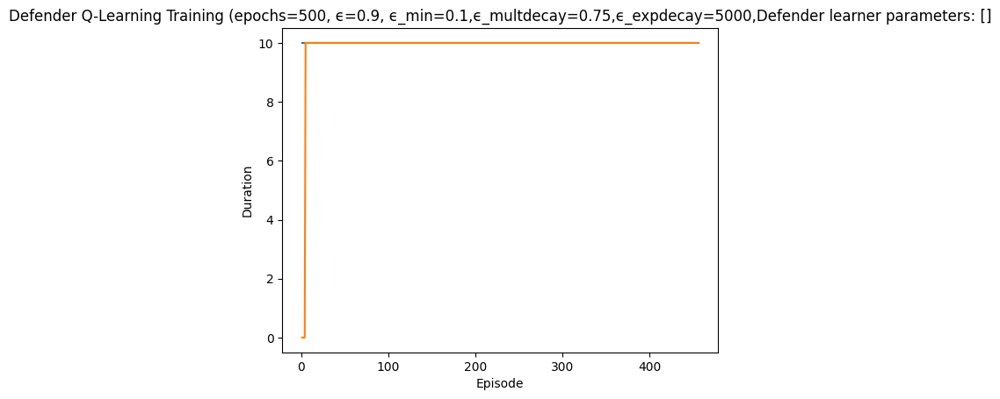

Rendering the current state of the environment
  ## Episode: 457/500 'Defender Q-Learning Training' ϵ=0.3161, Defender learner parameters: []


Episode 457|Iteration 10|reward:   15.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=4
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4561, 'successful_actions': 1787, 'failed_actions': 2774}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=2, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4562, 'successful_actions': 1788, 'failed_actions': 2774}, 'network_availability': 1.0}
failed
{'action': 'allow_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running'}
not reimaged
action type:  Reimage Node
Iteration 3: Action

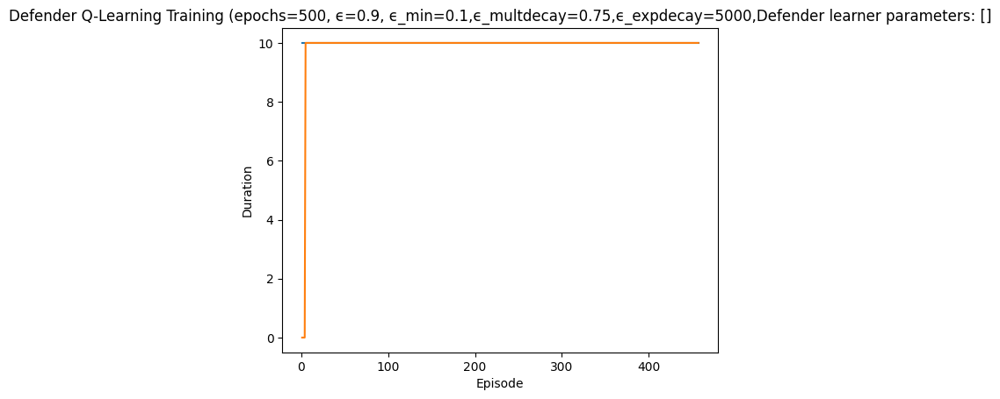

Rendering the current state of the environment
  ## Episode: 458/500 'Defender Q-Learning Training' ϵ=0.3156, Defender learner parameters: []


Episode 458|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=0
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4571, 'successful_actions': 1790, 'failed_actions': 2781}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4572, 'successful_actions': 1791, 'failed_actions': 2781}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 

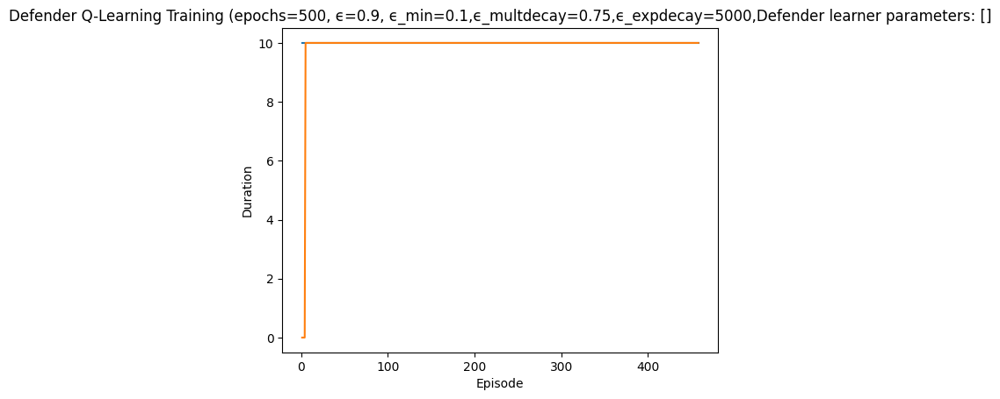

Rendering the current state of the environment
  ## Episode: 459/500 'Defender Q-Learning Training' ϵ=0.3151, Defender learner parameters: []


Episode 459|Iteration 10|reward:   65.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=8
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4581, 'successful_actions': 1794, 'failed_actions': 2787}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=1, Parameter=6
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4582, 'successful_actions': 1795, 'failed_actions': 2787}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=4, Parameter=2
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_Linux

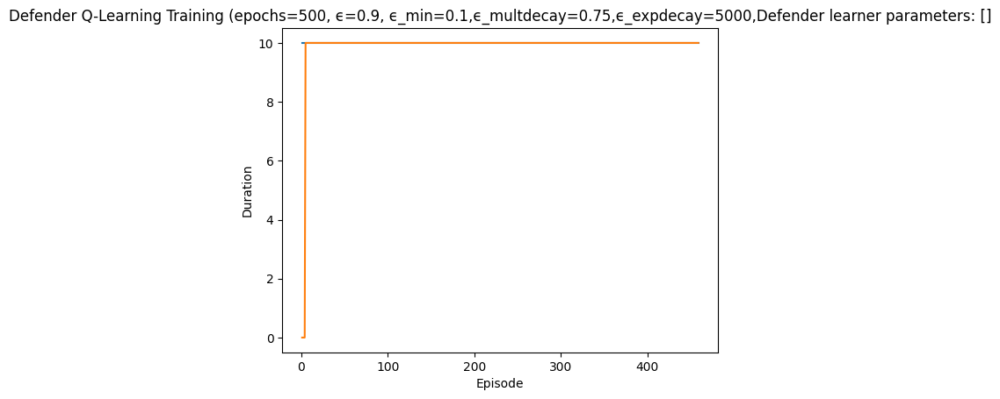

Rendering the current state of the environment
  ## Episode: 460/500 'Defender Q-Learning Training' ϵ=0.3146, Defender learner parameters: []


Episode 460|Iteration 10|reward:   65.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=7
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 7, 'performance_metrics': {'actions_taken': 4591, 'successful_actions': 1800, 'failed_actions': 2791}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=2, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4592, 'successful_actions': 1800, 'failed_actions': 2792}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=2, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '1_LinuxNode', 'port_na

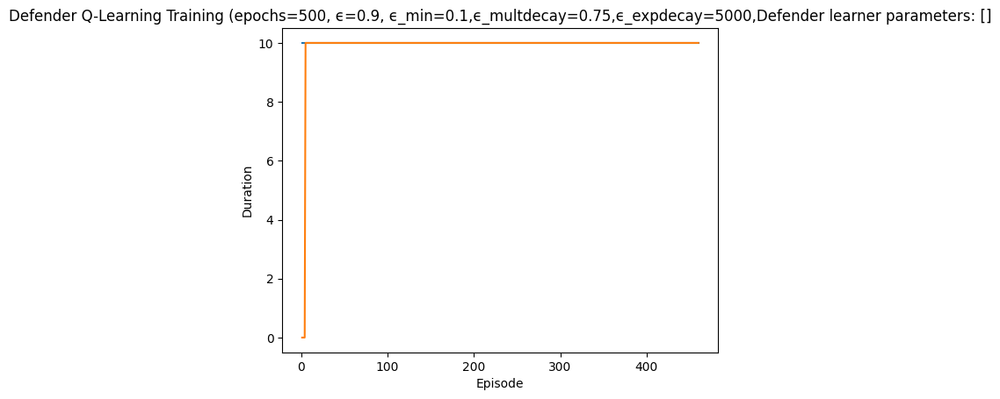

Rendering the current state of the environment
  ## Episode: 461/500 'Defender Q-Learning Training' ϵ=0.3142, Defender learner parameters: []


Episode 461|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=11, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4601, 'successful_actions': 1805, 'failed_actions': 2796}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=0, Parameter=9
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 9, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4602, 'successful_actions': 1805, 'failed_actions': 2797}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Act

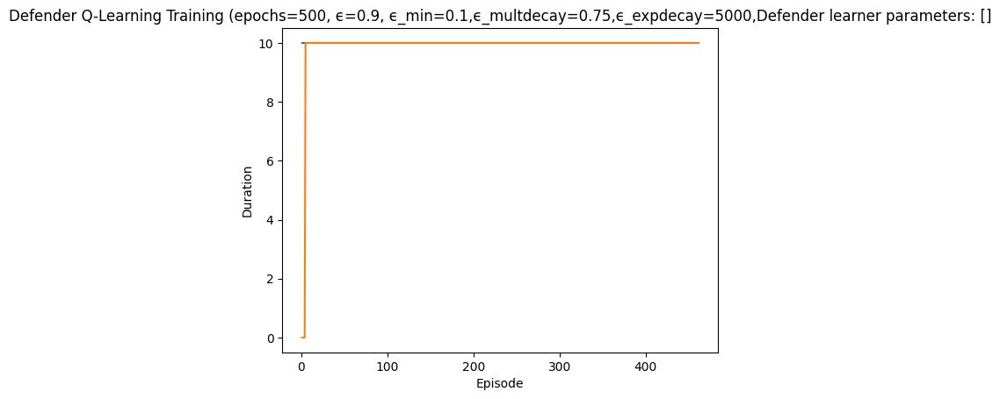

Rendering the current state of the environment
  ## Episode: 462/500 'Defender Q-Learning Training' ϵ=0.3137, Defender learner parameters: []


Episode 462|Iteration 10|reward:  -55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4611, 'successful_actions': 1808, 'failed_actions': 2803}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4612, 'successful_actions': 1808, 'failed_actions': 2804}, 'network_availability': 1.0}


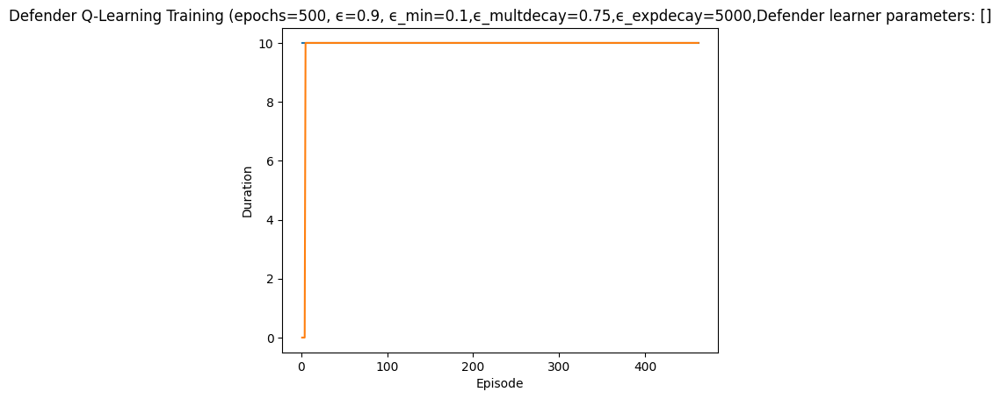

Rendering the current state of the environment
  ## Episode: 463/500 'Defender Q-Learning Training' ϵ=0.3132, Defender learner parameters: []


Episode 463|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=7, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4621, 'successful_actions': 1811, 'failed_actions': 2810}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=13, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4622, 'successful_actions': 1811, 'failed_actions': 2811}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '9_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Itera

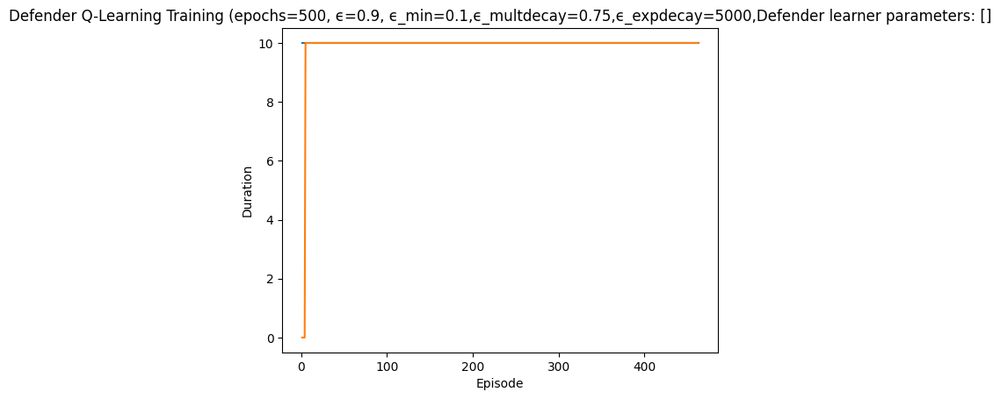

Rendering the current state of the environment
  ## Episode: 464/500 'Defender Q-Learning Training' ϵ=0.3127, Defender learner parameters: []


Episode 464|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4631, 'successful_actions': 1814, 'failed_actions': 2817}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=12, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '11_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4632, 'successful_actions': 1814, 'failed_actions': 2818}, 'network_availab

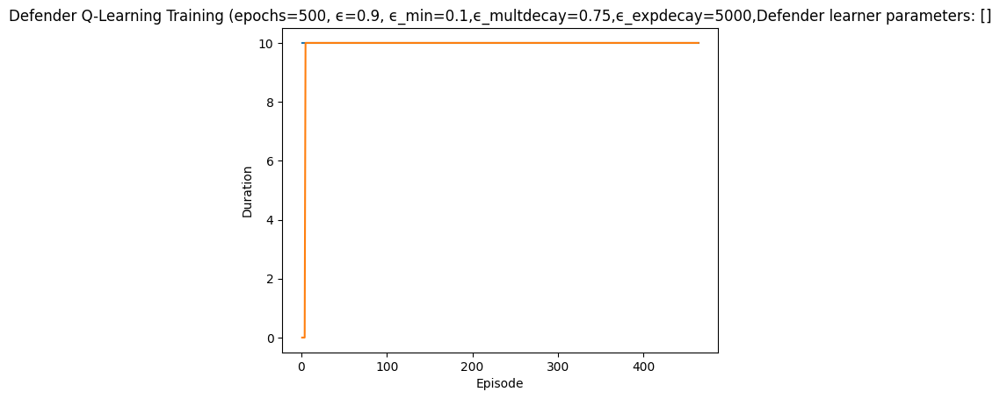

Rendering the current state of the environment
  ## Episode: 465/500 'Defender Q-Learning Training' ϵ=0.3123, Defender learner parameters: []


Episode 465|Iteration 10|reward:  -40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=6, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4641, 'successful_actions': 1817, 'failed_actions': 2824}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=6
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4642, 'successful_actions': 1817, 'failed_actions': 2825}, 'network_availability': 1.0}
failed
{'actio

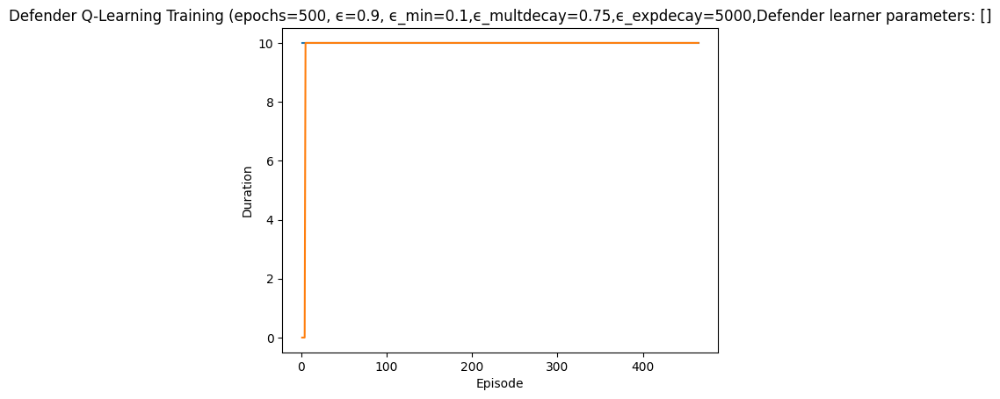

Rendering the current state of the environment
  ## Episode: 466/500 'Defender Q-Learning Training' ϵ=0.3118, Defender learner parameters: []


Episode 466|Iteration 10|reward:   50.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=8, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4651, 'successful_actions': 1820, 'failed_actions': 2831}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4652, 'successful_actions': 1820, 'failed_actions': 2832}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Act

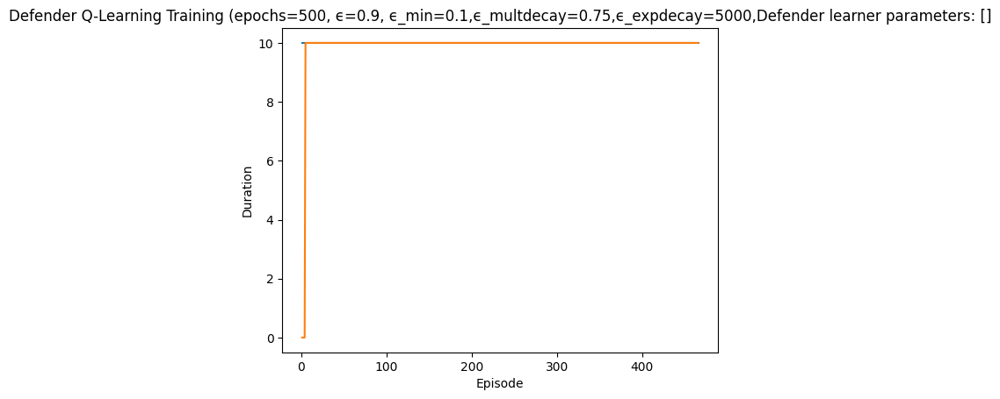

Rendering the current state of the environment
  ## Episode: 467/500 'Defender Q-Learning Training' ϵ=0.3113, Defender learner parameters: []


Episode 467|Iteration 10|reward:    0.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=2, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4661, 'successful_actions': 1824, 'failed_actions': 2837}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4662, 'successful_actions': 1825, 'failed_actions': 2837}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=10, Parameter=7
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_nam

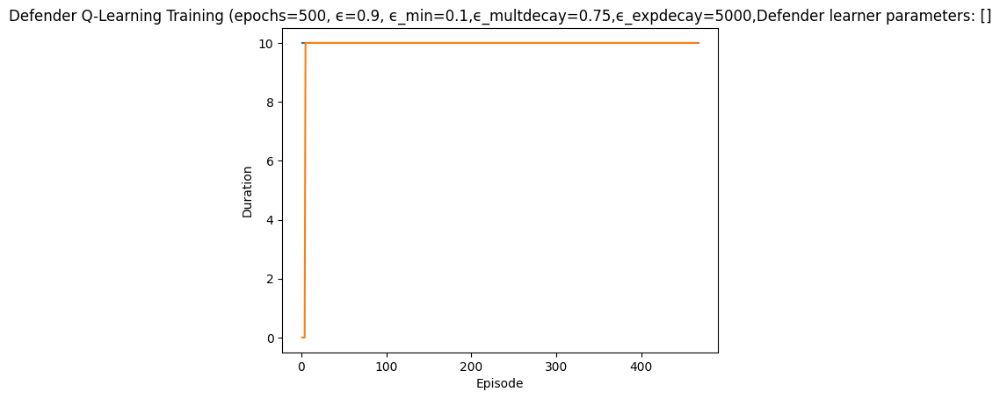

Rendering the current state of the environment
  ## Episode: 468/500 'Defender Q-Learning Training' ϵ=0.3108, Defender learner parameters: []


Episode 468|Iteration 10|reward:  -65.0|last_reward_at:    6|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4671, 'successful_actions': 1827, 'failed_actions': 2844}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=2, Parameter=1
info {'action': 'start_service', 'status': 'failed', 'node_id': '1_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4672, 'successful_actions': 1827, 'failed_actions': 2845}, 'network_availability': 1.0

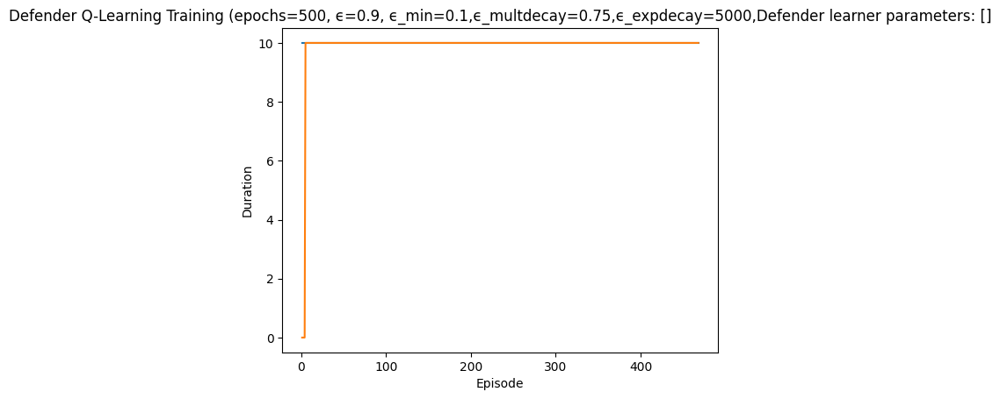

Rendering the current state of the environment
  ## Episode: 469/500 'Defender Q-Learning Training' ϵ=0.3104, Defender learner parameters: []


Episode 469|Iteration 10|reward:   15.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=11, Parameter=8
info {'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4681, 'successful_actions': 1828, 'failed_actions': 2853}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4682, 'successful_actions': 1829, 'failed_actions': 2853}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '12_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iter

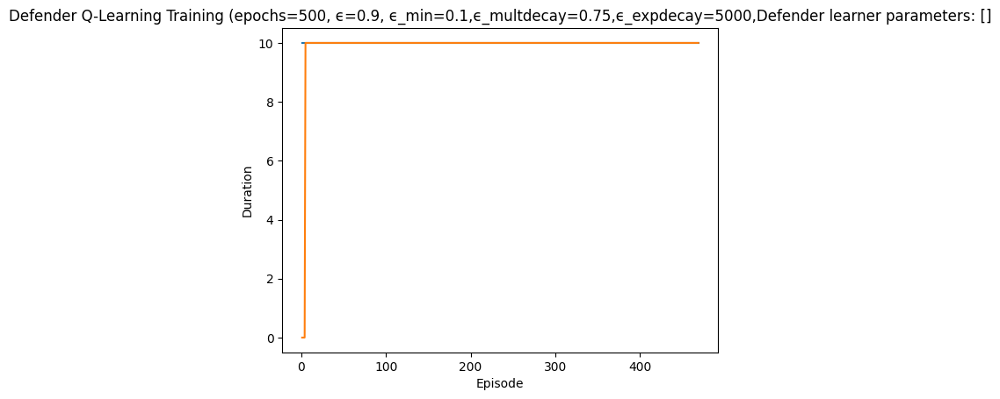

Rendering the current state of the environment
  ## Episode: 470/500 'Defender Q-Learning Training' ϵ=0.3099, Defender learner parameters: []


Episode 470|Iteration 9|reward:   40.0|last_reward_at:    7|Elapsed Time: 0:00:00||

failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=8, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4691, 'successful_actions': 1831, 'failed_actions': 2860}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4692, 'successful_actions': 1831, 'failed_actions': 2861}, 'network_availability': 1.0}


Episode 470|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 10: Action Taken: Type=Reimage Node, NodeID=4, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 3, 'performance_metrics': {'actions_taken': 4700, 'successful_actions': 1836, 'failed_actions': 2864}, 'network_availability': 1.0}
  Episode 470 stopped at t=10 
  Breakdown [Reward/NoReward (Success rate)]
    explore-local: 0/0 (NaN)
    explore-remote: 0/0 (NaN)
    explore-connect: 0/0 (NaN)
    exploit-local: 0/0 (NaN)
    exploit-remote: 0/0 (NaN)
    exploit-connect: 0/0 (NaN)
  exploit deflected to exploration: 4
  Episode 470 breakdown:
    Successful Reimaging Count: 1
    Starting Services Count: 0
    Allowing Traffic Count: 913
    Blocking Traffic Count: 922
    Stopping Services Count: 0


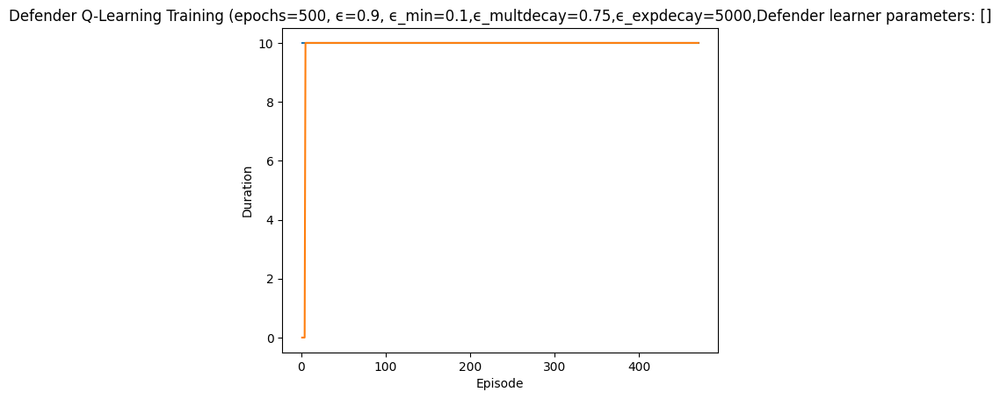

Rendering the current state of the environment
  ## Episode: 471/500 'Defender Q-Learning Training' ϵ=0.3094, Defender learner parameters: []


Episode 471|Iteration 10|reward:   25.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=3
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 3, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4701, 'successful_actions': 1836, 'failed_actions': 2865}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=8, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '7_LinuxNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4702, 'successful_actions': 1836, 'failed_actions': 2866}, 'network_availability': 1.0}
action type:

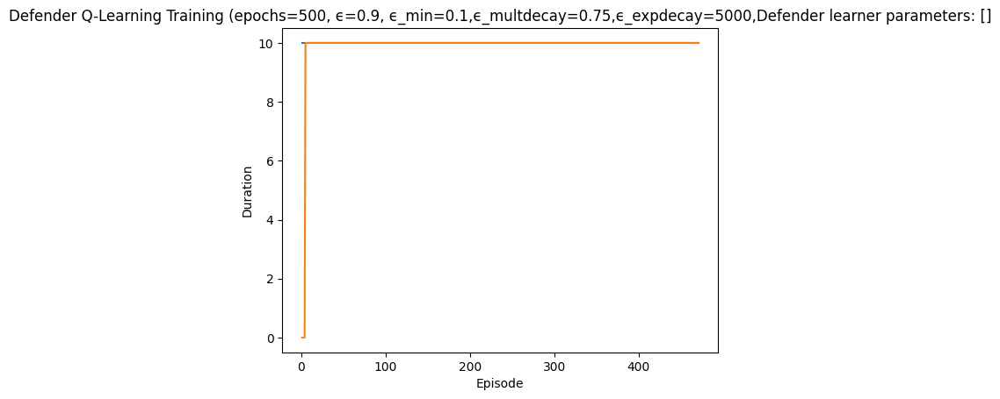

Rendering the current state of the environment
  ## Episode: 472/500 'Defender Q-Learning Training' ϵ=0.3090, Defender learner parameters: []


Episode 472|Iteration 10|reward:   80.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=9, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4711, 'successful_actions': 1841, 'failed_actions': 2870}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=4, Parameter=0
info {'action': 'block_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4712, 'successful_actions': 1842, 'failed_actions': 2870}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Action Taken: Type=Allow Traffic, NodeID=6, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 6, 'reason': 'Service not fo

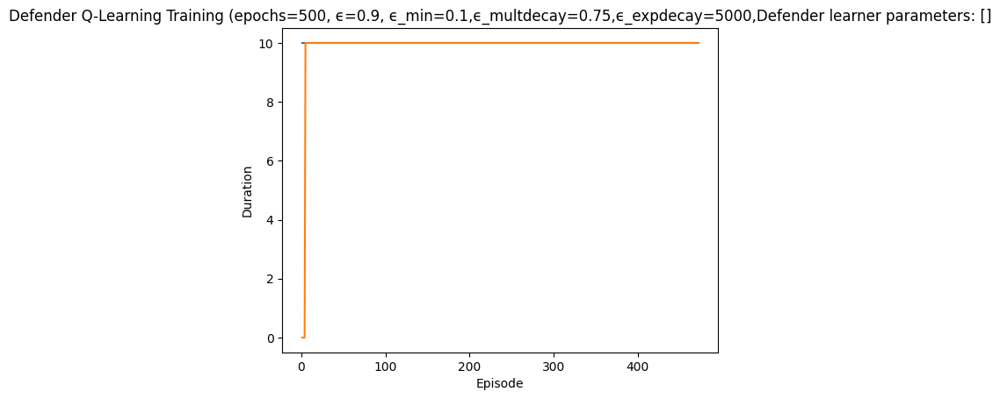

Rendering the current state of the environment
  ## Episode: 473/500 'Defender Q-Learning Training' ϵ=0.3085, Defender learner parameters: []


Episode 473|Iteration 10|reward:  -25.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=4, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4721, 'successful_actions': 1845, 'failed_actions': 2876}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4722, 'successful_actions': 1845, 'failed_actions': 2877}, 'network_availability': 1.0}
failed
{'action'

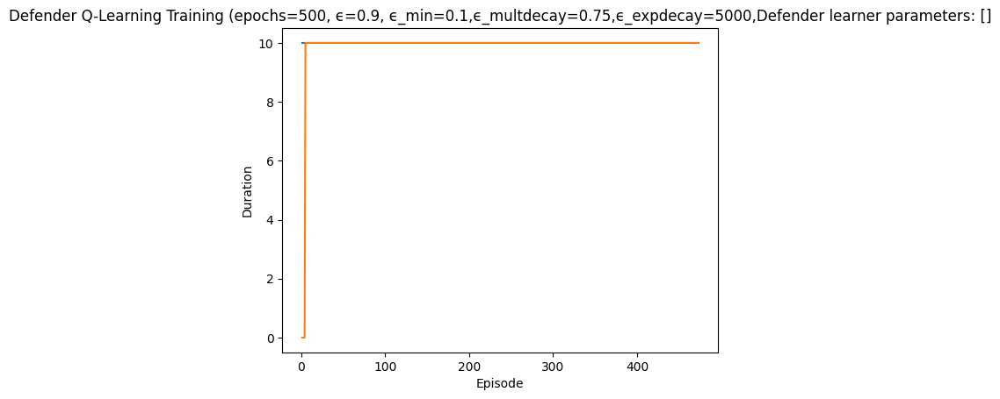

Rendering the current state of the environment
  ## Episode: 474/500 'Defender Q-Learning Training' ϵ=0.3080, Defender learner parameters: []


Episode 474|Iteration 10|reward:   40.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=10, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4731, 'successful_actions': 1847, 'failed_actions': 2884}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4732, 'successful_actions': 1847, 'failed_actions': 2885}, 'network_availability': 1.0}
failed
{'ac

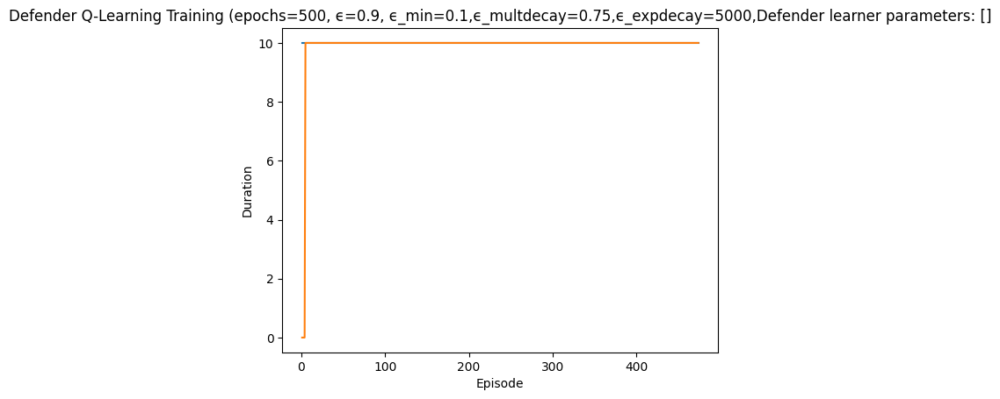

Rendering the current state of the environment
  ## Episode: 475/500 'Defender Q-Learning Training' ϵ=0.3076, Defender learner parameters: []


Episode 475|Iteration 10|reward:  -10.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=1, Parameter=8
info {'action': 'block_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4741, 'successful_actions': 1852, 'failed_actions': 2889}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=3, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '2_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4742, 'successful_actions': 1852, 'failed_actions': 2890}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration

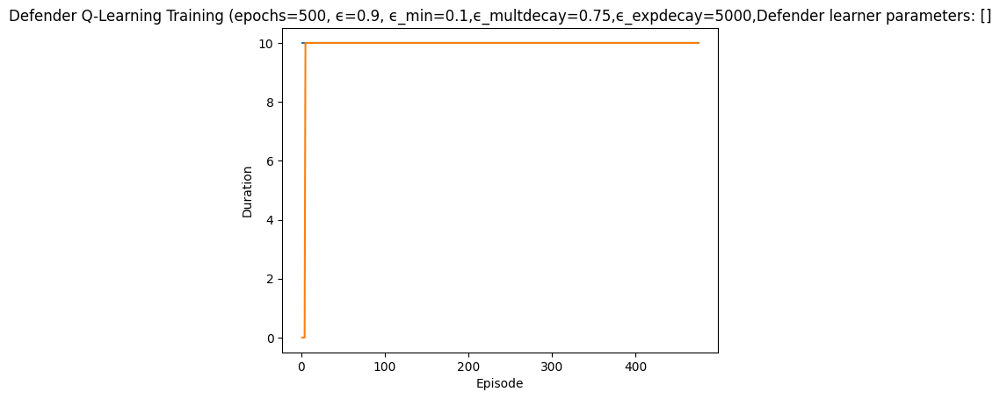

Rendering the current state of the environment
  ## Episode: 476/500 'Defender Q-Learning Training' ϵ=0.3071, Defender learner parameters: []


Episode 476|Iteration 10|reward:  -40.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4751, 'successful_actions': 1853, 'failed_actions': 2898}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4752, 'successful_actions': 1853, 'failed_actions': 2899}, 'network_availability'

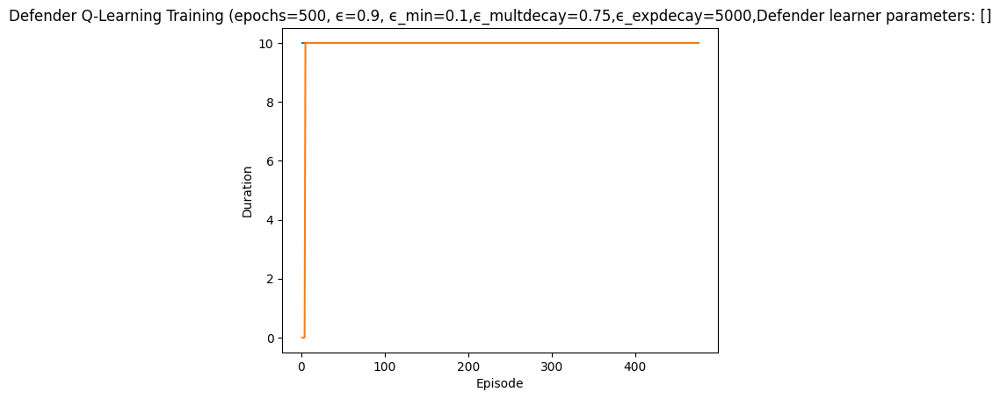

Rendering the current state of the environment
  ## Episode: 477/500 'Defender Q-Learning Training' ϵ=0.3066, Defender learner parameters: []


Episode 477|Iteration 10|reward:    0.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4761, 'successful_actions': 1855, 'failed_actions': 2906}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=5, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4762, 'successful_actions': 1855, 'failed_actions': 2907}, 'network_availability': 1.0}


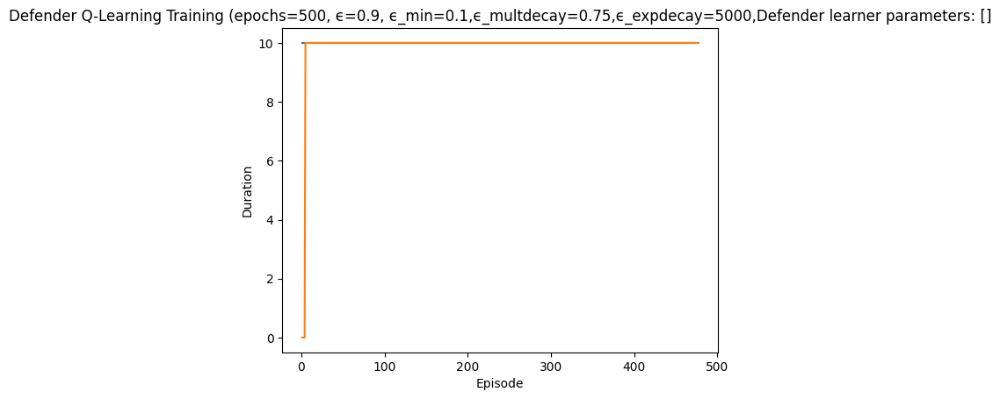

Rendering the current state of the environment
  ## Episode: 478/500 'Defender Q-Learning Training' ϵ=0.3062, Defender learner parameters: []


Episode 478|Iteration 10|reward:   10.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=12, Parameter=1
info {'action': 'stop_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 1, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4771, 'successful_actions': 1858, 'failed_actions': 2913}, 'network_availability': 1.0}
failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=0, Parameter=6
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4772, 'successful_actions': 1858, 'failed_actions': 2914}, 'network_availability': 1.0}
action type:  Reimage

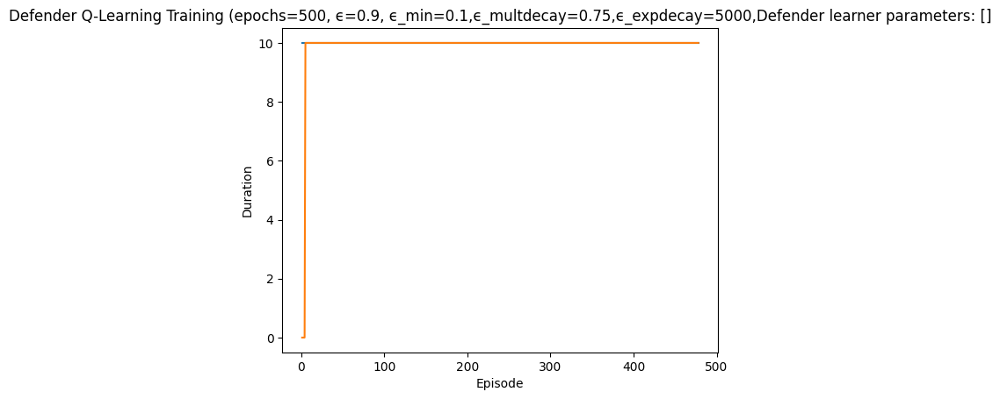

Rendering the current state of the environment
  ## Episode: 479/500 'Defender Q-Learning Training' ϵ=0.3057, Defender learner parameters: []


Episode 479|Iteration 10|reward:  -10.0|last_reward_at:    8|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=5
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 5, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4781, 'successful_actions': 1862, 'failed_actions': 2919}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4782, 'successful_actions': 1862, 'failed_actions': 2920}, 'network_availability'

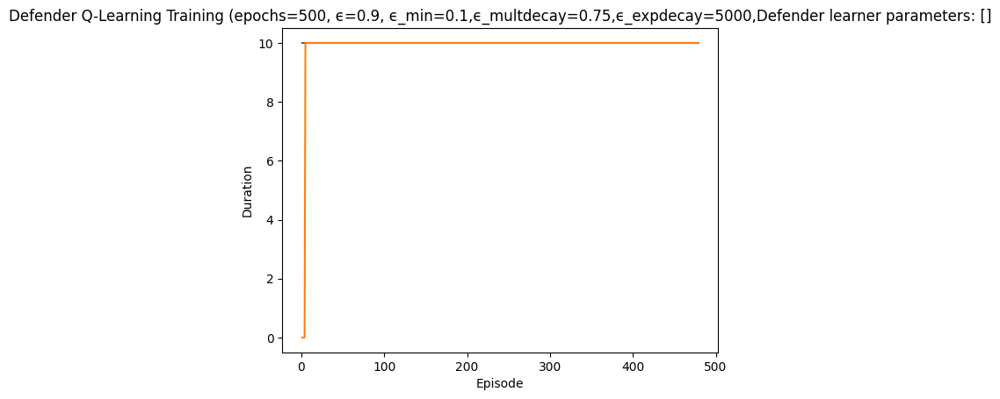

Rendering the current state of the environment
  ## Episode: 480/500 'Defender Q-Learning Training' ϵ=0.3052, Defender learner parameters: []


Episode 480|Iteration 10|reward:  -25.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=10, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '9_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4791, 'successful_actions': 1865, 'failed_actions': 2926}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=9
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4792, 'successful_actions': 1865, 'failed_actions': 2927}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '4_WindowsNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Ite

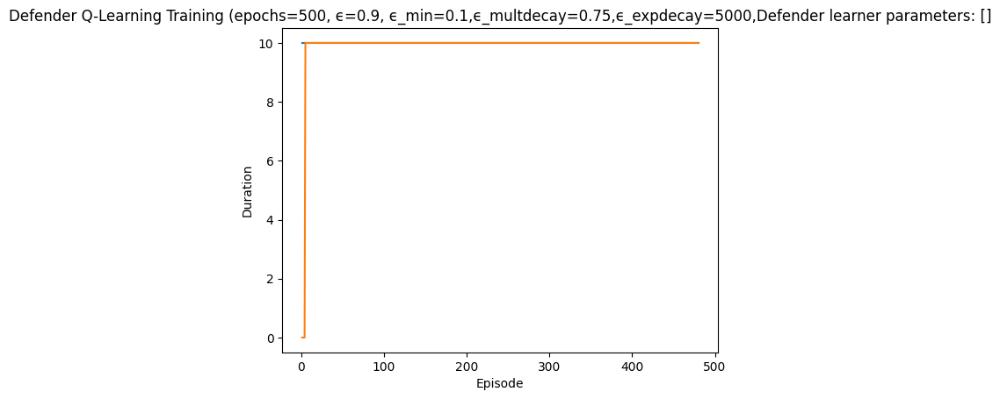

Rendering the current state of the environment
  ## Episode: 481/500 'Defender Q-Learning Training' ϵ=0.3048, Defender learner parameters: []


Episode 481|Iteration 10|reward:  -80.0|last_reward_at:    2|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=11, Parameter=9
info {'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4801, 'successful_actions': 1866, 'failed_actions': 2935}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=5
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '6_WindowsNode', 'port_name': 5, 'performance_metrics': {'actions_taken': 4802, 'successful_actions': 1867, 'failed_actions': 2935}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3:

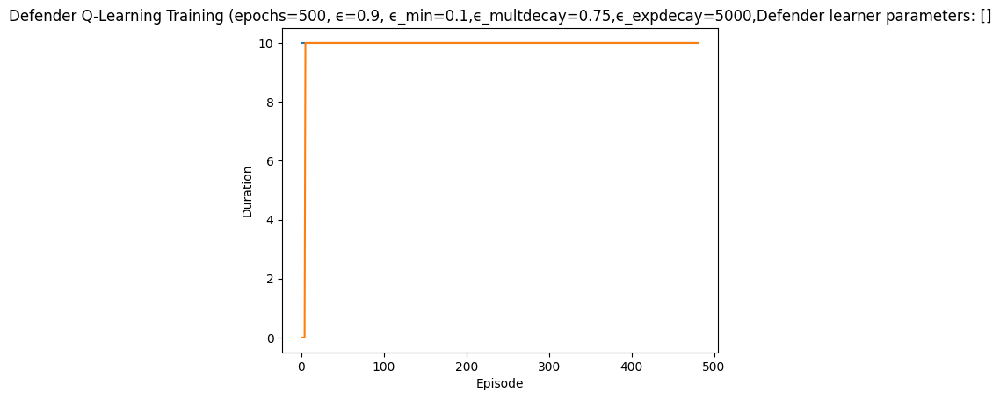

Rendering the current state of the environment
  ## Episode: 482/500 'Defender Q-Learning Training' ϵ=0.3043, Defender learner parameters: []


Episode 482|Iteration 10|reward:   95.0|last_reward_at:    7|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=12, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '11_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4811, 'successful_actions': 1868, 'failed_actions': 2943}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 2: Action Taken: Type=Block Traffic, NodeID=5, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4812, 'successful_actions': 1869, 'failed_actions': 2943}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=2, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '1_LinuxNode', 'reason': 'Reimaging not required -

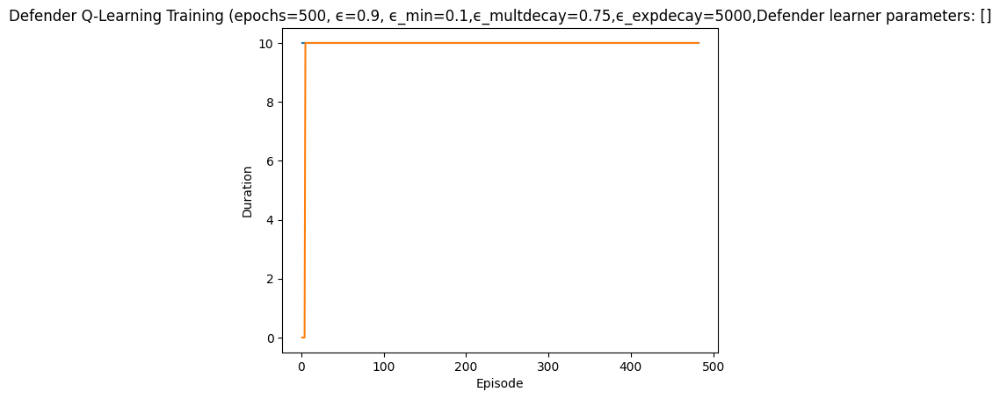

Rendering the current state of the environment
  ## Episode: 483/500 'Defender Q-Learning Training' ϵ=0.3039, Defender learner parameters: []


Episode 483|Iteration 10|reward:  105.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=6, Parameter=7
info {'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 7, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4821, 'successful_actions': 1872, 'failed_actions': 2949}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=8, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4822, 'successful_actions': 1873, 'failed_actions': 2949}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 8, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: Ac

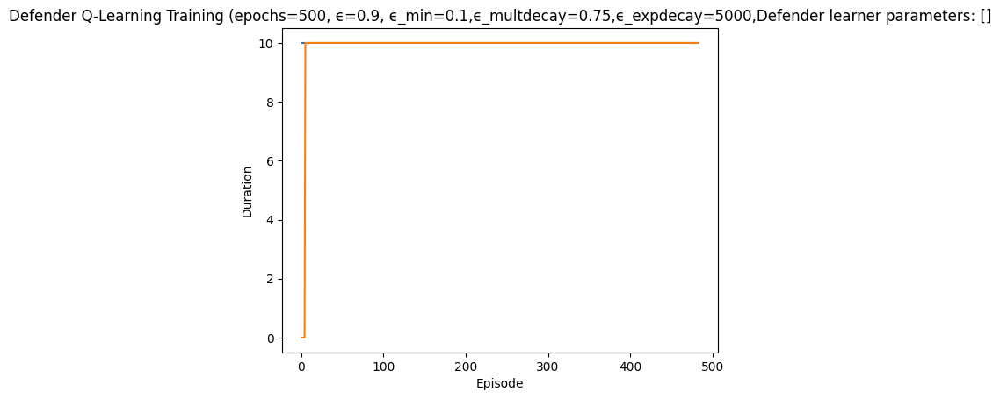

Rendering the current state of the environment
  ## Episode: 484/500 'Defender Q-Learning Training' ϵ=0.3034, Defender learner parameters: []


Episode 484|Iteration 10|reward:   95.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=5, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 4831, 'successful_actions': 1879, 'failed_actions': 2952}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=4, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '3_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4832, 'successful_actions': 1879, 'failed_actions': 2953}, 'network_availability': 1.0}
action type:  Block Traffic
Iteration 3: Action Taken: Type=Block Traffic, NodeID=11, Parameter=3
info {'action': 'block_traffic', 'status': 'success', 'node_id': '10_Wind

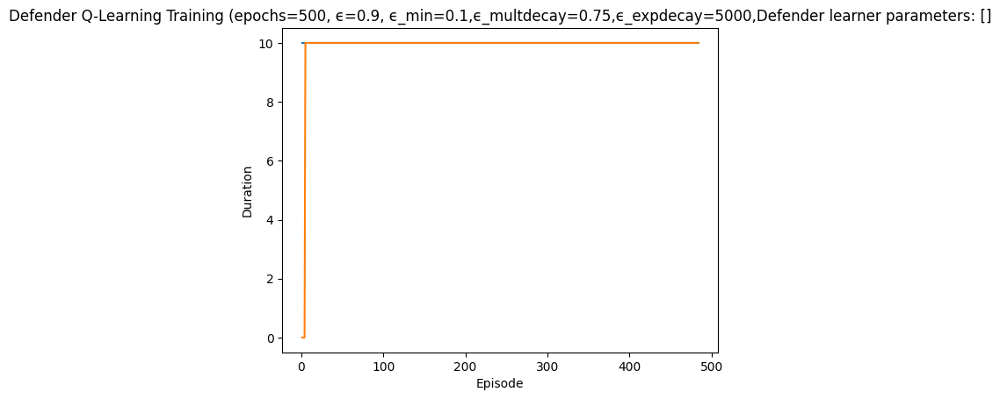

Rendering the current state of the environment
  ## Episode: 485/500 'Defender Q-Learning Training' ϵ=0.3030, Defender learner parameters: []


Episode 485|Iteration 10|reward:  120.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=1, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '13_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4841, 'successful_actions': 1884, 'failed_actions': 2957}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=0, Parameter=5
info {'action': 'reimage_node', 'status': 'failed', 'node_id': 'start', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4842, 'successful_actions': 1884, 'failed_actions': 2958}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '10_WindowsNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: Ac

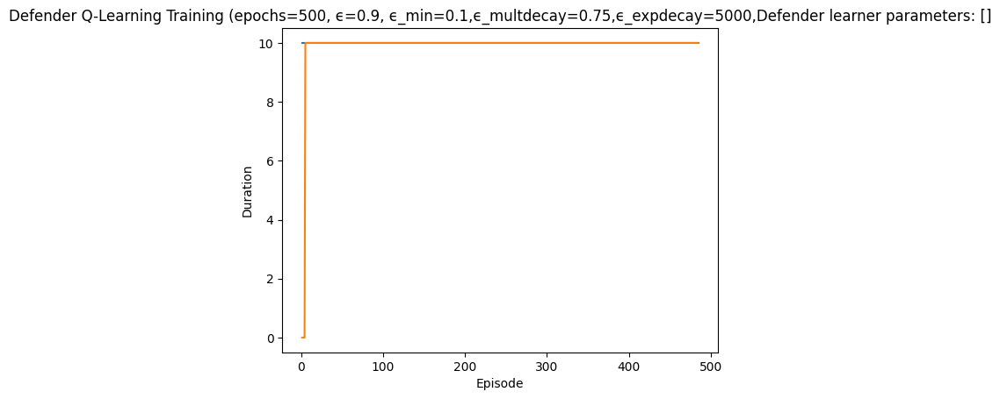

Rendering the current state of the environment
  ## Episode: 486/500 'Defender Q-Learning Training' ϵ=0.3025, Defender learner parameters: []


Episode 486|Iteration 10|reward:   95.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=13, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4851, 'successful_actions': 1889, 'failed_actions': 2962}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=6, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '5_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4852, 'successful_actions': 1889, 'failed_actions': 2963}, 'network_ava

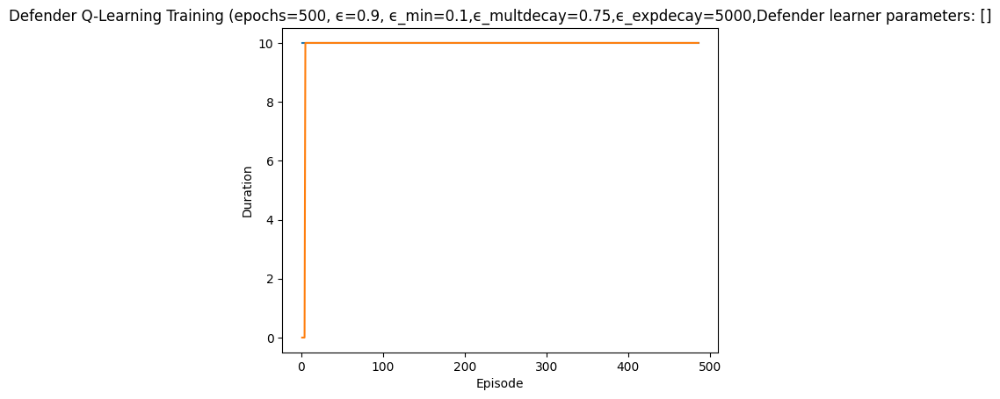

Rendering the current state of the environment
  ## Episode: 487/500 'Defender Q-Learning Training' ϵ=0.3020, Defender learner parameters: []


Episode 487|Iteration 10|reward:   55.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '2_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4861, 'successful_actions': 1895, 'failed_actions': 2966}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=9, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4862, 'successful_actions': 1895, 'failed_actions': 2967}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 3: 

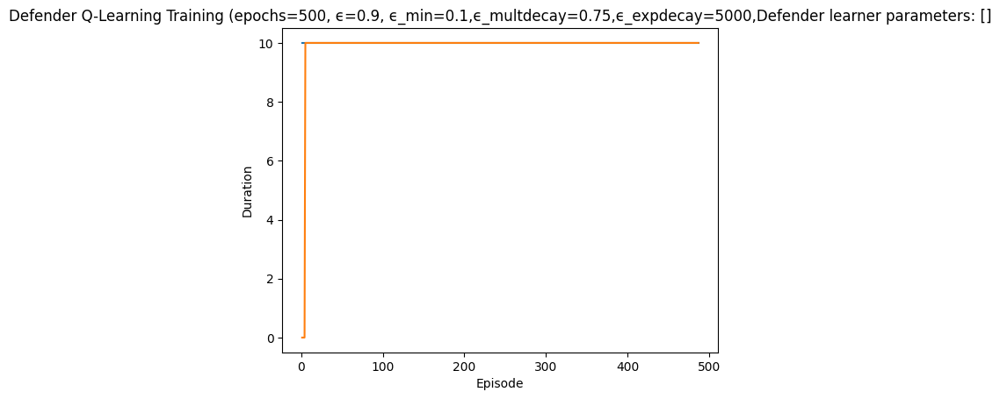

Rendering the current state of the environment
  ## Episode: 488/500 'Defender Q-Learning Training' ϵ=0.3016, Defender learner parameters: []


Episode 488|Iteration 10|reward:   40.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=3, Parameter=3
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4871, 'successful_actions': 1898, 'failed_actions': 2973}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 6, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4872, 'successful_actions': 1898, 'failed_actions': 2974}, 'network_availability': 1.0}
action t

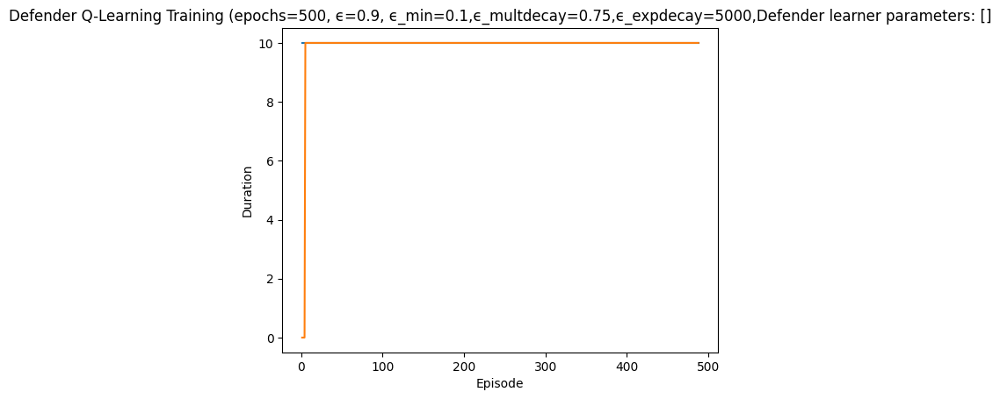

Rendering the current state of the environment
  ## Episode: 489/500 'Defender Q-Learning Training' ϵ=0.3011, Defender learner parameters: []


Episode 489|Iteration 10|reward:  -25.0|last_reward_at:    7|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=9, Parameter=4
info {'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 4, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4881, 'successful_actions': 1902, 'failed_actions': 2979}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=7, Parameter=0
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '6_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4882, 'successful_actions': 1902, 'failed_actions': 2980}, 'network_availability':

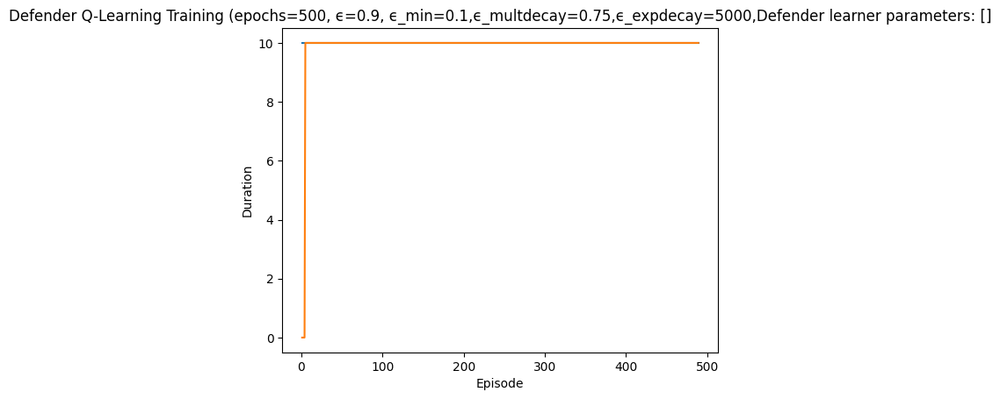

Rendering the current state of the environment
  ## Episode: 490/500 'Defender Q-Learning Training' ϵ=0.3007, Defender learner parameters: []


Episode 490|Iteration 10|reward:   10.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running'}
not reimaged
action type:  Start Service
Iteration 1: Action Taken: Type=Start Service, NodeID=0, Parameter=5
info {'action': 'start_service', 'status': 'failed', 'node_id': 'start', 'port_name': 5, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4891, 'successful_actions': 1904, 'failed_actions': 2987}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=6
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4892, 'successful_actions': 1904, 'failed_actions': 2988}, 'network_availability': 1.0}
action type:  Block Traf

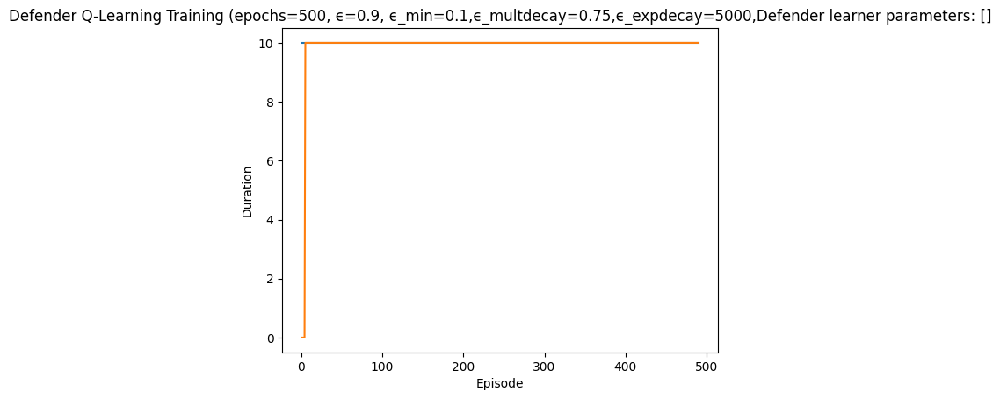

Rendering the current state of the environment
  ## Episode: 491/500 'Defender Q-Learning Training' ϵ=0.3002, Defender learner parameters: []


Episode 491|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running'}
not reimaged
action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=0, Parameter=8
info {'action': 'block_traffic', 'status': 'failed', 'node_id': 'start', 'port_name': 8, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4901, 'successful_actions': 1908, 'failed_actions': 2993}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 6, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=12, Parameter=6
info {'action': 'start_service', 'status': 'failed', 'node_id': '11_LinuxNode', 'port_name': 6, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4902, 'successful_actions': 1908, 'failed_actions': 2994}, 'network_availability': 1.0}
action type:  Block

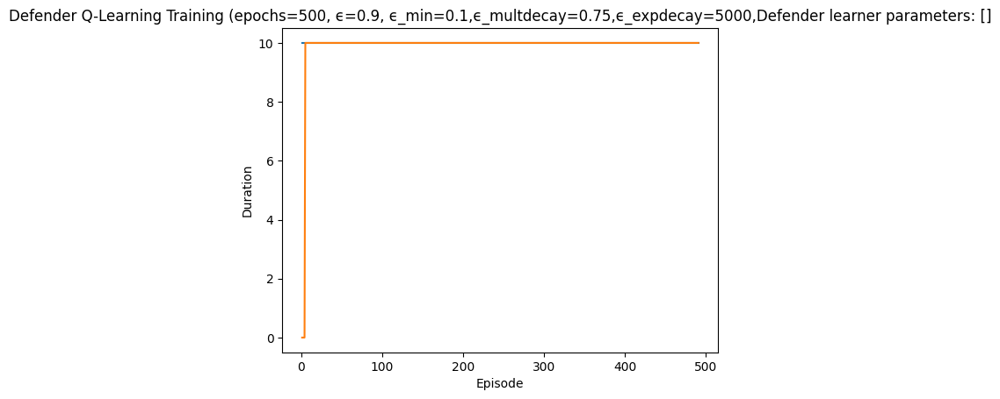

Rendering the current state of the environment
  ## Episode: 492/500 'Defender Q-Learning Training' ϵ=0.2998, Defender learner parameters: []


Episode 492|Iteration 10|reward:  -10.0|last_reward_at:    5|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4911, 'successful_actions': 1913, 'failed_actions': 2998}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=9, Parameter=6
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '8_WindowsNode', 'port_name': 6, 'performance_metrics': {'actions_taken': 4912, 'successful_actions': 1914, 'failed_actions': 2998}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 4, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic

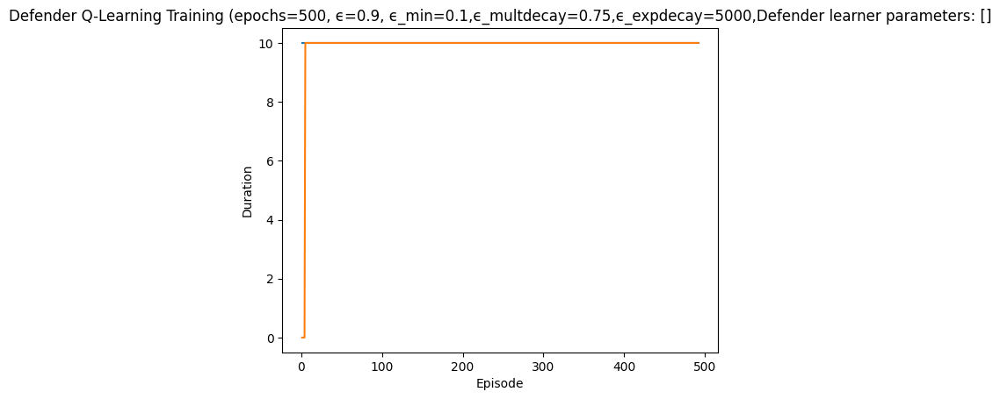

Rendering the current state of the environment
  ## Episode: 493/500 'Defender Q-Learning Training' ϵ=0.2993, Defender learner parameters: []


Episode 493|Iteration 10|reward:  -25.0|last_reward_at:    5|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 8, 'performance_metrics': {'actions_taken': 4921, 'successful_actions': 1916, 'failed_actions': 3005}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=7
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4922, 'successful_actions': 1916, 'failed_actions': 3006}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
It

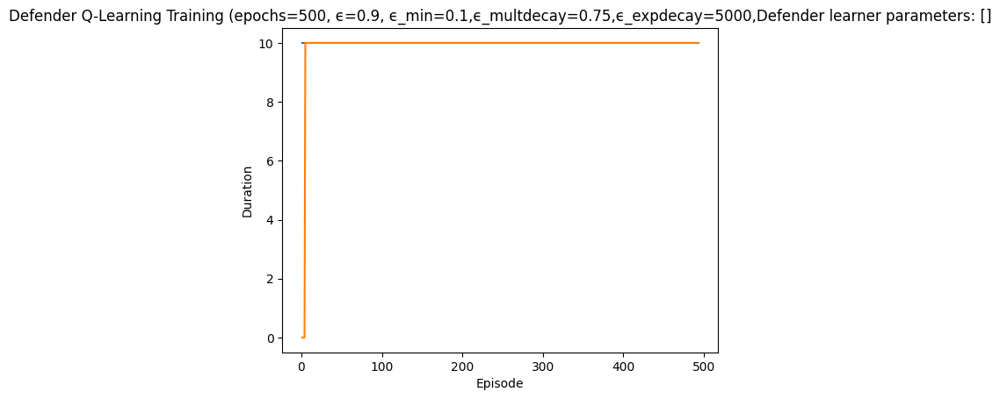

Rendering the current state of the environment
  ## Episode: 494/500 'Defender Q-Learning Training' ϵ=0.2989, Defender learner parameters: []


Episode 494|Iteration 10|reward:    0.0|last_reward_at:    9|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=8, Parameter=9
info {'action': 'block_traffic', 'status': 'success', 'node_id': '7_LinuxNode', 'port_name': 9, 'performance_metrics': {'actions_taken': 4931, 'successful_actions': 1918, 'failed_actions': 3013}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 2: Action Taken: Type=Start Service, NodeID=7, Parameter=9
info {'action': 'start_service', 'status': 'failed', 'node_id': '6_WindowsNode', 'port_name': 9, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4932, 'successful_actions': 1918, 'failed_actions': 3014}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '5_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3:

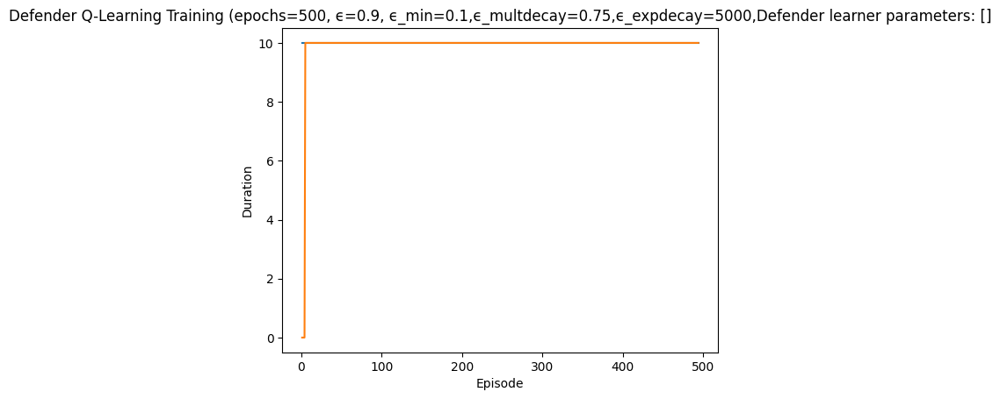

Rendering the current state of the environment
  ## Episode: 495/500 'Defender Q-Learning Training' ϵ=0.2984, Defender learner parameters: []


Episode 495|Iteration 10|reward:   65.0|last_reward_at:   10|Elapsed Time: 0:00:00||


failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=8, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4941, 'successful_actions': 1920, 'failed_actions': 3021}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 2, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=4, Parameter=2
info {'action': 'stop_service', 'status': 'failed', 'node_id': '3_LinuxNode', 'port_name': 2, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4942, 'successful_actions': 1920, 'failed_actions': 3022}, 'network_availability': 1.0}
acti

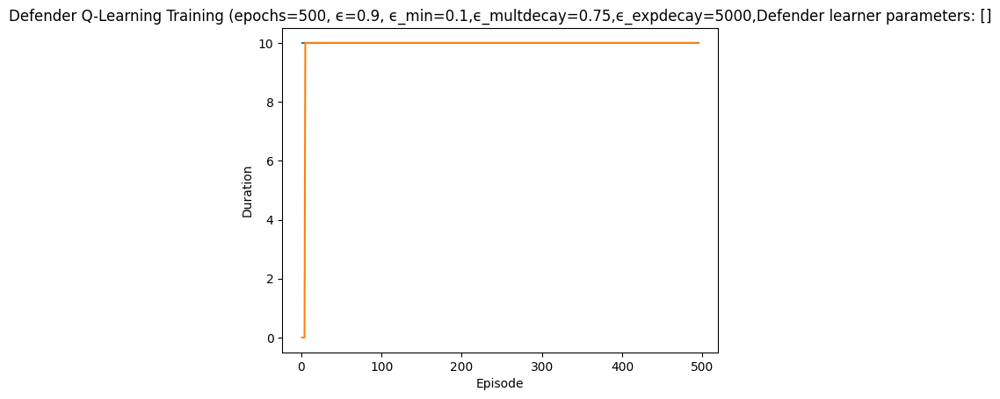

Rendering the current state of the environment
  ## Episode: 496/500 'Defender Q-Learning Training' ϵ=0.2980, Defender learner parameters: []


Episode 496|Iteration 10|reward:   80.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=6, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4951, 'successful_actions': 1926, 'failed_actions': 3025}, 'network_availability': 1.0}
failed
{'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 7, 'reason': 'Machine not running'}
not reimaged
action type:  Allow Traffic
Iteration 2: Action Taken: Type=Allow Traffic, NodeID=0, Parameter=7
info {'action': 'stop_service', 'status': 'failed', 'node_id': 'start', 'port_name': 7, 'reason': 'Machine not running', 'performance_metrics': {'actions_taken': 4952, 'successful_actions': 1926, 'failed_actions': 3026}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=6, Parameter=3
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '5_LinuxNode', 'port_name': 3, 'per

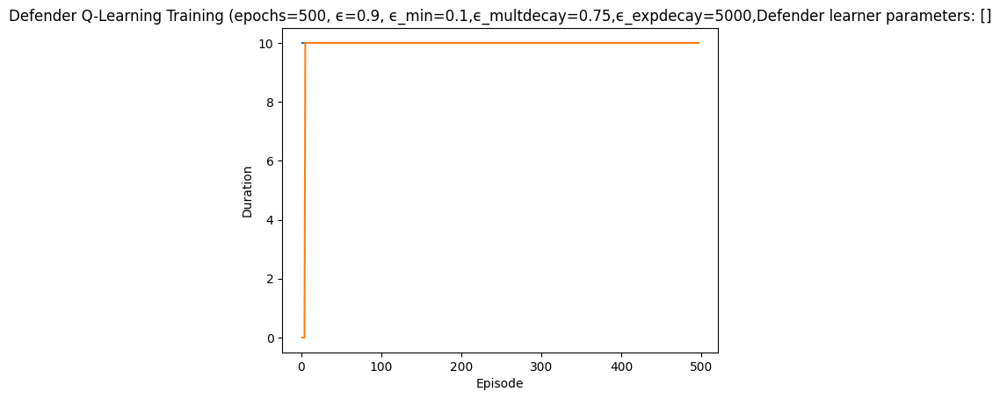

Rendering the current state of the environment
  ## Episode: 497/500 'Defender Q-Learning Training' ϵ=0.2975, Defender learner parameters: []


Episode 497|Iteration 10|reward:  -25.0|last_reward_at:    6|Elapsed Time: 0:00:00||


action type:  Block Traffic
Iteration 1: Action Taken: Type=Block Traffic, NodeID=13, Parameter=4
info {'action': 'block_traffic', 'status': 'success', 'node_id': '12_WindowsNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4961, 'successful_actions': 1931, 'failed_actions': 3030}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=3, Parameter=4
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '2_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4962, 'successful_actions': 1931, 'failed_actions': 3031}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reima

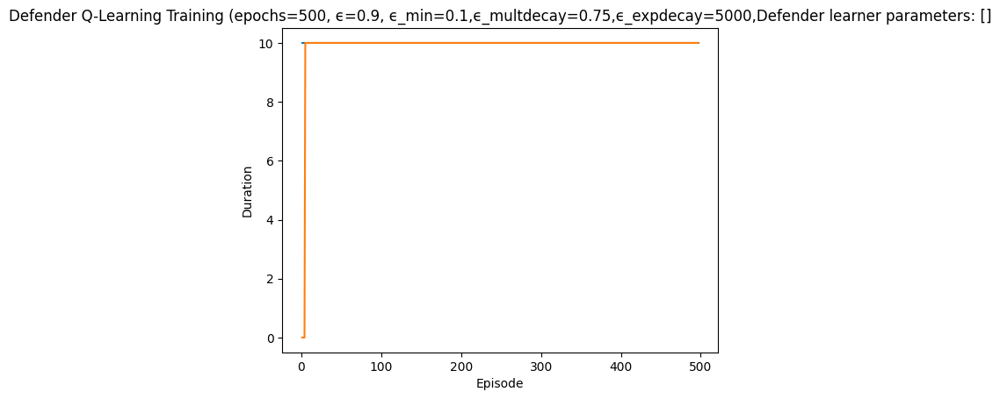

Rendering the current state of the environment
  ## Episode: 498/500 'Defender Q-Learning Training' ϵ=0.2971, Defender learner parameters: []


Episode 498|Iteration 10|reward:   30.0|last_reward_at:    8|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=5, Parameter=0
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 0, 'performance_metrics': {'actions_taken': 4971, 'successful_actions': 1933, 'failed_actions': 3038}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=2
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '4_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4972, 'successful_actions': 1933, 'failed_actions': 3039}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 3: Action Taken: Type=Reimage Node, NodeID=13, Parameter=8
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '12_Wind

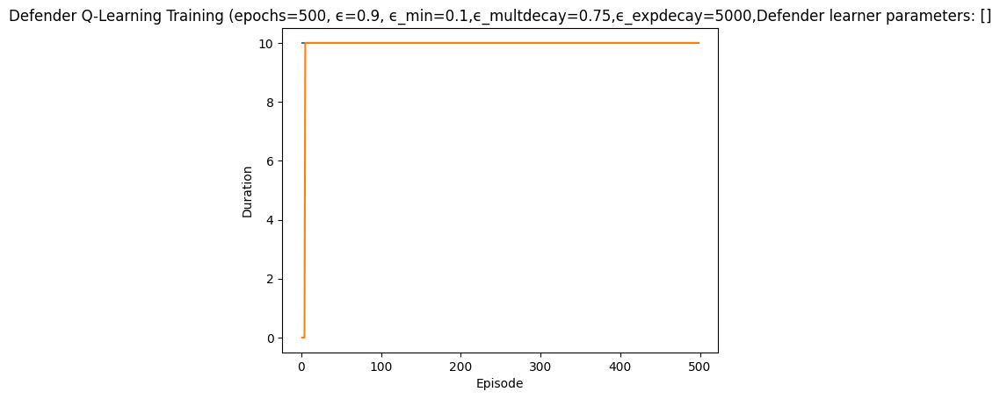

Rendering the current state of the environment
  ## Episode: 499/500 'Defender Q-Learning Training' ϵ=0.2967, Defender learner parameters: []


Episode 499|Iteration 10|reward:   55.0|last_reward_at:    9|Elapsed Time: 0:00:00||


failed
{'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found'}
not reimaged
action type:  Allow Traffic
Iteration 1: Action Taken: Type=Allow Traffic, NodeID=1, Parameter=0
info {'action': 'stop_service', 'status': 'failed', 'node_id': '13_LinuxNode', 'port_name': 0, 'reason': 'Service not found', 'performance_metrics': {'actions_taken': 4981, 'successful_actions': 1935, 'failed_actions': 3046}, 'network_availability': 1.0}
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=5, Parameter=1
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '4_WindowsNode', 'port_name': 1, 'performance_metrics': {'actions_taken': 4982, 'successful_actions': 1936, 'failed_actions': 3046}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '8_WindowsNode', 'port_name': 9, 'reason': 'Service not found'}
not reimaged
action type:  Start Service
Iteration 3: A

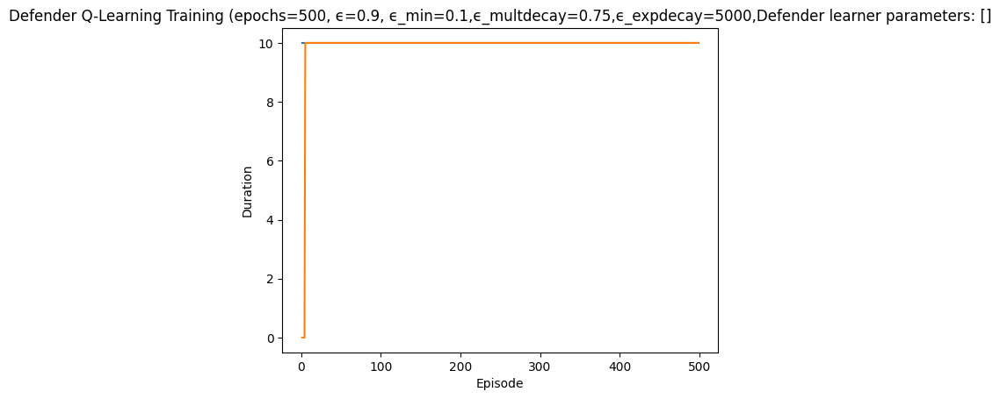

Rendering the current state of the environment
  ## Episode: 500/500 'Defender Q-Learning Training' ϵ=0.2962, Defender learner parameters: []


Episode 500|Iteration 10|reward:  -10.0|last_reward_at:   10|Elapsed Time: 0:00:00||


action type:  Reimage Node
Iteration 1: Action Taken: Type=Reimage Node, NodeID=4, Parameter=4
info {'action': 'allow_traffic', 'status': 'success', 'node_id': '3_LinuxNode', 'port_name': 4, 'performance_metrics': {'actions_taken': 4991, 'successful_actions': 1940, 'failed_actions': 3051}, 'network_availability': 1.0}
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
action type:  Reimage Node
Iteration 2: Action Taken: Type=Reimage Node, NodeID=13, Parameter=1
info {'action': 'reimage_node', 'status': 'failed', 'node_id': '12_WindowsNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 4992, 'successful_actions': 1940, 'failed_actions': 3052}, 'network_availability': 1.0}
failed
{'action': 'start_service', 'status': 'failed', 'node_id': '9_LinuxNode', 'port_name': 1, 'reason': 'Service not found'}
not reimaged
action type:  Start Service

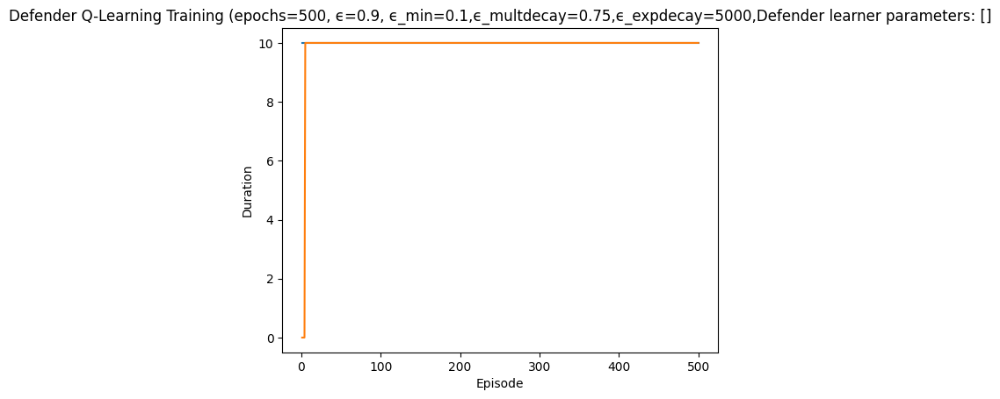

Rendering the current state of the environment
simulation ended


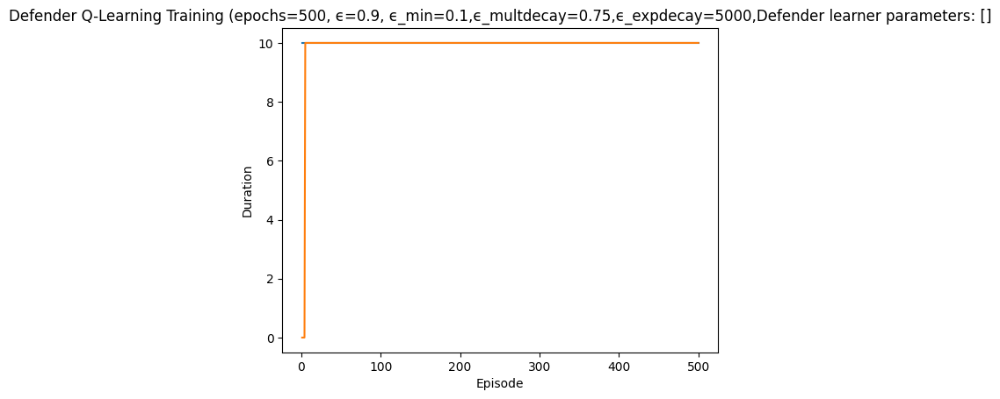

In [17]:
#random.seed(120394016)
#%matplotlib inline
trained_defender = epsilon_greedy_defender_training(
    cyberbattle_gym_env=gym_env,
    environment_properties=ep,
    learner=learner2,
    episode_count=training_episode_count,
    iteration_count=iteration_count,
    epsilon=0.90,
    epsilon_exponential_decay=5000,
    epsilon_minimum=0.10,
    epsilon_multdecay=0.75,  # 0.999,,
    verbosity=logging.INFO,
    render=True,
    plot_episodes_length=True,
    title="Defender Q-Learning Training"
)

In [18]:
trained_defender

{'all_episodes_rewards': [[0, 25, 0, 25, 0, 0, 25, 0, -15, 0],
  [25, 0, 25, 25, 0, -15, 0, 25, 25, 0],
  [-15, -15, 25, 25, -15, 25, 25, 25, 25, 25],
  [-15, -15, -15, 0, 0, -15, 25, -15, 25, 0],
  [25, -15, 25, -15, 25, 25, -15, 25, 25, 0],
  [25, 25, 25, 25, 25, 25, -15, 25, -15, 25],
  [0, -15, 25, 25, 25, -15, 25, 25, 25, -15],
  [25, -15, 0, 25, 0, 25, 25, 25, -15, -15],
  [25, -15, -15, -15, 25, 0, 25, 25, 25, -15],
  [25, -15, -15, -15, 25, 0, 25, -15, 0, -15],
  [0, 0, -15, -15, 0, -15, 25, 0, 25, -15],
  [-15, -15, -15, -15, 25, 25, -15, 0, 25, 25],
  [25, 0, 0, 25, -15, 25, 25, 0, -15, 0],
  [-15, -15, 0, 25, -15, 25, 25, 25, 25, 25],
  [0, -15, 0, 0, 25, -15, 0, -15, 25, 0],
  [-15, -15, 0, -15, -15, 25, -15, -15, 25, -15],
  [0, 25, 25, -15, 0, 0, 0, 25, 25, 25],
  [-15, -15, 25, 0, 25, 0, -15, 0, -15, 0],
  [-15, -15, -15, 25, 25, 0, -15, 50, 25, 0],
  [25, 0, -15, -15, 25, 25, -15, -15, 25, -15],
  [25, 0, 25, 25, -15, -15, 25, 0, 25, -15],
  [25, -15, 25, 25, -15, -15, 

In [19]:
trained_attacker

{'all_episodes_rewards': [[0.0, 0.0, 0.0, 14.0, 2.0, 0.0, 0.0, 0.0, 0.0, 4.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 14.0, 0.0, 0.0, 0.0],
  [0.0, 14.0, 0.0, 4.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 14.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 14.0, 4.0, 0.0, 2.0, 0.0],
  [0.0, 14.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 4.0],
  [0.0, 0.0, 14.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 2.0],
  [0.0, 14.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 14.0],
  [14.0, 100.0, 0.0, 0.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 14.0, 0.0, 100.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 14.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 14.0, 4.0, 0.0],
  [0.0, 14.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 14.0, 0.0],
  [0.0, 0.0, 0.0, 14.0, 2.0, 4.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 14.0, 0.0, 2.0, 0.0, 0.0, 0.0, 0.0],
  [0.0, 0.0, 0.0, 14.0, 0.0, 0.0, 0.0

# Initialise Both Agents

In [20]:
trained_attacker['learner']

In [21]:
attacker_learner = trained_attacker['learner']
defender_learner = trained_defender['learner']

In [22]:
#this was made due to issues where the attacker q learner needed to use a wrapper environment
from cyberbattle.agents.baseline.agent_wrapper import AgentWrapper, StateAugmentation
def wrap_environment(env):
    initial_observation = env.reset()
    state = StateAugmentation(initial_observation)
    return AgentWrapper(env, state)



In [23]:
import gym

gym_env = gym.make('CyberBattleChain-v0',
    size=12,
    attacker_goal=AttackerGoal(
        own_atleast=0,
        own_atleast_percent=1.0
    ),
    defender_constraint=DefenderConstraint(
        maintain_sla=0.80
    )
)

defender_name = "DefenderName"
defender_agent = DefenderWrapper(gym_env,defender_name)

gym_environment = gym.make('CyberBattleChain-v0',
    size=12,
    attacker_goal=AttackerGoal(
        own_atleast=0,
        own_atleast_percent=1.0
    ),
    defender_constraint=DefenderConstraint(
        maintain_sla=0.80
    ),
    defender_agent=defender_agent
)



Generated nodes:
[('start', {'data': NodeInfo(services=[], vulnerabilities={'ScanExplorerRecentFiles': VulnerabilityInfo(description='Scan Windows Explorer recent files for possible references to other machines', type=<VulnerabilityType.LOCAL: 1>, outcome=<cyberbattle.simulation.model.LeakedCredentials object at 0x7fdb78e2bcd0>, precondition=<cyberbattle.simulation.model.Precondition object at 0x7fdba435f100>, rates=Rates(probingDetectionRate=0.0, exploitDetectionRate=0.0, successRate=1.0), URL='', cost=1.0, reward_string='Found a reference to a remote Linux node in bash history')}, value=0, properties=[], firewall=FirewallConfiguration(outgoing=[FirewallRule(port='RDP', permission=<RulePermission.ALLOW: 0>, reason=''), FirewallRule(port='SSH', permission=<RulePermission.ALLOW: 0>, reason=''), FirewallRule(port='HTTPS', permission=<RulePermission.ALLOW: 0>, reason=''), FirewallRule(port='HTTP', permission=<RulePermission.ALLOW: 0>, reason='')], incoming=[FirewallRule(port='RDP', permis

In [24]:
gym_environment.environment
gym_environment.network.nodes
gym_environment.action_space

DiscriminatedUnion(connect:MultiDiscrete([ 100  100    8 1000]), local_vulnerability:MultiDiscrete([100   5]), remote_vulnerability:MultiDiscrete([100 100   2]))

In [25]:
number_of_episodes = 100
max_steps_per_episode = 100
wrapped_env = wrap_environment(gym_environment)
attacker_epsilon = 0.1
defender_epsilon = 0.1

for episode in range(100):
    total_reward = 0
    observation = wrapped_env.reset()
    done=False
    for step in range(1000):
        # Attacker's turn
        if np.random.random() < attacker_epsilon:
            _, attacker_action, _ = attacker_learner.explore(wrapped_env)
        else:
            _, attacker_action, _ = attacker_learner.exploit(wrapped_env, observation)

        if attacker_action is not None:
            observation, attacker_reward, done, _ = gym_environment.step(attacker_action)
            total_reward += attacker_reward

        # Defender's turn
        if np.random.random() < defender_epsilon:
            wrapped_env.reset()
            _, defender_action, _ = defender_learner.explore(wrapped_env)
        else:
            _, defender_action, _ = defender_learner.exploit(wrapped_env, observation)

        if defender_action is not None:
            observation, defender_reward, done, _ = gym_environment.step(defender_action)
            total_reward += defender_reward
        #observation = wrapped_env.reset()
        if done:
            break


    print(f"Episode {episode + 1}: Total reward = {total_reward}")

wrapped_env.close()

Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Executing defender action
defender reward 50
defender reward {'action': 'reimage_node', 'status': 'success', 'node_id': 'start', 'performance_metrics': {'actions_taken': 1, 'successful_actions': 1, 'failed_actions': 0}, 'network_availability': 1.0}
Episode 1: Total reward = 64.0
Step called with action: {'local_vulnerability': array([0, 1])}
Executing attacker action
attacker action:  {'local_vulnerability': array([0, 1])}
Attacker reward: 14.0
Executing defender action
failed
{'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed'}
reimaged
defender reward 0
defender reward {'action': 'reimage_node', 'status': 'failed', 'node_id': '7_LinuxNode', 'reason': 'Reimaging not required - no agent installed', 'performance_metrics': {'actions_taken': 2, 's